<a href="https://colab.research.google.com/github/yogasekaputra98/B-spline/blob/master/Tugas_Akhir.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**LOAD DATA**

In [ ]:
#LOAD DATA SET
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [ ]:
import numpy as np
import pandas as pd
from google.colab import files
import matplotlib.pyplot as plt
import scipy.signal as sps
import scipy.interpolate as spi
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objs as go
%matplotlib inline

# INDEKS SAHAM KOMPAS 100

## 2019

No handles with labels found to put in legend.


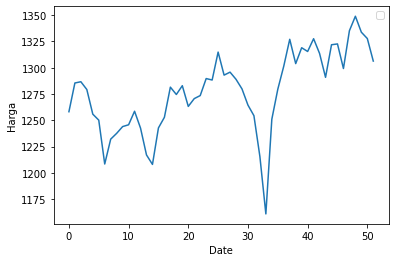

In [ ]:
KOMPAS100 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/Data Historis IDX Kompas 100.csv')

KOMPAS100_x = KOMPAS100['No'].values
KOMPAS100_y = KOMPAS100['Close'].values

plt.plot(KOMPAS100_x,KOMPAS100_y)
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

Return Indeks Kompas 100

In [ ]:
return_KOMPAs100 = KOMPAS100['Close'].pct_change()
return_KOMPAs100

0          NaN
1     0.021739
2     0.000934
3    -0.005759
4    -0.018323
5    -0.004555
6    -0.033413
7     0.019589
8     0.004489
9     0.005196
10    0.001391
11    0.010340
12   -0.012768
13   -0.020563
14   -0.007412
15    0.028768
16    0.008160
17    0.022908
18   -0.005454
19    0.006567
20   -0.015371
21    0.005874
22    0.002274
23    0.012729
24   -0.001078
25    0.020639
26   -0.016670
27    0.002181
28   -0.005263
29   -0.007091
30   -0.012048
31   -0.007964
32   -0.031020
33   -0.044955
34    0.077670
35    0.022814
36    0.017210
37    0.019638
38   -0.017444
39    0.011596
40   -0.002706
41    0.009244
42   -0.010568
43   -0.017311
44    0.024030
45    0.000598
46   -0.017706
47    0.027692
48    0.010335
49   -0.011267
50   -0.004513
51   -0.016177
Name: Close, dtype: float64

In [ ]:
np.savetxt("RETURN KOMPAS 100.csv", return_KOMPAs100, delimiter=",")
files.download("RETURN KOMPAS 100.csv")

EXPECTED RETURN KOMPAS 100

In [ ]:
return_KOMPAs100.mean()

0.0009255423601939991

VARIANCE KOMPAS 100

In [ ]:
return_KOMPAs100.var()

0.0003875499255042076

In [ ]:
sharpe_index_2019 = return_KOMPAs100.mean()/return_KOMPAs100.var()
sharpe_index_2019

2.3881887191433626

In [ ]:
RETURN_KOMPAS100 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/RETURN KOMPAS 100.csv')
KOMPAS100 = RETURN_KOMPAS100['RETURN']

No handles with labels found to put in legend.


[1, 1.021738612, 1.0226924080595179, 1.0168027142999638, 0.9981718890059813, 0.9936254586073281, 0.9604253915413539, 0.9792390271954264, 0.9836344394928959, 0.9887451994445375, 0.9901202562921119, 1.0003576720102216, 0.9875847471259486, 0.9672768296400771, 0.9601074588991458, 0.9877278158751446, 0.9957873963134417, 1.018599029415276, 1.0130431645344509, 1.019695894974186, 1.0040218393849856, 1.0099194807379042, 1.0122165405770036, 1.025100741257046, 1.0239959266319474, 1.0451304673285555, 1.0277077850035687, 1.0299492064332914, 1.0245284632557758, 1.0172637132643672, 1.0050074280922723, 0.9970034856194775, 0.966076633905248, 0.9226470993589826, 0.9943090100694261, 1.016993470140617, 1.034495635884611, 1.0548115018772537, 1.0364111780628136, 1.0484290144658495, 1.045591469645781, 1.0552566076961116, 1.0441051370629921, 1.0260306935933927, 1.0506863332580945, 1.051314249678008, 1.03269932107505, 1.061297319141039, 1.0722659786998783, 1.0601845563318628, 1.0553996773228136, 1.038326719484

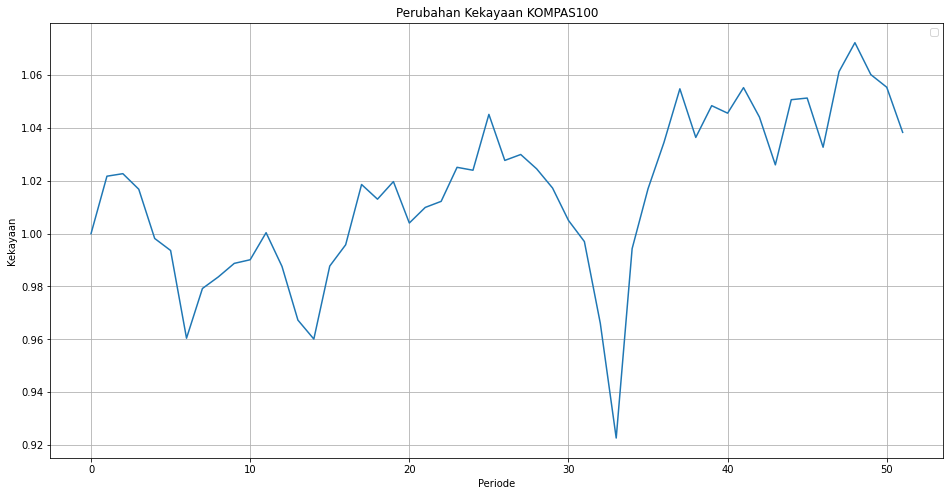

In [ ]:
#KOMPAS 100
v0 = 1
Vp_KOMPAS100 = [v0]
x1 = 1
for i in range(51):
    x1 = x1 + (x1 * KOMPAS100[i])
    Vp_KOMPAS100.append(x1)
print (Vp_KOMPAS100)

plt.figure(figsize=(16,8))
# plt.plot(Vp_1,'o')
plt.plot(Vp_KOMPAS100,'-')
plt.title('Perubahan Kekayaan KOMPAS100')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

## 2009 s.d 2018

No handles with labels found to put in legend.


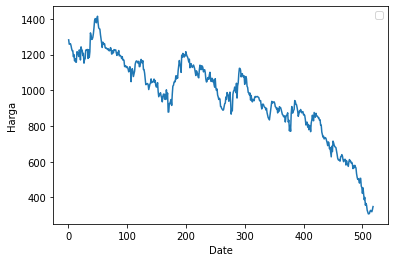

In [ ]:
KOMPAS100_2009 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/INDEKS KOMPAS 100 2009.csv')

KOMPAS100_x_2009 = KOMPAS100_2009['No'].values
KOMPAS100_y_2009 = KOMPAS100_2009['Close'].values

plt.plot(KOMPAS100_x_2009,KOMPAS100_y_2009)
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

In [ ]:
return_KOMPAs100_2009 = KOMPAS100_2009['Close'].pct_change()
return_KOMPAs100_2009

0           NaN
1     -0.019315
2      0.001415
3      0.001238
4     -0.008569
         ...   
513    0.012911
514   -0.012442
515   -0.011950
516    0.038190
517    0.050241
Name: Close, Length: 518, dtype: float64

In [ ]:
return_KOMPAs100_2009.var()

0.000744842522830431

In [ ]:
return_KOMPAs100_2009.mean()

-0.002144480641607999

In [ ]:
sharpe_index = return_KOMPAs100_2009.mean()/return_KOMPAs100_2009.var()
sharpe_index

-2.8791060873631222

# **SAHAM AALI**

No handles with labels found to put in legend.


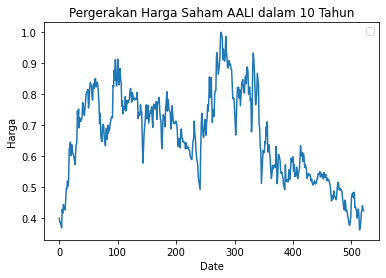

In [ ]:
AALI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/AALI.JK.csv')

AALI_x = AALI['No'].values
AALI_y = AALI['Skala'].values

plt.plot(AALI_x,AALI_y)
plt.title('Pergerakan Harga Saham AALI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. Percobaan 15 Data ALLI**

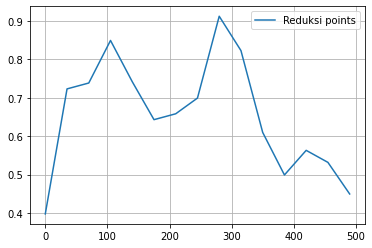

In [ ]:
AALI_x15 = AALI_x[0:522:35]
AALI_y15 = AALI_y[0:522:35]

plt.plot(AALI_x15, AALI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:
# import scipy.interpolate as interpolate

# t_AALI_15, c_AALI_15, k_AALI_15 = interpolate.splrep(AALI_x15, AALI_y15, s=0, k=3)
# print('''\
# t_AALI_15: {}
# c_AALI_15: {}
# k_AALI_15: {}
# '''.format(t_AALI_15, c_AALI_15, k_AALI_15))
# N = 522
# xmin_AALI_15, xmax_AALI_15 = AALI_x15.min(), AALI_x15.max()
# xx_AALI_15 = np.linspace(xmin_AALI_15, xmax_AALI_15, N)
# spline_AALI_15 = interpolate.BSpline(t_AALI_15, c_AALI_15, k_AALI_15, extrapolate=False)

# plt.plot(AALI_x, AALI_y, label='Original points')
# plt.plot(xx_AALI_15, spline_AALI_15(xx_AALI_15), 'r', label='BSpline')
# plt.grid()
# plt.legend(loc='best')
# plt.show()
spline_AALI_15.c

array([0.39796101, 0.85912566, 0.60488036, 0.91978164, 0.72910084,
       0.6128077 , 0.67681731, 0.62891221, 1.00141668, 0.83481111,
       0.59302127, 0.45127941, 0.64525812, 0.48790894, 0.44977831,
       0.        , 0.        , 0.        , 0.        ])

t_AALI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_AALI_15: [0.39796101 0.85912566 0.60488036 0.91978164 0.72910084 0.6128077
 0.67681731 0.62891221 1.00141668 0.83481111 0.59302127 0.45127941
 0.64525812 0.48790894 0.44977831 0.         0.         0.
 0.        ]
k_AALI_15: 3



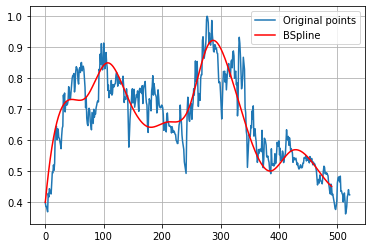

In [ ]:
import scipy.interpolate as interpolate

t_AALI_15, c_AALI_15, k_AALI_15 = interpolate.splrep(AALI_x15, AALI_y15, s=0, k=3)
print('''\
t_AALI_15: {}
c_AALI_15: {}
k_AALI_15: {}
'''.format(t_AALI_15, c_AALI_15, k_AALI_15))
N = 522
xmin_AALI_15, xmax_AALI_15 = AALI_x15.min(), AALI_x15.max()
xx_AALI_15 = np.linspace(xmin_AALI_15, xmax_AALI_15, N)
spline_AALI_15 = interpolate.BSpline(t_AALI_15, c_AALI_15, k_AALI_15, extrapolate=False)

plt.plot(AALI_x, AALI_y, label='Original points')
plt.plot(xx_AALI_15, spline_AALI_15(xx_AALI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. Percobaan 25 Data ALLI**

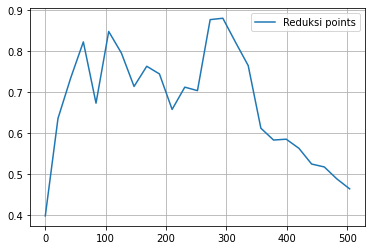

In [ ]:
AALI_x25 = AALI_x[0:522:21]
AALI_y25 = AALI_y[0:522:21]

plt.plot(AALI_x25, AALI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AALI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_AALI_25: [0.39796101 0.67138904 0.63511144 0.92176961 0.5449256  0.93935776
 0.78947644 0.67824682 0.78325971 0.77034897 0.60472733 0.75973086
 0.63185601 0.93733436 0.88412558 0.81187253 0.80206667 0.57169032
 0.5846402  0.58975244 0.56890447 0.5133215  0.53056977 0.46560487
 0.46405699 0.         0.         0.         0.        ]
k_AALI_25: 3



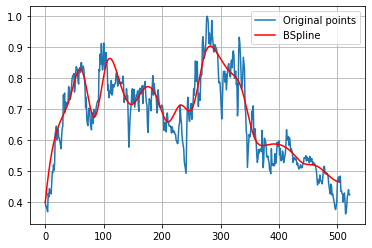

In [ ]:
import scipy.interpolate as interpolate

t_AALI_25, c_AALI_25, k_AALI_25 = interpolate.splrep(AALI_x25, AALI_y25, s=0, k=3)
print('''\
t_AALI_25: {}
c_AALI_25: {}
k_AALI_25: {}
'''.format(t_AALI_25, c_AALI_25, k_AALI_25))
N = 522
xmin_AALI_25, xmax_AALI_25 = AALI_x25.min(), AALI_x25.max()
xx_AALI_25 = np.linspace(xmin_AALI_25, xmax_AALI_25, N)
spline_AALI_25 = interpolate.BSpline(t_AALI_25, c_AALI_25, k_AALI_25, extrapolate=False)

plt.plot(AALI_x, AALI_y, label='Original points')
plt.plot(xx_AALI_25, spline_AALI_25(xx_AALI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA AALI**

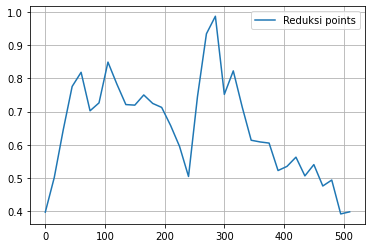

In [ ]:
AALI_x35 = AALI_x[0:522:15]
AALI_y35 = AALI_y[0:522:15]

plt.plot(AALI_x35, AALI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AALI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_AALI_35: [0.39796101 0.44253601 0.60047964 0.78536052 0.86492178 0.66312598
 0.69686866 0.90655188 0.76875689 0.71230693 0.70854015 0.76986232
 0.71202125 0.72898853 0.64753139 0.62987504 0.40440109 0.78312683
 0.93247451 1.08902841 0.62978746 0.90202729 0.69578574 0.5954555
 0.60607662 0.63329464 0.49338989 0.53088496 0.59577247 0.46471698
 0.58671773 0.43324137 0.57508193 0.27445882 0.39891053 0.
 0.         0.         0.        ]
k_AALI_35: 3



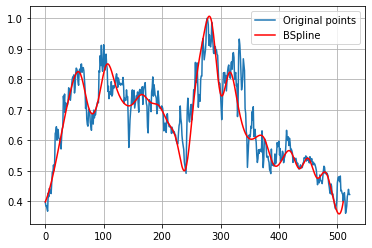

In [ ]:
import scipy.interpolate as interpolate

t_AALI_35, c_AALI_35, k_AALI_35 = interpolate.splrep(AALI_x35, AALI_y35, s=0, k=3)
print('''\
t_AALI_35: {}
c_AALI_35: {}
k_AALI_35: {}
'''.format(t_AALI_35, c_AALI_35, k_AALI_35))
N = 522
xmin_AALI_35, xmax_AALI_35 = AALI_x35.min(), AALI_x35.max()
xx_AALI_35 = np.linspace(xmin_AALI_35, xmax_AALI_35, N)
spline_AALI_35 = interpolate.BSpline(t_AALI_35, c_AALI_35, k_AALI_35, extrapolate=False)

plt.plot(AALI_x, AALI_y, label='Original points')
plt.plot(xx_AALI_35, spline_AALI_35(xx_AALI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA AALI**

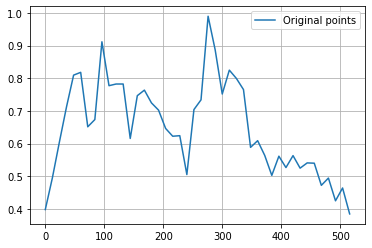

In [ ]:
AALI_x45 = AALI_x[0:522:12]
AALI_y45 = AALI_y[0:522:12]

plt.plot(AALI_x45, AALI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_AALI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_AALI_45: [0.39796101 0.45310396 0.57168687 0.71247643 0.81871678 0.86981249
 0.61020686 0.59752658 1.04051658 0.70979711 0.78355359 0.8498749
 0.51083317 0.80067169 0.76607919 0.71664617 0.71427198 0.64056027
 0.601047   0.68995365 0.38403562 0.8045101  0.62241322 1.10890985
 0.88073454 0.68958619 0.87112626 0.77488369 0.82526084 0.51590246
 0.6417393  0.57019695 0.46012708 0.60460861 0.48942132 0.5968633
 0.5018173  0.54431567 0.56574927 0.43216201 0.53813515 0.32954485
 0.56098593 0.38463185 0.         0.         0.         0.        ]
k_AALI_45: 3



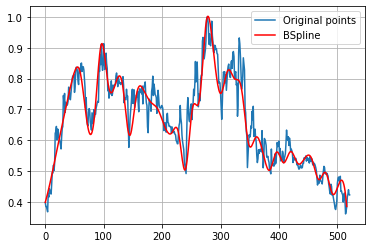

In [ ]:
import scipy.interpolate as interpolate

t_AALI_45, c_AALI_45, k_AALI_45 = interpolate.splrep(AALI_x45, AALI_y45, s=0, k=3)
print('''\
t_AALI_45: {}
c_AALI_45: {}
k_AALI_45: {}
'''.format(t_AALI_45, c_AALI_45, k_AALI_45))
N = 522
xmin_AALI_45, xmax_AALI_45 = AALI_x45.min(), AALI_x45.max()
xx_AALI_45 = np.linspace(xmin_AALI_45, xmax_AALI_45, N)
spline_AALI_45 = interpolate.BSpline(t_AALI_45, c_AALI_45, k_AALI_45, extrapolate=False)

plt.plot(AALI_x, AALI_y, label='Original points')
plt.plot(xx_AALI_45, spline_AALI_45(xx_AALI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. Percobaan 55 Data AALI**

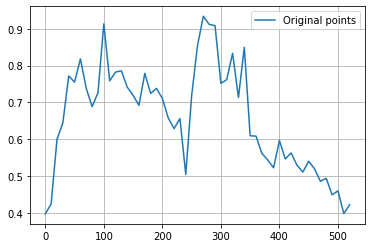

In [ ]:
AALI_x55 = AALI_x[0:522:10]
AALI_y55 = AALI_y[0:522:10]

plt.plot(AALI_x55, AALI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AALI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_AALI_55: [0.39796101 0.26579205 0.66994146 0.59585308 0.83251214 0.70675053
 0.87110282 0.71701179 0.6894316  0.65791044 1.03607916 0.67737918
 0.80543235 0.7947778  0.72975435 0.73519748 0.64578557 0.83472042
 0.68880802 0.75698337 0.71184009 0.66096818 0.59327633 0.74142974
 0.37977764 0.77006592 0.84609322 0.96802203 0.88387194 0.96588022
 0.70158565 0.73798273 0.91792318 0.59031745 1.00143278 0.50090348
 0.65312888 0.53963761 0.56077997 0.48254731 0.64676994 0.51253588
 0.58539729 0.52456681 0.49691069 0.55592105 0.52423436 0.46881718
 0.51870144 0.42277211 0.51091595 0.3214898  0.42300579 0.
 0.         0.         0.        ]
k_AALI_55: 3



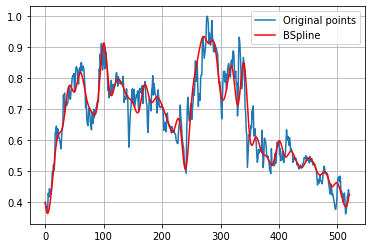

In [ ]:
import scipy.interpolate as interpolate

t_AALI_55, c_AALI_55, k_AALI_55 = interpolate.splrep(AALI_x55, AALI_y55, s=0, k=3)
print('''\
t_AALI_55: {}
c_AALI_55: {}
k_AALI_55: {}
'''.format(t_AALI_55, c_AALI_55, k_AALI_55))
N = 522
xmin_AALI_55, xmax_AALI_55 = AALI_x55.min(), AALI_x55.max()
xx_AALI_55 = np.linspace(xmin_AALI_55, xmax_AALI_55, N)
spline_AALI_55 = interpolate.BSpline(t_AALI_55, c_AALI_55, k_AALI_55, extrapolate=False)

plt.plot(AALI_x, AALI_y, label='Original points')
plt.plot(xx_AALI_55, spline_AALI_55(xx_AALI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:
c_AALI_55.size

57

**6. Percobaan 65 Data AALI**

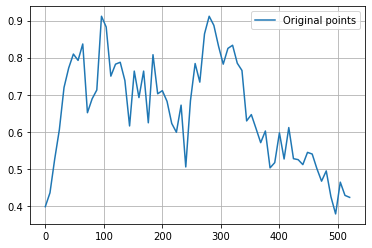

In [ ]:
AALI_x65 = AALI_x[0:522:8]
AALI_y65 = AALI_y[0:522:8]

plt.plot(AALI_x65, AALI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:
AALI_y65.size

66

t_AALI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_AALI_65: [0.39796101 0.38193925 0.51588535 0.58940452 0.74076184 0.76387798
 0.83637843 0.74776438 0.92766326 0.56198658 0.73255693 0.64043433
 0.98121252 0.9041056  0.69829051 0.80274304 0.78462372 0.78325489
 0.51093832 0.86687108 0.603212   0.87334109 0.48505827 0.93132306
 0.63658892 0.7366156  0.68226058 0.62618939 0.54768377 0.77491927
 0.38325268 0.72267621 0.82808509 0.66906471 0.89872889 0.91969345
 0.89188734 0.83419138 0.75604746 0.83550515 0.85090686 0.76086029
 0.81483089 0.57164569 0.67408958 0.60955607 0.54074274 0.65094979
 0.46771338 0.49351057 0.65850197 0.45464452 0.68207712 0.48488204
 0.54290641 0.49194

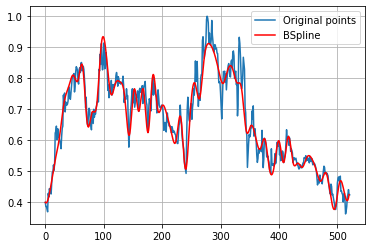

In [ ]:
import scipy.interpolate as interpolate

t_AALI_65, c_AALI_65, k_AALI_65 = interpolate.splrep(AALI_x65, AALI_y65, s=0, k=3)
print('''\
t_AALI_65: {}
c_AALI_65: {}
k_AALI_65: {}
'''.format(t_AALI_65, c_AALI_65, k_AALI_65))
N = 522
xmin_AALI_65, xmax_AALI_65 = AALI_x65.min(), AALI_x65.max()
xx_AALI_65 = np.linspace(xmin_AALI_65, xmax_AALI_65, N)
spline_AALI_65 = interpolate.BSpline(t_AALI_65, c_AALI_65, k_AALI_65, extrapolate=False)

plt.plot(AALI_x, AALI_y, label='Original points')
plt.plot(xx_AALI_65, spline_AALI_65(xx_AALI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:
c_AALI_65.size

70

**RMSE SAHAM AALI**

[RMSE LINK TOWARD DATA SCIENCE](https://towardsdatascience.com/linear-regression-in-python-9a1f5f000606)

[SCIKIT LEARN ](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html)

In [ ]:
#RMSE 15 DATA AALI
y_true_AALI_15 = AALI_y.tolist()
y_pred_AALI_15 = spline_AALI_15(xx_AALI_15).tolist()
mse_AALI_15 = mean_squared_error(y_true_AALI_15, y_pred_AALI_15)
rmse_AALI_15 = np.sqrt(mse_AALI_15)
print("rmse AALI 15 =",rmse_AALI_15)

#RMSE 25 DATA AALI
y_true_AALI_25 = AALI_y.tolist()
y_pred_AALI_25 = spline_AALI_25(xx_AALI_25).tolist()
mse_AALI_25 = mean_squared_error(y_true_AALI_25, y_pred_AALI_25)
rmse_AALI_25 = np.sqrt(mse_AALI_25)
print("rmse AALI 25 =",rmse_AALI_25)

#RMSE 35 DATA AALI
y_true_AALI_35 = AALI_y.tolist()
y_pred_AALI_35 = spline_AALI_35(xx_AALI_35).tolist()
mse_AALI_35 = mean_squared_error(y_true_AALI_35, y_pred_AALI_35)
rmse_AALI_35 = np.sqrt(mse_AALI_35)
print("rmse AALI 35 =",rmse_AALI_35)

#RMSE 45 DATA AALI
y_true_AALI_45 = AALI_y.tolist()
y_pred_AALI_45 = spline_AALI_45(xx_AALI_45).tolist()
mse_AALI_45 = mean_squared_error(y_true_AALI_45, y_pred_AALI_45)
rmse_AALI_45 = np.sqrt(mse_AALI_45)
print("rmse AALI 45 =",rmse_AALI_45)

#RMSE 55 DATA AALI
y_true_AALI_55 = AALI_y.tolist()
y_pred_AALI_55 = spline_AALI_55(xx_AALI_55).tolist()
mse_AALI_55 = mean_squared_error(y_true_AALI_55, y_pred_AALI_55)
rmse_AALI_55 = np.sqrt(mse_AALI_55)
print("rmse AALI 55 =",rmse_AALI_55)

#RMSE 65 DATA AALI
y_true_AALI_65 = AALI_y.tolist()
y_pred_AALI_65 = spline_AALI_65(xx_AALI_65).tolist()
mse_AALI_65 = mean_squared_error(y_true_AALI_65, y_pred_AALI_65)
rmse_AALI_65 = np.sqrt(mse_AALI_65)
print("rmse AALI 65 =",rmse_AALI_65)

rmse AALI 15 = 0.07667121116973079
rmse AALI 25 = 0.06666902022125545
rmse AALI 35 = 0.05857161391204736
rmse AALI 45 = 0.04759725504782426
rmse AALI 55 = 0.047774602160308516
rmse AALI 65 = 0.040332348016911816


# **SAHAM ACES**

No handles with labels found to put in legend.


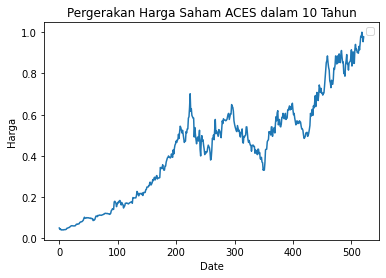

In [ ]:
ACES = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ACES.JK.csv')

ACES_x = ACES['No'].values
ACES_y = ACES['Skala'].values

plt.plot(ACES_x,ACES_y)
plt.title('Pergerakan Harga Saham ACES dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. Percobaan 15 Data ACES**

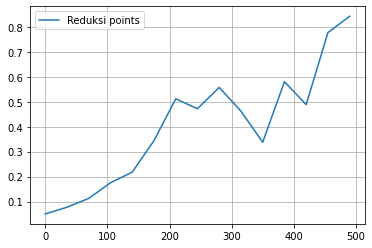

In [ ]:
ACES_x15 = ACES_x[0:522:35]
ACES_y15 = ACES_y[0:522:35]

plt.plot(ACES_x15, ACES_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ACES_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ACES_15: [0.0504918  0.0762115  0.07544585 0.18721374 0.20021623 0.32011805
 0.58488533 0.40919307 0.61112927 0.49055213 0.20043271 0.73394654
 0.21634894 1.11313701 0.84262295 0.         0.         0.
 0.        ]
k_ACES_15: 3



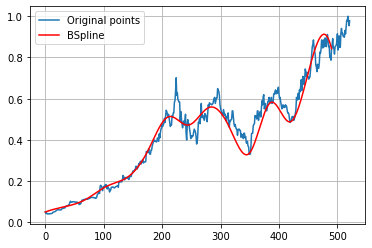

In [ ]:
import scipy.interpolate as interpolate

t_ACES_15, c_ACES_15, k_ACES_15 = interpolate.splrep(ACES_x15, ACES_y15, s=0, k=3)
print('''\
t_ACES_15: {}
c_ACES_15: {}
k_ACES_15: {}
'''.format(t_ACES_15, c_ACES_15, k_ACES_15))
N = 522
xmin, xmax = ACES_x15.min(), ACES_x15.max()
xx_ACES_15 = np.linspace(xmin, xmax, N)
spline_ACES_15 = interpolate.BSpline(t_ACES_15, c_ACES_15, k_ACES_15, extrapolate=False)

plt.plot(ACES_x, ACES_y, label='Original points')
plt.plot(xx_ACES_15, spline_ACES_15(xx_ACES_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. Percobaan 25 Data ACES**

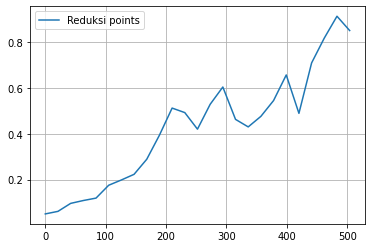

In [ ]:
ACES_x25 = ACES_x[0:522:21]
ACES_y25 = ACES_y[0:522:21]

plt.plot(ACES_x25, ACES_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ACES_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ACES_25: [0.0504918  0.03700923 0.0990963  0.11168342 0.10413799 0.18783018
 0.1970003  0.21433254 0.28337446 0.38331717 0.5440126  0.50948488
 0.36886755 0.53307771 0.66603471 0.42245557 0.41791349 0.48293965
 0.50278694 0.77148638 0.34569378 0.77688603 0.80229456 1.0054101
 0.84918033 0.         0.         0.         0.        ]
k_ACES_25: 3



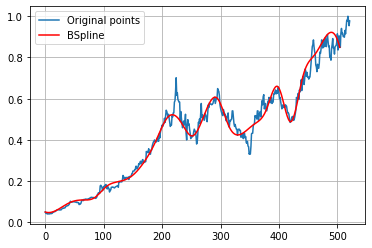

In [ ]:
import scipy.interpolate as interpolate

t_ACES_25, c_ACES_25, k_ACES_25 = interpolate.splrep(ACES_x25, ACES_y25, s=0, k=3)
print('''\
t_ACES_25: {}
c_ACES_25: {}
k_ACES_25: {}
'''.format(t_ACES_25, c_ACES_25, k_ACES_25))
N = 522
xmin, xmax = ACES_x25.min(), ACES_x25.max()
xx_ACES_25 = np.linspace(xmin, xmax, N)
spline_ACES_25 = interpolate.BSpline(t_ACES_25, c_ACES_25, k_ACES_25, extrapolate=False)

plt.plot(ACES_x, ACES_y, label='Original points')
plt.plot(xx_ACES_25, spline_ACES_25(xx_ACES_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. Percobaan 35 Data ACES**

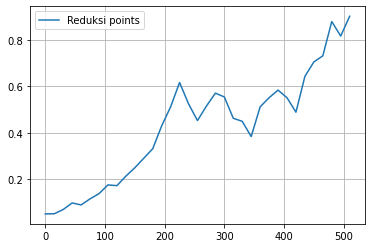

In [ ]:
ACES_x35 = ACES_x[0:522:15]
ACES_y35 = ACES_y[0:522:15]

plt.plot(ACES_x35, ACES_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ACES_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ACES_35: [0.0504918  0.04804128 0.04850761 0.11166481 0.07527334 0.1223238
 0.12789047 0.19234383 0.15519323 0.21967012 0.2448148  0.29615265
 0.31155822 0.44449973 0.48749204 0.67438458 0.51333031 0.41983515
 0.52208319 0.58035668 0.57944091 0.42646986 0.48845015 0.31481151
 0.55394314 0.53826837 0.5979014  0.57176539 0.41995509 0.6795618
 0.71753541 0.67980477 1.04023945 0.6675852  0.90163934 0.
 0.         0.         0.        ]
k_ACES_35: 3



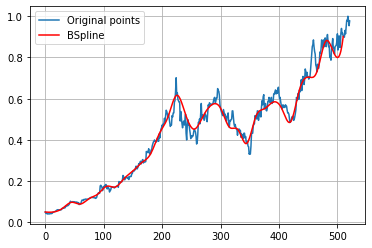

In [ ]:
import scipy.interpolate as interpolate

t_ACES_35, c_ACES_35, k_ACES_35 = interpolate.splrep(ACES_x35, ACES_y35, s=0, k=3)
print('''\
t_ACES_35: {}
c_ACES_35: {}
k_ACES_35: {}
'''.format(t_ACES_35, c_ACES_35, k_ACES_35))
N = 522
xmin, xmax = ACES_x35.min(), ACES_x35.max()
xx_ACES_35 = np.linspace(xmin, xmax, N)
spline_ACES_35 = interpolate.BSpline(t_ACES_35, c_ACES_35, k_ACES_35, extrapolate=False)

plt.plot(ACES_x, ACES_y, label='Original points')
plt.plot(xx_ACES_35, spline_ACES_35(xx_ACES_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. Percobaan 45 Data ACES**

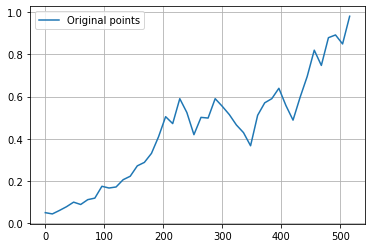

In [ ]:
ACES_x45 = ACES_x[0:522:12]
ACES_y45 = ACES_y[0:522:12]

plt.plot(ACES_x45, ACES_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ACES_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ACES_45: [0.0504918  0.03179853 0.0590259  0.07397482 0.11346876 0.07411736
 0.12514378 0.0980944  0.19854419 0.16018784 0.16398313 0.21666651
 0.20869508 0.28625809 0.27905945 0.32865166 0.39321916 0.55748811
 0.40633659 0.64995242 0.53483733 0.35823926 0.55023844 0.45064306
 0.63735325 0.54092754 0.52352676 0.45349    0.45595586 0.29973573
 0.54837991 0.57559709 0.57218254 0.67665634 0.55725768 0.43857524
 0.61958892 0.66339696 0.89731503 0.66537571 0.92642804 0.89258167
 0.78403703 0.98032787 0.         0.         0.         0.        ]
k_ACES_45: 3



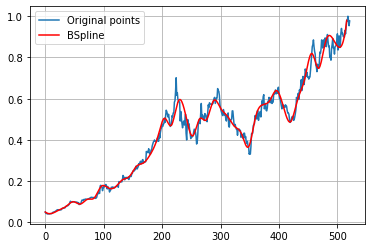

In [ ]:
import scipy.interpolate as interpolate

t_ACES_45, c_ACES_45, k_ACES_45 = interpolate.splrep(ACES_x45, ACES_y45, s=0, k=3)
print('''\
t_ACES_45: {}
c_ACES_45: {}
k_ACES_45: {}
'''.format(t_ACES_45, c_ACES_45, k_ACES_45))
N = 522
xmin_ACES_45, xmax_ACES_45 = ACES_x45.min(), ACES_x45.max()
xx_ACES_45 = np.linspace(xmin_ACES_45, xmax_ACES_45, N)
spline_ACES_45 = interpolate.BSpline(t_ACES_45, c_ACES_45, k_ACES_45, extrapolate=False)

plt.plot(ACES_x, ACES_y, label='Original points')
plt.plot(xx_ACES_45, spline_ACES_45(xx_ACES_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. Percobaan 55 Data ACES**

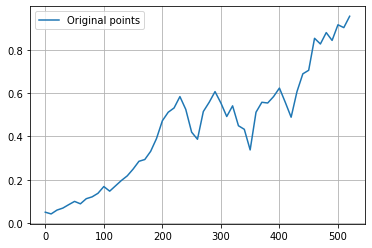

In [ ]:
ACES_x55 = ACES_x[0:522:10]
ACES_y55 = ACES_y[0:522:10]

plt.plot(ACES_x55, ACES_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ACES_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ACES_55: [0.0504918  0.02607701 0.06292794 0.06741137 0.08335492 0.11064436
 0.07603485 0.1202982  0.11949367 0.12959596 0.18835198 0.13011088
 0.1764504  0.19687439 0.21637989 0.24580277 0.29549101 0.2837086
 0.33033034 0.38185528 0.48323214 0.51800305 0.51360811 0.61444975
 0.53023224 0.41216228 0.33915143 0.55254348 0.53919924 0.63492185
 0.5604576  0.4478379  0.59901046 0.40202189 0.48798396 0.24276358
 0.56719121 0.55732402 0.54777501 0.5761661  0.64919991 0.56473917
 0.43610572 0.6219855  0.71529654 0.64797587 0.92230816 0.77754558
 0.92488655 0.79503936 1.00257849 0.83477633 0.95409836 0.
 0.         0.         0.        ]
k_ACES_55: 3



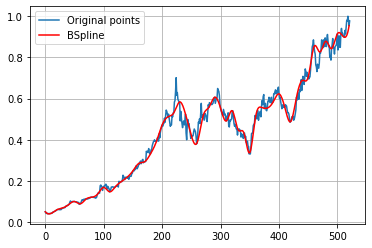

In [ ]:
import scipy.interpolate as interpolate

t_ACES_55, c_ACES_55, k_ACES_55 = interpolate.splrep(ACES_x55, ACES_y55, s=0, k=3)
print('''\
t_ACES_55: {}
c_ACES_55: {}
k_ACES_55: {}
'''.format(t_ACES_55, c_ACES_55, k_ACES_55))
N = 522
xmin_ACES_55, xmax_ACES_55 = ACES_x55.min(), ACES_x55.max()
xx_ACES_55 = np.linspace(xmin_ACES_55, xmax_ACES_55, N)
spline_ACES_55 = interpolate.BSpline(t_ACES_55, c_ACES_55, k_ACES_55, extrapolate=False)

plt.plot(ACES_x, ACES_y, label='Original points')
plt.plot(xx_ACES_55, spline_ACES_55(xx_ACES_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. Percobaan 65 Data ACES**

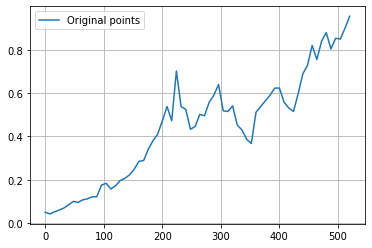

In [ ]:
ACES_x65 = ACES_x[0:522:8]
ACES_y65 = ACES_y[0:522:8]

plt.plot(ACES_x65, ACES_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ACES_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ACES_65: [0.0504918  0.03393    0.05115639 0.06080639 0.06910718 0.08374849
 0.10737427 0.08872164 0.11216541 0.10786264 0.12917092 0.10332252
 0.18934226 0.19176743 0.14522734 0.1715855  0.20121757 0.20387211
 0.22263826 0.24327976 0.29932468 0.27089695 0.34823506 0.38206444
 0.40547439 0.45505439 0.60709493 0.3427954  0.85451035 0.44899927
 0.57572209 0.39565336 0.43838577 0.5262134  0.46659669 0.57789164
 0.56609904 0.69869581 0.4751833  0.5087677  0.57827049 0.424052
 0.4402756  0.39189477 0.31345681 0.5575567  0.52516886 0.56799736
 0.58644824 0.62719326 0.64248363 0.54057716 0.53947004 0.48842793
 0.59534284 0.7105285

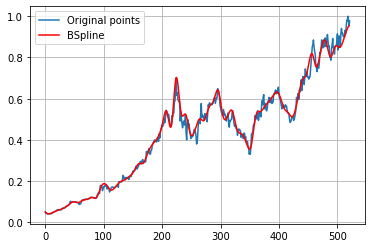

In [ ]:
import scipy.interpolate as interpolate

t_ACES_65, c_ACES_65, k_ACES_65 = interpolate.splrep(ACES_x65, ACES_y65, s=0, k=3)
print('''\
t_ACES_65: {}
c_ACES_65: {}
k_ACES_65: {}
'''.format(t_ACES_65, c_ACES_65, k_ACES_65))
N = 522
xmin, xmax = ACES_x65.min(), ACES_x65.max()
xx_ACES_65 = np.linspace(xmin, xmax, N)
spline_ACES_65 = interpolate.BSpline(t_ACES_65, c_ACES_65, k_ACES_65, extrapolate=False)

plt.plot(ACES_x, ACES_y, label='Original points')
plt.plot(xx_ACES_65, spline_ACES_65(xx_ACES_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ACES**

In [ ]:

#RMSE 15 DATA ACES
y_true_ACES_15 = ACES_y.tolist()
y_pred_ACES_15 = spline_ACES_15(xx_ACES_15).tolist()
mse_ACES_15 = mean_squared_error(y_true_ACES_15, y_pred_ACES_15)
rmse_ACES_15 = np.sqrt(mse_ACES_15)
print("rmse ACES 15 =",rmse_ACES_15)

#RMSE 25 DATA ACES
y_true_ACES_25 = ACES_y.tolist()
y_pred_ACES_25 = spline_ACES_25(xx_ACES_25).tolist()
mse_ACES_25 = mean_squared_error(y_true_ACES_25, y_pred_ACES_25)
rmse_ACES_25 = np.sqrt(mse_ACES_25)
print("rmse ACES 25 =",rmse_ACES_25)

#RMSE 35 DATA ACES
y_true_ACES_35 = ACES_y.tolist()
y_pred_ACES_35 = spline_ACES_35(xx_ACES_35).tolist()
mse_ACES_35 = mean_squared_error(y_true_ACES_35, y_pred_ACES_35)
rmse_ACES_35 = np.sqrt(mse_ACES_35)
print("rmse ACES 35 =",rmse_ACES_35)

#RMSE 45 DATA ACES
y_true_ACES_45 = ACES_y.tolist()
y_pred_ACES_45 = spline_ACES_45(xx_ACES_45).tolist()
mse_ACES_45 = mean_squared_error(y_true_ACES_45, y_pred_ACES_45)
rmse_ACES_45 = np.sqrt(mse_ACES_45)
print("rmse ACES 45 =",rmse_ACES_45)

#RMSE 55 DATA ACES
y_true_ACES_55 = ACES_y.tolist()
y_pred_ACES_55 = spline_ACES_55(xx_ACES_55).tolist()
mse_ACES_55 = mean_squared_error(y_true_ACES_55, y_pred_ACES_55)
rmse_ACES_55 = np.sqrt(mse_ACES_55)
print("rmse ACES 55 =",rmse_ACES_55)

#RMSE 65 DATA ACES
y_true_ACES_65 = ACES_y.tolist()
y_pred_ACES_65 = spline_ACES_65(xx_ACES_65).tolist()
mse_ACES_65 = mean_squared_error(y_true_ACES_65, y_pred_ACES_65)
rmse_ACES_65 = np.sqrt(mse_ACES_65)
print("rmse ACES 65 =",rmse_ACES_65)

rmse ACES 15 = 0.08978369416000354
rmse ACES 25 = 0.0545616321060945
rmse ACES 35 = 0.050243365422660016
rmse ACES 45 = 0.03641367798529266
rmse ACES 55 = 0.030801540818481323
rmse ACES 65 = 0.02501303510448256


# **SAHAM ADHI**

No handles with labels found to put in legend.


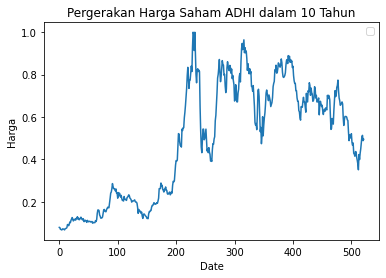

In [ ]:
ADHI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ADHI.JK.csv')

ADHI_x = ADHI['No'].values
ADHI_y = ADHI['Skala'].values

plt.plot(ADHI_x,ADHI_y)
plt.title('Pergerakan Harga Saham ADHI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. Percobaan 15 Data ADHI**

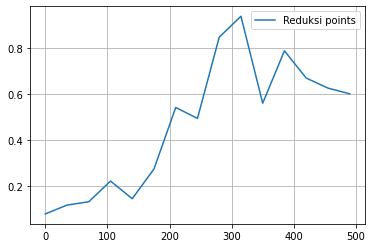

In [ ]:
ADHI_x15 = ADHI_x[0:522:35]
ADHI_y15 = ADHI_y[0:522:35]

plt.plot(ADHI_x15, ADHI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADHI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ADHI_15: [0.07947024 0.16625398 0.03305561 0.28684021 0.09123739 0.22238353
 0.67220893 0.34706686 0.91170565 1.10014253 0.33011771 0.9489261
 0.50174999 0.68575863 0.60256763 0.         0.         0.
 0.        ]
k_ADHI_15: 3



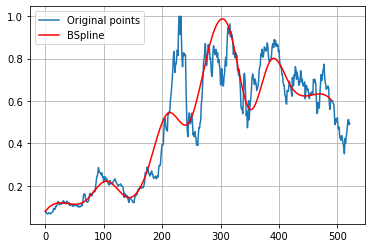

In [ ]:
import scipy.interpolate as interpolate

t_ADHI_15, c_ADHI_15, k_ADHI_15 = interpolate.splrep(ADHI_x15, ADHI_y15, s=0, k=3)
print('''\
t_ADHI_15: {}
c_ADHI_15: {}
k_ADHI_15: {}
'''.format(t_ADHI_15, c_ADHI_15, k_ADHI_15))
N = 522
xmin_ADHI_15, xmax_ADHI_15 = ADHI_x15.min(), ADHI_x15.max()
xx_ADHI_15 = np.linspace(xmin_ADHI_15, xmax_ADHI_15, N)
spline_ADHI_15 = interpolate.BSpline(t_ADHI_15, c_ADHI_15, k_ADHI_15, extrapolate=False)

plt.plot(ADHI_x, ADHI_y, label='Original points')
plt.plot(xx_ADHI_15, spline_ADHI_15(xx_ADHI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. Percobaan 25 Data ADHI**

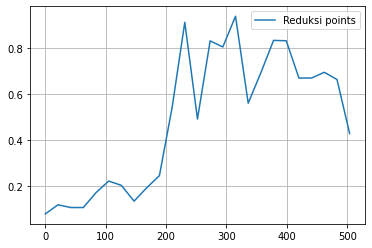

In [ ]:
ADHI_x25 = ADHI_x[0:522:21]
ADHI_y25 = ADHI_y[0:522:21]

plt.plot(ADHI_x25, ADHI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADHI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ADHI_25: [0.07947024 0.13571785 0.11200821 0.08993484 0.17747973 0.23325872
 0.22458537 0.09224081 0.21704783 0.19983215 0.46176999 1.21137399
 0.17618061 1.04020033 0.66170048 1.15273369 0.36975822 0.73777288
 0.84716987 0.88453753 0.61630358 0.67777273 0.70758252 0.69484813
 0.42929041 0.         0.         0.         0.        ]
k_ADHI_25: 3



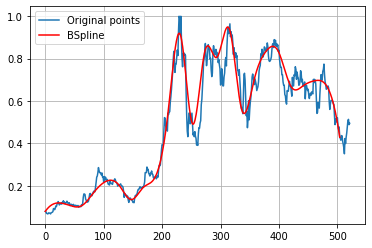

In [ ]:
import scipy.interpolate as interpolate

t_ADHI_25, c_ADHI_25, k_ADHI_25 = interpolate.splrep(ADHI_x25, ADHI_y25, s=0, k=3)
print('''\
t_ADHI_25: {}
c_ADHI_25: {}
k_ADHI_25: {}
'''.format(t_ADHI_25, c_ADHI_25, k_ADHI_25))
N = 522
xmin_ADHI_25, xmax_ADHI_25 = ADHI_x25.min(), ADHI_x25.max()
xx_ADHI_25 = np.linspace(xmin_ADHI_25, xmax_ADHI_25, N)
spline_ADHI_25 = interpolate.BSpline(t_ADHI_25, c_ADHI_25, k_ADHI_25, extrapolate=False)

plt.plot(ADHI_x, ADHI_y, label='Original points')
plt.plot(xx_ADHI_25, spline_ADHI_25(xx_ADHI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. Percobaan 35 Data ADHI**

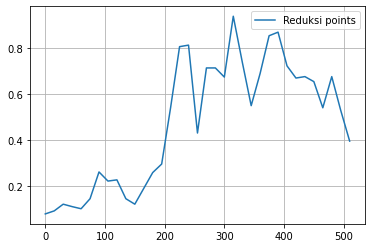

In [ ]:
ADHI_x35 = ADHI_x[0:522:15]
ADHI_y35 = ADHI_y[0:522:15]

plt.plot(ADHI_x35, ADHI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADHI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ADHI_35: [0.07947024 0.06473609 0.14072618 0.10944111 0.09688067 0.11495771
 0.3174618  0.18870584 0.26281484 0.12692239 0.10366892 0.18952881
 0.28258732 0.23773804 0.54659264 0.83417749 0.96437598 0.19572909
 0.84343626 0.72191908 0.56028063 1.08994085 0.72234944 0.47100105
 0.69960725 0.87985693 0.91371732 0.69168944 0.66550496 0.67381532
 0.70422368 0.44315118 0.88333664 0.35134815 0.39650823 0.
 0.         0.         0.        ]
k_ADHI_35: 3



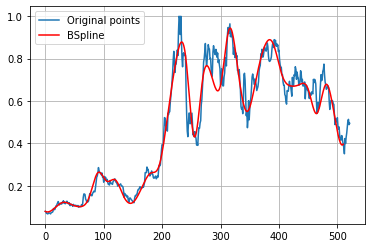

In [ ]:
import scipy.interpolate as interpolate

t_ADHI_35, c_ADHI_35, k_ADHI_35 = interpolate.splrep(ADHI_x35, ADHI_y35, s=0, k=3)
print('''\
t_ADHI_35: {}
c_ADHI_35: {}
k_ADHI_35: {}
'''.format(t_ADHI_35, c_ADHI_35, k_ADHI_35))
N = 522
xmin_ADHI_35, xmax_ADHI_35 = ADHI_x35.min(), ADHI_x35.max()
xx_ADHI_35 = np.linspace(xmin_ADHI_35, xmax_ADHI_35, N)
spline_ADHI_35 = interpolate.BSpline(t_ADHI_35, c_ADHI_35, k_ADHI_35, extrapolate=False)

plt.plot(ADHI_x, ADHI_y, label='Original points')
plt.plot(xx_ADHI_35, spline_ADHI_35(xx_ADHI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. Percobaan 45 Data ADHI**

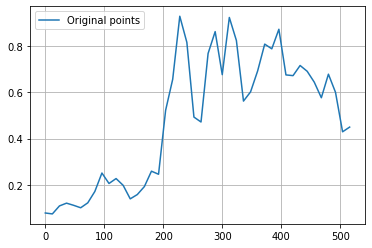

In [ ]:
ADHI_x45 = ADHI_x[0:522:12]
ADHI_y45 = ADHI_y[0:522:12]

plt.plot(ADHI_x45, ADHI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADHI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ADHI_45: [0.07947024 0.04694368 0.11339747 0.12515815 0.11415664 0.0937117
 0.12291804 0.15368934 0.2954371  0.17449627 0.24631362 0.20713684
 0.11719258 0.16647677 0.17054321 0.31161468 0.14061418 0.60407503
 0.5742144  1.03283485 0.85735659 0.42514929 0.398343   0.81061807
 0.96050991 0.51291422 1.04081565 0.85494427 0.47451107 0.6165509
 0.66723554 0.8637939  0.71998469 0.97690081 0.5988277  0.67404564
 0.73251433 0.68567903 0.66469019 0.51449077 0.73352483 0.57735817
 0.30764432 0.44958414 0.         0.         0.         0.        ]
k_ADHI_45: 3



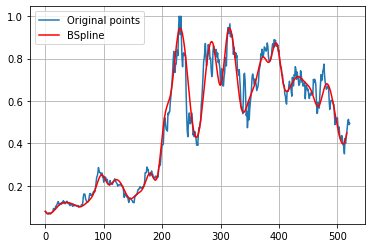

In [ ]:
import scipy.interpolate as interpolate

t_ADHI_45, c_ADHI_45, k_ADHI_45 = interpolate.splrep(ADHI_x45, ADHI_y45, s=0, k=3)
print('''\
t_ADHI_45: {}
c_ADHI_45: {}
k_ADHI_45: {}
'''.format(t_ADHI_45, c_ADHI_45, k_ADHI_45))
N = 522
xmin_ADHI_45, xmax_ADHI_45 = ADHI_x45.min(), ADHI_x45.max()
xx_ADHI_45 = np.linspace(xmin_ADHI_45, xmax_ADHI_45, N)
spline_ADHI_45 = interpolate.BSpline(t_ADHI_45, c_ADHI_45, k_ADHI_45, extrapolate=False)

plt.plot(ADHI_x, ADHI_y, label='Original points')
plt.plot(xx_ADHI_45, spline_ADHI_45(xx_ADHI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA ADHI**

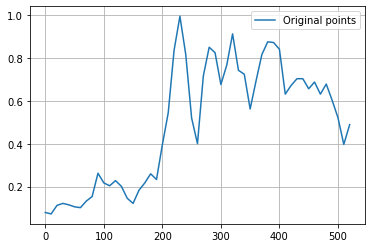

In [ ]:
ADHI_x55 = ADHI_x[0:522:10]
ADHI_y55 = ADHI_y[0:522:10]

plt.plot(ADHI_x55, ADHI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADHI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ADHI_55: [0.07947024 0.03715938 0.12104523 0.1236197  0.11495923 0.10793451
 0.08906527 0.14772591 0.11473286 0.31519803 0.19798578 0.19616956
 0.24117701 0.20600999 0.14272942 0.09724564 0.19941491 0.20178409
 0.29675944 0.16879427 0.42673851 0.49245481 0.86172835 1.06725684
 0.82951238 0.50210415 0.2772957  0.78870568 0.8592748  0.86822709
 0.61086331 0.74130214 1.01731068 0.65699769 0.80503825 0.46191709
 0.71683285 0.82003846 0.89224083 0.85614651 0.90958876 0.54458735
 0.6960617  0.69869045 0.7240278  0.62004965 0.72963481 0.58259906
 0.72396879 0.5865157  0.53166038 0.27468546 0.48861054 0.
 0.         0.         0.        ]
k_ADHI_55: 3



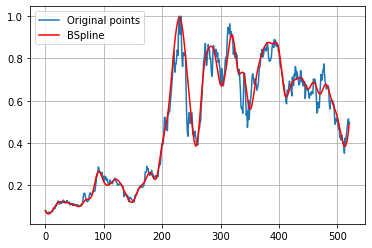

In [ ]:
import scipy.interpolate as interpolate

t_ADHI_55, c_ADHI_55, k_ADHI_55 = interpolate.splrep(ADHI_x55, ADHI_y55, s=0, k=3)
print('''\
t_ADHI_55: {}
c_ADHI_55: {}
k_ADHI_55: {}
'''.format(t_ADHI_55, c_ADHI_55, k_ADHI_55))
N = 522
xmin_ADHI_55, xmax_ADHI_55 = ADHI_x55.min(), ADHI_x55.max()
xx_ADHI_55 = np.linspace(xmin_ADHI_55, xmax_ADHI_55, N)
spline_ADHI_55 = interpolate.BSpline(t_ADHI_55, c_ADHI_55, k_ADHI_55, extrapolate=False)

plt.plot(ADHI_x, ADHI_y, label='Original points')
plt.plot(xx_ADHI_55, spline_ADHI_55(xx_ADHI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. Percobaan 65 Data ADHI**

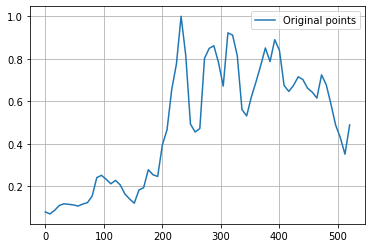

In [ ]:
ADHI_x65 = ADHI_x[0:522:8]
ADHI_y65 = ADHI_y[0:522:8]

plt.plot(ADHI_x65, ADHI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADHI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ADHI_65: [0.07947024 0.05999865 0.0773542  0.11332856 0.11994163 0.11419069
 0.11468674 0.10255875 0.11878721 0.12162993 0.13376628 0.26516037
 0.2519494  0.23697604 0.19882147 0.23926133 0.2110208  0.15639126
 0.14884454 0.09061453 0.21187592 0.15857114 0.31410379 0.25388879
 0.19616973 0.43957875 0.41371841 0.7028977  0.70845825 1.11226906
 0.84246551 0.4052794  0.49271366 0.35763723 0.90587678 0.82680232
 0.88094592 0.81498594 0.54786074 1.02270688 0.89243283 0.87510432
 0.4945604  0.51619354 0.62743031 0.6925207  0.75177386 0.90862131
 0.71839415 0.93843558 0.86667522 0.63395246 0.6437722  0.66862195
 0.72799726 0.70917

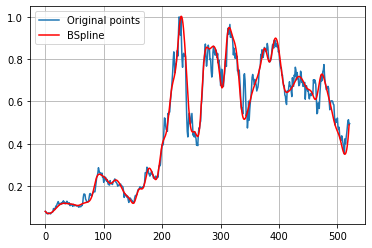

In [ ]:
import scipy.interpolate as interpolate

t_ADHI_65, c_ADHI_65, k_ADHI_65 = interpolate.splrep(ADHI_x65, ADHI_y65, s=0, k=3)
print('''\
t_ADHI_65: {}
c_ADHI_65: {}
k_ADHI_65: {}
'''.format(t_ADHI_65, c_ADHI_65, k_ADHI_65))
N = 522
xmin, xmax = ADHI_x65.min(), ADHI_x65.max()
xx_ADHI_65 = np.linspace(xmin, xmax, N)
spline_ADHI_65 = interpolate.BSpline(t_ADHI_65, c_ADHI_65, k_ADHI_65, extrapolate=False)

plt.plot(ADHI_x, ADHI_y, label='Original points')
plt.plot(xx_ADHI_65, spline_ADHI_65(xx_ADHI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ADHI**

In [ ]:

#RMSE 15 DATA ADHI
y_true_ADHI_15 = ADHI_y.tolist()
y_pred_ADHI_15 = spline_ADHI_15(xx_ADHI_15).tolist()
mse_ADHI_15 = mean_squared_error(y_true_ADHI_15, y_pred_ADHI_15)
rmse_ADHI_15 = np.sqrt(mse_ADHI_15)
print("rmse ADHI 15 =",rmse_ADHI_15)

#RMSE 25 DATA ADHI
y_true_ADHI_25 = ADHI_y.tolist()
y_pred_ADHI_25 = spline_ADHI_25(xx_ADHI_25).tolist()
mse_ADHI_25 = mean_squared_error(y_true_ADHI_25, y_pred_ADHI_25)
rmse_ADHI_25 = np.sqrt(mse_ADHI_25)
print("rmse ADHI 25 =",rmse_ADHI_25)

#RMSE 35 DATA ADHI
y_true_ADHI_35 = ADHI_y.tolist()
y_pred_ADHI_35 = spline_ADHI_35(xx_ADHI_35).tolist()
mse_ADHI_35 = mean_squared_error(y_true_ADHI_35, y_pred_ADHI_35)
rmse_ADHI_35 = np.sqrt(mse_ADHI_35)
print("rmse ADHI 35 =",rmse_ADHI_35)

#RMSE 45 DATA ADHI
y_true_ADHI_45 = ADHI_y.tolist()
y_pred_ADHI_45 = spline_ADHI_45(xx_ADHI_45).tolist()
mse_ADHI_45 = mean_squared_error(y_true_ADHI_45, y_pred_ADHI_45)
rmse_ADHI_45 = np.sqrt(mse_ADHI_45)
print("rmse ADHI 45 =",rmse_ADHI_45)

#RMSE 55 DATA ADHI
y_true_ADHI_55 = ADHI_y.tolist()
y_pred_ADHI_55 = spline_ADHI_55(xx_ADHI_55).tolist()
mse_ADHI_55 = mean_squared_error(y_true_ADHI_55, y_pred_ADHI_55)
rmse_ADHI_55 = np.sqrt(mse_ADHI_55)
print("rmse ADHI 55 =",rmse_ADHI_55)

#RMSE 65 DATA ADHI
y_true_ADHI_65 = ADHI_y.tolist()
y_pred_ADHI_65 = spline_ADHI_65(xx_ADHI_65).tolist()
mse_ADHI_65 = mean_squared_error(y_true_ADHI_65, y_pred_ADHI_65)
rmse_ADHI_65 = np.sqrt(mse_ADHI_65)
print("rmse ADHI 65 =",rmse_ADHI_65)

rmse ADHI 15 = 0.1299656127150111
rmse ADHI 25 = 0.0916386619777207
rmse ADHI 35 = 0.08190199841608903
rmse ADHI 45 = 0.06024517495042099
rmse ADHI 55 = 0.051105623417827206
rmse ADHI 65 = 0.04379972238662437


# **ADRO**

No handles with labels found to put in legend.


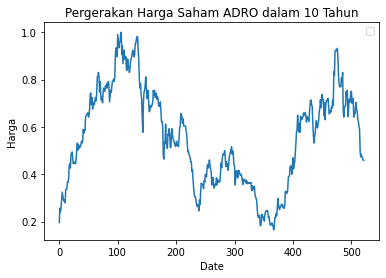

In [ ]:
ADRO = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ADRO.JK.csv')

ADRO_x = ADRO['No'].values
ADRO_y = ADRO['Skala'].values

plt.plot(ADRO_x,ADRO_y)
plt.title('Pergerakan Harga Saham ADRO dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()


**1. PERCOBAAN 15 DATA ADRO**

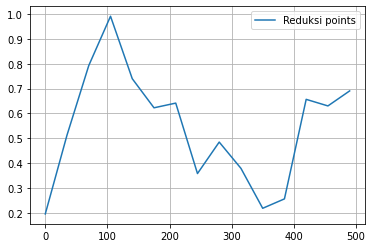

In [ ]:
ADRO_x15 = ADRO_x[0:522:35]
ADRO_y15 = ADRO_y[0:522:35]

plt.plot(ADRO_x15, ADRO_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADRO_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ADRO_15: [0.19622642 0.44647698 0.66553661 1.11930515 0.6871969  0.56964312
 0.77007968 0.19909478 0.58448461 0.37240074 0.20138412 0.13527031
 1.01778625 0.41469178 0.69056604 0.         0.         0.
 0.        ]
k_ADRO_15: 3



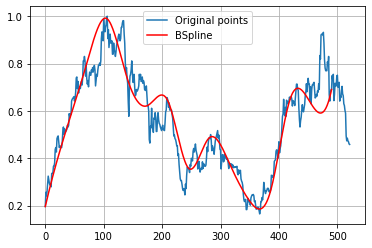

In [ ]:
import scipy.interpolate as interpolate

t_ADRO_15, c_ADRO_15, k_ADRO_15 = interpolate.splrep(ADRO_x15, ADRO_y15, s=0, k=3)
print('''\
t_ADRO_15: {}
c_ADRO_15: {}
k_ADRO_15: {}
'''.format(t_ADRO_15, c_ADRO_15, k_ADRO_15))
N = 522
xmin_ADRO_15, xmax_ADRO_15 = ADRO_x15.min(), ADRO_x15.max()
xx_ADRO_15 = np.linspace(xmin_ADRO_15, xmax_ADRO_15, N)
spline_ADRO_15 = interpolate.BSpline(t_ADRO_15, c_ADRO_15, k_ADRO_15, extrapolate=False)

plt.plot(ADRO_x, ADRO_y, label='Original points')
plt.plot(xx_ADRO_15, spline_ADRO_15(xx_ADRO_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ADRO**

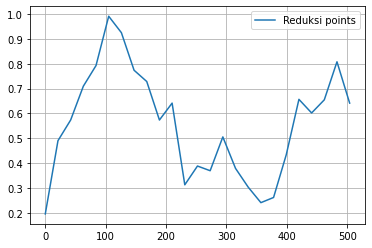

In [ ]:
ADRO_x25 = ADRO_x[0:522:21]
ADRO_y25 = ADRO_y[0:522:21]

plt.plot(ADRO_x25, ADRO_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADRO_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ADRO_25: [0.19622642 0.55089997 0.47555855 0.74452381 0.73570865 1.06735855
 0.93825337 0.72679777 0.796065   0.45875356 0.81043018 0.14858232
 0.47448583 0.28554983 0.60218277 0.33968137 0.31456346 0.22470631
 0.23566791 0.40620694 0.7432779  0.56030409 0.64900063 0.96653742
 0.64150943 0.         0.         0.         0.        ]
k_ADRO_25: 3



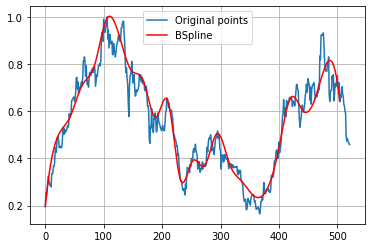

In [ ]:
import scipy.interpolate as interpolate

t_ADRO_25, c_ADRO_25, k_ADRO_25 = interpolate.splrep(ADRO_x25, ADRO_y25, s=0, k=3)
print('''\
t_ADRO_25: {}
c_ADRO_25: {}
k_ADRO_25: {}
'''.format(t_ADRO_25, c_ADRO_25, k_ADRO_25))
N = 522
xmin_ADRO_25, xmax_ADRO_25 = ADRO_x25.min(), ADRO_x25.max()
xx_ADRO_25 = np.linspace(xmin_ADRO_25, xmax_ADRO_25, N)
spline_ADRO_25 = interpolate.BSpline(t_ADRO_25, c_ADRO_25, k_ADRO_25, extrapolate=False)

plt.plot(ADRO_x, ADRO_y, label='Original points')
plt.plot(xx_ADRO_25, spline_ADRO_25(xx_ADRO_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA ADRO**

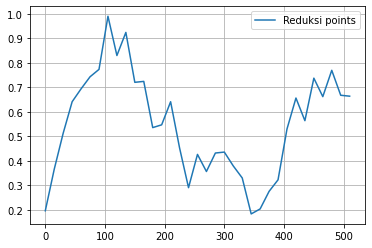

In [ ]:
ADRO_x35 = ADRO_x[0:522:15]
ADRO_y35 = ADRO_y[0:522:15]

plt.plot(ADRO_x35, ADRO_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADRO_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ADRO_35: [0.19622642 0.32445463 0.4605247  0.66392993 0.68196088 0.77426431
 0.68135926 1.14180811 0.69480455 1.06010578 0.61194214 0.81665394
 0.46861189 0.52399283 0.71843565 0.45132119 0.19326073 0.51903211
 0.28910138 0.46418501 0.44661142 0.36446367 0.37100561 0.13264596
 0.19878791 0.2948439  0.27466666 0.54233852 0.73711134 0.44883875
 0.85243931 0.56781912 0.94388579 0.5054156  0.66415094 0.
 0.         0.         0.        ]
k_ADRO_35: 3



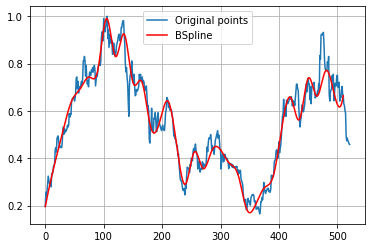

In [ ]:
import scipy.interpolate as interpolate

t_ADRO_35, c_ADRO_35, k_ADRO_35 = interpolate.splrep(ADRO_x35, ADRO_y35, s=0, k=3)
print('''\
t_ADRO_35: {}
c_ADRO_35: {}
k_ADRO_35: {}
'''.format(t_ADRO_35, c_ADRO_35, k_ADRO_35))
N = 522
xmin_ADRO_35, xmax_ADRO_35 = ADRO_x35.min(), ADRO_x35.max()
xx_ADRO_35 = np.linspace(xmin_ADRO_35, xmax_ADRO_35, N)
spline_ADRO_35 = interpolate.BSpline(t_ADRO_35, c_ADRO_35, k_ADRO_35, extrapolate=False)

plt.plot(ADRO_x, ADRO_y, label='Original points')
plt.plot(xx_ADRO_35, spline_ADRO_35(xx_ADRO_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA ADRO**

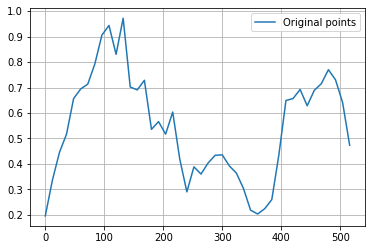

In [ ]:
ADRO_x45 = ADRO_x[0:522:12]
ADRO_y45 = ADRO_y[0:522:12]

plt.plot(ADRO_x45, ADRO_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADRO_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ADRO_45: [0.19622642 0.28550281 0.45163589 0.48795496 0.68935127 0.69426259
 0.69963609 0.78643831 0.90932764 1.01021339 0.71019614 1.13013412
 0.59945606 0.6833624  0.81049057 0.44448663 0.62665727 0.44511073
 0.69478661 0.39838435 0.22488353 0.44547777 0.32528086 0.41566295
 0.43470884 0.44927527 0.3832844  0.37230409 0.31240491 0.20071779
 0.19793147 0.23019782 0.22844705 0.41827814 0.71353474 0.62192254
 0.73839776 0.57920339 0.71460001 0.69447203 0.7980779  0.71008643
 0.62703226 0.47358491 0.         0.         0.         0.        ]
k_ADRO_45: 3



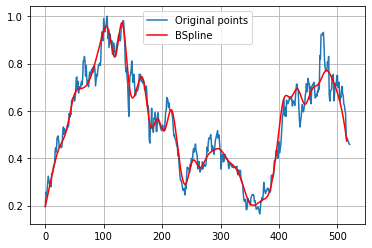

In [ ]:
import scipy.interpolate as interpolate

t_ADRO_45, c_ADRO_45, k_ADRO_45 = interpolate.splrep(ADRO_x45, ADRO_y45, s=0, k=3)
print('''\
t_ADRO_45: {}
c_ADRO_45: {}
k_ADRO_45: {}
'''.format(t_ADRO_45, c_ADRO_45, k_ADRO_45))
N = 522
xmin_ADRO_45, xmax_ADRO_45 = ADRO_x45.min(), ADRO_x45.max()
xx_ADRO_45 = np.linspace(xmin_ADRO_45, xmax_ADRO_45, N)
spline_ADRO_45 = interpolate.BSpline(t_ADRO_45, c_ADRO_45, k_ADRO_45, extrapolate=False)

plt.plot(ADRO_x, ADRO_y, label='Original points')
plt.plot(xx_ADRO_45, spline_ADRO_45(xx_ADRO_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA ADRO**

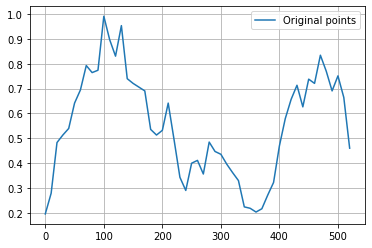

In [ ]:
ADRO_x55 = ADRO_x[0:522:10]
ADRO_y55 = ADRO_y[0:522:10]

plt.plot(ADRO_x55, ADRO_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADRO_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ADRO_55: [0.19622642 0.11805509 0.54124831 0.50762439 0.5159054  0.66648987
 0.66719173 0.83078093 0.76440152 0.69651865 1.09103331 0.88274434
 0.75534784 1.07699639 0.65364773 0.74614853 0.68628643 0.742668
 0.48643781 0.52667512 0.486107   0.72134971 0.47755077 0.33448496
 0.24488675 0.42936425 0.43765623 0.28793534 0.55022504 0.42059846
 0.45039999 0.39289592 0.3553748  0.35918977 0.1889982  0.23198723
 0.19626043 0.20561256 0.28317611 0.29187168 0.48518624 0.5862513
 0.64528027 0.77225027 0.54496394 0.80638453 0.65591304 0.8944916
 0.76989415 0.64479971 0.84413772 0.60340284 0.46037736 0.
 0.         0.         0.        ]
k_ADRO_55: 3



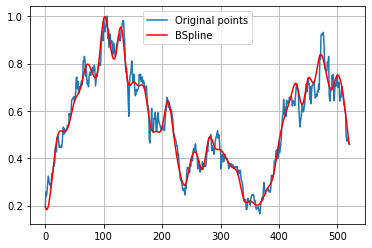

In [ ]:
import scipy.interpolate as interpolate

t_ADRO_55, c_ADRO_55, k_ADRO_55 = interpolate.splrep(ADRO_x55, ADRO_y55, s=0, k=3)
print('''\
t_ADRO_55: {}
c_ADRO_55: {}
k_ADRO_55: {}
'''.format(t_ADRO_55, c_ADRO_55, k_ADRO_55))
N = 522
xmin_ADRO_55, xmax_ADRO_55 = ADRO_x55.min(), ADRO_x55.max()
xx_ADRO_55 = np.linspace(xmin_ADRO_55, xmax_ADRO_55, N)
spline_ADRO_55 = interpolate.BSpline(t_ADRO_55, c_ADRO_55, k_ADRO_55, extrapolate=False)

plt.plot(ADRO_x, ADRO_y, label='Original points')
plt.plot(xx_ADRO_55, spline_ADRO_55(xx_ADRO_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA ADRO**

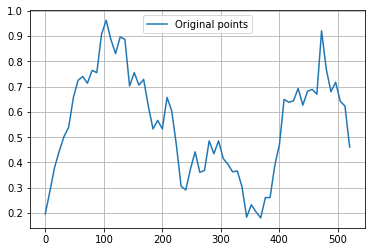

In [ ]:
ADRO_x65 = ADRO_x[0:522:8]
ADRO_y65 = ADRO_y[0:522:8]

plt.plot(ADRO_x65, ADRO_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ADRO_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ADRO_65: [0.19622641 0.2431176  0.37225537 0.44193141 0.51429811 0.5121969
 0.67465014 0.72882519 0.75721892 0.68003498 0.80188643 0.69732495
 0.93711565 0.98817473 0.88377035 0.79749858 0.90736741 0.95039029
 0.61182617 0.8136258  0.6619725  0.77244644 0.61805306 0.49119036
 0.60963833 0.46648274 0.71688353 0.60560576 0.48333492 0.26860172
 0.27622047 0.36991264 0.48563839 0.33659039 0.3302642  0.54989996
 0.37956991 0.53559397 0.38748816 0.40501944 0.34715106 0.37996124
 0.32923042 0.12575861 0.26584837 0.20330075 0.14359013 0.30233873
 0.20931911 0.42264897 0.42083974 0.71286    0.62205987 0.62531562
 0.73705499 0.581181

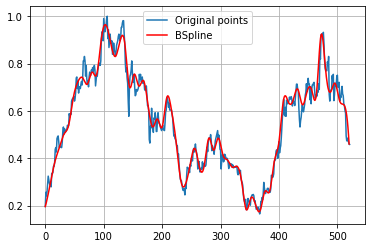

In [ ]:
import scipy.interpolate as interpolate

t_ADRO_65, c_ADRO_65, k_ADRO_65 = interpolate.splrep(ADRO_x65, ADRO_y65, s=0, k=3)
print('''\
t_ADRO_65: {}
c_ADRO_65: {}
k_ADRO_65: {}
'''.format(t_ADRO_65, c_ADRO_65, k_ADRO_65))
N = 522
xmin_ADRO_65, xmax_ADRO_65 = ADRO_x65.min(), ADRO_x65.max()
xx_ADRO_65 = np.linspace(xmin_ADRO_65, xmax_ADRO_65, N)
spline_ADRO_65 = interpolate.BSpline(t_ADRO_65, c_ADRO_65, k_ADRO_65, extrapolate=False)

plt.plot(ADRO_x, ADRO_y, label='Original points')
plt.plot(xx_ADRO_65, spline_ADRO_65(xx_ADRO_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ADRO**

In [ ]:
#RMSE 15 DATA ADRO
y_true_ADRO_15 = ADRO_y.tolist()
y_pred_ADRO_15 = spline_ADRO_15(xx_ADRO_15).tolist()
mse_ADRO_15 = mean_squared_error(y_true_ADRO_15, y_pred_ADRO_15)
rmse_ADRO_15 = np.sqrt(mse_ADRO_15)
print("rmse ADRO 15 =",rmse_ADRO_15)

#RMSE 25 DATA ADRO
y_true_ADRO_25 = ADRO_y.tolist()
y_pred_ADRO_25 = spline_ADRO_25(xx_ADRO_25).tolist()
mse_ADRO_25 = mean_squared_error(y_true_ADRO_25, y_pred_ADRO_25)
rmse_ADRO_25 = np.sqrt(mse_ADRO_25)
print("rmse ADRO 25 =",rmse_ADRO_25)

#RMSE 35 DATA ADRO
y_true_ADRO_35 = ADRO_y.tolist()
y_pred_ADRO_35 = spline_ADRO_35(xx_ADRO_35).tolist()
mse_ADRO_35 = mean_squared_error(y_true_ADRO_35, y_pred_ADRO_35)
rmse_ADRO_35 = np.sqrt(mse_ADRO_35)
print("rmse ADRO 35 =",rmse_ADRO_35)

#RMSE 45 DATA ADRO
y_true_ADRO_45 = ADRO_y.tolist()
y_pred_ADRO_45 = spline_ADRO_45(xx_ADRO_45).tolist()
mse_ADRO_45 = mean_squared_error(y_true_ADRO_45, y_pred_ADRO_45)
rmse_ADRO_45 = np.sqrt(mse_ADRO_45)
print("rmse ADRO 45 =",rmse_ADRO_45)

#RMSE 55 DATA ADRO
y_true_ADRO_55 = ADRO_y.tolist()
y_pred_ADRO_55 = spline_ADRO_55(xx_ADRO_55).tolist()
mse_ADRO_55 = mean_squared_error(y_true_ADRO_55, y_pred_ADRO_55)
rmse_ADRO_55 = np.sqrt(mse_ADRO_55)
print("rmse ADRO 55 =",rmse_ADRO_55)

#RMSE 65 DATA ADRO
y_true_ADRO_65 = ADRO_y.tolist()
y_pred_ADRO_65 = spline_ADRO_65(xx_ADRO_65).tolist()
mse_ADRO_65 = mean_squared_error(y_true_ADRO_65, y_pred_ADRO_65)
rmse_ADRO_65 = np.sqrt(mse_ADRO_65)
print("rmse ADRO 65 =",rmse_ADRO_65)

rmse ADRO 15 = 0.11922688854581051
rmse ADRO 25 = 0.08997809504181671
rmse ADRO 35 = 0.06891773134845924
rmse ADRO 45 = 0.05186634601629435
rmse ADRO 55 = 0.040413711816038006
rmse ADRO 65 = 0.036151723773949596


# **AGRO**

No handles with labels found to put in legend.


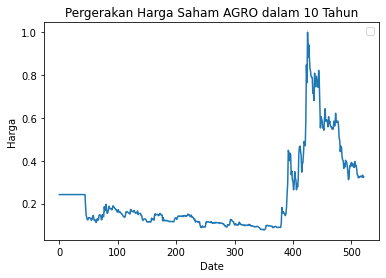

In [ ]:
AGRO = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/AGRO.JK.csv')

AGRO_x = AGRO['No'].values
AGRO_y = AGRO['Skala'].values

plt.plot(AGRO_x,AGRO_y)
plt.title('Pergerakan Harga Saham AGRO dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA AGRO**

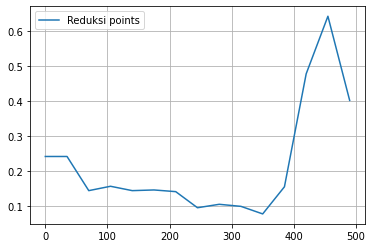

In [ ]:
AGRO_x15 = AGRO_x[0:522:35]
AGRO_y15 = AGRO_y[0:522:35]

plt.plot(AGRO_x15, AGRO_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AGRO_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_AGRO_15: [0.24243565 0.34441991 0.08722839 0.17455217 0.13706719 0.14665798
 0.1572947  0.07636664 0.11370942 0.10408784 0.06993927 0.08674375
 0.6622568  0.73437248 0.40258923 0.         0.         0.
 0.        ]
k_AGRO_15: 3



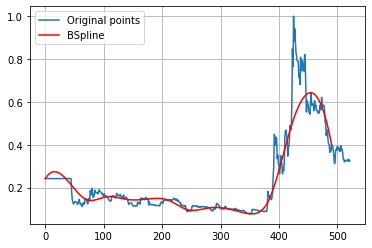

In [ ]:
import scipy.interpolate as interpolate

t_AGRO_15, c_AGRO_15, k_AGRO_15 = interpolate.splrep(AGRO_x15, AGRO_y15, s=0, k=3)
print('''\
t_AGRO_15: {}
c_AGRO_15: {}
k_AGRO_15: {}
'''.format(t_AGRO_15, c_AGRO_15, k_AGRO_15))
N = 522
xmin_AGRO_15, xmax_AGRO_15 = AGRO_x15.min(), AGRO_x15.max()
xx_AGRO_15 = np.linspace(xmin_AGRO_15, xmax_AGRO_15, N)
spline_AGRO_15 = interpolate.BSpline(t_AGRO_15, c_AGRO_15, k_AGRO_15, extrapolate=False)

plt.plot(AGRO_x, AGRO_y, label='Original points')
plt.plot(xx_AGRO_15, spline_AGRO_15(xx_AGRO_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA AGRO**

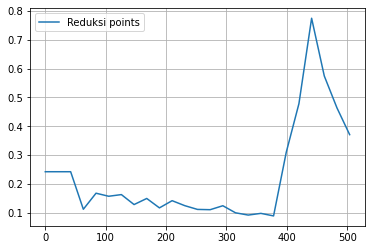

In [ ]:
AGRO_x25 = AGRO_x[0:522:21]
AGRO_y25 = AGRO_y[0:522:21]

plt.plot(AGRO_x25, AGRO_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AGRO_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_AGRO_25: [0.24243565 0.1762269  0.37485315 0.04380941 0.20637057 0.13838492
 0.18442495 0.10279515 0.17598729 0.09152495 0.16040373 0.11906358
 0.11189865 0.10393114 0.13708534 0.09478556 0.08377246 0.12306595
 0.01219908 0.36343238 0.39289537 0.93557796 0.3714543  0.5053668
 0.37097228 0.         0.         0.         0.        ]
k_AGRO_25: 3



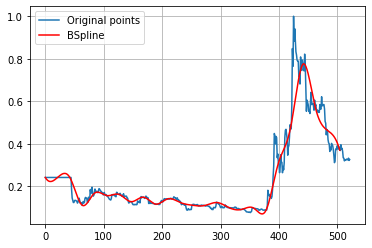

In [ ]:
import scipy.interpolate as interpolate

t_AGRO_25, c_AGRO_25, k_AGRO_25 = interpolate.splrep(AGRO_x25, AGRO_y25, s=0, k=3)
print('''\
t_AGRO_25: {}
c_AGRO_25: {}
k_AGRO_25: {}
'''.format(t_AGRO_25, c_AGRO_25, k_AGRO_25))
N = 522
xmin_AGRO_25, xmax_AGRO_25 = AGRO_x25.min(), AGRO_x25.max()
xx_AGRO_25 = np.linspace(xmin_AGRO_25, xmax_AGRO_25, N)
spline_AGRO_25 = interpolate.BSpline(t_AGRO_25, c_AGRO_25, k_AGRO_25, extrapolate=False)

plt.plot(AGRO_x, AGRO_y, label='Original points')
plt.plot(xx_AGRO_25, spline_AGRO_25(xx_AGRO_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA AGRO**

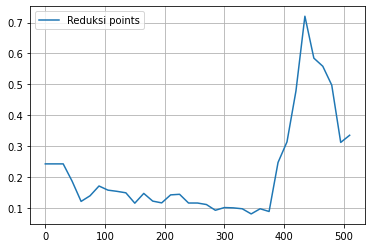

In [ ]:
AGRO_x35 = AGRO_x[0:522:15]
AGRO_y35 = AGRO_y[0:522:15]

plt.plot(AGRO_x35, AGRO_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AGRO_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_AGRO_35: [0.24243565 0.22516222 0.27698252 0.19061536 0.09922548 0.13800964
 0.18366381 0.15228089 0.15154783 0.16282694 0.0896531  0.16953658
 0.1131944  0.10896707 0.14767385 0.15254098 0.10588055 0.11805543
 0.11601636 0.08258768 0.10657426 0.09699797 0.1054339  0.06361974
 0.12244046 0.02897177 0.29108449 0.28904487 0.43508939 0.84118938
 0.52368332 0.57355936 0.52011551 0.1557052  0.33513973 0.
 0.         0.         0.        ]
k_AGRO_35: 3



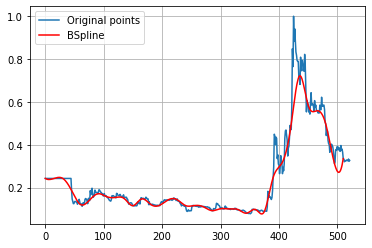

In [ ]:
import scipy.interpolate as interpolate

t_AGRO_35, c_AGRO_35, k_AGRO_35 = interpolate.splrep(AGRO_x35, AGRO_y35, s=0, k=3)
print('''\
t_AGRO_35: {}
c_AGRO_35: {}
k_AGRO_35: {}
'''.format(t_AGRO_35, c_AGRO_35, k_AGRO_35))
N = 522
xmin_AGRO_35, xmax_AGRO_35 = AGRO_x35.min(), AGRO_x35.max()
xx_AGRO_35 = np.linspace(xmin_AGRO_35, xmax_AGRO_35, N)
spline_AGRO_35 = interpolate.BSpline(t_AGRO_35, c_AGRO_35, k_AGRO_35, extrapolate=False)

plt.plot(AGRO_x, AGRO_y, label='Original points')
plt.plot(xx_AGRO_35, spline_AGRO_35(xx_AGRO_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA AGRO**

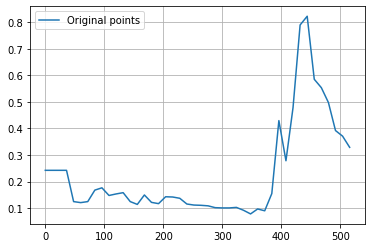

In [ ]:
AGRO_x45 = AGRO_x[0:522:12]
AGRO_y45 = AGRO_y[0:522:12]

plt.plot(AGRO_x45, AGRO_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AGRO_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_AGRO_45: [0.24243565 0.25665136 0.21400425 0.28508276 0.08250901 0.1334379
 0.1092663  0.17805359 0.18619593 0.13665951 0.15392042 0.16895794
 0.12033731 0.09824952 0.17187993 0.11250004 0.10940115 0.15238619
 0.13901811 0.14374482 0.10941558 0.11271146 0.1103279  0.1106855
 0.09987082 0.10159655 0.09962566 0.10578348 0.09488775 0.06760687
 0.10527345 0.09365266 0.06129257 0.59058904 0.1528232  0.4687074
 0.84293902 0.89483323 0.50997308 0.57475647 0.51078135 0.31875117
 0.40235232 0.32881634 0.         0.         0.         0.        ]
k_AGRO_45: 3



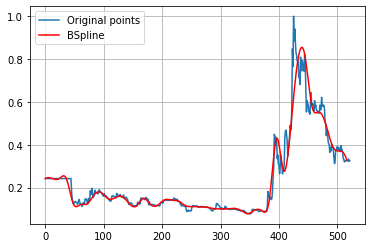

In [ ]:
import scipy.interpolate as interpolate

t_AGRO_45, c_AGRO_45, k_AGRO_45 = interpolate.splrep(AGRO_x45, AGRO_y45, s=0, k=3)
print('''\
t_AGRO_45: {}
c_AGRO_45: {}
k_AGRO_45: {}
'''.format(t_AGRO_45, c_AGRO_45, k_AGRO_45))
N = 522
xmin_AGRO_45, xmax_AGRO_45 = AGRO_x45.min(), AGRO_x45.max()
xx_AGRO_45 = np.linspace(xmin_AGRO_45, xmax_AGRO_45, N)
spline_AGRO_45 = interpolate.BSpline(t_AGRO_45, c_AGRO_45, k_AGRO_45, extrapolate=False)

plt.plot(AGRO_x, AGRO_y, label='Original points')
plt.plot(xx_AGRO_45, spline_AGRO_45(xx_AGRO_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA AGRO**


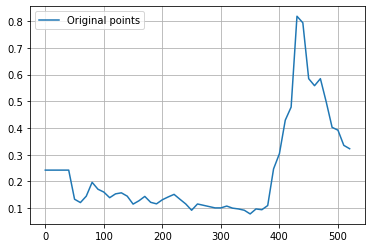

In [ ]:
AGRO_x55 = AGRO_x[0:522:10]
AGRO_y55 = AGRO_y[0:522:10]

plt.plot(AGRO_x55, AGRO_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_AGRO_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_AGRO_55: [0.24243565 0.23901749 0.24927198 0.23218117 0.28088997 0.09887288
 0.12400169 0.13064726 0.22288819 0.15821904 0.16918145 0.12666593
 0.15908272 0.15830234 0.1520431  0.10300417 0.12691615 0.15516343
 0.11614845 0.11152399 0.13449211 0.13936956 0.1602331  0.12948229
 0.12222092 0.07575263 0.12770991 0.10752635 0.10689324 0.10019286
 0.09821802 0.11281775 0.09757097 0.0968984  0.09718876 0.06728791
 0.10424828 0.09807228 0.06816858 0.28807489 0.26188646 0.48791245
 0.36293567 0.93093668 0.82508762 0.53341965 0.55071581 0.61511437
 0.49830876 0.37629116 0.42398557 0.27965087 0.32249294 0.
 0.         0.         0.        ]
k_AGRO_55: 3



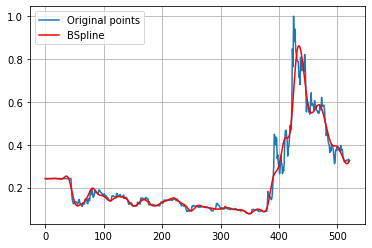

In [ ]:
import scipy.interpolate as interpolate

t_AGRO_55, c_AGRO_55, k_AGRO_55 = interpolate.splrep(AGRO_x55, AGRO_y55, s=0, k=3)
print('''\
t_AGRO_55: {}
c_AGRO_55: {}
k_AGRO_55: {}
'''.format(t_AGRO_55, c_AGRO_55, k_AGRO_55))
N = 522
xmin_AGRO_55, xmax_AGRO_55 = AGRO_x55.min(), AGRO_x55.max()
xx_AGRO_55 = np.linspace(xmin_AGRO_55, xmax_AGRO_55, N)
spline_AGRO_55 = interpolate.BSpline(t_AGRO_55, c_AGRO_55, k_AGRO_55, extrapolate=False)

plt.plot(AGRO_x, AGRO_y, label='Original points')
plt.plot(xx_AGRO_55, spline_AGRO_55(xx_AGRO_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA AGRO**

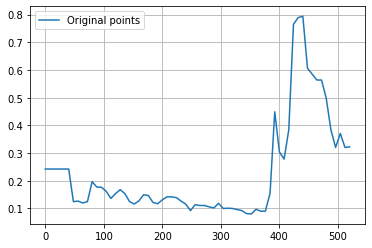

In [ ]:
AGRO_x65 = AGRO_x[0:522:8]
AGRO_y65 = AGRO_y[0:522:8]

plt.plot(AGRO_x65, AGRO_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AGRO_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_AGRO_65: [0.24243565 0.24346718 0.24037259 0.24553024 0.23083094 0.28575991
 0.08074333 0.13982345 0.12003444 0.09980507 0.22930196 0.16340611
 0.182331   0.16676672 0.12372776 0.15597465 0.17367278 0.15701081
 0.11958312 0.11321342 0.12429971 0.15541995 0.15228978 0.11641475
 0.11333246 0.13274623 0.14454462 0.14127874 0.14254387 0.12347365
 0.12363312 0.07611248 0.1248583  0.10680512 0.11262979 0.10738428
 0.09312523 0.13188013 0.09112147 0.10363404 0.10022504 0.09546584
 0.09438229 0.07994636 0.0740676  0.10613655 0.08373952 0.10008202
 0.05710905 0.60089377 0.23343455 0.2889012  0.2815499  0.89078066
 0.74356751 0.87024

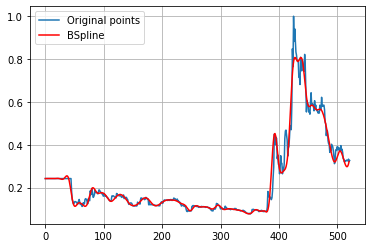

In [ ]:
import scipy.interpolate as interpolate

t_AGRO_65, c_AGRO_65, k_AGRO_65 = interpolate.splrep(AGRO_x65, AGRO_y65, s=0, k=3)
print('''\
t_AGRO_65: {}
c_AGRO_65: {}
k_AGRO_65: {}
'''.format(t_AGRO_65, c_AGRO_65, k_AGRO_65))
N = 522
xmin_AGRO_65, xmax_AGRO_65 = AGRO_x65.min(), AGRO_x65.max()
xx_AGRO_65 = np.linspace(xmin_AGRO_65, xmax_AGRO_65, N)
spline_AGRO_65 = interpolate.BSpline(t_AGRO_65, c_AGRO_65, k_AGRO_65, extrapolate=False)

plt.plot(AGRO_x, AGRO_y, label='Original points')
plt.plot(xx_AGRO_65, spline_AGRO_65(xx_AGRO_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE AGRO**

In [ ]:

#RMSE 15 DATA AGRO
y_true_AGRO_15 = AGRO_y.tolist()
y_pred_AGRO_15 = spline_AGRO_15(xx_AGRO_15).tolist()
mse_AGRO_15 = mean_squared_error(y_true_AGRO_15, y_pred_AGRO_15)
rmse_AGRO_15 = np.sqrt(mse_AGRO_15)
print("rmse AGRO 15 =",rmse_AGRO_15)

#RMSE 25 DATA AGRO
y_true_AGRO_25 = AGRO_y.tolist()
y_pred_AGRO_25 = spline_AGRO_25(xx_AGRO_25).tolist()
mse_AGRO_25 = mean_squared_error(y_true_AGRO_25, y_pred_AGRO_25)
rmse_AGRO_25 = np.sqrt(mse_AGRO_25)
print("rmse AGRO 25 =",rmse_AGRO_25)

#RMSE 35 DATA AGRO
y_true_AGRO_35 = AGRO_y.tolist()
y_pred_AGRO_35 = spline_AGRO_35(xx_AGRO_35).tolist()
mse_AGRO_35 = mean_squared_error(y_true_AGRO_35, y_pred_AGRO_35)
rmse_AGRO_35 = np.sqrt(mse_AGRO_35)
print("rmse AGRO 35 =",rmse_AGRO_35)

#RMSE 45 DATA AGRO
y_true_AGRO_45 = AGRO_y.tolist()
y_pred_AGRO_45 = spline_AGRO_45(xx_AGRO_45).tolist()
mse_AGRO_45 = mean_squared_error(y_true_AGRO_45, y_pred_AGRO_45)
rmse_AGRO_45 = np.sqrt(mse_AGRO_45)
print("rmse AGRO 45 =",rmse_AGRO_45)

#RMSE 55 DATA AGRO
y_true_AGRO_55 = AGRO_y.tolist()
y_pred_AGRO_55 = spline_AGRO_55(xx_AGRO_55).tolist()
mse_AGRO_55 = mean_squared_error(y_true_AGRO_55, y_pred_AGRO_55)
rmse_AGRO_55 = np.sqrt(mse_AGRO_55)
print("rmse AGRO 55 =",rmse_AGRO_55)

#RMSE 65 DATA AGRO
y_true_AGRO_65 = AGRO_y.tolist()
y_pred_AGRO_65 = spline_AGRO_65(xx_AGRO_65).tolist()
mse_AGRO_65 = mean_squared_error(y_true_AGRO_65, y_pred_AGRO_65)
rmse_AGRO_65 = np.sqrt(mse_AGRO_65)
print("rmse AGRO 65 =",rmse_AGRO_65)


rmse AGRO 15 = 0.12979965874154079
rmse AGRO 25 = 0.09585149551093
rmse AGRO 35 = 0.07473305528201724
rmse AGRO 45 = 0.062135966850345
rmse AGRO 55 = 0.0411354997540736
rmse AGRO 65 = 0.03132947547970735


# **AKRA**

**1. PERCOBAAN 15 DATA AKRA**

No handles with labels found to put in legend.


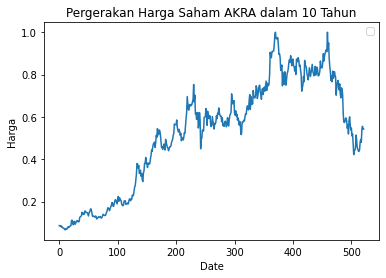

In [ ]:
AKRA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/AKRA.JK.csv')

AKRA_x = AKRA['No'].values
AKRA_y = AKRA['Skala'].values

plt.plot(AKRA_x,AKRA_y)
plt.title('Pergerakan Harga Saham AKRA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

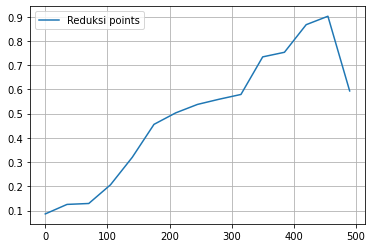

In [ ]:
AKRA_x15 = AKRA_x[0:522:35]
AKRA_y15 = AKRA_y[0:522:35]

plt.plot(AKRA_x15, AKRA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AKRA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_AKRA_15: [0.08607595 0.1579835  0.07770388 0.20517413 0.30770672 0.48172052
 0.4995884  0.5389132  0.57260691 0.52762121 0.79159182 0.71107481
 0.94043676 0.96838921 0.59367089 0.         0.         0.
 0.        ]
k_AKRA_15: 3



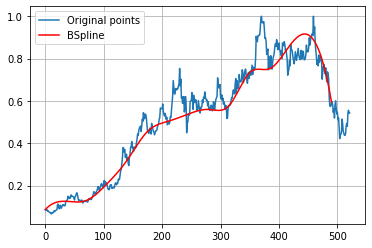

In [ ]:
import scipy.interpolate as interpolate

t_AKRA_15, c_AKRA_15, k_AKRA_15 = interpolate.splrep(AKRA_x15, AKRA_y15, s=0, k=3)
print('''\
t_AKRA_15: {}
c_AKRA_15: {}
k_AKRA_15: {}
'''.format(t_AKRA_15, c_AKRA_15, k_AKRA_15))
N = 522
xmin_AKRA_15, xmax_AKRA_15 = AKRA_x15.min(), AKRA_x15.max()
xx_AKRA_15 = np.linspace(xmin_AKRA_15, xmax_AKRA_15, N)
spline_AKRA_15 = interpolate.BSpline(t_AKRA_15, c_AKRA_15, k_AKRA_15, extrapolate=False)

plt.plot(AKRA_x, AKRA_y, label='Original points')
plt.plot(xx_AKRA_15, spline_AKRA_15(xx_AKRA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA AKRA**

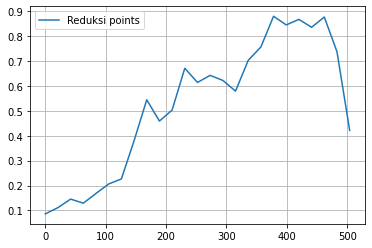

In [ ]:
AKRA_x25 = AKRA_x[0:522:21]
AKRA_y25 = AKRA_y[0:522:21]

plt.plot(AKRA_x25, AKRA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AKRA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_AKRA_25: [0.08607595 0.07437483 0.18099717 0.1102553  0.17035065 0.21846867
 0.19374936 0.36602755 0.62062143 0.41730951 0.4633051  0.74845743
 0.56818162 0.66236041 0.63680714 0.52332243 0.74458668 0.71352071
 0.93930517 0.80773962 0.89935659 0.79736567 0.96599673 0.66715986
 0.42151899 0.         0.         0.         0.        ]
k_AKRA_25: 3



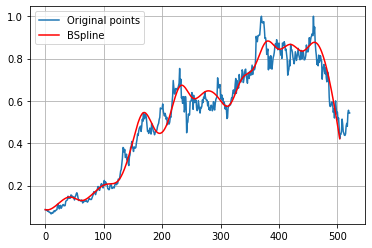

In [ ]:
import scipy.interpolate as interpolate

t_AKRA_25, c_AKRA_25, k_AKRA_25 = interpolate.splrep(AKRA_x25, AKRA_y25, s=0, k=3)
print('''\
t_AKRA_25: {}
c_AKRA_25: {}
k_AKRA_25: {}
'''.format(t_AKRA_25, c_AKRA_25, k_AKRA_25))
N = 522
xmin_AKRA_25, xmax_AKRA_25 = AKRA_x25.min(), AKRA_x25.max()
xx_AKRA_25 = np.linspace(xmin_AKRA_25, xmax_AKRA_25, N)
spline_AKRA_25 = interpolate.BSpline(t_AKRA_25, c_AKRA_25, k_AKRA_25, extrapolate=False)

plt.plot(AKRA_x, AKRA_y, label='Original points')
plt.plot(xx_AKRA_25, spline_AKRA_25(xx_AKRA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 35 DATA AKRA**

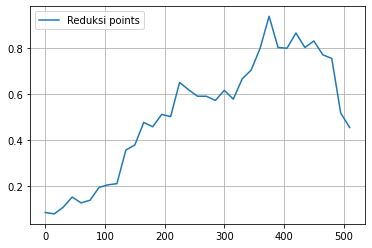

In [ ]:
AKRA_x35 = AKRA_x[0:522:15]
AKRA_y35 = AKRA_y[0:522:15]

plt.plot(AKRA_x35, AKRA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AKRA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_AKRA_35: [0.08607595 0.07272981 0.07605936 0.1755734  0.11575587 0.12849171
 0.20572032 0.21824726 0.15926531 0.41304593 0.3341206  0.52895267
 0.41715733 0.55558256 0.43646179 0.71755761 0.60470016 0.58516075
 0.60528977 0.54431309 0.6579642  0.53015922 0.69608245 0.6918401
 0.77073437 1.02901989 0.75242657 0.78405865 0.91513631 0.75792776
 0.87593745 0.73199333 0.86133637 0.30430017 0.4556962  0.
 0.         0.         0.        ]
k_AKRA_35: 3



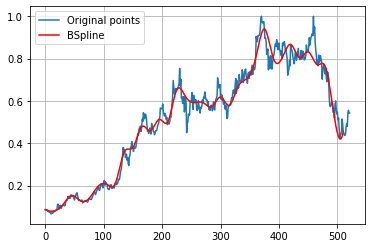

In [ ]:
import scipy.interpolate as interpolate

t_AKRA_35, c_AKRA_35, k_AKRA_35 = interpolate.splrep(AKRA_x35, AKRA_y35, s=0, k=3)
print('''\
t_AKRA_35: {}
c_AKRA_35: {}
k_AKRA_35: {}
'''.format(t_AKRA_35, c_AKRA_35, k_AKRA_35))
N = 522
xmin_AKRA_35, xmax_AKRA_35 = AKRA_x35.min(), AKRA_x35.max()
xx_AKRA_35 = np.linspace(xmin_AKRA_35, xmax_AKRA_35, N)
spline_AKRA_35 = interpolate.BSpline(t_AKRA_35, c_AKRA_35, k_AKRA_35, extrapolate=False)

plt.plot(AKRA_x, AKRA_y, label='Original points')
plt.plot(xx_AKRA_35, spline_AKRA_35(xx_AKRA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA AKRA**

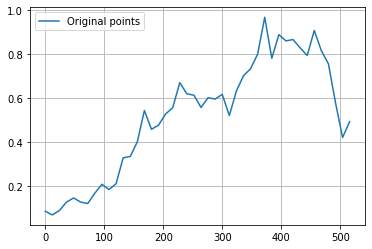

In [ ]:
AKRA_x45 = AKRA_x[0:522:12]
AKRA_y45 = AKRA_y[0:522:12]

plt.plot(AKRA_x45, AKRA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_AKRA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_AKRA_45: [0.08607595 0.05970559 0.07109514 0.13122649 0.15605467 0.1255675
 0.10876395 0.16849063 0.22740009 0.17507355 0.18116648 0.36861496
 0.31905722 0.36781437 0.6210777  0.4136976  0.47729643 0.54420526
 0.51676859 0.73049251 0.58657781 0.64471524 0.51810554 0.6322297
 0.56816555 0.67232331 0.44887032 0.66130933 0.70336072 0.74043767
 0.73995189 1.10355222 0.65596581 0.96245797 0.82964533 0.88351765
 0.83881571 0.73590307 0.9833948  0.77988483 0.79580005 0.50125285
 0.32405712 0.49367089 0.         0.         0.         0.        ]
k_AKRA_45: 3



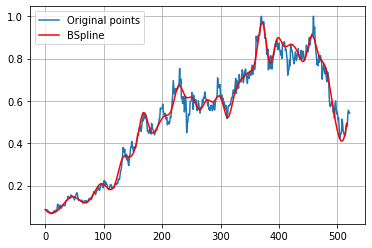

In [ ]:
import scipy.interpolate as interpolate

t_AKRA_45, c_AKRA_45, k_AKRA_45 = interpolate.splrep(AKRA_x45, AKRA_y45, s=0, k=3)
print('''\
t_AKRA_45: {}
c_AKRA_45: {}
k_AKRA_45: {}
'''.format(t_AKRA_45, c_AKRA_45, k_AKRA_45))
N = 522
xmin_AKRA_45, xmax_AKRA_45 = AKRA_x45.min(), AKRA_x45.max()
xx_AKRA_45 = np.linspace(xmin_AKRA_45, xmax_AKRA_45, N)
spline_AKRA_45 = interpolate.BSpline(t_AKRA_45, c_AKRA_45, k_AKRA_45, extrapolate=False)

plt.plot(AKRA_x, AKRA_y, label='Original points')
plt.plot(xx_AKRA_45, spline_AKRA_45(xx_AKRA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA AKRA**

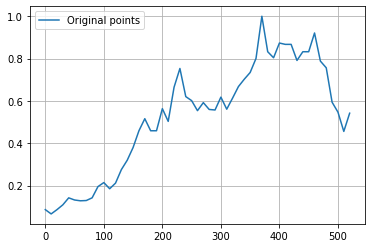

In [ ]:
AKRA_x55 = AKRA_x[0:522:10]
AKRA_y55 = AKRA_y[0:522:10]

plt.plot(AKRA_x55, AKRA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_AKRA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_AKRA_55: [0.08607595 0.04645572 0.08430375 0.10223636 0.15543222 0.12666768
 0.12777047 0.12933905 0.12955688 0.20306636 0.22779796 0.16928612
 0.20391832 0.28339505 0.31440024 0.37672552 0.45717869 0.54772426
 0.44686098 0.41799638 0.63431806 0.4244782  0.68675648 0.81583766
 0.56888024 0.63016037 0.51807322 0.62033156 0.55123344 0.5316967
 0.66375191 0.51962476 0.62230601 0.67089803 0.700431   0.74256786
 0.73436085 1.12378621 0.77049429 0.78790749 0.90066054 0.84995667
 0.90204442 0.74439731 0.86720178 0.78046647 1.00460324 0.72643704
 0.81749671 0.54155081 0.59058357 0.34394872 0.54177215 0.
 0.         0.         0.        ]
k_AKRA_55: 3



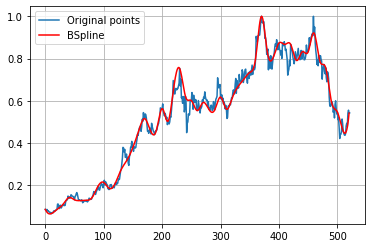

In [ ]:
import scipy.interpolate as interpolate

t_AKRA_55, c_AKRA_55, k_AKRA_55 = interpolate.splrep(AKRA_x55, AKRA_y55, s=0, k=3)
print('''\
t_AKRA_55: {}
c_AKRA_55: {}
k_AKRA_55: {}
'''.format(t_AKRA_55, c_AKRA_55, k_AKRA_55))
N = 522
xmin_AKRA_55, xmax_AKRA_55 = AKRA_x55.min(), AKRA_x55.max()
xx_AKRA_55 = np.linspace(xmin_AKRA_55, xmax_AKRA_55, N)
spline_AKRA_55 = interpolate.BSpline(t_AKRA_55, c_AKRA_55, k_AKRA_55, extrapolate=False)

plt.plot(AKRA_x, AKRA_y, label='Original points')
plt.plot(xx_AKRA_55, spline_AKRA_55(xx_AKRA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA AKRA**

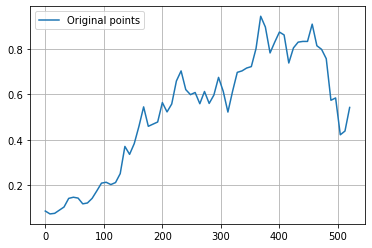

In [ ]:
AKRA_x65 = AKRA_x[0:522:8]
AKRA_y65 = AKRA_y[0:522:8]

plt.plot(AKRA_x65, AKRA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_AKRA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_AKRA_65: [0.08607595 0.07320474 0.06624876 0.09303193 0.09416824 0.15307992
 0.144145   0.15135276 0.10867183 0.12028905 0.13928588 0.17320034
 0.21601401 0.21590818 0.19630264 0.21407114 0.21576722 0.42665744
 0.29912201 0.38951277 0.44029528 0.60247067 0.41564483 0.48811457
 0.44202346 0.61088018 0.49420264 0.54522063 0.66668697 0.73739858
 0.59890859 0.58848604 0.63575483 0.51406425 0.65735526 0.52866662
 0.58494029 0.70878742 0.62421384 0.47030658 0.62367376 0.71474522
 0.69456055 0.72220247 0.70776883 0.77583614 0.99268406 0.91165546
 0.73411183 0.84177064 0.87348914 0.90477913 0.67195132 0.83146624
 0.82496855 0.84334

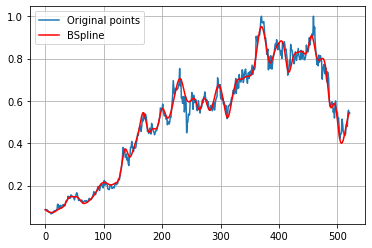

In [ ]:
import scipy.interpolate as interpolate

t_AKRA_65, c_AKRA_65, k_AKRA_65 = interpolate.splrep(AKRA_x65, AKRA_y65, s=0, k=3)
print('''\
t_AKRA_65: {}
c_AKRA_65: {}
k_AKRA_65: {}
'''.format(t_AKRA_65, c_AKRA_65, k_AKRA_65))
N = 522
xmin_AKRA_65, xmax_AKRA_65 = AKRA_x65.min(), AKRA_x65.max()
xx_AKRA_65 = np.linspace(xmin_AKRA_65, xmax_AKRA_65, N)
spline_AKRA_65 = interpolate.BSpline(t_AKRA_65, c_AKRA_65, k_AKRA_65, extrapolate=False)

plt.plot(AKRA_x, AKRA_y, label='Original points')
plt.plot(xx_AKRA_65, spline_AKRA_65(xx_AKRA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE AKRA**

In [ ]:

#RMSE 15 DATA AKRA
y_true_AKRA_15 = AKRA_y.tolist()
y_pred_AKRA_15 = spline_AKRA_15(xx_AKRA_15).tolist()
mse_AKRA_15 = mean_squared_error(y_true_AKRA_15, y_pred_AKRA_15)
rmse_AKRA_15 = np.sqrt(mse_AKRA_15)
print("rmse AKRA 15 =",rmse_AKRA_15)

#RMSE 25 DATA AKRA
y_true_AKRA_25 = AKRA_y.tolist()
y_pred_AKRA_25 = spline_AKRA_25(xx_AKRA_25).tolist()
mse_AKRA_25 = mean_squared_error(y_true_AKRA_25, y_pred_AKRA_25)
rmse_AKRA_25 = np.sqrt(mse_AKRA_25)
print("rmse AKRA 25 =",rmse_AKRA_25)

#RMSE 35 DATA AKRA
y_true_AKRA_35 = AKRA_y.tolist()
y_pred_AKRA_35 = spline_AKRA_35(xx_AKRA_35).tolist()
mse_AKRA_35 = mean_squared_error(y_true_AKRA_35, y_pred_AKRA_35)
rmse_AKRA_35 = np.sqrt(mse_AKRA_35)
print("rmse AKRA 35 =",rmse_AKRA_35)

#RMSE 45 DATA AKRA
y_true_AKRA_45 = AKRA_y.tolist()
y_pred_AKRA_45 = spline_AKRA_45(xx_AKRA_45).tolist()
mse_AKRA_45 = mean_squared_error(y_true_AKRA_45, y_pred_AKRA_45)
rmse_AKRA_45 = np.sqrt(mse_AKRA_45)
print("rmse AKRA 45 =",rmse_AKRA_45)

#RMSE 55 DATA AKRA
y_true_AKRA_55 = AKRA_y.tolist()
y_pred_AKRA_55 = spline_AKRA_55(xx_AKRA_55).tolist()
mse_AKRA_55 = mean_squared_error(y_true_AKRA_55, y_pred_AKRA_55)
rmse_AKRA_55 = np.sqrt(mse_AKRA_55)
print("rmse AKRA 55 =",rmse_AKRA_55)

#RMSE 65 DATA AKRA
y_true_AKRA_65 = AKRA_y.tolist()
y_pred_AKRA_65 = spline_AKRA_65(xx_AKRA_65).tolist()
mse_AKRA_65 = mean_squared_error(y_true_AKRA_65, y_pred_AKRA_65)
rmse_AKRA_65 = np.sqrt(mse_AKRA_65)
print("rmse AKRA 65 =",rmse_AKRA_65)

rmse AKRA 15 = 0.10645980077409467
rmse AKRA 25 = 0.080540390152666
rmse AKRA 35 = 0.05775603765348604
rmse AKRA 45 = 0.04348151661719657
rmse AKRA 55 = 0.0347050626943741
rmse AKRA 65 = 0.029515227613029847


# **ANTM**

No handles with labels found to put in legend.


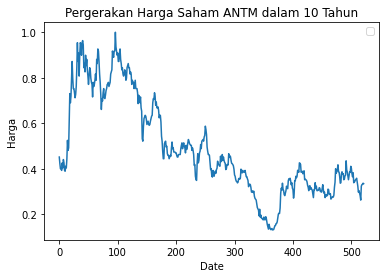

In [ ]:
ANTM = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ANTM.JK.csv')

ANTM_x = ANTM['No'].values
ANTM_y = ANTM['Skala'].values

plt.plot(ANTM_x,ANTM_y)
plt.title('Pergerakan Harga Saham ANTM dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ANTM**

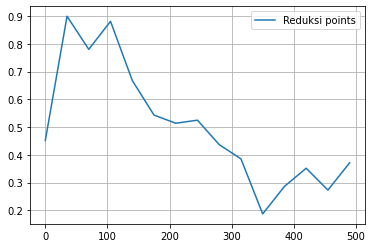

In [ ]:
ANTM_x15 = ANTM_x[0:522:35]
ANTM_y15 = ANTM_y[0:522:35]

plt.plot(ANTM_x15, ANTM_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ANTM_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ANTM_15: [0.4513749  1.20902588 0.56267291 0.99864852 0.618124   0.53619525
 0.4958176  0.56310535 0.40038896 0.45551771 0.0894646  0.30955767
 0.41582308 0.15743225 0.37135094 0.         0.         0.
 0.        ]
k_ANTM_15: 3



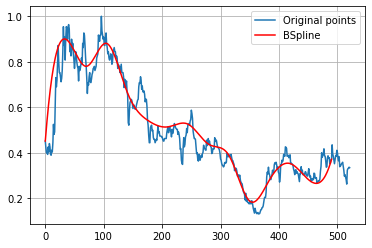

In [ ]:
import scipy.interpolate as interpolate

t_ANTM_15, c_ANTM_15, k_ANTM_15 = interpolate.splrep(ANTM_x15, ANTM_y15, s=0, k=3)
print('''\
t_ANTM_15: {}
c_ANTM_15: {}
k_ANTM_15: {}
'''.format(t_ANTM_15, c_ANTM_15, k_ANTM_15))
N = 522
xmin_ANTM_15, xmax_ANTM_15 = ANTM_x15.min(), ANTM_x15.max()
xx_ANTM_15 = np.linspace(xmin_ANTM_15, xmax_ANTM_15, N)
spline_ANTM_15 = interpolate.BSpline(t_ANTM_15, c_ANTM_15, k_ANTM_15, extrapolate=False)

plt.plot(ANTM_x, ANTM_y, label='Original points')
plt.plot(xx_ANTM_15, spline_ANTM_15(xx_ANTM_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ANTM**

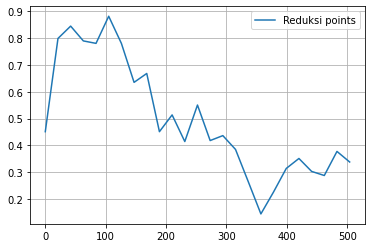

In [ ]:
ANTM_x25 = ANTM_x[0:522:21]
ANTM_y25 = ANTM_y[0:522:21]

plt.plot(ANTM_x25, ANTM_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ANTM_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ANTM_25: [0.4513749  0.83121178 0.88252735 0.78416142 0.73935642 0.93730357
 0.79581418 0.55833036 0.78003389 0.32887384 0.61272016 0.30281648
 0.66408449 0.34360581 0.47158166 0.39024647 0.27935687 0.08865356
 0.23892204 0.31873468 0.3734758  0.29750925 0.24521857 0.47646716
 0.33858468 0.         0.         0.         0.        ]
k_ANTM_25: 3



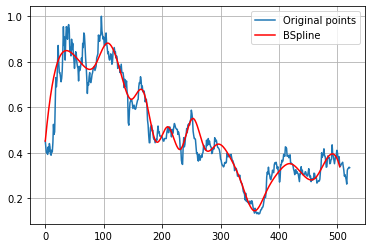

In [ ]:
import scipy.interpolate as interpolate

t_ANTM_25, c_ANTM_25, k_ANTM_25 = interpolate.splrep(ANTM_x25, ANTM_y25, s=0, k=3)
print('''\
t_ANTM_25: {}
c_ANTM_25: {}
k_ANTM_25: {}
'''.format(t_ANTM_25, c_ANTM_25, k_ANTM_25))
N = 522
xmin_ANTM_25, xmax_ANTM_25 = ANTM_x25.min(), ANTM_x25.max()
xx_ANTM_25 = np.linspace(xmin_ANTM_25, xmax_ANTM_25, N)
spline_ANTM_25 = interpolate.BSpline(t_ANTM_25, c_ANTM_25, k_ANTM_25, extrapolate=False)

plt.plot(ANTM_x, ANTM_y, label='Original points')
plt.plot(xx_ANTM_25, spline_ANTM_25(xx_ANTM_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 35 DATA ANTM**

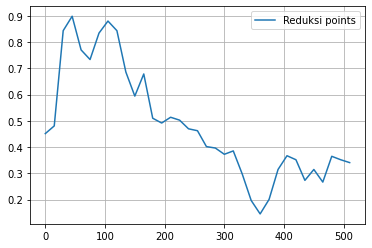

In [ ]:
ANTM_x35 = ANTM_x[0:522:15]
ANTM_y35 = ANTM_y[0:522:15]

plt.plot(ANTM_x35, ANTM_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ANTM_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ANTM_35: [0.4513749  0.17430222 0.92662342 0.92963783 0.7485512  0.70000072
 0.85509999 0.88877388 0.87418939 0.67869042 0.52848332 0.77433756
 0.44756286 0.49596297 0.51904262 0.51043753 0.45572159 0.48502017
 0.37850382 0.41197151 0.35158861 0.41653215 0.29420717 0.19012233
 0.12328461 0.18701108 0.33184812 0.372933   0.37831251 0.22396408
 0.36414415 0.20679588 0.47462242 0.28967946 0.3407691  0.
 0.         0.         0.        ]
k_ANTM_35: 3



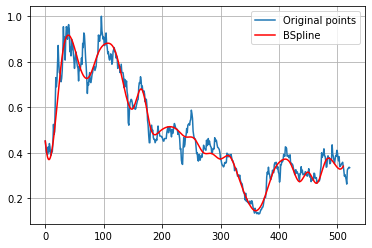

In [ ]:
import scipy.interpolate as interpolate

t_ANTM_35, c_ANTM_35, k_ANTM_35 = interpolate.splrep(ANTM_x35, ANTM_y35, s=0, k=3)
print('''\
t_ANTM_35: {}
c_ANTM_35: {}
k_ANTM_35: {}
'''.format(t_ANTM_35, c_ANTM_35, k_ANTM_35))
N = 522
xmin_ANTM_35, xmax_ANTM_35 = ANTM_x35.min(), ANTM_x35.max()
xx_ANTM_35 = np.linspace(xmin_ANTM_35, xmax_ANTM_35, N)
spline_ANTM_35 = interpolate.BSpline(t_ANTM_35, c_ANTM_35, k_ANTM_35, extrapolate=False)

plt.plot(ANTM_x, ANTM_y, label='Original points')
plt.plot(xx_ANTM_35, spline_ANTM_35(xx_ANTM_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA ANTM**

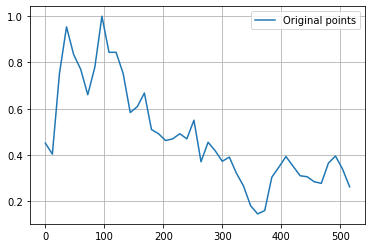

In [ ]:
ANTM_x45 = ANTM_x[0:522:12]
ANTM_y45 = ANTM_y[0:522:12]

plt.plot(ANTM_x45, ANTM_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ANTM_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ANTM_45: [0.4513749  0.15613105 0.70058225 1.03719359 0.79125399 0.80696502
 0.60472927 0.73741969 1.12448263 0.76464979 0.88114006 0.77501182
 0.53256137 0.5956473  0.73988633 0.45214716 0.51207701 0.45000217
 0.46222039 0.51946032 0.41039568 0.65730102 0.26316048 0.51390836
 0.41147416 0.3502844  0.42224635 0.30568036 0.28163579 0.16410402
 0.1474524  0.11635825 0.34388938 0.32988824 0.42049176 0.3473154
 0.30039376 0.3122331  0.28558437 0.24927492 0.38184193 0.42224401
 0.30166996 0.26213008 0.         0.         0.         0.        ]
k_ANTM_45: 3



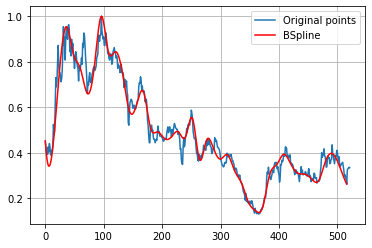

In [ ]:

import scipy.interpolate as interpolate

t_ANTM_45, c_ANTM_45, k_ANTM_45 = interpolate.splrep(ANTM_x45, ANTM_y45, s=0, k=3)
print('''\
t_ANTM_45: {}
c_ANTM_45: {}
k_ANTM_45: {}
'''.format(t_ANTM_45, c_ANTM_45, k_ANTM_45))
N = 522
xmin_ANTM_45, xmax_ANTM_45 = ANTM_x45.min(), ANTM_x45.max()
xx_ANTM_45 = np.linspace(xmin_ANTM_45, xmax_ANTM_45, N)
spline_ANTM_45 = interpolate.BSpline(t_ANTM_45, c_ANTM_45, k_ANTM_45, extrapolate=False)

plt.plot(ANTM_x, ANTM_y, label='Original points')
plt.plot(xx_ANTM_45, spline_ANTM_45(xx_ANTM_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA ANTM**

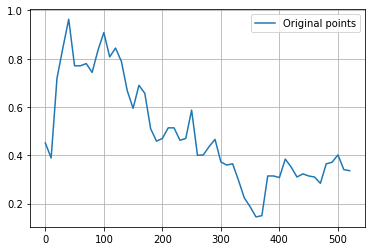

In [ ]:
ANTM_x55 = ANTM_x[0:522:10]
ANTM_y55 = ANTM_y[0:522:10]

plt.plot(ANTM_x55, ANTM_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ANTM_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ANTM_55: [0.4513749  0.08610084 0.79843977 0.798356   1.07237906 0.69193848
 0.78371035 0.79706346 0.70692647 0.83393206 0.96651985 0.74951539
 0.87945118 0.79690174 0.66687982 0.54291874 0.72840647 0.68290876
 0.48124161 0.45267679 0.46033831 0.52431401 0.52497663 0.45835043
 0.41592772 0.69628272 0.32186465 0.41625614 0.42411775 0.50745178
 0.34240021 0.35780547 0.38417242 0.29632767 0.21400009 0.19078974
 0.14577473 0.09638321 0.3704199  0.30927375 0.27982167 0.41945663
 0.34909649 0.29430451 0.334809   0.30622204 0.3276394  0.24434392
 0.39883043 0.3491205  0.46068414 0.26661287 0.33640026 0.
 0.         0.         0.        ]
k_ANTM_55: 3



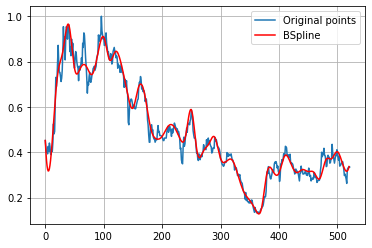

In [ ]:
import scipy.interpolate as interpolate

t_ANTM_55, c_ANTM_55, k_ANTM_55 = interpolate.splrep(ANTM_x55, ANTM_y55, s=0, k=3)
print('''\
t_ANTM_55: {}
c_ANTM_55: {}
k_ANTM_55: {}
'''.format(t_ANTM_55, c_ANTM_55, k_ANTM_55))
N = 522
xmin_ANTM_55, xmax_ANTM_55 = ANTM_x55.min(), ANTM_x55.max()
xx_ANTM_55 = np.linspace(xmin_ANTM_55, xmax_ANTM_55, N)
spline_ANTM_55 = interpolate.BSpline(t_ANTM_55, c_ANTM_55, k_ANTM_55, extrapolate=False)

plt.plot(ANTM_x, ANTM_y, label='Original points')
plt.plot(xx_ANTM_55, spline_ANTM_55(xx_ANTM_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA ANTM**

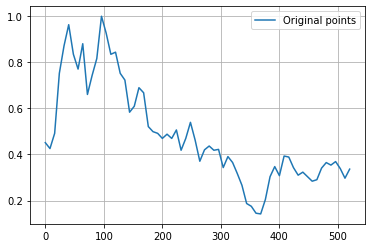

In [ ]:
ANTM_x65 = ANTM_x[0:522:8]
ANTM_y65 = ANTM_y[0:522:8]

plt.plot(ANTM_x65, ANTM_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ANTM_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ANTM_65: [0.4513749  0.46161363 0.3079636  0.8080848  0.84841563 1.0276165
 0.82092911 0.69784161 1.0115478  0.54035209 0.79034561 0.75696684
 1.08086694 0.91956541 0.80049291 0.88763752 0.7131789  0.7733956
 0.53083612 0.6041645  0.70754276 0.70511786 0.47932558 0.50418878
 0.49841462 0.45261008 0.50948912 0.43787214 0.55736636 0.37119574
 0.46794007 0.57538801 0.46721147 0.33007218 0.43635113 0.44561962
 0.40134929 0.45907262 0.29446604 0.42177515 0.3633835  0.31551366
 0.27914659 0.16422748 0.18687726 0.13853745 0.12924479 0.19640613
 0.31189944 0.37780011 0.2608342  0.42688014 0.39081595 0.34281375
 0.29565015 0.3357092

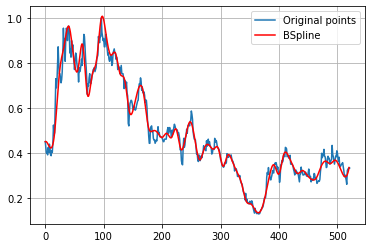

In [ ]:
import scipy.interpolate as interpolate

t_ANTM_65, c_ANTM_65, k_ANTM_65 = interpolate.splrep(ANTM_x65, ANTM_y65, s=0, k=3)
print('''\
t_ANTM_65: {}
c_ANTM_65: {}
k_ANTM_65: {}
'''.format(t_ANTM_65, c_ANTM_65, k_ANTM_65))
N = 522
xmin_ANTM_65, xmax_ANTM_65 = ANTM_x65.min(), ANTM_x65.max()
xx_ANTM_65 = np.linspace(xmin_ANTM_65, xmax_ANTM_65, N)
spline_ANTM_65 = interpolate.BSpline(t_ANTM_65, c_ANTM_65, k_ANTM_65, extrapolate=False)

plt.plot(ANTM_x, ANTM_y, label='Original points')
plt.plot(xx_ANTM_65, spline_ANTM_65(xx_ANTM_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ANTM**

In [ ]:

#RMSE 15 DATA ANTM
y_true_ANTM_15 = ANTM_y.tolist()
y_pred_ANTM_15 = spline_ANTM_15(xx_ANTM_15).tolist()
mse_ANTM_15 = mean_squared_error(y_true_ANTM_15, y_pred_ANTM_15)
rmse_ANTM_15 = np.sqrt(mse_ANTM_15)
print("rmse ANTM 15 =",rmse_ANTM_15)

#RMSE 25 DATA ANTM
y_true_ANTM_25 = ANTM_y.tolist()
y_pred_ANTM_25 = spline_ANTM_25(xx_ANTM_25).tolist()
mse_ANTM_25 = mean_squared_error(y_true_ANTM_25, y_pred_ANTM_25)
rmse_ANTM_25 = np.sqrt(mse_ANTM_25)
print("rmse ANTM 25 =",rmse_ANTM_25)

#RMSE 35 DATA ANTM
y_true_ANTM_35 = ANTM_y.tolist()
y_pred_ANTM_35 = spline_ANTM_35(xx_ANTM_35).tolist()
mse_ANTM_35 = mean_squared_error(y_true_ANTM_35, y_pred_ANTM_35)
rmse_ANTM_35 = np.sqrt(mse_ANTM_35)
print("rmse ANTM 35 =",rmse_ANTM_35)

#RMSE 45 DATA ANTM
y_true_ANTM_45 = ANTM_y.tolist()
y_pred_ANTM_45 = spline_ANTM_45(xx_ANTM_45).tolist()
mse_ANTM_45 = mean_squared_error(y_true_ANTM_45, y_pred_ANTM_45)
rmse_ANTM_45 = np.sqrt(mse_ANTM_45)
print("rmse ANTM 45 =",rmse_ANTM_45)

#RMSE 55 DATA ANTM
y_true_ANTM_55 = ANTM_y.tolist()
y_pred_ANTM_55 = spline_ANTM_55(xx_ANTM_55).tolist()
mse_ANTM_55 = mean_squared_error(y_true_ANTM_55, y_pred_ANTM_55)
rmse_ANTM_55 = np.sqrt(mse_ANTM_55)
print("rmse ANTM 55 =",rmse_ANTM_55)

#RMSE 65 DATA ANTM
y_true_ANTM_65 = ANTM_y.tolist()
y_pred_ANTM_65 = spline_ANTM_65(xx_ANTM_65).tolist()
mse_ANTM_65 = mean_squared_error(y_true_ANTM_65, y_pred_ANTM_65)
rmse_ANTM_65 = np.sqrt(mse_ANTM_65)
print("rmse ANTM 65 =",rmse_ANTM_65)


rmse ANTM 15 = 0.08603550541771829
rmse ANTM 25 = 0.0728092487701755
rmse ANTM 35 = 0.05091187050643537
rmse ANTM 45 = 0.0457274670496017
rmse ANTM 55 = 0.03506891234183099
rmse ANTM 65 = 0.03414588720407283


# **ASII**

No handles with labels found to put in legend.


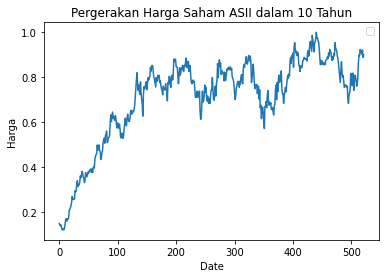

In [ ]:
ASII = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ASII.JK.csv')

ASII_x = ASII['No'].values
ASII_y = ASII['Skala'].values

plt.plot(ASII_x,ASII_y)
plt.title('Pergerakan Harga Saham ASII dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ASII**

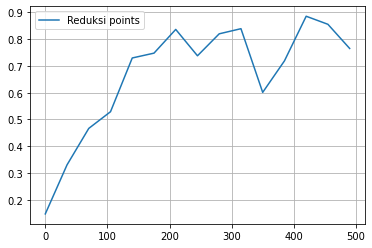

In [ ]:
ASII_x15 = ASII_x[0:522:35]
ASII_y15 = ASII_y[0:522:35]

plt.plot(ASII_x15, ASII_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASII_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ASII_15: [0.14754098 0.25330176 0.50869703 0.4677377  0.8043625  0.69186147
 0.91343751 0.67078195 0.82966421 0.92859399 0.4887467  0.72297659
 1.00010425 0.79776208 0.76502732 0.         0.         0.
 0.        ]
k_ASII_15: 3



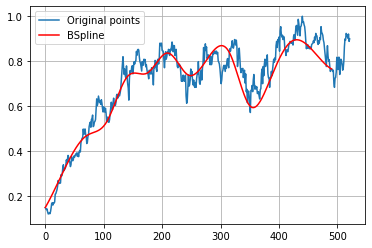

In [ ]:
import scipy.interpolate as interpolate

t_ASII_15, c_ASII_15, k_ASII_15 = interpolate.splrep(ASII_x15, ASII_y15, s=0, k=3)
print('''\
t_ASII_15: {}
c_ASII_15: {}
k_ASII_15: {}
'''.format(t_ASII_15, c_ASII_15, k_ASII_15))
N = 522
xmin_ASII_15, xmax_ASII_15 = ASII_x15.min(), ASII_x15.max()
xx_ASII_15 = np.linspace(xmin_ASII_15, xmax_ASII_15, N)
spline_ASII_15 = interpolate.BSpline(t_ASII_15, c_ASII_15, k_ASII_15, extrapolate=False)

plt.plot(ASII_x, ASII_y, label='Original points')
plt.plot(xx_ASII_15, spline_ASII_15(xx_ASII_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ASII**

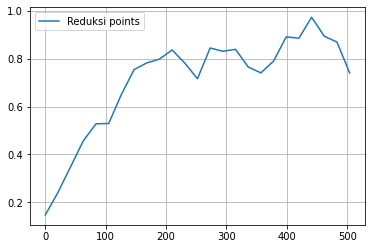

In [ ]:
ASII_x25 = ASII_x[0:522:21]
ASII_y25 = ASII_y[0:522:21]

plt.plot(ASII_x25, ASII_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASII_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ASII_25: [0.14754098 0.202684   0.31239157 0.45932703 0.55455005 0.48968589
 0.66047688 0.77004593 0.78392955 0.78603916 0.85879908 0.79515797
 0.64909363 0.90354947 0.80228227 0.87092803 0.74679251 0.73206587
 0.76756698 0.93537115 0.83521073 1.03526135 0.80132546 0.92857224
 0.74043716 0.         0.         0.         0.        ]
k_ASII_25: 3



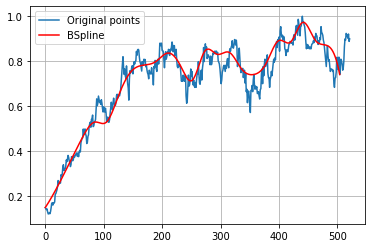

In [ ]:
import scipy.interpolate as interpolate

t_ASII_25, c_ASII_25, k_ASII_25 = interpolate.splrep(ASII_x25, ASII_y25, s=0, k=3)
print('''\
t_ASII_25: {}
c_ASII_25: {}
k_ASII_25: {}
'''.format(t_ASII_25, c_ASII_25, k_ASII_25))
N = 522
xmin_ASII_25, xmax_ASII_25 = ASII_x25.min(), ASII_x25.max()
xx_ASII_25 = np.linspace(xmin_ASII_25, xmax_ASII_25, N)
spline_ASII_25 = interpolate.BSpline(t_ASII_25, c_ASII_25, k_ASII_25, extrapolate=False)

plt.plot(ASII_x, ASII_y, label='Original points')
plt.plot(xx_ASII_25, spline_ASII_25(xx_ASII_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA ASII**

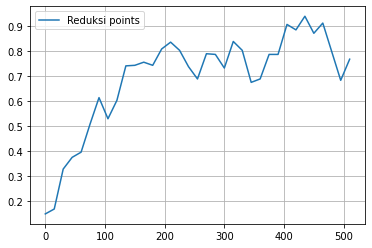

In [ ]:
ASII_x35 = ASII_x[0:522:15]
ASII_y35 = ASII_y[0:522:15]

plt.plot(ASII_x35, ASII_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASII_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ASII_35: [0.14754098 0.03835581 0.35470916 0.37800002 0.3733697  0.49901299
 0.67647999 0.47703428 0.5891534  0.78274558 0.72576593 0.77320708
 0.71583196 0.82248146 0.8467012  0.80710717 0.74454225 0.64095332
 0.822792   0.80558358 0.67618516 0.8831184  0.8241281  0.64004131
 0.66488699 0.83155829 0.73019134 0.96898781 0.83648036 0.99656616
 0.81659926 0.96654499 0.73465914 0.60739721 0.76775956 0.
 0.         0.         0.        ]
k_ASII_35: 3



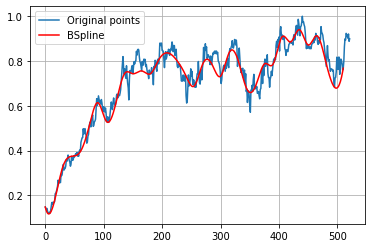

In [ ]:
import scipy.interpolate as interpolate

t_ASII_35, c_ASII_35, k_ASII_35 = interpolate.splrep(ASII_x35, ASII_y35, s=0, k=3)
print('''\
t_ASII_35: {}
c_ASII_35: {}
k_ASII_35: {}
'''.format(t_ASII_35, c_ASII_35, k_ASII_35))
N = 522
xmin_ASII_35, xmax_ASII_35 = ASII_x35.min(), ASII_x35.max()
xx_ASII_35 = np.linspace(xmin_ASII_35, xmax_ASII_35, N)
spline_ASII_35 = interpolate.BSpline(t_ASII_35, c_ASII_35, k_ASII_35, extrapolate=False)

plt.plot(ASII_x, ASII_y, label='Original points')
plt.plot(xx_ASII_35, spline_ASII_35(xx_ASII_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA ASII**

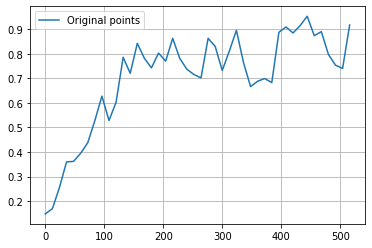

In [ ]:
ASII_x45 = ASII_x[0:522:12]
ASII_y45 = ASII_y[0:522:12]

plt.plot(ASII_x45, ASII_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASII_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ASII_45: [0.14754098 0.13876209 0.19651955 0.39178717 0.34489193 0.3991369
 0.42905225 0.5108836  0.69462645 0.4778237  0.56457057 0.88028746
 0.63231237 0.91505322 0.76649114 0.71078548 0.84938333 0.71135334
 0.92815411 0.75635808 0.73493817 0.73011876 0.63966876 0.92432096
 0.84337528 0.68578447 0.80692946 0.95535015 0.74871913 0.63993727
 0.69153179 0.72508312 0.60485704 0.95384939 0.90761425 0.87470999
 0.90502121 0.99700846 0.82825644 0.93586743 0.77253614 0.75698562
 0.68434872 0.91803279 0.         0.         0.         0.        ]
k_ASII_45: 3



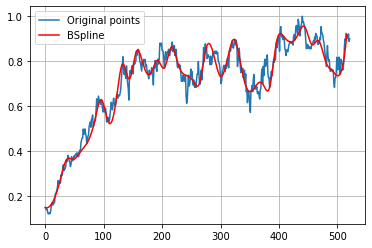

In [ ]:
import scipy.interpolate as interpolate

t_ASII_45, c_ASII_45, k_ASII_45 = interpolate.splrep(ASII_x45, ASII_y45, s=0, k=3)
print('''\
t_ASII_45: {}
c_ASII_45: {}
k_ASII_45: {}
'''.format(t_ASII_45, c_ASII_45, k_ASII_45))
N = 522
xmin_ASII_45, xmax_ASII_45 = ASII_x45.min(), ASII_x45.max()
xx_ASII_45 = np.linspace(xmin_ASII_45, xmax_ASII_45, N)
spline_ASII_45 = interpolate.BSpline(t_ASII_45, c_ASII_45, k_ASII_45, extrapolate=False)

plt.plot(ASII_x, ASII_y, label='Original points')
plt.plot(xx_ASII_45, spline_ASII_45(xx_ASII_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA ASII**

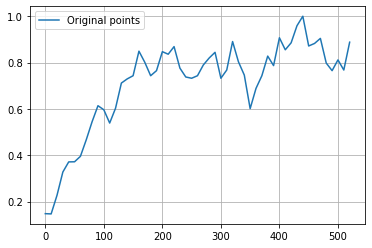

In [ ]:
ASII_x55 = ASII_x[0:522:10]
ASII_y55 = ASII_y[0:522:10]

plt.plot(ASII_x55, ASII_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASII_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ASII_55: [0.14754098 0.10821568 0.18220252 0.34058511 0.37979581 0.36646117
 0.3838677  0.46855983 0.54189299 0.63272066 0.60919158 0.50756221
 0.59334646 0.73544538 0.73372447 0.70670593 0.89846822 0.79450314
 0.73007657 0.74420695 0.88325955 0.80472205 0.9142457  0.75140991
 0.73585237 0.73141011 0.73194982 0.79980703 0.806527   0.89211776
 0.69057573 0.73902193 0.95989393 0.76566466 0.79711956 0.52126693
 0.7243701  0.7124002  0.88504551 0.71463088 0.97774243 0.81702235
 0.88531572 0.9531902  1.05602184 0.82272245 0.88259657 0.94197324
 0.77574    0.74195203 0.88150375 0.66990386 0.88797814 0.
 0.         0.         0.        ]
k_ASII_55: 3



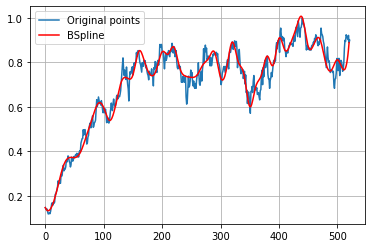

In [ ]:
import scipy.interpolate as interpolate

t_ASII_55, c_ASII_55, k_ASII_55 = interpolate.splrep(ASII_x55, ASII_y55, s=0, k=3)
print('''\
t_ASII_55: {}
c_ASII_55: {}
k_ASII_55: {}
'''.format(t_ASII_55, c_ASII_55, k_ASII_55))
N = 522
xmin_ASII_55, xmax_ASII_55 = ASII_x55.min(), ASII_x55.max()
xx_ASII_55 = np.linspace(xmin_ASII_55, xmax_ASII_55, N)
spline_ASII_55 = interpolate.BSpline(t_ASII_55, c_ASII_55, k_ASII_55, extrapolate=False)

plt.plot(ASII_x, ASII_y, label='Original points')
plt.plot(xx_ASII_55, spline_ASII_55(xx_ASII_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA ASII**

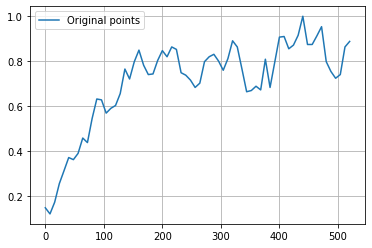

In [ ]:
ASII_x65 = ASII_x[0:522:8]
ASII_y65 = ASII_y[0:522:8]

plt.plot(ASII_x65, ASII_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASII_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ASII_65: [0.14754098 0.09470118 0.13163588 0.26543324 0.30432935 0.39265919
 0.35126339 0.37277906 0.49532529 0.39346077 0.55706114 0.64714714
 0.64451426 0.54200895 0.60056468 0.59671593 0.62896505 0.82185012
 0.67379842 0.80754635 0.87962273 0.7690447  0.73600174 0.72957127
 0.80472958 0.87118255 0.79250745 0.87682043 0.88053868 0.71577894
 0.74814884 0.71785521 0.67551229 0.67845627 0.82377738 0.81331946
 0.84097756 0.80637684 0.73679375 0.80382519 0.91675794 0.87340536
 0.7699485  0.63696459 0.66579969 0.71623007 0.60042756 0.91484657
 0.59264517 0.81293342 0.92611297 0.92523766 0.8319528  0.87809868
 0.88516069 1.07306

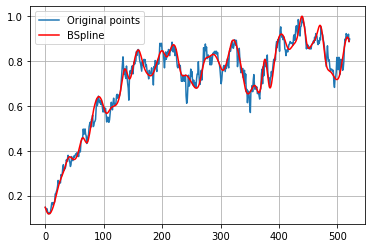

In [ ]:
import scipy.interpolate as interpolate

t_ASII_65, c_ASII_65, k_ASII_65 = interpolate.splrep(ASII_x65, ASII_y65, s=0, k=3)
print('''\
t_ASII_65: {}
c_ASII_65: {}
k_ASII_65: {}
'''.format(t_ASII_65, c_ASII_65, k_ASII_65))
N = 522
xmin_ASII_65, xmax_ASII_65 = ASII_x65.min(), ASII_x65.max()
xx_ASII_65 = np.linspace(xmin_ASII_65, xmax_ASII_65, N)
spline_ASII_65 = interpolate.BSpline(t_ASII_65, c_ASII_65, k_ASII_65, extrapolate=False)

plt.plot(ASII_x, ASII_y, label='Original points')
plt.plot(xx_ASII_65, spline_ASII_65(xx_ASII_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ASII**

In [ ]:

#RMSE 15 DATA ASII
y_true_ASII_15 = ASII_y.tolist()
y_pred_ASII_15 = spline_ASII_15(xx_ASII_15).tolist()
mse_ASII_15 = mean_squared_error(y_true_ASII_15, y_pred_ASII_15)
rmse_ASII_15 = np.sqrt(mse_ASII_15)
print("rmse ASII 15 =",rmse_ASII_15)

#RMSE 25 DATA ASII
y_true_ASII_25 = ASII_y.tolist()
y_pred_ASII_25 = spline_ASII_25(xx_ASII_25).tolist()
mse_ASII_25 = mean_squared_error(y_true_ASII_25, y_pred_ASII_25)
rmse_ASII_25 = np.sqrt(mse_ASII_25)
print("rmse ASII 25 =",rmse_ASII_25)

#RMSE 35 DATA ASII
y_true_ASII_35 = ASII_y.tolist()
y_pred_ASII_35 = spline_ASII_35(xx_ASII_35).tolist()
mse_ASII_35 = mean_squared_error(y_true_ASII_35, y_pred_ASII_35)
rmse_ASII_35 = np.sqrt(mse_ASII_35)
print("rmse ASII 35 =",rmse_ASII_35)

#RMSE 45 DATA ASII
y_true_ASII_45 = ASII_y.tolist()
y_pred_ASII_45 = spline_ASII_45(xx_ASII_45).tolist()
mse_ASII_45 = mean_squared_error(y_true_ASII_45, y_pred_ASII_45)
rmse_ASII_45 = np.sqrt(mse_ASII_45)
print("rmse ASII 45 =",rmse_ASII_45)

#RMSE 55 DATA ASII
y_true_ASII_55 = ASII_y.tolist()
y_pred_ASII_55 = spline_ASII_55(xx_ASII_55).tolist()
mse_ASII_55 = mean_squared_error(y_true_ASII_55, y_pred_ASII_55)
rmse_ASII_55 = np.sqrt(mse_ASII_55)
print("rmse ASII 55 =",rmse_ASII_55)

#RMSE 65 DATA ASII
y_true_ASII_65 = ASII_y.tolist()
y_pred_ASII_65 = spline_ASII_65(xx_ASII_65).tolist()
mse_ASII_65 = mean_squared_error(y_true_ASII_65, y_pred_ASII_65)
rmse_ASII_65 = np.sqrt(mse_ASII_65)
print("rmse ASII 65 =",rmse_ASII_65)

rmse ASII 15 = 0.08168354212257097
rmse ASII 25 = 0.058151953668882275
rmse ASII 35 = 0.05265896674221036
rmse ASII 45 = 0.04327574650000453
rmse ASII 55 = 0.03700043532276081
rmse ASII 65 = 0.0317310552659825


# **ASRI**

No handles with labels found to put in legend.


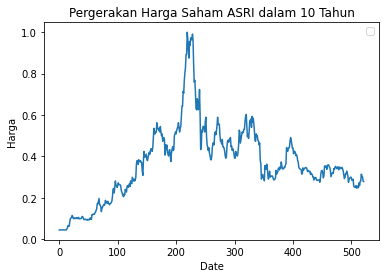

In [ ]:
ASRI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ASRI.JK.csv')

ASRI_x = ASRI['No'].values
ASRI_y = ASRI['Skala'].values

plt.plot(ASRI_x,ASRI_y)
plt.title('Pergerakan Harga Saham ASRI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ASRI**

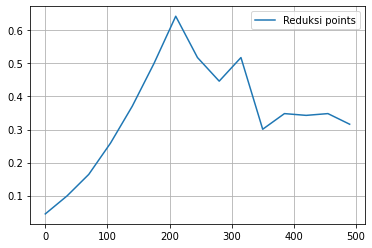

In [ ]:
ASRI_x15 = ASRI_x[0:522:35]
ASRI_y15 = ASRI_y[0:522:35]

plt.plot(ASRI_x15, ASRI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASRI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ASRI_15: [0.04464286 0.08314265 0.12567898 0.25567796 0.37268087 0.47681283
 0.7200678  0.50005882 0.38683978 0.63115349 0.19568912 0.39144719
 0.30659473 0.37839906 0.31607143 0.         0.         0.
 0.        ]
k_ASRI_15: 3



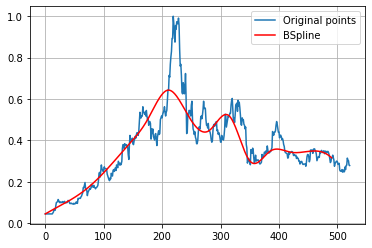

In [ ]:
import scipy.interpolate as interpolate

t_ASRI_15, c_ASRI_15, k_ASRI_15 = interpolate.splrep(ASRI_x15, ASRI_y15, s=0, k=3)
print('''\
t_ASRI_15: {}
c_ASRI_15: {}
k_ASRI_15: {}
'''.format(t_ASRI_15, c_ASRI_15, k_ASRI_15))
N = 522
xmin_ASRI_15, xmax_ASRI_15 = ASRI_x15.min(), ASRI_x15.max()
xx_ASRI_15 = np.linspace(xmin_ASRI_15, xmax_ASRI_15, N)
spline_ASRI_15 = interpolate.BSpline(t_ASRI_15, c_ASRI_15, k_ASRI_15, extrapolate=False)

plt.plot(ASRI_x, ASRI_y, label='Original points')
plt.plot(xx_ASRI_15, spline_ASRI_15(xx_ASRI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA ASRI**

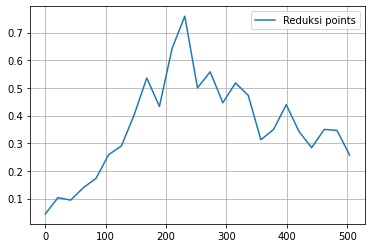

In [ ]:
ASRI_x25 = ASRI_x[0:522:21]
ASRI_y25 = ASRI_y[0:522:21]

plt.plot(ASRI_x25, ASRI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASRI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ASRI_25: [0.04464286 0.14762999 0.04938288 0.15241377 0.1509186  0.28319753
 0.26986271 0.37842306 0.62715932 0.32722537 0.66215348 0.88130358
 0.36620365 0.65388184 0.36648327 0.55875652 0.50563353 0.25799509
 0.33738611 0.49246045 0.32848636 0.25073697 0.41260392 0.33476947
 0.25714286 0.         0.         0.         0.        ]
k_ASRI_25: 3



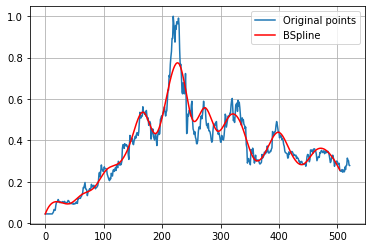

In [ ]:
import scipy.interpolate as interpolate

t_ASRI_25, c_ASRI_25, k_ASRI_25 = interpolate.splrep(ASRI_x25, ASRI_y25, s=0, k=3)
print('''\
t_ASRI_25: {}
c_ASRI_25: {}
k_ASRI_25: {}
'''.format(t_ASRI_25, c_ASRI_25, k_ASRI_25))
N = 522
xmin_ASRI_25, xmax_ASRI_25 = ASRI_x25.min(), ASRI_x25.max()
xx_ASRI_25 = np.linspace(xmin_ASRI_25, xmax_ASRI_25, N)
spline_ASRI_25 = interpolate.BSpline(t_ASRI_25, c_ASRI_25, k_ASRI_25, extrapolate=False)

plt.plot(ASRI_x, ASRI_y, label='Original points')
plt.plot(xx_ASRI_25, spline_ASRI_25(xx_ASRI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 35 DATA ASRI**

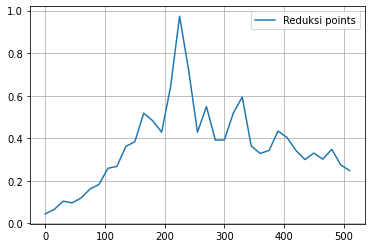

In [ ]:
ASRI_x35 = ASRI_x[0:522:15]
ASRI_y35 = ASRI_y[0:522:15]

plt.plot(ASRI_x35, ASRI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASRI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ASRI_35: [0.04464286 0.02968561 0.13036093 0.08622943 0.11432564 0.17432516
 0.15801657 0.29182282 0.22826356 0.40226579 0.33231612 0.57204114
 0.48666216 0.37416734 0.58809704 1.13058735 0.72883929 0.29334122
 0.6692244  0.32440402 0.37958809 0.50902933 0.69143743 0.28772095
 0.34339304 0.31013545 0.47320803 0.40060387 0.34580508 0.27331869
 0.36092016 0.26514351 0.43057893 0.18560339 0.24821429 0.
 0.         0.         0.        ]
k_ASRI_35: 3



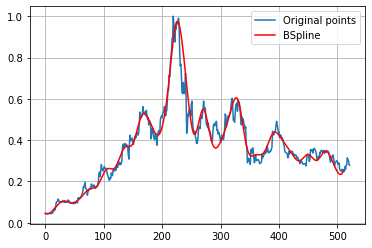

In [ ]:
import scipy.interpolate as interpolate

t_ASRI_35, c_ASRI_35, k_ASRI_35 = interpolate.splrep(ASRI_x35, ASRI_y35, s=0, k=3)
print('''\
t_ASRI_35: {}
c_ASRI_35: {}
k_ASRI_35: {}
'''.format(t_ASRI_35, c_ASRI_35, k_ASRI_35))
N = 522
xmin_ASRI_35, xmax_ASRI_35 = ASRI_x35.min(), ASRI_x35.max()
xx_ASRI_35 = np.linspace(xmin_ASRI_35, xmax_ASRI_35, N)
spline_ASRI_35 = interpolate.BSpline(t_ASRI_35, c_ASRI_35, k_ASRI_35, extrapolate=False)

plt.plot(ASRI_x, ASRI_y, label='Original points')
plt.plot(xx_ASRI_35, spline_ASRI_35(xx_ASRI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA ASRI**

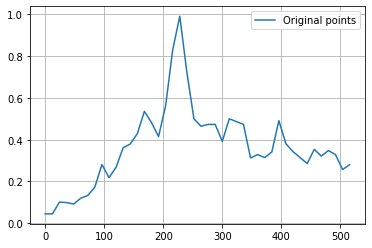

In [ ]:
ASRI_x45 = ASRI_x[0:522:12]
ASRI_y45 = ASRI_y[0:522:12]

plt.plot(ASRI_x45, ASRI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASRI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ASRI_45: [ 0.04464286 -0.0091965   0.12419657  0.09874978  0.08180886  0.1258005
  0.13284627  0.14102871  0.34232459  0.17717293  0.26148371  0.3840351
  0.37201876  0.40467559  0.58070745  0.48678031  0.36502845  0.54417732
  0.83326226  1.1049165   0.69350033  0.4603679   0.46502807  0.46523412
  0.51332117  0.32076691  0.55539691  0.45764546  0.53366411  0.2469838
  0.35340069  0.31084203  0.28894546  0.57980468  0.33826437  0.34928068
  0.32175576  0.24941058  0.39488765  0.29246738  0.36381425  0.33414367
  0.19498173  0.28035714  0.          0.          0.          0.        ]
k_ASRI_45: 3



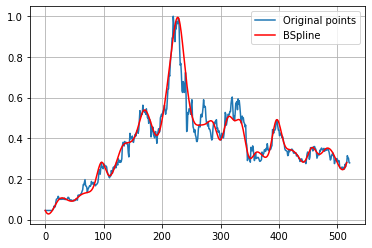

In [ ]:
import scipy.interpolate as interpolate

t_ASRI_45, c_ASRI_45, k_ASRI_45 = interpolate.splrep(ASRI_x45, ASRI_y45, s=0, k=3)
print('''\
t_ASRI_45: {}
c_ASRI_45: {}
k_ASRI_45: {}
'''.format(t_ASRI_45, c_ASRI_45, k_ASRI_45))
N = 522
xmin_ASRI_45, xmax_ASRI_45 = ASRI_x45.min(), ASRI_x45.max()
xx_ASRI_45 = np.linspace(xmin_ASRI_45, xmax_ASRI_45, N)
spline_ASRI_45 = interpolate.BSpline(t_ASRI_45, c_ASRI_45, k_ASRI_45, extrapolate=False)

plt.plot(ASRI_x, ASRI_y, label='Original points')
plt.plot(xx_ASRI_45, spline_ASRI_45(xx_ASRI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()



**5. PERCOBAAN 55 DATA ASRI**

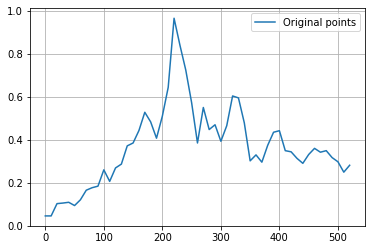

In [ ]:
ASRI_x55 = ASRI_x[0:522:10]
ASRI_y55 = ASRI_y[0:522:10]

plt.plot(ASRI_x55, ASRI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ASRI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ASRI_55: [ 0.04464286 -0.01077417  0.12690548  0.0974394   0.11748917  0.08081821
  0.11638084  0.17151558  0.18327111  0.15075712  0.31191469  0.15515554
  0.29960602  0.25356326  0.40042666  0.36794437  0.43136729  0.55837217
  0.4958583   0.35105177  0.53743462  0.55278118  1.10858352  0.79859901
  0.73273471  0.60974787  0.25684526  0.66644254  0.37202744  0.52401911
  0.34439612  0.45018211  0.64058972  0.60353045  0.50778847  0.2313871
  0.37202027  0.2519604   0.38799527  0.43534425  0.47419918  0.31428762
  0.35793606  0.31111101  0.27261989  0.33412373  0.37302806  0.32733544
  0.36405875  0.30571529  0.31077314  0.19684557  0.28035714  0.
  0.          0.          0.        ]
k

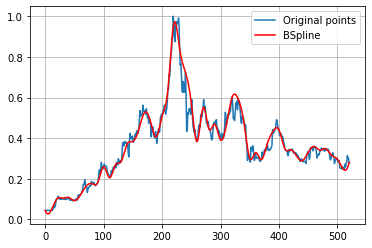

In [ ]:
import scipy.interpolate as interpolate

t_ASRI_55, c_ASRI_55, k_ASRI_55 = interpolate.splrep(ASRI_x55, ASRI_y55, s=0, k=3)
print('''\
t_ASRI_55: {}
c_ASRI_55: {}
k_ASRI_55: {}
'''.format(t_ASRI_55, c_ASRI_55, k_ASRI_55))
N = 522
xmin_ASRI_55, xmax_ASRI_55 = ASRI_x55.min(), ASRI_x55.max()
xx_ASRI_55 = np.linspace(xmin_ASRI_55, xmax_ASRI_55, N)
spline_ASRI_55 = interpolate.BSpline(t_ASRI_55, c_ASRI_55, k_ASRI_55, extrapolate=False)

plt.plot(ASRI_x, ASRI_y, label='Original points')
plt.plot(xx_ASRI_55, spline_ASRI_55(xx_ASRI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA ASRI**

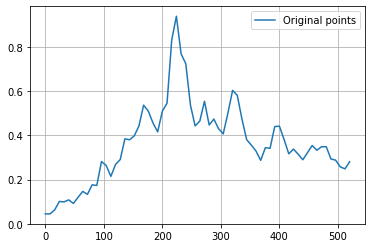

In [ ]:
ASRI_x65 = ASRI_x[0:522:8]
ASRI_y65 = ASRI_y[0:522:8]

plt.plot(ASRI_x65, ASRI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ASRI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ASRI_65: [0.04464286 0.04536146 0.03427708 0.11525105 0.08983236 0.12006237
 0.07813246 0.1191935  0.16295068 0.10757521 0.20496276 0.12793089
 0.32259941 0.26917149 0.18107178 0.29225569 0.25704833 0.42062241
 0.36403344 0.40002954 0.41977699 0.57264823 0.50391579 0.46526003
 0.36718695 0.55706361 0.45813005 0.87827332 1.01091952 0.70304859
 0.78402896 0.50012129 0.42977161 0.43257798 0.62563074 0.38632764
 0.50763011 0.42243762 0.37940512 0.4974419  0.63082727 0.59532043
 0.47003387 0.36382981 0.35678973 0.34115412 0.25002235 0.37839932
 0.29888037 0.47250776 0.44680286 0.38670937 0.28850251 0.35570916
 0.31366087 0.27536

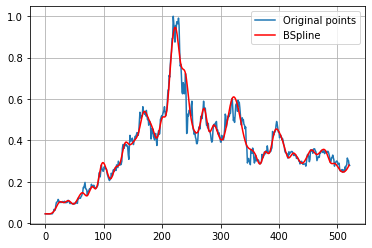

In [ ]:
import scipy.interpolate as interpolate

t_ASRI_65, c_ASRI_65, k_ASRI_65 = interpolate.splrep(ASRI_x65, ASRI_y65, s=0, k=3)
print('''\
t_ASRI_65: {}
c_ASRI_65: {}
k_ASRI_65: {}
'''.format(t_ASRI_65, c_ASRI_65, k_ASRI_65))
N = 522
xmin_ASRI_65, xmax_ASRI_65 = ASRI_x65.min(), ASRI_x65.max()
xx_ASRI_65 = np.linspace(xmin_ASRI_65, xmax_ASRI_65, N)
spline_ASRI_65 = interpolate.BSpline(t_ASRI_65, c_ASRI_65, k_ASRI_65, extrapolate=False)

plt.plot(ASRI_x, ASRI_y, label='Original points')
plt.plot(xx_ASRI_65, spline_ASRI_65(xx_ASRI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ASRI**

In [ ]:

#RMSE 15 DATA ASRI
y_true_ASRI_15 = ASRI_y.tolist()
y_pred_ASRI_15 = spline_ASRI_15(xx_ASRI_15).tolist()
mse_ASRI_15 = mean_squared_error(y_true_ASRI_15, y_pred_ASRI_15)
rmse_ASRI_15 = np.sqrt(mse_ASRI_15)
print("rmse ASRI 15 =",rmse_ASRI_15)

#RMSE 25 DATA ASRI
y_true_ASRI_25 = ASRI_y.tolist()
y_pred_ASRI_25 = spline_ASRI_25(xx_ASRI_25).tolist()
mse_ASRI_25 = mean_squared_error(y_true_ASRI_25, y_pred_ASRI_25)
rmse_ASRI_25 = np.sqrt(mse_ASRI_25)
print("rmse ASRI 25 =",rmse_ASRI_25)

#RMSE 35 DATA ASRI
y_true_ASRI_35 = ASRI_y.tolist()
y_pred_ASRI_35 = spline_ASRI_35(xx_ASRI_35).tolist()
mse_ASRI_35 = mean_squared_error(y_true_ASRI_35, y_pred_ASRI_35)
rmse_ASRI_35 = np.sqrt(mse_ASRI_35)
print("rmse ASRI 35 =",rmse_ASRI_35)

#RMSE 45 DATA ASRI
y_true_ASRI_45 = ASRI_y.tolist()
y_pred_ASRI_45 = spline_ASRI_45(xx_ASRI_45).tolist()
mse_ASRI_45 = mean_squared_error(y_true_ASRI_45, y_pred_ASRI_45)
rmse_ASRI_45 = np.sqrt(mse_ASRI_45)
print("rmse ASRI 45 =",rmse_ASRI_45)

#RMSE 55 DATA ASRI
y_true_ASRI_55 = ASRI_y.tolist()
y_pred_ASRI_55 = spline_ASRI_55(xx_ASRI_55).tolist()
mse_ASRI_55 = mean_squared_error(y_true_ASRI_55, y_pred_ASRI_55)
rmse_ASRI_55 = np.sqrt(mse_ASRI_55)
print("rmse ASRI 55 =",rmse_ASRI_55)

#RMSE 65 DATA ASRI
y_true_ASRI_65 = ASRI_y.tolist()
y_pred_ASRI_65 = spline_ASRI_65(xx_ASRI_65).tolist()
mse_ASRI_65 = mean_squared_error(y_true_ASRI_65, y_pred_ASRI_65)
rmse_ASRI_65 = np.sqrt(mse_ASRI_65)
print("rmse ASRI 65 =",rmse_ASRI_65)


rmse ASRI 15 = 0.07502166710988074
rmse ASRI 25 = 0.07138560564461471
rmse ASRI 35 = 0.06630912823904532
rmse ASRI 45 = 0.05133026157477589
rmse ASRI 55 = 0.03652047956330457
rmse ASRI 65 = 0.0334990582024533


# **BBCA**

No handles with labels found to put in legend.


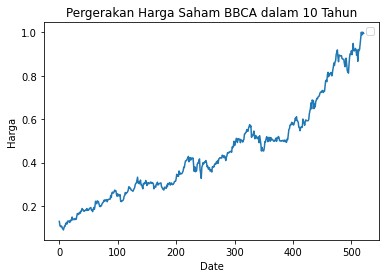

In [ ]:
BBCA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BBCA.JK.csv')

BBCA_x = BBCA['No'].values
BBCA_y = BBCA['Skala'].values

plt.plot(BBCA_x,BBCA_y)
plt.title('Pergerakan Harga Saham BBCA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BBCA**

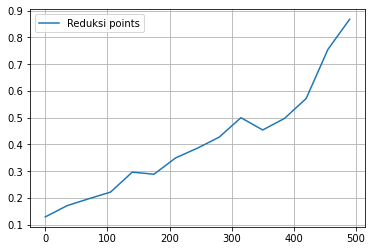

In [ ]:
BBCA_x15 = BBCA_x[0:522:35]
BBCA_y15 = BBCA_y[0:522:35]

plt.plot(BBCA_x15, BBCA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBCA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BBCA_15: [0.1290631  0.15938178 0.20274696 0.19978332 0.32964462 0.25984086
 0.3633055  0.38636354 0.40863998 0.54313007 0.41883973 0.50617641
 0.55026948 0.87543888 0.86806883 0.         0.         0.
 0.        ]
k_BBCA_15: 3



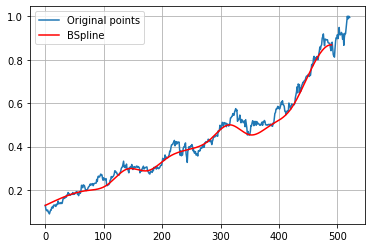

In [ ]:
import scipy.interpolate as interpolate

t_BBCA_15, c_BBCA_15, k_BBCA_15 = interpolate.splrep(BBCA_x15, BBCA_y15, s=0, k=3)
print('''\
t_BBCA_15: {}
c_BBCA_15: {}
k_BBCA_15: {}
'''.format(t_BBCA_15, c_BBCA_15, k_BBCA_15))
N = 522
xmin_BBCA_15, xmax_BBCA_15 = BBCA_x15.min(), BBCA_x15.max()
xx_BBCA_15 = np.linspace(xmin_BBCA_15, xmax_BBCA_15, N)
spline_BBCA_15 = interpolate.BSpline(t_BBCA_15, c_BBCA_15, k_BBCA_15, extrapolate=False)

plt.plot(BBCA_x, BBCA_y, label='Original points')
plt.plot(xx_BBCA_15, spline_BBCA_15(xx_BBCA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BBCA**

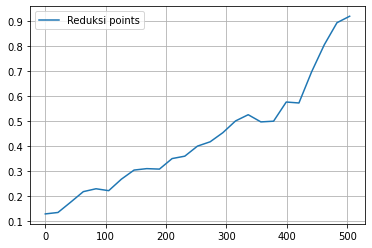

In [ ]:
BBCA_x25 = BBCA_x[0:522:21]
BBCA_y25 = BBCA_y[0:522:21]

plt.plot(BBCA_x25, BBCA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBCA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BBCA_25: [0.1290631  0.11353562 0.15964003 0.22381274 0.23690522 0.20523942
 0.27292104 0.30919498 0.31439083 0.29175031 0.36564425 0.34509908
 0.41074718 0.40961773 0.45173791 0.50235988 0.53882255 0.49148949
 0.47227495 0.61367459 0.52618158 0.71180941 0.83271555 0.93713171
 0.91778203 0.         0.         0.         0.        ]
k_BBCA_25: 3



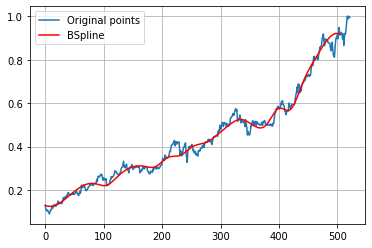

In [ ]:
import scipy.interpolate as interpolate

t_BBCA_25, c_BBCA_25, k_BBCA_25 = interpolate.splrep(BBCA_x25, BBCA_y25, s=0, k=3)
print('''\
t_BBCA_25: {}
c_BBCA_25: {}
k_BBCA_25: {}
'''.format(t_BBCA_25, c_BBCA_25, k_BBCA_25))
N = 522
xmin_BBCA_25, xmax_BBCA_25 = BBCA_x25.min(), BBCA_x25.max()
xx_BBCA_25 = np.linspace(xmin_BBCA_25, xmax_BBCA_25, N)
spline_BBCA_25 = interpolate.BSpline(t_BBCA_25, c_BBCA_25, k_BBCA_25, extrapolate=False)

plt.plot(BBCA_x, BBCA_y, label='Original points')
plt.plot(xx_BBCA_25, spline_BBCA_25(xx_BBCA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BBCA**

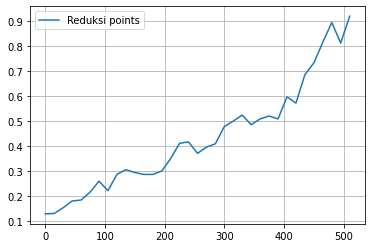

In [ ]:
BBCA_x35 = BBCA_x[0:522:15]
BBCA_y35 = BBCA_y[0:522:15]

plt.plot(BBCA_x35, BBCA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBCA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BBCA_35: [0.1290631  0.12138178 0.13964561 0.18855581 0.17803364 0.20638421
 0.29279661 0.18265877 0.30735224 0.30877358 0.2931175  0.28548682
 0.28577652 0.29224842 0.34637705 0.42166977 0.43348308 0.34535394
 0.41072256 0.38651682 0.4982771  0.48844362 0.54794844 0.46316608
 0.51334518 0.53507846 0.46679989 0.64934724 0.51516106 0.72021886
 0.71677421 0.80656576 0.99001416 0.675165   0.91873805 0.
 0.         0.         0.        ]
k_BBCA_35: 3



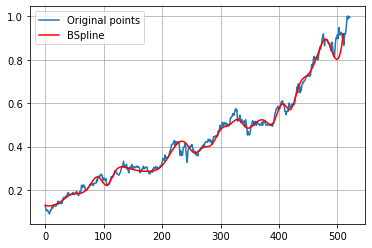

In [ ]:
import scipy.interpolate as interpolate

t_BBCA_35, c_BBCA_35, k_BBCA_35 = interpolate.splrep(BBCA_x35, BBCA_y35, s=0, k=3)
print('''\
t_BBCA_35: {}
c_BBCA_35: {}
k_BBCA_35: {}
'''.format(t_BBCA_35, c_BBCA_35, k_BBCA_35))
N = 522
xmin_BBCA_35, xmax_BBCA_35 = BBCA_x35.min(), BBCA_x35.max()
xx_BBCA_35 = np.linspace(xmin_BBCA_35, xmax_BBCA_35, N)
spline_BBCA_35 = interpolate.BSpline(t_BBCA_35, c_BBCA_35, k_BBCA_35, extrapolate=False)

plt.plot(BBCA_x, BBCA_y, label='Original points')
plt.plot(xx_BBCA_35, spline_BBCA_35(xx_BBCA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BBCA**

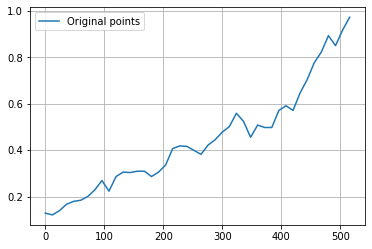

In [ ]:

BBCA_x45 = BBCA_x[0:522:12]
BBCA_y45 = BBCA_y[0:522:12]

plt.plot(BBCA_x45, BBCA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBCA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BBCA_45: [0.1290631  0.11269342 0.1259516  0.17125425 0.18152982 0.18102034
 0.2014634  0.21771496 0.30434979 0.18247671 0.30799958 0.30636627
 0.30209938 0.30932799 0.31909726 0.27279157 0.31057777 0.32046139
 0.42669712 0.41634478 0.42035207 0.40320296 0.36454165 0.43308551
 0.43848916 0.485998   0.48558766 0.58312362 0.5375584  0.41578236
 0.53544981 0.49404363 0.47690341 0.58687046 0.60582509 0.54049841
 0.6623916  0.69330039 0.7919403  0.80241834 0.93720087 0.77035557
 0.99436332 0.97323136 0.         0.         0.         0.        ]
k_BBCA_45: 3



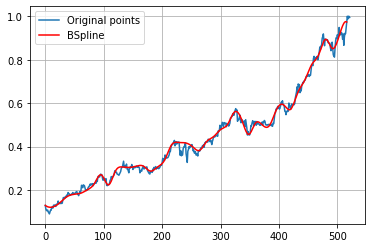

In [ ]:
import scipy.interpolate as interpolate

t_BBCA_45, c_BBCA_45, k_BBCA_45 = interpolate.splrep(BBCA_x45, BBCA_y45, s=0, k=3)
print('''\
t_BBCA_45: {}
c_BBCA_45: {}
k_BBCA_45: {}
'''.format(t_BBCA_45, c_BBCA_45, k_BBCA_45))
N = 522
xmin_BBCA_45, xmax_BBCA_45 = BBCA_x45.min(), BBCA_x45.max()
xx_BBCA_45 = np.linspace(xmin_BBCA_45, xmax_BBCA_45, N)
spline_BBCA_45 = interpolate.BSpline(t_BBCA_45, c_BBCA_45, k_BBCA_45, extrapolate=False)

plt.plot(BBCA_x, BBCA_y, label='Original points')
plt.plot(xx_BBCA_45, spline_BBCA_45(xx_BBCA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BBCA**


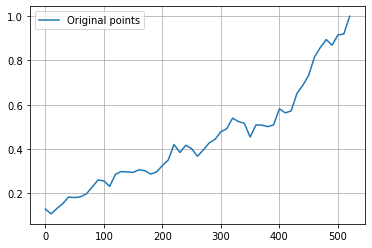

In [ ]:
BBCA_x55 = BBCA_x[0:522:10]
BBCA_y55 = BBCA_y[0:522:10]

plt.plot(BBCA_x55, BBCA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBCA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BBCA_55: [0.1290631  0.08296107 0.13187901 0.14834145 0.19415772 0.17636608
 0.18450799 0.19267654 0.22643022 0.26680334 0.26658587 0.20413809
 0.30500708 0.29667489 0.29796832 0.28965453 0.31014398 0.30533361
 0.28114108 0.29094338 0.33328808 0.32619112 0.46137382 0.35221417
 0.43569684 0.40595451 0.34966295 0.39807055 0.43281582 0.43471969
 0.48987331 0.47385592 0.56307777 0.50901466 0.54426705 0.4114315
 0.53467234 0.50150437 0.5051993  0.48343457 0.61268765 0.55338653
 0.55235133 0.66741848 0.68428449 0.71972653 0.83069083 0.85043556
 0.91861854 0.83837901 0.96891155 0.87453084 0.99904398 0.
 0.         0.         0.        ]
k_BBCA_55: 3



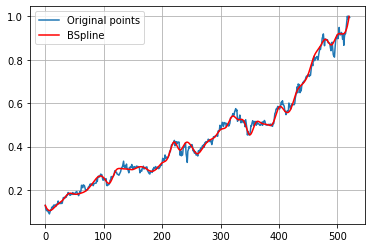

In [ ]:
import scipy.interpolate as interpolate

t_BBCA_55, c_BBCA_55, k_BBCA_55 = interpolate.splrep(BBCA_x55, BBCA_y55, s=0, k=3)
print('''\
t_BBCA_55: {}
c_BBCA_55: {}
k_BBCA_55: {}
'''.format(t_BBCA_55, c_BBCA_55, k_BBCA_55))
N = 522
xmin_BBCA_55, xmax_BBCA_55 = BBCA_x55.min(), BBCA_x55.max()
xx_BBCA_55 = np.linspace(xmin_BBCA_55, xmax_BBCA_55, N)
spline_BBCA_55 = interpolate.BSpline(t_BBCA_55, c_BBCA_55, k_BBCA_55, extrapolate=False)

plt.plot(BBCA_x, BBCA_y, label='Original points')
plt.plot(xx_BBCA_55, spline_BBCA_55(xx_BBCA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA BBCA**

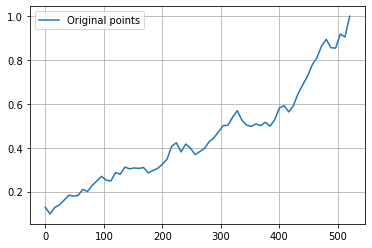

In [ ]:
BBCA_x65 = BBCA_x[0:522:8]
BBCA_y65 = BBCA_y[0:522:8]

plt.plot(BBCA_x65, BBCA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBCA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BBCA_65: [0.1290631  0.06580556 0.13416325 0.13591256 0.1592253  0.19085736
 0.1786837  0.17280172 0.22571171 0.18630174 0.23367026 0.24421799
 0.28085356 0.24995857 0.2336525  0.30682722 0.25987992 0.32860532
 0.29567969 0.31276768 0.30028591 0.32165273 0.27161179 0.30126914
 0.30151435 0.32823753 0.33582234 0.41642722 0.44206342 0.35069195
 0.43815159 0.39765774 0.35745074 0.38668846 0.3902505  0.43280668
 0.44257632 0.4699282  0.51136289 0.49035639 0.53868384 0.5900899
 0.51395847 0.50321579 0.49038679 0.51802864 0.48912389 0.53121193
 0.48354272 0.5231449  0.59022567 0.60352414 0.546347   0.58967295
 0.65136657 0.688225

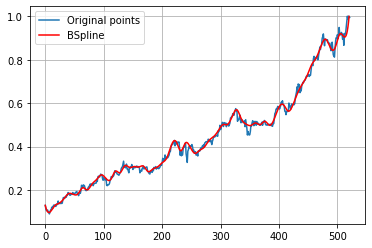

In [ ]:
import scipy.interpolate as interpolate

t_BBCA_65, c_BBCA_65, k_BBCA_65 = interpolate.splrep(BBCA_x65, BBCA_y65, s=0, k=3)
print('''\
t_BBCA_65: {}
c_BBCA_65: {}
k_BBCA_65: {}
'''.format(t_BBCA_65, c_BBCA_65, k_BBCA_65))
N = 522
xmin_BBCA_65, xmax_BBCA_65 = BBCA_x65.min(), BBCA_x65.max()
xx_BBCA_65 = np.linspace(xmin_BBCA_65, xmax_BBCA_65, N)
spline_BBCA_65 = interpolate.BSpline(t_BBCA_65, c_BBCA_65, k_BBCA_65, extrapolate=False)

plt.plot(BBCA_x, BBCA_y, label='Original points')
plt.plot(xx_BBCA_65, spline_BBCA_65(xx_BBCA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BBCA**

In [ ]:

#RMSE 15 DATA BBCA
y_true_BBCA_15 = BBCA_y.tolist()
y_pred_BBCA_15 = spline_BBCA_15(xx_BBCA_15).tolist()
mse_BBCA_15 = mean_squared_error(y_true_BBCA_15, y_pred_BBCA_15)
rmse_BBCA_15 = np.sqrt(mse_BBCA_15)
print("rmse BBCA 15 =",rmse_BBCA_15)

#RMSE 25 DATA BBCA
y_true_BBCA_25 = BBCA_y.tolist()
y_pred_BBCA_25 = spline_BBCA_25(xx_BBCA_25).tolist()
mse_BBCA_25 = mean_squared_error(y_true_BBCA_25, y_pred_BBCA_25)
rmse_BBCA_25 = np.sqrt(mse_BBCA_25)
print("rmse BBCA 25 =",rmse_BBCA_25)

#RMSE 35 DATA BBCA
y_true_BBCA_35 = BBCA_y.tolist()
y_pred_BBCA_35 = spline_BBCA_35(xx_BBCA_35).tolist()
mse_BBCA_35 = mean_squared_error(y_true_BBCA_35, y_pred_BBCA_35)
rmse_BBCA_35 = np.sqrt(mse_BBCA_35)
print("rmse BBCA 35 =",rmse_BBCA_35)

#RMSE 45 DATA BBCA
y_true_BBCA_45 = BBCA_y.tolist()
y_pred_BBCA_45 = spline_BBCA_45(xx_BBCA_45).tolist()
mse_BBCA_45 = mean_squared_error(y_true_BBCA_45, y_pred_BBCA_45)
rmse_BBCA_45 = np.sqrt(mse_BBCA_45)
print("rmse BBCA 45 =",rmse_BBCA_45)

#RMSE 55 DATA BBCA
y_true_BBCA_55 = BBCA_y.tolist()
y_pred_BBCA_55 = spline_BBCA_55(xx_BBCA_55).tolist()
mse_BBCA_55 = mean_squared_error(y_true_BBCA_55, y_pred_BBCA_55)
rmse_BBCA_55 = np.sqrt(mse_BBCA_55)
print("rmse BBCA 55 =",rmse_BBCA_55)

#RMSE 65 DATA BBCA
y_true_BBCA_65 = BBCA_y.tolist()
y_pred_BBCA_65 = spline_BBCA_65(xx_BBCA_65).tolist()
mse_BBCA_65 = mean_squared_error(y_true_BBCA_65, y_pred_BBCA_65)
rmse_BBCA_65 = np.sqrt(mse_BBCA_65)
print("rmse BBCA 65 =",rmse_BBCA_65)


rmse BBCA 15 = 0.06545834669855832
rmse BBCA 25 = 0.03808975694067217
rmse BBCA 35 = 0.037059396445889056
rmse BBCA 45 = 0.020880346227171744
rmse BBCA 55 = 0.01627850568047383
rmse BBCA 65 = 0.015591781188043293


# **BBKP**

No handles with labels found to put in legend.


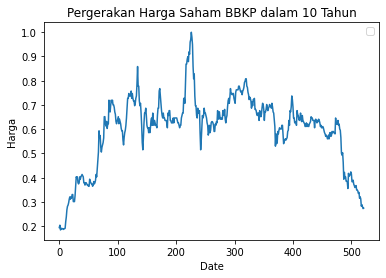

In [ ]:
BBKP = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BBKP.JK.csv')

BBKP_x = BBKP['No'].values
BBKP_y = BBKP['Skala'].values

plt.plot(BBKP_x,BBKP_y)
plt.title('Pergerakan Harga Saham BBKP dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BBKP**

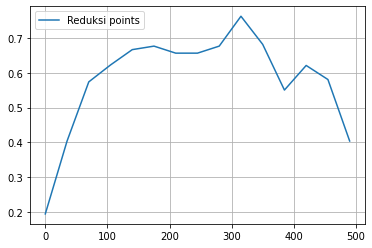

In [ ]:
BBKP_x15 = BBKP_x[0:522:35]
BBKP_y15 = BBKP_y[0:522:35]

plt.plot(BBKP_x15, BBKP_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBKP_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BBKP_15: [0.19456869 0.31431683 0.60201073 0.61380681 0.67552226 0.68410414
 0.64866723 0.66062086 0.64824325 0.8070122  0.69946553 0.48603478
 0.7172226  0.54669173 0.4040404  0.         0.         0.
 0.        ]
k_BBKP_15: 3



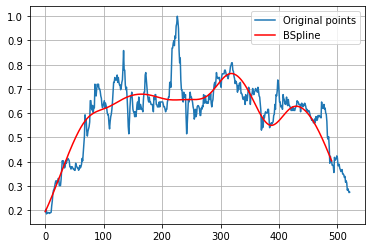

In [ ]:
import scipy.interpolate as interpolate

t_BBKP_15, c_BBKP_15, k_BBKP_15 = interpolate.splrep(BBKP_x15, BBKP_y15, s=0, k=3)
print('''\
t_BBKP_15: {}
c_BBKP_15: {}
k_BBKP_15: {}
'''.format(t_BBKP_15, c_BBKP_15, k_BBKP_15))
N = 522
xmin_BBKP_15, xmax_BBKP_15 = BBKP_x15.min(), BBKP_x15.max()
xx_BBKP_15 = np.linspace(xmin_BBKP_15, xmax_BBKP_15, N)
spline_BBKP_15 = interpolate.BSpline(t_BBKP_15, c_BBKP_15, k_BBKP_15, extrapolate=False)

plt.plot(BBKP_x, BBKP_y, label='Original points')
plt.plot(xx_BBKP_15, spline_BBKP_15(xx_BBKP_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BBKP**

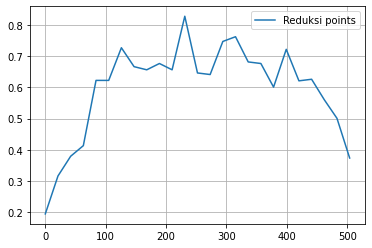

In [ ]:
BBKP_x25 = BBKP_x[0:522:21]
BBKP_y25 = BBKP_y[0:522:21]

plt.plot(BBKP_x25, BBKP_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBKP_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BBKP_25: [0.19456869 0.27794715 0.42181223 0.34255485 0.70852817 0.55904172
 0.7910142  0.64053785 0.64683441 0.71151846 0.56769781 0.95708424
 0.57366218 0.62705491 0.76660303 0.79138146 0.64362871 0.72501278
 0.51692624 0.81334288 0.56303556 0.6617876  0.5092572  0.51380574
 0.37373737 0.         0.         0.         0.        ]
k_BBKP_25: 3



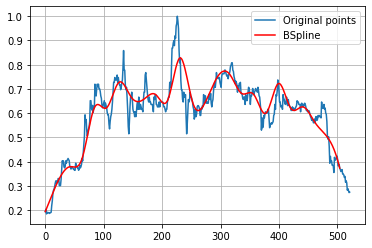

In [ ]:
import scipy.interpolate as interpolate

t_BBKP_25, c_BBKP_25, k_BBKP_25 = interpolate.splrep(BBKP_x25, BBKP_y25, s=0, k=3)
print('''\
t_BBKP_25: {}
c_BBKP_25: {}
k_BBKP_25: {}
'''.format(t_BBKP_25, c_BBKP_25, k_BBKP_25))
N = 522
xmin_BBKP_25, xmax_BBKP_25 = BBKP_x25.min(), BBKP_x25.max()
xx_BBKP_25 = np.linspace(xmin_BBKP_25, xmax_BBKP_25, N)
spline_BBKP_25 = interpolate.BSpline(t_BBKP_25, c_BBKP_25, k_BBKP_25, extrapolate=False)

plt.plot(BBKP_x, BBKP_y, label='Original points')
plt.plot(xx_BBKP_25, spline_BBKP_25(xx_BBKP_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BBKP**

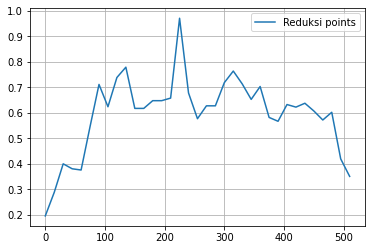

In [ ]:
BBKP_x35 = BBKP_x[0:522:15]
BBKP_y35 = BBKP_y[0:522:15]

plt.plot(BBKP_x35, BBKP_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBKP_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BBKP_35: [0.19456869 0.19985369 0.45152752 0.37743021 0.33372455 0.53493221
 0.79529218 0.54494162 0.76065059 0.83669844 0.55922234 0.62338192
 0.64421968 0.67852724 0.52045924 1.17902973 0.58160366 0.55516169
 0.65229502 0.59323396 0.73234487 0.78041685 0.72174532 0.60532916
 0.76602897 0.54267618 0.54811478 0.65880409 0.60454763 0.65027812
 0.6125217  0.5359987  0.71163498 0.24291988 0.34949495 0.
 0.         0.         0.        ]
k_BBKP_35: 3



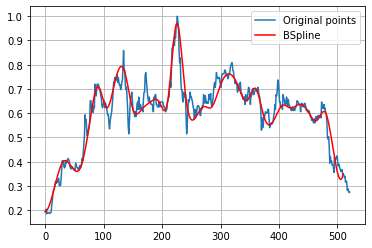

In [ ]:
import scipy.interpolate as interpolate

t_BBKP_35, c_BBKP_35, k_BBKP_35 = interpolate.splrep(BBKP_x35, BBKP_y35, s=0, k=3)
print('''\
t_BBKP_35: {}
c_BBKP_35: {}
k_BBKP_35: {}
'''.format(t_BBKP_35, c_BBKP_35, k_BBKP_35))
N = 522
xmin_BBKP_35, xmax_BBKP_35 = BBKP_x35.min(), BBKP_x35.max()
xx_BBKP_35 = np.linspace(xmin_BBKP_35, xmax_BBKP_35, N)
spline_BBKP_35 = interpolate.BSpline(t_BBKP_35, c_BBKP_35, k_BBKP_35, extrapolate=False)

plt.plot(BBKP_x, BBKP_y, label='Original points')
plt.plot(xx_BBKP_35, spline_BBKP_35(xx_BBKP_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BBKP**

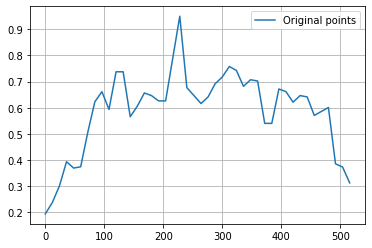

In [ ]:
BBKP_x45 = BBKP_x[0:522:12]
BBKP_y45 = BBKP_y[0:522:12]

plt.plot(BBKP_x45, BBKP_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBKP_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BBKP_45: [0.19456869 0.23325723 0.23879665 0.42899561 0.36167727 0.34237411
 0.5160869  0.62854494 0.70544259 0.51887858 0.77964321 0.78679099
 0.49743525 0.61740741 0.66929875 0.64479155 0.63032294 0.59149245
 0.76128303 1.09064816 0.57309402 0.67758181 0.59536662 0.63792141
 0.70143259 0.70786338 0.77014418 0.75701443 0.65634354 0.7085205
 0.75199869 0.49560594 0.50800179 0.71481115 0.66305663 0.6026593
 0.6535789  0.66181299 0.54765399 0.57181346 0.68024368 0.19094866
 0.47725295 0.31313131 0.         0.         0.         0.        ]
k_BBKP_45: 3



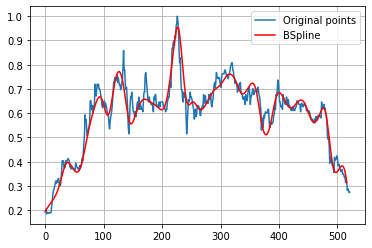

In [ ]:
import scipy.interpolate as interpolate

t_BBKP_45, c_BBKP_45, k_BBKP_45 = interpolate.splrep(BBKP_x45, BBKP_y45, s=0, k=3)
print('''\
t_BBKP_45: {}
c_BBKP_45: {}
k_BBKP_45: {}
'''.format(t_BBKP_45, c_BBKP_45, k_BBKP_45))
N = 522
xmin_BBKP_45, xmax_BBKP_45 = BBKP_x45.min(), BBKP_x45.max()
xx_BBKP_45 = np.linspace(xmin_BBKP_45, xmax_BBKP_45, N)
spline_BBKP_45 = interpolate.BSpline(t_BBKP_45, c_BBKP_45, k_BBKP_45, extrapolate=False)

plt.plot(BBKP_x, BBKP_y, label='Original points')
plt.plot(xx_BBKP_45, spline_BBKP_45(xx_BBKP_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA BBKP**

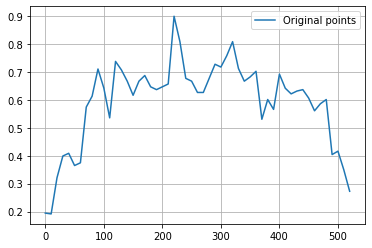

In [ ]:
BBKP_x55 = BBKP_x[0:522:10]
BBKP_y55 = BBKP_y[0:522:10]

plt.plot(BBKP_x55, BBKP_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBKP_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BBKP_55: [0.19456869 0.09803937 0.31271621 0.40923863 0.41938657 0.3647726
 0.3104139  0.64083242 0.57011704 0.75603872 0.66677061 0.42932726
 0.82804156 0.68274892 0.68338701 0.58370306 0.67877046 0.70121509
 0.63758131 0.62724756 0.67161027 0.56509924 1.00738671 0.7992933
 0.64392494 0.68561302 0.61362299 0.61747079 0.67406961 0.74685684
 0.7021394  0.74761585 0.85285176 0.68946197 0.66202765 0.66242743
 0.77917171 0.43300694 0.67061872 0.49057879 0.76100552 0.61691427
 0.61982225 0.63106946 0.64377869 0.6119976  0.54459455 0.57326057
 0.67751468 0.32274132 0.50010287 0.27671624 0.27272727 0.
 0.         0.         0.        ]
k_BBKP_55: 3



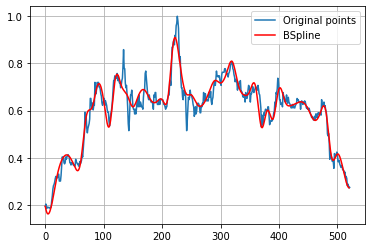

In [ ]:
import scipy.interpolate as interpolate

t_BBKP_55, c_BBKP_55, k_BBKP_55 = interpolate.splrep(BBKP_x55, BBKP_y55, s=0, k=3)
print('''\
t_BBKP_55: {}
c_BBKP_55: {}
k_BBKP_55: {}
'''.format(t_BBKP_55, c_BBKP_55, k_BBKP_55))
N = 522
xmin_BBKP_55, xmax_BBKP_55 = BBKP_x55.min(), BBKP_x55.max()
xx_BBKP_55 = np.linspace(xmin_BBKP_55, xmax_BBKP_55, N)
spline_BBKP_55 = interpolate.BSpline(t_BBKP_55, c_BBKP_55, k_BBKP_55, extrapolate=False)

plt.plot(BBKP_x, BBKP_y, label='Original points')
plt.plot(xx_BBKP_55, spline_BBKP_55(xx_BBKP_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA BBKP**

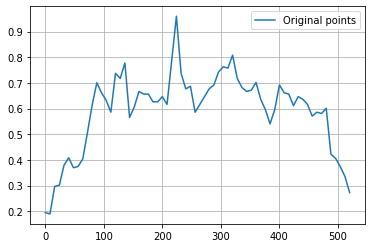

In [ ]:
BBKP_x65 = BBKP_x[0:522:8]
BBKP_y65 = BBKP_y[0:522:8]

plt.plot(BBKP_x65, BBKP_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBKP_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BBKP_65: [0.19456869 0.0783304  0.35651296 0.26985006 0.39523738 0.42564898
 0.35372419 0.37753305 0.38340425 0.51122562 0.60695992 0.73827399
 0.6426167  0.6604531  0.50964973 0.81609947 0.65019479 0.88615167
 0.4718652  0.62032692 0.68319074 0.64691011 0.66856274 0.61823286
 0.61608157 0.67501663 0.56263979 0.77139392 1.07905726 0.66995279
 0.665374   0.72915726 0.53920909 0.62915792 0.64112894 0.68511419
 0.67902036 0.75031953 0.77424698 0.72845013 0.85740706 0.69040648
 0.68399732 0.66451332 0.65794941 0.73399207 0.61820353 0.61137563
 0.51205154 0.58284245 0.73233625 0.6393277  0.68004992 0.57986656
 0.66715052 0.63031

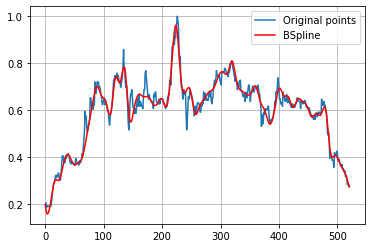

In [ ]:
import scipy.interpolate as interpolate

t_BBKP_65, c_BBKP_65, k_BBKP_65 = interpolate.splrep(BBKP_x65, BBKP_y65, s=0, k=3)
print('''\
t_BBKP_65: {}
c_BBKP_65: {}
k_BBKP_65: {}
'''.format(t_BBKP_65, c_BBKP_65, k_BBKP_65))
N = 522
xmin_BBKP_65, xmax_BBKP_65 = BBKP_x65.min(), BBKP_x65.max()
xx_BBKP_65 = np.linspace(xmin_BBKP_65, xmax_BBKP_65, N)
spline_BBKP_65 = interpolate.BSpline(t_BBKP_65, c_BBKP_65, k_BBKP_65, extrapolate=False)

plt.plot(BBKP_x, BBKP_y, label='Original points')
plt.plot(xx_BBKP_65, spline_BBKP_65(xx_BBKP_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BBKP**

In [ ]:

#RMSE 15 DATA BBKP
y_true_BBKP_15 = BBKP_y.tolist()
y_pred_BBKP_15 = spline_BBKP_15(xx_BBKP_15).tolist()
mse_BBKP_15 = mean_squared_error(y_true_BBKP_15, y_pred_BBKP_15)
rmse_BBKP_15 = np.sqrt(mse_BBKP_15)
print("rmse BBKP 15 =",rmse_BBKP_15)

#RMSE 25 DATA BBKP
y_true_BBKP_25 = BBKP_y.tolist()
y_pred_BBKP_25 = spline_BBKP_25(xx_BBKP_25).tolist()
mse_BBKP_25 = mean_squared_error(y_true_BBKP_25, y_pred_BBKP_25)
rmse_BBKP_25 = np.sqrt(mse_BBKP_25)
print("rmse BBKP 25 =",rmse_BBKP_25)

#RMSE 35 DATA BBKP
y_true_BBKP_35 = BBKP_y.tolist()
y_pred_BBKP_35 = spline_BBKP_35(xx_BBKP_35).tolist()
mse_BBKP_35 = mean_squared_error(y_true_BBKP_35, y_pred_BBKP_35)
rmse_BBKP_35 = np.sqrt(mse_BBKP_35)
print("rmse BBKP 35 =",rmse_BBKP_35)

#RMSE 45 DATA BBKP
y_true_BBKP_45 = BBKP_y.tolist()
y_pred_BBKP_45 = spline_BBKP_45(xx_BBKP_45).tolist()
mse_BBKP_45 = mean_squared_error(y_true_BBKP_45, y_pred_BBKP_45)
rmse_BBKP_45 = np.sqrt(mse_BBKP_45)
print("rmse BBKP 45 =",rmse_BBKP_45)

#RMSE 55 DATA BBKP
y_true_BBKP_55 = BBKP_y.tolist()
y_pred_BBKP_55 = spline_BBKP_55(xx_BBKP_55).tolist()
mse_BBKP_55 = mean_squared_error(y_true_BBKP_55, y_pred_BBKP_55)
rmse_BBKP_55 = np.sqrt(mse_BBKP_55)
print("rmse BBKP 55 =",rmse_BBKP_55)

#RMSE 65 DATA BBKP
y_true_BBKP_65 = BBKP_y.tolist()
y_pred_BBKP_65 = spline_BBKP_65(xx_BBKP_65).tolist()
mse_BBKP_65 = mean_squared_error(y_true_BBKP_65, y_pred_BBKP_65)
rmse_BBKP_65 = np.sqrt(mse_BBKP_65)
print("rmse BBKP 65 =",rmse_BBKP_65)


rmse BBKP 15 = 0.08173860218453143
rmse BBKP 25 = 0.07028976968285432
rmse BBKP 35 = 0.06640184908301963
rmse BBKP 45 = 0.0472881047061179
rmse BBKP 55 = 0.03501598233909575
rmse BBKP 65 = 0.03133505512004192


# **BBNI**

No handles with labels found to put in legend.


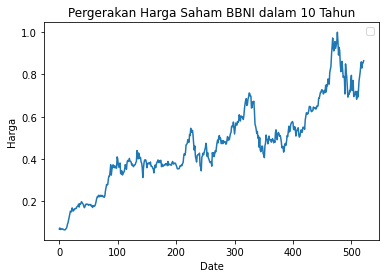

In [ ]:
BBNI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BBNI.JK.csv')

BBNI_x = BBNI['No'].values
BBNI_y = BBNI['Skala'].values

plt.plot(BBNI_x,BBNI_y)
plt.title('Pergerakan Harga Saham BBNI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BBNI**

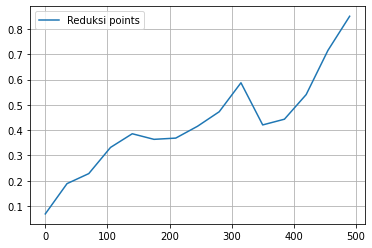

In [ ]:
BBNI_x15 = BBNI_x[0:522:35]
BBNI_y15 = BBNI_y[0:522:35]

plt.plot(BBNI_x15, BBNI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBNI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BBNI_15: [0.06894565 0.22352785 0.15901151 0.34527059 0.40351336 0.3551723
 0.35761561 0.42566746 0.43111505 0.686236   0.34728249 0.44846696
 0.54158987 0.81151465 0.85012285 0.         0.         0.
 0.        ]
k_BBNI_15: 3



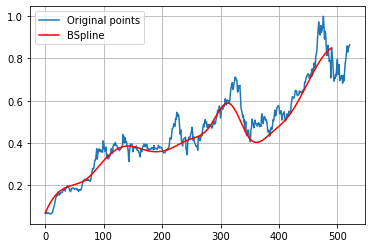

In [ ]:
import scipy.interpolate as interpolate

t_BBNI_15, c_BBNI_15, k_BBNI_15 = interpolate.splrep(BBNI_x15, BBNI_y15, s=0, k=3)
print('''\
t_BBNI_15: {}
c_BBNI_15: {}
k_BBNI_15: {}
'''.format(t_BBNI_15, c_BBNI_15, k_BBNI_15))
N = 522
xmin_BBNI_15, xmax_BBNI_15 = BBNI_x15.min(), BBNI_x15.max()
xx_BBNI_15 = np.linspace(xmin_BBNI_15, xmax_BBNI_15, N)
spline_BBNI_15 = interpolate.BSpline(t_BBNI_15, c_BBNI_15, k_BBNI_15, extrapolate=False)

plt.plot(BBNI_x, BBNI_y, label='Original points')
plt.plot(xx_BBNI_15, spline_BBNI_15(xx_BBNI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BBNI**

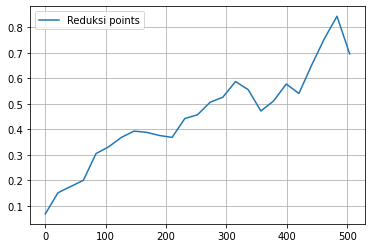

In [ ]:
BBNI_x25 = BBNI_x[0:522:21]
BBNI_y25 = BBNI_y[0:522:21]

plt.plot(BBNI_x25, BBNI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBNI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BBNI_25: [0.06894565 0.15052911 0.1838891  0.17161304 0.33461471 0.32071531
 0.37269605 0.39980271 0.38681546 0.38217379 0.34001765 0.46905781
 0.43731375 0.52370194 0.50473352 0.61215515 0.5699874  0.43959057
 0.50211714 0.61827993 0.48913658 0.66841698 0.7689669  0.93861238
 0.6953317  0.         0.         0.         0.        ]
k_BBNI_25: 3



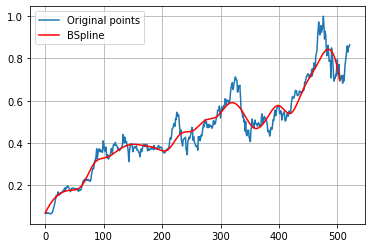

In [ ]:
import scipy.interpolate as interpolate

t_BBNI_25, c_BBNI_25, k_BBNI_25 = interpolate.splrep(BBNI_x25, BBNI_y25, s=0, k=3)
print('''\
t_BBNI_25: {}
c_BBNI_25: {}
k_BBNI_25: {}
'''.format(t_BBNI_25, c_BBNI_25, k_BBNI_25))
N = 522
xmin_BBNI_25, xmax_BBNI_25 = BBNI_x25.min(), BBNI_x25.max()
xx_BBNI_25 = np.linspace(xmin_BBNI_25, xmax_BBNI_25, N)
spline_BBNI_25 = interpolate.BSpline(t_BBNI_25, c_BBNI_25, k_BBNI_25, extrapolate=False)

plt.plot(BBNI_x, BBNI_y, label='Original points')
plt.plot(xx_BBNI_25, spline_BBNI_25(xx_BBNI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BBNI**

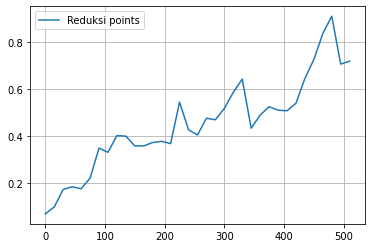

In [ ]:
BBNI_x35 = BBNI_x[0:522:15]
BBNI_y35 = BBNI_y[0:522:15]

plt.plot(BBNI_x35, BBNI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBNI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BBNI_35: [0.06894565 0.04103564 0.19184705 0.18646238 0.17050369 0.18806534
 0.4049008  0.28865188 0.43066369 0.40638377 0.34674963 0.35895187
 0.36977704 0.40272622 0.28958837 0.65022252 0.38224881 0.38589282
 0.50661235 0.44760864 0.5245747  0.56465766 0.74013618 0.33720549
 0.51743008 0.53263194 0.50683333 0.50637379 0.51926855 0.65979526
 0.71870027 0.82904002 1.04654226 0.48409988 0.71990172 0.
 0.         0.         0.        ]
k_BBNI_35: 3



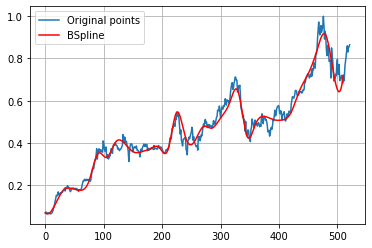

In [ ]:
import scipy.interpolate as interpolate

t_BBNI_35, c_BBNI_35, k_BBNI_35 = interpolate.splrep(BBNI_x35, BBNI_y35, s=0, k=3)
print('''\
t_BBNI_35: {}
c_BBNI_35: {}
k_BBNI_35: {}
'''.format(t_BBNI_35, c_BBNI_35, k_BBNI_35))
N = 522
xmin_BBNI_35, xmax_BBNI_35 = BBNI_x35.min(), BBNI_x35.max()
xx_BBNI_35 = np.linspace(xmin_BBNI_35, xmax_BBNI_35, N)
spline_BBNI_35 = interpolate.BSpline(t_BBNI_35, c_BBNI_35, k_BBNI_35, extrapolate=False)

plt.plot(BBNI_x, BBNI_y, label='Original points')
plt.plot(xx_BBNI_35, spline_BBNI_35(xx_BBNI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA BBNI**

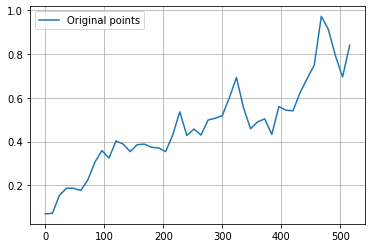

In [ ]:
BBNI_x45 = BBNI_x[0:522:12]
BBNI_y45 = BBNI_y[0:522:12]

plt.plot(BBNI_x45, BBNI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBNI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BBNI_45: [0.06894565 0.00697698 0.16167129 0.18941137 0.19178262 0.16149254
 0.21878972 0.30499576 0.39201446 0.27916854 0.43725733 0.38949257
 0.33401073 0.39731463 0.39122707 0.36701543 0.38149743 0.33303905
 0.40919647 0.61002764 0.36445217 0.49727424 0.38846563 0.52576743
 0.50109366 0.50671295 0.58261963 0.75986014 0.53518796 0.43108335
 0.49133859 0.54312005 0.35829425 0.61829753 0.52969498 0.52090779
 0.62991709 0.7038956  0.68226465 1.06336029 0.90213204 0.762488
 0.60155698 0.84029484 0.         0.         0.         0.        ]
k_BBNI_45: 3



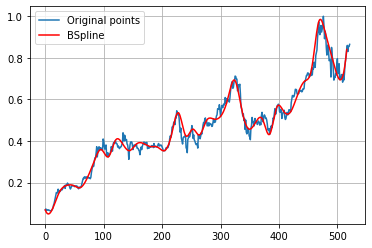

In [ ]:
import scipy.interpolate as interpolate

t_BBNI_45, c_BBNI_45, k_BBNI_45 = interpolate.splrep(BBNI_x45, BBNI_y45, s=0, k=3)
print('''\
t_BBNI_45: {}
c_BBNI_45: {}
k_BBNI_45: {}
'''.format(t_BBNI_45, c_BBNI_45, k_BBNI_45))
N = 522
xmin_BBNI_45, xmax_BBNI_45 = BBNI_x45.min(), BBNI_x45.max()
xx_BBNI_45 = np.linspace(xmin_BBNI_45, xmax_BBNI_45, N)
spline_BBNI_45 = interpolate.BSpline(t_BBNI_45, c_BBNI_45, k_BBNI_45, extrapolate=False)

plt.plot(BBNI_x, BBNI_y, label='Original points')
plt.plot(xx_BBNI_45, spline_BBNI_45(xx_BBNI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA BBNI**


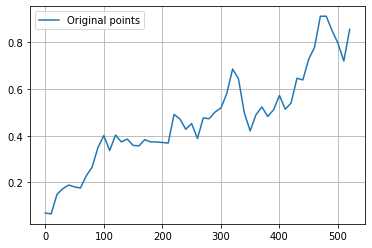

In [ ]:
BBNI_x55 = BBNI_x[0:522:10]
BBNI_y55 = BBNI_y[0:522:10]

plt.plot(BBNI_x55, BBNI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBNI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BBNI_55: [ 0.06894565 -0.00836688  0.1686004   0.16900206  0.19506294  0.18275599
  0.15840646  0.24016066  0.25054898  0.35084835  0.442378    0.28258806
  0.4469258   0.34739916  0.40426379  0.35004201  0.34790232  0.39594084
  0.36808863  0.37249086  0.38273415  0.32261677  0.53810099  0.4733822
  0.39883702  0.49638028  0.32817257  0.52016776  0.45110725  0.51176686
  0.50919631  0.562013    0.72186719  0.66354037  0.48637918  0.38357191
  0.50316613  0.54332133  0.46359771  0.49761955  0.61226316  0.48821725
  0.51594893  0.69123027  0.59627985  0.75657416  0.74105987  0.95240504
  0.91860743  0.84245271  0.80227423  0.62588991  0.85503686  0.
  0.          0.          0.        ]
k

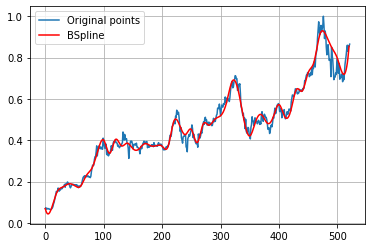

In [ ]:
import scipy.interpolate as interpolate

t_BBNI_55, c_BBNI_55, k_BBNI_55 = interpolate.splrep(BBNI_x55, BBNI_y55, s=0, k=3)
print('''\
t_BBNI_55: {}
c_BBNI_55: {}
k_BBNI_55: {}
'''.format(t_BBNI_55, c_BBNI_55, k_BBNI_55))
N = 522
xmin_BBNI_55, xmax_BBNI_55 = BBNI_x55.min(), BBNI_x55.max()
xx_BBNI_55 = np.linspace(xmin_BBNI_55, xmax_BBNI_55, N)
spline_BBNI_55 = interpolate.BSpline(t_BBNI_55, c_BBNI_55, k_BBNI_55, extrapolate=False)

plt.plot(BBNI_x, BBNI_y, label='Original points')
plt.plot(xx_BBNI_55, spline_BBNI_55(xx_BBNI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BBNI**

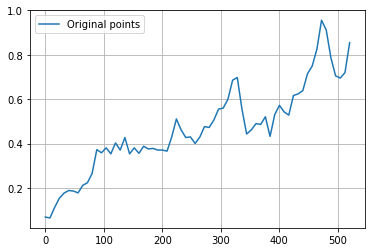

In [ ]:
BBNI_x65 = BBNI_x[0:522:8]
BBNI_y65 = BBNI_y[0:522:8]

plt.plot(BBNI_x65, BBNI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBNI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BBNI_65: [0.06894565 0.03406816 0.10189838 0.15701871 0.17862505 0.19061374
 0.19092979 0.16370151 0.22198705 0.22011438 0.23920257 0.41628028
 0.33175101 0.40893781 0.31751003 0.4438722  0.32469157 0.48340573
 0.30679609 0.41226003 0.32917607 0.40862784 0.3655509  0.38469681
 0.36593212 0.37761894 0.34963633 0.42039592 0.54863256 0.4514129
 0.4172146  0.44483927 0.38328092 0.42498546 0.49368143 0.46023967
 0.50172351 0.56972133 0.55108651 0.58711199 0.69751712 0.73584165
 0.54584846 0.41245983 0.46377169 0.50395218 0.45997734 0.57505739
 0.36510025 0.55913623 0.58263004 0.54523306 0.494423   0.64660811
 0.61939025 0.620302

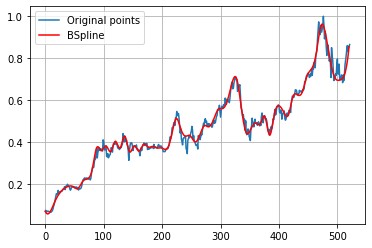

In [ ]:
import scipy.interpolate as interpolate

t_BBNI_65, c_BBNI_65, k_BBNI_65 = interpolate.splrep(BBNI_x65, BBNI_y65, s=0, k=3)
print('''\
t_BBNI_65: {}
c_BBNI_65: {}
k_BBNI_65: {}
'''.format(t_BBNI_65, c_BBNI_65, k_BBNI_65))
N = 522
xmin_BBNI_65, xmax_BBNI_65 = BBNI_x65.min(), BBNI_x65.max()
xx_BBNI_65 = np.linspace(xmin_BBNI_65, xmax_BBNI_65, N)
spline_BBNI_65 = interpolate.BSpline(t_BBNI_65, c_BBNI_65, k_BBNI_65, extrapolate=False)

plt.plot(BBNI_x, BBNI_y, label='Original points')
plt.plot(xx_BBNI_65, spline_BBNI_65(xx_BBNI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BBNI**

In [ ]:

#RMSE 15 DATA BBNI
y_true_BBNI_15 = BBNI_y.tolist()
y_pred_BBNI_15 = spline_BBNI_15(xx_BBNI_15).tolist()
mse_BBNI_15 = mean_squared_error(y_true_BBNI_15, y_pred_BBNI_15)
rmse_BBNI_15 = np.sqrt(mse_BBNI_15)
print("rmse BBNI 15 =",rmse_BBNI_15)

#RMSE 25 DATA BBNI
y_true_BBNI_25 = BBNI_y.tolist()
y_pred_BBNI_25 = spline_BBNI_25(xx_BBNI_25).tolist()
mse_BBNI_25 = mean_squared_error(y_true_BBNI_25, y_pred_BBNI_25)
rmse_BBNI_25 = np.sqrt(mse_BBNI_25)
print("rmse BBNI 25 =",rmse_BBNI_25)

#RMSE 35 DATA BBNI
y_true_BBNI_35 = BBNI_y.tolist()
y_pred_BBNI_35 = spline_BBNI_35(xx_BBNI_35).tolist()
mse_BBNI_35 = mean_squared_error(y_true_BBNI_35, y_pred_BBNI_35)
rmse_BBNI_35 = np.sqrt(mse_BBNI_35)
print("rmse BBNI 35 =",rmse_BBNI_35)

#RMSE 45 DATA BBNI
y_true_BBNI_45 = BBNI_y.tolist()
y_pred_BBNI_45 = spline_BBNI_45(xx_BBNI_45).tolist()
mse_BBNI_45 = mean_squared_error(y_true_BBNI_45, y_pred_BBNI_45)
rmse_BBNI_45 = np.sqrt(mse_BBNI_45)
print("rmse BBNI 45 =",rmse_BBNI_45)

#RMSE 55 DATA BBNI
y_true_BBNI_55 = BBNI_y.tolist()
y_pred_BBNI_55 = spline_BBNI_55(xx_BBNI_55).tolist()
mse_BBNI_55 = mean_squared_error(y_true_BBNI_55, y_pred_BBNI_55)
rmse_BBNI_55 = np.sqrt(mse_BBNI_55)
print("rmse BBNI 55 =",rmse_BBNI_55)

#RMSE 65 DATA BBNI
y_true_BBNI_65 = BBNI_y.tolist()
y_pred_BBNI_65 = spline_BBNI_65(xx_BBNI_65).tolist()
mse_BBNI_65 = mean_squared_error(y_true_BBNI_65, y_pred_BBNI_65)
rmse_BBNI_65 = np.sqrt(mse_BBNI_65)
print("rmse BBNI 65 =",rmse_BBNI_65)



rmse BBNI 15 = 0.08776336499538433
rmse BBNI 25 = 0.06594738025248469
rmse BBNI 35 = 0.05648202022427303
rmse BBNI 45 = 0.035976221047473125
rmse BBNI 55 = 0.029782026383626307
rmse BBNI 65 = 0.02253196245133882


# **BBRI**

No handles with labels found to put in legend.


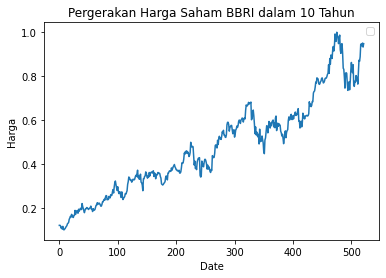

In [ ]:
BBRI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BBRI.JK.csv')

BBRI_x = BBRI['No'].values
BBRI_y = BBRI['Skala'].values

plt.plot(BBRI_x,BBRI_y)
plt.title('Pergerakan Harga Saham BBRI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BBRI**

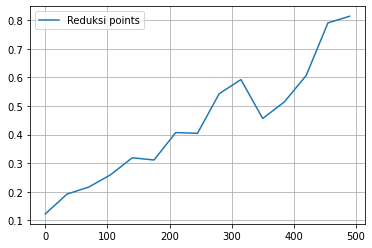

In [ ]:
BBRI_x15 = BBRI_x[0:522:35]
BBRI_y15 = BBRI_y[0:522:35]

plt.plot(BBRI_x15, BBRI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBRI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BBRI_15: [0.12240933 0.19827045 0.20093319 0.24798493 0.34976829 0.26485902
 0.45608062 0.35123302 0.56385776 0.64981263 0.3887052  0.53111788
 0.58604807 0.93236456 0.8134715  0.         0.         0.
 0.        ]
k_BBRI_15: 3



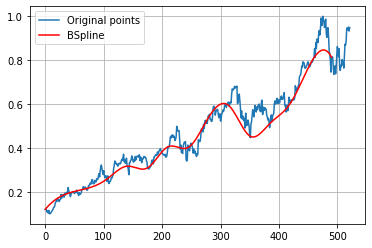

In [ ]:
import scipy.interpolate as interpolate

t_BBRI_15, c_BBRI_15, k_BBRI_15 = interpolate.splrep(BBRI_x15, BBRI_y15, s=0, k=3)
print('''\
t_BBRI_15: {}
c_BBRI_15: {}
k_BBRI_15: {}
'''.format(t_BBRI_15, c_BBRI_15, k_BBRI_15))
N = 522
xmin_BBRI_15, xmax_BBRI_15 = BBRI_x15.min(), BBRI_x15.max()
xx_BBRI_15 = np.linspace(xmin_BBRI_15, xmax_BBRI_15, N)
spline_BBRI_15 = interpolate.BSpline(t_BBRI_15, c_BBRI_15, k_BBRI_15, extrapolate=False)

plt.plot(BBRI_x, BBRI_y, label='Original points')
plt.plot(xx_BBRI_15, spline_BBRI_15(xx_BBRI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA BBRI**

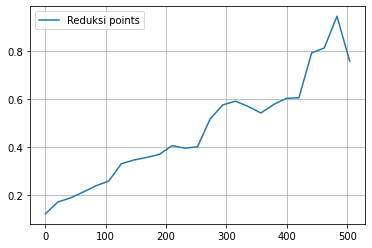

In [ ]:
BBRI_x25 = BBRI_x[0:522:21]
BBRI_y25 = BBRI_y[0:522:21]

plt.plot(BBRI_x25, BBRI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBRI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BBRI_25: [0.12240933 0.17799196 0.17737101 0.21240852 0.24661896 0.23893946
 0.35202734 0.34258848 0.36052031 0.36040801 0.42064557 0.39742422
 0.36789589 0.54031864 0.57963784 0.59967924 0.57345869 0.52617511
 0.57831755 0.62687592 0.53594044 0.86666804 0.71626276 1.13992562
 0.75906736 0.         0.         0.         0.        ]
k_BBRI_25: 3



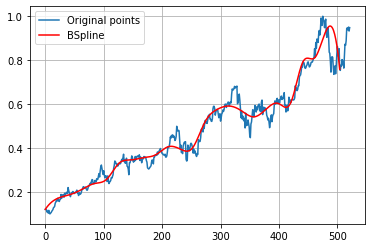

In [ ]:
import scipy.interpolate as interpolate

t_BBRI_25, c_BBRI_25, k_BBRI_25 = interpolate.splrep(BBRI_x25, BBRI_y25, s=0, k=3)
print('''\
t_BBRI_25: {}
c_BBRI_25: {}
k_BBRI_25: {}
'''.format(t_BBRI_25, c_BBRI_25, k_BBRI_25))
N = 522
xmin_BBRI_25, xmax_BBRI_25 = BBRI_x25.min(), BBRI_x25.max()
xx_BBRI_25 = np.linspace(xmin_BBRI_25, xmax_BBRI_25, N)
spline_BBRI_25 = interpolate.BSpline(t_BBRI_25, c_BBRI_25, k_BBRI_25, extrapolate=False)

plt.plot(BBRI_x, BBRI_y, label='Original points')
plt.plot(xx_BBRI_25, spline_BBRI_25(xx_BBRI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BBRI**

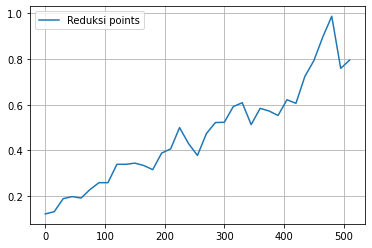

In [ ]:
BBRI_x35 = BBRI_x[0:522:15]
BBRI_y35 = BBRI_y[0:522:15]

plt.plot(BBRI_x35, BBRI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBRI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BBRI_35: [0.12240933 0.08524715 0.20223885 0.20187704 0.1794626  0.23053162
 0.27405859 0.22763817 0.36979288 0.32945974 0.34863761 0.34334735
 0.28315433 0.42040839 0.36681834 0.55273276 0.42225061 0.33857569
 0.49287667 0.5344772  0.50133889 0.60006362 0.65022012 0.45190564
 0.61987752 0.57376561 0.52029319 0.66371449 0.55541882 0.75191594
 0.78147699 0.87865277 1.14998278 0.49754747 0.79533679 0.
 0.         0.         0.        ]
k_BBRI_35: 3



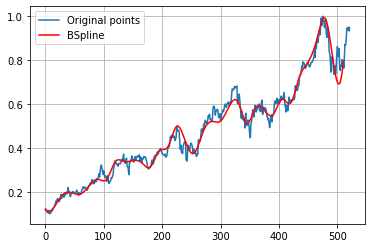

In [ ]:
import scipy.interpolate as interpolate

t_BBRI_35, c_BBRI_35, k_BBRI_35 = interpolate.splrep(BBRI_x35, BBRI_y35, s=0, k=3)
print('''\
t_BBRI_35: {}
c_BBRI_35: {}
k_BBRI_35: {}
'''.format(t_BBRI_35, c_BBRI_35, k_BBRI_35))
N = 522
xmin_BBRI_35, xmax_BBRI_35 = BBRI_x35.min(), BBRI_x35.max()
xx_BBRI_35 = np.linspace(xmin_BBRI_35, xmax_BBRI_35, N)
spline_BBRI_35 = interpolate.BSpline(t_BBRI_35, c_BBRI_35, k_BBRI_35, extrapolate=False)

plt.plot(BBRI_x, BBRI_y, label='Original points')
plt.plot(xx_BBRI_35, spline_BBRI_35(xx_BBRI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA BBRI**

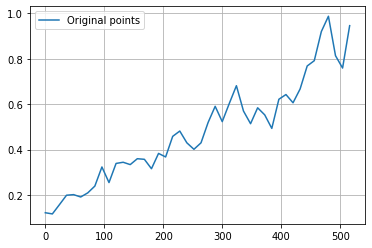

In [ ]:
BBRI_x45 = BBRI_x[0:522:12]
BBRI_y45 = BBRI_y[0:522:12]

plt.plot(BBRI_x45, BBRI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBRI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BBRI_45: [0.12240933 0.09406168 0.14056834 0.2084588  0.20551505 0.18191625
 0.21707901 0.20883506 0.3854046  0.19255172 0.37547661 0.34181128
 0.32463579 0.36482689 0.37667841 0.2735372  0.42554586 0.32479749
 0.48251807 0.49642555 0.42297143 0.3919996  0.41835658 0.51488496
 0.63868388 0.47442098 0.60352859 0.73322632 0.55164903 0.47986669
 0.61437645 0.56780886 0.43304097 0.66116717 0.65286031 0.58231389
 0.65518983 0.79951746 0.75554864 0.92699266 1.05461543 0.68422875
 0.7362535  0.94559585 0.         0.         0.         0.        ]
k_BBRI_45: 3



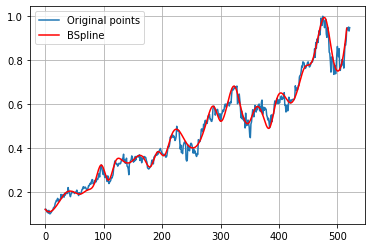

In [ ]:
import scipy.interpolate as interpolate

t_BBRI_45, c_BBRI_45, k_BBRI_45 = interpolate.splrep(BBRI_x45, BBRI_y45, s=0, k=3)
print('''\
t_BBRI_45: {}
c_BBRI_45: {}
k_BBRI_45: {}
'''.format(t_BBRI_45, c_BBRI_45, k_BBRI_45))
N = 522
xmin_BBRI_45, xmax_BBRI_45 = BBRI_x45.min(), BBRI_x45.max()
xx_BBRI_45 = np.linspace(xmin_BBRI_45, xmax_BBRI_45, N)
spline_BBRI_45 = interpolate.BSpline(t_BBRI_45, c_BBRI_45, k_BBRI_45, extrapolate=False)

plt.plot(BBRI_x, BBRI_y, label='Original points')
plt.plot(xx_BBRI_45, spline_BBRI_45(xx_BBRI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BBRI**

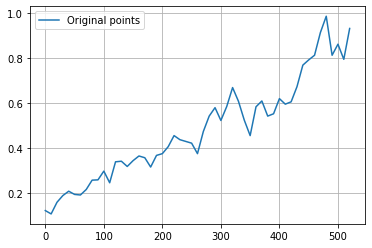

In [ ]:
BBRI_x55 = BBRI_x[0:522:10]
BBRI_y55 = BBRI_y[0:522:10]

plt.plot(BBRI_x55, BBRI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BBRI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BBRI_55: [0.12240933 0.06365982 0.1618643  0.1869855  0.21862842 0.18979616
 0.18799005 0.20850271 0.27592657 0.23442315 0.34078497 0.19000172
 0.3758921  0.34269932 0.30512409 0.34872142 0.36734772 0.37359753
 0.28333989 0.38941597 0.36625011 0.39946959 0.47628602 0.43113762
 0.42610651 0.44474724 0.32858331 0.49480554 0.53675411 0.6146547
 0.48649239 0.57927213 0.70937246 0.60137276 0.53798625 0.39435065
 0.62036246 0.62938087 0.52273582 0.53615251 0.65130696 0.58141755
 0.59815235 0.66327873 0.7901835  0.79256757 0.79602289 0.9041699
 1.07434414 0.72073333 0.99115763 0.64626056 0.93264249 0.
 0.         0.         0.        ]
k_BBRI_55: 3



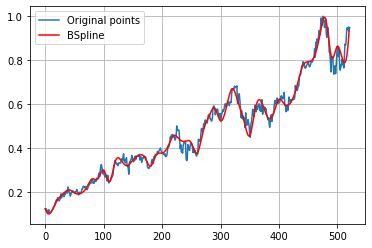

In [ ]:
import scipy.interpolate as interpolate

t_BBRI_55, c_BBRI_55, k_BBRI_55 = interpolate.splrep(BBRI_x55, BBRI_y55, s=0, k=3)
print('''\
t_BBRI_55: {}
c_BBRI_55: {}
k_BBRI_55: {}
'''.format(t_BBRI_55, c_BBRI_55, k_BBRI_55))
N = 522
xmin_BBRI_55, xmax_BBRI_55 = BBRI_x55.min(), BBRI_x55.max()
xx_BBRI_55 = np.linspace(xmin_BBRI_55, xmax_BBRI_55, N)
spline_BBRI_55 = interpolate.BSpline(t_BBRI_55, c_BBRI_55, k_BBRI_55, extrapolate=False)

plt.plot(BBRI_x, BBRI_y, label='Original points')
plt.plot(xx_BBRI_55, spline_BBRI_55(xx_BBRI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA BBRI**

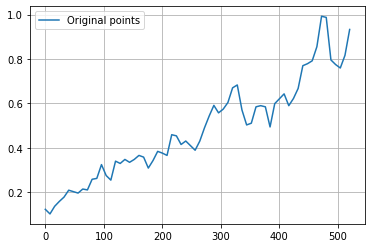

In [ ]:
BBRI_x65 = BBRI_x[0:522:8]
BBRI_y65 = BBRI_y[0:522:8]

plt.plot(BBRI_x65, BBRI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BBRI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BBRI_65: [0.12240933 0.07112133 0.13528326 0.15885189 0.17160357 0.21950067
 0.2016891  0.18617818 0.2271733  0.18751204 0.28184589 0.23173653
 0.36115618 0.26664394 0.21993645 0.37692632 0.30862771 0.3626561
 0.32364943 0.34792751 0.36754208 0.37361403 0.28307952 0.34380881
 0.39349872 0.38271446 0.32952945 0.49087759 0.45825551 0.39630761
 0.44356069 0.40976052 0.37335578 0.42842256 0.49326486 0.53634184
 0.61784446 0.53632178 0.57883733 0.59133409 0.67758797 0.71644873
 0.55247203 0.49335226 0.48966296 0.61017207 0.57483011 0.62677692
 0.42324354 0.64138881 0.60187478 0.67390998 0.55740759 0.63272909
 0.64224599 0.800877

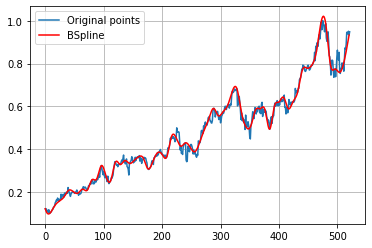

In [ ]:
import scipy.interpolate as interpolate

t_BBRI_65, c_BBRI_65, k_BBRI_65 = interpolate.splrep(BBRI_x65, BBRI_y65, s=0, k=3)
print('''\
t_BBRI_65: {}
c_BBRI_65: {}
k_BBRI_65: {}
'''.format(t_BBRI_65, c_BBRI_65, k_BBRI_65))
N = 522
xmin_BBRI_65, xmax_BBRI_65 = BBRI_x65.min(), BBRI_x65.max()
xx_BBRI_65 = np.linspace(xmin_BBRI_65, xmax_BBRI_65, N)
spline_BBRI_65 = interpolate.BSpline(t_BBRI_65, c_BBRI_65, k_BBRI_65, extrapolate=False)

plt.plot(BBRI_x, BBRI_y, label='Original points')
plt.plot(xx_BBRI_65, spline_BBRI_65(xx_BBRI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BBRI**

In [ ]:

#RMSE 15 DATA BBRI
y_true_BBRI_15 = BBRI_y.tolist()
y_pred_BBRI_15 = spline_BBRI_15(xx_BBRI_15).tolist()
mse_BBRI_15 = mean_squared_error(y_true_BBRI_15, y_pred_BBRI_15)
rmse_BBRI_15 = np.sqrt(mse_BBRI_15)
print("rmse BBRI 15 =",rmse_BBRI_15)

#RMSE 25 DATA BBRI
y_true_BBRI_25 = BBRI_y.tolist()
y_pred_BBRI_25 = spline_BBRI_25(xx_BBRI_25).tolist()
mse_BBRI_25 = mean_squared_error(y_true_BBRI_25, y_pred_BBRI_25)
rmse_BBRI_25 = np.sqrt(mse_BBRI_25)
print("rmse BBRI 25 =",rmse_BBRI_25)

#RMSE 35 DATA BBRI
y_true_BBRI_35 = BBRI_y.tolist()
y_pred_BBRI_35 = spline_BBRI_35(xx_BBRI_35).tolist()
mse_BBRI_35 = mean_squared_error(y_true_BBRI_35, y_pred_BBRI_35)
rmse_BBRI_35 = np.sqrt(mse_BBRI_35)
print("rmse BBRI 35 =",rmse_BBRI_35)

#RMSE 45 DATA BBRI
y_true_BBRI_45 = BBRI_y.tolist()
y_pred_BBRI_45 = spline_BBRI_45(xx_BBRI_45).tolist()
mse_BBRI_45 = mean_squared_error(y_true_BBRI_45, y_pred_BBRI_45)
rmse_BBRI_45 = np.sqrt(mse_BBRI_45)
print("rmse BBRI 45 =",rmse_BBRI_45)

#RMSE 55 DATA BBRI
y_true_BBRI_55 = BBRI_y.tolist()
y_pred_BBRI_55 = spline_BBRI_55(xx_BBRI_55).tolist()
mse_BBRI_55 = mean_squared_error(y_true_BBRI_55, y_pred_BBRI_55)
rmse_BBRI_55 = np.sqrt(mse_BBRI_55)
print("rmse BBRI 55 =",rmse_BBRI_55)

#RMSE 65 DATA BBRI
y_true_BBRI_65 = BBRI_y.tolist()
y_pred_BBRI_65 = spline_BBRI_65(xx_BBRI_65).tolist()
mse_BBRI_65 = mean_squared_error(y_true_BBRI_65, y_pred_BBRI_65)
rmse_BBRI_65 = np.sqrt(mse_BBRI_65)
print("rmse BBRI 65 =",rmse_BBRI_65)


rmse BBRI 15 = 0.07860347225037623
rmse BBRI 25 = 0.05615633103654382
rmse BBRI 35 = 0.055013902300115734
rmse BBRI 45 = 0.035525597106144176
rmse BBRI 55 = 0.027856494984430064
rmse BBRI 65 = 0.022652061015203808


# **BDMN**

No handles with labels found to put in legend.


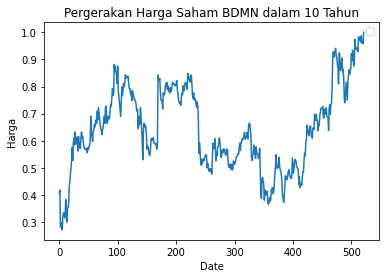

In [ ]:
BDMN = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BDMN.JK.csv')

BDMN_x = BDMN['No'].values
BDMN_y = BDMN['Skala'].values

plt.plot(BDMN_x,BDMN_y)
plt.title('Pergerakan Harga Saham BDMN dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BDMN**

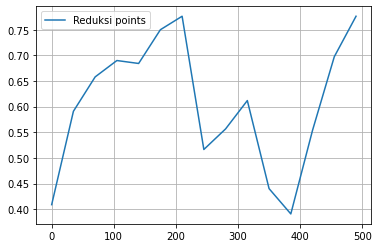

In [ ]:
BDMN_x15 = BDMN_x[0:522:35]
BDMN_y15 = BDMN_y[0:522:35]

plt.plot(BDMN_x15, BDMN_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BDMN_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BDMN_15: [0.40885264 0.59345491 0.64334427 0.70393327 0.66540417 0.7397132
 0.87574303 0.41520941 0.56210353 0.67585017 0.40554844 0.34274556
 0.64335968 0.74049121 0.77631579 0.         0.         0.
 0.        ]
k_BDMN_15: 3



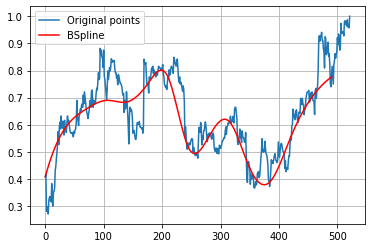

In [ ]:
import scipy.interpolate as interpolate

t_BDMN_15, c_BDMN_15, k_BDMN_15 = interpolate.splrep(BDMN_x15, BDMN_y15, s=0, k=3)
print('''\
t_BDMN_15: {}
c_BDMN_15: {}
k_BDMN_15: {}
'''.format(t_BDMN_15, c_BDMN_15, k_BDMN_15))
N = 522
xmin_BDMN_15, xmax_BDMN_15 = BDMN_x15.min(), BDMN_x15.max()
xx_BDMN_15 = np.linspace(xmin_BDMN_15, xmax_BDMN_15, N)
spline_BDMN_15 = interpolate.BSpline(t_BDMN_15, c_BDMN_15, k_BDMN_15, extrapolate=False)

plt.plot(BDMN_x, BDMN_y, label='Original points')
plt.plot(xx_BDMN_15, spline_BDMN_15(xx_BDMN_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BDMN**

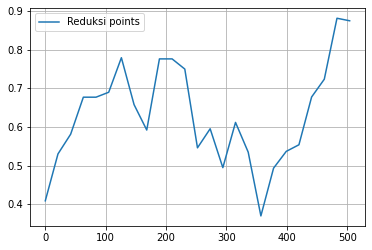

In [ ]:
BDMN_x25 = BDMN_x[0:522:21]
BDMN_y25 = BDMN_y[0:522:21]

plt.plot(BDMN_x25, BDMN_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BDMN_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BDMN_25: [0.40885264 0.55756924 0.51068782 0.70700781 0.67517212 0.65527489
 0.84335712 0.64754665 0.51382471 0.84978608 0.7449257  0.82840587
 0.44145082 0.68210663 0.40249109 0.67635005 0.56316133 0.28021515
 0.53439911 0.54271473 0.51579461 0.71779103 0.66584399 1.03056484
 0.875      0.         0.         0.         0.        ]
k_BDMN_25: 3



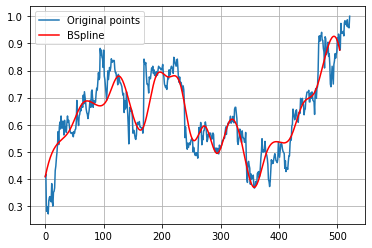

In [ ]:
import scipy.interpolate as interpolate

t_BDMN_25, c_BDMN_25, k_BDMN_25 = interpolate.splrep(BDMN_x25, BDMN_y25, s=0, k=3)
print('''\
t_BDMN_25: {}
c_BDMN_25: {}
k_BDMN_25: {}
'''.format(t_BDMN_25, c_BDMN_25, k_BDMN_25))
N = 522
xmin_BDMN_25, xmax_BDMN_25 = BDMN_x25.min(), BDMN_x25.max()
xx_BDMN_25 = np.linspace(xmin_BDMN_25, xmax_BDMN_25, N)
spline_BDMN_25 = interpolate.BSpline(t_BDMN_25, c_BDMN_25, k_BDMN_25, extrapolate=False)

plt.plot(BDMN_x, BDMN_y, label='Original points')
plt.plot(xx_BDMN_25, spline_BDMN_25(xx_BDMN_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BDMN**

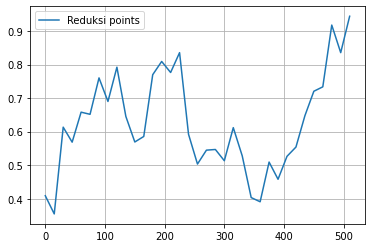

In [ ]:
BDMN_x35 = BDMN_x[0:522:15]
BDMN_y35 = BDMN_y[0:522:15]

plt.plot(BDMN_x35, BDMN_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BDMN_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BDMN_35: [0.40885264 0.05515647 0.79682658 0.49340702 0.71676343 0.58752332
 0.84279856 0.60254569 0.88664746 0.60377246 0.56958106 0.53237698
 0.81406893 0.82976835 0.72212084 0.93964303 0.53246494 0.48312878
 0.55475678 0.56626515 0.46044576 0.67089918 0.52701016 0.38684966
 0.34532803 0.57657507 0.40363484 0.556254   0.52924389 0.65045463
 0.75314812 0.65932132 1.12806941 0.6415574  0.94407895 0.
 0.         0.         0.        ]
k_BDMN_35: 3



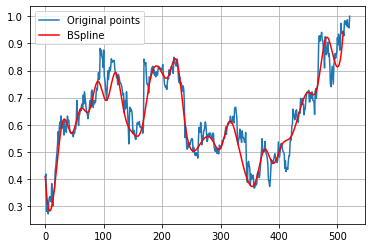

In [ ]:
import scipy.interpolate as interpolate

t_BDMN_35, c_BDMN_35, k_BDMN_35 = interpolate.splrep(BDMN_x35, BDMN_y35, s=0, k=3)
print('''\
t_BDMN_35: {}
c_BDMN_35: {}
k_BDMN_35: {}
'''.format(t_BDMN_35, c_BDMN_35, k_BDMN_35))
N = 522
xmin_BDMN_35, xmax_BDMN_35 = BDMN_x35.min(), BDMN_x35.max()
xx_BDMN_35 = np.linspace(xmin_BDMN_35, xmax_BDMN_35, N)
spline_BDMN_35 = interpolate.BSpline(t_BDMN_35, c_BDMN_35, k_BDMN_35, extrapolate=False)

plt.plot(BDMN_x, BDMN_y, label='Original points')
plt.plot(xx_BDMN_35, spline_BDMN_35(xx_BDMN_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BDMN**

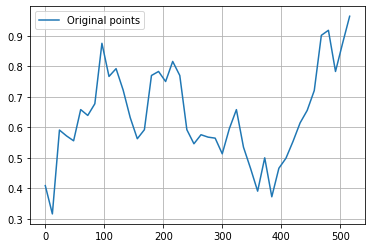

In [ ]:
BDMN_x45 = BDMN_x[0:522:12]
BDMN_y45 = BDMN_y[0:522:12]

plt.plot(BDMN_x45, BDMN_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BDMN_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BDMN_45: [0.40885264 0.01970941 0.72558448 0.55688203 0.51958676 0.69947616
 0.63049263 0.61154287 0.98630709 0.6944288  0.83556974 0.71620021
 0.63091102 0.54962939 0.54557143 0.82071646 0.78998379 0.7167168
 0.843149   0.80542405 0.55357585 0.53290413 0.59112343 0.55654951
 0.58925748 0.47326269 0.59663914 0.71254918 0.50053257 0.49453106
 0.31213267 0.60167511 0.28116689 0.50786785 0.48209856 0.55584318
 0.61821294 0.65814717 0.68077734 0.94111188 0.96266987 0.63216014
 0.9972423  0.96381579 0.         0.         0.         0.        ]
k_BDMN_45: 3



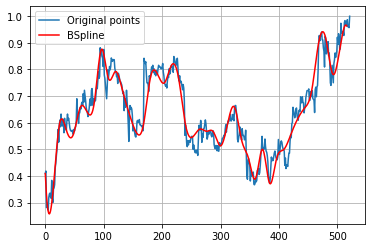

In [ ]:
import scipy.interpolate as interpolate

t_BDMN_45, c_BDMN_45, k_BDMN_45 = interpolate.splrep(BDMN_x45, BDMN_y45, s=0, k=3)
print('''\
t_BDMN_45: {}
c_BDMN_45: {}
k_BDMN_45: {}
'''.format(t_BDMN_45, c_BDMN_45, k_BDMN_45))
N = 522
xmin_BDMN_45, xmax_BDMN_45 = BDMN_x45.min(), BDMN_x45.max()
xx_BDMN_45 = np.linspace(xmin_BDMN_45, xmax_BDMN_45, N)
spline_BDMN_45 = interpolate.BSpline(t_BDMN_45, c_BDMN_45, k_BDMN_45, extrapolate=False)

plt.plot(BDMN_x, BDMN_y, label='Original points')
plt.plot(xx_BDMN_45, spline_BDMN_45(xx_BDMN_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BDMN**

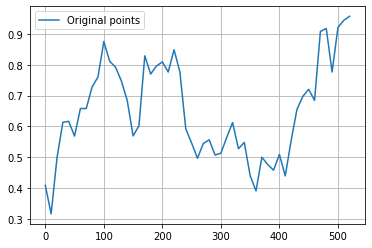

In [ ]:
BDMN_x55 = BDMN_x[0:522:10]
BDMN_y55 = BDMN_y[0:522:10]

plt.plot(BDMN_x55, BDMN_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BDMN_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BDMN_55: [0.40885263 0.16240632 0.4865058  0.62988999 0.63776184 0.51789684
 0.70201401 0.62203115 0.75784544 0.71619751 0.93862776 0.78049149
 0.80730874 0.74318152 0.70456274 0.54383067 0.53458828 0.92965834
 0.72046259 0.80691236 0.82820376 0.73553574 0.887548   0.80637751
 0.54483668 0.56690734 0.46384973 0.55795688 0.57274379 0.49054163
 0.50851072 0.55436285 0.66087999 0.47711719 0.59644071 0.42527788
 0.34323725 0.54650996 0.47072291 0.42849315 0.56267291 0.37607837
 0.56985573 0.66818292 0.68899154 0.76006146 0.59313105 0.97267749
 0.96352741 0.67979181 1.07366949 0.88175078 0.95723684 0.
 0.         0.         0.        ]
k_BDMN_55: 3



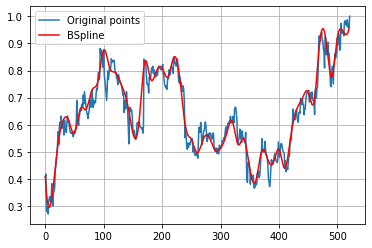

In [ ]:
import scipy.interpolate as interpolate

t_BDMN_55, c_BDMN_55, k_BDMN_55 = interpolate.splrep(BDMN_x55, BDMN_y55, s=0, k=3)
print('''\
t_BDMN_55: {}
c_BDMN_55: {}
k_BDMN_55: {}
'''.format(t_BDMN_55, c_BDMN_55, k_BDMN_55))
N = 522
xmin_BDMN_55, xmax_BDMN_55 = BDMN_x55.min(), BDMN_x55.max()
xx_BDMN_55 = np.linspace(xmin_BDMN_55, xmax_BDMN_55, N)
spline_BDMN_55 = interpolate.BSpline(t_BDMN_55, c_BDMN_55, k_BDMN_55, extrapolate=False)

plt.plot(BDMN_x, BDMN_y, label='Original points')
plt.plot(xx_BDMN_55, spline_BDMN_55(xx_BDMN_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BDMN**

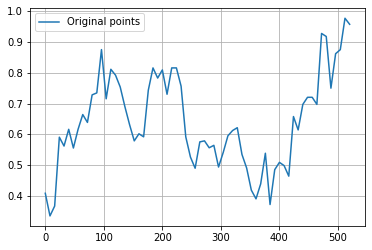

In [ ]:
BDMN_x65 = BDMN_x[0:522:8]
BDMN_y65 = BDMN_y[0:522:8]

plt.plot(BDMN_x65, BDMN_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BDMN_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BDMN_65: [0.40885264 0.39079982 0.1718569  0.68529205 0.50413472 0.67120309
 0.50988709 0.62395379 0.69313191 0.58983177 0.78053056 0.65765641
 0.9967834  0.60641    0.8705294  0.77937485 0.76487919 0.68404246
 0.63857976 0.55111218 0.63065574 0.53810695 0.76954802 0.84422728
 0.74827971 0.8600223  0.66689425 0.85397964 0.81192402 0.79306113
 0.55530514 0.5383499  0.44919001 0.60567954 0.5820392  0.53984786
 0.59804305 0.45482205 0.54714243 0.60529245 0.6040562  0.65348276
 0.51227592 0.50662409 0.40596457 0.3839913  0.40280705 0.64162259
 0.26359733 0.5381986  0.49676615 0.52999995 0.37533931 0.75548492
 0.55008944 0.73099

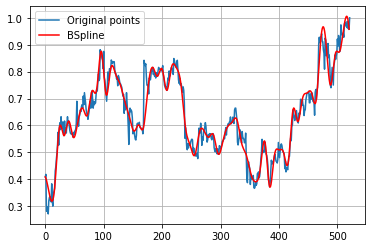

In [ ]:
import scipy.interpolate as interpolate

t_BDMN_65, c_BDMN_65, k_BDMN_65 = interpolate.splrep(BDMN_x65, BDMN_y65, s=0, k=3)
print('''\
t_BDMN_65: {}
c_BDMN_65: {}
k_BDMN_65: {}
'''.format(t_BDMN_65, c_BDMN_65, k_BDMN_65))
N = 522
xmin_BDMN_65, xmax_BDMN_65 = BDMN_x65.min(), BDMN_x65.max()
xx_BDMN_65 = np.linspace(xmin_BDMN_65, xmax_BDMN_65, N)
spline_BDMN_65 = interpolate.BSpline(t_BDMN_65, c_BDMN_65, k_BDMN_65, extrapolate=False)

plt.plot(BDMN_x, BDMN_y, label='Original points')
plt.plot(xx_BDMN_65, spline_BDMN_65(xx_BDMN_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BDMN**

In [ ]:

#RMSE 15 DATA BDMN
y_true_BDMN_15 = BDMN_y.tolist()
y_pred_BDMN_15 = spline_BDMN_15(xx_BDMN_15).tolist()
mse_BDMN_15 = mean_squared_error(y_true_BDMN_15, y_pred_BDMN_15)
rmse_BDMN_15 = np.sqrt(mse_BDMN_15)
print("rmse BDMN 15 =",rmse_BDMN_15)

#RMSE 25 DATA BDMN
y_true_BDMN_25 = BDMN_y.tolist()
y_pred_BDMN_25 = spline_BDMN_25(xx_BDMN_25).tolist()
mse_BDMN_25 = mean_squared_error(y_true_BDMN_25, y_pred_BDMN_25)
rmse_BDMN_25 = np.sqrt(mse_BDMN_25)
print("rmse BDMN 25 =",rmse_BDMN_25)

#RMSE 35 DATA BDMN
y_true_BDMN_35 = BDMN_y.tolist()
y_pred_BDMN_35 = spline_BDMN_35(xx_BDMN_35).tolist()
mse_BDMN_35 = mean_squared_error(y_true_BDMN_35, y_pred_BDMN_35)
rmse_BDMN_35 = np.sqrt(mse_BDMN_35)
print("rmse BDMN 35 =",rmse_BDMN_35)

#RMSE 45 DATA BDMN
y_true_BDMN_45 = BDMN_y.tolist()
y_pred_BDMN_45 = spline_BDMN_45(xx_BDMN_45).tolist()
mse_BDMN_45 = mean_squared_error(y_true_BDMN_45, y_pred_BDMN_45)
rmse_BDMN_45 = np.sqrt(mse_BDMN_45)
print("rmse BDMN 45 =",rmse_BDMN_45)

#RMSE 55 DATA BDMN
y_true_BDMN_55 = BDMN_y.tolist()
y_pred_BDMN_55 = spline_BDMN_55(xx_BDMN_55).tolist()
mse_BDMN_55 = mean_squared_error(y_true_BDMN_55, y_pred_BDMN_55)
rmse_BDMN_55 = np.sqrt(mse_BDMN_55)
print("rmse BDMN 55 =",rmse_BDMN_55)

#RMSE 65 DATA BDMN
y_true_BDMN_65 = BDMN_y.tolist()
y_pred_BDMN_65 = spline_BDMN_65(xx_BDMN_65).tolist()
mse_BDMN_65 = mean_squared_error(y_true_BDMN_65, y_pred_BDMN_65)
rmse_BDMN_65 = np.sqrt(mse_BDMN_65)
print("rmse BDMN 65 =",rmse_BDMN_65)


rmse BDMN 15 = 0.10094002501196106
rmse BDMN 25 = 0.08304937435594846
rmse BDMN 35 = 0.0637930039930088
rmse BDMN 45 = 0.04925913261355605
rmse BDMN 55 = 0.04007523605813409
rmse BDMN 65 = 0.03714826585289608


# **BKSL**

No handles with labels found to put in legend.


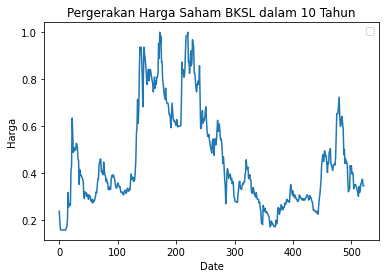

In [ ]:
BKSL = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BKSL.JK.csv')

BKSL_x = BKSL['No'].values
BKSL_y = BKSL['Skala'].values

plt.plot(BKSL_x,BKSL_y)
plt.title('Pergerakan Harga Saham BKSL dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BKSL**

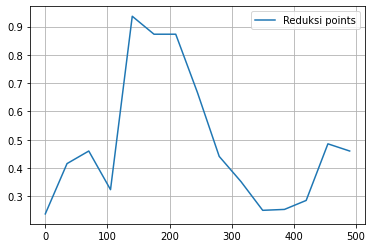

In [ ]:
BKSL_x15 = BKSL_x[0:522:35]
BKSL_y15 = BKSL_y[0:522:35]

plt.plot(BKSL_x15, BKSL_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BKSL_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BKSL_15: [0.23809524 0.28412613 0.74603346 0.04285458 1.20120011 0.77139262
 0.95132464 0.66140406 0.40305914 0.37397843 0.21531284 0.26953209
 0.2173137  0.67626379 0.46031746 0.         0.         0.
 0.        ]
k_BKSL_15: 3



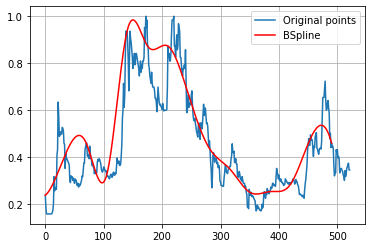

In [ ]:
import scipy.interpolate as interpolate

t_BKSL_15, c_BKSL_15, k_BKSL_15 = interpolate.splrep(BKSL_x15, BKSL_y15, s=0, k=3)
print('''\
t_BKSL_15: {}
c_BKSL_15: {}
k_BKSL_15: {}
'''.format(t_BKSL_15, c_BKSL_15, k_BKSL_15))
N = 522
xmin_BKSL_15, xmax_BKSL_15 = BKSL_x15.min(), BKSL_x15.max()
xx_BKSL_15 = np.linspace(xmin_BKSL_15, xmax_BKSL_15, N)
spline_BKSL_15 = interpolate.BSpline(t_BKSL_15, c_BKSL_15, k_BKSL_15, extrapolate=False)

plt.plot(BKSL_x, BKSL_y, label='Original points')
plt.plot(xx_BKSL_15, spline_BKSL_15(xx_BKSL_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BKSL**

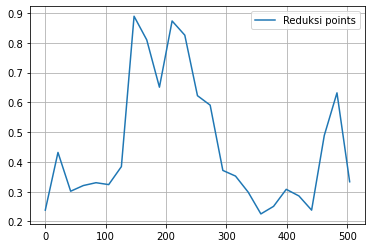

In [ ]:
BKSL_x25 = BKSL_x[0:522:21]
BKSL_y25 = BKSL_y[0:522:21]

plt.plot(BKSL_x25, BKSL_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BKSL_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BKSL_25: [0.23809524 0.62080434 0.21553417 0.3386035  0.32309401 0.34997283
 0.21987182 1.07530179 0.81225434 0.53282369 0.96121278 0.86042041
 0.54948654 0.67496677 0.2935035  0.37959063 0.30241967 0.20120686
 0.24513382 0.32301976 0.31040618 0.14964125 0.64291995 0.73647654
 0.33333333 0.         0.         0.         0.        ]
k_BKSL_25: 3



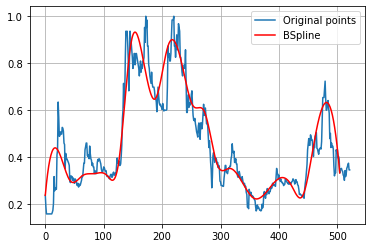

In [ ]:
import scipy.interpolate as interpolate

t_BKSL_25, c_BKSL_25, k_BKSL_25 = interpolate.splrep(BKSL_x25, BKSL_y25, s=0, k=3)
print('''\
t_BKSL_25: {}
c_BKSL_25: {}
k_BKSL_25: {}
'''.format(t_BKSL_25, c_BKSL_25, k_BKSL_25))
N = 522
xmin_BKSL_25, xmax_BKSL_25 = BKSL_x25.min(), BKSL_x25.max()
xx_BKSL_25 = np.linspace(xmin_BKSL_25, xmax_BKSL_25, N)
spline_BKSL_25 = interpolate.BSpline(t_BKSL_25, c_BKSL_25, k_BKSL_25, extrapolate=False)

plt.plot(BKSL_x, BKSL_y, label='Original points')
plt.plot(xx_BKSL_25, spline_BKSL_25(xx_BKSL_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BKSL**

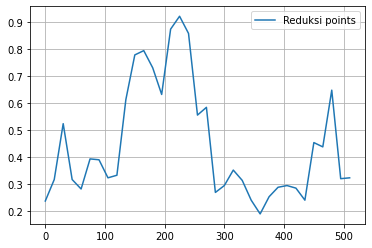

In [ ]:
BKSL_x35 = BKSL_x[0:522:15]
BKSL_y35 = BKSL_y[0:522:15]

plt.plot(BKSL_x35, BKSL_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BKSL_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BKSL_35: [ 0.23809524  0.05345892  0.78197106  0.25032384  0.25440729  0.42728511
  0.39835704  0.32214388  0.2559246   0.65415774  0.80363493  0.7979692
  0.76639305  0.51741099  0.95443918  0.90292753  0.95766024  0.40928867
  0.73851843  0.14139953  0.31493109  0.3703047   0.31813582  0.24286629
  0.15801808  0.26791854  0.29411729  0.28894565  0.32152868  0.13922535
  0.56918898  0.30782827  1.0014831  -0.10232885  0.32380952  0.
  0.          0.          0.        ]
k_BKSL_35: 3



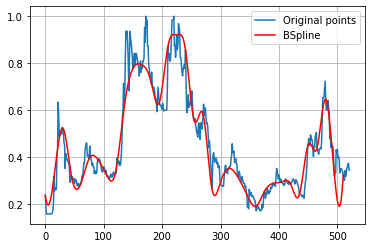

In [ ]:
import scipy.interpolate as interpolate

t_BKSL_35, c_BKSL_35, k_BKSL_35 = interpolate.splrep(BKSL_x35, BKSL_y35, s=0, k=3)
print('''\
t_BKSL_35: {}
c_BKSL_35: {}
k_BKSL_35: {}
'''.format(t_BKSL_35, c_BKSL_35, k_BKSL_35))
N = 522
xmin_BKSL_35, xmax_BKSL_35 = BKSL_x35.min(), BKSL_x35.max()
xx_BKSL_35 = np.linspace(xmin_BKSL_35, xmax_BKSL_35, N)
spline_BKSL_35 = interpolate.BSpline(t_BKSL_35, c_BKSL_35, k_BKSL_35, extrapolate=False)

plt.plot(BKSL_x, BKSL_y, label='Original points')
plt.plot(xx_BKSL_35, spline_BKSL_35(xx_BKSL_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA BKSL**

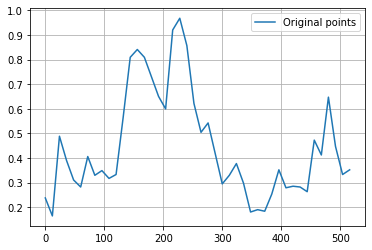

In [ ]:
BKSL_x45 = BKSL_x[0:522:12]
BKSL_y45 = BKSL_y[0:522:12]

plt.plot(BKSL_x45, BKSL_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BKSL_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BKSL_45: [ 0.23809524 -0.2075044   0.7118342   0.34944447  0.32384251  0.22185216
  0.48398695  0.28029526  0.37578439  0.31180528  0.2817564   0.56116911
  0.86404336  0.83980033  0.82437438  0.71984501  0.67719795  0.47612511
  1.01830163  0.9744779   0.89331059  0.59513688  0.45947523  0.59553364
  0.41553309  0.25661973  0.32941656  0.40666641  0.31058447  0.1414719
  0.20924223  0.16441632  0.2378544   0.40797559  0.24452895  0.29009909
  0.30936039  0.16769743  0.60080227  0.26718874  0.80663327  0.25377888
  0.33977723  0.35238095  0.          0.          0.          0.        ]
k_BKSL_45: 3



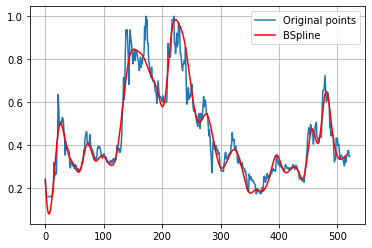

In [ ]:
import scipy.interpolate as interpolate

t_BKSL_45, c_BKSL_45, k_BKSL_45 = interpolate.splrep(BKSL_x45, BKSL_y45, s=0, k=3)
print('''\
t_BKSL_45: {}
c_BKSL_45: {}
k_BKSL_45: {}
'''.format(t_BKSL_45, c_BKSL_45, k_BKSL_45))
N = 522
xmin_BKSL_45, xmax_BKSL_45 = BKSL_x45.min(), BKSL_x45.max()
xx_BKSL_45 = np.linspace(xmin_BKSL_45, xmax_BKSL_45, N)
spline_BKSL_45 = interpolate.BSpline(t_BKSL_45, c_BKSL_45, k_BKSL_45, extrapolate=False)

plt.plot(BKSL_x, BKSL_y, label='Original points')
plt.plot(xx_BKSL_45, spline_BKSL_45(xx_BKSL_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA BKSL**

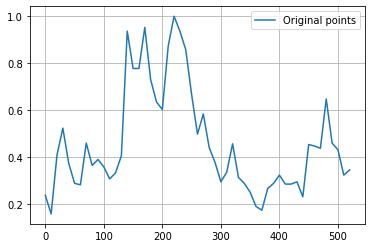

In [ ]:
BKSL_x55 = BKSL_x[0:522:10]
BKSL_y55 = BKSL_y[0:522:10]

plt.plot(BKSL_x55, BKSL_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BKSL_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BKSL_55: [ 0.23809524 -0.03986668  0.39084448  0.59045286  0.34029915  0.29596961
  0.20915575  0.5626455   0.30216701  0.41916266  0.36403949  0.27706034
  0.3753382   0.22158685  1.17640963  0.69182226  0.72296802  1.08297234
  0.65942834  0.66026669  0.50902872  0.92266604  1.03840235  0.92372457
  0.88574698  0.67614464  0.40967446  0.67563371  0.39255261  0.40177491
  0.26701443  0.30159595  0.54564938  0.25866367  0.30541023  0.25302876
  0.18723663  0.14088185  0.29685501  0.2716981   0.34968592  0.27241535
  0.2749384   0.34211675  0.12802316  0.53626679  0.45071921  0.34657067
  0.79156955  0.3728654   0.51420966  0.19606977  0.34603175  0.
  0.          0.          0.        ]


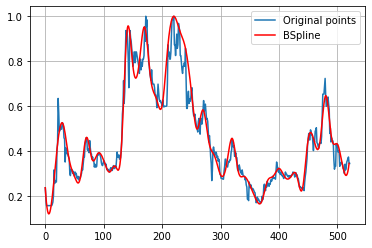

In [ ]:
import scipy.interpolate as interpolate

t_BKSL_55, c_BKSL_55, k_BKSL_55 = interpolate.splrep(BKSL_x55, BKSL_y55, s=0, k=3)
print('''\
t_BKSL_55: {}
c_BKSL_55: {}
k_BKSL_55: {}
'''.format(t_BKSL_55, c_BKSL_55, k_BKSL_55))
N = 522
xmin_BKSL_55, xmax_BKSL_55 = BKSL_x55.min(), BKSL_x55.max()
xx_BKSL_55 = np.linspace(xmin_BKSL_55, xmax_BKSL_55, N)
spline_BKSL_55 = interpolate.BSpline(t_BKSL_55, c_BKSL_55, k_BKSL_55, extrapolate=False)

plt.plot(BKSL_x, BKSL_y, label='Original points')
plt.plot(xx_BKSL_55, spline_BKSL_55(xx_BKSL_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BKSL**

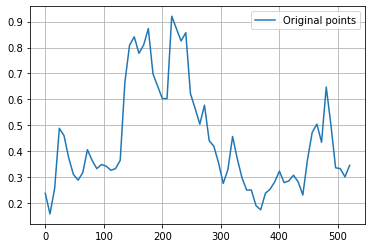

In [ ]:
BKSL_x65 = BKSL_x[0:522:8]
BKSL_y65 = BKSL_y[0:522:8]

plt.plot(BKSL_x65, BKSL_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BKSL_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BKSL_65: [0.23809524 0.14683446 0.09363267 0.56642931 0.45578428 0.37233834
 0.3024814  0.28440271 0.2932411  0.4473948  0.35527495 0.3219816
 0.35679864 0.34606192 0.31609655 0.35145665 0.27807686 0.72671212
 0.81507468 0.87013203 0.75201625 0.78846964 0.95124804 0.64463343
 0.66069443 0.61735075 0.48895017 1.04589618 0.85127464 0.78710049
 0.95270436 0.54493921 0.60087211 0.44204853 0.65950521 0.38659728
 0.4417247  0.36078963 0.24845013 0.3025527  0.52229144 0.3511387
 0.3017252  0.23243669 0.27328993 0.17916549 0.15290523 0.25683263
 0.24833569 0.27363414 0.35236587 0.25975954 0.28478643 0.31538044
 0.30131087 0.1746141

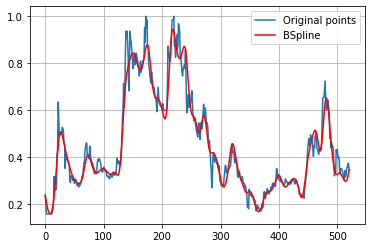

In [ ]:
import scipy.interpolate as interpolate

t_BKSL_65, c_BKSL_65, k_BKSL_65 = interpolate.splrep(BKSL_x65, BKSL_y65, s=0, k=3)
print('''\
t_BKSL_65: {}
c_BKSL_65: {}
k_BKSL_65: {}
'''.format(t_BKSL_65, c_BKSL_65, k_BKSL_65))
N = 522
xmin_BKSL_65, xmax_BKSL_65 = BKSL_x65.min(), BKSL_x65.max()
xx_BKSL_65 = np.linspace(xmin_BKSL_65, xmax_BKSL_65, N)
spline_BKSL_65 = interpolate.BSpline(t_BKSL_65, c_BKSL_65, k_BKSL_65, extrapolate=False)

plt.plot(BKSL_x, BKSL_y, label='Original points')
plt.plot(xx_BKSL_65, spline_BKSL_65(xx_BKSL_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BKSL**

In [ ]:

#RMSE 15 DATA BKSL
y_true_BKSL_15 = BKSL_y.tolist()
y_pred_BKSL_15 = spline_BKSL_15(xx_BKSL_15).tolist()
mse_BKSL_15 = mean_squared_error(y_true_BKSL_15, y_pred_BKSL_15)
rmse_BKSL_15 = np.sqrt(mse_BKSL_15)
print("rmse BKSL 15 =",rmse_BKSL_15)

#RMSE 25 DATA BKSL
y_true_BKSL_25 = BKSL_y.tolist()
y_pred_BKSL_25 = spline_BKSL_25(xx_BKSL_25).tolist()
mse_BKSL_25 = mean_squared_error(y_true_BKSL_25, y_pred_BKSL_25)
rmse_BKSL_25 = np.sqrt(mse_BKSL_25)
print("rmse BKSL 25 =",rmse_BKSL_25)

#RMSE 35 DATA BKSL
y_true_BKSL_35 = BKSL_y.tolist()
y_pred_BKSL_35 = spline_BKSL_35(xx_BKSL_35).tolist()
mse_BKSL_35 = mean_squared_error(y_true_BKSL_35, y_pred_BKSL_35)
rmse_BKSL_35 = np.sqrt(mse_BKSL_35)
print("rmse BKSL 35 =",rmse_BKSL_35)

#RMSE 45 DATA BKSL
y_true_BKSL_45 = BKSL_y.tolist()
y_pred_BKSL_45 = spline_BKSL_45(xx_BKSL_45).tolist()
mse_BKSL_45 = mean_squared_error(y_true_BKSL_45, y_pred_BKSL_45)
rmse_BKSL_45 = np.sqrt(mse_BKSL_45)
print("rmse BKSL 45 =",rmse_BKSL_45)

#RMSE 55 DATA BKSL
y_true_BKSL_55 = BKSL_y.tolist()
y_pred_BKSL_55 = spline_BKSL_55(xx_BKSL_55).tolist()
mse_BKSL_55 = mean_squared_error(y_true_BKSL_55, y_pred_BKSL_55)
rmse_BKSL_55 = np.sqrt(mse_BKSL_55)
print("rmse BKSL 55 =",rmse_BKSL_55)

#RMSE 65 DATA BKSL
y_true_BKSL_65 = BKSL_y.tolist()
y_pred_BKSL_65 = spline_BKSL_65(xx_BKSL_65).tolist()
mse_BKSL_65 = mean_squared_error(y_true_BKSL_65, y_pred_BKSL_65)
rmse_BKSL_65 = np.sqrt(mse_BKSL_65)
print("rmse BKSL 65 =",rmse_BKSL_65)


rmse BKSL 15 = 0.11542014640772454
rmse BKSL 25 = 0.10814731804329303
rmse BKSL 35 = 0.08074237879470178
rmse BKSL 45 = 0.06700868250264494
rmse BKSL 55 = 0.05311026701302476
rmse BKSL 65 = 0.047880453960055476


# **BMRI**

No handles with labels found to put in legend.


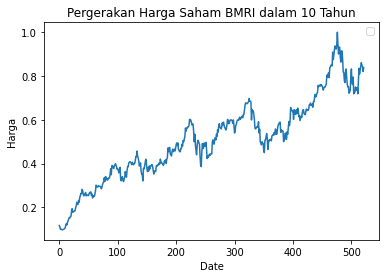

In [ ]:
BMRI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BMRI.JK.csv')

BMRI_x = BMRI['No'].values
BMRI_y = BMRI['Skala'].values

plt.plot(BMRI_x,BMRI_y)
plt.title('Pergerakan Harga Saham BMRI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BMRI**

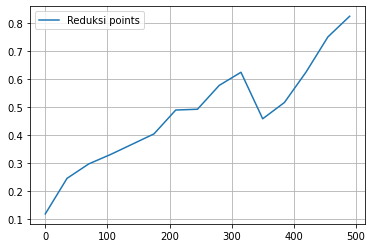

In [ ]:
BMRI_x15 = BMRI_x[0:522:35]
BMRI_y15 = BMRI_y[0:522:35]

plt.plot(BMRI_x15, BMRI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BMRI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BMRI_15: [0.11732613 0.24113341 0.2887343  0.32672223 0.3726639  0.38148582
 0.52184738 0.46294286 0.57524483 0.6963051  0.38101203 0.52396497
 0.64784911 0.81385954 0.82386364 0.         0.         0.
 0.        ]
k_BMRI_15: 3



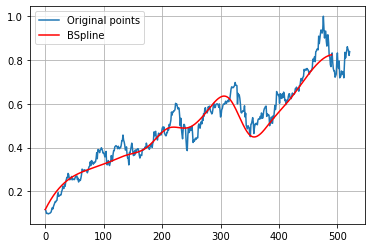

In [ ]:
import scipy.interpolate as interpolate

t_BMRI_15, c_BMRI_15, k_BMRI_15 = interpolate.splrep(BMRI_x15, BMRI_y15, s=0, k=3)
print('''\
t_BMRI_15: {}
c_BMRI_15: {}
k_BMRI_15: {}
'''.format(t_BMRI_15, c_BMRI_15, k_BMRI_15))
N = 522
xmin_BMRI_15, xmax_BMRI_15 = BMRI_x15.min(), BMRI_x15.max()
xx_BMRI_15 = np.linspace(xmin_BMRI_15, xmax_BMRI_15, N)
spline_BMRI_15 = interpolate.BSpline(t_BMRI_15, c_BMRI_15, k_BMRI_15, extrapolate=False)

plt.plot(BMRI_x, BMRI_y, label='Original points')
plt.plot(xx_BMRI_15, spline_BMRI_15(xx_BMRI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BMRI**

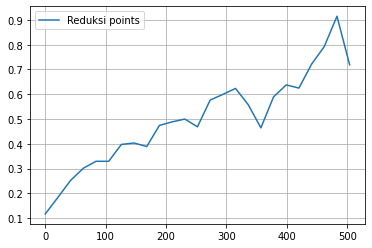

In [ ]:
BMRI_x25 = BMRI_x[0:522:21]
BMRI_y25 = BMRI_y[0:522:21]

plt.plot(BMRI_x25, BMRI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMRI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BMRI_25: [0.11732613 0.15490855 0.24259254 0.30247018 0.34273001 0.30439386
 0.41747866 0.41205516 0.35475526 0.50415106 0.4752314  0.52674152
 0.41780253 0.61454837 0.58423126 0.64511748 0.57677607 0.39721006
 0.6213155  0.65445976 0.58755001 0.7453402  0.7657328  1.06883815
 0.71875    0.         0.         0.         0.        ]
k_BMRI_25: 3



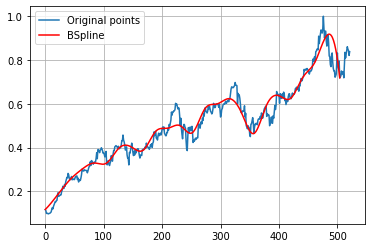

In [ ]:
import scipy.interpolate as interpolate

t_BMRI_25, c_BMRI_25, k_BMRI_25 = interpolate.splrep(BMRI_x25, BMRI_y25, s=0, k=3)
print('''\
t_BMRI_25: {}
c_BMRI_25: {}
k_BMRI_25: {}
'''.format(t_BMRI_25, c_BMRI_25, k_BMRI_25))
N = 522
xmin_BMRI_25, xmax_BMRI_25 = BMRI_x25.min(), BMRI_x25.max()
xx_BMRI_25 = np.linspace(xmin_BMRI_25, xmax_BMRI_25, N)
spline_BMRI_25 = interpolate.BSpline(t_BMRI_25, c_BMRI_25, k_BMRI_25, extrapolate=False)

plt.plot(BMRI_x, BMRI_y, label='Original points')
plt.plot(xx_BMRI_25, spline_BMRI_25(xx_BMRI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BMRI**

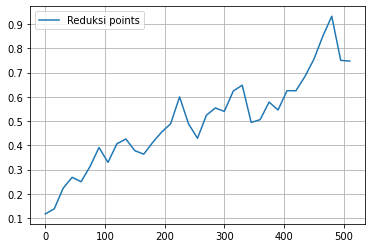

In [ ]:
BMRI_x35 = BMRI_x[0:522:15]
BMRI_y35 = BMRI_y[0:522:15]

plt.plot(BMRI_x35, BMRI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMRI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BMRI_35: [0.11732613 0.08496111 0.21278458 0.28747388 0.22769071 0.30185866
 0.44209057 0.27629727 0.43050445 0.43918493 0.36957401 0.34956447
 0.4139863  0.46608124 0.44896146 0.6698911  0.46806503 0.38966696
 0.54713077 0.56669633 0.50994755 0.63214982 0.70293042 0.44249212
 0.4930102  0.61955798 0.49750787 0.6631378  0.59994092 0.68709853
 0.75109678 0.83408252 1.06752453 0.54649342 0.74715909 0.
 0.         0.         0.        ]
k_BMRI_35: 3



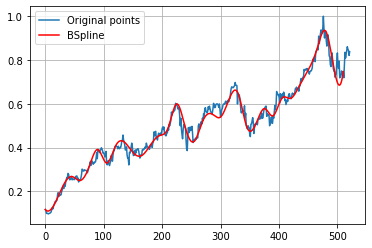

In [ ]:
import scipy.interpolate as interpolate

t_BMRI_35, c_BMRI_35, k_BMRI_35 = interpolate.splrep(BMRI_x35, BMRI_y35, s=0, k=3)
print('''\
t_BMRI_35: {}
c_BMRI_35: {}
k_BMRI_35: {}
'''.format(t_BMRI_35, c_BMRI_35, k_BMRI_35))
N = 522
xmin_BMRI_35, xmax_BMRI_35 = BMRI_x35.min(), BMRI_x35.max()
xx_BMRI_35 = np.linspace(xmin_BMRI_35, xmax_BMRI_35, N)
spline_BMRI_35 = interpolate.BSpline(t_BMRI_35, c_BMRI_35, k_BMRI_35, extrapolate=False)

plt.plot(BMRI_x, BMRI_y, label='Original points')
plt.plot(xx_BMRI_35, spline_BMRI_35(xx_BMRI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BMRI**

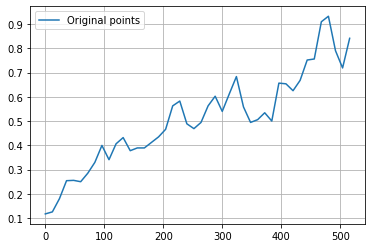

In [ ]:
BMRI_x45 = BMRI_x[0:522:12]
BMRI_y45 = BMRI_y[0:522:12]

plt.plot(BMRI_x45, BMRI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMRI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BMRI_45: [0.11732613 0.10802762 0.13801917 0.27449745 0.25511236 0.23867361
 0.29028857 0.30977659 0.44838915 0.29346913 0.42256166 0.45378423
 0.35321052 0.40041914 0.38034019 0.41344737 0.43746125 0.44466218
 0.57934459 0.61295948 0.46313569 0.46631595 0.48410053 0.56319104
 0.63813533 0.49790402 0.60888494 0.73985168 0.53114017 0.48501945
 0.49469114 0.57030691 0.42862667 0.71518642 0.64812766 0.61275749
 0.65084239 0.78955478 0.69946122 0.94669126 0.9683192  0.70514831
 0.67725539 0.84090909 0.         0.         0.         0.        ]
k_BMRI_45: 3



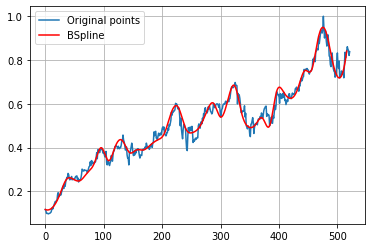

In [ ]:
import scipy.interpolate as interpolate

t_BMRI_45, c_BMRI_45, k_BMRI_45 = interpolate.splrep(BMRI_x45, BMRI_y45, s=0, k=3)
print('''\
t_BMRI_45: {}
c_BMRI_45: {}
k_BMRI_45: {}
'''.format(t_BMRI_45, c_BMRI_45, k_BMRI_45))
N = 522
xmin_BMRI_45, xmax_BMRI_45 = BMRI_x45.min(), BMRI_x45.max()
xx_BMRI_45 = np.linspace(xmin_BMRI_45, xmax_BMRI_45, N)
spline_BMRI_45 = interpolate.BSpline(t_BMRI_45, c_BMRI_45, k_BMRI_45, extrapolate=False)

plt.plot(BMRI_x, BMRI_y, label='Original points')
plt.plot(xx_BMRI_45, spline_BMRI_45(xx_BMRI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BMRI**

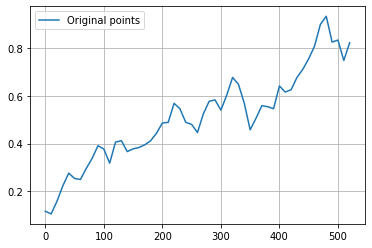

In [ ]:
BMRI_x55 = BMRI_x[0:522:10]
BMRI_y55 = BMRI_y[0:522:10]

plt.plot(BMRI_x55, BMRI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMRI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BMRI_55: [0.11732613 0.07345615 0.13941861 0.22083548 0.29775571 0.24746891
 0.23760958 0.30218817 0.33028549 0.40473123 0.3973078  0.2687534
 0.43676951 0.42166855 0.34814718 0.38460636 0.38047285 0.39463862
 0.41029086 0.43578886 0.5056446  0.45640548 0.60055166 0.55047878
 0.47026051 0.50029738 0.40923178 0.53891186 0.58000712 0.60128691
 0.50916342 0.60069579 0.7016898  0.64936319 0.58722108 0.41084338
 0.51372357 0.56835324 0.56229529 0.50632922 0.68511508 0.59696045
 0.61738402 0.68350347 0.70542029 0.75617902 0.7954318  0.90300287
 0.97892036 0.77222477 0.90974157 0.62609513 0.82102273 0.
 0.         0.         0.        ]
k_BMRI_55: 3



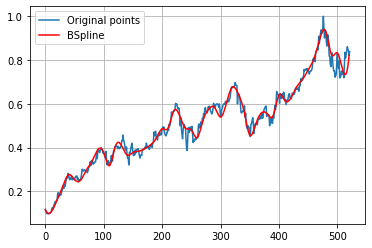

In [ ]:
import scipy.interpolate as interpolate

t_BMRI_55, c_BMRI_55, k_BMRI_55 = interpolate.splrep(BMRI_x55, BMRI_y55, s=0, k=3)
print('''\
t_BMRI_55: {}
c_BMRI_55: {}
k_BMRI_55: {}
'''.format(t_BMRI_55, c_BMRI_55, k_BMRI_55))
N = 522
xmin_BMRI_55, xmax_BMRI_55 = BMRI_x55.min(), BMRI_x55.max()
xx_BMRI_55 = np.linspace(xmin_BMRI_55, xmax_BMRI_55, N)
spline_BMRI_55 = interpolate.BSpline(t_BMRI_55, c_BMRI_55, k_BMRI_55, extrapolate=False)

plt.plot(BMRI_x, BMRI_y, label='Original points')
plt.plot(xx_BMRI_55, spline_BMRI_55(xx_BMRI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA BMRI**


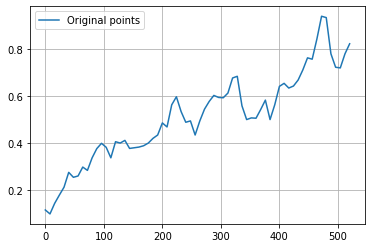

In [ ]:
BMRI_x65 = BMRI_x[0:522:8]
BMRI_y65 = BMRI_y[0:522:8]

plt.plot(BMRI_x65, BMRI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMRI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BMRI_65: [0.11732613 0.06634378 0.13827972 0.1831999  0.19876786 0.30393542
 0.24481768 0.25041435 0.32066354 0.26034519 0.34756021 0.37747534
 0.40525429 0.39830982 0.29774058 0.43913696 0.38321158 0.43142581
 0.36267609 0.38491528 0.38175371 0.38920625 0.39664855 0.42760865
 0.41564412 0.5177694  0.42805101 0.58252655 0.61684277 0.52964782
 0.46911141 0.52572471 0.39389885 0.50663445 0.54547245 0.5756803
 0.61203363 0.58982156 0.59118014 0.59943514 0.68437477 0.71988398
 0.53552112 0.48746336 0.51462543 0.49664857 0.53287121 0.62754842
 0.45125328 0.56743844 0.65399297 0.66033969 0.6251028  0.64038546
 0.6656281  0.702783

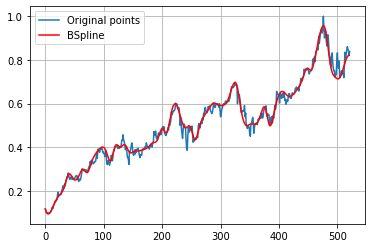

In [ ]:

import scipy.interpolate as interpolate

t_BMRI_65, c_BMRI_65, k_BMRI_65 = interpolate.splrep(BMRI_x65, BMRI_y65, s=0, k=3)
print('''\
t_BMRI_65: {}
c_BMRI_65: {}
k_BMRI_65: {}
'''.format(t_BMRI_65, c_BMRI_65, k_BMRI_65))
N = 522
xmin_BMRI_65, xmax_BMRI_65 = BMRI_x65.min(), BMRI_x65.max()
xx_BMRI_65 = np.linspace(xmin_BMRI_65, xmax_BMRI_65, N)
spline_BMRI_65 = interpolate.BSpline(t_BMRI_65, c_BMRI_65, k_BMRI_65, extrapolate=False)

plt.plot(BMRI_x, BMRI_y, label='Original points')
plt.plot(xx_BMRI_65, spline_BMRI_65(xx_BMRI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BMRI**

In [ ]:

#RMSE 15 DATA BMRI
y_true_BMRI_15 = BMRI_y.tolist()
y_pred_BMRI_15 = spline_BMRI_15(xx_BMRI_15).tolist()
mse_BMRI_15 = mean_squared_error(y_true_BMRI_15, y_pred_BMRI_15)
rmse_BMRI_15 = np.sqrt(mse_BMRI_15)
print("rmse BMRI 15 =",rmse_BMRI_15)

#RMSE 25 DATA BMRI
y_true_BMRI_25 = BMRI_y.tolist()
y_pred_BMRI_25 = spline_BMRI_25(xx_BMRI_25).tolist()
mse_BMRI_25 = mean_squared_error(y_true_BMRI_25, y_pred_BMRI_25)
rmse_BMRI_25 = np.sqrt(mse_BMRI_25)
print("rmse BMRI 25 =",rmse_BMRI_25)

#RMSE 35 DATA BMRI
y_true_BMRI_35 = BMRI_y.tolist()
y_pred_BMRI_35 = spline_BMRI_35(xx_BMRI_35).tolist()
mse_BMRI_35 = mean_squared_error(y_true_BMRI_35, y_pred_BMRI_35)
rmse_BMRI_35 = np.sqrt(mse_BMRI_35)
print("rmse BMRI 35 =",rmse_BMRI_35)

#RMSE 45 DATA BMRI
y_true_BMRI_45 = BMRI_y.tolist()
y_pred_BMRI_45 = spline_BMRI_45(xx_BMRI_45).tolist()
mse_BMRI_45 = mean_squared_error(y_true_BMRI_45, y_pred_BMRI_45)
rmse_BMRI_45 = np.sqrt(mse_BMRI_45)
print("rmse BMRI 45 =",rmse_BMRI_45)

#RMSE 55 DATA BMRI
y_true_BMRI_55 = BMRI_y.tolist()
y_pred_BMRI_55 = spline_BMRI_55(xx_BMRI_55).tolist()
mse_BMRI_55 = mean_squared_error(y_true_BMRI_55, y_pred_BMRI_55)
rmse_BMRI_55 = np.sqrt(mse_BMRI_55)
print("rmse BMRI 55 =",rmse_BMRI_55)

#RMSE 65 DATA BMRI
y_true_BMRI_65 = BMRI_y.tolist()
y_pred_BMRI_65 = spline_BMRI_65(xx_BMRI_65).tolist()
mse_BMRI_65 = mean_squared_error(y_true_BMRI_65, y_pred_BMRI_65)
rmse_BMRI_65 = np.sqrt(mse_BMRI_65)
print("rmse BMRI 65 =",rmse_BMRI_65)


rmse BMRI 15 = 0.07175857005494708
rmse BMRI 25 = 0.055402741053079706
rmse BMRI 35 = 0.049212882013593987
rmse BMRI 45 = 0.03076751157237121
rmse BMRI 55 = 0.027281651320304162
rmse BMRI 65 = 0.022730174700579128


# **BMTR**

No handles with labels found to put in legend.


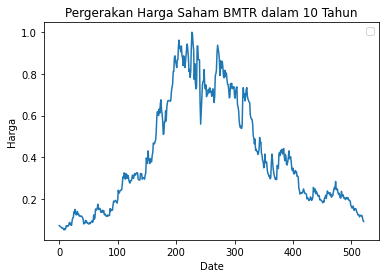

In [ ]:
BMTR = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/_BMTR.JK.csv')

BMTR_x = BMTR['No'].values
BMTR_y = BMTR['Skala'].values

plt.plot(BMTR_x,BMTR_y)
plt.title('Pergerakan Harga Saham BMTR dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BMTR**

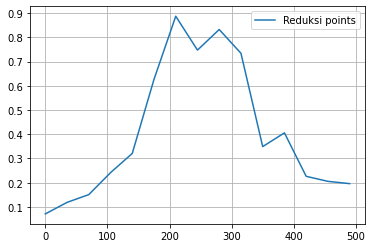

In [ ]:
BMTR_x15 = BMTR_x[0:522:35]
BMTR_y15 = BMTR_y[0:522:35]

plt.plot(BMTR_x15, BMTR_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMTR_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BMTR_15: [0.07132076 0.1397782  0.08478323 0.26493207 0.25950789 0.62156469
 1.01272393 0.64829432 0.87711765 0.83568789 0.18390436 0.52303431
 0.03621612 0.28755232 0.19622641 0.         0.         0.
 0.        ]
k_BMTR_15: 3



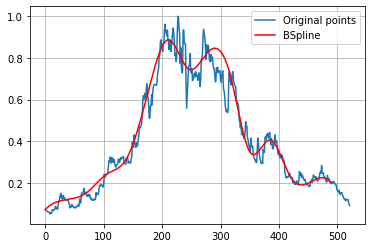

In [ ]:
import scipy.interpolate as interpolate

t_BMTR_15, c_BMTR_15, k_BMTR_15 = interpolate.splrep(BMTR_x15, BMTR_y15, s=0, k=3)
print('''\
t_BMTR_15: {}
c_BMTR_15: {}
k_BMTR_15: {}
'''.format(t_BMTR_15, c_BMTR_15, k_BMTR_15))
N = 522
xmin_BMTR_15, xmax_BMTR_15 = BMTR_x15.min(), BMTR_x15.max()
xx_BMTR_15 = np.linspace(xmin_BMTR_15, xmax_BMTR_15, N)
spline_BMTR_15 = interpolate.BSpline(t_BMTR_15, c_BMTR_15, k_BMTR_15, extrapolate=False)

plt.plot(BMTR_x, BMTR_y, label='Original points')
plt.plot(xx_BMTR_15, spline_BMTR_15(xx_BMTR_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BMTR**

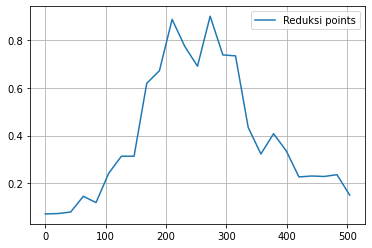

In [ ]:
BMTR_x25 = BMTR_x[0:522:21]
BMTR_y25 = BMTR_y[0:522:21]

plt.plot(BMTR_x25, BMTR_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMTR_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BMTR_25: [0.07132076 0.10330966 0.00941842 0.18760194 0.06732608 0.25630131
 0.3565253  0.19684276 0.73534892 0.57496911 0.99496334 0.76593226
 0.58281704 1.04619579 0.6323998  0.8506201  0.36889338 0.27757997
 0.45663578 0.34115991 0.19381891 0.242055   0.21143923 0.27135586
 0.15018868 0.         0.         0.         0.        ]
k_BMTR_25: 3



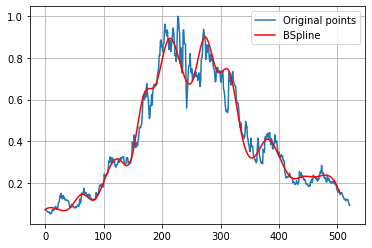

In [ ]:
import scipy.interpolate as interpolate

t_BMTR_25, c_BMTR_25, k_BMTR_25 = interpolate.splrep(BMTR_x25, BMTR_y25, s=0, k=3)
print('''\
t_BMTR_25: {}
c_BMTR_25: {}
k_BMTR_25: {}
'''.format(t_BMTR_25, c_BMTR_25, k_BMTR_25))
N = 522
xmin_BMTR_25, xmax_BMTR_25 = BMTR_x25.min(), BMTR_x25.max()
xx_BMTR_25 = np.linspace(xmin_BMTR_25, xmax_BMTR_25, N)
spline_BMTR_25 = interpolate.BSpline(t_BMTR_25, c_BMTR_25, k_BMTR_25, extrapolate=False)

plt.plot(BMTR_x, BMTR_y, label='Original points')
plt.plot(xx_BMTR_25, spline_BMTR_25(xx_BMTR_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 35 DATA BMTR**

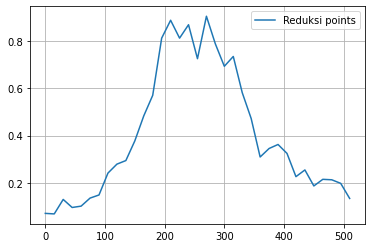

In [ ]:
BMTR_x35 = BMTR_x[0:522:15]
BMTR_y35 = BMTR_y[0:522:15]

plt.plot(BMTR_x35, BMTR_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMTR_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BMTR_35: [ 0.07132076 -0.00591412  0.18729995  0.08037084  0.09530748  0.14972
  0.12090687  0.26099215  0.28418112  0.27775506  0.37083639  0.50305032
  0.51507555  0.8555154   0.93078739  0.74208974  0.96877816  0.59034479
  1.01701249  0.76424675  0.64675522  0.80344936  0.54322092  0.51045942
  0.24513008  0.36562403  0.36407192  0.3516732   0.17640508  0.30119705
  0.14710861  0.23338739  0.20208136  0.20829894  0.13433962  0.
  0.          0.          0.        ]
k_BMTR_35: 3



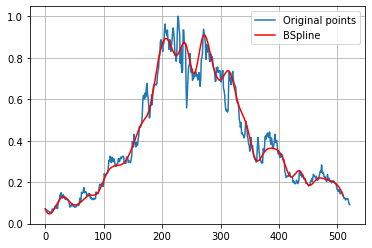

In [ ]:
import scipy.interpolate as interpolate

t_BMTR_35, c_BMTR_35, k_BMTR_35 = interpolate.splrep(BMTR_x35, BMTR_y35, s=0, k=3)
print('''\
t_BMTR_35: {}
c_BMTR_35: {}
k_BMTR_35: {}
'''.format(t_BMTR_35, c_BMTR_35, k_BMTR_35))
N = 522
xmin_BMTR_35, xmax_BMTR_35 = BMTR_x35.min(), BMTR_x35.max()
xx_BMTR_35 = np.linspace(xmin_BMTR_35, xmax_BMTR_35, N)
spline_BMTR_35 = interpolate.BSpline(t_BMTR_35, c_BMTR_35, k_BMTR_35, extrapolate=False)

plt.plot(BMTR_x, BMTR_y, label='Original points')
plt.plot(xx_BMTR_35, spline_BMTR_35(xx_BMTR_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA BMTR**

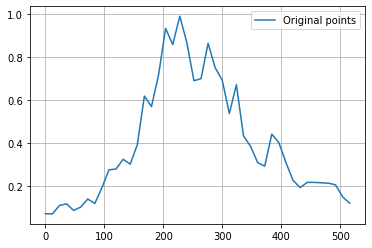

In [ ]:
BMTR_x45 = BMTR_x[0:522:12]
BMTR_y45 = BMTR_y[0:522:12]

plt.plot(BMTR_x45, BMTR_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BMTR_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BMTR_45: [0.07132076 0.03887401 0.11262934 0.12762831 0.07499446 0.09314857
 0.163732   0.08965928 0.19083845 0.30170391 0.2551761  0.3530634
 0.2797401  0.33929696 0.71778905 0.50275438 0.69006137 1.03888694
 0.75816445 1.07939866 0.86763713 0.6576     0.64535911 0.96096357
 0.69569229 0.76192766 0.41131404 0.81923128 0.34194951 0.41674425
 0.30050746 0.2378297  0.50289073 0.39966399 0.30977405 0.21784359
 0.17734218 0.22750469 0.21452584 0.21627874 0.21092525 0.22204564
 0.10793944 0.12       0.         0.         0.         0.        ]
k_BMTR_45: 3



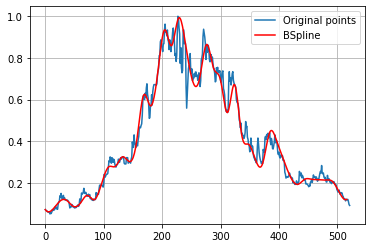

In [ ]:
import scipy.interpolate as interpolate

t_BMTR_45, c_BMTR_45, k_BMTR_45 = interpolate.splrep(BMTR_x45, BMTR_y45, s=0, k=3)
print('''\
t_BMTR_45: {}
c_BMTR_45: {}
k_BMTR_45: {}
'''.format(t_BMTR_45, c_BMTR_45, k_BMTR_45))
N = 522
xmin_BMTR_45, xmax_BMTR_45 = BMTR_x45.min(), BMTR_x45.max()
xx_BMTR_45 = np.linspace(xmin_BMTR_45, xmax_BMTR_45, N)
spline_BMTR_45 = interpolate.BSpline(t_BMTR_45, c_BMTR_45, k_BMTR_45, extrapolate=False)

plt.plot(BMTR_x, BMTR_y, label='Original points')
plt.plot(xx_BMTR_45, spline_BMTR_45(xx_BMTR_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BMTR**

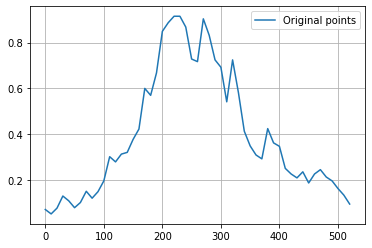

In [ ]:
BMTR_x55 = BMTR_x[0:522:10]
BMTR_y55 = BMTR_y[0:522:10]

plt.plot(BMTR_x55, BMTR_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BMTR_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BMTR_55: [0.07132076 0.04747774 0.03900679 0.15123824 0.10911444 0.06890776
 0.09072623 0.17950807 0.09690188 0.15741271 0.1677869  0.34879818
 0.24834112 0.33330904 0.297668   0.40054725 0.36429395 0.67812602
 0.52320197 0.64793402 0.89260912 0.87596911 0.92426914 0.91752038
 0.89621539 0.70516522 0.65293504 0.98498139 0.82978089 0.68834788
 0.7639974  0.41037948 0.84354127 0.56262526 0.39275013 0.3456195
 0.31911148 0.23453836 0.49745208 0.32282314 0.38484026 0.22083469
 0.23748136 0.18773043 0.26820069 0.15456114 0.23657361 0.257635
 0.20458452 0.20327222 0.14515605 0.13157292 0.09509434 0.
 0.         0.         0.        ]
k_BMTR_55: 3



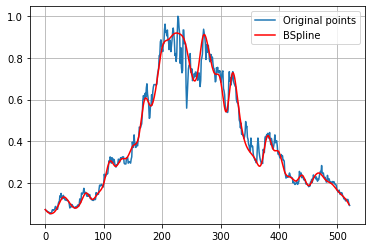

In [ ]:
import scipy.interpolate as interpolate

t_BMTR_55, c_BMTR_55, k_BMTR_55 = interpolate.splrep(BMTR_x55, BMTR_y55, s=0, k=3)
print('''\
t_BMTR_55: {}
c_BMTR_55: {}
k_BMTR_55: {}
'''.format(t_BMTR_55, c_BMTR_55, k_BMTR_55))
N = 522
xmin_BMTR_55, xmax_BMTR_55 = BMTR_x55.min(), BMTR_x55.max()
xx_BMTR_55 = np.linspace(xmin_BMTR_55, xmax_BMTR_55, N)
spline_BMTR_55 = interpolate.BSpline(t_BMTR_55, c_BMTR_55, k_BMTR_55, extrapolate=False)

plt.plot(BMTR_x, BMTR_y, label='Original points')
plt.plot(xx_BMTR_55, spline_BMTR_55(xx_BMTR_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BMTR**

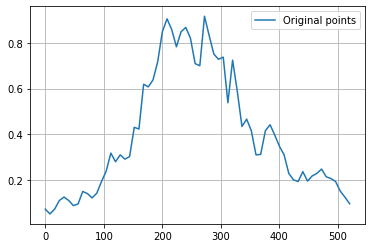

In [ ]:
BMTR_x65 = BMTR_x[0:522:8]
BMTR_y65 = BMTR_y[0:522:8]

plt.plot(BMTR_x65, BMTR_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BMTR_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BMTR_65: [0.07132075 0.0391211  0.05251253 0.1145331  0.13045371 0.11082187
 0.08286256 0.07848259 0.16924482 0.13887775 0.11298002 0.13373046
 0.20115474 0.21636758 0.35979005 0.246359   0.33024564 0.2892622
 0.25610178 0.49765142 0.33442462 0.70049914 0.57678637 0.63763841
 0.6990751  0.867948   0.92347254 0.8721241  0.73897446 0.87009127
 0.87500007 0.83745562 0.69970576 0.62032511 1.01899378 0.80558655
 0.75111285 0.69562242 0.8362088  0.38595749 0.84637634 0.57570696
 0.38287129 0.49658148 0.42702921 0.28586773 0.28610366 0.43764217
 0.45389371 0.3958396  0.34010639 0.32675371 0.20948255 0.20512743
 0.17000775 0.269558

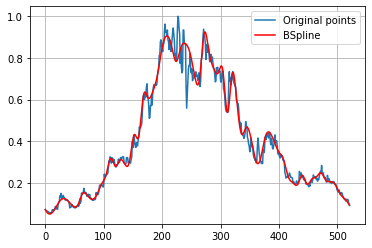

In [ ]:
import scipy.interpolate as interpolate

t_BMTR_65, c_BMTR_65, k_BMTR_65 = interpolate.splrep(BMTR_x65, BMTR_y65, s=0, k=3)
print('''\
t_BMTR_65: {}
c_BMTR_65: {}
k_BMTR_65: {}
'''.format(t_BMTR_65, c_BMTR_65, k_BMTR_65))
N = 522
xmin_BMTR_65, xmax_BMTR_65 = BMTR_x65.min(), BMTR_x65.max()
xx_BMTR_65 = np.linspace(xmin_BMTR_65, xmax_BMTR_65, N)
spline_BMTR_65 = interpolate.BSpline(t_BMTR_65, c_BMTR_65, k_BMTR_65, extrapolate=False)

plt.plot(BMTR_x, BMTR_y, label='Original points')
plt.plot(xx_BMTR_65, spline_BMTR_65(xx_BMTR_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BMTR**

In [ ]:

#RMSE 15 DATA BMTR
y_true_BMTR_15 = BMTR_y.tolist()
y_pred_BMTR_15 = spline_BMTR_15(xx_BMTR_15).tolist()
mse_BMTR_15 = mean_squared_error(y_true_BMTR_15, y_pred_BMTR_15)
rmse_BMTR_15 = np.sqrt(mse_BMTR_15)
print("rmse BMTR 15 =",rmse_BMTR_15)

#RMSE 25 DATA BMTR
y_true_BMTR_25 = BMTR_y.tolist()
y_pred_BMTR_25 = spline_BMTR_25(xx_BMTR_25).tolist()
mse_BMTR_25 = mean_squared_error(y_true_BMTR_25, y_pred_BMTR_25)
rmse_BMTR_25 = np.sqrt(mse_BMTR_25)
print("rmse BMTR 25 =",rmse_BMTR_25)

#RMSE 35 DATA BMTR
y_true_BMTR_35 = BMTR_y.tolist()
y_pred_BMTR_35 = spline_BMTR_35(xx_BMTR_35).tolist()
mse_BMTR_35 = mean_squared_error(y_true_BMTR_35, y_pred_BMTR_35)
rmse_BMTR_35 = np.sqrt(mse_BMTR_35)
print("rmse BMTR 35 =",rmse_BMTR_35)

#RMSE 45 DATA BMTR
y_true_BMTR_45 = BMTR_y.tolist()
y_pred_BMTR_45 = spline_BMTR_45(xx_BMTR_45).tolist()
mse_BMTR_45 = mean_squared_error(y_true_BMTR_45, y_pred_BMTR_45)
rmse_BMTR_45 = np.sqrt(mse_BMTR_45)
print("rmse BMTR 45 =",rmse_BMTR_45)

#RMSE 55 DATA BMTR
y_true_BMTR_55 = BMTR_y.tolist()
y_pred_BMTR_55 = spline_BMTR_55(xx_BMTR_55).tolist()
mse_BMTR_55 = mean_squared_error(y_true_BMTR_55, y_pred_BMTR_55)
rmse_BMTR_55 = np.sqrt(mse_BMTR_55)
print("rmse BMTR 55 =",rmse_BMTR_55)

#RMSE 65 DATA BMTR
y_true_BMTR_65 = BMTR_y.tolist()
y_pred_BMTR_65 = spline_BMTR_65(xx_BMTR_65).tolist()
mse_BMTR_65 = mean_squared_error(y_true_BMTR_65, y_pred_BMTR_65)
rmse_BMTR_65 = np.sqrt(mse_BMTR_65)
print("rmse BMTR 65 =",rmse_BMTR_65)


rmse BMTR 15 = 0.09412629047082566
rmse BMTR 25 = 0.06404070609116926
rmse BMTR 35 = 0.06056013992976408
rmse BMTR 45 = 0.05237740743056776
rmse BMTR 55 = 0.03977689307695207
rmse BMTR 65 = 0.04128866220609784


# **BNGA**

No handles with labels found to put in legend.


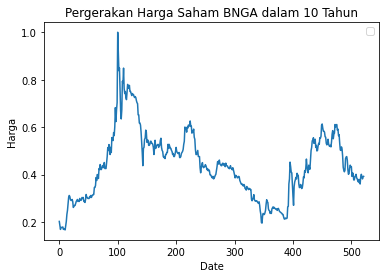

In [ ]:
BNGA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BNGA.JK.csv')

BNGA_x = BNGA['No'].values
BNGA_y = BNGA['Skala'].values

plt.plot(BNGA_x,BNGA_y)
plt.title('Pergerakan Harga Saham BNGA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BNGA**

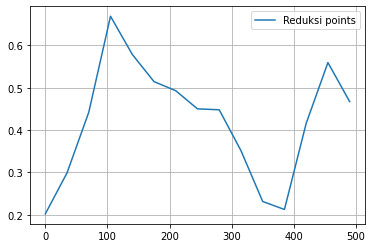

In [ ]:
BNGA_x15 = BNGA_x[0:522:35]
BNGA_y15 = BNGA_y[0:522:35]

plt.plot(BNGA_x15, BNGA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BNGA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BNGA_15: [0.20210507 0.29858469 0.27651382 0.76592476 0.54953941 0.50793154
 0.50496905 0.42983376 0.4761512  0.35315742 0.2201461  0.15506375
 0.52863549 0.6336908  0.46722163 0.         0.         0.
 0.        ]
k_BNGA_15: 3



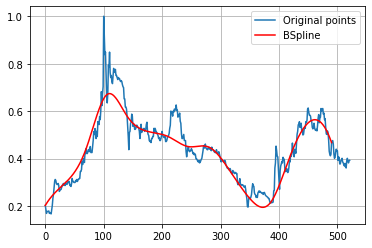

In [ ]:
import scipy.interpolate as interpolate

t_BNGA_15, c_BNGA_15, k_BNGA_15 = interpolate.splrep(BNGA_x15, BNGA_y15, s=0, k=3)
print('''\
t_BNGA_15: {}
c_BNGA_15: {}
k_BNGA_15: {}
'''.format(t_BNGA_15, c_BNGA_15, k_BNGA_15))
N = 522
xmin_BNGA_15, xmax_BNGA_15 = BNGA_x15.min(), BNGA_x15.max()
xx_BNGA_15 = np.linspace(xmin_BNGA_15, xmax_BNGA_15, N)
spline_BNGA_15 = interpolate.BSpline(t_BNGA_15, c_BNGA_15, k_BNGA_15, extrapolate=False)

plt.plot(BNGA_x, BNGA_y, label='Original points')
plt.plot(xx_BNGA_15, spline_BNGA_15(xx_BNGA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA BNGA**

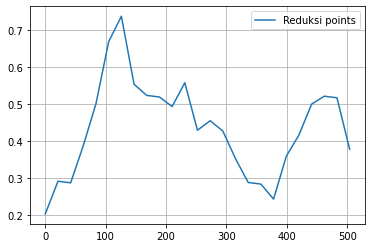

In [ ]:
BNGA_x25 = BNGA_x[0:522:21]
BNGA_y25 = BNGA_y[0:522:21]

plt.plot(BNGA_x25, BNGA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BNGA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BNGA_25: [0.20210507 0.35595632 0.2059816  0.39699186 0.48250565 0.67928679
 0.81245219 0.4945074  0.52722041 0.53428281 0.44760158 0.63295237
 0.36400976 0.48287076 0.4306811  0.35340771 0.26461505 0.31127974
 0.18769502 0.39104232 0.39564063 0.52110147 0.51453005 0.55126415
 0.37720645 0.         0.         0.         0.        ]
k_BNGA_25: 3



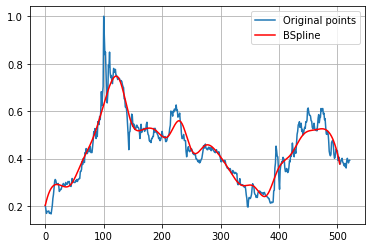

In [ ]:
import scipy.interpolate as interpolate

t_BNGA_25, c_BNGA_25, k_BNGA_25 = interpolate.splrep(BNGA_x25, BNGA_y25, s=0, k=3)
print('''\
t_BNGA_25: {}
c_BNGA_25: {}
k_BNGA_25: {}
'''.format(t_BNGA_25, c_BNGA_25, k_BNGA_25))
N = 522
xmin_BNGA_25, xmax_BNGA_25 = BNGA_x25.min(), BNGA_x25.max()
xx_BNGA_25 = np.linspace(xmin_BNGA_25, xmax_BNGA_25, N)
spline_BNGA_25 = interpolate.BSpline(t_BNGA_25, c_BNGA_25, k_BNGA_25, extrapolate=False)

plt.plot(BNGA_x, BNGA_y, label='Original points')
plt.plot(xx_BNGA_25, spline_BNGA_25(xx_BNGA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA BNGA**

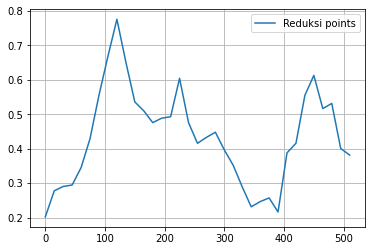

In [ ]:
BNGA_x35 = BNGA_x[0:522:15]
BNGA_y35 = BNGA_y[0:522:15]

plt.plot(BNGA_x35, BNGA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BNGA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BNGA_35: [0.20210507 0.28456008 0.29614189 0.28315524 0.34290403 0.41680444
 0.56672979 0.65100433 0.8413579  0.6386346  0.5133342  0.52285633
 0.45575648 0.50888479 0.44062727 0.68624765 0.44070779 0.40568821
 0.43124569 0.46690982 0.38871102 0.35721863 0.29134145 0.21342253
 0.24377399 0.29030227 0.13813426 0.4559511  0.36559662 0.57636873
 0.65948998 0.46343426 0.62667776 0.25997206 0.38149289 0.
 0.         0.         0.        ]
k_BNGA_35: 3



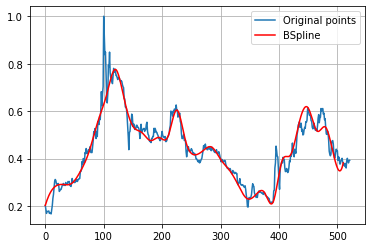

In [ ]:
import scipy.interpolate as interpolate

t_BNGA_35, c_BNGA_35, k_BNGA_35 = interpolate.splrep(BNGA_x35, BNGA_y35, s=0, k=3)
print('''\
t_BNGA_35: {}
c_BNGA_35: {}
k_BNGA_35: {}
'''.format(t_BNGA_35, c_BNGA_35, k_BNGA_35))
N = 522
xmin_BNGA_35, xmax_BNGA_35 = BNGA_x35.min(), BNGA_x35.max()
xx_BNGA_35 = np.linspace(xmin_BNGA_35, xmax_BNGA_35, N)
spline_BNGA_35 = interpolate.BSpline(t_BNGA_35, c_BNGA_35, k_BNGA_35, extrapolate=False)

plt.plot(BNGA_x, BNGA_y, label='Original points')
plt.plot(xx_BNGA_35, spline_BNGA_35(xx_BNGA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BNGA**

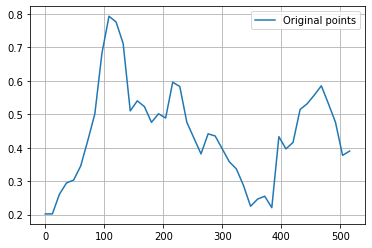

In [ ]:
BNGA_x45 = BNGA_x[0:522:12]
BNGA_y45 = BNGA_y[0:522:12]

plt.plot(BNGA_x45, BNGA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BNGA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BNGA_45: [0.20210507 0.15982551 0.25719065 0.30123019 0.29529894 0.3365184
 0.43020325 0.46898053 0.70017587 0.82294614 0.76598461 0.76818598
 0.43056268 0.57007929 0.52966649 0.4489266  0.52939412 0.44257567
 0.63222607 0.60340846 0.45187264 0.443868   0.34451752 0.46701925
 0.43642352 0.39772678 0.35164186 0.34321069 0.29442718 0.20222825
 0.24688748 0.28904258 0.12720019 0.52666567 0.36371794 0.39743511
 0.54124796 0.52380768 0.55263043 0.60909144 0.5215957  0.48431457
 0.29579055 0.39006576 0.         0.         0.         0.        ]
k_BNGA_45: 3



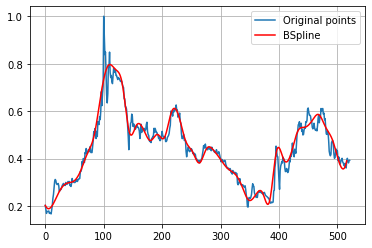

In [ ]:
import scipy.interpolate as interpolate

t_BNGA_45, c_BNGA_45, k_BNGA_45 = interpolate.splrep(BNGA_x45, BNGA_y45, s=0, k=3)
print('''\
t_BNGA_45: {}
c_BNGA_45: {}
k_BNGA_45: {}
'''.format(t_BNGA_45, c_BNGA_45, k_BNGA_45))
N = 522
xmin_BNGA_45, xmax_BNGA_45 = BNGA_x45.min(), BNGA_x45.max()
xx_BNGA_45 = np.linspace(xmin_BNGA_45, xmax_BNGA_45, N)
spline_BNGA_45 = interpolate.BSpline(t_BNGA_45, c_BNGA_45, k_BNGA_45, extrapolate=False)

plt.plot(BNGA_x, BNGA_y, label='Original points')
plt.plot(xx_BNGA_45, spline_BNGA_45(xx_BNGA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BNGA**


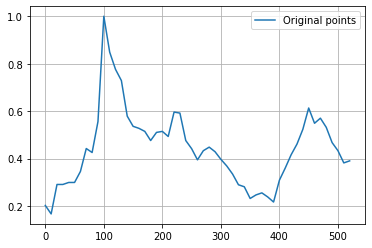

In [ ]:
BNGA_x55 = BNGA_x[0:522:10]
BNGA_y55 = BNGA_y[0:522:10]

plt.plot(BNGA_x55, BNGA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BNGA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BNGA_55: [0.20210507 0.03426427 0.35041772 0.27612745 0.30680185 0.29034609
 0.32549474 0.47925076 0.41012092 0.4318409  1.19724342 0.7791854
 0.77830207 0.76267685 0.54315622 0.53671223 0.52482261 0.52738782
 0.45186072 0.5199363  0.52891006 0.45065807 0.62609917 0.6198337
 0.44373586 0.45998989 0.36532263 0.44483281 0.45292691 0.43105551
 0.39471323 0.36906408 0.34083193 0.27366072 0.30053218 0.20878028
 0.25315228 0.25743134 0.24738034 0.1804308  0.32968687 0.3525625
 0.42042736 0.46043438 0.50258698 0.66688957 0.50761764 0.59462344
 0.53446527 0.45662456 0.43761349 0.33843006 0.39006576 0.
 0.         0.         0.        ]
k_BNGA_55: 3



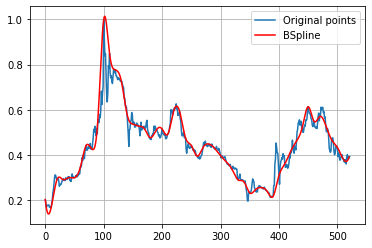

In [ ]:
import scipy.interpolate as interpolate

t_BNGA_55, c_BNGA_55, k_BNGA_55 = interpolate.splrep(BNGA_x55, BNGA_y55, s=0, k=3)
print('''\
t_BNGA_55: {}
c_BNGA_55: {}
k_BNGA_55: {}
'''.format(t_BNGA_55, c_BNGA_55, k_BNGA_55))
N = 522
xmin_BNGA_55, xmax_BNGA_55 = BNGA_x55.min(), BNGA_x55.max()
xx_BNGA_55 = np.linspace(xmin_BNGA_55, xmax_BNGA_55, N)
spline_BNGA_55 = interpolate.BSpline(t_BNGA_55, c_BNGA_55, k_BNGA_55, extrapolate=False)

plt.plot(BNGA_x, BNGA_y, label='Original points')
plt.plot(xx_BNGA_55, spline_BNGA_55(xx_BNGA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BNGA**

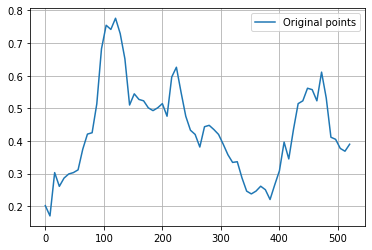

In [ ]:
BNGA_x65 = BNGA_x[0:522:8]
BNGA_y65 = BNGA_y[0:522:8]

plt.plot(BNGA_x65, BNGA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BNGA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BNGA_65: [0.20210507 0.0108845  0.4077039  0.2263375  0.29860059 0.29715343
 0.30646665 0.29592431 0.37930723 0.43526384 0.40594933 0.49251415
 0.706088   0.77576398 0.71733349 0.80422361 0.72084259 0.68457171
 0.45010106 0.57554003 0.5140038  0.53183525 0.49632707 0.49193522
 0.49357357 0.54284926 0.42126402 0.62686167 0.64617774 0.54334615
 0.47242126 0.42173583 0.43821621 0.34582426 0.46744409 0.44627673
 0.43504496 0.42398353 0.38944585 0.35862766 0.32354842 0.35323114
 0.28243882 0.24016125 0.23573694 0.24427451 0.26598577 0.26061833
 0.19608027 0.27956961 0.28019586 0.45138773 0.29322574 0.44605837
 0.53298089 0.50825

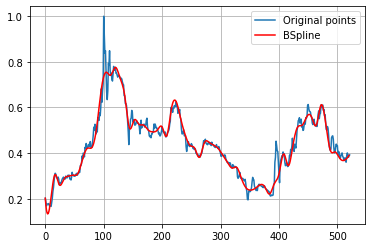

In [ ]:
import scipy.interpolate as interpolate

t_BNGA_65, c_BNGA_65, k_BNGA_65 = interpolate.splrep(BNGA_x65, BNGA_y65, s=0, k=3)
print('''\
t_BNGA_65: {}
c_BNGA_65: {}
k_BNGA_65: {}
'''.format(t_BNGA_65, c_BNGA_65, k_BNGA_65))
N = 522
xmin_BNGA_65, xmax_BNGA_65 = BNGA_x65.min(), BNGA_x65.max()
xx_BNGA_65 = np.linspace(xmin_BNGA_65, xmax_BNGA_65, N)
spline_BNGA_65 = interpolate.BSpline(t_BNGA_65, c_BNGA_65, k_BNGA_65, extrapolate=False)

plt.plot(BNGA_x, BNGA_y, label='Original points')
plt.plot(xx_BNGA_65, spline_BNGA_65(xx_BNGA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BNGA**

In [ ]:
#RMSE 15 DATA BNGA
y_true_BNGA_15 = BNGA_y.tolist()
y_pred_BNGA_15 = spline_BNGA_15(xx_BNGA_15).tolist()
mse_BNGA_15 = mean_squared_error(y_true_BNGA_15, y_pred_BNGA_15)
rmse_BNGA_15 = np.sqrt(mse_BNGA_15)
print("rmse BNGA 15 =",rmse_BNGA_15)

#RMSE 25 DATA BNGA
y_true_BNGA_25 = BNGA_y.tolist()
y_pred_BNGA_25 = spline_BNGA_25(xx_BNGA_25).tolist()
mse_BNGA_25 = mean_squared_error(y_true_BNGA_25, y_pred_BNGA_25)
rmse_BNGA_25 = np.sqrt(mse_BNGA_25)
print("rmse BNGA 25 =",rmse_BNGA_25)

#RMSE 35 DATA BNGA
y_true_BNGA_35 = BNGA_y.tolist()
y_pred_BNGA_35 = spline_BNGA_35(xx_BNGA_35).tolist()
mse_BNGA_35 = mean_squared_error(y_true_BNGA_35, y_pred_BNGA_35)
rmse_BNGA_35 = np.sqrt(mse_BNGA_35)
print("rmse BNGA 35 =",rmse_BNGA_35)

#RMSE 45 DATA BNGA
y_true_BNGA_45 = BNGA_y.tolist()
y_pred_BNGA_45 = spline_BNGA_45(xx_BNGA_45).tolist()
mse_BNGA_45 = mean_squared_error(y_true_BNGA_45, y_pred_BNGA_45)
rmse_BNGA_45 = np.sqrt(mse_BNGA_45)
print("rmse BNGA 45 =",rmse_BNGA_45)

#RMSE 55 DATA BNGA
y_true_BNGA_55 = BNGA_y.tolist()
y_pred_BNGA_55 = spline_BNGA_55(xx_BNGA_55).tolist()
mse_BNGA_55 = mean_squared_error(y_true_BNGA_55, y_pred_BNGA_55)
rmse_BNGA_55 = np.sqrt(mse_BNGA_55)
print("rmse BNGA 55 =",rmse_BNGA_55)

#RMSE 65 DATA BNGA
y_true_BNGA_65 = BNGA_y.tolist()
y_pred_BNGA_65 = spline_BNGA_65(xx_BNGA_65).tolist()
mse_BNGA_65 = mean_squared_error(y_true_BNGA_65, y_pred_BNGA_65)
rmse_BNGA_65 = np.sqrt(mse_BNGA_65)
print("rmse BNGA 65 =",rmse_BNGA_65)


rmse BNGA 15 = 0.08238162216428889
rmse BNGA 25 = 0.061083903398568944
rmse BNGA 35 = 0.052921591714301955
rmse BNGA 45 = 0.03630614993443274
rmse BNGA 55 = 0.04844082823998345
rmse BNGA 65 = 0.03123325578978383


# **BRPT**

No handles with labels found to put in legend.


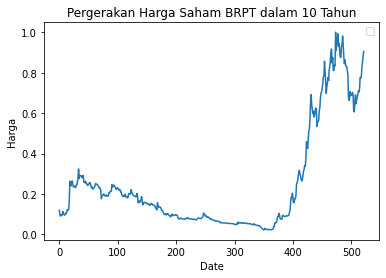

In [ ]:
BRPT = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BRPT.JK.csv')

BRPT_x = BRPT['No'].values
BRPT_y = BRPT['Skala'].values

plt.plot(BRPT_x,BRPT_y)
plt.title('Pergerakan Harga Saham BRPT dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BRPT**

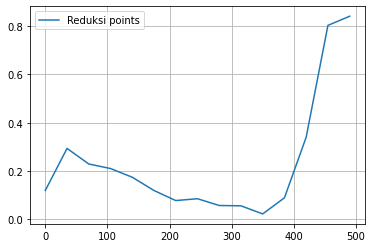

In [ ]:
BRPT_x15 = BRPT_x[0:522:35]
BRPT_y15 = BRPT_y[0:522:35]

plt.plot(BRPT_x15, BRPT_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BRPT_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BRPT_15: [ 1.19318182e-01  3.99672738e-01  2.00654523e-01  2.19851549e-01
  1.76503661e-01  1.19588352e-01  6.10520236e-02  1.02112644e-01
  4.18610393e-02  7.36250311e-02 -1.13389180e-03  6.50014461e-02
  3.45291544e-01  1.13819703e+00  8.40909091e-01  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00]
k_BRPT_15: 3



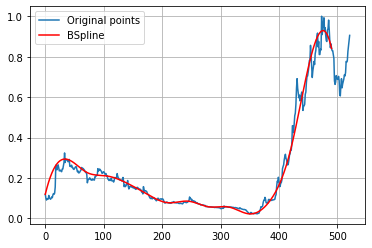

In [ ]:
import scipy.interpolate as interpolate

t_BRPT_15, c_BRPT_15, k_BRPT_15 = interpolate.splrep(BRPT_x15, BRPT_y15, s=0, k=3)
print('''\
t_BRPT_15: {}
c_BRPT_15: {}
k_BRPT_15: {}
'''.format(t_BRPT_15, c_BRPT_15, k_BRPT_15))
N = 522
xmin_BRPT_15, xmax_BRPT_15 = BRPT_x15.min(), BRPT_x15.max()
xx_BRPT_15 = np.linspace(xmin_BRPT_15, xmax_BRPT_15, N)
spline_BRPT_15 = interpolate.BSpline(t_BRPT_15, c_BRPT_15, k_BRPT_15, extrapolate=False)

plt.plot(BRPT_x, BRPT_y, label='Original points')
plt.plot(xx_BRPT_15, spline_BRPT_15(xx_BRPT_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA BRPT**

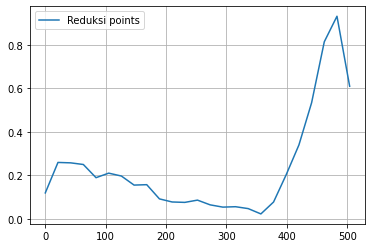

In [ ]:
BRPT_x25 = BRPT_x[0:522:21]
BRPT_y25 = BRPT_y[0:522:21]

plt.plot(BRPT_x25, BRPT_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BRPT_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BRPT_25: [0.11931818 0.3054101  0.23861163 0.27323787 0.15978035 0.22400436
 0.20556585 0.13555042 0.18405064 0.07142882 0.08137043 0.06899855
 0.09718084 0.05932355 0.05188859 0.05698573 0.05539578 0.00438571
 0.06342503 0.20668692 0.33141818 0.50741306 0.95549567 1.02982792
 0.60984848 0.         0.         0.         0.        ]
k_BRPT_25: 3



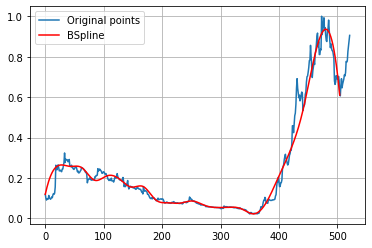

In [ ]:
import scipy.interpolate as interpolate

t_BRPT_25, c_BRPT_25, k_BRPT_25 = interpolate.splrep(BRPT_x25, BRPT_y25, s=0, k=3)
print('''\
t_BRPT_25: {}
c_BRPT_25: {}
k_BRPT_25: {}
'''.format(t_BRPT_25, c_BRPT_25, k_BRPT_25))
N = 522
xmin_BRPT_25, xmax_BRPT_25 = BRPT_x25.min(), BRPT_x25.max()
xx_BRPT_25 = np.linspace(xmin_BRPT_25, xmax_BRPT_25, N)
spline_BRPT_25 = interpolate.BSpline(t_BRPT_25, c_BRPT_25, k_BRPT_25, extrapolate=False)

plt.plot(BRPT_x, BRPT_y, label='Original points')
plt.plot(xx_BRPT_25, spline_BRPT_25(xx_BRPT_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA BRPT**

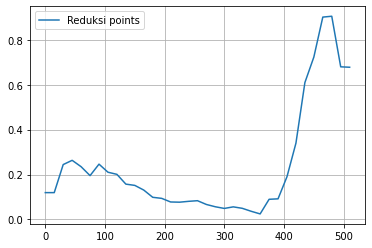

In [ ]:
BRPT_x35 = BRPT_x[0:522:15]
BRPT_y35 = BRPT_y[0:522:15]

plt.plot(BRPT_x35, BRPT_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BRPT_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BRPT_35: [ 0.11931818  0.00797575  0.27950305  0.26445755  0.2459736   0.16073897
  0.28152509  0.19043342  0.21810489  0.14169249  0.15830698  0.13417049
  0.08910197  0.10033073  0.07207512  0.07727788  0.07904062  0.08951417
  0.06290268  0.05773872  0.04364244  0.06087332  0.04809154  0.04335143
 -0.00445182  0.12104674  0.05776485  0.19789387  0.29270513  0.67105832
  0.68215249  0.94124082  0.96888659  0.47957186  0.6780303   0.
  0.          0.          0.        ]
k_BRPT_35: 3



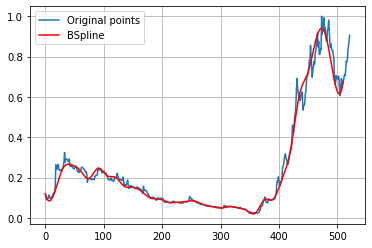

In [ ]:
import scipy.interpolate as interpolate

t_BRPT_35, c_BRPT_35, k_BRPT_35 = interpolate.splrep(BRPT_x35, BRPT_y35, s=0, k=3)
print('''\
t_BRPT_35: {}
c_BRPT_35: {}
k_BRPT_35: {}
'''.format(t_BRPT_35, c_BRPT_35, k_BRPT_35))
N = 522
xmin_BRPT_35, xmax_BRPT_35 = BRPT_x35.min(), BRPT_x35.max()
xx_BRPT_35 = np.linspace(xmin_BRPT_35, xmax_BRPT_35, N)
spline_BRPT_35 = interpolate.BSpline(t_BRPT_35, c_BRPT_35, k_BRPT_35, extrapolate=False)

plt.plot(BRPT_x, BRPT_y, label='Original points')
plt.plot(xx_BRPT_35, spline_BRPT_35(xx_BRPT_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BRPT**

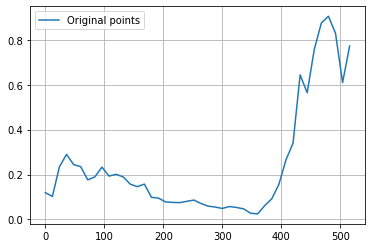

In [ ]:
BRPT_x45 = BRPT_x[0:522:12]
BRPT_y45 = BRPT_y[0:522:12]

plt.plot(BRPT_x45, BRPT_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BRPT_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BRPT_45: [ 1.19318182e-01 -8.44241553e-04  2.33696058e-01  3.15333440e-01
  2.23197201e-01  2.57786849e-01  1.54746313e-01  1.80046082e-01
  2.61432994e-01  1.71949212e-01  2.09861068e-01  1.93151974e-01
  1.53894670e-01  1.34451167e-01  1.83300660e-01  7.55280113e-02
  1.05496383e-01  7.06682785e-02  7.77395933e-02  7.29188044e-02
  7.94488253e-02  9.22404385e-02  6.86348726e-02  5.70836992e-02
  5.75757965e-02  4.32949307e-02  6.24262846e-02  5.13181030e-02
  5.16194854e-02  2.51585015e-02  1.36555986e-02  6.68100122e-02
  8.72861925e-02  1.36317924e-01  3.04942112e-01  2.34822718e-01
  7.95539741e-01  4.46654684e-01  8.04205159e-01  8.81979228e-01
  9.17877929e-01  8.65143671e-01  3.86556952e-01  7.72727273e-01
  0.00000000e+00  

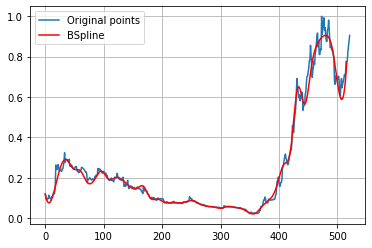

In [ ]:
import scipy.interpolate as interpolate

t_BRPT_45, c_BRPT_45, k_BRPT_45 = interpolate.splrep(BRPT_x45, BRPT_y45, s=0, k=3)
print('''\
t_BRPT_45: {}
c_BRPT_45: {}
k_BRPT_45: {}
'''.format(t_BRPT_45, c_BRPT_45, k_BRPT_45))
N = 522
xmin_BRPT_45, xmax_BRPT_45 = BRPT_x45.min(), BRPT_x45.max()
xx_BRPT_45 = np.linspace(xmin_BRPT_45, xmax_BRPT_45, N)
spline_BRPT_45 = interpolate.BSpline(t_BRPT_45, c_BRPT_45, k_BRPT_45, extrapolate=False)

plt.plot(BRPT_x, BRPT_y, label='Original points')
plt.plot(xx_BRPT_45, spline_BRPT_45(xx_BRPT_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BRPT**

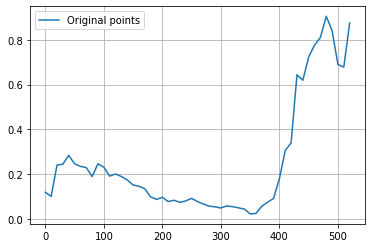

In [ ]:
BRPT_x55 = BRPT_x[0:522:10]
BRPT_y55 = BRPT_y[0:522:10]

plt.plot(BRPT_x55, BRPT_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BRPT_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BRPT_55: [ 0.11931818 -0.04545951  0.31250992  0.21589421  0.31397626  0.23274619
  0.2323117   0.2470979   0.15429669  0.27207898  0.23466011  0.17564421
  0.21049031  0.18693998  0.17811338  0.14606103  0.1467334   0.14200535
  0.09206337  0.08065026  0.10806287  0.06664371  0.09127137  0.06827079
  0.07882726  0.09937469  0.07481032  0.0672931   0.0548809   0.05636515
  0.04352215  0.06272807  0.05442923  0.0479641   0.05030527  0.01672391
  0.01689001  0.06230695  0.07706402  0.07830061  0.15973356  0.36231062
  0.22625124  0.77245714  0.54755655  0.75322573  0.78044961  0.78406674
  0.9469198   0.86007223  0.59097037  0.66947694  0.875       0.
  0.          0.          0.        ]


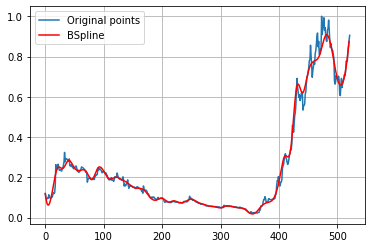

In [ ]:
import scipy.interpolate as interpolate

t_BRPT_55, c_BRPT_55, k_BRPT_55 = interpolate.splrep(BRPT_x55, BRPT_y55, s=0, k=3)
print('''\
t_BRPT_55: {}
c_BRPT_55: {}
k_BRPT_55: {}
'''.format(t_BRPT_55, c_BRPT_55, k_BRPT_55))
N = 522
xmin_BRPT_55, xmax_BRPT_55 = BRPT_x55.min(), BRPT_x55.max()
xx_BRPT_55 = np.linspace(xmin_BRPT_55, xmax_BRPT_55, N)
spline_BRPT_55 = interpolate.BSpline(t_BRPT_55, c_BRPT_55, k_BRPT_55, extrapolate=False)

plt.plot(BRPT_x, BRPT_y, label='Original points')
plt.plot(xx_BRPT_55, spline_BRPT_55(xx_BRPT_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA BRPT**

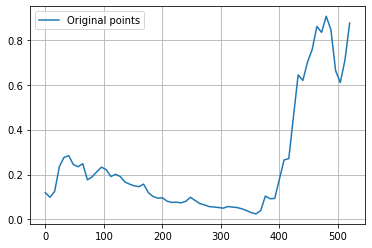

In [ ]:
BRPT_x65 = BRPT_x[0:522:8]
BRPT_y65 = BRPT_y[0:522:8]

plt.plot(BRPT_x65, BRPT_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BRPT_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BRPT_65: [0.11931818 0.11208572 0.04760886 0.25828999 0.27565181 0.29819367
 0.23611895 0.22323962 0.28001348 0.14534283 0.19543338 0.20928729
 0.24014472 0.2278611  0.17795635 0.20804077 0.19442604 0.16198235
 0.15764458 0.15062117 0.13759802 0.17398675 0.10963681 0.1033751
 0.09049914 0.10281015 0.07780571 0.07460337 0.07832625 0.07231888
 0.07558005 0.10831546 0.08206719 0.0690976  0.06540604 0.05564187
 0.0552083  0.05420673 0.04614659 0.0612069  0.05334399 0.05382624
 0.04726012 0.04008782 0.02875223 0.02444872 0.0200438  0.12946699
 0.08708824 0.07445275 0.17646442 0.29923502 0.2175046  0.45574657
 0.70950912 0.569853

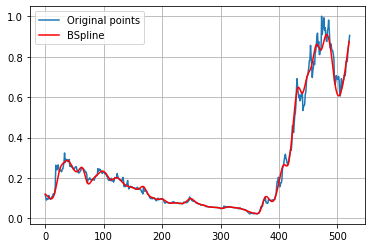

In [ ]:
import scipy.interpolate as interpolate

t_BRPT_65, c_BRPT_65, k_BRPT_65 = interpolate.splrep(BRPT_x65, BRPT_y65, s=0, k=3)
print('''\
t_BRPT_65: {}
c_BRPT_65: {}
k_BRPT_65: {}
'''.format(t_BRPT_65, c_BRPT_65, k_BRPT_65))
N = 522
xmin_BRPT_65, xmax_BRPT_65 = BRPT_x65.min(), BRPT_x65.max()
xx_BRPT_65 = np.linspace(xmin_BRPT_65, xmax_BRPT_65, N)
spline_BRPT_65 = interpolate.BSpline(t_BRPT_65, c_BRPT_65, k_BRPT_65, extrapolate=False)

plt.plot(BRPT_x, BRPT_y, label='Original points')
plt.plot(xx_BRPT_65, spline_BRPT_65(xx_BRPT_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BRPT**

In [ ]:

#RMSE 15 DATA BRPT
y_true_BRPT_15 = BRPT_y.tolist()
y_pred_BRPT_15 = spline_BRPT_15(xx_BRPT_15).tolist()
mse_BRPT_15 = mean_squared_error(y_true_BRPT_15, y_pred_BRPT_15)
rmse_BRPT_15 = np.sqrt(mse_BRPT_15)
print("rmse BRPT 15 =",rmse_BRPT_15)

#RMSE 25 DATA BRPT
y_true_BRPT_25 = BRPT_y.tolist()
y_pred_BRPT_25 = spline_BRPT_25(xx_BRPT_25).tolist()
mse_BRPT_25 = mean_squared_error(y_true_BRPT_25, y_pred_BRPT_25)
rmse_BRPT_25 = np.sqrt(mse_BRPT_25)
print("rmse BRPT 25 =",rmse_BRPT_25)

#RMSE 35 DATA BRPT
y_true_BRPT_35 = BRPT_y.tolist()
y_pred_BRPT_35 = spline_BRPT_35(xx_BRPT_35).tolist()
mse_BRPT_35 = mean_squared_error(y_true_BRPT_35, y_pred_BRPT_35)
rmse_BRPT_35 = np.sqrt(mse_BRPT_35)
print("rmse BRPT 35 =",rmse_BRPT_35)

#RMSE 45 DATA BRPT
y_true_BRPT_45 = BRPT_y.tolist()
y_pred_BRPT_45 = spline_BRPT_45(xx_BRPT_45).tolist()
mse_BRPT_45 = mean_squared_error(y_true_BRPT_45, y_pred_BRPT_45)
rmse_BRPT_45 = np.sqrt(mse_BRPT_45)
print("rmse BRPT 45 =",rmse_BRPT_45)

#RMSE 55 DATA BRPT
y_true_BRPT_55 = BRPT_y.tolist()
y_pred_BRPT_55 = spline_BRPT_55(xx_BRPT_55).tolist()
mse_BRPT_55 = mean_squared_error(y_true_BRPT_55, y_pred_BRPT_55)
rmse_BRPT_55 = np.sqrt(mse_BRPT_55)
print("rmse BRPT 55 =",rmse_BRPT_55)

#RMSE 65 DATA BRPT
y_true_BRPT_65 = BRPT_y.tolist()
y_pred_BRPT_65 = spline_BRPT_65(xx_BRPT_65).tolist()
mse_BRPT_65 = mean_squared_error(y_true_BRPT_65, y_pred_BRPT_65)
rmse_BRPT_65 = np.sqrt(mse_BRPT_65)
print("rmse BRPT 65 =",rmse_BRPT_65)

rmse BRPT 15 = 0.12391757409816652
rmse BRPT 25 = 0.0920831488856431
rmse BRPT 35 = 0.05604687958393853
rmse BRPT 45 = 0.043060203448904086
rmse BRPT 55 = 0.025250071947007124
rmse BRPT 65 = 0.0252667016231859


# **BSDE**

No handles with labels found to put in legend.


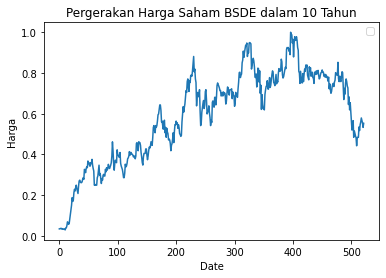

In [ ]:
BSDE = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BSDE.JK.csv')

BSDE_x = BSDE['No'].values
BSDE_y = BSDE['Skala'].values

plt.plot(BSDE_x,BSDE_y)
plt.title('Pergerakan Harga Saham BSDE dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BSDE**

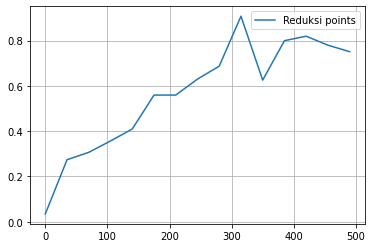

In [ ]:
BSDE_x15 = BSDE_x[0:522:35]
BSDE_y15 = BSDE_y[0:522:35]

plt.plot(BSDE_x15, BSDE_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BSDE_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BSDE_15: [0.03475621 0.33090869 0.26331155 0.37086125 0.36732518 0.61798781
 0.51755178 0.66863328 0.58765079 1.1041116  0.44083674 0.88584539
 0.78890287 0.77239878 0.75110132 0.         0.         0.
 0.        ]
k_BSDE_15: 3



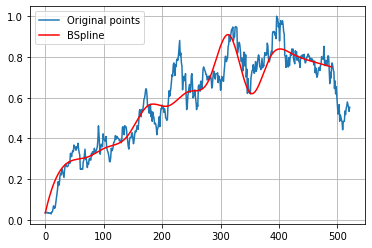

In [ ]:
import scipy.interpolate as interpolate

t_BSDE_15, c_BSDE_15, k_BSDE_15 = interpolate.splrep(BSDE_x15, BSDE_y15, s=0, k=3)
print('''\
t_BSDE_15: {}
c_BSDE_15: {}
k_BSDE_15: {}
'''.format(t_BSDE_15, c_BSDE_15, k_BSDE_15))
N = 522
xmin_BSDE_15, xmax_BSDE_15 = BSDE_x15.min(), BSDE_x15.max()
xx_BSDE_15 = np.linspace(xmin_BSDE_15, xmax_BSDE_15, N)
spline_BSDE_15 = interpolate.BSpline(t_BSDE_15, c_BSDE_15, k_BSDE_15, extrapolate=False)

plt.plot(BSDE_x, BSDE_y, label='Original points')
plt.plot(xx_BSDE_15, spline_BSDE_15(xx_BSDE_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA BSDE**

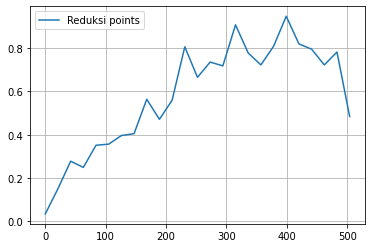

In [ ]:
BSDE_x25 = BSDE_x[0:522:21]
BSDE_y25 = BSDE_y[0:522:21]

plt.plot(BSDE_x25, BSDE_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BSDE_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BSDE_25: [0.03475621 0.03522709 0.37830958 0.19188968 0.39729785 0.32882551
 0.42836928 0.33655201 0.65714076 0.41814485 0.49847368 0.94478863
 0.55937619 0.80889604 0.61913658 1.02292769 0.73408657 0.70592426
 0.77701816 1.03622337 0.76090776 0.83644516 0.60683392 0.95869758
 0.4845815  0.         0.         0.         0.        ]
k_BSDE_25: 3



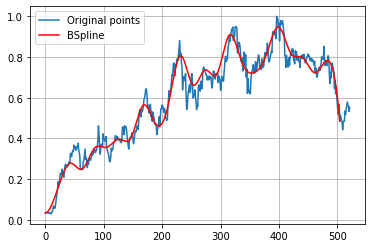

In [ ]:
import scipy.interpolate as interpolate

t_BSDE_25, c_BSDE_25, k_BSDE_25 = interpolate.splrep(BSDE_x25, BSDE_y25, s=0, k=3)
print('''\
t_BSDE_25: {}
c_BSDE_25: {}
k_BSDE_25: {}
'''.format(t_BSDE_25, c_BSDE_25, k_BSDE_25))
N = 522
xmin_BSDE_25, xmax_BSDE_25 = BSDE_x25.min(), BSDE_x25.max()
xx_BSDE_25 = np.linspace(xmin_BSDE_25, xmax_BSDE_25, N)
spline_BSDE_25 = interpolate.BSpline(t_BSDE_25, c_BSDE_25, k_BSDE_25, extrapolate=False)

plt.plot(BSDE_x, BSDE_y, label='Original points')
plt.plot(xx_BSDE_25, spline_BSDE_25(xx_BSDE_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA BSDE**

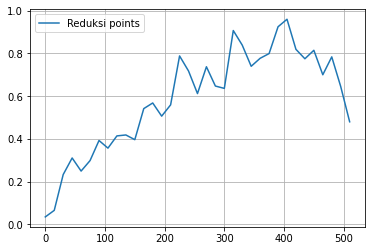

In [ ]:
BSDE_x35 = BSDE_x[0:522:15]
BSDE_y35 = BSDE_y[0:522:15]

plt.plot(BSDE_x35, BSDE_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BSDE_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BSDE_35: [ 0.03475621 -0.04565197  0.21908376  0.34929047  0.21577003  0.2841906
  0.43843315  0.31732     0.43325599  0.43423752  0.34080714  0.58138854
  0.58474002  0.489343    0.49753557  0.87734292  0.72437028  0.53354601
  0.8154545   0.63194876  0.54221302  1.01858242  0.82839122  0.70309498
  0.79975749  0.7630733   0.94530615  1.00636291  0.79135674  0.74450969
  0.88258689  0.6150106   0.94168162  0.50382879  0.48017621  0.
  0.          0.          0.        ]
k_BSDE_35: 3



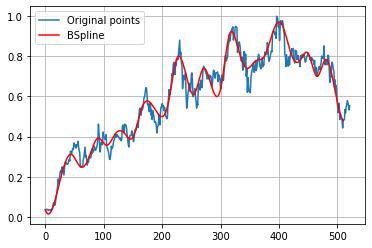

In [ ]:
import scipy.interpolate as interpolate

t_BSDE_35, c_BSDE_35, k_BSDE_35 = interpolate.splrep(BSDE_x35, BSDE_y35, s=0, k=3)
print('''\
t_BSDE_35: {}
c_BSDE_35: {}
k_BSDE_35: {}
'''.format(t_BSDE_35, c_BSDE_35, k_BSDE_35))
N = 522
xmin_BSDE_35, xmax_BSDE_35 = BSDE_x35.min(), BSDE_x35.max()
xx_BSDE_35 = np.linspace(xmin_BSDE_35, xmax_BSDE_35, N)
spline_BSDE_35 = interpolate.BSpline(t_BSDE_35, c_BSDE_35, k_BSDE_35, extrapolate=False)

plt.plot(BSDE_x, BSDE_y, label='Original points')
plt.plot(xx_BSDE_35, spline_BSDE_35(xx_BSDE_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BSDE**

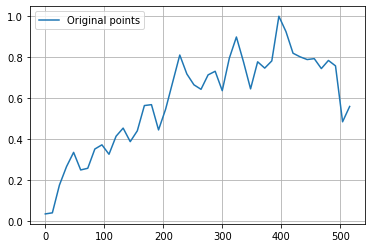

In [ ]:
BSDE_x45 = BSDE_x[0:522:12]
BSDE_y45 = BSDE_y[0:522:12]

plt.plot(BSDE_x45, BSDE_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BSDE_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BSDE_45: [ 0.03475621 -0.06078797  0.17657245  0.25345189  0.38509713  0.2179305
  0.23974202  0.36873048  0.39524262  0.28287258  0.42921421  0.48485208
  0.35384442  0.42576142  0.58628171  0.61237165  0.37392331  0.56153863
  0.65745521  0.87912513  0.68948041  0.67132327  0.61641592  0.72204388
  0.77734689  0.55623375  0.81710137  0.94628588  0.78982558  0.55961003
  0.84398098  0.7296643   0.71753804  1.09181351  0.91520793  0.79801556
  0.8090294   0.77643954  0.81648998  0.71530981  0.78923114  0.84707156
  0.21633206  0.55947137  0.          0.          0.          0.        ]
k_BSDE_45: 3



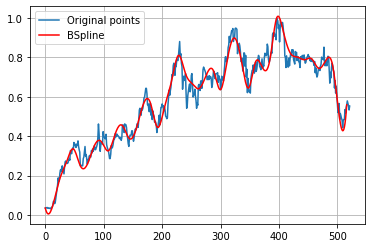

In [ ]:
import scipy.interpolate as interpolate

t_BSDE_45, c_BSDE_45, k_BSDE_45 = interpolate.splrep(BSDE_x45, BSDE_y45, s=0, k=3)
print('''\
t_BSDE_45: {}
c_BSDE_45: {}
k_BSDE_45: {}
'''.format(t_BSDE_45, c_BSDE_45, k_BSDE_45))
N = 522
xmin_BSDE_45, xmax_BSDE_45 = BSDE_x45.min(), BSDE_x45.max()
xx_BSDE_45 = np.linspace(xmin_BSDE_45, xmax_BSDE_45, N)
spline_BSDE_45 = interpolate.BSpline(t_BSDE_45, c_BSDE_45, k_BSDE_45, extrapolate=False)

plt.plot(BSDE_x, BSDE_y, label='Original points')
plt.plot(xx_BSDE_45, spline_BSDE_45(xx_BSDE_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BSDE**

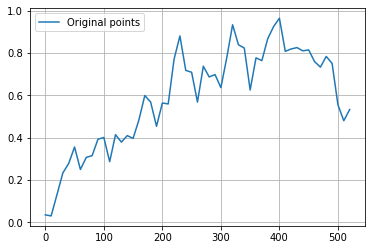

In [ ]:
BSDE_x55 = BSDE_x[0:522:10]
BSDE_y55 = BSDE_y[0:522:10]

plt.plot(BSDE_x55, BSDE_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BSDE_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BSDE_55: [ 0.03475621 -0.02529919  0.08719464  0.25564876  0.2465223   0.42655808
  0.181686    0.3432591   0.28531108  0.40459795  0.45154032  0.19452713
  0.48841285  0.33640295  0.43910309  0.36533446  0.47841369  0.62849976
  0.60230094  0.37198813  0.63221351  0.48241776  0.79494367  0.96335823
  0.63796703  0.79314371  0.44496474  0.83668895  0.63559224  0.74429012
  0.57667458  0.76839482  1.01494439  0.77535184  0.91889055  0.49181724
  0.86714444  0.70480324  0.89954567  0.90406253  1.03486499  0.74502377
  0.83526019  0.83023503  0.79974681  0.83421383  0.75326571  0.7121947
  0.79883656  0.79730487  0.42563425  0.47550887  0.53303965  0.
  0.          0.          0.        ]
k

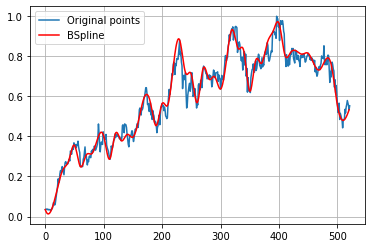

In [ ]:
import scipy.interpolate as interpolate

t_BSDE_55, c_BSDE_55, k_BSDE_55 = interpolate.splrep(BSDE_x55, BSDE_y55, s=0, k=3)
print('''\
t_BSDE_55: {}
c_BSDE_55: {}
k_BSDE_55: {}
'''.format(t_BSDE_55, c_BSDE_55, k_BSDE_55))
N = 522
xmin_BSDE_55, xmax_BSDE_55 = BSDE_x55.min(), BSDE_x55.max()
xx_BSDE_55 = np.linspace(xmin_BSDE_55, xmax_BSDE_55, N)
spline_BSDE_55 = interpolate.BSpline(t_BSDE_55, c_BSDE_55, k_BSDE_55, extrapolate=False)

plt.plot(BSDE_x, BSDE_y, label='Original points')
plt.plot(xx_BSDE_55, spline_BSDE_55(xx_BSDE_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BSDE**

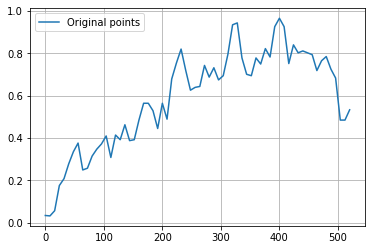

In [ ]:
BSDE_x65 = BSDE_x[0:522:8]
BSDE_y65 = BSDE_y[0:522:8]

plt.plot(BSDE_x65, BSDE_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BSDE_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BSDE_65: [ 0.03475621  0.05996152 -0.03507697  0.21021057  0.18786609  0.28954707
  0.32224163  0.4332573   0.20183671  0.25595704  0.31996422  0.35328745
  0.35225867  0.47025138  0.22488558  0.48042656  0.33798969  0.5200376
  0.35719031  0.37719235  0.48646319  0.58444388  0.55902122  0.56273118
  0.36186025  0.65943135  0.38367427  0.73979229  0.72764115  0.86946688
  0.71079087  0.59573969  0.65955434  0.59864207  0.80490823  0.6354695
  0.7765618   0.64594852  0.683697    0.78225908  0.95819179  0.98849798
  0.74420395  0.69988448  0.65890132  0.82750583  0.69627358  0.8807919
  0.71007424  0.9705411   0.95842214  0.9

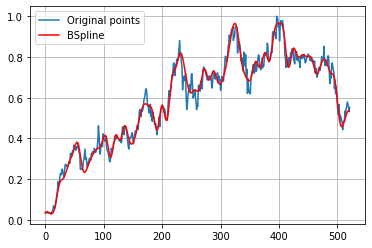

In [ ]:
import scipy.interpolate as interpolate

t_BSDE_65, c_BSDE_65, k_BSDE_65 = interpolate.splrep(BSDE_x65, BSDE_y65, s=0, k=3)
print('''\
t_BSDE_65: {}
c_BSDE_65: {}
k_BSDE_65: {}
'''.format(t_BSDE_65, c_BSDE_65, k_BSDE_65))
N = 522
xmin_BSDE_65, xmax_BSDE_65 = BSDE_x65.min(), BSDE_x65.max()
xx_BSDE_65 = np.linspace(xmin_BSDE_65, xmax_BSDE_65, N)
spline_BSDE_65 = interpolate.BSpline(t_BSDE_65, c_BSDE_65, k_BSDE_65, extrapolate=False)

plt.plot(BSDE_x, BSDE_y, label='Original points')
plt.plot(xx_BSDE_65, spline_BSDE_65(xx_BSDE_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BSDE**

In [ ]:

#RMSE 15 DATA BSDE
y_true_BSDE_15 = BSDE_y.tolist()
y_pred_BSDE_15 = spline_BSDE_15(xx_BSDE_15).tolist()
mse_BSDE_15 = mean_squared_error(y_true_BSDE_15, y_pred_BSDE_15)
rmse_BSDE_15 = np.sqrt(mse_BSDE_15)
print("rmse BSDE 15 =",rmse_BSDE_15)

#RMSE 25 DATA BSDE
y_true_BSDE_25 = BSDE_y.tolist()
y_pred_BSDE_25 = spline_BSDE_25(xx_BSDE_25).tolist()
mse_BSDE_25 = mean_squared_error(y_true_BSDE_25, y_pred_BSDE_25)
rmse_BSDE_25 = np.sqrt(mse_BSDE_25)
print("rmse BSDE 25 =",rmse_BSDE_25)

#RMSE 35 DATA BSDE
y_true_BSDE_35 = BSDE_y.tolist()
y_pred_BSDE_35 = spline_BSDE_35(xx_BSDE_35).tolist()
mse_BSDE_35 = mean_squared_error(y_true_BSDE_35, y_pred_BSDE_35)
rmse_BSDE_35 = np.sqrt(mse_BSDE_35)
print("rmse BSDE 35 =",rmse_BSDE_35)

#RMSE 45 DATA BSDE
y_true_BSDE_45 = BSDE_y.tolist()
y_pred_BSDE_45 = spline_BSDE_45(xx_BSDE_45).tolist()
mse_BSDE_45 = mean_squared_error(y_true_BSDE_45, y_pred_BSDE_45)
rmse_BSDE_45 = np.sqrt(mse_BSDE_45)
print("rmse BSDE 45 =",rmse_BSDE_45)

#RMSE 55 DATA BSDE
y_true_BSDE_55 = BSDE_y.tolist()
y_pred_BSDE_55 = spline_BSDE_55(xx_BSDE_55).tolist()
mse_BSDE_55 = mean_squared_error(y_true_BSDE_55, y_pred_BSDE_55)
rmse_BSDE_55 = np.sqrt(mse_BSDE_55)
print("rmse BSDE 55 =",rmse_BSDE_55)

#RMSE 65 DATA BSDE
y_true_BSDE_65 = BSDE_y.tolist()
y_pred_BSDE_65 = spline_BSDE_65(xx_BSDE_65).tolist()
mse_BSDE_65 = mean_squared_error(y_true_BSDE_65, y_pred_BSDE_65)
rmse_BSDE_65 = np.sqrt(mse_BSDE_65)
print("rmse BSDE 65 =",rmse_BSDE_65)

rmse BSDE 15 = 0.10156359519280192
rmse BSDE 25 = 0.07652360219280219
rmse BSDE 35 = 0.06188015467858549
rmse BSDE 45 = 0.051657363798208095
rmse BSDE 55 = 0.039950633070172506
rmse BSDE 65 = 0.03516396488761019


# **BTPN**

No handles with labels found to put in legend.


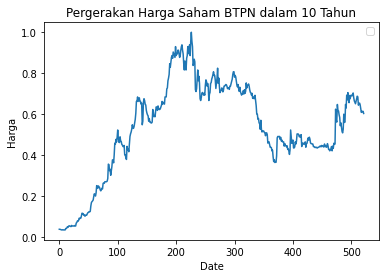

In [ ]:
BTPN = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BTPN.JK.csv')

BTPN_x = BTPN['No'].values
BTPN_y = BTPN['Skala'].values

plt.plot(BTPN_x,BTPN_y)
plt.title('Pergerakan Harga Saham BTPN dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BTPN**

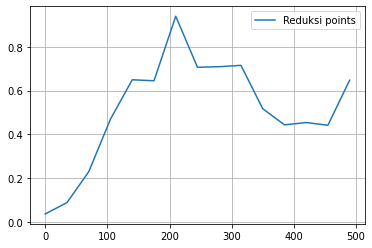

In [ ]:
BTPN_x15 = BTPN_x[0:522:35]
BTPN_y15 = BTPN_y[0:522:35]

plt.plot(BTPN_x15, BTPN_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BTPN_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BTPN_15: [0.0381579  0.05116601 0.12263993 0.47015534 0.7309125  0.50093149
 1.1337826  0.59551706 0.72099127 0.77314943 0.47588468 0.428575
 0.48777261 0.36488562 0.64736842 0.         0.         0.
 0.        ]
k_BTPN_15: 3



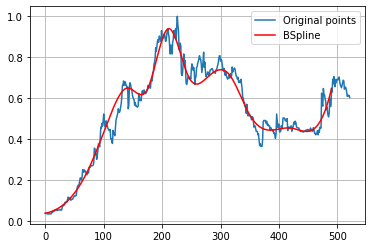

In [ ]:
import scipy.interpolate as interpolate

t_BTPN_15, c_BTPN_15, k_BTPN_15 = interpolate.splrep(BTPN_x15, BTPN_y15, s=0, k=3)
print('''\
t_BTPN_15: {}
c_BTPN_15: {}
k_BTPN_15: {}
'''.format(t_BTPN_15, c_BTPN_15, k_BTPN_15))
N = 522
xmin_BTPN_15, xmax_BTPN_15 = BTPN_x15.min(), BTPN_x15.max()
xx_BTPN_15 = np.linspace(xmin_BTPN_15, xmax_BTPN_15, N)
spline_BTPN_15 = interpolate.BSpline(t_BTPN_15, c_BTPN_15, k_BTPN_15, extrapolate=False)

plt.plot(BTPN_x, BTPN_y, label='Original points')
plt.plot(xx_BTPN_15, spline_BTPN_15(xx_BTPN_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BTPN**

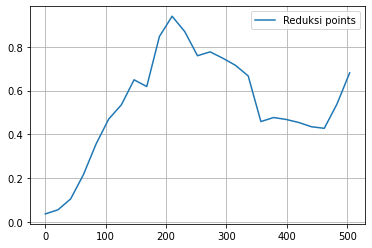

In [ ]:
BTPN_x25 = BTPN_x[0:522:21]
BTPN_y25 = BTPN_y[0:522:21]

plt.plot(BTPN_x25, BTPN_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BTPN_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BTPN_25: [0.0381579  0.05014562 0.05504288 0.21111876 0.35883151 0.4903973
 0.50063194 0.71760127 0.52369981 0.89812579 0.96274441 0.88247552
 0.71787981 0.79863681 0.7454677  0.70370293 0.72919425 0.37952005
 0.50535712 0.46220936 0.45633177 0.43877936 0.385843   0.6070785
 0.68070175 0.         0.         0.         0.        ]
k_BTPN_25: 3



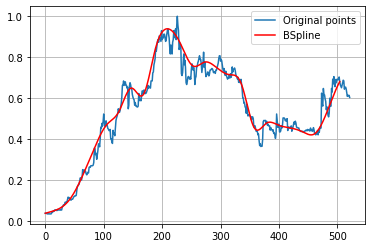

In [ ]:
import scipy.interpolate as interpolate

t_BTPN_25, c_BTPN_25, k_BTPN_25 = interpolate.splrep(BTPN_x25, BTPN_y25, s=0, k=3)
print('''\
t_BTPN_25: {}
c_BTPN_25: {}
k_BTPN_25: {}
'''.format(t_BTPN_25, c_BTPN_25, k_BTPN_25))
N = 522
xmin_BTPN_25, xmax_BTPN_25 = BTPN_x25.min(), BTPN_x25.max()
xx_BTPN_25 = np.linspace(xmin_BTPN_25, xmax_BTPN_25, N)
spline_BTPN_25 = interpolate.BSpline(t_BTPN_25, c_BTPN_25, k_BTPN_25, extrapolate=False)

plt.plot(BTPN_x, BTPN_y, label='Original points')
plt.plot(xx_BTPN_25, spline_BTPN_25(xx_BTPN_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA BTPN**

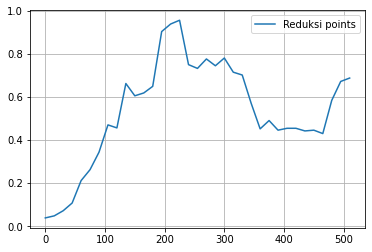

In [ ]:
BTPN_x35 = BTPN_x[0:522:15]
BTPN_y35 = BTPN_y[0:522:15]

plt.plot(BTPN_x35, BTPN_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BTPN_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BTPN_35: [0.0381579  0.03205058 0.07183638 0.08422707 0.23207135 0.25623494
 0.31699948 0.53629347 0.35887927 0.76503155 0.55467875 0.64783239
 0.56451801 0.98883242 0.90120493 1.03792681 0.68392995 0.72635341
 0.80539326 0.70996829 0.82315464 0.68162369 0.73982428 0.56960552
 0.40280627 0.5296957  0.42051617 0.46192382 0.45810432 0.43197468
 0.46662855 0.37519535 0.69031811 0.68071814 0.6877193  0.
 0.         0.         0.        ]
k_BTPN_35: 3



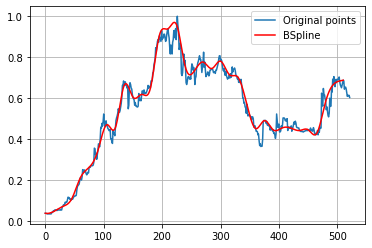

In [ ]:
import scipy.interpolate as interpolate

t_BTPN_35, c_BTPN_35, k_BTPN_35 = interpolate.splrep(BTPN_x35, BTPN_y35, s=0, k=3)
print('''\
t_BTPN_35: {}
c_BTPN_35: {}
k_BTPN_35: {}
'''.format(t_BTPN_35, c_BTPN_35, k_BTPN_35))
N = 522
xmin_BTPN_35, xmax_BTPN_35 = BTPN_x35.min(), BTPN_x35.max()
xx_BTPN_35 = np.linspace(xmin_BTPN_35, xmax_BTPN_35, N)
spline_BTPN_35 = interpolate.BSpline(t_BTPN_35, c_BTPN_35, k_BTPN_35, extrapolate=False)

plt.plot(BTPN_x, BTPN_y, label='Original points')
plt.plot(xx_BTPN_35, spline_BTPN_35(xx_BTPN_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA BTPN**

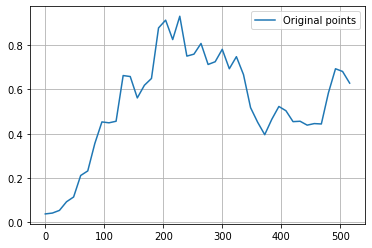

In [ ]:
BTPN_x45 = BTPN_x[0:522:12]
BTPN_y45 = BTPN_y[0:522:12]

plt.plot(BTPN_x45, BTPN_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BTPN_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BTPN_45: [0.0381579  0.04954396 0.02269936 0.10782414 0.08278081 0.24789371
 0.1943918  0.36729698 0.47326239 0.4584009  0.38787087 0.72695774
 0.6779824  0.5084811  0.65651427 0.57598813 0.93427003 0.95008963
 0.73905564 1.04105622 0.67566686 0.75627634 0.85185934 0.67839154
 0.70825869 0.83594213 0.63218333 0.79321928 0.67915008 0.49018042
 0.4653914  0.35878029 0.47317164 0.53800683 0.51164313 0.43647328
 0.46877953 0.4252507  0.46179662 0.40124704 0.59637311 0.75924054
 0.65152008 0.62807017 0.         0.         0.         0.        ]
k_BTPN_45: 3



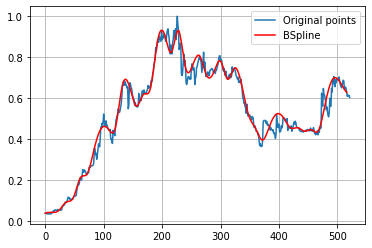

In [ ]:
import scipy.interpolate as interpolate

t_BTPN_45, c_BTPN_45, k_BTPN_45 = interpolate.splrep(BTPN_x45, BTPN_y45, s=0, k=3)
print('''\
t_BTPN_45: {}
c_BTPN_45: {}
k_BTPN_45: {}
'''.format(t_BTPN_45, c_BTPN_45, k_BTPN_45))
N = 522
xmin_BTPN_45, xmax_BTPN_45 = BTPN_x45.min(), BTPN_x45.max()
xx_BTPN_45 = np.linspace(xmin_BTPN_45, xmax_BTPN_45, N)
spline_BTPN_45 = interpolate.BSpline(t_BTPN_45, c_BTPN_45, k_BTPN_45, extrapolate=False)

plt.plot(BTPN_x, BTPN_y, label='Original points')
plt.plot(xx_BTPN_45, spline_BTPN_45(xx_BTPN_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BTPN**


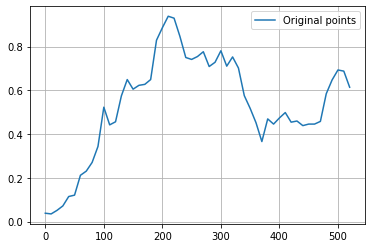

In [ ]:
BTPN_x55 = BTPN_x[0:522:10]
BTPN_y55 = BTPN_y[0:522:10]

plt.plot(BTPN_x55, BTPN_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BTPN_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BTPN_55: [0.0381579  0.02176157 0.05171265 0.06014367 0.13488074 0.08717446
 0.24142038 0.21589144 0.27823497 0.29287393 0.61079562 0.4007857
 0.43869316 0.58128375 0.68354025 0.57929208 0.63087036 0.63406859
 0.59601317 0.87661558 0.87120871 0.95433906 0.943014   0.8525523
 0.72572418 0.74455097 0.74344034 0.80800344 0.68244062 0.71486564
 0.82651785 0.66327348 0.78354614 0.71833145 0.55365438 0.5196826
 0.47287836 0.29933027 0.5245374  0.41830961 0.47590838 0.52016214
 0.43291676 0.47448662 0.42703151 0.44896629 0.45078755 0.42156771
 0.61031003 0.64245534 0.72462042 0.686374   0.61403509 0.
 0.         0.         0.        ]
k_BTPN_55: 3



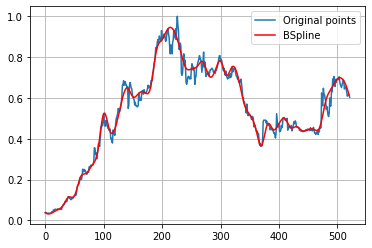

In [ ]:

import scipy.interpolate as interpolate

t_BTPN_55, c_BTPN_55, k_BTPN_55 = interpolate.splrep(BTPN_x55, BTPN_y55, s=0, k=3)
print('''\
t_BTPN_55: {}
c_BTPN_55: {}
k_BTPN_55: {}
'''.format(t_BTPN_55, c_BTPN_55, k_BTPN_55))
N = 522
xmin_BTPN_55, xmax_BTPN_55 = BTPN_x55.min(), BTPN_x55.max()
xx_BTPN_55 = np.linspace(xmin_BTPN_55, xmax_BTPN_55, N)
spline_BTPN_55 = interpolate.BSpline(t_BTPN_55, c_BTPN_55, k_BTPN_55, extrapolate=False)

plt.plot(BTPN_x, BTPN_y, label='Original points')
plt.plot(xx_BTPN_55, spline_BTPN_55(xx_BTPN_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BTPN**

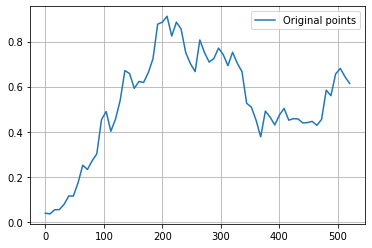

In [ ]:

BTPN_x65 = BTPN_x[0:522:8]
BTPN_y65 = BTPN_y[0:522:8]

plt.plot(BTPN_x65, BTPN_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BTPN_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BTPN_65: [0.0381579  0.01493745 0.06424791 0.04820416 0.07128849 0.1293061
 0.09832817 0.16422229 0.28458371 0.20467446 0.28947635 0.25912538
 0.48376241 0.52457239 0.35479012 0.46679343 0.51487827 0.71053559
 0.66929517 0.55965214 0.64472784 0.5982786  0.67268407 0.68466933
 0.93074388 0.85551303 0.96299345 0.76619738 0.91958547 0.87125021
 0.72699264 0.72077923 0.60041677 0.87755368 0.73147377 0.70181441
 0.71390018 0.7899533  0.75260243 0.65226857 0.79621803 0.67864877
 0.71023952 0.48039314 0.52608264 0.46790786 0.31281223 0.54400112
 0.45855172 0.41126569 0.47533289 0.52950801 0.42768769 0.46500437
 0.45966324 0.433184

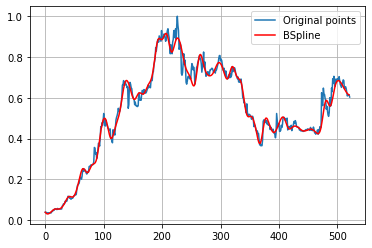

In [ ]:
import scipy.interpolate as interpolate

t_BTPN_65, c_BTPN_65, k_BTPN_65 = interpolate.splrep(BTPN_x65, BTPN_y65, s=0, k=3)
print('''\
t_BTPN_65: {}
c_BTPN_65: {}
k_BTPN_65: {}
'''.format(t_BTPN_65, c_BTPN_65, k_BTPN_65))
N = 522
xmin_BTPN_65, xmax_BTPN_65 = BTPN_x65.min(), BTPN_x65.max()
xx_BTPN_65 = np.linspace(xmin_BTPN_65, xmax_BTPN_65, N)
spline_BTPN_65 = interpolate.BSpline(t_BTPN_65, c_BTPN_65, k_BTPN_65, extrapolate=False)

plt.plot(BTPN_x, BTPN_y, label='Original points')
plt.plot(xx_BTPN_65, spline_BTPN_65(xx_BTPN_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BTPN**

In [ ]:

#RMSE 15 DATA BTPN
y_true_BTPN_15 = BTPN_y.tolist()
y_pred_BTPN_15 = spline_BTPN_15(xx_BTPN_15).tolist()
mse_BTPN_15 = mean_squared_error(y_true_BTPN_15, y_pred_BTPN_15)
rmse_BTPN_15 = np.sqrt(mse_BTPN_15)
print("rmse BTPN 15 =",rmse_BTPN_15)

#RMSE 25 DATA BTPN
y_true_BTPN_25 = BTPN_y.tolist()
y_pred_BTPN_25 = spline_BTPN_25(xx_BTPN_25).tolist()
mse_BTPN_25 = mean_squared_error(y_true_BTPN_25, y_pred_BTPN_25)
rmse_BTPN_25 = np.sqrt(mse_BTPN_25)
print("rmse BTPN 25 =",rmse_BTPN_25)

#RMSE 35 DATA BTPN
y_true_BTPN_35 = BTPN_y.tolist()
y_pred_BTPN_35 = spline_BTPN_35(xx_BTPN_35).tolist()
mse_BTPN_35 = mean_squared_error(y_true_BTPN_35, y_pred_BTPN_35)
rmse_BTPN_35 = np.sqrt(mse_BTPN_35)
print("rmse BTPN 35 =",rmse_BTPN_35)

#RMSE 45 DATA BTPN
y_true_BTPN_45 = BTPN_y.tolist()
y_pred_BTPN_45 = spline_BTPN_45(xx_BTPN_45).tolist()
mse_BTPN_45 = mean_squared_error(y_true_BTPN_45, y_pred_BTPN_45)
rmse_BTPN_45 = np.sqrt(mse_BTPN_45)
print("rmse BTPN 45 =",rmse_BTPN_45)

#RMSE 55 DATA BTPN
y_true_BTPN_55 = BTPN_y.tolist()
y_pred_BTPN_55 = spline_BTPN_55(xx_BTPN_55).tolist()
mse_BTPN_55 = mean_squared_error(y_true_BTPN_55, y_pred_BTPN_55)
rmse_BTPN_55 = np.sqrt(mse_BTPN_55)
print("rmse BTPN 55 =",rmse_BTPN_55)

#RMSE 65 DATA BTPN
y_true_BTPN_65 = BTPN_y.tolist()
y_pred_BTPN_65 = spline_BTPN_65(xx_BTPN_65).tolist()
mse_BTPN_65 = mean_squared_error(y_true_BTPN_65, y_pred_BTPN_65)
rmse_BTPN_65 = np.sqrt(mse_BTPN_65)
print("rmse BTPN 65 =",rmse_BTPN_65)

rmse BTPN 15 = 0.07967751634957644
rmse BTPN 25 = 0.06340079006649307
rmse BTPN 35 = 0.050013289540197244
rmse BTPN 45 = 0.040225514558148816
rmse BTPN 55 = 0.03189089808915332
rmse BTPN 65 = 0.030141676640597626


# **BUMI**

No handles with labels found to put in legend.


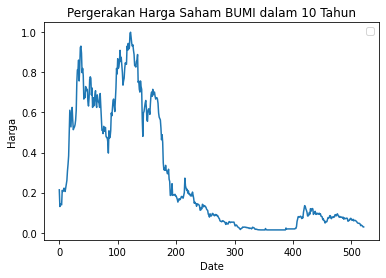

In [ ]:
BUMI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/BUMI.JK.csv')

BUMI_x = BUMI['No'].values
BUMI_y = BUMI['Skala'].values

plt.plot(BUMI_x,BUMI_y)
plt.title('Pergerakan Harga Saham BUMI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA BUMI**

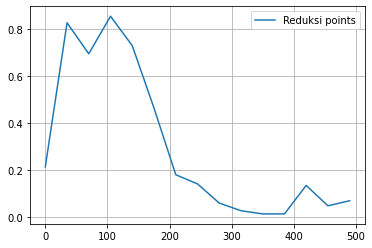

In [ ]:
BUMI_x15 = BUMI_x[0:522:35]
BUMI_y15 = BUMI_y[0:522:35]

plt.plot(BUMI_x15, BUMI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BUMI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_BUMI_15: [ 0.21388889  1.20859121  0.43420648  0.95679214  0.73297856  0.48629361
  0.10518032  0.17631843  0.03954594  0.02549779  0.02346289 -0.03601603
  0.28391809 -0.09654238  0.07        0.          0.          0.
  0.        ]
k_BUMI_15: 3



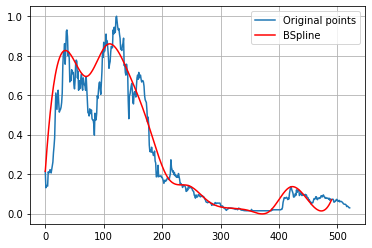

In [ ]:
import scipy.interpolate as interpolate

t_BUMI_15, c_BUMI_15, k_BUMI_15 = interpolate.splrep(BUMI_x15, BUMI_y15, s=0, k=3)
print('''\
t_BUMI_15: {}
c_BUMI_15: {}
k_BUMI_15: {}
'''.format(t_BUMI_15, c_BUMI_15, k_BUMI_15))
N = 522
xmin_BUMI_15, xmax_BUMI_15 = BUMI_x15.min(), BUMI_x15.max()
xx_BUMI_15 = np.linspace(xmin_BUMI_15, xmax_BUMI_15, N)
spline_BUMI_15 = interpolate.BSpline(t_BUMI_15, c_BUMI_15, k_BUMI_15, extrapolate=False)

plt.plot(BUMI_x, BUMI_y, label='Original points')
plt.plot(xx_BUMI_15, spline_BUMI_15(xx_BUMI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA BUMI**

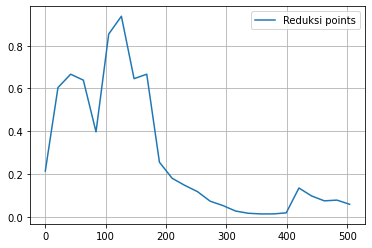

In [ ]:
BUMI_x25 = BUMI_x[0:522:21]
BUMI_y25 = BUMI_y[0:522:21]

plt.plot(BUMI_x25, BUMI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BUMI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_BUMI_25: [ 0.21388889  0.68348647  0.60941595  0.75647792  0.1612402   0.98189461
  1.03618136  0.49837994  0.84529887  0.1204246   0.20633609  0.13756439
  0.12673968  0.06381021  0.05801946  0.02244528  0.01719944  0.01042365
  0.02443931 -0.02484755  0.18828423  0.08171062  0.06814971  0.08911959
  0.05888889  0.          0.          0.          0.        ]
k_BUMI_25: 3



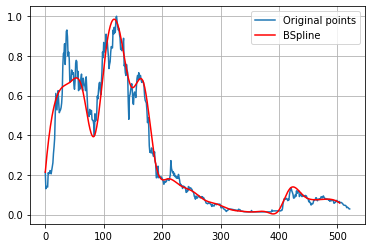

In [ ]:
import scipy.interpolate as interpolate

t_BUMI_25, c_BUMI_25, k_BUMI_25 = interpolate.splrep(BUMI_x25, BUMI_y25, s=0, k=3)
print('''\
t_BUMI_25: {}
c_BUMI_25: {}
k_BUMI_25: {}
'''.format(t_BUMI_25, c_BUMI_25, k_BUMI_25))
N = 522
xmin_BUMI_25, xmax_BUMI_25 = BUMI_x25.min(), BUMI_x25.max()
xx_BUMI_25 = np.linspace(xmin_BUMI_25, xmax_BUMI_25, N)
spline_BUMI_25 = interpolate.BSpline(t_BUMI_25, c_BUMI_25, k_BUMI_25, extrapolate=False)

plt.plot(BUMI_x, BUMI_y, label='Original points')
plt.plot(xx_BUMI_25, spline_BUMI_25(xx_BUMI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA BUMI**

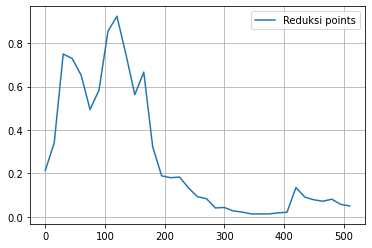

In [ ]:
BUMI_x35 = BUMI_x[0:522:15]
BUMI_y35 = BUMI_y[0:522:15]

plt.plot(BUMI_x35, BUMI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BUMI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_BUMI_35: [ 0.21388889 -0.02489805  0.93451832  0.70076882  0.69584377  0.43252276
  0.54073186  0.90454978  0.966069    0.77284088  0.44256747  0.83188923
  0.2298756   0.1819417   0.17569095  0.19862783  0.12979771  0.08218132
  0.09981035  0.0235773   0.05421378  0.02123424  0.02584927  0.0103687
  0.01600926  0.00892758  0.03161375 -0.02371593  0.19158328  0.06738279
  0.08555223  0.06374163  0.10250558  0.03124721  0.05055556  0.
  0.          0.          0.        ]
k_BUMI_35: 3



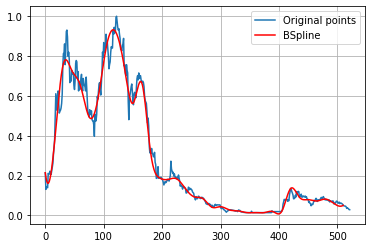

In [ ]:
import scipy.interpolate as interpolate

t_BUMI_35, c_BUMI_35, k_BUMI_35 = interpolate.splrep(BUMI_x35, BUMI_y35, s=0, k=3)
print('''\
t_BUMI_35: {}
c_BUMI_35: {}
k_BUMI_35: {}
'''.format(t_BUMI_35, c_BUMI_35, k_BUMI_35))
N = 522
xmin_BUMI_35, xmax_BUMI_35 = BUMI_x35.min(), BUMI_x35.max()
xx_BUMI_35 = np.linspace(xmin_BUMI_35, xmax_BUMI_35, N)
spline_BUMI_35 = interpolate.BSpline(t_BUMI_35, c_BUMI_35, k_BUMI_35, extrapolate=False)

plt.plot(BUMI_x, BUMI_y, label='Original points')
plt.plot(xx_BUMI_35, spline_BUMI_35(xx_BUMI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA BUMI**

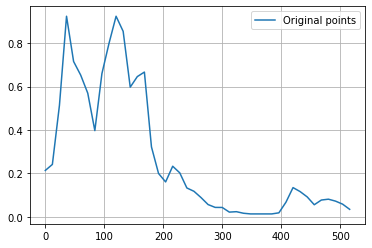

In [ ]:
BUMI_x45 = BUMI_x[0:522:12]
BUMI_y45 = BUMI_y[0:522:12]

plt.plot(BUMI_x45, BUMI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_BUMI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_BUMI_45: [0.21388889 0.19382819 0.2151214  1.11852161 0.62660879 0.6667099
 0.62321826 0.25708372 0.73178019 0.77412884 0.96337111 0.91405338
 0.50541535 0.64761853 0.77911053 0.23593936 0.21046535 0.12219925
 0.26740433 0.20818343 0.11652863 0.12570206 0.08899647 0.05331206
 0.03942194 0.05233349 0.01291075 0.02935684 0.0146619  0.01366222
 0.01402254 0.01358094 0.01498703 0.00980427 0.0591292  0.16034558
 0.10948849 0.10170045 0.03704305 0.08679402 0.08244752 0.07040536
 0.05563065 0.035      0.         0.         0.         0.        ]
k_BUMI_45: 3



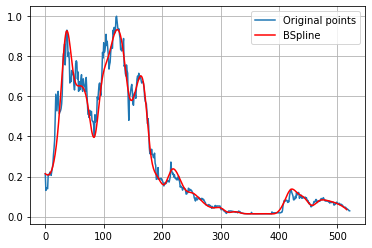

In [ ]:
import scipy.interpolate as interpolate

t_BUMI_45, c_BUMI_45, k_BUMI_45 = interpolate.splrep(BUMI_x45, BUMI_y45, s=0, k=3)
print('''\
t_BUMI_45: {}
c_BUMI_45: {}
k_BUMI_45: {}
'''.format(t_BUMI_45, c_BUMI_45, k_BUMI_45))
N = 522
xmin_BUMI_45, xmax_BUMI_45 = BUMI_x45.min(), BUMI_x45.max()
xx_BUMI_45 = np.linspace(xmin_BUMI_45, xmax_BUMI_45, N)
spline_BUMI_45 = interpolate.BSpline(t_BUMI_45, c_BUMI_45, k_BUMI_45, extrapolate=False)

plt.plot(BUMI_x, BUMI_y, label='Original points')
plt.plot(xx_BUMI_45, spline_BUMI_45(xx_BUMI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA BUMI**

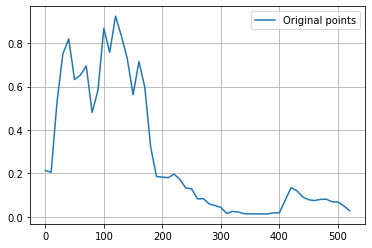

In [ ]:
BUMI_x55 = BUMI_x[0:522:10]
BUMI_y55 = BUMI_y[0:522:10]

plt.plot(BUMI_x55, BUMI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BUMI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_BUMI_55: [ 0.21388889 -0.02392001  0.4992289   0.7592585   0.89872971  0.56248934
  0.64297958  0.78225901  0.39465106  0.52247009  1.01546856  0.62398899
  1.03024215  0.79670908  0.78292153  0.44660481  0.80565925  0.62242486
  0.28797464  0.15900993  0.19265233  0.17038076  0.20915797  0.17632069
  0.1188926   0.14810889  0.06367184  0.09720377  0.0525131   0.05274384
  0.05151154  0.00287667  0.03198176  0.0225296   0.01289982  0.01420445
  0.01361572  0.01466601  0.01105357  0.02445303  0.00280096  0.07767646
  0.15315985  0.11968412  0.08810368  0.07790118  0.07362494  0.08093241
  0.08597875  0.06515258  0.07616371  0.0387237   0.02888889  0.
  0.          0.          0.        ]


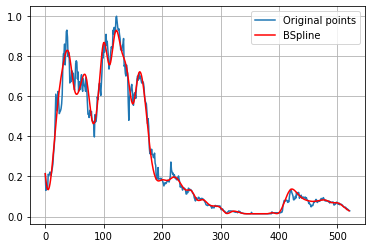

In [ ]:
import scipy.interpolate as interpolate

t_BUMI_55, c_BUMI_55, k_BUMI_55 = interpolate.splrep(BUMI_x55, BUMI_y55, s=0, k=3)
print('''\
t_BUMI_55: {}
c_BUMI_55: {}
k_BUMI_55: {}
'''.format(t_BUMI_55, c_BUMI_55, k_BUMI_55))
N = 522
xmin_BUMI_55, xmax_BUMI_55 = BUMI_x55.min(), BUMI_x55.max()
xx_BUMI_55 = np.linspace(xmin_BUMI_55, xmax_BUMI_55, N)
spline_BUMI_55 = interpolate.BSpline(t_BUMI_55, c_BUMI_55, k_BUMI_55, extrapolate=False)

plt.plot(BUMI_x, BUMI_y, label='Original points')
plt.plot(xx_BUMI_55, spline_BUMI_55(xx_BUMI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA BUMI**

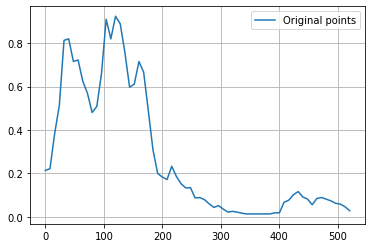

In [ ]:
BUMI_x65 = BUMI_x[0:522:8]
BUMI_y65 = BUMI_y[0:522:8]

plt.plot(BUMI_x65, BUMI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_BUMI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_BUMI_65: [2.13888889e-01 9.20125386e-02 4.06252700e-01 4.42241320e-01
 8.99118200e-01 8.36285882e-01 6.72404938e-01 7.65761034e-01
 5.97884258e-01 5.92701933e-01 4.47974673e-01 4.98732710e-01
 6.07094483e-01 1.03122269e+00 7.26348091e-01 9.80051611e-01
 8.95112131e-01 7.72833201e-01 5.55221730e-01 5.89613210e-01
 7.52992096e-01 6.90085073e-01 4.86667612e-01 2.96577811e-01
 1.77021141e-01 1.95337625e-01 1.41628357e-01 2.71482281e-01
 1.72442519e-01 1.55414310e-01 1.22566907e-01 1.54318058e-01
 6.84941925e-02 9.67051720e-02 7.96851216e-02 6.12210054e-02
 3.54308566e-02 6.03889022e-02 3.46801985e-02 1.75569699e-02
 2.84252538e

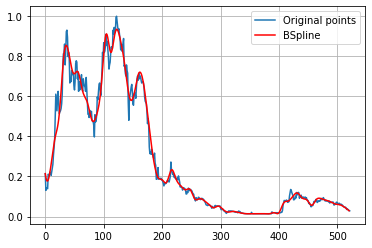

In [ ]:
import scipy.interpolate as interpolate

t_BUMI_65, c_BUMI_65, k_BUMI_65 = interpolate.splrep(BUMI_x65, BUMI_y65, s=0, k=3)
print('''\
t_BUMI_65: {}
c_BUMI_65: {}
k_BUMI_65: {}
'''.format(t_BUMI_65, c_BUMI_65, k_BUMI_65))
N = 522
xmin_BUMI_65, xmax_BUMI_65 = BUMI_x65.min(), BUMI_x65.max()
xx_BUMI_65 = np.linspace(xmin_BUMI_65, xmax_BUMI_65, N)
spline_BUMI_65 = interpolate.BSpline(t_BUMI_65, c_BUMI_65, k_BUMI_65, extrapolate=False)

plt.plot(BUMI_x, BUMI_y, label='Original points')
plt.plot(xx_BUMI_65, spline_BUMI_65(xx_BUMI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE BUMI**

In [ ]:

#RMSE 15 DATA BUMI
y_true_BUMI_15 = BUMI_y.tolist()
y_pred_BUMI_15 = spline_BUMI_15(xx_BUMI_15).tolist()
mse_BUMI_15 = mean_squared_error(y_true_BUMI_15, y_pred_BUMI_15)
rmse_BUMI_15 = np.sqrt(mse_BUMI_15)
print("rmse BUMI 15 =",rmse_BUMI_15)

#RMSE 25 DATA BUMI
y_true_BUMI_25 = BUMI_y.tolist()
y_pred_BUMI_25 = spline_BUMI_25(xx_BUMI_25).tolist()
mse_BUMI_25 = mean_squared_error(y_true_BUMI_25, y_pred_BUMI_25)
rmse_BUMI_25 = np.sqrt(mse_BUMI_25)
print("rmse BUMI 25 =",rmse_BUMI_25)

#RMSE 35 DATA BUMI
y_true_BUMI_35 = BUMI_y.tolist()
y_pred_BUMI_35 = spline_BUMI_35(xx_BUMI_35).tolist()
mse_BUMI_35 = mean_squared_error(y_true_BUMI_35, y_pred_BUMI_35)
rmse_BUMI_35 = np.sqrt(mse_BUMI_35)
print("rmse BUMI 35 =",rmse_BUMI_35)

#RMSE 45 DATA BUMI
y_true_BUMI_45 = BUMI_y.tolist()
y_pred_BUMI_45 = spline_BUMI_45(xx_BUMI_45).tolist()
mse_BUMI_45 = mean_squared_error(y_true_BUMI_45, y_pred_BUMI_45)
rmse_BUMI_45 = np.sqrt(mse_BUMI_45)
print("rmse BUMI 45 =",rmse_BUMI_45)

#RMSE 55 DATA BUMI
y_true_BUMI_55 = BUMI_y.tolist()
y_pred_BUMI_55 = spline_BUMI_55(xx_BUMI_55).tolist()
mse_BUMI_55 = mean_squared_error(y_true_BUMI_55, y_pred_BUMI_55)
rmse_BUMI_55 = np.sqrt(mse_BUMI_55)
print("rmse BUMI 55 =",rmse_BUMI_55)

#RMSE 65 DATA BUMI
y_true_BUMI_65 = BUMI_y.tolist()
y_pred_BUMI_65 = spline_BUMI_65(xx_BUMI_65).tolist()
mse_BUMI_65 = mean_squared_error(y_true_BUMI_65, y_pred_BUMI_65)
rmse_BUMI_65 = np.sqrt(mse_BUMI_65)
print("rmse BUMI 65 =",rmse_BUMI_65)

rmse BUMI 15 = 0.09564958722344154
rmse BUMI 25 = 0.07611931744267098
rmse BUMI 35 = 0.041673217323208785
rmse BUMI 45 = 0.04475839724684177
rmse BUMI 55 = 0.03762963117292643
rmse BUMI 65 = 0.03413262873992276


# **CPIN**

No handles with labels found to put in legend.


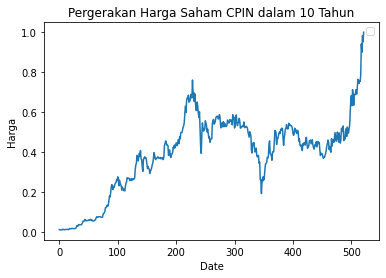

In [ ]:
CPIN = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/CPIN.JK.csv')

CPIN_x = CPIN['No'].values
CPIN_y = CPIN['Skala'].values

plt.plot(CPIN_x,CPIN_y)
plt.title('Pergerakan Harga Saham CPIN dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA CPIN**

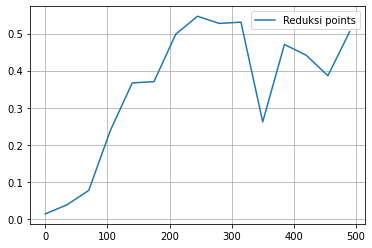

In [ ]:
CPIN_x15 = CPIN_x[0:522:35]
CPIN_y15 = CPIN_y[0:522:35]

plt.plot(CPIN_x15, CPIN_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CPIN_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_CPIN_15: [ 0.0132872   0.06439946 -0.02215533  0.24590889  0.4081819   0.32205553
  0.52504925  0.56736683  0.48576025  0.653606    0.08459083  0.57758085
  0.37895994  0.34616017  0.50519031  0.          0.          0.
  0.        ]
k_CPIN_15: 3



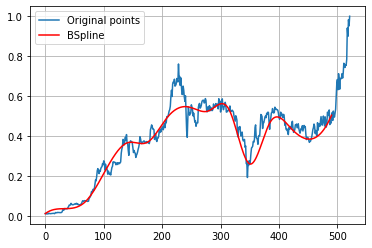

In [ ]:
import scipy.interpolate as interpolate

t_CPIN_15, c_CPIN_15, k_CPIN_15 = interpolate.splrep(CPIN_x15, CPIN_y15, s=0, k=3)
print('''\
t_CPIN_15: {}
c_CPIN_15: {}
k_CPIN_15: {}
'''.format(t_CPIN_15, c_CPIN_15, k_CPIN_15))
N = 522
xmin_CPIN_15, xmax_CPIN_15 = CPIN_x15.min(), CPIN_x15.max()
xx_CPIN_15 = np.linspace(xmin_CPIN_15, xmax_CPIN_15, N)
spline_CPIN_15 = interpolate.BSpline(t_CPIN_15, c_CPIN_15, k_CPIN_15, extrapolate=False)

plt.plot(CPIN_x, CPIN_y, label='Original points')
plt.plot(xx_CPIN_15, spline_CPIN_15(xx_CPIN_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA CPIN**

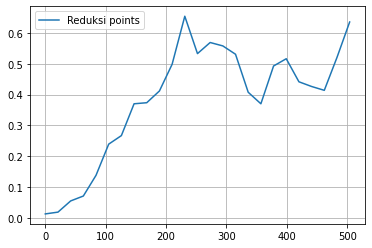

In [ ]:
CPIN_x25 = CPIN_x[0:522:21]
CPIN_y25 = CPIN_y[0:522:21]

plt.plot(CPIN_x25, CPIN_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_CPIN_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_CPIN_25: [ 0.0132872  -0.01217195  0.06642003  0.05944724  0.12521588  0.27013905
  0.23090612  0.40900465  0.35452859  0.41509552  0.45567755  0.75181364
  0.46094331  0.60164494  0.5456257   0.56256505  0.38888919  0.32755293
  0.52235239  0.5394389   0.41746987  0.43981657  0.36146023  0.5978166
  0.63529412  0.          0.          0.          0.        ]
k_CPIN_25: 3



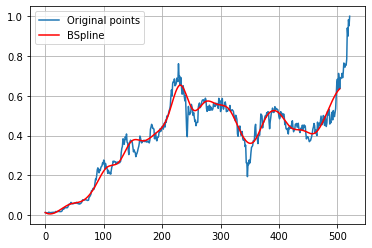

In [ ]:
import scipy.interpolate as interpolate

t_CPIN_25, c_CPIN_25, k_CPIN_25 = interpolate.splrep(CPIN_x25, CPIN_y25, s=0, k=3)
print('''\
t_CPIN_25: {}
c_CPIN_25: {}
k_CPIN_25: {}
'''.format(t_CPIN_25, c_CPIN_25, k_CPIN_25))
N = 522
xmin_CPIN_25, xmax_CPIN_25 = CPIN_x25.min(), CPIN_x25.max()
xx_CPIN_25 = np.linspace(xmin_CPIN_25, xmax_CPIN_25, N)
spline_CPIN_25 = interpolate.BSpline(t_CPIN_25, c_CPIN_25, k_CPIN_25, extrapolate=False)

plt.plot(CPIN_x, CPIN_y, label='Original points')
plt.plot(xx_CPIN_25, spline_CPIN_25(xx_CPIN_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA CPIN**

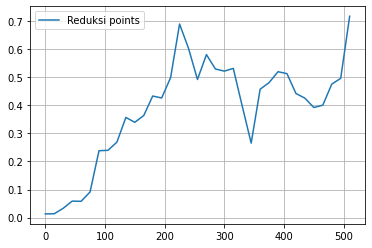

In [ ]:
CPIN_x35 = CPIN_x[0:522:15]
CPIN_y35 = CPIN_y[0:522:15]

plt.plot(CPIN_x35, CPIN_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CPIN_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_CPIN_35: [0.0132872  0.00664074 0.01882924 0.06605833 0.05807133 0.05044527
 0.28824447 0.22495056 0.24863148 0.39159617 0.32339215 0.34943731
 0.45878942 0.41056073 0.45260089 0.76865509 0.60426664 0.42673509
 0.63688987 0.50529021 0.51426763 0.56428286 0.41337601 0.16145184
 0.53112803 0.45452047 0.53245101 0.52986234 0.42076399 0.43621666
 0.38385035 0.37855494 0.54305488 0.42172516 0.71626298 0.
 0.         0.         0.        ]
k_CPIN_35: 3



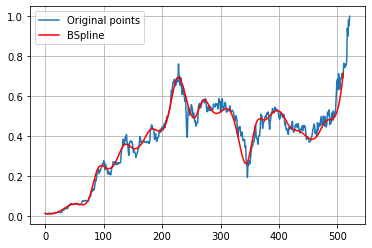

In [ ]:
import scipy.interpolate as interpolate

t_CPIN_35, c_CPIN_35, k_CPIN_35 = interpolate.splrep(CPIN_x35, CPIN_y35, s=0, k=3)
print('''\
t_CPIN_35: {}
c_CPIN_35: {}
k_CPIN_35: {}
'''.format(t_CPIN_35, c_CPIN_35, k_CPIN_35))
N = 522
xmin_CPIN_35, xmax_CPIN_35 = CPIN_x35.min(), CPIN_x35.max()
xx_CPIN_35 = np.linspace(xmin_CPIN_35, xmax_CPIN_35, N)
spline_CPIN_35 = interpolate.BSpline(t_CPIN_35, c_CPIN_35, k_CPIN_35, extrapolate=False)

plt.plot(CPIN_x, CPIN_y, label='Original points')
plt.plot(xx_CPIN_35, spline_CPIN_35(xx_CPIN_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA CPIN**


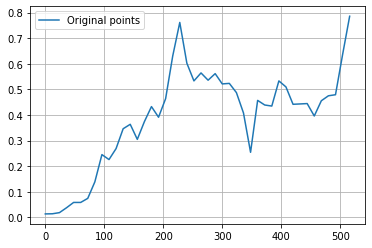

In [ ]:
CPIN_x45 = CPIN_x[0:522:12]
CPIN_y45 = CPIN_y[0:522:12]

plt.plot(CPIN_x45, CPIN_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CPIN_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_CPIN_45: [0.0132872  0.01576305 0.00805867 0.03612421 0.06464953 0.05406658
 0.06787307 0.11873179 0.2876496  0.20056601 0.26371957 0.35562836
 0.38989154 0.26473627 0.37815298 0.46486632 0.35753744 0.45100466
 0.62045082 0.84573876 0.56406821 0.51044517 0.59138293 0.50810615
 0.5900333  0.49923472 0.53967143 0.4811799  0.45879234 0.12932547
 0.54778122 0.42003409 0.40460838 0.56914486 0.51604403 0.4227344
 0.44215333 0.46609172 0.35922371 0.47209993 0.48455651 0.42263707
 0.74317974 0.78546713 0.         0.         0.         0.        ]
k_CPIN_45: 3



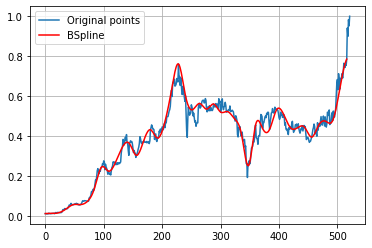

In [ ]:
import scipy.interpolate as interpolate

t_CPIN_45, c_CPIN_45, k_CPIN_45 = interpolate.splrep(CPIN_x45, CPIN_y45, s=0, k=3)
print('''\
t_CPIN_45: {}
c_CPIN_45: {}
k_CPIN_45: {}
'''.format(t_CPIN_45, c_CPIN_45, k_CPIN_45))
N = 522
xmin_CPIN_45, xmax_CPIN_45 = CPIN_x45.min(), CPIN_x45.max()
xx_CPIN_45 = np.linspace(xmin_CPIN_45, xmax_CPIN_45, N)
spline_CPIN_45 = interpolate.BSpline(t_CPIN_45, c_CPIN_45, k_CPIN_45, extrapolate=False)

plt.plot(CPIN_x, CPIN_y, label='Original points')
plt.plot(xx_CPIN_45, spline_CPIN_45(xx_CPIN_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA CPIN**


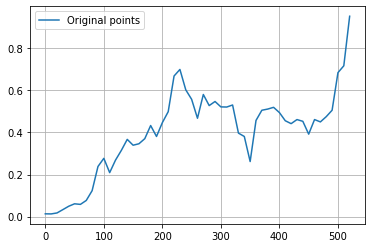

In [ ]:
CPIN_x55 = CPIN_x[0:522:10]
CPIN_y55 = CPIN_y[0:522:10]

plt.plot(CPIN_x55, CPIN_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CPIN_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_CPIN_55: [0.0132872  0.01394594 0.0082327  0.03394853 0.04885217 0.06628292
 0.05141409 0.07684965 0.10208698 0.25390279 0.31067555 0.16429466
 0.28612506 0.30227775 0.39403729 0.32226514 0.35150425 0.34784245
 0.47857926 0.33299621 0.4731729  0.45251287 0.70639499 0.72882758
 0.57206631 0.59536392 0.38903857 0.65124996 0.48554635 0.57057847
 0.51241658 0.50639879 0.58447959 0.33630568 0.44953643 0.14928563
 0.52287124 0.49971383 0.50941529 0.52698486 0.4968321  0.4503926
 0.43377743 0.46363262 0.47709    0.3435783  0.49876983 0.42674033
 0.4932308  0.44877936 0.84079838 0.60330323 0.95155709 0.
 0.         0.         0.        ]
k_CPIN_55: 3



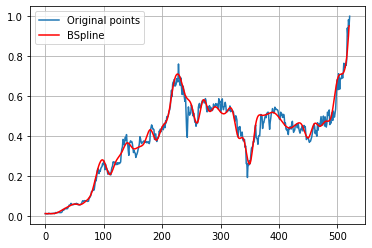

In [ ]:
import scipy.interpolate as interpolate

t_CPIN_55, c_CPIN_55, k_CPIN_55 = interpolate.splrep(CPIN_x55, CPIN_y55, s=0, k=3)
print('''\
t_CPIN_55: {}
c_CPIN_55: {}
k_CPIN_55: {}
'''.format(t_CPIN_55, c_CPIN_55, k_CPIN_55))
N = 522
xmin_CPIN_55, xmax_CPIN_55 = CPIN_x55.min(), CPIN_x55.max()
xx_CPIN_55 = np.linspace(xmin_CPIN_55, xmax_CPIN_55, N)
spline_CPIN_55 = interpolate.BSpline(t_CPIN_55, c_CPIN_55, k_CPIN_55, extrapolate=False)

plt.plot(CPIN_x, CPIN_y, label='Original points')
plt.plot(xx_CPIN_55, spline_CPIN_55(xx_CPIN_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA CPIN**

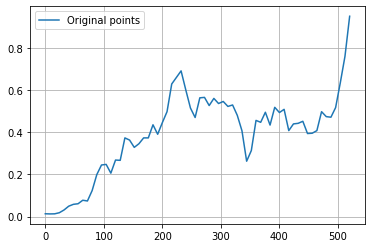

In [ ]:
CPIN_x65 = CPIN_x[0:522:8]
CPIN_y65 = CPIN_y[0:522:8]

plt.plot(CPIN_x65, CPIN_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CPIN_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_CPIN_65: [0.0132872  0.01330182 0.01062819 0.01688355 0.02989314 0.05122557
 0.06084473 0.05418445 0.0878154  0.05960585 0.11805185 0.20728709
 0.24864755 0.26801889 0.16578206 0.30622311 0.22039815 0.41495246
 0.36200654 0.31695217 0.34250312 0.38915992 0.34307175 0.48076761
 0.34977475 0.46615416 0.46380931 0.66822799 0.64182546 0.72986811
 0.59095125 0.51878363 0.42733982 0.5953865  0.57519724 0.50036434
 0.58735925 0.51767271 0.56409522 0.50622321 0.55011227 0.47395053
 0.43989876 0.21212918 0.28943918 0.51108295 0.40671344 0.54856848
 0.37202301 0.57095193 0.45835611 0.56032952 0.35638119 0.46397272
 0.42855838 0.47923

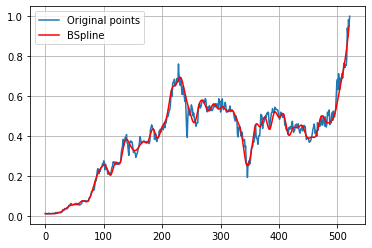

In [ ]:
import scipy.interpolate as interpolate

t_CPIN_65, c_CPIN_65, k_CPIN_65 = interpolate.splrep(CPIN_x65, CPIN_y65, s=0, k=3)
print('''\
t_CPIN_65: {}
c_CPIN_65: {}
k_CPIN_65: {}
'''.format(t_CPIN_65, c_CPIN_65, k_CPIN_65))
N = 522
xmin_CPIN_65, xmax_CPIN_65 = CPIN_x65.min(), CPIN_x65.max()
xx_CPIN_65 = np.linspace(xmin_CPIN_65, xmax_CPIN_65, N)
spline_CPIN_65 = interpolate.BSpline(t_CPIN_65, c_CPIN_65, k_CPIN_65, extrapolate=False)

plt.plot(CPIN_x, CPIN_y, label='Original points')
plt.plot(xx_CPIN_65, spline_CPIN_65(xx_CPIN_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE CPIN**

In [ ]:

#RMSE 15 DATA CPIN
y_true_CPIN_15 = CPIN_y.tolist()
y_pred_CPIN_15 = spline_CPIN_15(xx_CPIN_15).tolist()
mse_CPIN_15 = mean_squared_error(y_true_CPIN_15, y_pred_CPIN_15)
rmse_CPIN_15 = np.sqrt(mse_CPIN_15)
print("rmse CPIN 15 =",rmse_CPIN_15)

#RMSE 25 DATA CPIN
y_true_CPIN_25 = CPIN_y.tolist()
y_pred_CPIN_25 = spline_CPIN_25(xx_CPIN_25).tolist()
mse_CPIN_25 = mean_squared_error(y_true_CPIN_25, y_pred_CPIN_25)
rmse_CPIN_25 = np.sqrt(mse_CPIN_25)
print("rmse CPIN 25 =",rmse_CPIN_25)

#RMSE 35 DATA CPIN
y_true_CPIN_35 = CPIN_y.tolist()
y_pred_CPIN_35 = spline_CPIN_35(xx_CPIN_35).tolist()
mse_CPIN_35 = mean_squared_error(y_true_CPIN_35, y_pred_CPIN_35)
rmse_CPIN_35 = np.sqrt(mse_CPIN_35)
print("rmse CPIN 35 =",rmse_CPIN_35)

#RMSE 45 DATA CPIN
y_true_CPIN_45 = CPIN_y.tolist()
y_pred_CPIN_45 = spline_CPIN_45(xx_CPIN_45).tolist()
mse_CPIN_45 = mean_squared_error(y_true_CPIN_45, y_pred_CPIN_45)
rmse_CPIN_45 = np.sqrt(mse_CPIN_45)
print("rmse CPIN 45 =",rmse_CPIN_45)

#RMSE 55 DATA CPIN
y_true_CPIN_55 = CPIN_y.tolist()
y_pred_CPIN_55 = spline_CPIN_55(xx_CPIN_55).tolist()
mse_CPIN_55 = mean_squared_error(y_true_CPIN_55, y_pred_CPIN_55)
rmse_CPIN_55 = np.sqrt(mse_CPIN_55)
print("rmse CPIN 55 =",rmse_CPIN_55)

#RMSE 65 DATA CPIN
y_true_CPIN_65 = CPIN_y.tolist()
y_pred_CPIN_65 = spline_CPIN_65(xx_CPIN_65).tolist()
mse_CPIN_65 = mean_squared_error(y_true_CPIN_65, y_pred_CPIN_65)
rmse_CPIN_65 = np.sqrt(mse_CPIN_65)
print("rmse CPIN 65 =",rmse_CPIN_65)

rmse CPIN 15 = 0.10537304824914316
rmse CPIN 25 = 0.06740560369478142
rmse CPIN 35 = 0.059980449524139993
rmse CPIN 45 = 0.0455984202111647
rmse CPIN 55 = 0.03213457702179557
rmse CPIN 65 = 0.02945433823855482


# **CTRA**

No handles with labels found to put in legend.


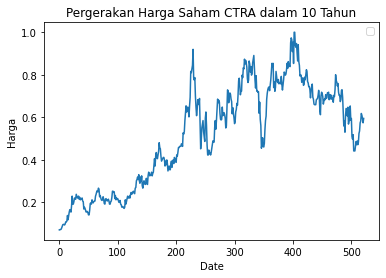

In [ ]:
CTRA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/CTRA.JK.csv')

CTRA_x = CTRA['No'].values
CTRA_y = CTRA['Skala'].values

plt.plot(CTRA_x,CTRA_y)
plt.title('Pergerakan Harga Saham CTRA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA CTRA**

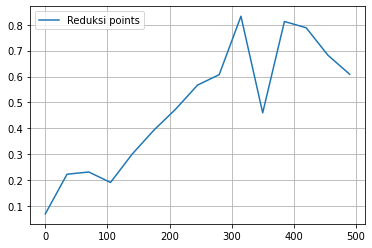

In [ ]:
CTRA_x15 = CTRA_x[0:522:35]
CTRA_y15 = CTRA_y[0:522:35]

plt.plot(CTRA_x15, CTRA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CTRA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_CTRA_15: [0.06940059 0.2282868  0.28370285 0.14507397 0.31577265 0.39625776
 0.45882328 0.61388204 0.48628979 1.08451163 0.17253437 0.98403447
 0.69479401 0.66804417 0.60882353 0.         0.         0.
 0.        ]
k_CTRA_15: 3



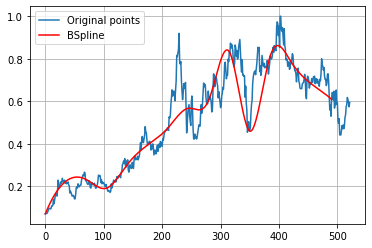

In [ ]:
import scipy.interpolate as interpolate

t_CTRA_15, c_CTRA_15, k_CTRA_15 = interpolate.splrep(CTRA_x15, CTRA_y15, s=0, k=3)
print('''\
t_CTRA_15: {}
c_CTRA_15: {}
k_CTRA_15: {}
'''.format(t_CTRA_15, c_CTRA_15, k_CTRA_15))
N = 522
xmin_CTRA_15, xmax_CTRA_15 = CTRA_x15.min(), CTRA_x15.max()
xx_CTRA_15 = np.linspace(xmin_CTRA_15, xmax_CTRA_15, N)
spline_CTRA_15 = interpolate.BSpline(t_CTRA_15, c_CTRA_15, k_CTRA_15, extrapolate=False)

plt.plot(CTRA_x, CTRA_y, label='Original points')
plt.plot(xx_CTRA_15, spline_CTRA_15(xx_CTRA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA CTRA**

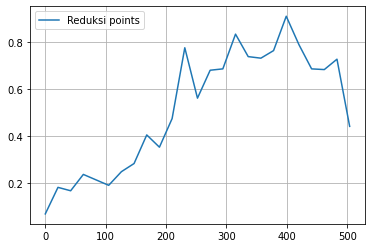

In [ ]:
CTRA_x25 = CTRA_x[0:522:21]
CTRA_y25 = CTRA_y[0:522:21]

plt.plot(CTRA_x25, CTRA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_CTRA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_CTRA_25: [0.06940059 0.26099727 0.08815396 0.26923413 0.21235593 0.16525744
 0.27172843 0.23994767 0.46879969 0.31388288 0.3923947  0.96197123
 0.40957908 0.76565238 0.60509366 0.92598454 0.68783886 0.7469543
 0.7090379  0.99450584 0.76587991 0.67138627 0.65665752 0.84373006
 0.44117647 0.         0.         0.         0.        ]
k_CTRA_25: 3



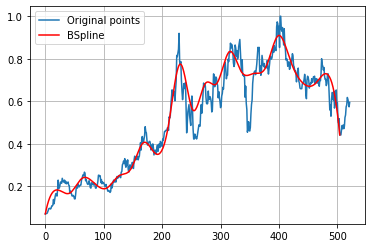

In [ ]:
import scipy.interpolate as interpolate

t_CTRA_25, c_CTRA_25, k_CTRA_25 = interpolate.splrep(CTRA_x25, CTRA_y25, s=0, k=3)
print('''\
t_CTRA_25: {}
c_CTRA_25: {}
k_CTRA_25: {}
'''.format(t_CTRA_25, c_CTRA_25, k_CTRA_25))
N = 522
xmin_CTRA_25, xmax_CTRA_25 = CTRA_x25.min(), CTRA_x25.max()
xx_CTRA_25 = np.linspace(xmin_CTRA_25, xmax_CTRA_25, N)
spline_CTRA_25 = interpolate.BSpline(t_CTRA_25, c_CTRA_25, k_CTRA_25, extrapolate=False)

plt.plot(CTRA_x, CTRA_y, label='Original points')
plt.plot(xx_CTRA_25, spline_CTRA_25(xx_CTRA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA CTRA**

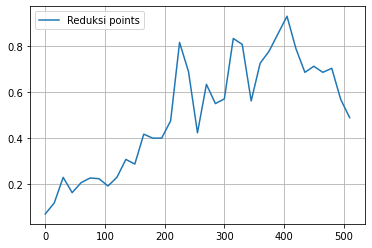

In [ ]:
CTRA_x35 = CTRA_x[0:522:15]
CTRA_y35 = CTRA_y[0:522:15]

plt.plot(CTRA_x35, CTRA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CTRA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_CTRA_35: [ 0.06940059 -0.0124869   0.34450789  0.11531485  0.22314275  0.22397772
  0.23426401  0.17493324  0.21111718  0.35126279  0.22295161  0.47460021
  0.37707578  0.41142491  0.37155281  0.94779675  0.73001324  0.2614914
  0.75715047  0.50960069  0.50098436  0.90445373  0.87807142  0.42395482
  0.79204923  0.75746007  0.84342803  0.99014562  0.7724601   0.64942574
  0.74160165  0.6547559   0.78326731  0.44586635  0.48823529  0.
  0.          0.          0.        ]
k_CTRA_35: 3



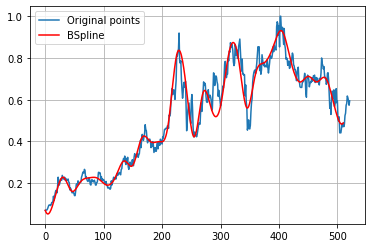

In [ ]:
import scipy.interpolate as interpolate

t_CTRA_35, c_CTRA_35, k_CTRA_35 = interpolate.splrep(CTRA_x35, CTRA_y35, s=0, k=3)
print('''\
t_CTRA_35: {}
c_CTRA_35: {}
k_CTRA_35: {}
'''.format(t_CTRA_35, c_CTRA_35, k_CTRA_35))
N = 522
xmin_CTRA_35, xmax_CTRA_35 = CTRA_x35.min(), CTRA_x35.max()
xx_CTRA_35 = np.linspace(xmin_CTRA_35, xmax_CTRA_35, N)
spline_CTRA_35 = interpolate.BSpline(t_CTRA_35, c_CTRA_35, k_CTRA_35, extrapolate=False)

plt.plot(CTRA_x, CTRA_y, label='Original points')
plt.plot(xx_CTRA_35, spline_CTRA_35(xx_CTRA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA CTRA**

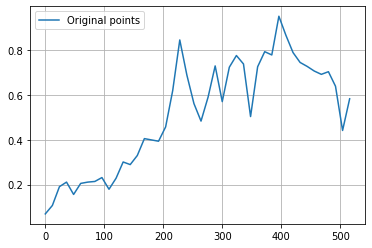

In [ ]:
CTRA_x45 = CTRA_x[0:522:12]
CTRA_y45 = CTRA_y[0:522:12]

plt.plot(CTRA_x45, CTRA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CTRA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_CTRA_45: [0.06940059 0.0534158  0.1910137  0.23639564 0.1186229  0.22602338
 0.20914718 0.20395256 0.2589579  0.14823114 0.2238293  0.32711638
 0.27212749 0.31939364 0.42822262 0.39674519 0.37912486 0.44638232
 0.5766788  0.95984365 0.6502052  0.56867665 0.44102816 0.56469536
 0.8396258  0.4490369  0.78221845 0.75963036 0.82911881 0.34818871
 0.79706162 0.81317661 0.70325524 1.03911994 0.840265   0.78805534
 0.73692541 0.72894889 0.70610254 0.68193507 0.71321601 0.67272528
 0.24084325 0.58235294 0.         0.         0.         0.        ]
k_CTRA_45: 3



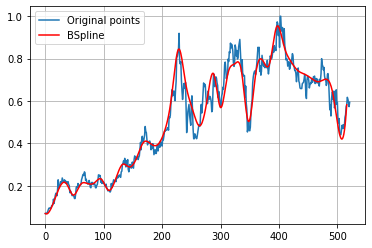

In [ ]:
import scipy.interpolate as interpolate

t_CTRA_45, c_CTRA_45, k_CTRA_45 = interpolate.splrep(CTRA_x45, CTRA_y45, s=0, k=3)
print('''\
t_CTRA_45: {}
c_CTRA_45: {}
k_CTRA_45: {}
'''.format(t_CTRA_45, c_CTRA_45, k_CTRA_45))
N = 522
xmin_CTRA_45, xmax_CTRA_45 = CTRA_x45.min(), CTRA_x45.max()
xx_CTRA_45 = np.linspace(xmin_CTRA_45, xmax_CTRA_45, N)
spline_CTRA_45 = interpolate.BSpline(t_CTRA_45, c_CTRA_45, k_CTRA_45, extrapolate=False)

plt.plot(CTRA_x, CTRA_y, label='Original points')
plt.plot(xx_CTRA_45, spline_CTRA_45(xx_CTRA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA CTRA**

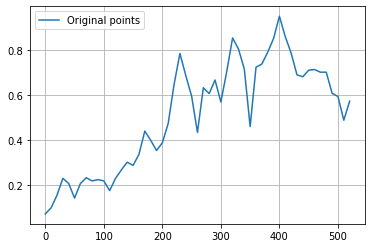

In [ ]:
CTRA_x55 = CTRA_x[0:522:10]
CTRA_y55 = CTRA_y[0:522:10]

plt.plot(CTRA_x55, CTRA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CTRA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_CTRA_55: [0.06940059 0.0840355  0.10808578 0.25162518 0.22019339 0.09946483
 0.22343319 0.238666   0.20991811 0.22292741 0.23433927 0.14098133
 0.24274602 0.25869936 0.31867536 0.27102154 0.31490792 0.48196906
 0.39444878 0.33456409 0.3840208  0.45427862 0.64429766 0.85497794
 0.65503764 0.65421263 0.30224121 0.73935419 0.54003597 0.74405474
 0.49163898 0.70738122 0.91229491 0.7790861  0.81205489 0.27554144
 0.84446293 0.69621867 0.80797999 0.8248847  1.013799   0.83756636
 0.80652381 0.66575017 0.67753434 0.7182301  0.72013349 0.68947122
 0.73962868 0.56966111 0.65633704 0.3563903  0.57352941 0.
 0.         0.         0.        ]
k_CTRA_55: 3



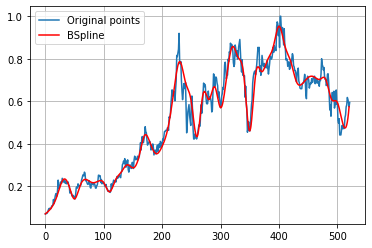

In [ ]:
import scipy.interpolate as interpolate

t_CTRA_55, c_CTRA_55, k_CTRA_55 = interpolate.splrep(CTRA_x55, CTRA_y55, s=0, k=3)
print('''\
t_CTRA_55: {}
c_CTRA_55: {}
k_CTRA_55: {}
'''.format(t_CTRA_55, c_CTRA_55, k_CTRA_55))
N = 522
xmin_CTRA_55, xmax_CTRA_55 = CTRA_x55.min(), CTRA_x55.max()
xx_CTRA_55 = np.linspace(xmin_CTRA_55, xmax_CTRA_55, N)
spline_CTRA_55 = interpolate.BSpline(t_CTRA_55, c_CTRA_55, k_CTRA_55, extrapolate=False)

plt.plot(CTRA_x, CTRA_y, label='Original points')
plt.plot(xx_CTRA_55, spline_CTRA_55(xx_CTRA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA CTRA**


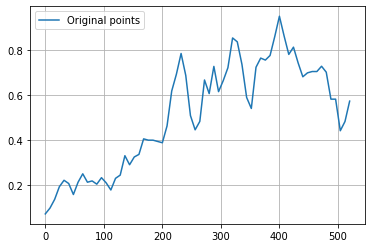

In [ ]:
CTRA_x65 = CTRA_x[0:522:8]
CTRA_y65 = CTRA_y[0:522:8]

plt.plot(CTRA_x65, CTRA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_CTRA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_CTRA_65: [0.06940059 0.08688922 0.10599274 0.19777473 0.22507699 0.22053379
 0.12465144 0.21777108 0.27082889 0.19103217 0.2316071  0.18380526
 0.2476848  0.21347083 0.14764599 0.25430633 0.20579344 0.37993755
 0.25238103 0.34555831 0.30860934 0.43262663 0.38991346 0.40204779
 0.39622364 0.37268462 0.43796377 0.65149453 0.66899929 0.83654383
 0.70407245 0.4765075  0.44353411 0.42128664 0.76880397 0.51139141
 0.82918323 0.54411114 0.68994852 0.68665962 0.90095407 0.84517109
 0.74992624 0.57941826 0.47183613 0.77791374 0.76612071 0.75275622
 0.76541933 0.850884   1.00163291 0.86023143 0.74567668 0.85117948
 0.73784067 0.66216

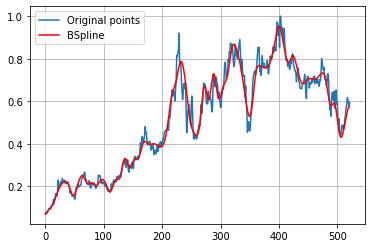

In [ ]:
import scipy.interpolate as interpolate

t_CTRA_65, c_CTRA_65, k_CTRA_65 = interpolate.splrep(CTRA_x65, CTRA_y65, s=0, k=3)
print('''\
t_CTRA_65: {}
c_CTRA_65: {}
k_CTRA_65: {}
'''.format(t_CTRA_65, c_CTRA_65, k_CTRA_65))
N = 522
xmin_CTRA_65, xmax_CTRA_65 = CTRA_x65.min(), CTRA_x65.max()
xx_CTRA_65 = np.linspace(xmin_CTRA_65, xmax_CTRA_65, N)
spline_CTRA_65 = interpolate.BSpline(t_CTRA_65, c_CTRA_65, k_CTRA_65, extrapolate=False)

plt.plot(CTRA_x, CTRA_y, label='Original points')
plt.plot(xx_CTRA_65, spline_CTRA_65(xx_CTRA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE CTRA**

In [ ]:

#RMSE 15 DATA CTRA
y_true_CTRA_15 = CTRA_y.tolist()
y_pred_CTRA_15 = spline_CTRA_15(xx_CTRA_15).tolist()
mse_CTRA_15 = mean_squared_error(y_true_CTRA_15, y_pred_CTRA_15)
rmse_CTRA_15 = np.sqrt(mse_CTRA_15)
print("rmse CTRA 15 =",rmse_CTRA_15)

#RMSE 25 DATA CTRA
y_true_CTRA_25 = CTRA_y.tolist()
y_pred_CTRA_25 = spline_CTRA_25(xx_CTRA_25).tolist()
mse_CTRA_25 = mean_squared_error(y_true_CTRA_25, y_pred_CTRA_25)
rmse_CTRA_25 = np.sqrt(mse_CTRA_25)
print("rmse CTRA 25 =",rmse_CTRA_25)

#RMSE 35 DATA CTRA
y_true_CTRA_35 = CTRA_y.tolist()
y_pred_CTRA_35 = spline_CTRA_35(xx_CTRA_35).tolist()
mse_CTRA_35 = mean_squared_error(y_true_CTRA_35, y_pred_CTRA_35)
rmse_CTRA_35 = np.sqrt(mse_CTRA_35)
print("rmse CTRA 35 =",rmse_CTRA_35)

#RMSE 45 DATA CTRA
y_true_CTRA_45 = CTRA_y.tolist()
y_pred_CTRA_45 = spline_CTRA_45(xx_CTRA_45).tolist()
mse_CTRA_45 = mean_squared_error(y_true_CTRA_45, y_pred_CTRA_45)
rmse_CTRA_45 = np.sqrt(mse_CTRA_45)
print("rmse CTRA 45 =",rmse_CTRA_45)

#RMSE 55 DATA CTRA
y_true_CTRA_55 = CTRA_y.tolist()
y_pred_CTRA_55 = spline_CTRA_55(xx_CTRA_55).tolist()
mse_CTRA_55 = mean_squared_error(y_true_CTRA_55, y_pred_CTRA_55)
rmse_CTRA_55 = np.sqrt(mse_CTRA_55)
print("rmse CTRA 55 =",rmse_CTRA_55)

#RMSE 65 DATA CTRA
y_true_CTRA_65 = CTRA_y.tolist()
y_pred_CTRA_65 = spline_CTRA_65(xx_CTRA_65).tolist()
mse_CTRA_65 = mean_squared_error(y_true_CTRA_65, y_pred_CTRA_65)
rmse_CTRA_65 = np.sqrt(mse_CTRA_65)
print("rmse CTRA 65 =",rmse_CTRA_65)

rmse CTRA 15 = 0.11658193334428492
rmse CTRA 25 = 0.08521063843890242
rmse CTRA 35 = 0.06840955331451444
rmse CTRA 45 = 0.05738699888106695
rmse CTRA 55 = 0.04356435478805376
rmse CTRA 65 = 0.040052084593146534


# **DOID**

No handles with labels found to put in legend.


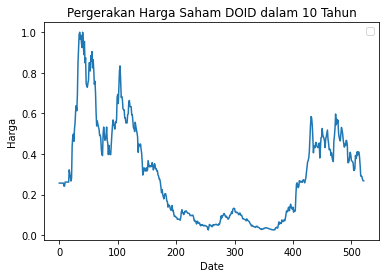

In [ ]:
DOID = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/DOID.JK.csv')

DOID_x = DOID['No'].values
DOID_y = DOID['Skala'].values

plt.plot(DOID_x,DOID_y)
plt.title('Pergerakan Harga Saham DOID dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()


**1. PERCOBAAN 15 DATA DOID**

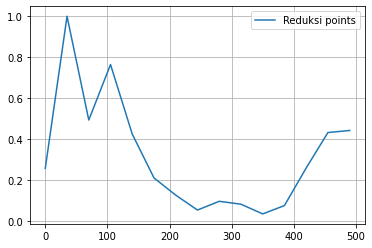

In [ ]:
DOID_x15 = DOID_x[0:522:35]
DOID_y15 = DOID_y[0:522:35]

plt.plot(DOID_x15, DOID_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_DOID_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_DOID_15: [ 0.25628106  1.86086587 -0.09610313  1.0172684   0.33160581  0.1973062
  0.1343611   0.01530297  0.11669424  0.08734851  0.01761973  0.04116636
  0.33511     0.51999411  0.44135806  0.          0.          0.
  0.        ]
k_DOID_15: 3



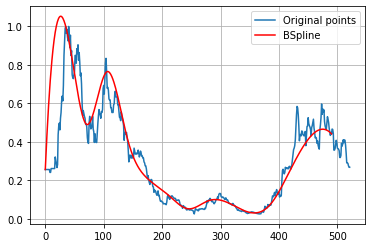

In [ ]:
import scipy.interpolate as interpolate

t_DOID_15, c_DOID_15, k_DOID_15 = interpolate.splrep(DOID_x15, DOID_y15, s=0, k=3)
print('''\
t_DOID_15: {}
c_DOID_15: {}
k_DOID_15: {}
'''.format(t_DOID_15, c_DOID_15, k_DOID_15))
N = 522
xmin_DOID_15, xmax_DOID_15 = DOID_x15.min(), DOID_x15.max()
xx_DOID_15 = np.linspace(xmin_DOID_15, xmax_DOID_15, N)
spline_DOID_15 = interpolate.BSpline(t_DOID_15, c_DOID_15, k_DOID_15, extrapolate=False)

plt.plot(DOID_x, DOID_y, label='Original points')
plt.plot(xx_DOID_15, spline_DOID_15(xx_DOID_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA DOID**

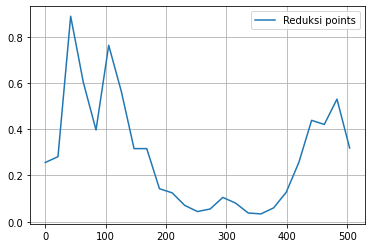

In [ ]:
DOID_x25 = DOID_x[0:522:21]
DOID_y25 = DOID_y[0:522:21]

plt.plot(DOID_x25, DOID_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_DOID_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_DOID_25: [ 0.25628106 -0.39441722  1.3415982   0.5638139   0.21566691  0.95542535
  0.54555086  0.23926562  0.39548142  0.07690347  0.15410881  0.05671488
  0.04151082  0.04052595  0.12702125  0.08204634  0.02850143  0.03049474
  0.05157487  0.12139464  0.22820738  0.51180466  0.30595197  0.72336213
  0.31890033  0.          0.          0.          0.        ]
k_DOID_25: 3



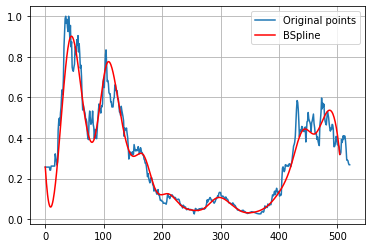

In [ ]:
import scipy.interpolate as interpolate

t_DOID_25, c_DOID_25, k_DOID_25 = interpolate.splrep(DOID_x25, DOID_y25, s=0, k=3)
print('''\
t_DOID_25: {}
c_DOID_25: {}
k_DOID_25: {}
'''.format(t_DOID_25, c_DOID_25, k_DOID_25))
N = 522
xmin_DOID_25, xmax_DOID_25 = DOID_x25.min(), DOID_x25.max()
xx_DOID_25 = np.linspace(xmin_DOID_25, xmax_DOID_25, N)
spline_DOID_25 = interpolate.BSpline(t_DOID_25, c_DOID_25, k_DOID_25, extrapolate=False)

plt.plot(DOID_x, DOID_y, label='Original points')
plt.plot(xx_DOID_25, spline_DOID_25(xx_DOID_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA DOID**

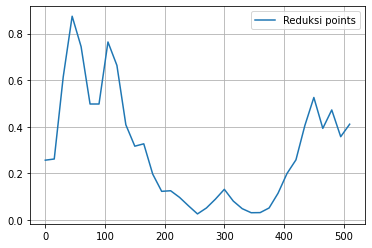

In [ ]:
DOID_x35 = DOID_x[0:522:15]
DOID_y35 = DOID_y[0:522:15]

plt.plot(DOID_x35, DOID_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_DOID_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_DOID_35: [0.25628106 0.04755166 0.51544978 0.96425912 0.76152297 0.45194724
 0.41560753 0.87054209 0.68514328 0.36879158 0.28884495 0.3739234
 0.17478509 0.10559188 0.13759375 0.09408671 0.06467219 0.00847484
 0.05450063 0.07966697 0.1595226  0.06903353 0.04805131 0.02653687
 0.02948778 0.04226004 0.10761637 0.21303775 0.23419546 0.3962092
 0.61481507 0.29781699 0.6356986  0.17580841 0.41074363 0.
 0.         0.         0.        ]
k_DOID_35: 3



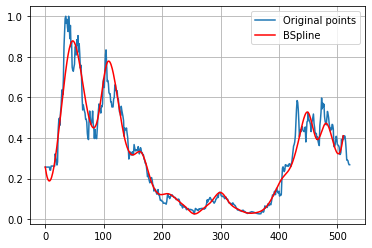

In [ ]:
import scipy.interpolate as interpolate

t_DOID_35, c_DOID_35, k_DOID_35 = interpolate.splrep(DOID_x35, DOID_y35, s=0, k=3)
print('''\
t_DOID_35: {}
c_DOID_35: {}
k_DOID_35: {}
'''.format(t_DOID_35, c_DOID_35, k_DOID_35))
N = 522
xmin_DOID_35, xmax_DOID_35 = DOID_x35.min(), DOID_x35.max()
xx_DOID_35 = np.linspace(xmin_DOID_35, xmax_DOID_35, N)
spline_DOID_35 = interpolate.BSpline(t_DOID_35, c_DOID_35, k_DOID_35, extrapolate=False)

plt.plot(DOID_x, DOID_y, label='Original points')
plt.plot(xx_DOID_35, spline_DOID_35(xx_DOID_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA DOID**

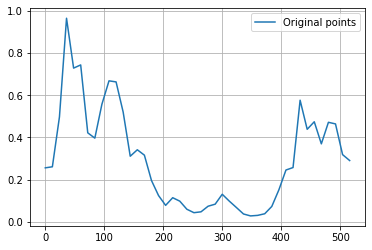

In [ ]:
DOID_x45 = DOID_x[0:522:12]
DOID_y45 = DOID_y[0:522:12]

plt.plot(DOID_x45, DOID_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_DOID_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_DOID_45: [0.25628106 0.27658917 0.11516357 1.20832404 0.56719443 0.8947617
 0.31605699 0.37366881 0.57117466 0.68837146 0.68537079 0.55005218
 0.23709256 0.36905794 0.33784262 0.17766637 0.13014755 0.05179702
 0.13412661 0.10052125 0.05464692 0.04214136 0.04007174 0.08534734
 0.06550961 0.15775234 0.09027192 0.0720185  0.03188747 0.02697842
 0.03163966 0.03321095 0.06818621 0.13489204 0.3045557  0.12250078
 0.75146999 0.33105005 0.55717096 0.28740826 0.5127423  0.48702919
 0.20549707 0.2908371  0.         0.         0.         0.        ]
k_DOID_45: 3



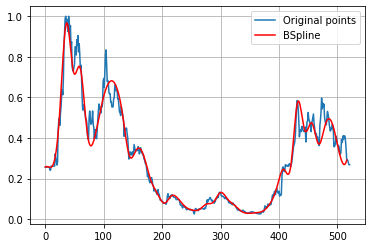

In [ ]:
import scipy.interpolate as interpolate

t_DOID_45, c_DOID_45, k_DOID_45 = interpolate.splrep(DOID_x45, DOID_y45, s=0, k=3)
print('''\
t_DOID_45: {}
c_DOID_45: {}
k_DOID_45: {}
'''.format(t_DOID_45, c_DOID_45, k_DOID_45))
N = 522
xmin_DOID_45, xmax_DOID_45 = DOID_x45.min(), DOID_x45.max()
xx_DOID_45 = np.linspace(xmin_DOID_45, xmax_DOID_45, N)
spline_DOID_45 = interpolate.BSpline(t_DOID_45, c_DOID_45, k_DOID_45, extrapolate=False)

plt.plot(DOID_x, DOID_y, label='Original points')
plt.plot(xx_DOID_45, spline_DOID_45(xx_DOID_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA DOID**

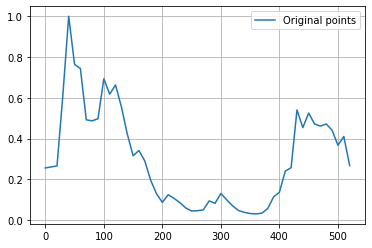

In [ ]:
DOID_x55 = DOID_x[0:522:10]
DOID_y55 = DOID_y[0:522:10]

plt.plot(DOID_x55, DOID_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_DOID_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_DOID_55: [0.25628106 0.3598405  0.06423858 0.57198266 1.19928005 0.63089714
 0.86005053 0.39119895 0.52992394 0.41372341 0.80010187 0.54667649
 0.72173258 0.54629997 0.43004062 0.2745354  0.36991257 0.29698128
 0.18718495 0.13293455 0.06174486 0.14665425 0.10169173 0.08948191
 0.05776452 0.0407103  0.05186271 0.03349162 0.12031511 0.05467637
 0.15999464 0.09213597 0.07150436 0.04432577 0.03896824 0.03247094
 0.0301418  0.0337099  0.04319674 0.13638479 0.09702736 0.30209541
 0.13959217 0.6855647  0.36327882 0.58600448 0.44598976 0.46187142
 0.47713063 0.46144101 0.27985794 0.52274592 0.26787628 0.
 0.         0.         0.        ]
k_DOID_55: 3



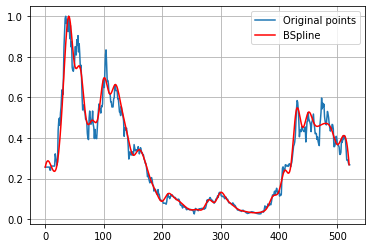

In [ ]:
import scipy.interpolate as interpolate

t_DOID_55, c_DOID_55, k_DOID_55 = interpolate.splrep(DOID_x55, DOID_y55, s=0, k=3)
print('''\
t_DOID_55: {}
c_DOID_55: {}
k_DOID_55: {}
'''.format(t_DOID_55, c_DOID_55, k_DOID_55))
N = 522
xmin_DOID_55, xmax_DOID_55 = DOID_x55.min(), DOID_x55.max()
xx_DOID_55 = np.linspace(xmin_DOID_55, xmax_DOID_55, N)
spline_DOID_55 = interpolate.BSpline(t_DOID_55, c_DOID_55, k_DOID_55, extrapolate=False)

plt.plot(DOID_x, DOID_y, label='Original points')
plt.plot(xx_DOID_55, spline_DOID_55(xx_DOID_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA DOID**

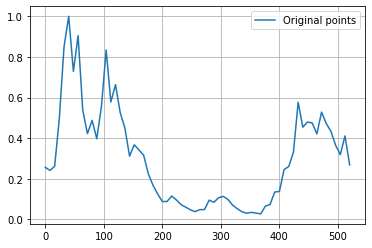

In [ ]:
DOID_x65 = DOID_x[0:522:8]
DOID_y65 = DOID_y[0:522:8]

plt.plot(DOID_x65, DOID_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_DOID_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_DOID_65: [0.25628106 0.28958888 0.12685049 0.4759722  0.86689973 1.15189499
 0.52552032 1.11788717 0.43007376 0.38793611 0.55084027 0.33332093
 0.4977829  1.02228636 0.41810262 0.77263236 0.47127474 0.49555517
 0.2405746  0.40962678 0.32515739 0.3409106  0.209295   0.1689444
 0.12520364 0.08029463 0.08018608 0.12859073 0.09427572 0.06985771
 0.06101836 0.04731916 0.03135777 0.05685801 0.02898586 0.11803567
 0.06829992 0.1139028  0.1159305  0.10201557 0.06686577 0.05300053
 0.03646077 0.02770319 0.03641305 0.03482273 0.01104405 0.08325755
 0.04779047 0.16642838 0.09471702 0.2812932  0.2557258  0.25713961
 0.70565383 0.379675

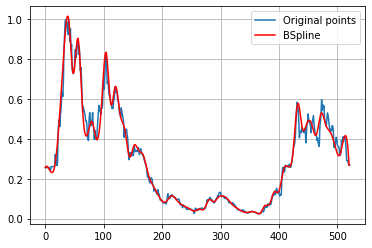

In [ ]:
import scipy.interpolate as interpolate

t_DOID_65, c_DOID_65, k_DOID_65 = interpolate.splrep(DOID_x65, DOID_y65, s=0, k=3)
print('''\
t_DOID_65: {}
c_DOID_65: {}
k_DOID_65: {}
'''.format(t_DOID_65, c_DOID_65, k_DOID_65))
N = 522
xmin_DOID_65, xmax_DOID_65 = DOID_x65.min(), DOID_x65.max()
xx_DOID_65 = np.linspace(xmin_DOID_65, xmax_DOID_65, N)
spline_DOID_65 = interpolate.BSpline(t_DOID_65, c_DOID_65, k_DOID_65, extrapolate=False)

plt.plot(DOID_x, DOID_y, label='Original points')
plt.plot(xx_DOID_65, spline_DOID_65(xx_DOID_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE DOID**

In [ ]:

#RMSE 15 DATA DOID
y_true_DOID_15 = DOID_y.tolist()
y_pred_DOID_15 = spline_DOID_15(xx_DOID_15).tolist()
mse_DOID_15 = mean_squared_error(y_true_DOID_15, y_pred_DOID_15)
rmse_DOID_15 = np.sqrt(mse_DOID_15)
print("rmse DOID 15 =",rmse_DOID_15)

#RMSE 25 DATA DOID
y_true_DOID_25 = DOID_y.tolist()
y_pred_DOID_25 = spline_DOID_25(xx_DOID_25).tolist()
mse_DOID_25 = mean_squared_error(y_true_DOID_25, y_pred_DOID_25)
rmse_DOID_25 = np.sqrt(mse_DOID_25)
print("rmse DOID 25 =",rmse_DOID_25)

#RMSE 35 DATA DOID
y_true_DOID_35 = DOID_y.tolist()
y_pred_DOID_35 = spline_DOID_35(xx_DOID_35).tolist()
mse_DOID_35 = mean_squared_error(y_true_DOID_35, y_pred_DOID_35)
rmse_DOID_35 = np.sqrt(mse_DOID_35)
print("rmse DOID 35 =",rmse_DOID_35)

#RMSE 45 DATA DOID
y_true_DOID_45 = DOID_y.tolist()
y_pred_DOID_45 = spline_DOID_45(xx_DOID_45).tolist()
mse_DOID_45 = mean_squared_error(y_true_DOID_45, y_pred_DOID_45)
rmse_DOID_45 = np.sqrt(mse_DOID_45)
print("rmse DOID 45 =",rmse_DOID_45)

#RMSE 55 DATA DOID
y_true_DOID_55 = DOID_y.tolist()
y_pred_DOID_55 = spline_DOID_55(xx_DOID_55).tolist()
mse_DOID_55 = mean_squared_error(y_true_DOID_55, y_pred_DOID_55)
rmse_DOID_55 = np.sqrt(mse_DOID_55)
print("rmse DOID 55 =",rmse_DOID_55)

#RMSE 65 DATA DOID
y_true_DOID_65 = DOID_y.tolist()
y_pred_DOID_65 = spline_DOID_65(xx_DOID_65).tolist()
mse_DOID_65 = mean_squared_error(y_true_DOID_65, y_pred_DOID_65)
rmse_DOID_65 = np.sqrt(mse_DOID_65)
print("rmse DOID 65 =",rmse_DOID_65)

rmse DOID 15 = 0.15922984819850908
rmse DOID 25 = 0.08780805285196348
rmse DOID 35 = 0.06966807492187486
rmse DOID 45 = 0.05361851361682593
rmse DOID 55 = 0.04174592834625161
rmse DOID 65 = 0.03396100983163588


# **ELSA**

No handles with labels found to put in legend.


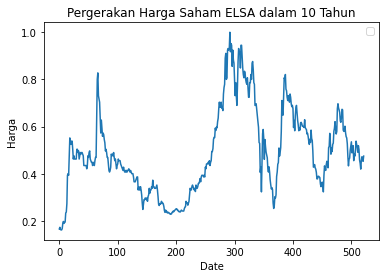

In [ ]:
ELSA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ELSA.JK.csv')

ELSA_x = ELSA['No'].values
ELSA_y = ELSA['Skala'].values

plt.plot(ELSA_x,ELSA_y)
plt.title('Pergerakan Harga Saham ELSA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ELSA**

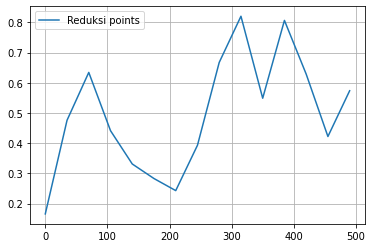

In [ ]:
ELSA_x15 = ELSA_x[0:522:35]
ELSA_y15 = ELSA_y[0:522:35]

plt.plot(ELSA_x15, ELSA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ELSA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ELSA_15: [0.16551724 0.33398753 0.83547321 0.39966374 0.32310005 0.29414297
 0.19687979 0.37488961 0.66218247 0.98189776 0.33436441 0.97443769
 0.48753962 0.29967847 0.5737931  0.         0.         0.
 0.        ]
k_ELSA_15: 3



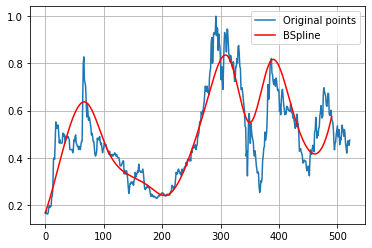

In [ ]:
import scipy.interpolate as interpolate

t_ELSA_15, c_ELSA_15, k_ELSA_15 = interpolate.splrep(ELSA_x15, ELSA_y15, s=0, k=3)
print('''\
t_ELSA_15: {}
c_ELSA_15: {}
k_ELSA_15: {}
'''.format(t_ELSA_15, c_ELSA_15, k_ELSA_15))
N = 522
xmin_ELSA_15, xmax_ELSA_15 = ELSA_x15.min(), ELSA_x15.max()
xx_ELSA_15 = np.linspace(xmin_ELSA_15, xmax_ELSA_15, N)
spline_ELSA_15 = interpolate.BSpline(t_ELSA_15, c_ELSA_15, k_ELSA_15, extrapolate=False)

plt.plot(ELSA_x, ELSA_y, label='Original points')
plt.plot(xx_ELSA_15, spline_ELSA_15(xx_ELSA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ELSA**

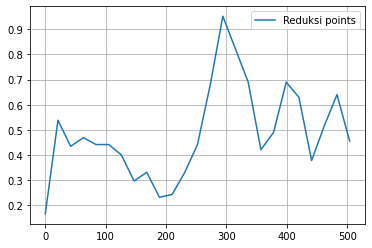

In [ ]:
ELSA_x25 = ELSA_x[0:522:21]
ELSA_y25 = ELSA_y[0:522:21]

plt.plot(ELSA_x25, ELSA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ELSA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ELSA_25: [0.16551724 0.76250435 0.32671543 0.50475445 0.42355013 0.4493209
 0.42744215 0.24091052 0.38822613 0.19239186 0.23255127 0.3339548
 0.41783644 0.6429753  1.07371062 0.77252704 0.76031914 0.32412744
 0.46730903 0.74456748 0.6923521  0.25981722 0.62801458 0.72323409
 0.45517241 0.         0.         0.         0.        ]
k_ELSA_25: 3



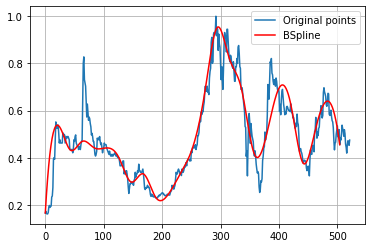

In [ ]:

import scipy.interpolate as interpolate

t_ELSA_25, c_ELSA_25, k_ELSA_25 = interpolate.splrep(ELSA_x25, ELSA_y25, s=0, k=3)
print('''\
t_ELSA_25: {}
c_ELSA_25: {}
k_ELSA_25: {}
'''.format(t_ELSA_25, c_ELSA_25, k_ELSA_25))
N = 522
xmin_ELSA_25, xmax_ELSA_25 = ELSA_x25.min(), ELSA_x25.max()
xx_ELSA_25 = np.linspace(xmin_ELSA_25, xmax_ELSA_25, N)
spline_ELSA_25 = interpolate.BSpline(t_ELSA_25, c_ELSA_25, k_ELSA_25, extrapolate=False)

plt.plot(ELSA_x, ELSA_y, label='Original points')
plt.plot(xx_ELSA_25, spline_ELSA_25(xx_ELSA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA ELSA**

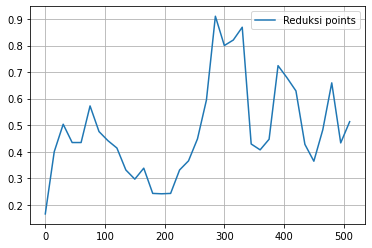

In [ ]:
ELSA_x35 = ELSA_x[0:522:15]
ELSA_y35 = ELSA_y[0:522:15]

plt.plot(ELSA_x35, ELSA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ELSA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ELSA_35: [0.16551724 0.3394915  0.58653425 0.41962391 0.38359424 0.65289568
 0.43930579 0.44505357 0.42875578 0.32268194 0.26672337 0.38973492
 0.20192317 0.25912413 0.20985617 0.35800291 0.3443391  0.45774415
 0.51433949 1.05179445 0.74055168 0.78599882 1.03959098 0.26943037
 0.45648066 0.34602631 0.8407934  0.63562768 0.68842001 0.38448538
 0.3391557  0.4437194  0.89545144 0.12537773 0.51310345 0.
 0.         0.         0.        ]
k_ELSA_35: 3



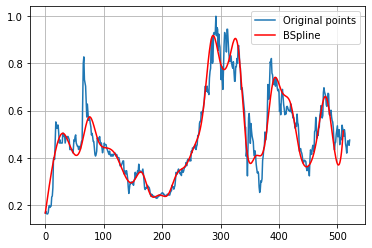

In [ ]:
import scipy.interpolate as interpolate

t_ELSA_35, c_ELSA_35, k_ELSA_35 = interpolate.splrep(ELSA_x35, ELSA_y35, s=0, k=3)
print('''\
t_ELSA_35: {}
c_ELSA_35: {}
k_ELSA_35: {}
'''.format(t_ELSA_35, c_ELSA_35, k_ELSA_35))
N = 522
xmin_ELSA_35, xmax_ELSA_35 = ELSA_x35.min(), ELSA_x35.max()
xx_ELSA_35 = np.linspace(xmin_ELSA_35, xmax_ELSA_35, N)
spline_ELSA_35 = interpolate.BSpline(t_ELSA_35, c_ELSA_35, k_ELSA_35, extrapolate=False)

plt.plot(ELSA_x, ELSA_y, label='Original points')
plt.plot(xx_ELSA_35, spline_ELSA_35(xx_ELSA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA ELSA**

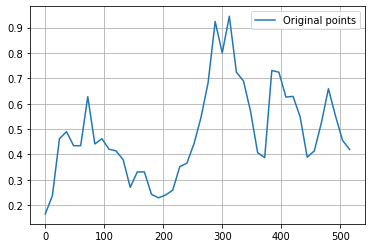

In [ ]:
ELSA_x45 = ELSA_x[0:522:12]
ELSA_y45 = ELSA_y[0:522:12]

plt.plot(ELSA_x45, ELSA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ELSA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ELSA_45: [0.16551724 0.05589224 0.52338792 0.49526294 0.44052258 0.34954331
 0.76820075 0.34317093 0.50739139 0.3996773  0.41803733 0.41093199
 0.21409679 0.35474982 0.35311083 0.21901374 0.22738592 0.24523569
 0.23167133 0.38394107 0.34290921 0.43752553 0.55526453 0.61865775
 1.06665622 0.65954497 1.0951639  0.62876496 0.73460384 0.5707507
 0.40032439 0.26933106 0.84786863 0.72540132 0.59535368 0.65042536
 0.576738   0.33641575 0.41139209 0.50077449 0.73033753 0.4682041
 0.43348416 0.41931034 0.         0.         0.         0.        ]
k_ELSA_45: 3



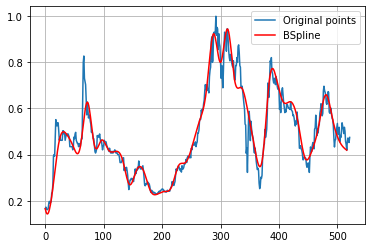

In [ ]:
import scipy.interpolate as interpolate

t_ELSA_45, c_ELSA_45, k_ELSA_45 = interpolate.splrep(ELSA_x45, ELSA_y45, s=0, k=3)
print('''\
t_ELSA_45: {}
c_ELSA_45: {}
k_ELSA_45: {}
'''.format(t_ELSA_45, c_ELSA_45, k_ELSA_45))
N = 522
xmin_ELSA_45, xmax_ELSA_45 = ELSA_x45.min(), ELSA_x45.max()
xx_ELSA_45 = np.linspace(xmin_ELSA_45, xmax_ELSA_45, N)
spline_ELSA_45 = interpolate.BSpline(t_ELSA_45, c_ELSA_45, k_ELSA_45, extrapolate=False)

plt.plot(ELSA_x, ELSA_y, label='Original points')
plt.plot(xx_ELSA_45, spline_ELSA_45(xx_ELSA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA ELSA**

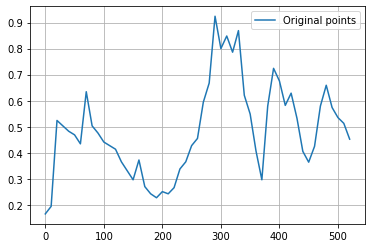

In [ ]:
ELSA_x55 = ELSA_x[0:522:10]
ELSA_y55 = ELSA_y[0:522:10]

plt.plot(ELSA_x55, ELSA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ELSA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ELSA_55: [ 0.16551724 -0.12436434  0.68183214  0.47748168  0.48001842  0.49899637
  0.33778919  0.75674343  0.44213364  0.49541165  0.43139218  0.42729549
  0.42494311  0.3556907   0.34539754  0.24892604  0.43820863  0.23272219
  0.25297156  0.21194329  0.26477252  0.23517354  0.25108506  0.35772761
  0.3455907   0.45301302  0.40787447  0.64652358  0.57292777  1.06728259
  0.70276945  0.92163961  0.70032728  0.99429265  0.53629521  0.58466444
  0.41884014  0.1813543   0.635053    0.75429576  0.69259153  0.53051054
  0.6777801   0.53216217  0.38805398  0.34872535  0.40187219  0.5927514
  0.70298428  0.55117354  0.52971573  0.51445248  0.45241379  0.
  0.          0.          0.        ]
k

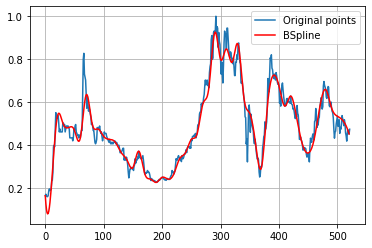

In [ ]:
import scipy.interpolate as interpolate

t_ELSA_55, c_ELSA_55, k_ELSA_55 = interpolate.splrep(ELSA_x55, ELSA_y55, s=0, k=3)
print('''\
t_ELSA_55: {}
c_ELSA_55: {}
k_ELSA_55: {}
'''.format(t_ELSA_55, c_ELSA_55, k_ELSA_55))
N = 522
xmin_ELSA_55, xmax_ELSA_55 = ELSA_x55.min(), ELSA_x55.max()
xx_ELSA_55 = np.linspace(xmin_ELSA_55, xmax_ELSA_55, N)
spline_ELSA_55 = interpolate.BSpline(t_ELSA_55, c_ELSA_55, k_ELSA_55, extrapolate=False)

plt.plot(ELSA_x, ELSA_y, label='Original points')
plt.plot(xx_ELSA_55, spline_ELSA_55(xx_ELSA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA ELSA**

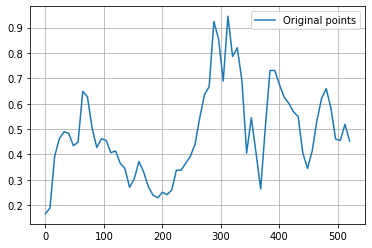

In [ ]:
ELSA_x65 = ELSA_x[0:522:8]
ELSA_y65 = ELSA_y[0:522:8]

plt.plot(ELSA_x65, ELSA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ELSA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ELSA_65: [0.16551724 0.02507297 0.42640579 0.46027638 0.49643486 0.49191522
 0.43245597 0.38515745 0.71656939 0.63822018 0.49606715 0.39820087
 0.47664661 0.46762649 0.38388192 0.43822516 0.34597606 0.37097405
 0.23909324 0.29472195 0.40270861 0.32892637 0.26779279 0.23852314
 0.21811464 0.26281141 0.23684663 0.23807794 0.36670369 0.32269351
 0.37010847 0.38997606 0.428608   0.54386782 0.67316212 0.57865611
 1.0177307  0.89524869 0.53230902 1.11344625 0.68287148 0.87230919
 0.75202967 0.25750316 0.65106115 0.40721774 0.16144718 0.52768319
 0.78161317 0.73207104 0.67630956 0.61786314 0.60947925 0.5524957
 0.59019312 0.380524

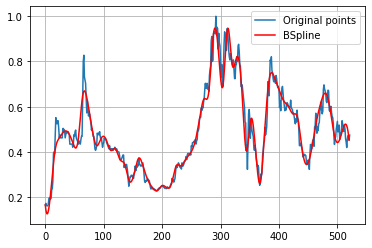

In [ ]:
import scipy.interpolate as interpolate

t_ELSA_65, c_ELSA_65, k_ELSA_65 = interpolate.splrep(ELSA_x65, ELSA_y65, s=0, k=3)
print('''\
t_ELSA_65: {}
c_ELSA_65: {}
k_ELSA_65: {}
'''.format(t_ELSA_65, c_ELSA_65, k_ELSA_65))
N = 522
xmin_ELSA_65, xmax_ELSA_65 = ELSA_x65.min(), ELSA_x65.max()
xx_ELSA_65 = np.linspace(xmin_ELSA_65, xmax_ELSA_65, N)
spline_ELSA_65 = interpolate.BSpline(t_ELSA_65, c_ELSA_65, k_ELSA_65, extrapolate=False)

plt.plot(ELSA_x, ELSA_y, label='Original points')
plt.plot(xx_ELSA_65, spline_ELSA_65(xx_ELSA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE ELSA**

In [ ]:

#RMSE 15 DATA ELSA
y_true_ELSA_15 = ELSA_y.tolist()
y_pred_ELSA_15 = spline_ELSA_15(xx_ELSA_15).tolist()
mse_ELSA_15 = mean_squared_error(y_true_ELSA_15, y_pred_ELSA_15)
rmse_ELSA_15 = np.sqrt(mse_ELSA_15)
print("rmse ELSA 15 =",rmse_ELSA_15)

#RMSE 25 DATA ELSA
y_true_ELSA_25 = ELSA_y.tolist()
y_pred_ELSA_25 = spline_ELSA_25(xx_ELSA_25).tolist()
mse_ELSA_25 = mean_squared_error(y_true_ELSA_25, y_pred_ELSA_25)
rmse_ELSA_25 = np.sqrt(mse_ELSA_25)
print("rmse ELSA 25 =",rmse_ELSA_25)

#RMSE 35 DATA ELSA
y_true_ELSA_35 = ELSA_y.tolist()
y_pred_ELSA_35 = spline_ELSA_35(xx_ELSA_35).tolist()
mse_ELSA_35 = mean_squared_error(y_true_ELSA_35, y_pred_ELSA_35)
rmse_ELSA_35 = np.sqrt(mse_ELSA_35)
print("rmse ELSA 35 =",rmse_ELSA_35)

#RMSE 45 DATA ELSA
y_true_ELSA_45 = ELSA_y.tolist()
y_pred_ELSA_45 = spline_ELSA_45(xx_ELSA_45).tolist()
mse_ELSA_45 = mean_squared_error(y_true_ELSA_45, y_pred_ELSA_45)
rmse_ELSA_45 = np.sqrt(mse_ELSA_45)
print("rmse ELSA 45 =",rmse_ELSA_45)

#RMSE 55 DATA ELSA
y_true_ELSA_55 = ELSA_y.tolist()
y_pred_ELSA_55 = spline_ELSA_55(xx_ELSA_55).tolist()
mse_ELSA_55 = mean_squared_error(y_true_ELSA_55, y_pred_ELSA_55)
rmse_ELSA_55 = np.sqrt(mse_ELSA_55)
print("rmse ELSA 55 =",rmse_ELSA_55)

#RMSE 65 DATA ELSA
y_true_ELSA_65 = ELSA_y.tolist()
y_pred_ELSA_65 = spline_ELSA_65(xx_ELSA_65).tolist()
mse_ELSA_65 = mean_squared_error(y_true_ELSA_65, y_pred_ELSA_65)
rmse_ELSA_65 = np.sqrt(mse_ELSA_65)
print("rmse ELSA 65 =",rmse_ELSA_65)

rmse ELSA 15 = 0.1368641256857286
rmse ELSA 25 = 0.10471921101171701
rmse ELSA 35 = 0.08555155248947144
rmse ELSA 45 = 0.06016694216790964
rmse ELSA 55 = 0.04490059277920564
rmse ELSA 65 = 0.040495772484454934


# **EXCL**

No handles with labels found to put in legend.


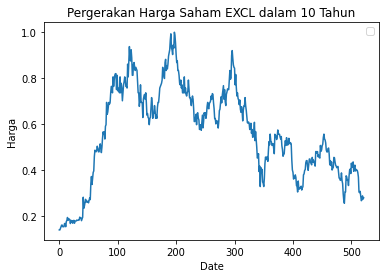

In [ ]:
EXCL = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/EXCL.JK.csv')

EXCL_x = EXCL['No'].values
EXCL_y = EXCL['Skala'].values

plt.plot(EXCL_x,EXCL_y)
plt.title('Pergerakan Harga Saham EXCL dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA EXCL**

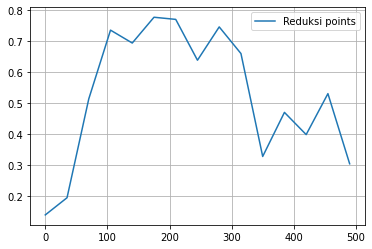

In [ ]:
EXCL_x15 = EXCL_x[0:522:35]
EXCL_y15 = EXCL_y[0:522:35]

plt.plot(EXCL_x15, EXCL_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_EXCL_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_EXCL_15: [0.13888899 0.0076024  0.43618565 0.81215898 0.63785331 0.80309358
 0.81644297 0.55613821 0.79234156 0.75366434 0.15550482 0.59098213
 0.2060768  0.78297841 0.30413926 0.         0.         0.
 0.        ]
k_EXCL_15: 3



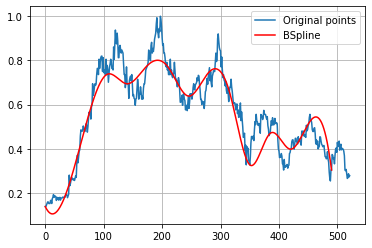

In [ ]:
import scipy.interpolate as interpolate

t_EXCL_15, c_EXCL_15, k_EXCL_15 = interpolate.splrep(EXCL_x15, EXCL_y15, s=0, k=3)
print('''\
t_EXCL_15: {}
c_EXCL_15: {}
k_EXCL_15: {}
'''.format(t_EXCL_15, c_EXCL_15, k_EXCL_15))
N = 522
xmin_EXCL_15, xmax_EXCL_15 = EXCL_x15.min(), EXCL_x15.max()
xx_EXCL_15 = np.linspace(xmin_EXCL_15, xmax_EXCL_15, N)
spline_EXCL_15 = interpolate.BSpline(t_EXCL_15, c_EXCL_15, k_EXCL_15, extrapolate=False)

plt.plot(EXCL_x, EXCL_y, label='Original points')
plt.plot(xx_EXCL_15, spline_EXCL_15(xx_EXCL_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA EXCL**

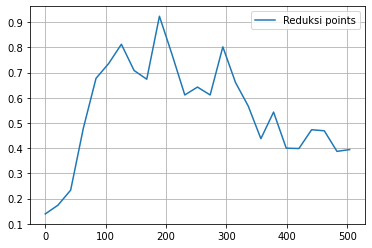

In [ ]:
EXCL_x25 = EXCL_x[0:522:21]
EXCL_y25 = EXCL_y[0:522:21]

plt.plot(EXCL_x25, EXCL_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_EXCL_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_EXCL_25: [0.13888899 0.21374037 0.08085346 0.49399931 0.71486598 0.70903463
 0.86566369 0.70331668 0.57106922 1.05407926 0.75428454 0.55378628
 0.69723959 0.51142639 0.92372409 0.60618274 0.61404868 0.34179409
 0.6437755  0.34144079 0.38978218 0.49030302 0.48675078 0.3152693
 0.3942546  0.         0.         0.         0.        ]
k_EXCL_25: 3



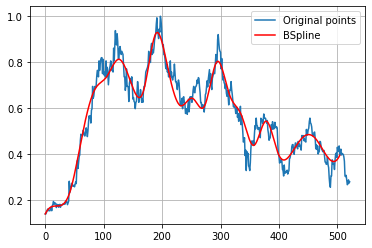

In [ ]:
import scipy.interpolate as interpolate

t_EXCL_25, c_EXCL_25, k_EXCL_25 = interpolate.splrep(EXCL_x25, EXCL_y25, s=0, k=3)
print('''\
t_EXCL_25: {}
c_EXCL_25: {}
k_EXCL_25: {}
'''.format(t_EXCL_25, c_EXCL_25, k_EXCL_25))
N = 522
xmin_EXCL_25, xmax_EXCL_25 = EXCL_x25.min(), EXCL_x25.max()
xx_EXCL_25 = np.linspace(xmin_EXCL_25, xmax_EXCL_25, N)
spline_EXCL_25 = interpolate.BSpline(t_EXCL_25, c_EXCL_25, k_EXCL_25, extrapolate=False)

plt.plot(EXCL_x, EXCL_y, label='Original points')
plt.plot(xx_EXCL_25, spline_EXCL_25(xx_EXCL_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA EXCL**

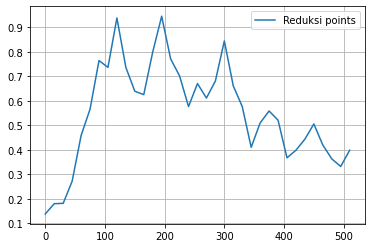

In [ ]:
EXCL_x35 = EXCL_x[0:522:15]
EXCL_y35 = EXCL_y[0:522:15]

plt.plot(EXCL_x35, EXCL_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_EXCL_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_EXCL_35: [0.13888899 0.21080721 0.14019271 0.24190925 0.50007877 0.50777758
 0.86464408 0.61698244 1.08409436 0.67164516 0.64599321 0.57771937
 0.79313242 1.04142276 0.70784854 0.75218677 0.49173712 0.73919852
 0.57230799 0.63823877 0.95806847 0.59198659 0.63648891 0.32039153
 0.54444232 0.56017072 0.56487585 0.30620162 0.41532733 0.4233616
 0.5524448  0.39980351 0.35464999 0.29683656 0.39847875 0.
 0.         0.         0.        ]
k_EXCL_35: 3



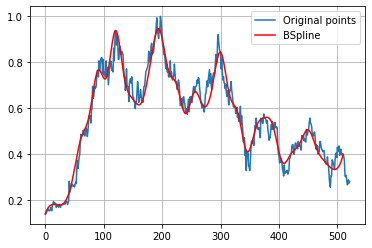

In [ ]:
import scipy.interpolate as interpolate

t_EXCL_35, c_EXCL_35, k_EXCL_35 = interpolate.splrep(EXCL_x35, EXCL_y35, s=0, k=3)
print('''\
t_EXCL_35: {}
c_EXCL_35: {}
k_EXCL_35: {}
'''.format(t_EXCL_35, c_EXCL_35, k_EXCL_35))
N = 522
xmin_EXCL_35, xmax_EXCL_35 = EXCL_x35.min(), EXCL_x35.max()
xx_EXCL_35 = np.linspace(xmin_EXCL_35, xmax_EXCL_35, N)
spline_EXCL_35 = interpolate.BSpline(t_EXCL_35, c_EXCL_35, k_EXCL_35, extrapolate=False)

plt.plot(EXCL_x, EXCL_y, label='Original points')
plt.plot(xx_EXCL_35, spline_EXCL_35(xx_EXCL_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA EXCL**

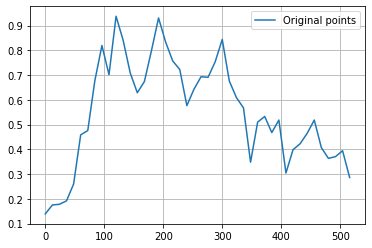

In [ ]:
EXCL_x45 = EXCL_x[0:522:12]
EXCL_y45 = EXCL_y[0:522:12]

plt.plot(EXCL_x45, EXCL_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_EXCL_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_EXCL_45: [0.13888899 0.18716258 0.16734044 0.19204526 0.20830352 0.53307425
 0.4094014  0.6834896  0.91913805 0.55663121 1.06266985 0.81769446
 0.70821827 0.5994321  0.66489007 0.78268045 0.99605996 0.81641742
 0.73826897 0.7721761  0.50636054 0.6607155  0.70494851 0.67782593
 0.72957991 0.92469017 0.63415865 0.59284315 0.64863424 0.21679143
 0.57170201 0.55473205 0.40520605 0.6292836  0.18663865 0.44899736
 0.40824445 0.4525187  0.56962399 0.37796446 0.36008059 0.36181034
 0.44356595 0.28583458 0.         0.         0.         0.        ]
k_EXCL_45: 3



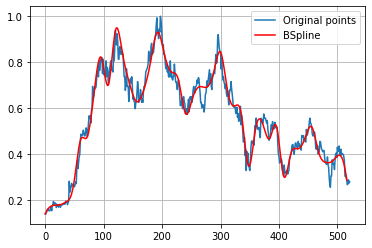

In [ ]:
import scipy.interpolate as interpolate

t_EXCL_45, c_EXCL_45, k_EXCL_45 = interpolate.splrep(EXCL_x45, EXCL_y45, s=0, k=3)
print('''\
t_EXCL_45: {}
c_EXCL_45: {}
k_EXCL_45: {}
'''.format(t_EXCL_45, c_EXCL_45, k_EXCL_45))
N = 522
xmin_EXCL_45, xmax_EXCL_45 = EXCL_x45.min(), EXCL_x45.max()
xx_EXCL_45 = np.linspace(xmin_EXCL_45, xmax_EXCL_45, N)
spline_EXCL_45 = interpolate.BSpline(t_EXCL_45, c_EXCL_45, k_EXCL_45, extrapolate=False)

plt.plot(EXCL_x, EXCL_y, label='Original points')
plt.plot(xx_EXCL_45, spline_EXCL_45(xx_EXCL_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA EXCL**

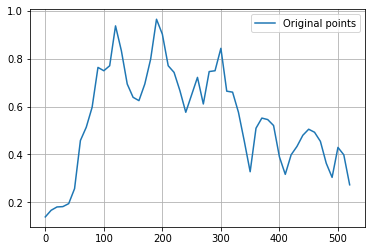

In [ ]:
EXCL_x55 = EXCL_x[0:522:10]
EXCL_y55 = EXCL_y[0:522:10]

plt.plot(EXCL_x55, EXCL_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_EXCL_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_EXCL_55: [0.13888899 0.16048363 0.18597791 0.17821009 0.19478937 0.20930215
 0.50966701 0.50203174 0.56554442 0.81912554 0.74128977 0.71571745
 1.0208441  0.82591119 0.67550977 0.63871553 0.60296548 0.69942565
 0.76599771 1.02825532 0.91265418 0.73779754 0.76115935 0.6759002
 0.53524575 0.64145055 0.79479003 0.51272328 0.82098611 0.6825011
 0.94901154 0.58395194 0.70268284 0.56782042 0.48436924 0.22803604
 0.57015234 0.54968611 0.5436021  0.55091086 0.3786302  0.27475098
 0.42323625 0.42317656 0.48613787 0.51314663 0.49421989 0.46688328
 0.36705201 0.24457339 0.55779554 0.34240523 0.27316211 0.
 0.         0.         0.        ]
k_EXCL_55: 3



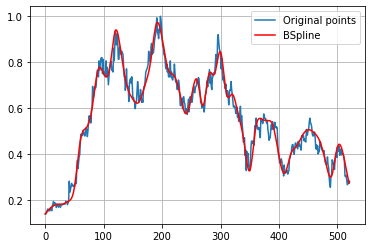

In [ ]:
import scipy.interpolate as interpolate

t_EXCL_55, c_EXCL_55, k_EXCL_55 = interpolate.splrep(EXCL_x55, EXCL_y55, s=0, k=3)
print('''\
t_EXCL_55: {}
c_EXCL_55: {}
k_EXCL_55: {}
'''.format(t_EXCL_55, c_EXCL_55, k_EXCL_55))
N = 522
xmin_EXCL_55, xmax_EXCL_55 = EXCL_x55.min(), EXCL_x55.max()
xx_EXCL_55 = np.linspace(xmin_EXCL_55, xmax_EXCL_55, N)
spline_EXCL_55 = interpolate.BSpline(t_EXCL_55, c_EXCL_55, k_EXCL_55, extrapolate=False)

plt.plot(EXCL_x, EXCL_y, label='Original points')
plt.plot(xx_EXCL_55, spline_EXCL_55(xx_EXCL_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA EXCL**

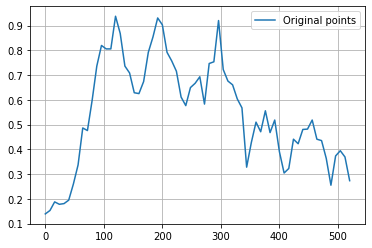

In [ ]:
EXCL_x65 = EXCL_x[0:522:8]
EXCL_y65 = EXCL_y[0:522:8]

plt.plot(EXCL_x65, EXCL_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_EXCL_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_EXCL_65: [0.13888899 0.11815042 0.21161598 0.17042457 0.18365063 0.17830857
 0.26978481 0.30088578 0.54750851 0.42575046 0.60365913 0.74294799
 0.84121711 0.80885657 0.75669534 0.99770082 0.87750645 0.70060748
 0.73673183 0.60246486 0.62424549 0.65055627 0.81520227 0.83863954
 0.95523941 0.92374052 0.76646808 0.76039206 0.7336331  0.59674253
 0.54606602 0.67732717 0.64046328 0.76082564 0.47456963 0.83673177
 0.65767209 1.0534156  0.64950263 0.68190781 0.67703407 0.57245966
 0.65396443 0.21585416 0.44928468 0.54950705 0.41101866 0.63141595
 0.3966501  0.58682349 0.36503504 0.29321899 0.28692455 0.49374644
 0.38241161 0.51110

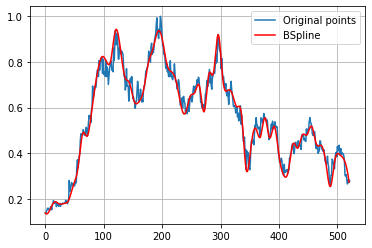

In [ ]:
import scipy.interpolate as interpolate

t_EXCL_65, c_EXCL_65, k_EXCL_65 = interpolate.splrep(EXCL_x65, EXCL_y65, s=0, k=3)
print('''\
t_EXCL_65: {}
c_EXCL_65: {}
k_EXCL_65: {}
'''.format(t_EXCL_65, c_EXCL_65, k_EXCL_65))
N = 522
xmin_EXCL_65, xmax_EXCL_65 = EXCL_x65.min(), EXCL_x65.max()
xx_EXCL_65 = np.linspace(xmin_EXCL_65, xmax_EXCL_65, N)
spline_EXCL_65 = interpolate.BSpline(t_EXCL_65, c_EXCL_65, k_EXCL_65, extrapolate=False)

plt.plot(EXCL_x, EXCL_y, label='Original points')
plt.plot(xx_EXCL_65, spline_EXCL_65(xx_EXCL_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE EXCL**

In [ ]:

#RMSE 15 DATA EXCL
y_true_EXCL_15 = EXCL_y.tolist()
y_pred_EXCL_15 = spline_EXCL_15(xx_EXCL_15).tolist()
mse_EXCL_15 = mean_squared_error(y_true_EXCL_15, y_pred_EXCL_15)
rmse_EXCL_15 = np.sqrt(mse_EXCL_15)
print("rmse EXCL 15 =",rmse_EXCL_15)

#RMSE 25 DATA EXCL
y_true_EXCL_25 = EXCL_y.tolist()
y_pred_EXCL_25 = spline_EXCL_25(xx_EXCL_25).tolist()
mse_EXCL_25 = mean_squared_error(y_true_EXCL_25, y_pred_EXCL_25)
rmse_EXCL_25 = np.sqrt(mse_EXCL_25)
print("rmse EXCL 25 =",rmse_EXCL_25)

#RMSE 35 DATA EXCL
y_true_EXCL_35 = EXCL_y.tolist()
y_pred_EXCL_35 = spline_EXCL_35(xx_EXCL_35).tolist()
mse_EXCL_35 = mean_squared_error(y_true_EXCL_35, y_pred_EXCL_35)
rmse_EXCL_35 = np.sqrt(mse_EXCL_35)
print("rmse EXCL 35 =",rmse_EXCL_35)

#RMSE 45 DATA EXCL
y_true_EXCL_45 = EXCL_y.tolist()
y_pred_EXCL_45 = spline_EXCL_45(xx_EXCL_45).tolist()
mse_EXCL_45 = mean_squared_error(y_true_EXCL_45, y_pred_EXCL_45)
rmse_EXCL_45 = np.sqrt(mse_EXCL_45)
print("rmse EXCL 45 =",rmse_EXCL_45)

#RMSE 55 DATA EXCL
y_true_EXCL_55 = EXCL_y.tolist()
y_pred_EXCL_55 = spline_EXCL_55(xx_EXCL_55).tolist()
mse_EXCL_55 = mean_squared_error(y_true_EXCL_55, y_pred_EXCL_55)
rmse_EXCL_55 = np.sqrt(mse_EXCL_55)
print("rmse EXCL 55 =",rmse_EXCL_55)

#RMSE 65 DATA EXCL
y_true_EXCL_65 = EXCL_y.tolist()
y_pred_EXCL_65 = spline_EXCL_65(xx_EXCL_65).tolist()
mse_EXCL_65 = mean_squared_error(y_true_EXCL_65, y_pred_EXCL_65)
rmse_EXCL_65 = np.sqrt(mse_EXCL_65)
print("rmse EXCL 65 =",rmse_EXCL_65)

rmse EXCL 15 = 0.09862736088928367
rmse EXCL 25 = 0.0698131150871824
rmse EXCL 35 = 0.05848791271981752
rmse EXCL 45 = 0.046661312928136266
rmse EXCL 55 = 0.034139695737932525
rmse EXCL 65 = 0.032587105756854105


# **GGRM**

No handles with labels found to put in legend.


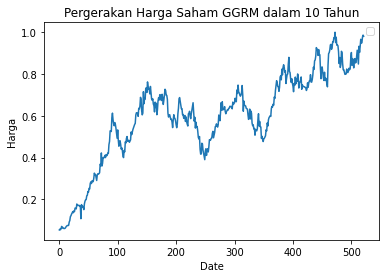

In [ ]:
GGRM = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/GGRM.JK.csv')

GGRM_x = GGRM['No'].values
GGRM_y = GGRM['Skala'].values

plt.plot(GGRM_x,GGRM_y)
plt.title('Pergerakan Harga Saham GGRM dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA GGRM**

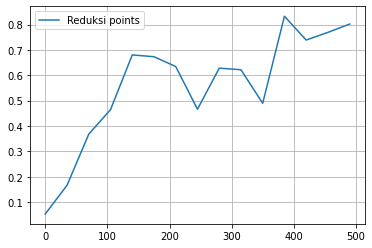

In [ ]:
GGRM_x15 = GGRM_x[0:522:35]
GGRM_y15 = GGRM_y[0:522:35]

plt.plot(GGRM_x15, GGRM_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GGRM_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_GGRM_15: [0.05364996 0.01918954 0.41676604 0.40365481 0.75817222 0.64457101
 0.70224207 0.35296905 0.68271551 0.68397896 0.31223938 1.00461851
 0.55164591 0.87699147 0.80181765 0.         0.         0.
 0.        ]
k_GGRM_15: 3



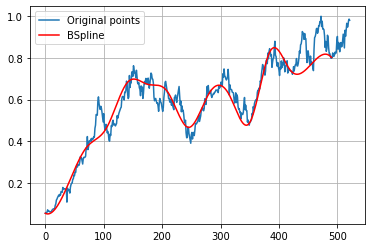

In [ ]:
import scipy.interpolate as interpolate

t_GGRM_15, c_GGRM_15, k_GGRM_15 = interpolate.splrep(GGRM_x15, GGRM_y15, s=0, k=3)
print('''\
t_GGRM_15: {}
c_GGRM_15: {}
k_GGRM_15: {}
'''.format(t_GGRM_15, c_GGRM_15, k_GGRM_15))
N = 522
xmin_GGRM_15, xmax_GGRM_15 = GGRM_x15.min(), GGRM_x15.max()
xx_GGRM_15 = np.linspace(xmin_GGRM_15, xmax_GGRM_15, N)
spline_GGRM_15 = interpolate.BSpline(t_GGRM_15, c_GGRM_15, k_GGRM_15, extrapolate=False)

plt.plot(GGRM_x, GGRM_y, label='Original points')
plt.plot(xx_GGRM_15, spline_GGRM_15(xx_GGRM_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA GGRM**

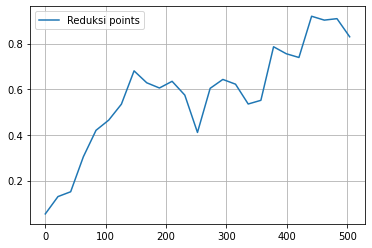

In [ ]:
GGRM_x25 = GGRM_x[0:522:21]
GGRM_y25 = GGRM_y[0:522:21]

plt.plot(GGRM_x25, GGRM_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GGRM_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_GGRM_25: [0.05364996 0.18689244 0.04236873 0.31915481 0.43415501 0.46313456
 0.49958643 0.74344498 0.60754836 0.59417162 0.64637202 0.62684867
 0.29038459 0.67423389 0.63449163 0.64356037 0.5221376  0.47809152
 0.87244443 0.74629083 0.67361476 0.99196782 0.83572385 0.9668493
 0.82937555 0.         0.         0.         0.        ]
k_GGRM_25: 3



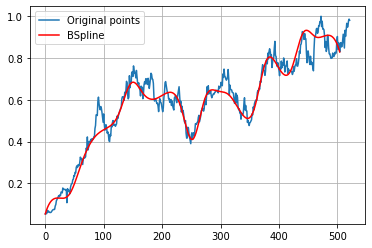

In [ ]:
import scipy.interpolate as interpolate

t_GGRM_25, c_GGRM_25, k_GGRM_25 = interpolate.splrep(GGRM_x25, GGRM_y25, s=0, k=3)
print('''\
t_GGRM_25: {}
c_GGRM_25: {}
k_GGRM_25: {}
'''.format(t_GGRM_25, c_GGRM_25, k_GGRM_25))
N = 522
xmin_GGRM_25, xmax_GGRM_25 = GGRM_x25.min(), GGRM_x25.max()
xx_GGRM_25 = np.linspace(xmin_GGRM_25, xmax_GGRM_25, N)
spline_GGRM_25 = interpolate.BSpline(t_GGRM_25, c_GGRM_25, k_GGRM_25, extrapolate=False)

plt.plot(GGRM_x, GGRM_y, label='Original points')
plt.plot(xx_GGRM_25, spline_GGRM_25(xx_GGRM_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA GGRM**

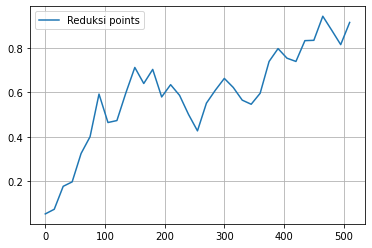

In [ ]:
GGRM_x35 = GGRM_x[0:522:15]
GGRM_y35 = GGRM_y[0:522:15]

plt.plot(GGRM_x35, GGRM_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GGRM_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_GGRM_35: [ 0.05364996 -0.02601753  0.23423969  0.15125456  0.36706442  0.33299435
  0.70377261  0.40512541  0.46200542  0.58590304  0.77925489  0.56796569
  0.78705299  0.50194021  0.68099969  0.58056936  0.51475277  0.36481711
  0.58710455  0.59547179  0.68975938  0.62086448  0.55765342  0.53814366
  0.56857581  0.76187146  0.81665601  0.75074811  0.70101999  0.87788962
  0.78126498  0.99968899  0.82902912  0.76607764  0.91410144  0.
  0.          0.          0.        ]
k_GGRM_35: 3



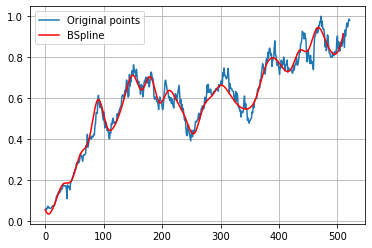

In [ ]:
import scipy.interpolate as interpolate

t_GGRM_35, c_GGRM_35, k_GGRM_35 = interpolate.splrep(GGRM_x35, GGRM_y35, s=0, k=3)
print('''\
t_GGRM_35: {}
c_GGRM_35: {}
k_GGRM_35: {}
'''.format(t_GGRM_35, c_GGRM_35, k_GGRM_35))
N = 522
xmin_GGRM_35, xmax_GGRM_35 = GGRM_x35.min(), GGRM_x35.max()
xx_GGRM_35 = np.linspace(xmin_GGRM_35, xmax_GGRM_35, N)
spline_GGRM_35 = interpolate.BSpline(t_GGRM_35, c_GGRM_35, k_GGRM_35, extrapolate=False)

plt.plot(GGRM_x, GGRM_y, label='Original points')
plt.plot(xx_GGRM_35, spline_GGRM_35(xx_GGRM_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA GGRM**

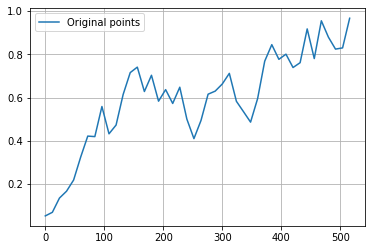

In [ ]:
GGRM_x45 = GGRM_x[0:522:12]
GGRM_y45 = GGRM_y[0:522:12]

plt.plot(GGRM_x45, GGRM_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_GGRM_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_GGRM_45: [0.05364996 0.02178847 0.14302523 0.16245327 0.20846124 0.31944497
 0.46626546 0.34847471 0.65874512 0.3692273  0.46065173 0.62721592
 0.71737993 0.79526083 0.54484853 0.79315508 0.500649   0.70468867
 0.5011768  0.72771936 0.4753688  0.37520296 0.48644028 0.64649415
 0.62151451 0.64581191 0.77061163 0.54262986 0.55579066 0.44440979
 0.586535   0.78376858 0.88700984 0.7341551  0.83600035 0.72395431
 0.70090008 1.03884818 0.64590595 1.05826679 0.84837958 0.81286242
 0.80479717 0.96628555 0.         0.         0.         0.        ]
k_GGRM_45: 3



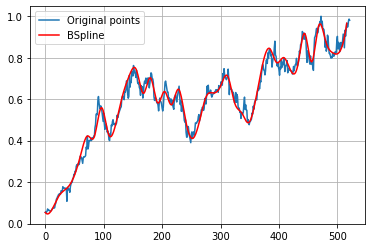

In [ ]:
import scipy.interpolate as interpolate

t_GGRM_45, c_GGRM_45, k_GGRM_45 = interpolate.splrep(GGRM_x45, GGRM_y45, s=0, k=3)
print('''\
t_GGRM_45: {}
c_GGRM_45: {}
k_GGRM_45: {}
'''.format(t_GGRM_45, c_GGRM_45, k_GGRM_45))
N = 522
xmin_GGRM_45, xmax_GGRM_45 = GGRM_x45.min(), GGRM_x45.max()
xx_GGRM_45 = np.linspace(xmin_GGRM_45, xmax_GGRM_45, N)
spline_GGRM_45 = interpolate.BSpline(t_GGRM_45, c_GGRM_45, k_GGRM_45, extrapolate=False)

plt.plot(GGRM_x, GGRM_y, label='Original points')
plt.plot(xx_GGRM_45, spline_GGRM_45(xx_GGRM_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA GGRM**

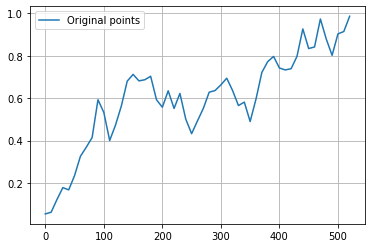

In [ ]:
GGRM_x55 = GGRM_x[0:522:10]
GGRM_y55 = GGRM_y[0:522:10]

plt.plot(GGRM_x55, GGRM_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GGRM_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_GGRM_55: [0.05364996 0.03308891 0.09228011 0.2010453  0.14231047 0.23235135
 0.33549608 0.37817091 0.36114305 0.660986   0.54812314 0.34089258
 0.48760295 0.54774577 0.70224071 0.72420609 0.67182323 0.67645174
 0.74198282 0.57373483 0.51628805 0.70324138 0.4772548  0.69468754
 0.47662477 0.40321092 0.50331958 0.53865587 0.65076407 0.6260979
 0.65838877 0.71572082 0.64231634 0.52855824 0.63307251 0.42551936
 0.60240503 0.7391789  0.76805616 0.82184186 0.72382002 0.73494489
 0.73393779 0.76202164 0.99897831 0.80055238 0.80145069 1.04201777
 0.87040786 0.74987762 1.00469086 0.85356193 0.98622105 0.
 0.         0.         0.        ]
k_GGRM_55: 3



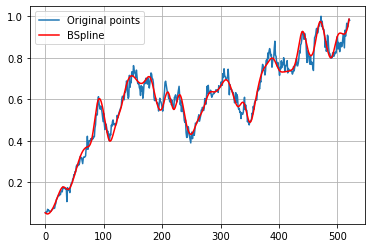

In [ ]:
import scipy.interpolate as interpolate

t_GGRM_55, c_GGRM_55, k_GGRM_55 = interpolate.splrep(GGRM_x55, GGRM_y55, s=0, k=3)
print('''\
t_GGRM_55: {}
c_GGRM_55: {}
k_GGRM_55: {}
'''.format(t_GGRM_55, c_GGRM_55, k_GGRM_55))
N = 522
xmin_GGRM_55, xmax_GGRM_55 = GGRM_x55.min(), GGRM_x55.max()
xx_GGRM_55 = np.linspace(xmin_GGRM_55, xmax_GGRM_55, N)
spline_GGRM_55 = interpolate.BSpline(t_GGRM_55, c_GGRM_55, k_GGRM_55, extrapolate=False)

plt.plot(GGRM_x, GGRM_y, label='Original points')
plt.plot(xx_GGRM_55, spline_GGRM_55(xx_GGRM_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA GGRM**


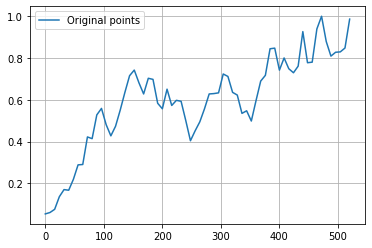

In [ ]:
GGRM_x65 = GGRM_x[0:522:8]
GGRM_y65 = GGRM_y[0:522:8]

plt.plot(GGRM_x65, GGRM_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GGRM_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_GGRM_65: [0.05364996 0.07033311 0.03626138 0.14303293 0.18109694 0.15280796
 0.21030972 0.32169632 0.23377569 0.48462571 0.36070301 0.55629136
 0.58035846 0.47495731 0.40459683 0.47129917 0.54925662 0.63510444
 0.72387003 0.76141192 0.68430813 0.58930629 0.72627672 0.72370468
 0.56536016 0.51529446 0.71559043 0.52735702 0.6120967  0.60912865
 0.50811693 0.36280117 0.46460099 0.4876779  0.55214565 0.64586789
 0.6321928  0.60372501 0.75237945 0.72800609 0.60648448 0.65960039
 0.49126172 0.585555   0.45059918 0.60237371 0.71422437 0.67793197
 0.87659833 0.88163777 0.68040381 0.84881385 0.72645162 0.73790384
 0.69836221 1.03505

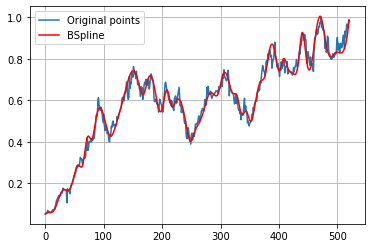

In [ ]:
import scipy.interpolate as interpolate

t_GGRM_65, c_GGRM_65, k_GGRM_65 = interpolate.splrep(GGRM_x65, GGRM_y65, s=0, k=3)
print('''\
t_GGRM_65: {}
c_GGRM_65: {}
k_GGRM_65: {}
'''.format(t_GGRM_65, c_GGRM_65, k_GGRM_65))
N = 522
xmin_GGRM_65, xmax_GGRM_65 = GGRM_x65.min(), GGRM_x65.max()
xx_GGRM_65 = np.linspace(xmin_GGRM_65, xmax_GGRM_65, N)
spline_GGRM_65 = interpolate.BSpline(t_GGRM_65, c_GGRM_65, k_GGRM_65, extrapolate=False)

plt.plot(GGRM_x, GGRM_y, label='Original points')
plt.plot(xx_GGRM_65, spline_GGRM_65(xx_GGRM_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE GGRM**


In [ ]:

#RMSE 15 DATA GGRM
y_true_GGRM_15 = GGRM_y.tolist()
y_pred_GGRM_15 = spline_GGRM_15(xx_GGRM_15).tolist()
mse_GGRM_15 = mean_squared_error(y_true_GGRM_15, y_pred_GGRM_15)
rmse_GGRM_15 = np.sqrt(mse_GGRM_15)
print("rmse GGRM 15 =",rmse_GGRM_15)

#RMSE 25 DATA GGRM
y_true_GGRM_25 = GGRM_y.tolist()
y_pred_GGRM_25 = spline_GGRM_25(xx_GGRM_25).tolist()
mse_GGRM_25 = mean_squared_error(y_true_GGRM_25, y_pred_GGRM_25)
rmse_GGRM_25 = np.sqrt(mse_GGRM_25)
print("rmse GGRM 25 =",rmse_GGRM_25)

#RMSE 35 DATA GGRM
y_true_GGRM_35 = GGRM_y.tolist()
y_pred_GGRM_35 = spline_GGRM_35(xx_GGRM_35).tolist()
mse_GGRM_35 = mean_squared_error(y_true_GGRM_35, y_pred_GGRM_35)
rmse_GGRM_35 = np.sqrt(mse_GGRM_35)
print("rmse GGRM 35 =",rmse_GGRM_35)

#RMSE 45 DATA GGRM
y_true_GGRM_45 = GGRM_y.tolist()
y_pred_GGRM_45 = spline_GGRM_45(xx_GGRM_45).tolist()
mse_GGRM_45 = mean_squared_error(y_true_GGRM_45, y_pred_GGRM_45)
rmse_GGRM_45 = np.sqrt(mse_GGRM_45)
print("rmse GGRM 45 =",rmse_GGRM_45)

#RMSE 55 DATA GGRM
y_true_GGRM_55 = GGRM_y.tolist()
y_pred_GGRM_55 = spline_GGRM_55(xx_GGRM_55).tolist()
mse_GGRM_55 = mean_squared_error(y_true_GGRM_55, y_pred_GGRM_55)
rmse_GGRM_55 = np.sqrt(mse_GGRM_55)
print("rmse GGRM 55 =",rmse_GGRM_55)

#RMSE 65 DATA GGRM
y_true_GGRM_65 = GGRM_y.tolist()
y_pred_GGRM_65 = spline_GGRM_65(xx_GGRM_65).tolist()
mse_GGRM_65 = mean_squared_error(y_true_GGRM_65, y_pred_GGRM_65)
rmse_GGRM_65 = np.sqrt(mse_GGRM_65)
print("rmse GGRM 65 =",rmse_GGRM_65)

rmse GGRM 15 = 0.08994456108735945
rmse GGRM 25 = 0.0624833642464179
rmse GGRM 35 = 0.04682879231996348
rmse GGRM 45 = 0.04043676633423997
rmse GGRM 55 = 0.029796581376063017
rmse GGRM 65 = 0.029465353573597766


# **HMSP**

No handles with labels found to put in legend.


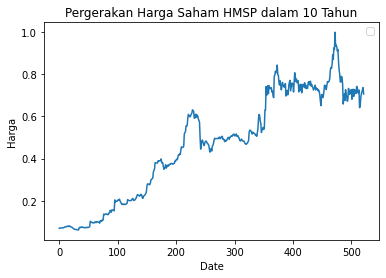

In [ ]:
HMSP = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/HMSP.JK.csv')

HMSP_x = HMSP['No'].values
HMSP_y = HMSP['Skala'].values

plt.plot(HMSP_x,HMSP_y)
plt.title('Pergerakan Harga Saham HMSP dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA HMSP**

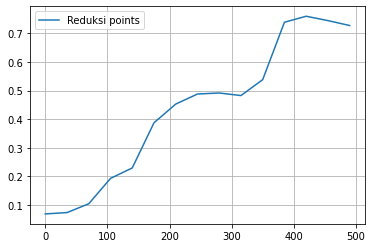

In [ ]:
HMSP_x15 = HMSP_x[0:522:35]
HMSP_y15 = HMSP_y[0:522:35]

plt.plot(HMSP_x15, HMSP_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_HMSP_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_HMSP_15: [0.06890648 0.08523268 0.03715119 0.2229796  0.18296472 0.42328723
 0.44947496 0.49631013 0.49381019 0.47850632 0.48839306 0.79791
 0.73970021 0.74776894 0.72761905 0.         0.         0.
 0.        ]
k_HMSP_15: 3



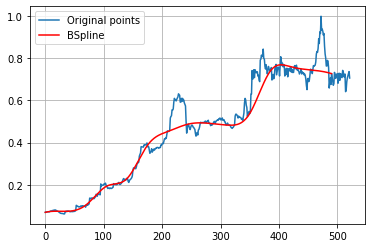

In [ ]:
import scipy.interpolate as interpolate

t_HMSP_15, c_HMSP_15, k_HMSP_15 = interpolate.splrep(HMSP_x15, HMSP_y15, s=0, k=3)
print('''\
t_HMSP_15: {}
c_HMSP_15: {}
k_HMSP_15: {}
'''.format(t_HMSP_15, c_HMSP_15, k_HMSP_15))
N = 522
xmin_HMSP_15, xmax_HMSP_15 = HMSP_x15.min(), HMSP_x15.max()
xx_HMSP_15 = np.linspace(xmin_HMSP_15, xmax_HMSP_15, N)
spline_HMSP_15 = interpolate.BSpline(t_HMSP_15, c_HMSP_15, k_HMSP_15, extrapolate=False)

plt.plot(HMSP_x, HMSP_y, label='Original points')
plt.plot(xx_HMSP_15, spline_HMSP_15(xx_HMSP_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA HMSP**

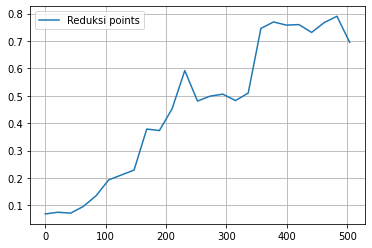

In [ ]:
HMSP_x25 = HMSP_x[0:522:21]
HMSP_y25 = HMSP_y[0:522:21]

plt.plot(HMSP_x25, HMSP_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_HMSP_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_HMSP_25: [0.06890648 0.08789789 0.05389193 0.0962134  0.12776554 0.20237472
 0.22122701 0.17887726 0.43708107 0.34455851 0.42414778 0.67634758
 0.42344486 0.51532442 0.50837744 0.48736001 0.43841103 0.81887005
 0.76153737 0.75326621 0.77396923 0.71085688 0.7912806  0.8195978
 0.6952381  0.         0.         0.         0.        ]
k_HMSP_25: 3



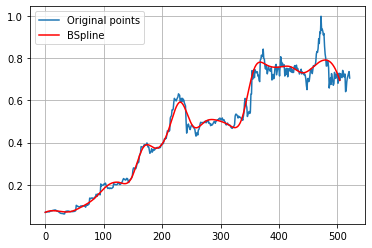

In [ ]:
import scipy.interpolate as interpolate

t_HMSP_25, c_HMSP_25, k_HMSP_25 = interpolate.splrep(HMSP_x25, HMSP_y25, s=0, k=3)
print('''\
t_HMSP_25: {}
c_HMSP_25: {}
k_HMSP_25: {}
'''.format(t_HMSP_25, c_HMSP_25, k_HMSP_25))
N = 522
xmin_HMSP_25, xmax_HMSP_25 = HMSP_x25.min(), HMSP_x25.max()
xx_HMSP_25 = np.linspace(xmin_HMSP_25, xmax_HMSP_25, N)
spline_HMSP_25 = interpolate.BSpline(t_HMSP_25, c_HMSP_25, k_HMSP_25, extrapolate=False)

plt.plot(HMSP_x, HMSP_y, label='Original points')
plt.plot(xx_HMSP_25, spline_HMSP_25(xx_HMSP_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA HMSP**

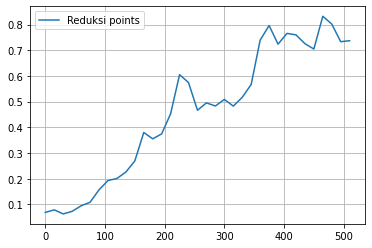

In [ ]:
HMSP_x35 = HMSP_x[0:522:15]
HMSP_y35 = HMSP_y[0:522:15]

plt.plot(HMSP_x35, HMSP_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_HMSP_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_HMSP_35: [0.06890648 0.09918448 0.05141667 0.07073662 0.10008569 0.09739834
 0.16062493 0.20110537 0.193445   0.23097748 0.23923938 0.42705928
 0.3329006  0.37313253 0.42263793 0.65381297 0.59261296 0.42106078
 0.52246952 0.46064961 0.53330929 0.45845616 0.5290946  0.52595394
 0.76934104 0.83211047 0.68050279 0.78873552 0.75884085 0.73590108
 0.65184056 0.88530813 0.77318083 0.69531435 0.73714286 0.
 0.         0.         0.        ]
k_HMSP_35: 3



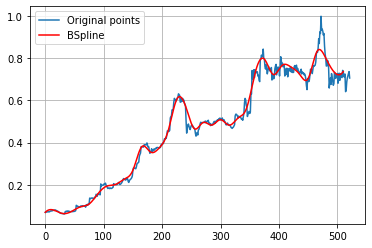

In [ ]:
import scipy.interpolate as interpolate

t_HMSP_35, c_HMSP_35, k_HMSP_35 = interpolate.splrep(HMSP_x35, HMSP_y35, s=0, k=3)
print('''\
t_HMSP_35: {}
c_HMSP_35: {}
k_HMSP_35: {}
'''.format(t_HMSP_35, c_HMSP_35, k_HMSP_35))
N = 522
xmin_HMSP_35, xmax_HMSP_35 = HMSP_x35.min(), HMSP_x35.max()
xx_HMSP_35 = np.linspace(xmin_HMSP_35, xmax_HMSP_35, N)
spline_HMSP_35 = interpolate.BSpline(t_HMSP_35, c_HMSP_35, k_HMSP_35, extrapolate=False)

plt.plot(HMSP_x, HMSP_y, label='Original points')
plt.plot(xx_HMSP_35, spline_HMSP_35(xx_HMSP_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA HMSP**

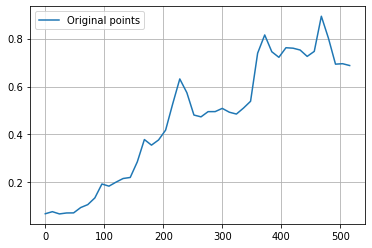

In [ ]:
HMSP_x45 = HMSP_x[0:522:12]
HMSP_y45 = HMSP_y[0:522:12]

plt.plot(HMSP_x45, HMSP_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_HMSP_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_HMSP_45: [0.06890648 0.09140919 0.05871335 0.07624041 0.06476156 0.09968479
 0.10497701 0.12209856 0.21627898 0.17127693 0.20326926 0.2215089
 0.20699229 0.27265909 0.4164171  0.33343254 0.38164695 0.40097393
 0.52308596 0.6720765  0.57845961 0.45941068 0.46934911 0.50343285
 0.48743374 0.51842064 0.49122661 0.47318714 0.52624189 0.48171946
 0.77686884 0.84623375 0.72962472 0.70612452 0.77730578 0.75608093
 0.75837051 0.72472274 0.69702424 0.9671803  0.79425457 0.62488849
 0.73279385 0.68761905 0.         0.         0.         0.        ]
k_HMSP_45: 3



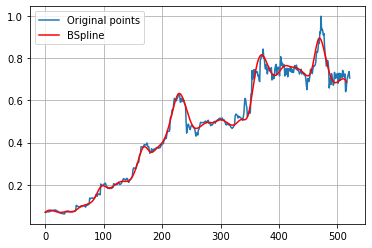

In [ ]:
import scipy.interpolate as interpolate

t_HMSP_45, c_HMSP_45, k_HMSP_45 = interpolate.splrep(HMSP_x45, HMSP_y45, s=0, k=3)
print('''\
t_HMSP_45: {}
c_HMSP_45: {}
k_HMSP_45: {}
'''.format(t_HMSP_45, c_HMSP_45, k_HMSP_45))
N = 522
xmin_HMSP_45, xmax_HMSP_45 = HMSP_x45.min(), HMSP_x45.max()
xx_HMSP_45 = np.linspace(xmin_HMSP_45, xmax_HMSP_45, N)
spline_HMSP_45 = interpolate.BSpline(t_HMSP_45, c_HMSP_45, k_HMSP_45, extrapolate=False)

plt.plot(HMSP_x, HMSP_y, label='Original points')
plt.plot(xx_HMSP_45, spline_HMSP_45(xx_HMSP_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA HMSP**

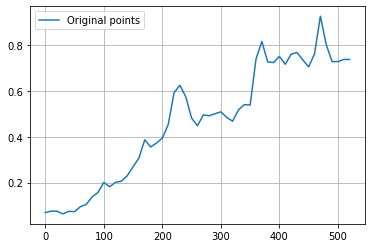

In [ ]:
HMSP_x55 = HMSP_x[0:522:10]
HMSP_y55 = HMSP_y[0:522:10]

plt.plot(HMSP_x55, HMSP_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_HMSP_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_HMSP_55: [0.06890648 0.07060077 0.08830741 0.05430968 0.08193845 0.06367482
 0.10264113 0.09423838 0.14702365 0.14239045 0.22441797 0.16365194
 0.21055713 0.19998239 0.22552475 0.27604432 0.28529224 0.4260324
 0.33185815 0.37832923 0.38997924 0.42610816 0.62308532 0.63453353
 0.58556905 0.46851587 0.42581891 0.515557   0.48354156 0.50033397
 0.51685973 0.48457002 0.44969446 0.52243506 0.56135381 0.47290388
 0.77701921 0.85444783 0.69661802 0.71793723 0.77449019 0.68695915
 0.77481607 0.77377658 0.73579192 0.69448433 0.71484218 1.01757551
 0.76914148 0.71728714 0.73080328 0.7426936  0.73714286 0.
 0.         0.         0.        ]
k_HMSP_55: 3



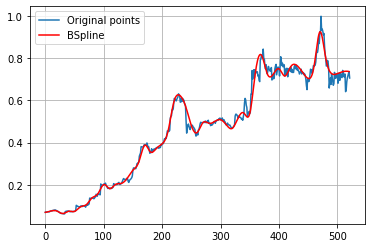

In [ ]:
import scipy.interpolate as interpolate

t_HMSP_55, c_HMSP_55, k_HMSP_55 = interpolate.splrep(HMSP_x55, HMSP_y55, s=0, k=3)
print('''\
t_HMSP_55: {}
c_HMSP_55: {}
k_HMSP_55: {}
'''.format(t_HMSP_55, c_HMSP_55, k_HMSP_55))
N = 522
xmin_HMSP_55, xmax_HMSP_55 = HMSP_x55.min(), HMSP_x55.max()
xx_HMSP_55 = np.linspace(xmin_HMSP_55, xmax_HMSP_55, N)
spline_HMSP_55 = interpolate.BSpline(t_HMSP_55, c_HMSP_55, k_HMSP_55, extrapolate=False)

plt.plot(HMSP_x, HMSP_y, label='Original points')
plt.plot(xx_HMSP_55, spline_HMSP_55(xx_HMSP_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA HMSP**

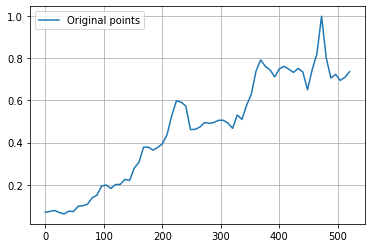

In [ ]:
HMSP_x65 = HMSP_x[0:522:8]
HMSP_y65 = HMSP_y[0:522:8]

plt.plot(HMSP_x65, HMSP_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_HMSP_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_HMSP_65: [0.06890648 0.06733129 0.08497684 0.0684876  0.05432647 0.0824248
 0.06171259 0.10569626 0.09905322 0.09886918 0.14716148 0.13720831
 0.20409554 0.20490095 0.16923772 0.21203731 0.18847592 0.24207047
 0.19552793 0.29795496 0.28578367 0.40215606 0.37735214 0.35803539
 0.3782892  0.38980207 0.42685685 0.52983329 0.61920423 0.58078979
 0.6106196  0.42205743 0.4724763  0.46583173 0.50443674 0.48800976
 0.4935814  0.50925308 0.50560046 0.50453927 0.4327567  0.57021687
 0.47330162 0.59645082 0.60775225 0.75377456 0.81257807 0.75019887
 0.75805503 0.68843817 0.76247801 0.76450695 0.75092278 0.72323052
 0.75615515 0.766434

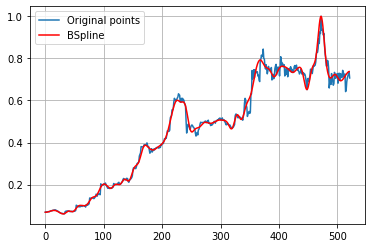

In [ ]:
import scipy.interpolate as interpolate

t_HMSP_65, c_HMSP_65, k_HMSP_65 = interpolate.splrep(HMSP_x65, HMSP_y65, s=0, k=3)
print('''\
t_HMSP_65: {}
c_HMSP_65: {}
k_HMSP_65: {}
'''.format(t_HMSP_65, c_HMSP_65, k_HMSP_65))
N = 522
xmin_HMSP_65, xmax_HMSP_65 = HMSP_x65.min(), HMSP_x65.max()
xx_HMSP_65 = np.linspace(xmin_HMSP_65, xmax_HMSP_65, N)
spline_HMSP_65 = interpolate.BSpline(t_HMSP_65, c_HMSP_65, k_HMSP_65, extrapolate=False)

plt.plot(HMSP_x, HMSP_y, label='Original points')
plt.plot(xx_HMSP_65, spline_HMSP_65(xx_HMSP_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE HMSP**

In [ ]:

#RMSE 15 DATA HMSP
y_true_HMSP_15 = HMSP_y.tolist()
y_pred_HMSP_15 = spline_HMSP_15(xx_HMSP_15).tolist()
mse_HMSP_15 = mean_squared_error(y_true_HMSP_15, y_pred_HMSP_15)
rmse_HMSP_15 = np.sqrt(mse_HMSP_15)
print("rmse HMSP 15 =",rmse_HMSP_15)

#RMSE 25 DATA HMSP
y_true_HMSP_25 = HMSP_y.tolist()
y_pred_HMSP_25 = spline_HMSP_25(xx_HMSP_25).tolist()
mse_HMSP_25 = mean_squared_error(y_true_HMSP_25, y_pred_HMSP_25)
rmse_HMSP_25 = np.sqrt(mse_HMSP_25)
print("rmse HMSP 25 =",rmse_HMSP_25)

#RMSE 35 DATA HMSP
y_true_HMSP_35 = HMSP_y.tolist()
y_pred_HMSP_35 = spline_HMSP_35(xx_HMSP_35).tolist()
mse_HMSP_35 = mean_squared_error(y_true_HMSP_35, y_pred_HMSP_35)
rmse_HMSP_35 = np.sqrt(mse_HMSP_35)
print("rmse HMSP 35 =",rmse_HMSP_35)

#RMSE 45 DATA HMSP
y_true_HMSP_45 = HMSP_y.tolist()
y_pred_HMSP_45 = spline_HMSP_45(xx_HMSP_45).tolist()
mse_HMSP_45 = mean_squared_error(y_true_HMSP_45, y_pred_HMSP_45)
rmse_HMSP_45 = np.sqrt(mse_HMSP_45)
print("rmse HMSP 45 =",rmse_HMSP_45)

#RMSE 55 DATA HMSP
y_true_HMSP_55 = HMSP_y.tolist()
y_pred_HMSP_55 = spline_HMSP_55(xx_HMSP_55).tolist()
mse_HMSP_55 = mean_squared_error(y_true_HMSP_55, y_pred_HMSP_55)
rmse_HMSP_55 = np.sqrt(mse_HMSP_55)
print("rmse HMSP 55 =",rmse_HMSP_55)

#RMSE 65 DATA HMSP
y_true_HMSP_65 = HMSP_y.tolist()
y_pred_HMSP_65 = spline_HMSP_65(xx_HMSP_65).tolist()
mse_HMSP_65 = mean_squared_error(y_true_HMSP_65, y_pred_HMSP_65)
rmse_HMSP_65 = np.sqrt(mse_HMSP_65)
print("rmse HMSP 65 =",rmse_HMSP_65)


rmse HMSP 15 = 0.07588692386574233
rmse HMSP 25 = 0.04839641579551471
rmse HMSP 35 = 0.04005712579022644
rmse HMSP 45 = 0.030082080473561586
rmse HMSP 55 = 0.024746238622861766
rmse HMSP 65 = 0.021762717547606468


# **ICBP**

No handles with labels found to put in legend.


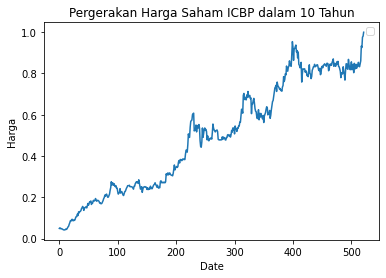

In [ ]:
ICBP = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ICBP.JK.csv')

ICBP_x = ICBP['No'].values
ICBP_y = ICBP['Skala'].values

plt.plot(ICBP_x,ICBP_y)
plt.title('Pergerakan Harga Saham ICBP dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ICBP**

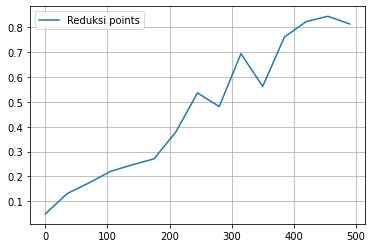

In [ ]:
ICBP_x15 = ICBP_x[0:522:35]
ICBP_y15 = ICBP_y[0:522:35]

plt.plot(ICBP_x15, ICBP_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ICBP_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ICBP_15: [0.04880383 0.12972195 0.15096279 0.22548963 0.24902115 0.25689465
 0.34540981 0.6294087  0.35226638 0.84669324 0.42364007 0.83195223
 0.80687502 0.8764668  0.81339713 0.         0.         0.
 0.        ]
k_ICBP_15: 3



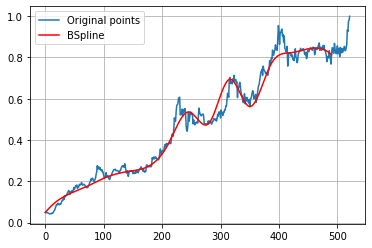

In [ ]:
import scipy.interpolate as interpolate

t_ICBP_15, c_ICBP_15, k_ICBP_15 = interpolate.splrep(ICBP_x15, ICBP_y15, s=0, k=3)
print('''\
t_ICBP_15: {}
c_ICBP_15: {}
k_ICBP_15: {}
'''.format(t_ICBP_15, c_ICBP_15, k_ICBP_15))
N = 522
xmin_ICBP_15, xmax_ICBP_15 = ICBP_x15.min(), ICBP_x15.max()
xx_ICBP_15 = np.linspace(xmin_ICBP_15, xmax_ICBP_15, N)
spline_ICBP_15 = interpolate.BSpline(t_ICBP_15, c_ICBP_15, k_ICBP_15, extrapolate=False)

plt.plot(ICBP_x, ICBP_y, label='Original points')
plt.plot(xx_ICBP_15, spline_ICBP_15(xx_ICBP_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ICBP**

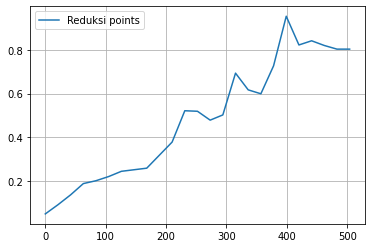

In [ ]:
ICBP_x25 = ICBP_x[0:522:21]
ICBP_y25 = ICBP_y[0:522:21]

plt.plot(ICBP_x25, ICBP_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ICBP_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ICBP_25: [0.04880383 0.08071267 0.10962729 0.19947453 0.19680702 0.21903902
 0.24761107 0.25463153 0.24103984 0.33144835 0.34225768 0.5674635
 0.51707491 0.47906941 0.43746086 0.78544122 0.58345368 0.58409333
 0.67586678 1.07607591 0.7471023  0.87331392 0.79192682 0.80559161
 0.80382775 0.         0.         0.         0.        ]
k_ICBP_25: 3



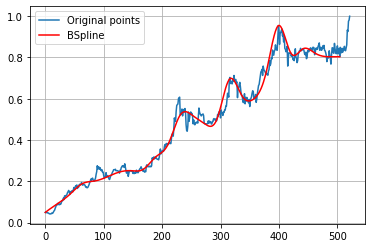

In [ ]:
import scipy.interpolate as interpolate

t_ICBP_25, c_ICBP_25, k_ICBP_25 = interpolate.splrep(ICBP_x25, ICBP_y25, s=0, k=3)
print('''\
t_ICBP_25: {}
c_ICBP_25: {}
k_ICBP_25: {}
'''.format(t_ICBP_25, c_ICBP_25, k_ICBP_25))
N = 522
xmin_ICBP_25, xmax_ICBP_25 = ICBP_x25.min(), ICBP_x25.max()
xx_ICBP_25 = np.linspace(xmin_ICBP_25, xmax_ICBP_25, N)
spline_ICBP_25 = interpolate.BSpline(t_ICBP_25, c_ICBP_25, k_ICBP_25, extrapolate=False)

plt.plot(ICBP_x, ICBP_y, label='Original points')
plt.plot(xx_ICBP_25, spline_ICBP_25(xx_ICBP_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA ICBP**

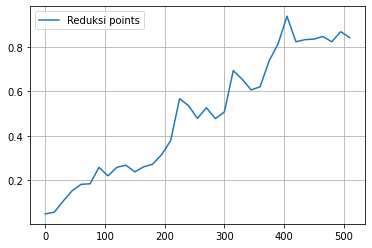

In [ ]:
ICBP_x35 = ICBP_x[0:522:15]
ICBP_y35 = ICBP_y[0:522:15]

plt.plot(ICBP_x35, ICBP_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ICBP_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ICBP_35: [0.04880383 0.02696746 0.09427082 0.1532708  0.19655628 0.15141318
 0.30305415 0.18660946 0.27108219 0.27930104 0.21936917 0.27145196
 0.25941629 0.32724653 0.32633442 0.63535835 0.53414603 0.44336851
 0.56319333 0.46175291 0.45343139 0.76758372 0.63891316 0.60260097
 0.58943893 0.76452369 0.77351894 1.02178331 0.76614209 0.85144738
 0.8232837  0.86498718 0.77581397 0.93266718 0.84210526 0.
 0.         0.         0.        ]
k_ICBP_35: 3



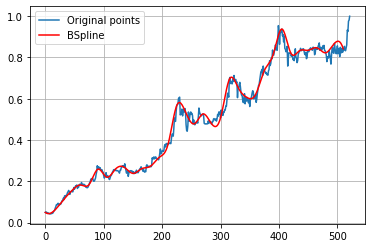

In [ ]:
import scipy.interpolate as interpolate

t_ICBP_35, c_ICBP_35, k_ICBP_35 = interpolate.splrep(ICBP_x35, ICBP_y35, s=0, k=3)
print('''\
t_ICBP_35: {}
c_ICBP_35: {}
k_ICBP_35: {}
'''.format(t_ICBP_35, c_ICBP_35, k_ICBP_35))
N = 522
xmin_ICBP_35, xmax_ICBP_35 = ICBP_x35.min(), ICBP_x35.max()
xx_ICBP_35 = np.linspace(xmin_ICBP_35, xmax_ICBP_35, N)
spline_ICBP_35 = interpolate.BSpline(t_ICBP_35, c_ICBP_35, k_ICBP_35, extrapolate=False)

plt.plot(ICBP_x, ICBP_y, label='Original points')
plt.plot(xx_ICBP_35, spline_ICBP_35(xx_ICBP_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA ICBP**

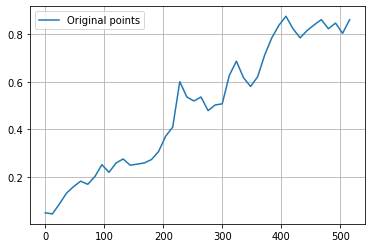

In [ ]:
ICBP_x45 = ICBP_x[0:522:12]
ICBP_y45 = ICBP_y[0:522:12]

plt.plot(ICBP_x45, ICBP_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ICBP_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ICBP_45: [0.04880383 0.01987147 0.0688695  0.13696688 0.15571232 0.1947293
 0.15627956 0.19211418 0.28100535 0.19104146 0.26822596 0.28629394
 0.23731598 0.25726509 0.25515474 0.27235517 0.29178822 0.39781253
 0.34184203 0.68936479 0.50356963 0.51166768 0.56459219 0.44527458
 0.5251229  0.46858789 0.64358773 0.71782673 0.60472257 0.56663229
 0.60960953 0.71980996 0.78866258 0.83367368 0.90056616 0.81765021
 0.76663203 0.82395563 0.83228231 0.88519267 0.79441114 0.90181203
 0.72971599 0.86124402 0.         0.         0.         0.        ]
k_ICBP_45: 3



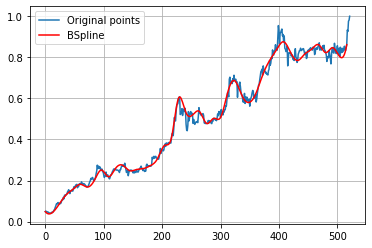

In [ ]:
import scipy.interpolate as interpolate

t_ICBP_45, c_ICBP_45, k_ICBP_45 = interpolate.splrep(ICBP_x45, ICBP_y45, s=0, k=3)
print('''\
t_ICBP_45: {}
c_ICBP_45: {}
k_ICBP_45: {}
'''.format(t_ICBP_45, c_ICBP_45, k_ICBP_45))
N = 522
xmin_ICBP_45, xmax_ICBP_45 = ICBP_x45.min(), ICBP_x45.max()
xx_ICBP_45 = np.linspace(xmin_ICBP_45, xmax_ICBP_45, N)
spline_ICBP_45 = interpolate.BSpline(t_ICBP_45, c_ICBP_45, k_ICBP_45, extrapolate=False)

plt.plot(ICBP_x, ICBP_y, label='Original points')
plt.plot(xx_ICBP_45, spline_ICBP_45(xx_ICBP_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA ICBP**

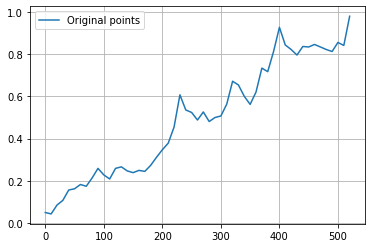

In [ ]:
ICBP_x55 = ICBP_x[0:522:10]
ICBP_y55 = ICBP_y[0:522:10]

plt.plot(ICBP_x55, ICBP_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ICBP_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ICBP_55: [0.04880383 0.00338359 0.0951467  0.09292588 0.17246097 0.1502446
 0.19546016 0.15882386 0.20991427 0.27903104 0.22420081 0.18780209
 0.27339467 0.26885847 0.2444729  0.23171885 0.25688138 0.23357861
 0.27291903 0.3111089  0.3486741  0.37553444 0.41713075 0.6832153
 0.49594106 0.54833147 0.45427373 0.56280327 0.45240793 0.51273247
 0.49666219 0.54368098 0.70899665 0.65382523 0.60153973 0.54288665
 0.6001194  0.78151614 0.68051462 0.80264548 0.98928624 0.80958755
 0.8393492  0.7708147  0.85729632 0.82392348 0.85657914 0.83109966
 0.82859158 0.79233305 0.91250099 0.76862989 0.98086124 0.
 0.         0.         0.        ]
k_ICBP_55: 3



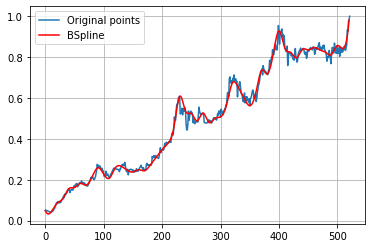

In [ ]:
import scipy.interpolate as interpolate

t_ICBP_55, c_ICBP_55, k_ICBP_55 = interpolate.splrep(ICBP_x55, ICBP_y55, s=0, k=3)
print('''\
t_ICBP_55: {}
c_ICBP_55: {}
k_ICBP_55: {}
'''.format(t_ICBP_55, c_ICBP_55, k_ICBP_55))
N = 522
xmin_ICBP_55, xmax_ICBP_55 = ICBP_x55.min(), ICBP_x55.max()
xx_ICBP_55 = np.linspace(xmin_ICBP_55, xmax_ICBP_55, N)
spline_ICBP_55 = interpolate.BSpline(t_ICBP_55, c_ICBP_55, k_ICBP_55, extrapolate=False)

plt.plot(ICBP_x, ICBP_y, label='Original points')
plt.plot(xx_ICBP_55, spline_ICBP_55(xx_ICBP_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA ICBP**

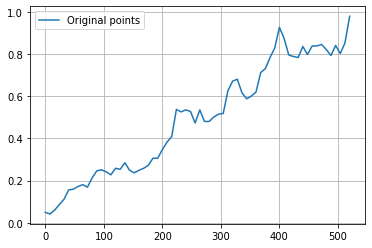

In [ ]:
ICBP_x65 = ICBP_x[0:522:8]
ICBP_y65 = ICBP_y[0:522:8]

plt.plot(ICBP_x65, ICBP_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ICBP_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ICBP_65: [0.04880383 0.03222712 0.04774671 0.08910561 0.10223753 0.16940838
 0.1531433  0.17256386 0.19009406 0.15079194 0.21869989 0.25192046
 0.25208717 0.24690789 0.21004202 0.2765604  0.23395561 0.30914824
 0.23758539 0.23333318 0.25013454 0.25895164 0.26429813 0.32021946
 0.2921446  0.34852272 0.39510423 0.36771106 0.58859698 0.50756611
 0.53903333 0.55161158 0.42676917 0.58341701 0.45487379 0.48225529
 0.5012725  0.52700876 0.4839939  0.65184818 0.66937893 0.70412891
 0.60501452 0.57916229 0.60943681 0.59313832 0.7428903  0.71281246
 0.79820436 0.80250407 0.97264061 0.87631149 0.77570194 0.80078507
 0.7579999  0.87534

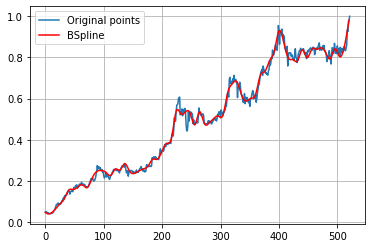

In [ ]:
import scipy.interpolate as interpolate

t_ICBP_65, c_ICBP_65, k_ICBP_65 = interpolate.splrep(ICBP_x65, ICBP_y65, s=0, k=3)
print('''\
t_ICBP_65: {}
c_ICBP_65: {}
k_ICBP_65: {}
'''.format(t_ICBP_65, c_ICBP_65, k_ICBP_65))
N = 522
xmin_ICBP_65, xmax_ICBP_65 = ICBP_x65.min(), ICBP_x65.max()
xx_ICBP_65 = np.linspace(xmin_ICBP_65, xmax_ICBP_65, N)
spline_ICBP_65 = interpolate.BSpline(t_ICBP_65, c_ICBP_65, k_ICBP_65, extrapolate=False)

plt.plot(ICBP_x, ICBP_y, label='Original points')
plt.plot(xx_ICBP_65, spline_ICBP_65(xx_ICBP_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ICBP**

In [ ]:

#RMSE 15 DATA ICBP
y_true_ICBP_15 = ICBP_y.tolist()
y_pred_ICBP_15 = spline_ICBP_15(xx_ICBP_15).tolist()
mse_ICBP_15 = mean_squared_error(y_true_ICBP_15, y_pred_ICBP_15)
rmse_ICBP_15 = np.sqrt(mse_ICBP_15)
print("rmse ICBP 15 =",rmse_ICBP_15)

#RMSE 25 DATA ICBP
y_true_ICBP_25 = ICBP_y.tolist()
y_pred_ICBP_25 = spline_ICBP_25(xx_ICBP_25).tolist()
mse_ICBP_25 = mean_squared_error(y_true_ICBP_25, y_pred_ICBP_25)
rmse_ICBP_25 = np.sqrt(mse_ICBP_25)
print("rmse ICBP 25 =",rmse_ICBP_25)

#RMSE 35 DATA ICBP
y_true_ICBP_35 = ICBP_y.tolist()
y_pred_ICBP_35 = spline_ICBP_35(xx_ICBP_35).tolist()
mse_ICBP_35 = mean_squared_error(y_true_ICBP_35, y_pred_ICBP_35)
rmse_ICBP_35 = np.sqrt(mse_ICBP_35)
print("rmse ICBP 35 =",rmse_ICBP_35)

#RMSE 45 DATA ICBP
y_true_ICBP_45 = ICBP_y.tolist()
y_pred_ICBP_45 = spline_ICBP_45(xx_ICBP_45).tolist()
mse_ICBP_45 = mean_squared_error(y_true_ICBP_45, y_pred_ICBP_45)
rmse_ICBP_45 = np.sqrt(mse_ICBP_45)
print("rmse ICBP 45 =",rmse_ICBP_45)

#RMSE 55 DATA ICBP
y_true_ICBP_55 = ICBP_y.tolist()
y_pred_ICBP_55 = spline_ICBP_55(xx_ICBP_55).tolist()
mse_ICBP_55 = mean_squared_error(y_true_ICBP_55, y_pred_ICBP_55)
rmse_ICBP_55 = np.sqrt(mse_ICBP_55)
print("rmse ICBP 55 =",rmse_ICBP_55)

#RMSE 65 DATA ICBP
y_true_ICBP_65 = ICBP_y.tolist()
y_pred_ICBP_65 = spline_ICBP_65(xx_ICBP_65).tolist()
mse_ICBP_65 = mean_squared_error(y_true_ICBP_65, y_pred_ICBP_65)
rmse_ICBP_65 = np.sqrt(mse_ICBP_65)
print("rmse ICBP 65 =",rmse_ICBP_65)


rmse ICBP 15 = 0.06716394420075858
rmse ICBP 25 = 0.048967438290618816
rmse ICBP 35 = 0.03666967494744485
rmse ICBP 45 = 0.02936635118150283
rmse ICBP 55 = 0.02139975122708461
rmse ICBP 65 = 0.01910681487635193


# **IMAS**

No handles with labels found to put in legend.


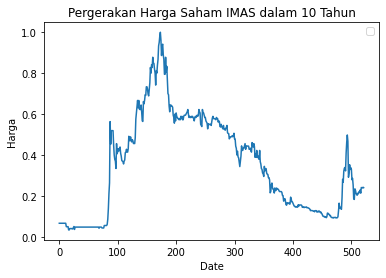

In [ ]:
IMAS = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/IMAS.JK.csv')

IMAS_x = IMAS['No'].values
IMAS_y = IMAS['Skala'].values

plt.plot(IMAS_x,IMAS_y)
plt.title('Pergerakan Harga Saham IMAS dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA IMAS**

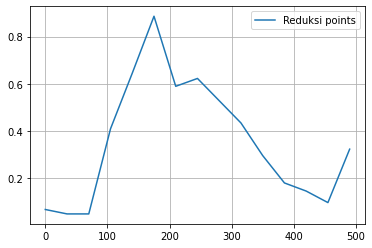

In [ ]:
IMAS_x15 = IMAS_x[0:522:35]
IMAS_y15 = IMAS_y[0:522:35]

plt.plot(IMAS_x15, IMAS_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_IMAS_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_IMAS_15: [ 0.06626044  0.18773239 -0.24239166  0.48386864  0.57699199  1.07483007
  0.44035438  0.69708572  0.50463605  0.45103673  0.29121701  0.15409522
  0.16961553 -0.01036332  0.32222222  0.          0.          0.
  0.        ]
k_IMAS_15: 3



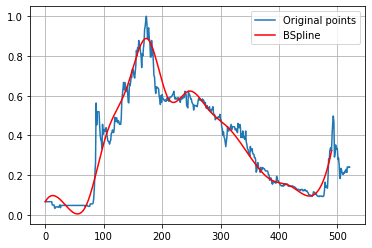

In [ ]:
import scipy.interpolate as interpolate

t_IMAS_15, c_IMAS_15, k_IMAS_15 = interpolate.splrep(IMAS_x15, IMAS_y15, s=0, k=3)
print('''\
t_IMAS_15: {}
c_IMAS_15: {}
k_IMAS_15: {}
'''.format(t_IMAS_15, c_IMAS_15, k_IMAS_15))
N = 522
xmin_IMAS_15, xmax_IMAS_15 = IMAS_x15.min(), IMAS_x15.max()
xx_IMAS_15 = np.linspace(xmin_IMAS_15, xmax_IMAS_15, N)
spline_IMAS_15 = interpolate.BSpline(t_IMAS_15, c_IMAS_15, k_IMAS_15, extrapolate=False)

plt.plot(IMAS_x, IMAS_y, label='Original points')
plt.plot(xx_IMAS_15, spline_IMAS_15(xx_IMAS_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA IMAS**

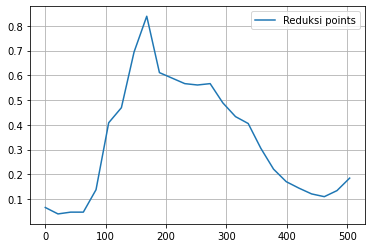

In [ ]:
IMAS_x25 = IMAS_x[0:522:21]
IMAS_y25 = IMAS_y[0:522:21]

plt.plot(IMAS_x25, IMAS_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_IMAS_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_IMAS_25: [0.06626044 0.02369282 0.05697458 0.03960476 0.07386884 0.49317321
 0.40507828 0.7025869  0.95124079 0.52578328 0.61229276 0.55837901
 0.55419121 0.59152283 0.47971748 0.42294059 0.42852018 0.29631204
 0.21623165 0.16542801 0.14538965 0.11968004 0.09684911 0.14671433
 0.185      0.         0.         0.         0.        ]
k_IMAS_25: 3



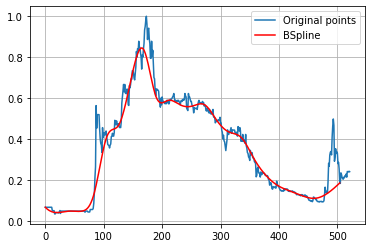

In [ ]:
import scipy.interpolate as interpolate

t_IMAS_25, c_IMAS_25, k_IMAS_25 = interpolate.splrep(IMAS_x25, IMAS_y25, s=0, k=3)
print('''\
t_IMAS_25: {}
c_IMAS_25: {}
k_IMAS_25: {}
'''.format(t_IMAS_25, c_IMAS_25, k_IMAS_25))
N = 522
xmin_IMAS_25, xmax_IMAS_25 = IMAS_x25.min(), IMAS_x25.max()
xx_IMAS_25 = np.linspace(xmin_IMAS_25, xmax_IMAS_25, N)
spline_IMAS_25 = interpolate.BSpline(t_IMAS_25, c_IMAS_25, k_IMAS_25, extrapolate=False)

plt.plot(IMAS_x, IMAS_y, label='Original points')
plt.plot(xx_IMAS_25, spline_IMAS_25(xx_IMAS_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA IMAS**

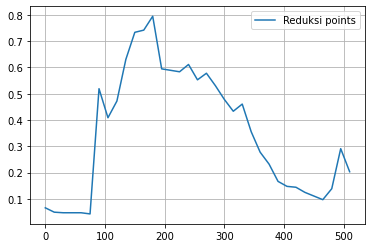

In [ ]:
IMAS_x35 = IMAS_x[0:522:15]
IMAS_y35 = IMAS_y[0:522:15]

plt.plot(IMAS_x35, IMAS_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_IMAS_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_IMAS_35: [ 0.06626044  0.04260798  0.05669181  0.03377099  0.09887443 -0.1443487
  0.73693636  0.31084318  0.47133089  0.63646672  0.76613555  0.69899106
  0.88790021  0.51607475  0.61446745  0.55938878  0.64797743  0.51536816
  0.60721659  0.52243215  0.48638813  0.40201532  0.50555059  0.33911564
  0.27132019  0.24227028  0.15293202  0.14600165  0.14972805  0.12175283
  0.11326065  0.09187123  0.10615992  0.44358671  0.20333333  0.
  0.          0.          0.        ]
k_IMAS_35: 3



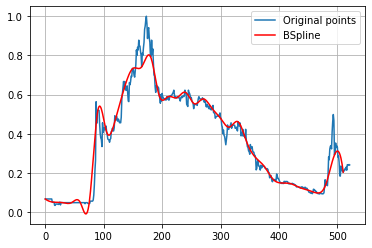

In [ ]:
import scipy.interpolate as interpolate

t_IMAS_35, c_IMAS_35, k_IMAS_35 = interpolate.splrep(IMAS_x35, IMAS_y35, s=0, k=3)
print('''\
t_IMAS_35: {}
c_IMAS_35: {}
k_IMAS_35: {}
'''.format(t_IMAS_35, c_IMAS_35, k_IMAS_35))
N = 522
xmin_IMAS_35, xmax_IMAS_35 = IMAS_x35.min(), IMAS_x35.max()
xx_IMAS_35 = np.linspace(xmin_IMAS_35, xmax_IMAS_35, N)
spline_IMAS_35 = interpolate.BSpline(t_IMAS_35, c_IMAS_35, k_IMAS_35, extrapolate=False)

plt.plot(IMAS_x, IMAS_y, label='Original points')
plt.plot(xx_IMAS_35, spline_IMAS_35(xx_IMAS_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA IMAS**

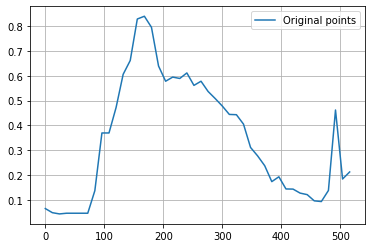

In [ ]:
IMAS_x45 = IMAS_x[0:522:12]
IMAS_y45 = IMAS_y[0:522:12]

plt.plot(IMAS_x45, IMAS_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_IMAS_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_IMAS_45: [ 0.06626044  0.05117406  0.0409401   0.04888582  0.04645021  0.05023336
  0.03753636  0.0845412   0.45255219  0.32497678  0.46726741  0.63858703
  0.61171781  0.88120842  0.8301152   0.83166413  0.60989497  0.56208935
  0.60841431  0.57092008  0.64123871  0.53079173  0.60226101  0.52683088
  0.51041547  0.48150724  0.43355558  0.4509371   0.42269601  0.29161219
  0.28085523  0.25163355  0.14261055  0.22459091  0.12235915  0.15597249
  0.12041757  0.13235725  0.08348677  0.11702901  0.01506387  0.86971051
 -0.23374414  0.21333333  0.          0.          0.          0.        ]
k_IMAS_45: 3



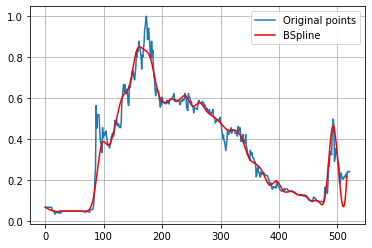

In [ ]:
import scipy.interpolate as interpolate

t_IMAS_45, c_IMAS_45, k_IMAS_45 = interpolate.splrep(IMAS_x45, IMAS_y45, s=0, k=3)
print('''\
t_IMAS_45: {}
c_IMAS_45: {}
k_IMAS_45: {}
'''.format(t_IMAS_45, c_IMAS_45, k_IMAS_45))
N = 522
xmin_IMAS_45, xmax_IMAS_45 = IMAS_x45.min(), IMAS_x45.max()
xx_IMAS_45 = np.linspace(xmin_IMAS_45, xmax_IMAS_45, N)
spline_IMAS_45 = interpolate.BSpline(t_IMAS_45, c_IMAS_45, k_IMAS_45, extrapolate=False)

plt.plot(IMAS_x, IMAS_y, label='Original points')
plt.plot(xx_IMAS_45, spline_IMAS_45(xx_IMAS_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA IMAS**

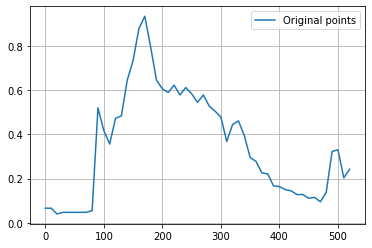

In [ ]:

IMAS_x55 = IMAS_x[0:522:10]
IMAS_y55 = IMAS_y[0:522:10]

plt.plot(IMAS_x55, IMAS_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_IMAS_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_IMAS_55: [ 0.06626044  0.09482335  0.02211063  0.0524665   0.04535441  0.05103586
  0.03542217  0.09219548 -0.1192841   0.71624358  0.36854967  0.31089105
  0.52478619  0.42259767  0.68482315  0.70477639  0.89607127  0.97760518
  0.793508    0.6150295   0.61304068  0.56614111  0.6557282   0.54427941
  0.63382081  0.587104    0.5177632   0.60850988  0.51486394  0.49870104
  0.51699856  0.30330472  0.4731159   0.47089833  0.40662411  0.26593856
  0.29962165  0.2022415   0.24474568  0.14544245  0.17348453  0.14395275
  0.15070446  0.11989606  0.13637796  0.10125876  0.12525365  0.08772665
  0.09383975  0.37024767  0.35458797  0.08631712  0.24222222  0.
  0.          0.          0.        ]


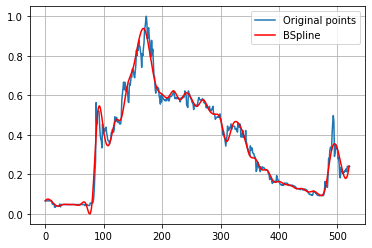

In [ ]:
import scipy.interpolate as interpolate

t_IMAS_55, c_IMAS_55, k_IMAS_55 = interpolate.splrep(IMAS_x55, IMAS_y55, s=0, k=3)
print('''\
t_IMAS_55: {}
c_IMAS_55: {}
k_IMAS_55: {}
'''.format(t_IMAS_55, c_IMAS_55, k_IMAS_55))
N = 522
xmin_IMAS_55, xmax_IMAS_55 = IMAS_x55.min(), IMAS_x55.max()
xx_IMAS_55 = np.linspace(xmin_IMAS_55, xmax_IMAS_55, N)
spline_IMAS_55 = interpolate.BSpline(t_IMAS_55, c_IMAS_55, k_IMAS_55, extrapolate=False)

plt.plot(IMAS_x, IMAS_y, label='Original points')
plt.plot(xx_IMAS_55, spline_IMAS_55(xx_IMAS_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA IMAS**

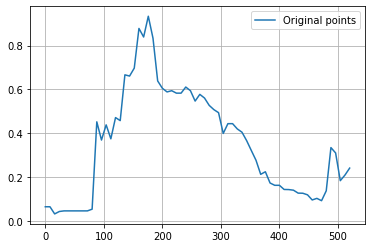

In [ ]:
IMAS_x65 = IMAS_x[0:522:8]
IMAS_y65 = IMAS_y[0:522:8]

plt.plot(IMAS_x65, IMAS_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_IMAS_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_IMAS_65: [ 0.06626044  0.10261041  0.00984952  0.050428    0.04664854  0.04789786
  0.04668003  0.05030202  0.03703189  0.0864904  -0.09807351  0.63710629
  0.26632835  0.51730705  0.29829682  0.54235902  0.36490055  0.74785225
  0.64369044  0.64405267  0.96343222  0.76888511  0.99436068  0.85367218
  0.59095061  0.61585873  0.57894779  0.60168343  0.58098515  0.57437596
  0.621511    0.60624669  0.52016891  0.59641102  0.56085369  0.52684088
  0.49844944  0.52936135  0.35077181  0.46755139  0.4456893   0.41635809
  0.41221168  0.36812852  0.31860758  0.29077451  0.18496107  0.25271456
  0.15751402  0.16389601  0.17023528  

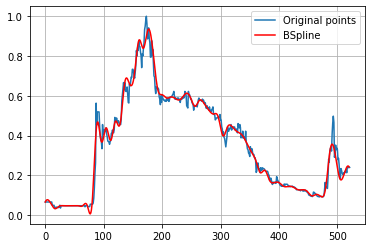

In [ ]:
import scipy.interpolate as interpolate

t_IMAS_65, c_IMAS_65, k_IMAS_65 = interpolate.splrep(IMAS_x65, IMAS_y65, s=0, k=3)
print('''\
t_IMAS_65: {}
c_IMAS_65: {}
k_IMAS_65: {}
'''.format(t_IMAS_65, c_IMAS_65, k_IMAS_65))
N = 522
xmin_IMAS_65, xmax_IMAS_65 = IMAS_x65.min(), IMAS_x65.max()
xx_IMAS_65 = np.linspace(xmin_IMAS_65, xmax_IMAS_65, N)
spline_IMAS_65 = interpolate.BSpline(t_IMAS_65, c_IMAS_65, k_IMAS_65, extrapolate=False)

plt.plot(IMAS_x, IMAS_y, label='Original points')
plt.plot(xx_IMAS_65, spline_IMAS_65(xx_IMAS_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE IMAS**

In [ ]:

#RMSE 15 DATA IMAS
y_true_IMAS_15 = IMAS_y.tolist()
y_pred_IMAS_15 = spline_IMAS_15(xx_IMAS_15).tolist()
mse_IMAS_15 = mean_squared_error(y_true_IMAS_15, y_pred_IMAS_15)
rmse_IMAS_15 = np.sqrt(mse_IMAS_15)
print("rmse IMAS 15 =",rmse_IMAS_15)

#RMSE 25 DATA IMAS
y_true_IMAS_25 = IMAS_y.tolist()
y_pred_IMAS_25 = spline_IMAS_25(xx_IMAS_25).tolist()
mse_IMAS_25 = mean_squared_error(y_true_IMAS_25, y_pred_IMAS_25)
rmse_IMAS_25 = np.sqrt(mse_IMAS_25)
print("rmse IMAS 25 =",rmse_IMAS_25)

#RMSE 35 DATA IMAS
y_true_IMAS_35 = IMAS_y.tolist()
y_pred_IMAS_35 = spline_IMAS_35(xx_IMAS_35).tolist()
mse_IMAS_35 = mean_squared_error(y_true_IMAS_35, y_pred_IMAS_35)
rmse_IMAS_35 = np.sqrt(mse_IMAS_35)
print("rmse IMAS 35 =",rmse_IMAS_35)

#RMSE 45 DATA IMAS
y_true_IMAS_45 = IMAS_y.tolist()
y_pred_IMAS_45 = spline_IMAS_45(xx_IMAS_45).tolist()
mse_IMAS_45 = mean_squared_error(y_true_IMAS_45, y_pred_IMAS_45)
rmse_IMAS_45 = np.sqrt(mse_IMAS_45)
print("rmse IMAS 45 =",rmse_IMAS_45)

#RMSE 55 DATA IMAS
y_true_IMAS_55 = IMAS_y.tolist()
y_pred_IMAS_55 = spline_IMAS_55(xx_IMAS_55).tolist()
mse_IMAS_55 = mean_squared_error(y_true_IMAS_55, y_pred_IMAS_55)
rmse_IMAS_55 = np.sqrt(mse_IMAS_55)
print("rmse IMAS 55 =",rmse_IMAS_55)

#RMSE 65 DATA IMAS
y_true_IMAS_65 = IMAS_y.tolist()
y_pred_IMAS_65 = spline_IMAS_65(xx_IMAS_65).tolist()
mse_IMAS_65 = mean_squared_error(y_true_IMAS_65, y_pred_IMAS_65)
rmse_IMAS_65 = np.sqrt(mse_IMAS_65)
print("rmse IMAS 65 =",rmse_IMAS_65)

rmse IMAS 15 = 0.0894380592869281
rmse IMAS 25 = 0.07368960198149581
rmse IMAS 35 = 0.06123443236048788
rmse IMAS 45 = 0.05243725059359683
rmse IMAS 55 = 0.03732882230713586
rmse IMAS 65 = 0.03146168322013721


# **INCO**

No handles with labels found to put in legend.


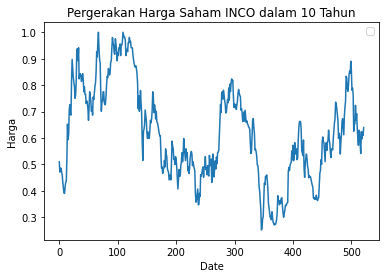

In [ ]:
INCO = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/INCO.JK.csv')

INCO_x = INCO['No'].values
INCO_y = INCO['Skala'].values

plt.plot(INCO_x,INCO_y)
plt.title('Pergerakan Harga Saham INCO dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA INCO**

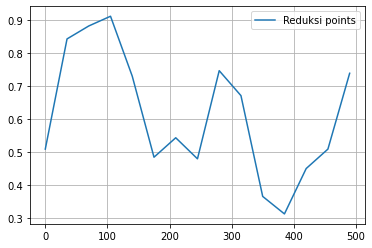

In [ ]:
INCO_x15 = INCO_x[0:522:35]
INCO_y15 = INCO_y[0:522:35]

plt.plot(INCO_x15, INCO_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INCO_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_INCO_15: [0.50980392 0.92546598 0.82553863 0.96267244 0.76007638 0.37937498
 0.6341884  0.34857731 0.85385532 0.71835437 0.30213897 0.27308974
 0.55944344 0.4423371  0.73921569 0.         0.         0.
 0.        ]
k_INCO_15: 3



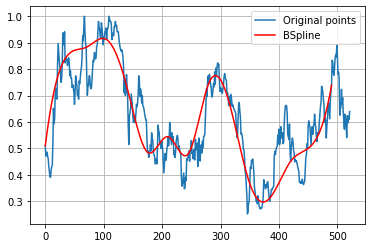

In [ ]:
import scipy.interpolate as interpolate

t_INCO_15, c_INCO_15, k_INCO_15 = interpolate.splrep(INCO_x15, INCO_y15, s=0, k=3)
print('''\
t_INCO_15: {}
c_INCO_15: {}
k_INCO_15: {}
'''.format(t_INCO_15, c_INCO_15, k_INCO_15))
N = 522
xmin_INCO_15, xmax_INCO_15 = INCO_x15.min(), INCO_x15.max()
xx_INCO_15 = np.linspace(xmin_INCO_15, xmax_INCO_15, N)
spline_INCO_15 = interpolate.BSpline(t_INCO_15, c_INCO_15, k_INCO_15, extrapolate=False)

plt.plot(INCO_x, INCO_y, label='Original points')
plt.plot(xx_INCO_15, spline_INCO_15(xx_INCO_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA INCO**

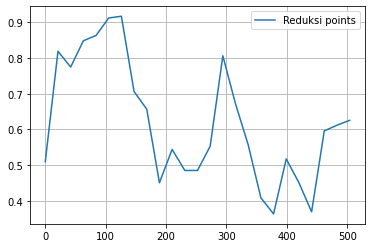

In [ ]:
INCO_x25 = INCO_x[0:522:21]
INCO_y25 = INCO_y[0:522:21]

plt.plot(INCO_x25, INCO_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INCO_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_INCO_25: [0.50980392 0.98111611 0.67012072 0.87962284 0.8472477  0.90785697
 0.99191267 0.62449236 0.74541201 0.33503606 0.62032611 0.44836539
 0.49797706 0.4714911  0.93370562 0.62898055 0.57978393 0.39306021
 0.3009164  0.58562712 0.46245749 0.27042528 0.80784284 0.51421583
 0.6254902  0.         0.         0.         0.        ]
k_INCO_25: 3



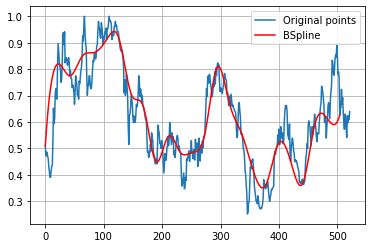

In [ ]:
import scipy.interpolate as interpolate

t_INCO_25, c_INCO_25, k_INCO_25 = interpolate.splrep(INCO_x25, INCO_y25, s=0, k=3)
print('''\
t_INCO_25: {}
c_INCO_25: {}
k_INCO_25: {}
'''.format(t_INCO_25, c_INCO_25, k_INCO_25))
N = 522
xmin_INCO_25, xmax_INCO_25 = INCO_x25.min(), INCO_x25.max()
xx_INCO_25 = np.linspace(xmin_INCO_25, xmax_INCO_25, N)
spline_INCO_25 = interpolate.BSpline(t_INCO_25, c_INCO_25, k_INCO_25, extrapolate=False)

plt.plot(INCO_x, INCO_y, label='Original points')
plt.plot(xx_INCO_25, spline_INCO_25(xx_INCO_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA INCO**

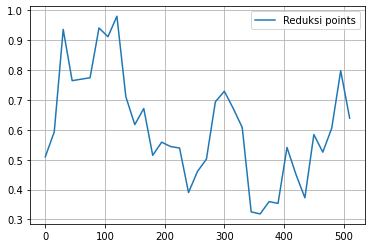

In [ ]:
INCO_x35 = INCO_x[0:522:15]
INCO_y35 = INCO_y[0:522:15]

plt.plot(INCO_x35, INCO_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INCO_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_INCO_35: [0.50980392 0.20320389 1.24310203 0.66925218 0.811587   0.70204688
 1.02728432 0.83587468 1.09980519 0.64725751 0.57587068 0.75514215
 0.4329725  0.60120316 0.51515605 0.60287851 0.30862403 0.50380185
 0.44087445 0.74446503 0.74597129 0.6481204  0.69095888 0.2351029
 0.32157069 0.39037905 0.27573665 0.63020375 0.45050716 0.27364996
 0.69018713 0.47148387 0.61193015 0.97883885 0.63921569 0.
 0.         0.         0.        ]
k_INCO_35: 3



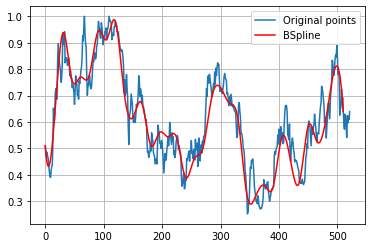

In [ ]:
import scipy.interpolate as interpolate

t_INCO_35, c_INCO_35, k_INCO_35 = interpolate.splrep(INCO_x35, INCO_y35, s=0, k=3)
print('''\
t_INCO_35: {}
c_INCO_35: {}
k_INCO_35: {}
'''.format(t_INCO_35, c_INCO_35, k_INCO_35))
N = 522
xmin_INCO_35, xmax_INCO_35 = INCO_x35.min(), INCO_x35.max()
xx_INCO_35 = np.linspace(xmin_INCO_35, xmax_INCO_35, N)
spline_INCO_35 = interpolate.BSpline(t_INCO_35, c_INCO_35, k_INCO_35, extrapolate=False)

plt.plot(INCO_x, INCO_y, label='Original points')
plt.plot(xx_INCO_35, spline_INCO_35(xx_INCO_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 45 DATA INCO**

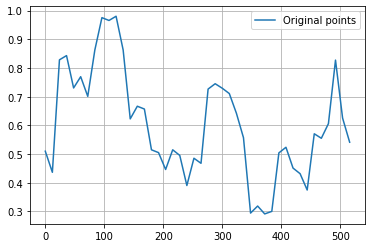

In [ ]:
INCO_x45 = INCO_x[0:522:12]
INCO_y45 = INCO_y[0:522:12]

plt.plot(INCO_x45, INCO_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INCO_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_INCO_45: [0.50980392 0.05676103 0.96245834 0.86227654 0.67230447 0.83085853
 0.62190847 0.88738994 1.00500235 0.94554185 1.00694791 0.90901947
 0.5334448  0.69249545 0.6965734  0.4623874  0.54211228 0.39857525
 0.54005732 0.52943076 0.31280787 0.56051423 0.35689992 0.81776844
 0.73084985 0.7294204  0.72793913 0.62352896 0.63088621 0.19410265
 0.35740905 0.28802585 0.23754636 0.56178869 0.53882827 0.42407468
 0.47075534 0.28113924 0.65174654 0.53540403 0.53604912 1.09557509
 0.36103598 0.54117647 0.         0.         0.         0.        ]
k_INCO_45: 3



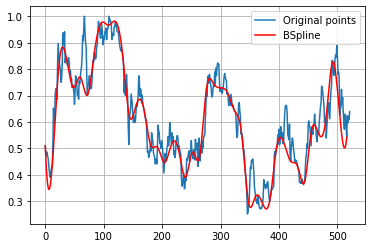

In [ ]:
import scipy.interpolate as interpolate

t_INCO_45, c_INCO_45, k_INCO_45 = interpolate.splrep(INCO_x45, INCO_y45, s=0, k=3)
print('''\
t_INCO_45: {}
c_INCO_45: {}
k_INCO_45: {}
'''.format(t_INCO_45, c_INCO_45, k_INCO_45))
N = 522
xmin_INCO_45, xmax_INCO_45 = INCO_x45.min(), INCO_x45.max()
xx_INCO_45 = np.linspace(xmin_INCO_45, xmax_INCO_45, N)
spline_INCO_45 = interpolate.BSpline(t_INCO_45, c_INCO_45, k_INCO_45, extrapolate=False)

plt.plot(INCO_x, INCO_y, label='Original points')
plt.plot(xx_INCO_45, spline_INCO_45(xx_INCO_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA INCO**

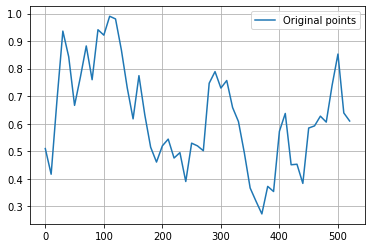

In [ ]:
INCO_x55 = INCO_x[0:522:10]
INCO_y55 = INCO_y[0:522:10]

plt.plot(INCO_x55, INCO_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INCO_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_INCO_55: [0.50980392 0.24655545 0.57551655 1.01744413 0.86187211 0.59389096
 0.76256406 0.97349986 0.63755415 1.03510709 0.86907632 1.0179994
 1.00010257 0.86394329 0.75000665 0.51838307 0.88234342 0.59930208
 0.51456592 0.43066955 0.52746179 0.57713037 0.42872261 0.56092035
 0.29818422 0.58751924 0.5282094  0.41729022 0.81439442 0.80748503
 0.69095958 0.80514723 0.62962796 0.62928212 0.50030239 0.34009655
 0.33931142 0.21442247 0.4382928  0.26770043 0.61443489 0.70985413
 0.369678   0.5173162  0.27870424 0.66786684 0.55571076 0.6622313
 0.56006993 0.73278309 1.01452805 0.40548107 0.60980392 0.
 0.         0.         0.        ]
k_INCO_55: 3



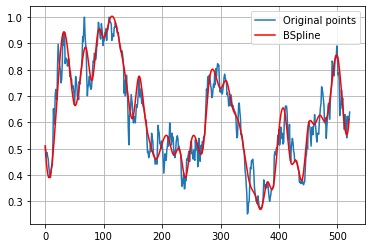

In [ ]:
import scipy.interpolate as interpolate

t_INCO_55, c_INCO_55, k_INCO_55 = interpolate.splrep(INCO_x55, INCO_y55, s=0, k=3)
print('''\
t_INCO_55: {}
c_INCO_55: {}
k_INCO_55: {}
'''.format(t_INCO_55, c_INCO_55, k_INCO_55))
N = 522
xmin_INCO_55, xmax_INCO_55 = INCO_x55.min(), INCO_x55.max()
xx_INCO_55 = np.linspace(xmin_INCO_55, xmax_INCO_55, N)
spline_INCO_55 = interpolate.BSpline(t_INCO_55, c_INCO_55, k_INCO_55, extrapolate=False)

plt.plot(INCO_x, INCO_y, label='Original points')
plt.plot(xx_INCO_55, spline_INCO_55(xx_INCO_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA INCO**

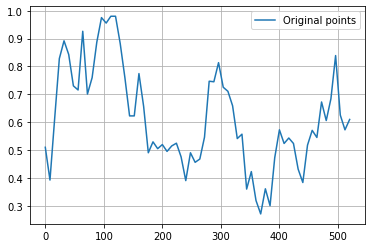

In [ ]:
INCO_x65 = INCO_x[0:522:8]
INCO_y65 = INCO_y[0:522:8]

plt.plot(INCO_x65, INCO_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INCO_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_INCO_65: [0.50980392 0.23366805 0.54001685 0.86031786 0.90922468 0.8557246
 0.72670046 0.61982651 1.08811116 0.58655237 0.77156173 0.88602427
 1.00787062 0.93543441 0.98568584 1.00417517 0.87996644 0.77007673
 0.59855018 0.57101666 0.8526773  0.66533296 0.42716733 0.56717419
 0.48060649 0.5398116  0.47779418 0.51959993 0.53204139 0.49929333
 0.32372647 0.54697725 0.429541   0.47015289 0.49572981 0.82339847
 0.69302927 0.87507269 0.68903292 0.7217368  0.68872575 0.47630136
 0.65312764 0.25236456 0.49623767 0.29797889 0.22361149 0.43110455
 0.21667617 0.50219075 0.60985494 0.49368362 0.55658706 0.53879169
 0.42942266 0.331752

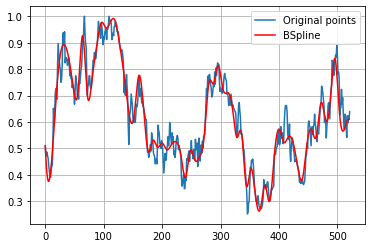

In [ ]:
import scipy.interpolate as interpolate

t_INCO_65, c_INCO_65, k_INCO_65 = interpolate.splrep(INCO_x65, INCO_y65, s=0, k=3)
print('''\
t_INCO_65: {}
c_INCO_65: {}
k_INCO_65: {}
'''.format(t_INCO_65, c_INCO_65, k_INCO_65))
N = 522
xmin_INCO_65, xmax_INCO_65 = INCO_x65.min(), INCO_x65.max()
xx_INCO_65 = np.linspace(xmin_INCO_65, xmax_INCO_65, N)
spline_INCO_65 = interpolate.BSpline(t_INCO_65, c_INCO_65, k_INCO_65, extrapolate=False)

plt.plot(INCO_x, INCO_y, label='Original points')
plt.plot(xx_INCO_65, spline_INCO_65(xx_INCO_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE INCO**

In [ ]:

#RMSE 15 DATA INCO
y_true_INCO_15 = INCO_y.tolist()
y_pred_INCO_15 = spline_INCO_15(xx_INCO_15).tolist()
mse_INCO_15 = mean_squared_error(y_true_INCO_15, y_pred_INCO_15)
rmse_INCO_15 = np.sqrt(mse_INCO_15)
print("rmse INCO 15 =",rmse_INCO_15)

#RMSE 25 DATA INCO
y_true_INCO_25 = INCO_y.tolist()
y_pred_INCO_25 = spline_INCO_25(xx_INCO_25).tolist()
mse_INCO_25 = mean_squared_error(y_true_INCO_25, y_pred_INCO_25)
rmse_INCO_25 = np.sqrt(mse_INCO_25)
print("rmse INCO 25 =",rmse_INCO_25)

#RMSE 35 DATA INCO
y_true_INCO_35 = INCO_y.tolist()
y_pred_INCO_35 = spline_INCO_35(xx_INCO_35).tolist()
mse_INCO_35 = mean_squared_error(y_true_INCO_35, y_pred_INCO_35)
rmse_INCO_35 = np.sqrt(mse_INCO_35)
print("rmse INCO 35 =",rmse_INCO_35)

#RMSE 45 DATA INCO
y_true_INCO_45 = INCO_y.tolist()
y_pred_INCO_45 = spline_INCO_45(xx_INCO_45).tolist()
mse_INCO_45 = mean_squared_error(y_true_INCO_45, y_pred_INCO_45)
rmse_INCO_45 = np.sqrt(mse_INCO_45)
print("rmse INCO 45 =",rmse_INCO_45)

#RMSE 55 DATA INCO
y_true_INCO_55 = INCO_y.tolist()
y_pred_INCO_55 = spline_INCO_55(xx_INCO_55).tolist()
mse_INCO_55 = mean_squared_error(y_true_INCO_55, y_pred_INCO_55)
rmse_INCO_55 = np.sqrt(mse_INCO_55)
print("rmse INCO 55 =",rmse_INCO_55)

#RMSE 65 DATA INCO
y_true_INCO_65 = INCO_y.tolist()
y_pred_INCO_65 = spline_INCO_65(xx_INCO_65).tolist()
mse_INCO_65 = mean_squared_error(y_true_INCO_65, y_pred_INCO_65)
rmse_INCO_65 = np.sqrt(mse_INCO_65)
print("rmse INCO 65 =",rmse_INCO_65)


rmse INCO 15 = 0.11649875759851583
rmse INCO 25 = 0.10384610389223843
rmse INCO 35 = 0.0810353438375152
rmse INCO 45 = 0.06332850424406583
rmse INCO 55 = 0.052984645724753476
rmse INCO 65 = 0.04531619721629497


# **INDF**

No handles with labels found to put in legend.


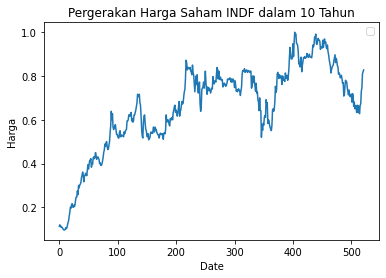

In [ ]:
INDF = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/INDF.JK.csv')

INDF_x = INDF['No'].values
INDF_y = INDF['Skala'].values

plt.plot(INDF_x,INDF_y)
plt.title('Pergerakan Harga Saham INDF dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA INDF**

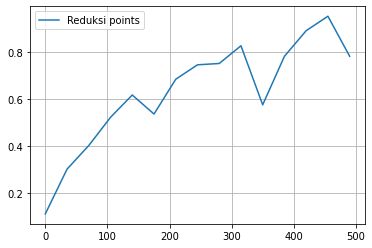

In [ ]:
INDF_x15 = INDF_x[0:522:35]
INDF_y15 = INDF_y[0:522:35]

plt.plot(INDF_x15, INDF_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDF_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_INDF_15: [0.11333333 0.29782667 0.35740221 0.51338743 0.68338511 0.45307212
 0.72099306 0.76295563 0.69385109 0.96164002 0.40958882 0.85000471
 0.88163266 1.04182256 0.78055556 0.         0.         0.
 0.        ]
k_INDF_15: 3



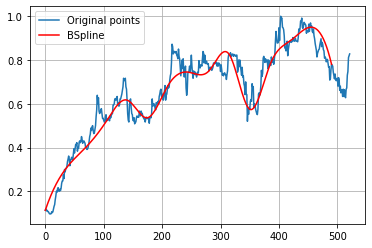

In [ ]:
import scipy.interpolate as interpolate

t_INDF_15, c_INDF_15, k_INDF_15 = interpolate.splrep(INDF_x15, INDF_y15, s=0, k=3)
print('''\
t_INDF_15: {}
c_INDF_15: {}
k_INDF_15: {}
'''.format(t_INDF_15, c_INDF_15, k_INDF_15))
N = 522
xmin_INDF_15, xmax_INDF_15 = INDF_x15.min(), INDF_x15.max()
xx_INDF_15 = np.linspace(xmin_INDF_15, xmax_INDF_15, N)
spline_INDF_15 = interpolate.BSpline(t_INDF_15, c_INDF_15, k_INDF_15, extrapolate=False)

plt.plot(INDF_x, INDF_y, label='Original points')
plt.plot(xx_INDF_15, spline_INDF_15(xx_INDF_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA INDF**

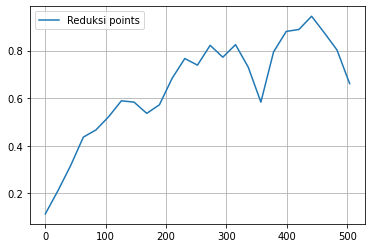

In [ ]:
INDF_x25 = INDF_x[0:522:21]
INDF_y25 = INDF_y[0:522:21]

plt.plot(INDF_x25, INDF_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDF_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_INDF_25: [0.11333333 0.18766661 0.25411122 0.46392577 0.45439873 0.51847931
 0.60501736 0.5947846  0.51584423 0.55850513 0.6834686  0.80762049
 0.68604945 0.88151503 0.72122374 0.86692333 0.76108295 0.4720782
 0.85060423 0.89217152 0.86404301 0.98498976 0.82188954 0.81058301
 0.66111111 0.         0.         0.         0.        ]
k_INDF_25: 3



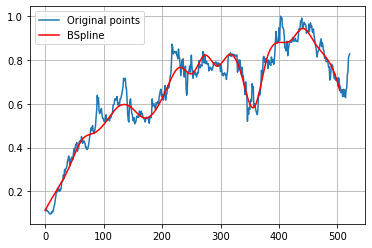

In [ ]:
import scipy.interpolate as interpolate

t_INDF_25, c_INDF_25, k_INDF_25 = interpolate.splrep(INDF_x25, INDF_y25, s=0, k=3)
print('''\
t_INDF_25: {}
c_INDF_25: {}
k_INDF_25: {}
'''.format(t_INDF_25, c_INDF_25, k_INDF_25))
N = 522
xmin_INDF_25, xmax_INDF_25 = INDF_x25.min(), INDF_x25.max()
xx_INDF_25 = np.linspace(xmin_INDF_25, xmax_INDF_25, N)
spline_INDF_25 = interpolate.BSpline(t_INDF_25, c_INDF_25, k_INDF_25, extrapolate=False)

plt.plot(INDF_x, INDF_y, label='Original points')
plt.plot(xx_INDF_25, spline_INDF_25(xx_INDF_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA INDF**

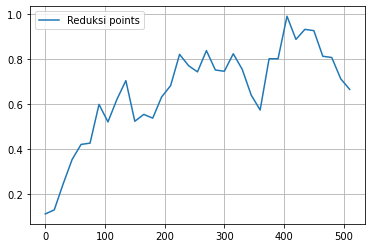

In [ ]:
INDF_x35 = INDF_x[0:522:15]
INDF_y35 = INDF_y[0:522:15]

plt.plot(INDF_x35, INDF_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDF_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_INDF_35: [0.11333333 0.06265854 0.21884959 0.35603117 0.45606368 0.35304745
 0.6984132  0.45329977 0.62172106 0.79314933 0.43901496 0.60079083
 0.49115505 0.66792232 0.63715568 0.88345495 0.76235785 0.70044698
 0.9025209  0.72280276 0.72293472 0.8687917  0.75189848 0.65694771
 0.47031069 0.91180953 0.69911786 1.10838569 0.81733937 0.95559018
 0.96029992 0.76987681 0.86807595 0.6249898  0.66666667 0.
 0.         0.         0.        ]
k_INDF_35: 3



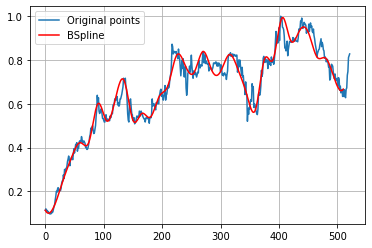

In [ ]:
import scipy.interpolate as interpolate

t_INDF_35, c_INDF_35, k_INDF_35 = interpolate.splrep(INDF_x35, INDF_y35, s=0, k=3)
print('''\
t_INDF_35: {}
c_INDF_35: {}
k_INDF_35: {}
'''.format(t_INDF_35, c_INDF_35, k_INDF_35))
N = 522
xmin_INDF_35, xmax_INDF_35 = INDF_x35.min(), INDF_x35.max()
xx_INDF_35 = np.linspace(xmin_INDF_35, xmax_INDF_35, N)
spline_INDF_35 = interpolate.BSpline(t_INDF_35, c_INDF_35, k_INDF_35, extrapolate=False)

plt.plot(INDF_x, INDF_y, label='Original points')
plt.plot(xx_INDF_35, spline_INDF_35(xx_INDF_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA INDF**

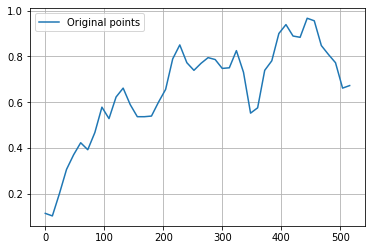

In [ ]:
INDF_x45 = INDF_x[0:522:12]
INDF_y45 = INDF_y[0:522:12]

plt.plot(INDF_x45, INDF_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDF_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_INDF_45: [0.11333333 0.04615349 0.15991524 0.3180901  0.36151396 0.4525207
 0.36173656 0.45053307 0.63613117 0.47160891 0.64409987 0.68532496
 0.58126695 0.52294057 0.54363743 0.51917638 0.61299038 0.62886211
 0.8048945  0.8848932  0.75553269 0.72630939 0.7725631  0.80010488
 0.79368405 0.74182558 0.72234696 0.86878659 0.75250668 0.50452004
 0.53941318 0.78782725 0.74261114 0.92506151 0.95714283 0.87970052
 0.85738841 0.99074583 0.97962827 0.82407444 0.80740731 0.79259266
 0.56481478 0.67222222 0.         0.         0.         0.        ]
k_INDF_45: 3



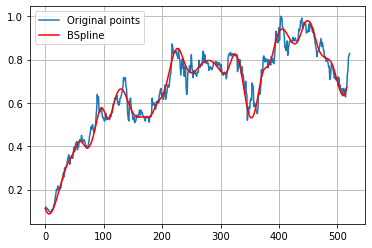

In [ ]:
import scipy.interpolate as interpolate

t_INDF_45, c_INDF_45, k_INDF_45 = interpolate.splrep(INDF_x45, INDF_y45, s=0, k=3)
print('''\
t_INDF_45: {}
c_INDF_45: {}
k_INDF_45: {}
'''.format(t_INDF_45, c_INDF_45, k_INDF_45))
N = 522
xmin_INDF_45, xmax_INDF_45 = INDF_x45.min(), INDF_x45.max()
xx_INDF_45 = np.linspace(xmin_INDF_45, xmax_INDF_45, N)
spline_INDF_45 = interpolate.BSpline(t_INDF_45, c_INDF_45, k_INDF_45, extrapolate=False)

plt.plot(INDF_x, INDF_y, label='Original points')
plt.plot(xx_INDF_45, spline_INDF_45(xx_INDF_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA INDF**

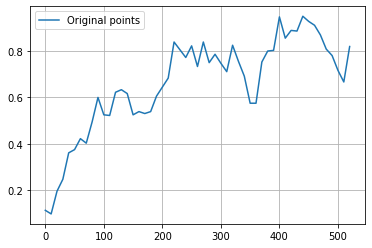

In [ ]:
INDF_x55 = INDF_x[0:522:10]
INDF_y55 = INDF_y[0:522:10]

plt.plot(INDF_x55, INDF_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INDF_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_INDF_55: [0.11333333 0.0078581  0.22095046 0.21579653 0.40048522 0.34892926
 0.45379774 0.3692131  0.48601654 0.65338741 0.50043382 0.49487732
 0.65339023 0.6248951  0.64702937 0.48698744 0.55502089 0.52626236
 0.52326303 0.61401886 0.65399486 0.63666836 0.8993317  0.79933818
 0.73664892 0.88739946 0.64708659 0.9242542  0.68922996 0.81882598
 0.7521328  0.65597616 0.89062923 0.73150691 0.71667647 0.55178723
 0.52617461 0.79351434 0.81643472 0.7407468  1.03724476 0.79360748
 0.92165866 0.85309121 0.98264316 0.91633615 0.9186789  0.87561492
 0.79552808 0.79227276 0.6941947  0.6022082  0.81944444 0.
 0.         0.         0.        ]
k_INDF_55: 3



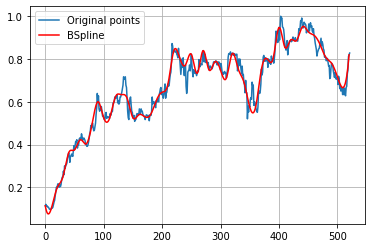

In [ ]:
import scipy.interpolate as interpolate

t_INDF_55, c_INDF_55, k_INDF_55 = interpolate.splrep(INDF_x55, INDF_y55, s=0, k=3)
print('''\
t_INDF_55: {}
c_INDF_55: {}
k_INDF_55: {}
'''.format(t_INDF_55, c_INDF_55, k_INDF_55))
N = 522
xmin_INDF_55, xmax_INDF_55 = INDF_x55.min(), INDF_x55.max()
xx_INDF_55 = np.linspace(xmin_INDF_55, xmax_INDF_55, N)
spline_INDF_55 = interpolate.BSpline(t_INDF_55, c_INDF_55, k_INDF_55, extrapolate=False)

plt.plot(INDF_x, INDF_y, label='Original points')
plt.plot(xx_INDF_55, spline_INDF_55(xx_INDF_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA INDF**

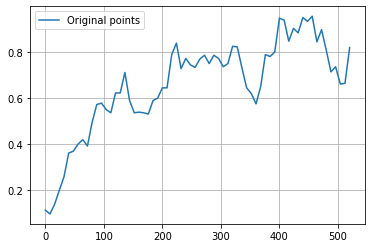

In [ ]:
INDF_x65 = INDF_x[0:522:8]
INDF_y65 = INDF_y[0:522:8]

plt.plot(INDF_x65, INDF_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INDF_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_INDF_65: [0.11333333 0.07483855 0.11087845 0.20692306 0.23741816 0.3934043
 0.3556313  0.40073714 0.44142012 0.35024904 0.50758372 0.58608273
 0.58141869 0.55490919 0.49894456 0.66597924 0.57047183 0.78546678
 0.55432772 0.53055566 0.54011629 0.54231251 0.50730032 0.61181954
 0.57875487 0.67316099 0.59526784 0.81243431 0.88832824 0.66758607
 0.80799414 0.73377072 0.72358966 0.77187064 0.80559445 0.72241823
 0.80473264 0.77531789 0.72732915 0.73203219 0.84454208 0.8397995
 0.72959326 0.62516079 0.63643023 0.54578495 0.63042998 0.83249514
 0.7729228  0.75914699 0.99048923 0.96222943 0.79392639 0.94539834
 0.84114691 0.9900140

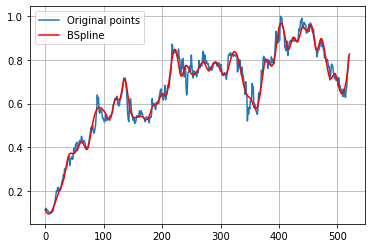

In [ ]:
import scipy.interpolate as interpolate

t_INDF_65, c_INDF_65, k_INDF_65 = interpolate.splrep(INDF_x65, INDF_y65, s=0, k=3)
print('''\
t_INDF_65: {}
c_INDF_65: {}
k_INDF_65: {}
'''.format(t_INDF_65, c_INDF_65, k_INDF_65))
N = 522
xmin_INDF_65, xmax_INDF_65 = INDF_x65.min(), INDF_x65.max()
xx_INDF_65 = np.linspace(xmin_INDF_65, xmax_INDF_65, N)
spline_INDF_65 = interpolate.BSpline(t_INDF_65, c_INDF_65, k_INDF_65, extrapolate=False)

plt.plot(INDF_x, INDF_y, label='Original points')
plt.plot(xx_INDF_65, spline_INDF_65(xx_INDF_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE INDF**

In [ ]:

#RMSE 15 DATA INDF
y_true_INDF_15 = INDF_y.tolist()
y_pred_INDF_15 = spline_INDF_15(xx_INDF_15).tolist()
mse_INDF_15 = mean_squared_error(y_true_INDF_15, y_pred_INDF_15)
rmse_INDF_15 = np.sqrt(mse_INDF_15)
print("rmse INDF 15 =",rmse_INDF_15)

#RMSE 25 DATA INDF
y_true_INDF_25 = INDF_y.tolist()
y_pred_INDF_25 = spline_INDF_25(xx_INDF_25).tolist()
mse_INDF_25 = mean_squared_error(y_true_INDF_25, y_pred_INDF_25)
rmse_INDF_25 = np.sqrt(mse_INDF_25)
print("rmse INDF 25 =",rmse_INDF_25)

#RMSE 35 DATA INDF
y_true_INDF_35 = INDF_y.tolist()
y_pred_INDF_35 = spline_INDF_35(xx_INDF_35).tolist()
mse_INDF_35 = mean_squared_error(y_true_INDF_35, y_pred_INDF_35)
rmse_INDF_35 = np.sqrt(mse_INDF_35)
print("rmse INDF 35 =",rmse_INDF_35)

#RMSE 45 DATA INDF
y_true_INDF_45 = INDF_y.tolist()
y_pred_INDF_45 = spline_INDF_45(xx_INDF_45).tolist()
mse_INDF_45 = mean_squared_error(y_true_INDF_45, y_pred_INDF_45)
rmse_INDF_45 = np.sqrt(mse_INDF_45)
print("rmse INDF 45 =",rmse_INDF_45)

#RMSE 55 DATA INDF
y_true_INDF_55 = INDF_y.tolist()
y_pred_INDF_55 = spline_INDF_55(xx_INDF_55).tolist()
mse_INDF_55 = mean_squared_error(y_true_INDF_55, y_pred_INDF_55)
rmse_INDF_55 = np.sqrt(mse_INDF_55)
print("rmse INDF 55 =",rmse_INDF_55)

#RMSE 65 DATA INDF
y_true_INDF_65 = INDF_y.tolist()
y_pred_INDF_65 = spline_INDF_65(xx_INDF_65).tolist()
mse_INDF_65 = mean_squared_error(y_true_INDF_65, y_pred_INDF_65)
rmse_INDF_65 = np.sqrt(mse_INDF_65)
print("rmse INDF 65 =",rmse_INDF_65)

rmse INDF 15 = 0.09881600737447291
rmse INDF 25 = 0.062445715587226766
rmse INDF 35 = 0.05098235007131461
rmse INDF 45 = 0.04164275549038404
rmse INDF 55 = 0.032204384867824
rmse INDF 65 = 0.028696463458008335


# **INDY**

No handles with labels found to put in legend.


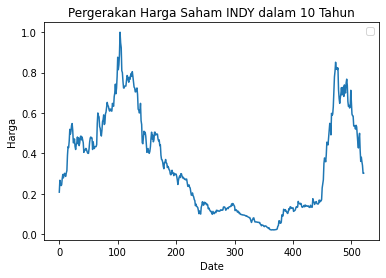

In [ ]:
INDY = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/INDY.JK.csv')

INDY_x = INDY['No'].values
INDY_y = INDY['Skala'].values

plt.plot(INDY_x,INDY_y)
plt.title('Pergerakan Harga Saham INDY dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA INDY**

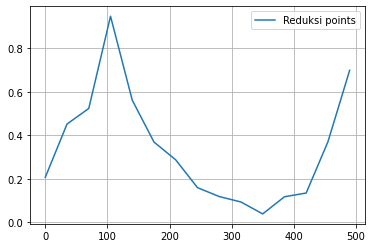

In [ ]:
INDY_x15 = INDY_x[0:522:35]
INDY_y15 = INDY_y[0:522:35]

plt.plot(INDY_x15, INDY_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDY_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_INDY_15: [ 0.20761905  0.68487703  0.07405546  1.21971047  0.44640321  0.36610526
  0.3063186   0.13433464  0.11634285  0.11457966 -0.01009007  0.1612092
  0.04469651  0.5100327   0.69904762  0.          0.          0.
  0.        ]
k_INDY_15: 3



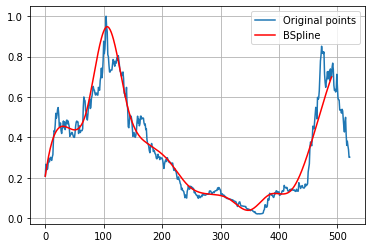

In [ ]:
import scipy.interpolate as interpolate

t_INDY_15, c_INDY_15, k_INDY_15 = interpolate.splrep(INDY_x15, INDY_y15, s=0, k=3)
print('''\
t_INDY_15: {}
c_INDY_15: {}
k_INDY_15: {}
'''.format(t_INDY_15, c_INDY_15, k_INDY_15))
N = 522
xmin_INDY_15, xmax_INDY_15 = INDY_x15.min(), INDY_x15.max()
xx_INDY_15 = np.linspace(xmin_INDY_15, xmax_INDY_15, N)
spline_INDY_15 = interpolate.BSpline(t_INDY_15, c_INDY_15, k_INDY_15, extrapolate=False)

plt.plot(INDY_x, INDY_y, label='Original points')
plt.plot(xx_INDY_15, spline_INDY_15(xx_INDY_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA INDY**

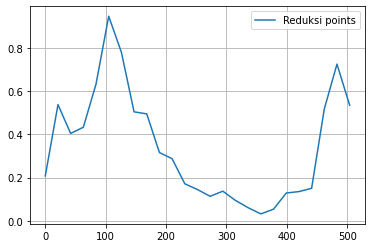

In [ ]:
INDY_x25 = INDY_x[0:522:21]
INDY_y25 = INDY_y[0:522:21]

plt.plot(INDY_x25, INDY_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDY_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_INDY_25: [0.20761905 0.76053295 0.32512458 0.41890043 0.57582972 1.07778068
 0.79876184 0.41288625 0.57826458 0.245484   0.33694229 0.13246112
 0.16178465 0.08897171 0.1623285  0.08457144 0.06395718 0.02188557
 0.03935769 0.14411226 0.15562186 0.04482888 0.74228339 0.81695354
 0.53523809 0.         0.         0.         0.        ]
k_INDY_25: 3



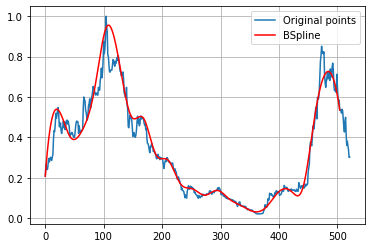

In [ ]:
import scipy.interpolate as interpolate

t_INDY_25, c_INDY_25, k_INDY_25 = interpolate.splrep(INDY_x25, INDY_y25, s=0, k=3)
print('''\
t_INDY_25: {}
c_INDY_25: {}
k_INDY_25: {}
'''.format(t_INDY_25, c_INDY_25, k_INDY_25))
N = 522
xmin_INDY_25, xmax_INDY_25 = INDY_x25.min(), INDY_x25.max()
xx_INDY_25 = np.linspace(xmin_INDY_25, xmax_INDY_25, N)
spline_INDY_25 = interpolate.BSpline(t_INDY_25, c_INDY_25, k_INDY_25, extrapolate=False)

plt.plot(INDY_x, INDY_y, label='Original points')
plt.plot(xx_INDY_25, spline_INDY_25(xx_INDY_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA INDY**

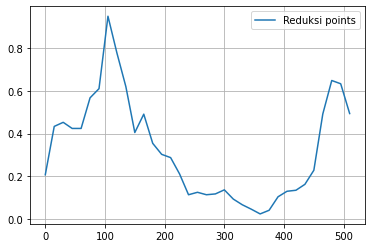

In [ ]:
INDY_x35 = INDY_x[0:522:15]
INDY_y35 = INDY_y[0:522:15]

plt.plot(INDY_x35, INDY_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INDY_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_INDY_35: [0.20761905 0.47062229 0.46208875 0.43012084 0.368277   0.63962829
 0.47320984 1.1246752  0.71380366 0.67725303 0.29146994 0.58543865
 0.30963261 0.3017452  0.30052944 0.22185131 0.08063675 0.14131599
 0.10838502 0.11085822 0.15675353 0.0849848  0.0678787  0.04921468
 0.01754829 0.0291636  0.11608303 0.13507571 0.12647127 0.17046779
 0.16880044 0.52575904 0.72706011 0.61599375 0.49333333 0.
 0.         0.         0.        ]
k_INDY_35: 3



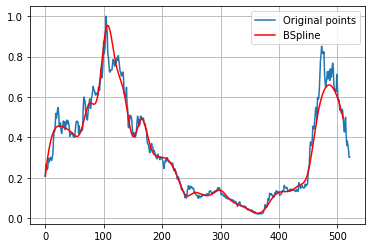

In [ ]:
import scipy.interpolate as interpolate

t_INDY_35, c_INDY_35, k_INDY_35 = interpolate.splrep(INDY_x35, INDY_y35, s=0, k=3)
print('''\
t_INDY_35: {}
c_INDY_35: {}
k_INDY_35: {}
'''.format(t_INDY_35, c_INDY_35, k_INDY_35))
N = 522
xmin_INDY_35, xmax_INDY_35 = INDY_x35.min(), INDY_x35.max()
xx_INDY_35 = np.linspace(xmin_INDY_35, xmax_INDY_35, N)
spline_INDY_35 = interpolate.BSpline(t_INDY_35, c_INDY_35, k_INDY_35, extrapolate=False)

plt.plot(INDY_x, INDY_y, label='Original points')
plt.plot(xx_INDY_35, spline_INDY_35(xx_INDY_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA INDY**

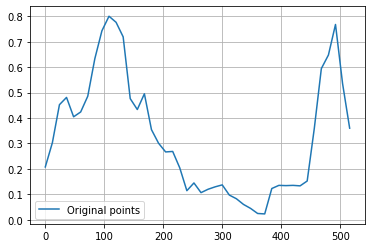

In [ ]:
INDY_x45 = INDY_x[0:522:12]
INDY_y45 = INDY_y[0:522:12]

plt.plot(INDY_x45, INDY_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INDY_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_INDY_45: [ 0.20761905  0.20685781  0.46771294  0.50866868  0.3730877   0.42755196
  0.45956159  0.6484874   0.74648882  0.82270019  0.76271042  0.78360097
  0.41717141  0.40485624  0.56340361  0.31295787  0.31047917  0.25083972
  0.28616197  0.215941    0.07293119  0.17804852  0.08344615  0.12816687
  0.12388636  0.15343055  0.08524859  0.08843223  0.05702248  0.04576356
  0.02849471 -0.01117097  0.15447489  0.13041426  0.13529664  0.13411346
  0.13967809  0.10717417  0.34591095  0.65775344  0.58878956  0.96747363
  0.30483461  0.36        0.          0.          0.          0.        ]
k_INDY_45: 3



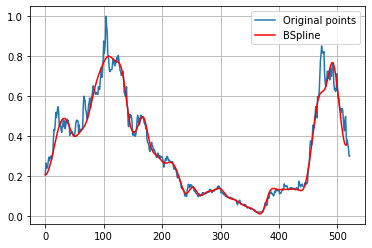

In [ ]:
import scipy.interpolate as interpolate

t_INDY_45, c_INDY_45, k_INDY_45 = interpolate.splrep(INDY_x45, INDY_y45, s=0, k=3)
print('''\
t_INDY_45: {}
c_INDY_45: {}
k_INDY_45: {}
'''.format(t_INDY_45, c_INDY_45, k_INDY_45))
N = 522
xmin_INDY_45, xmax_INDY_45 = INDY_x45.min(), INDY_x45.max()
xx_INDY_45 = np.linspace(xmin_INDY_45, xmax_INDY_45, N)
spline_INDY_45 = interpolate.BSpline(t_INDY_45, c_INDY_45, k_INDY_45, extrapolate=False)

plt.plot(INDY_x, INDY_y, label='Original points')
plt.plot(xx_INDY_45, spline_INDY_45(xx_INDY_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA INDY**


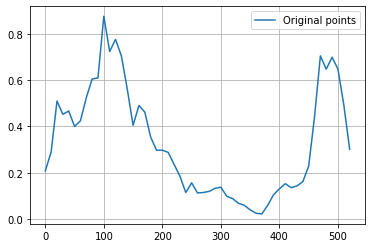

In [ ]:
INDY_x55 = INDY_x[0:522:10]
INDY_y55 = INDY_y[0:522:10]

plt.plot(INDY_x55, INDY_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INDY_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_INDY_55: [0.20761905 0.06885594 0.66181193 0.40259957 0.50687859 0.36988606
 0.41357717 0.51866241 0.65463034 0.49138765 1.03696191 0.61790758
 0.83426493 0.70217556 0.58560427 0.32683593 0.53562345 0.47352741
 0.34169546 0.28540501 0.29954163 0.29928559 0.22903028 0.20173614
 0.07259657 0.19359185 0.09017888 0.11997834 0.11562204 0.1318192
 0.15138687 0.08549047 0.09522269 0.06161879 0.06401645 0.03660113
 0.02500759 0.01193992 0.05751843 0.11112921 0.12653617 0.16558326
 0.12541649 0.14417936 0.15500893 0.20149919 0.41042288 0.80823787
 0.58519706 0.73668819 0.63755179 0.43074791 0.30095238 0.
 0.         0.         0.        ]
k_INDY_55: 3



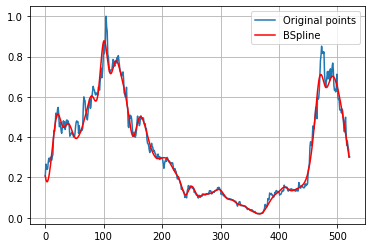

In [ ]:
import scipy.interpolate as interpolate

t_INDY_55, c_INDY_55, k_INDY_55 = interpolate.splrep(INDY_x55, INDY_y55, s=0, k=3)
print('''\
t_INDY_55: {}
c_INDY_55: {}
k_INDY_55: {}
'''.format(t_INDY_55, c_INDY_55, k_INDY_55))
N = 522
xmin_INDY_55, xmax_INDY_55 = INDY_x55.min(), INDY_x55.max()
xx_INDY_55 = np.linspace(xmin_INDY_55, xmax_INDY_55, N)
spline_INDY_55 = interpolate.BSpline(t_INDY_55, c_INDY_55, k_INDY_55, extrapolate=False)

plt.plot(INDY_x, INDY_y, label='Original points')
plt.plot(xx_INDY_55, spline_INDY_55(xx_INDY_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA INDY**

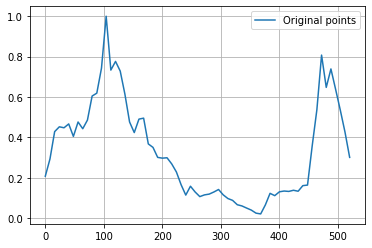

In [ ]:
INDY_x65 = INDY_x[0:522:8]
INDY_y65 = INDY_y[0:522:8]

plt.plot(INDY_x65, INDY_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INDY_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_INDY_65: [0.20761905 0.198696   0.45784609 0.45640547 0.43117789 0.50459727
 0.35043305 0.52224195 0.41774199 0.46393294 0.64081195 0.60139069
 0.667911   1.18410816 0.59565636 0.8332664  0.72842091 0.62447853
 0.45937927 0.39514726 0.50288884 0.53615452 0.32392164 0.37387322
 0.28344263 0.29807055 0.30713233 0.26768586 0.23355281 0.16953146
 0.08260708 0.18575452 0.12294626 0.0996033  0.11864053 0.11726314
 0.12659263 0.1535092  0.11079915 0.09472276 0.09316696 0.0606094
 0.06325257 0.04866601 0.04151195 0.02414333 0.01048614 0.05962638
 0.14529406 0.09634025 0.13791638 0.13485137 0.12839242 0.14586466
 0.11672038 0.187253

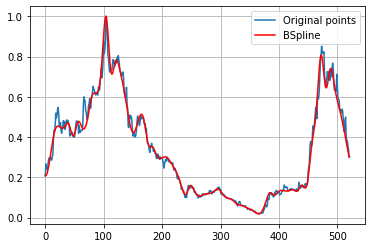

In [ ]:
import scipy.interpolate as interpolate

t_INDY_65, c_INDY_65, k_INDY_65 = interpolate.splrep(INDY_x65, INDY_y65, s=0, k=3)
print('''\
t_INDY_65: {}
c_INDY_65: {}
k_INDY_65: {}
'''.format(t_INDY_65, c_INDY_65, k_INDY_65))
N = 522
xmin_INDY_65, xmax_INDY_65 = INDY_x65.min(), INDY_x65.max()
xx_INDY_65 = np.linspace(xmin_INDY_65, xmax_INDY_65, N)
spline_INDY_65 = interpolate.BSpline(t_INDY_65, c_INDY_65, k_INDY_65, extrapolate=False)

plt.plot(INDY_x, INDY_y, label='Original points')
plt.plot(xx_INDY_65, spline_INDY_65(xx_INDY_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE INDY**

In [ ]:

#RMSE 15 DATA INDY
y_true_INDY_15 = INDY_y.tolist()
y_pred_INDY_15 = spline_INDY_15(xx_INDY_15).tolist()
mse_INDY_15 = mean_squared_error(y_true_INDY_15, y_pred_INDY_15)
rmse_INDY_15 = np.sqrt(mse_INDY_15)
print("rmse INDY 15 =",rmse_INDY_15)

#RMSE 25 DATA INDY
y_true_INDY_25 = INDY_y.tolist()
y_pred_INDY_25 = spline_INDY_25(xx_INDY_25).tolist()
mse_INDY_25 = mean_squared_error(y_true_INDY_25, y_pred_INDY_25)
rmse_INDY_25 = np.sqrt(mse_INDY_25)
print("rmse INDY 25 =",rmse_INDY_25)

#RMSE 35 DATA INDY
y_true_INDY_35 = INDY_y.tolist()
y_pred_INDY_35 = spline_INDY_35(xx_INDY_35).tolist()
mse_INDY_35 = mean_squared_error(y_true_INDY_35, y_pred_INDY_35)
rmse_INDY_35 = np.sqrt(mse_INDY_35)
print("rmse INDY 35 =",rmse_INDY_35)

#RMSE 45 DATA INDY
y_true_INDY_45 = INDY_y.tolist()
y_pred_INDY_45 = spline_INDY_45(xx_INDY_45).tolist()
mse_INDY_45 = mean_squared_error(y_true_INDY_45, y_pred_INDY_45)
rmse_INDY_45 = np.sqrt(mse_INDY_45)
print("rmse INDY 45 =",rmse_INDY_45)

#RMSE 55 DATA INDY
y_true_INDY_55 = INDY_y.tolist()
y_pred_INDY_55 = spline_INDY_55(xx_INDY_55).tolist()
mse_INDY_55 = mean_squared_error(y_true_INDY_55, y_pred_INDY_55)
rmse_INDY_55 = np.sqrt(mse_INDY_55)
print("rmse INDY 55 =",rmse_INDY_55)

#RMSE 65 DATA INDY
y_true_INDY_65 = INDY_y.tolist()
y_pred_INDY_65 = spline_INDY_65(xx_INDY_65).tolist()
mse_INDY_65 = mean_squared_error(y_true_INDY_65, y_pred_INDY_65)
rmse_INDY_65 = np.sqrt(mse_INDY_65)
print("rmse INDY 65 =",rmse_INDY_65)

rmse INDY 15 = 0.12480467218562696
rmse INDY 25 = 0.09729487910573832
rmse INDY 35 = 0.07815637533675299
rmse INDY 45 = 0.05150876200988281
rmse INDY 55 = 0.03412543633745704
rmse INDY 65 = 0.030932106872775523


# **INKP**

No handles with labels found to put in legend.


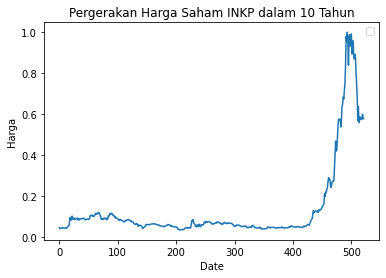

In [ ]:
INKP = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/INKP.JK.csv')

INKP_x = INKP['No'].values
INKP_y = INKP['Skala'].values

plt.plot(INKP_x,INKP_y)
plt.title('Pergerakan Harga Saham INKP dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA INKP**

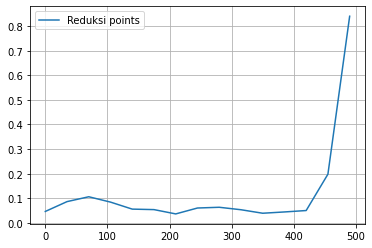

In [ ]:
INKP_x15 = INKP_x[0:522:35]
INKP_y15 = INKP_y[0:522:35]

plt.plot(INKP_x15, INKP_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INKP_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_INKP_15: [0.0465     0.0723138  0.1249974  0.0863164  0.04640724 0.06405464
 0.0213742  0.06944856 0.06383157 0.05622515 0.03226782 0.05020358
 0.02848928 0.15919286 0.84       0.         0.         0.
 0.        ]
k_INKP_15: 3



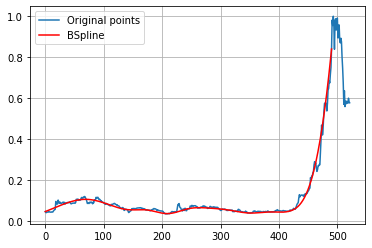

In [ ]:
import scipy.interpolate as interpolate

t_INKP_15, c_INKP_15, k_INKP_15 = interpolate.splrep(INKP_x15, INKP_y15, s=0, k=3)
print('''\
t_INKP_15: {}
c_INKP_15: {}
k_INKP_15: {}
'''.format(t_INKP_15, c_INKP_15, k_INKP_15))
N = 522
xmin_INKP_15, xmax_INKP_15 = INKP_x15.min(), INKP_x15.max()
xx_INKP_15 = np.linspace(xmin_INKP_15, xmax_INKP_15, N)
spline_INKP_15 = interpolate.BSpline(t_INKP_15, c_INKP_15, k_INKP_15, extrapolate=False)

plt.plot(INKP_x, INKP_y, label='Original points')
plt.plot(xx_INKP_15, spline_INKP_15(xx_INKP_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA INKP**

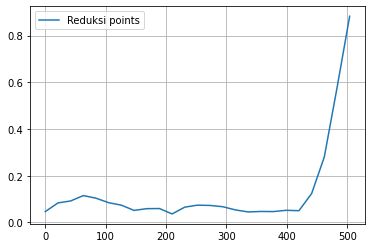

In [ ]:
INKP_x25 = INKP_x[0:522:21]
INKP_y25 = INKP_y[0:522:21]

plt.plot(INKP_x25, INKP_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INKP_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_INKP_25: [0.0465     0.09685428 0.07104144 0.12531285 0.10413933 0.08062983
 0.08034134 0.04200482 0.06063937 0.06943771 0.01860981 0.07512305
 0.073898   0.07328495 0.06946218 0.05236632 0.04207256 0.04934346
 0.04255359 0.05944218 0.03167769 0.11534706 0.29212974 0.71331013
 0.8825     0.         0.         0.         0.        ]
k_INKP_25: 3



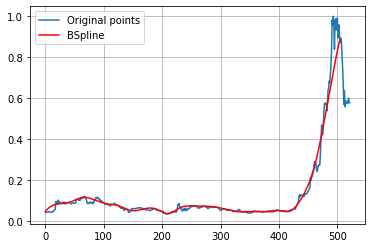

In [ ]:
import scipy.interpolate as interpolate

t_INKP_25, c_INKP_25, k_INKP_25 = interpolate.splrep(INKP_x25, INKP_y25, s=0, k=3)
print('''\
t_INKP_25: {}
c_INKP_25: {}
k_INKP_25: {}
'''.format(t_INKP_25, c_INKP_25, k_INKP_25))
N = 522
xmin_INKP_25, xmax_INKP_25 = INKP_x25.min(), INKP_x25.max()
xx_INKP_25 = np.linspace(xmin_INKP_25, xmax_INKP_25, N)
spline_INKP_25 = interpolate.BSpline(t_INKP_25, c_INKP_25, k_INKP_25, extrapolate=False)

plt.plot(INKP_x, INKP_y, label='Original points')
plt.plot(xx_INKP_25, spline_INKP_25(xx_INKP_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA INKP**

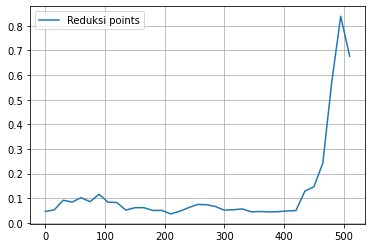

In [ ]:
INKP_x35 = INKP_x[0:522:15]
INKP_y35 = INKP_y[0:522:15]

plt.plot(INKP_x35, INKP_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INKP_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_INKP_35: [0.0465     0.0104483  0.1218534  0.06942824 0.12053993 0.06341203
 0.14181193 0.06684024 0.09782711 0.03685133 0.06676757 0.0650784
 0.04491884 0.05824625 0.02809615 0.04836913 0.06042733 0.07892155
 0.07388647 0.06953257 0.04698324 0.05303447 0.06187888 0.03995001
 0.0483211  0.04426561 0.04311648 0.05626849 0.02280958 0.15399321
 0.13521759 0.18413642 0.71627016 1.00748992 0.67625    0.
 0.         0.         0.        ]
k_INKP_35: 3



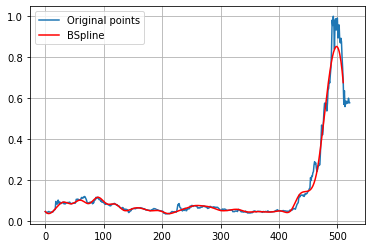

In [ ]:
import scipy.interpolate as interpolate

t_INKP_35, c_INKP_35, k_INKP_35 = interpolate.splrep(INKP_x35, INKP_y35, s=0, k=3)
print('''\
t_INKP_35: {}
c_INKP_35: {}
k_INKP_35: {}
'''.format(t_INKP_35, c_INKP_35, k_INKP_35))
N = 522
xmin_INKP_35, xmax_INKP_35 = INKP_x35.min(), INKP_x35.max()
xx_INKP_35 = np.linspace(xmin_INKP_35, xmax_INKP_35, N)
spline_INKP_35 = interpolate.BSpline(t_INKP_35, c_INKP_35, k_INKP_35, extrapolate=False)

plt.plot(INKP_x, INKP_y, label='Original points')
plt.plot(xx_INKP_35, spline_INKP_35(xx_INKP_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA INKP**

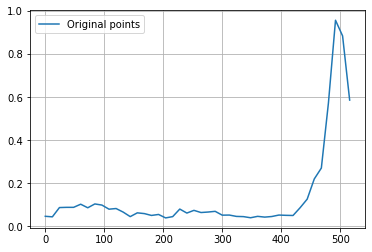

In [ ]:
INKP_x45 = INKP_x[0:522:12]
INKP_y45 = INKP_y[0:522:12]

plt.plot(INKP_x45, INKP_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INKP_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_INKP_45: [0.0465     0.00259355 0.10406291 0.0866973  0.08148927 0.1153456
 0.07212834 0.11214105 0.10180745 0.07162913 0.08867601 0.06866681
 0.03265675 0.0707062  0.05951844 0.04522003 0.06260143 0.03437426
 0.03390153 0.10001961 0.04602003 0.08490028 0.05837885 0.06558433
 0.07678385 0.04428028 0.05659502 0.04283965 0.04804637 0.03497486
 0.05055418 0.04030841 0.04471218 0.05384286 0.05341637 0.03849167
 0.09411697 0.10254045 0.25172122 0.20757467 0.53798009 1.24467994
 0.75766003 0.585      0.         0.         0.         0.        ]
k_INKP_45: 3



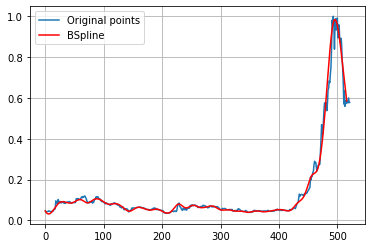

In [ ]:
import scipy.interpolate as interpolate

t_INKP_45, c_INKP_45, k_INKP_45 = interpolate.splrep(INKP_x45, INKP_y45, s=0, k=3)
print('''\
t_INKP_45: {}
c_INKP_45: {}
k_INKP_45: {}
'''.format(t_INKP_45, c_INKP_45, k_INKP_45))
N = 522
xmin_INKP_45, xmax_INKP_45 = INKP_x45.min(), INKP_x45.max()
xx_INKP_45 = np.linspace(xmin_INKP_45, xmax_INKP_45, N)
spline_INKP_45 = interpolate.BSpline(t_INKP_45, c_INKP_45, k_INKP_45, extrapolate=False)

plt.plot(INKP_x, INKP_y, label='Original points')
plt.plot(xx_INKP_45, spline_INKP_45(xx_INKP_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA INKP**

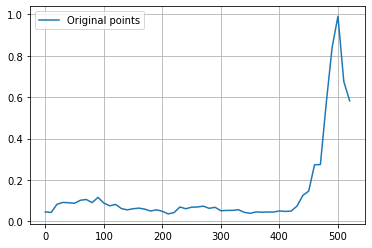

In [ ]:
INKP_x55 = INKP_x[0:522:10]
INKP_y55 = INKP_y[0:522:10]

plt.plot(INKP_x55, INKP_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INKP_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_INKP_55: [0.0465     0.00832117 0.09260766 0.09188018 0.09205349 0.08290586
 0.10432307 0.11480186 0.07396949 0.13532019 0.08224976 0.06968076
 0.09202718 0.05721051 0.05413078 0.06226637 0.06580373 0.0615187
 0.04512145 0.06099549 0.0498966  0.03341811 0.03543097 0.08285801
 0.05313699 0.07359404 0.06648686 0.08045852 0.05567905 0.07782526
 0.0440199  0.05659512 0.05059961 0.06200645 0.04187458 0.03599522
 0.04964455 0.04292659 0.04714911 0.04297697 0.05394299 0.04725106
 0.04805275 0.06203793 0.14929554 0.09677992 0.34258477 0.17538099
 0.60589125 0.828554   1.21700567 0.35055967 0.5825     0.
 0.         0.         0.        ]
k_INKP_55: 3



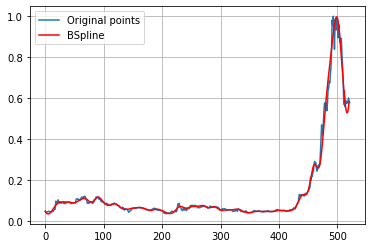

In [ ]:
import scipy.interpolate as interpolate

t_INKP_55, c_INKP_55, k_INKP_55 = interpolate.splrep(INKP_x55, INKP_y55, s=0, k=3)
print('''\
t_INKP_55: {}
c_INKP_55: {}
k_INKP_55: {}
'''.format(t_INKP_55, c_INKP_55, k_INKP_55))
N = 522
xmin_INKP_55, xmax_INKP_55 = INKP_x55.min(), INKP_x55.max()
xx_INKP_55 = np.linspace(xmin_INKP_55, xmax_INKP_55, N)
spline_INKP_55 = interpolate.BSpline(t_INKP_55, c_INKP_55, k_INKP_55, extrapolate=False)

plt.plot(INKP_x, INKP_y, label='Original points')
plt.plot(xx_INKP_55, spline_INKP_55(xx_INKP_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA INKP**

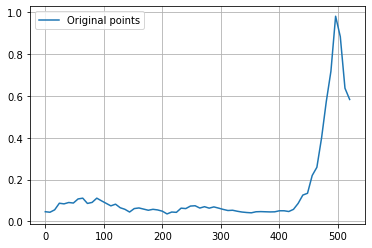

In [ ]:
INKP_x65 = INKP_x[0:522:8]
INKP_y65 = INKP_y[0:522:8]

plt.plot(INKP_x65, INKP_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INKP_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_INKP_65: [0.0465     0.04701905 0.0309619  0.09922381 0.07707737 0.0964667
 0.08005583 0.11130998 0.11970423 0.07737308 0.08680343 0.12141319
 0.09504381 0.08941159 0.06630984 0.09234904 0.05929399 0.06347498
 0.03480608 0.0673007  0.06499113 0.0597348  0.05006967 0.06098651
 0.05398431 0.05307627 0.02771061 0.0520813  0.03396419 0.07306195
 0.05478803 0.07678594 0.07906823 0.05694115 0.07716719 0.05739011
 0.07427239 0.06252034 0.05814626 0.04989463 0.05577522 0.04800449
 0.04470682 0.04316823 0.03912025 0.04785076 0.04697669 0.04624246
 0.04555346 0.04454371 0.0522717  0.05236948 0.04425037 0.05562903
 0.0797335  0.142936

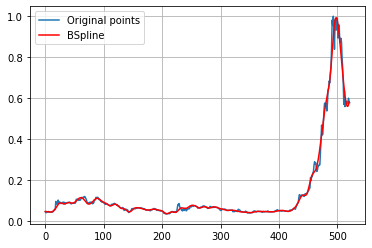

In [ ]:
import scipy.interpolate as interpolate

t_INKP_65, c_INKP_65, k_INKP_65 = interpolate.splrep(INKP_x65, INKP_y65, s=0, k=3)
print('''\
t_INKP_65: {}
c_INKP_65: {}
k_INKP_65: {}
'''.format(t_INKP_65, c_INKP_65, k_INKP_65))
N = 522
xmin_INKP_65, xmax_INKP_65 = INKP_x65.min(), INKP_x65.max()
xx_INKP_65 = np.linspace(xmin_INKP_65, xmax_INKP_65, N)
spline_INKP_65 = interpolate.BSpline(t_INKP_65, c_INKP_65, k_INKP_65, extrapolate=False)

plt.plot(INKP_x, INKP_y, label='Original points')
plt.plot(xx_INKP_65, spline_INKP_65(xx_INKP_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE INKP**

In [ ]:

#RMSE 15 DATA INKP
y_true_INKP_15 = INKP_y.tolist()
y_pred_INKP_15 = spline_INKP_15(xx_INKP_15).tolist()
mse_INKP_15 = mean_squared_error(y_true_INKP_15, y_pred_INKP_15)
rmse_INKP_15 = np.sqrt(mse_INKP_15)
print("rmse INKP 15 =",rmse_INKP_15)

#RMSE 25 DATA INKP
y_true_INKP_25 = INKP_y.tolist()
y_pred_INKP_25 = spline_INKP_25(xx_INKP_25).tolist()
mse_INKP_25 = mean_squared_error(y_true_INKP_25, y_pred_INKP_25)
rmse_INKP_25 = np.sqrt(mse_INKP_25)
print("rmse INKP 25 =",rmse_INKP_25)

#RMSE 35 DATA INKP
y_true_INKP_35 = INKP_y.tolist()
y_pred_INKP_35 = spline_INKP_35(xx_INKP_35).tolist()
mse_INKP_35 = mean_squared_error(y_true_INKP_35, y_pred_INKP_35)
rmse_INKP_35 = np.sqrt(mse_INKP_35)
print("rmse INKP 35 =",rmse_INKP_35)

#RMSE 45 DATA INKP
y_true_INKP_45 = INKP_y.tolist()
y_pred_INKP_45 = spline_INKP_45(xx_INKP_45).tolist()
mse_INKP_45 = mean_squared_error(y_true_INKP_45, y_pred_INKP_45)
rmse_INKP_45 = np.sqrt(mse_INKP_45)
print("rmse INKP 45 =",rmse_INKP_45)

#RMSE 55 DATA INKP
y_true_INKP_55 = INKP_y.tolist()
y_pred_INKP_55 = spline_INKP_55(xx_INKP_55).tolist()
mse_INKP_55 = mean_squared_error(y_true_INKP_55, y_pred_INKP_55)
rmse_INKP_55 = np.sqrt(mse_INKP_55)
print("rmse INKP 55 =",rmse_INKP_55)

#RMSE 65 DATA INKP
y_true_INKP_65 = INKP_y.tolist()
y_pred_INKP_65 = spline_INKP_65(xx_INKP_65).tolist()
mse_INKP_65 = mean_squared_error(y_true_INKP_65, y_pred_INKP_65)
rmse_INKP_65 = np.sqrt(mse_INKP_65)
print("rmse INKP 65 =",rmse_INKP_65)


rmse INKP 15 = 0.13659513237291102
rmse INKP 25 = 0.09543747533307655
rmse INKP 35 = 0.07017197802905731
rmse INKP 45 = 0.0379625620733041
rmse INKP 55 = 0.020345194092049986
rmse INKP 65 = 0.018803308124613383


# **INTP**

No handles with labels found to put in legend.


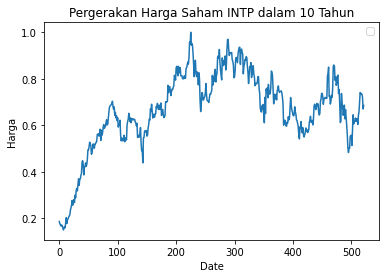

In [ ]:
INTP = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/INTP.JK.csv')

INTP_x = INTP['No'].values
INTP_y = INTP['Skala'].values

plt.plot(INTP_x,INTP_y)
plt.title('Pergerakan Harga Saham INTP dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA INTP**

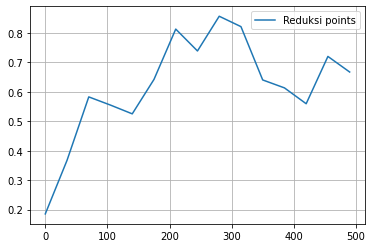

In [ ]:
INTP_x15 = INTP_x[0:522:35]
INTP_y15 = INTP_y[0:522:35]

plt.plot(INTP_x15, INTP_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INTP_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_INTP_15: [0.18552876 0.20237692 0.68058939 0.54590627 0.49784219 0.61300324
 0.90172184 0.65580513 0.90548435 0.85954876 0.58210912 0.65246004
 0.43196129 0.91713624 0.66697588 0.         0.         0.
 0.        ]
k_INTP_15: 3



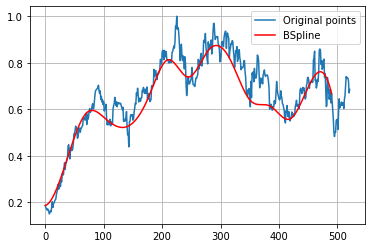

In [ ]:
import scipy.interpolate as interpolate

t_INTP_15, c_INTP_15, k_INTP_15 = interpolate.splrep(INTP_x15, INTP_y15, s=0, k=3)
print('''\
t_INTP_15: {}
c_INTP_15: {}
k_INTP_15: {}
'''.format(t_INTP_15, c_INTP_15, k_INTP_15))
N = 522
xmin_INTP_15, xmax_INTP_15 = INTP_x15.min(), INTP_x15.max()
xx_INTP_15 = np.linspace(xmin_INTP_15, xmax_INTP_15, N)
spline_INTP_15 = interpolate.BSpline(t_INTP_15, c_INTP_15, k_INTP_15, extrapolate=False)

plt.plot(INTP_x, INTP_y, label='Original points')
plt.plot(xx_INTP_15, spline_INTP_15(xx_INTP_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA INTP**

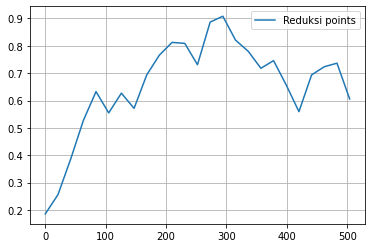

In [ ]:
INTP_x25 = INTP_x[0:522:21]
INTP_y25 = INTP_y[0:522:21]

plt.plot(INTP_x25, INTP_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INTP_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_INTP_25: [0.18552876 0.19728922 0.34382601 0.51889302 0.69824518 0.48404462
 0.69396222 0.50262969 0.72409046 0.76427377 0.81621704 0.8465538
 0.65100005 0.93534582 0.92858142 0.7993081  0.79997467 0.68168374
 0.78126808 0.66819754 0.48657256 0.74172742 0.69913492 0.79120248
 0.60575139 0.         0.         0.         0.        ]
k_INTP_25: 3



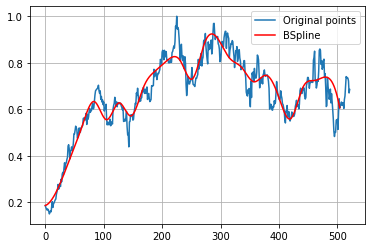

In [ ]:
import scipy.interpolate as interpolate

t_INTP_25, c_INTP_25, k_INTP_25 = interpolate.splrep(INTP_x25, INTP_y25, s=0, k=3)
print('''\
t_INTP_25: {}
c_INTP_25: {}
k_INTP_25: {}
'''.format(t_INTP_25, c_INTP_25, k_INTP_25))
N = 522
xmin_INTP_25, xmax_INTP_25 = INTP_x25.min(), INTP_x25.max()
xx_INTP_25 = np.linspace(xmin_INTP_25, xmax_INTP_25, N)
spline_INTP_25 = interpolate.BSpline(t_INTP_25, c_INTP_25, k_INTP_25, extrapolate=False)

plt.plot(INTP_x, INTP_y, label='Original points')
plt.plot(xx_INTP_25, spline_INTP_25(xx_INTP_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA INTP**

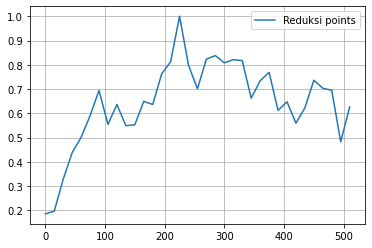

In [ ]:
INTP_x35 = INTP_x[0:522:15]
INTP_y35 = INTP_y[0:522:15]

plt.plot(INTP_x35, INTP_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INTP_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_INTP_35: [0.18552876 0.11524234 0.29919993 0.44807704 0.49835982 0.56404955
 0.78533068 0.45789306 0.71148299 0.51435678 0.52608059 0.69857502
 0.57572323 0.81671388 0.73256041 1.12874021 0.75247874 0.64798676
 0.86336642 0.84103363 0.79847308 0.81294049 0.87555348 0.58837064
 0.74498993 0.83426704 0.5320421  0.71103393 0.50879434 0.61000392
 0.78588386 0.66575565 0.80477144 0.23212263 0.62615955 0.
 0.         0.         0.        ]
k_INTP_35: 3



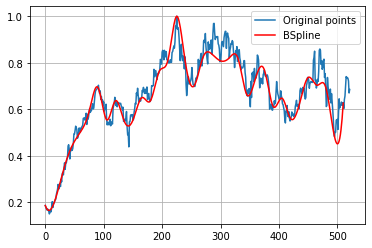

In [ ]:
import scipy.interpolate as interpolate

t_INTP_35, c_INTP_35, k_INTP_35 = interpolate.splrep(INTP_x35, INTP_y35, s=0, k=3)
print('''\
t_INTP_35: {}
c_INTP_35: {}
k_INTP_35: {}
'''.format(t_INTP_35, c_INTP_35, k_INTP_35))
N = 522
xmin_INTP_35, xmax_INTP_35 = INTP_x35.min(), INTP_x35.max()
xx_INTP_35 = np.linspace(xmin_INTP_35, xmax_INTP_35, N)
spline_INTP_35 = interpolate.BSpline(t_INTP_35, c_INTP_35, k_INTP_35, extrapolate=False)

plt.plot(INTP_x, INTP_y, label='Original points')
plt.plot(xx_INTP_35, spline_INTP_35(xx_INTP_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA INTP**

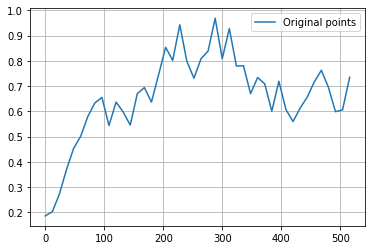

In [ ]:
INTP_x45 = INTP_x[0:522:12]
INTP_y45 = INTP_y[0:522:12]

plt.plot(INTP_x45, INTP_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INTP_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_INTP_45: [0.18552876 0.17292587 0.23392563 0.37066382 0.46444791 0.48768556
 0.59037573 0.62390987 0.70990316 0.46597655 0.68778617 0.60106059
 0.49238707 0.7021184  0.71769219 0.59037813 0.7389771  0.91753536
 0.71147516 1.04546937 0.76156386 0.6949171  0.84466755 0.77427914
 1.08975579 0.67745838 1.04827713 0.6952958  0.84586432 0.60213744
 0.7641388  0.74390476 0.51256128 0.80696331 0.57312909 0.54059453
 0.62070799 0.65004291 0.7141853  0.7900619  0.70070623 0.53435705
 0.61106823 0.73469388 0.         0.         0.         0.        ]
k_INTP_45: 3



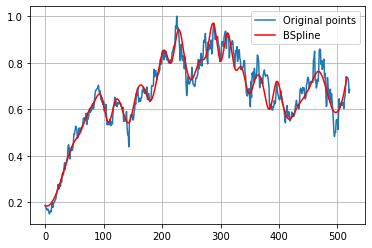

In [ ]:
import scipy.interpolate as interpolate

t_INTP_45, c_INTP_45, k_INTP_45 = interpolate.splrep(INTP_x45, INTP_y45, s=0, k=3)
print('''\
t_INTP_45: {}
c_INTP_45: {}
k_INTP_45: {}
'''.format(t_INTP_45, c_INTP_45, k_INTP_45))
N = 522
xmin_INTP_45, xmax_INTP_45 = INTP_x45.min(), INTP_x45.max()
xx_INTP_45 = np.linspace(xmin_INTP_45, xmax_INTP_45, N)
spline_INTP_45 = interpolate.BSpline(t_INTP_45, c_INTP_45, k_INTP_45, extrapolate=False)

plt.plot(INTP_x, INTP_y, label='Original points')
plt.plot(xx_INTP_45, spline_INTP_45(xx_INTP_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA INTP**

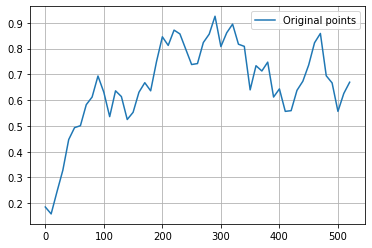

In [ ]:
INTP_x55 = INTP_x[0:522:10]
INTP_y55 = INTP_y[0:522:10]

plt.plot(INTP_x55, INTP_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_INTP_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_INTP_55: [0.18552876 0.09219841 0.23489818 0.31246411 0.46616928 0.50560459
 0.47245132 0.61015599 0.58228651 0.73416737 0.64430933 0.47338195
 0.67923153 0.62787374 0.49387463 0.54690603 0.63575543 0.69485889
 0.59223016 0.75440228 0.8873778  0.77215333 0.8997046  0.8609392
 0.79939575 0.72811974 0.71855201 0.85036239 0.82248453 0.99699077
 0.74428338 0.87374215 0.93143448 0.77157743 0.88578084 0.53873149
 0.79973846 0.66491207 0.82076168 0.53812657 0.70020143 0.52377641
 0.54421054 0.65559664 0.66271644 0.73435391 0.81916289 0.92591473
 0.63116704 0.71824826 0.42417752 0.73364408 0.66975881 0.
 0.         0.         0.        ]
k_INTP_55: 3



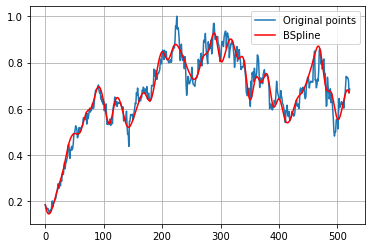

In [ ]:
import scipy.interpolate as interpolate

t_INTP_55, c_INTP_55, k_INTP_55 = interpolate.splrep(INTP_x55, INTP_y55, s=0, k=3)
print('''\
t_INTP_55: {}
c_INTP_55: {}
k_INTP_55: {}
'''.format(t_INTP_55, c_INTP_55, k_INTP_55))
N = 522
xmin_INTP_55, xmax_INTP_55 = INTP_x55.min(), INTP_x55.max()
xx_INTP_55 = np.linspace(xmin_INTP_55, xmax_INTP_55, N)
spline_INTP_55 = interpolate.BSpline(t_INTP_55, c_INTP_55, k_INTP_55, extrapolate=False)

plt.plot(INTP_x, INTP_y, label='Original points')
plt.plot(xx_INTP_55, spline_INTP_55(xx_INTP_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA INTP**

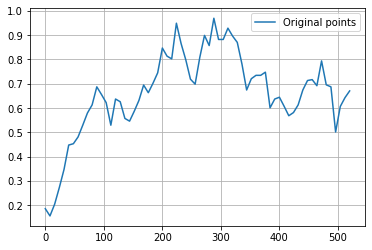

In [ ]:
INTP_x65 = INTP_x[0:522:8]
INTP_y65 = INTP_y[0:522:8]

plt.plot(INTP_x65, INTP_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_INTP_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_INTP_65: [0.18552876 0.1259165  0.17673842 0.27570869 0.33204788 0.47773243
 0.43976822 0.47933569 0.52600591 0.58918242 0.59036275 0.72283597
 0.63703178 0.658536   0.45795225 0.68219673 0.63144265 0.54342414
 0.53437841 0.5917895  0.61608882 0.72864185 0.63260907 0.71494784
 0.71539177 0.88730695 0.81144721 0.74259995 1.02705837 0.83747824
 0.81041271 0.70751287 0.66751357 0.80796163 0.94850635 0.78576809
 1.04571255 0.84214235 0.87328761 0.9522768  0.8834679  0.8849091
 0.79210904 0.62754528 0.73852617 0.73745949 0.71423329 0.80820477
 0.53346711 0.65903997 0.64855481 0.6094495  0.5537214  0.58197287
 0.60261718 0.681027

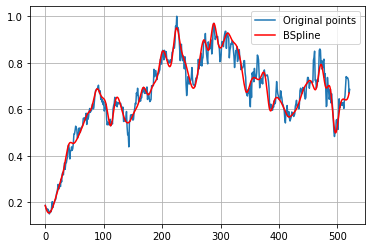

In [ ]:
import scipy.interpolate as interpolate

t_INTP_65, c_INTP_65, k_INTP_65 = interpolate.splrep(INTP_x65, INTP_y65, s=0, k=3)
print('''\
t_INTP_65: {}
c_INTP_65: {}
k_INTP_65: {}
'''.format(t_INTP_65, c_INTP_65, k_INTP_65))
N = 522
xmin_INTP_65, xmax_INTP_65 = INTP_x65.min(), INTP_x65.max()
xx_INTP_65 = np.linspace(xmin_INTP_65, xmax_INTP_65, N)
spline_INTP_65 = interpolate.BSpline(t_INTP_65, c_INTP_65, k_INTP_65, extrapolate=False)

plt.plot(INTP_x, INTP_y, label='Original points')
plt.plot(xx_INTP_65, spline_INTP_65(xx_INTP_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE INTP**

In [ ]:

#RMSE 15 DATA INTP
y_true_INTP_15 = INTP_y.tolist()
y_pred_INTP_15 = spline_INTP_15(xx_INTP_15).tolist()
mse_INTP_15 = mean_squared_error(y_true_INTP_15, y_pred_INTP_15)
rmse_INTP_15 = np.sqrt(mse_INTP_15)
print("rmse INTP 15 =",rmse_INTP_15)

#RMSE 25 DATA INTP
y_true_INTP_25 = INTP_y.tolist()
y_pred_INTP_25 = spline_INTP_25(xx_INTP_25).tolist()
mse_INTP_25 = mean_squared_error(y_true_INTP_25, y_pred_INTP_25)
rmse_INTP_25 = np.sqrt(mse_INTP_25)
print("rmse INTP 25 =",rmse_INTP_25)

#RMSE 35 DATA INTP
y_true_INTP_35 = INTP_y.tolist()
y_pred_INTP_35 = spline_INTP_35(xx_INTP_35).tolist()
mse_INTP_35 = mean_squared_error(y_true_INTP_35, y_pred_INTP_35)
rmse_INTP_35 = np.sqrt(mse_INTP_35)
print("rmse INTP 35 =",rmse_INTP_35)

#RMSE 45 DATA INTP
y_true_INTP_45 = INTP_y.tolist()
y_pred_INTP_45 = spline_INTP_45(xx_INTP_45).tolist()
mse_INTP_45 = mean_squared_error(y_true_INTP_45, y_pred_INTP_45)
rmse_INTP_45 = np.sqrt(mse_INTP_45)
print("rmse INTP 45 =",rmse_INTP_45)

#RMSE 55 DATA INTP
y_true_INTP_55 = INTP_y.tolist()
y_pred_INTP_55 = spline_INTP_55(xx_INTP_55).tolist()
mse_INTP_55 = mean_squared_error(y_true_INTP_55, y_pred_INTP_55)
rmse_INTP_55 = np.sqrt(mse_INTP_55)
print("rmse INTP 55 =",rmse_INTP_55)

#RMSE 65 DATA INTP
y_true_INTP_65 = INTP_y.tolist()
y_pred_INTP_65 = spline_INTP_65(xx_INTP_65).tolist()
mse_INTP_65 = mean_squared_error(y_true_INTP_65, y_pred_INTP_65)
rmse_INTP_65 = np.sqrt(mse_INTP_65)
print("rmse INTP 65 =",rmse_INTP_65)


rmse INTP 15 = 0.0809411168654221
rmse INTP 25 = 0.06416651813314195
rmse INTP 35 = 0.06654933180508288
rmse INTP 45 = 0.04374566532263687
rmse INTP 55 = 0.04072425500473293
rmse INTP 65 = 0.03481386553596699


# **ISAT**

No handles with labels found to put in legend.


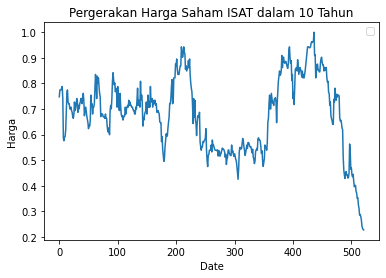

In [ ]:
ISAT = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/ISAT.JK.csv')

ISAT_x = ISAT['No'].values
ISAT_y = ISAT['Skala'].values

plt.plot(ISAT_x,ISAT_y)
plt.title('Pergerakan Harga Saham ISAT dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ISAT**

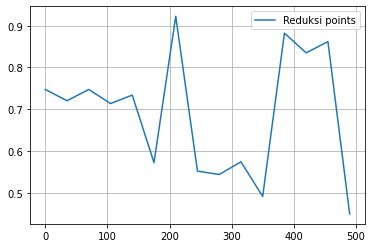

In [ ]:
ISAT_x15 = ISAT_x[0:522:35]
ISAT_y15 = ISAT_y[0:522:35]

plt.plot(ISAT_x15, ISAT_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ISAT_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ISAT_15: [0.74747475 0.65989892 0.81488229 0.66432079 0.84830323 0.3465067
 1.20001339 0.38879327 0.55794484 0.64407383 0.31222449 1.05652315
 0.65397521 1.075706   0.44983165 0.         0.         0.
 0.        ]
k_ISAT_15: 3



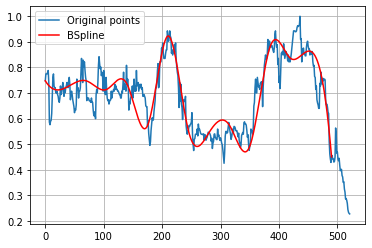

In [ ]:
import scipy.interpolate as interpolate

t_ISAT_15, c_ISAT_15, k_ISAT_15 = interpolate.splrep(ISAT_x15, ISAT_y15, s=0, k=3)
print('''\
t_ISAT_15: {}
c_ISAT_15: {}
k_ISAT_15: {}
'''.format(t_ISAT_15, c_ISAT_15, k_ISAT_15))
N = 522
xmin_ISAT_15, xmax_ISAT_15 = ISAT_x15.min(), ISAT_x15.max()
xx_ISAT_15 = np.linspace(xmin_ISAT_15, xmax_ISAT_15, N)
spline_ISAT_15 = interpolate.BSpline(t_ISAT_15, c_ISAT_15, k_ISAT_15, extrapolate=False)

plt.plot(ISAT_x, ISAT_y, label='Original points')
plt.plot(xx_ISAT_15, spline_ISAT_15(xx_ISAT_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ISAT**

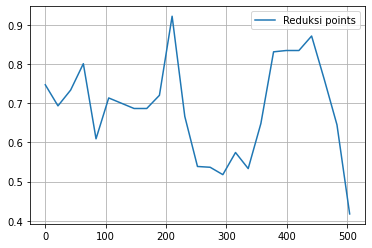

In [ ]:
ISAT_x25 = ISAT_x[0:522:21]
ISAT_y25 = ISAT_y[0:522:21]

plt.plot(ISAT_x25, ISAT_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ISAT_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ISAT_25: [0.74747475 0.69641016 0.64084972 0.90180062 0.49479089 0.77560149
 0.68563144 0.68389296 0.70000884 0.63728379 1.07408832 0.60171649
 0.51904575 0.55442377 0.48346121 0.6188021  0.48779504 0.63001772
 0.88304315 0.82770866 0.81622322 0.91749947 0.68896968 0.65113806
 0.41750842 0.         0.         0.         0.        ]
k_ISAT_25: 3



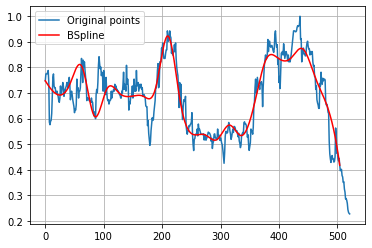

In [ ]:
import scipy.interpolate as interpolate

t_ISAT_25, c_ISAT_25, k_ISAT_25 = interpolate.splrep(ISAT_x25, ISAT_y25, s=0, k=3)
print('''\
t_ISAT_25: {}
c_ISAT_25: {}
k_ISAT_25: {}
'''.format(t_ISAT_25, c_ISAT_25, k_ISAT_25))
N = 522
xmin_ISAT_25, xmax_ISAT_25 = ISAT_x25.min(), ISAT_x25.max()
xx_ISAT_25 = np.linspace(xmin_ISAT_25, xmax_ISAT_25, N)
spline_ISAT_25 = interpolate.BSpline(t_ISAT_25, c_ISAT_25, k_ISAT_25, extrapolate=False)

plt.plot(ISAT_x, ISAT_y, label='Original points')
plt.plot(xx_ISAT_25, spline_ISAT_25(xx_ISAT_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA ISAT**

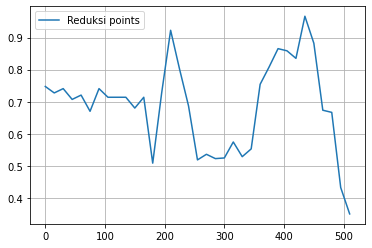

In [ ]:
ISAT_x35 = ISAT_x[0:522:15]
ISAT_y35 = ISAT_y[0:522:15]

plt.plot(ISAT_x35, ISAT_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ISAT_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ISAT_35: [0.74747475 0.68927859 0.78642599 0.68175271 0.75515573 0.62085668
 0.78161956 0.69710952 0.71277063 0.73463622 0.63151276 0.82012083
 0.37083222 0.74705535 1.00458273 0.76996727 0.723629   0.45672886
 0.56056668 0.51716603 0.50612275 0.60581772 0.51707101 0.4976154
 0.80963912 0.78908066 0.88252308 0.87274621 0.77800724 1.02532583
 0.91866924 0.59292651 0.80239617 0.20923963 0.35016835 0.
 0.         0.         0.        ]
k_ISAT_35: 3



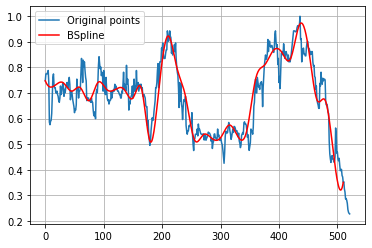

In [ ]:
import scipy.interpolate as interpolate

t_ISAT_35, c_ISAT_35, k_ISAT_35 = interpolate.splrep(ISAT_x35, ISAT_y35, s=0, k=3)
print('''\
t_ISAT_35: {}
c_ISAT_35: {}
k_ISAT_35: {}
'''.format(t_ISAT_35, c_ISAT_35, k_ISAT_35))
N = 522
xmin_ISAT_35, xmax_ISAT_35 = ISAT_x35.min(), ISAT_x35.max()
xx_ISAT_35 = np.linspace(xmin_ISAT_35, xmax_ISAT_35, N)
spline_ISAT_35 = interpolate.BSpline(t_ISAT_35, c_ISAT_35, k_ISAT_35, extrapolate=False)

plt.plot(ISAT_x, ISAT_y, label='Original points')
plt.plot(xx_ISAT_35, spline_ISAT_35(xx_ISAT_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA ISAT**

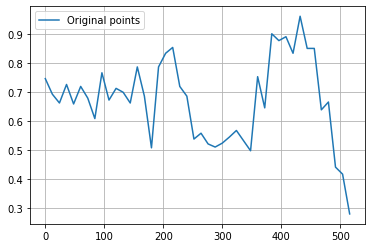

In [ ]:
ISAT_x45 = ISAT_x[0:522:12]
ISAT_y45 = ISAT_y[0:522:12]

plt.plot(ISAT_x45, ISAT_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ISAT_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ISAT_45: [0.74747475 0.7470837  0.57485618 0.78277746 0.60569002 0.75405843
 0.7013086  0.52151524 0.86919608 0.60776106 0.74016371 0.71441238
 0.60420697 0.84855772 0.72883486 0.35731494 0.89241043 0.80031608
 0.91642627 0.66529197 0.74563818 0.47336742 0.59321536 0.5073065
 0.50887177 0.5238731  0.5431106  0.57641177 0.56134333 0.37821491
 0.915696   0.48425359 1.0260775  0.82557783 0.94433847 0.75060364
 1.06334796 0.77378227 0.95263405 0.52679265 0.7785792  0.21899434
 0.54504829 0.28013468 0.         0.         0.         0.        ]
k_ISAT_45: 3



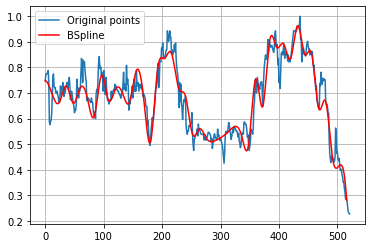

In [ ]:
import scipy.interpolate as interpolate

t_ISAT_45, c_ISAT_45, k_ISAT_45 = interpolate.splrep(ISAT_x45, ISAT_y45, s=0, k=3)
print('''\
t_ISAT_45: {}
c_ISAT_45: {}
k_ISAT_45: {}
'''.format(t_ISAT_45, c_ISAT_45, k_ISAT_45))
N = 522
xmin_ISAT_45, xmax_ISAT_45 = ISAT_x45.min(), ISAT_x45.max()
xx_ISAT_45 = np.linspace(xmin_ISAT_45, xmax_ISAT_45, N)
spline_ISAT_45 = interpolate.BSpline(t_ISAT_45, c_ISAT_45, k_ISAT_45, extrapolate=False)

plt.plot(ISAT_x, ISAT_y, label='Original points')
plt.plot(xx_ISAT_45, spline_ISAT_45(xx_ISAT_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA ISAT**

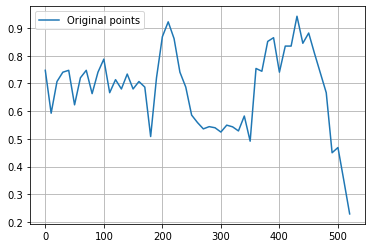

In [ ]:
ISAT_x55 = ISAT_x[0:522:10]
ISAT_y55 = ISAT_y[0:522:10]

plt.plot(ISAT_x55, ISAT_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ISAT_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ISAT_55: [0.74747475 0.4472945  0.74850864 0.72459955 0.80351489 0.54618939
 0.7491013  0.78063773 0.61319627 0.74637517 0.8457475  0.59790755
 0.76262228 0.6344316  0.7804594  0.6477712  0.70926387 0.75759756
 0.38155802 0.76667541 0.87497267 0.94555514 0.87816032 0.71352076
 0.71220109 0.558887   0.56740242 0.52503868 0.54860448 0.54518988
 0.51104006 0.55812465 0.55343104 0.48875724 0.66325717 0.35316356
 0.87358353 0.67775484 0.88004359 0.91318192 0.65914792 0.89467083
 0.77226977 1.02635111 0.77889144 0.92879018 0.79887712 0.72418618
 0.72862056 0.36133156 0.5796136  0.23611912 0.22895623 0.
 0.         0.         0.        ]
k_ISAT_55: 3



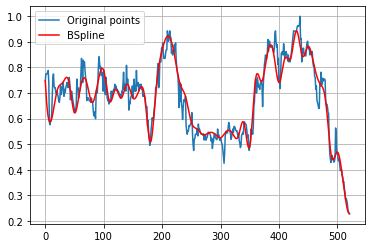

In [ ]:
import scipy.interpolate as interpolate

t_ISAT_55, c_ISAT_55, k_ISAT_55 = interpolate.splrep(ISAT_x55, ISAT_y55, s=0, k=3)
print('''\
t_ISAT_55: {}
c_ISAT_55: {}
k_ISAT_55: {}
'''.format(t_ISAT_55, c_ISAT_55, k_ISAT_55))
N = 522
xmin_ISAT_55, xmax_ISAT_55 = ISAT_x55.min(), ISAT_x55.max()
xx_ISAT_55 = np.linspace(xmin_ISAT_55, xmax_ISAT_55, N)
spline_ISAT_55 = interpolate.BSpline(t_ISAT_55, c_ISAT_55, k_ISAT_55, extrapolate=False)

plt.plot(ISAT_x, ISAT_y, label='Original points')
plt.plot(xx_ISAT_55, spline_ISAT_55(xx_ISAT_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA ISAT**

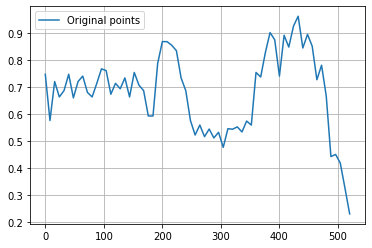

In [ ]:
ISAT_x65 = ISAT_x[0:522:8]
ISAT_y65 = ISAT_y[0:522:8]

plt.plot(ISAT_x65, ISAT_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ISAT_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ISAT_65: [0.74747475 0.36065742 0.84770872 0.62854915 0.67268255 0.80193277
 0.60443484 0.73992381 0.75910223 0.66811169 0.64925907 0.71465002
 0.77496915 0.79153398 0.62455151 0.75066403 0.65562064 0.78846956
 0.5945415  0.8131624  0.67806143 0.71701614 0.57508615 0.53819482
 0.82769014 0.87831735 0.87116166 0.84915723 0.86352257 0.70685351
 0.71310381 0.56194336 0.49366819 0.59469699 0.48107919 0.57593576
 0.47982423 0.57143398 0.42635903 0.57969554 0.52758607 0.57056622
 0.50328034 0.6163124  0.47389429 0.84164581 0.68477501 0.84349656
 0.91093571 0.92690201 0.63398149 0.98161647 0.79308798 0.9369407
 1.01470477 0.782018

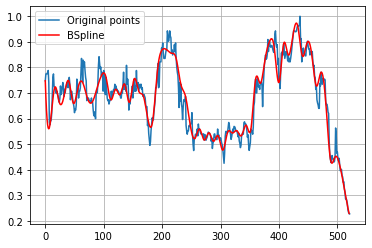

In [ ]:
import scipy.interpolate as interpolate

t_ISAT_65, c_ISAT_65, k_ISAT_65 = interpolate.splrep(ISAT_x65, ISAT_y65, s=0, k=3)
print('''\
t_ISAT_65: {}
c_ISAT_65: {}
k_ISAT_65: {}
'''.format(t_ISAT_65, c_ISAT_65, k_ISAT_65))
N = 522
xmin_ISAT_65, xmax_ISAT_65 = ISAT_x65.min(), ISAT_x65.max()
xx_ISAT_65 = np.linspace(xmin_ISAT_65, xmax_ISAT_65, N)
spline_ISAT_65 = interpolate.BSpline(t_ISAT_65, c_ISAT_65, k_ISAT_65, extrapolate=False)

plt.plot(ISAT_x, ISAT_y, label='Original points')
plt.plot(xx_ISAT_65, spline_ISAT_65(xx_ISAT_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ISAT**

In [ ]:

#RMSE 15 DATA ISAT
y_true_ISAT_15 = ISAT_y.tolist()
y_pred_ISAT_15 = spline_ISAT_15(xx_ISAT_15).tolist()
mse_ISAT_15 = mean_squared_error(y_true_ISAT_15, y_pred_ISAT_15)
rmse_ISAT_15 = np.sqrt(mse_ISAT_15)
print("rmse ISAT 15 =",rmse_ISAT_15)

#RMSE 25 DATA ISAT
y_true_ISAT_25 = ISAT_y.tolist()
y_pred_ISAT_25 = spline_ISAT_25(xx_ISAT_25).tolist()
mse_ISAT_25 = mean_squared_error(y_true_ISAT_25, y_pred_ISAT_25)
rmse_ISAT_25 = np.sqrt(mse_ISAT_25)
print("rmse ISAT 25 =",rmse_ISAT_25)

#RMSE 35 DATA ISAT
y_true_ISAT_35 = ISAT_y.tolist()
y_pred_ISAT_35 = spline_ISAT_35(xx_ISAT_35).tolist()
mse_ISAT_35 = mean_squared_error(y_true_ISAT_35, y_pred_ISAT_35)
rmse_ISAT_35 = np.sqrt(mse_ISAT_35)
print("rmse ISAT 35 =",rmse_ISAT_35)

#RMSE 45 DATA ISAT
y_true_ISAT_45 = ISAT_y.tolist()
y_pred_ISAT_45 = spline_ISAT_45(xx_ISAT_45).tolist()
mse_ISAT_45 = mean_squared_error(y_true_ISAT_45, y_pred_ISAT_45)
rmse_ISAT_45 = np.sqrt(mse_ISAT_45)
print("rmse ISAT 45 =",rmse_ISAT_45)

#RMSE 55 DATA ISAT
y_true_ISAT_55 = ISAT_y.tolist()
y_pred_ISAT_55 = spline_ISAT_55(xx_ISAT_55).tolist()
mse_ISAT_55 = mean_squared_error(y_true_ISAT_55, y_pred_ISAT_55)
rmse_ISAT_55 = np.sqrt(mse_ISAT_55)
print("rmse ISAT 55 =",rmse_ISAT_55)

#RMSE 65 DATA ISAT
y_true_ISAT_65 = ISAT_y.tolist()
y_pred_ISAT_65 = spline_ISAT_65(xx_ISAT_65).tolist()
mse_ISAT_65 = mean_squared_error(y_true_ISAT_65, y_pred_ISAT_65)
rmse_ISAT_65 = np.sqrt(mse_ISAT_65)
print("rmse ISAT 65 =",rmse_ISAT_65)

rmse ISAT 15 = 0.13538166678206728
rmse ISAT 25 = 0.08538779246421156
rmse ISAT 35 = 0.0694053170814905
rmse ISAT 45 = 0.057033217859976434
rmse ISAT 55 = 0.0434652468585226
rmse ISAT 65 = 0.041350974280938


# **ITMG**

No handles with labels found to put in legend.


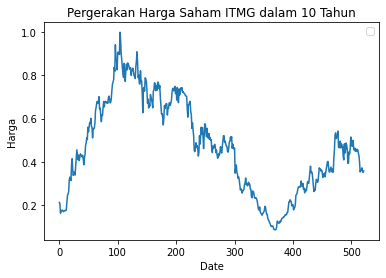

In [ ]:
ITMG = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/_ITMG.JK.csv')

ITMG_x = ITMG['No'].values
ITMG_y = ITMG['Skala'].values

plt.plot(ITMG_x,ITMG_y)
plt.title('Pergerakan Harga Saham ITMG dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA ITMG**

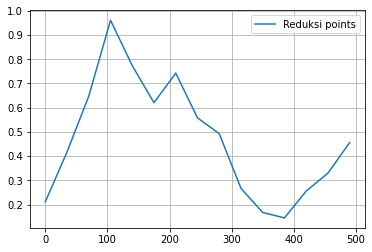

In [ ]:
ITMG_x15 = ITMG_x[0:522:35]
ITMG_y15 = ITMG_y[0:522:35]

plt.plot(ITMG_x15, ITMG_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ITMG_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_ITMG_15: [0.21126761 0.40927859 0.42087943 1.10577005 0.75242335 0.5271422
 0.8625994  0.48020667 0.56516548 0.21687789 0.17031592 0.10537957
 0.33421194 0.31429808 0.45598592 0.         0.         0.
 0.        ]
k_ITMG_15: 3



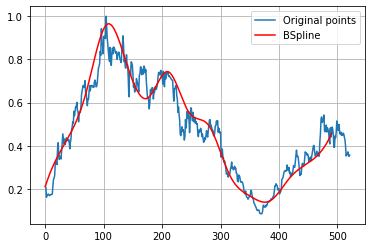

In [ ]:
import scipy.interpolate as interpolate

t_ITMG_15, c_ITMG_15, k_ITMG_15 = interpolate.splrep(ITMG_x15, ITMG_y15, s=0, k=3)
print('''\
t_ITMG_15: {}
c_ITMG_15: {}
k_ITMG_15: {}
'''.format(t_ITMG_15, c_ITMG_15, k_ITMG_15))
N = 522
xmin_ITMG_15, xmax_ITMG_15 = ITMG_x15.min(), ITMG_x15.max()
xx_ITMG_15 = np.linspace(xmin_ITMG_15, xmax_ITMG_15, N)
spline_ITMG_15 = interpolate.BSpline(t_ITMG_15, c_ITMG_15, k_ITMG_15, extrapolate=False)

plt.plot(ITMG_x, ITMG_y, label='Original points')
plt.plot(xx_ITMG_15, spline_ITMG_15(xx_ITMG_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA ITMG**

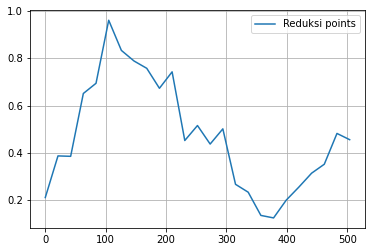

In [ ]:
ITMG_x25 = ITMG_x[0:522:21]
ITMG_y25 = ITMG_y[0:522:21]

plt.plot(ITMG_x25, ITMG_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ITMG_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_ITMG_25: [0.21126761 0.56351401 0.12385226 0.76243171 0.57522675 1.1039148
 0.77671969 0.790967   0.79180668 0.58934149 0.89132032 0.30312372
 0.61097354 0.34805255 0.62181627 0.17524577 0.28019363 0.10626844
 0.10811287 0.21128007 0.24835137 0.32964542 0.31495861 0.60528478
 0.45598592 0.         0.         0.         0.        ]
k_ITMG_25: 3



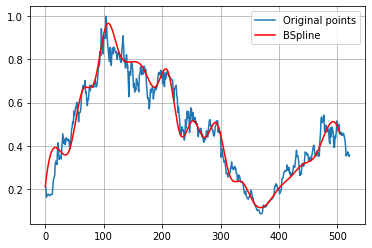

In [ ]:
import scipy.interpolate as interpolate

t_ITMG_25, c_ITMG_25, k_ITMG_25 = interpolate.splrep(ITMG_x25, ITMG_y25, s=0, k=3)
print('''\
t_ITMG_25: {}
c_ITMG_25: {}
k_ITMG_25: {}
'''.format(t_ITMG_25, c_ITMG_25, k_ITMG_25))
N = 522
xmin_ITMG_25, xmax_ITMG_25 = ITMG_x25.min(), ITMG_x25.max()
xx_ITMG_25 = np.linspace(xmin_ITMG_25, xmax_ITMG_25, N)
spline_ITMG_25 = interpolate.BSpline(t_ITMG_25, c_ITMG_25, k_ITMG_25, extrapolate=False)

plt.plot(ITMG_x, ITMG_y, label='Original points')
plt.plot(xx_ITMG_25, spline_ITMG_25(xx_ITMG_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA ITMG**

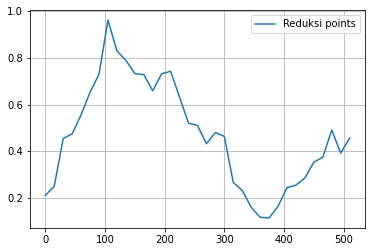

In [ ]:
ITMG_x35 = ITMG_x[0:522:15]
ITMG_y35 = ITMG_y[0:522:15]

plt.plot(ITMG_x35, ITMG_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ITMG_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_ITMG_35: [0.21126761 0.06590217 0.53853017 0.44579924 0.5535683  0.67795572
 0.65362291 1.08607375 0.76968772 0.81580919 0.7047516  0.76483232
 0.60915856 0.75451937 0.76713015 0.63470651 0.48629733 0.54686475
 0.38962397 0.49323093 0.52125512 0.20519928 0.26094073 0.14804485
 0.11342916 0.10598497 0.15453236 0.2662025  0.24896752 0.27225842
 0.38118895 0.3262252  0.6431386  0.22640605 0.45774648 0.
 0.         0.         0.        ]
k_ITMG_35: 3



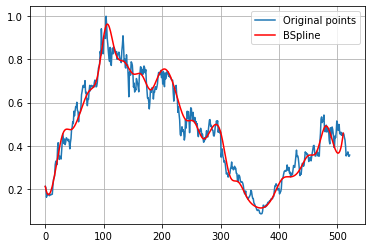

In [ ]:
import scipy.interpolate as interpolate

t_ITMG_35, c_ITMG_35, k_ITMG_35 = interpolate.splrep(ITMG_x35, ITMG_y35, s=0, k=3)
print('''\
t_ITMG_35: {}
c_ITMG_35: {}
k_ITMG_35: {}
'''.format(t_ITMG_35, c_ITMG_35, k_ITMG_35))
N = 522
xmin_ITMG_35, xmax_ITMG_35 = ITMG_x35.min(), ITMG_x35.max()
xx_ITMG_35 = np.linspace(xmin_ITMG_35, xmax_ITMG_35, N)
spline_ITMG_35 = interpolate.BSpline(t_ITMG_35, c_ITMG_35, k_ITMG_35, extrapolate=False)

plt.plot(ITMG_x, ITMG_y, label='Original points')
plt.plot(xx_ITMG_35, spline_ITMG_35(xx_ITMG_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA ITMG**

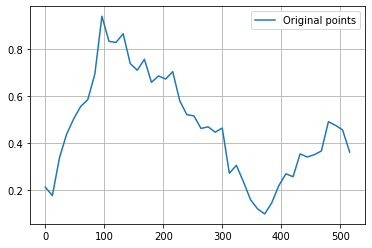

In [ ]:
ITMG_x45 = ITMG_x[0:522:12]
ITMG_y45 = ITMG_y[0:522:12]

plt.plot(ITMG_x45, ITMG_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ITMG_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_ITMG_45: [0.21126761 0.04738856 0.3321595  0.43940747 0.50311693 0.56396988
 0.57903173 0.63222715 1.0593132  0.78192848 0.82001512 0.91864483
 0.70787035 0.68649349 0.81376133 0.6059964  0.71823899 0.64076595
 0.75919016 0.5531072  0.50901484 0.53759399 0.4356796  0.49257491
 0.4091616  0.54859561 0.17990667 0.35589742 0.22396844 0.15051755
 0.11938389 0.07969337 0.14282856 0.21783043 0.29570886 0.2102496
 0.39762372 0.31985412 0.36433305 0.32228551 0.54106717 0.43381613
 0.48588683 0.36135563 0.         0.         0.         0.        ]
k_ITMG_45: 3



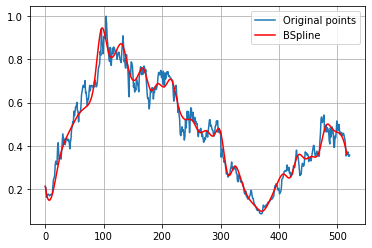

In [ ]:
import scipy.interpolate as interpolate

t_ITMG_45, c_ITMG_45, k_ITMG_45 = interpolate.splrep(ITMG_x45, ITMG_y45, s=0, k=3)
print('''\
t_ITMG_45: {}
c_ITMG_45: {}
k_ITMG_45: {}
'''.format(t_ITMG_45, c_ITMG_45, k_ITMG_45))
N = 522
xmin_ITMG_45, xmax_ITMG_45 = ITMG_x45.min(), ITMG_x45.max()
xx_ITMG_45 = np.linspace(xmin_ITMG_45, xmax_ITMG_45, N)
spline_ITMG_45 = interpolate.BSpline(t_ITMG_45, c_ITMG_45, k_ITMG_45, extrapolate=False)

plt.plot(ITMG_x, ITMG_y, label='Original points')
plt.plot(xx_ITMG_45, spline_ITMG_45(xx_ITMG_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA ITMG**

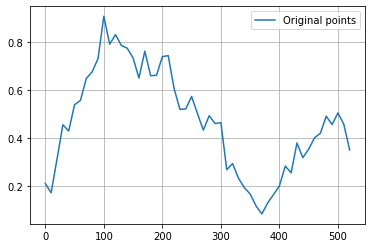

In [ ]:
ITMG_x55 = ITMG_x[0:522:10]
ITMG_y55 = ITMG_y[0:522:10]

plt.plot(ITMG_x55, ITMG_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_ITMG_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_ITMG_55: [0.21126761 0.096816   0.23462504 0.51418627 0.36937338 0.58578498
 0.51988104 0.67271901 0.67656686 0.67206989 1.01367472 0.71337208
 0.87579472 0.76408285 0.77914148 0.76195688 0.57267889 0.84521489
 0.61512354 0.65027688 0.75031823 0.77978823 0.58827534 0.50619493
 0.50314213 0.60799711 0.50324971 0.38956743 0.53707211 0.41989058
 0.54568949 0.18080216 0.34201737 0.21521287 0.19413819 0.17284704
 0.11799479 0.06292029 0.13736629 0.16930468 0.1757319  0.3346339
 0.18643671 0.45395025 0.27417074 0.35869779 0.41427753 0.39264278
 0.53451753 0.41647021 0.57519944 0.41420486 0.35035211 0.
 0.         0.         0.        ]
k_ITMG_55: 3



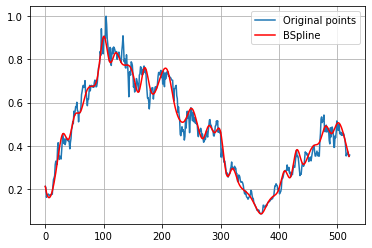

In [ ]:
import scipy.interpolate as interpolate

t_ITMG_55, c_ITMG_55, k_ITMG_55 = interpolate.splrep(ITMG_x55, ITMG_y55, s=0, k=3)
print('''\
t_ITMG_55: {}
c_ITMG_55: {}
k_ITMG_55: {}
'''.format(t_ITMG_55, c_ITMG_55, k_ITMG_55))
N = 522
xmin_ITMG_55, xmax_ITMG_55 = ITMG_x55.min(), ITMG_x55.max()
xx_ITMG_55 = np.linspace(xmin_ITMG_55, xmax_ITMG_55, N)
spline_ITMG_55 = interpolate.BSpline(t_ITMG_55, c_ITMG_55, k_ITMG_55, extrapolate=False)

plt.plot(ITMG_x, ITMG_y, label='Original points')
plt.plot(xx_ITMG_55, spline_ITMG_55(xx_ITMG_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA ITMG**

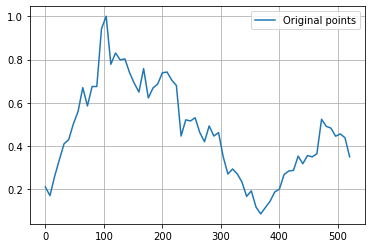

In [ ]:
ITMG_x65 = ITMG_x[0:522:8]
ITMG_y65 = ITMG_y[0:522:8]

plt.plot(ITMG_x65, ITMG_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_ITMG_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_ITMG_65: [0.21126761 0.09741493 0.25235323 0.32862977 0.43166418 0.40598113
 0.5218761  0.52235953 0.74784072 0.50564381 0.741908   0.57778051
 0.99802629 1.08152278 0.67588259 0.88396093 0.76890749 0.83090205
 0.72438569 0.70817489 0.58375982 0.85467315 0.5450828  0.6991506
 0.66711763 0.75209717 0.7558317  0.67704083 0.76663879 0.33386878
 0.57570297 0.4900799  0.55904786 0.45858781 0.37948822 0.54282549
 0.4069563  0.50716621 0.33726618 0.24324092 0.31388987 0.26528411
 0.25173426 0.13006758 0.23151654 0.10055641 0.07400428 0.1210321
 0.13640958 0.20216762 0.17991996 0.28501875 0.29092052 0.25992592
 0.39384762 0.2852822

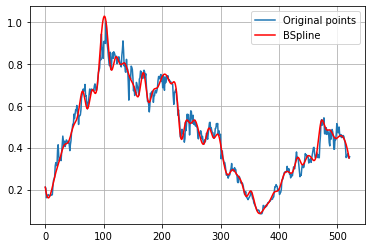

In [ ]:
import scipy.interpolate as interpolate

t_ITMG_65, c_ITMG_65, k_ITMG_65 = interpolate.splrep(ITMG_x65, ITMG_y65, s=0, k=3)
print('''\
t_ITMG_65: {}
c_ITMG_65: {}
k_ITMG_65: {}
'''.format(t_ITMG_65, c_ITMG_65, k_ITMG_65))
N = 522
xmin_ITMG_65, xmax_ITMG_65 = ITMG_x65.min(), ITMG_x65.max()
xx_ITMG_65 = np.linspace(xmin_ITMG_65, xmax_ITMG_65, N)
spline_ITMG_65 = interpolate.BSpline(t_ITMG_65, c_ITMG_65, k_ITMG_65, extrapolate=False)

plt.plot(ITMG_x, ITMG_y, label='Original points')
plt.plot(xx_ITMG_65, spline_ITMG_65(xx_ITMG_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE ITMG**

In [ ]:

#RMSE 15 DATA ITMG
y_true_ITMG_15 = ITMG_y.tolist()
y_pred_ITMG_15 = spline_ITMG_15(xx_ITMG_15).tolist()
mse_ITMG_15 = mean_squared_error(y_true_ITMG_15, y_pred_ITMG_15)
rmse_ITMG_15 = np.sqrt(mse_ITMG_15)
print("rmse ITMG 15 =",rmse_ITMG_15)

#RMSE 25 DATA ITMG
y_true_ITMG_25 = ITMG_y.tolist()
y_pred_ITMG_25 = spline_ITMG_25(xx_ITMG_25).tolist()
mse_ITMG_25 = mean_squared_error(y_true_ITMG_25, y_pred_ITMG_25)
rmse_ITMG_25 = np.sqrt(mse_ITMG_25)
print("rmse ITMG 25 =",rmse_ITMG_25)

#RMSE 35 DATA ITMG
y_true_ITMG_35 = ITMG_y.tolist()
y_pred_ITMG_35 = spline_ITMG_35(xx_ITMG_35).tolist()
mse_ITMG_35 = mean_squared_error(y_true_ITMG_35, y_pred_ITMG_35)
rmse_ITMG_35 = np.sqrt(mse_ITMG_35)
print("rmse ITMG 35 =",rmse_ITMG_35)

#RMSE 45 DATA ITMG
y_true_ITMG_45 = ITMG_y.tolist()
y_pred_ITMG_45 = spline_ITMG_45(xx_ITMG_45).tolist()
mse_ITMG_45 = mean_squared_error(y_true_ITMG_45, y_pred_ITMG_45)
rmse_ITMG_45 = np.sqrt(mse_ITMG_45)
print("rmse ITMG 45 =",rmse_ITMG_45)

#RMSE 55 DATA ITMG
y_true_ITMG_55 = ITMG_y.tolist()
y_pred_ITMG_55 = spline_ITMG_55(xx_ITMG_55).tolist()
mse_ITMG_55 = mean_squared_error(y_true_ITMG_55, y_pred_ITMG_55)
rmse_ITMG_55 = np.sqrt(mse_ITMG_55)
print("rmse ITMG 55 =",rmse_ITMG_55)

#RMSE 65 DATA ITMG
y_true_ITMG_65 = ITMG_y.tolist()
y_pred_ITMG_65 = spline_ITMG_65(xx_ITMG_65).tolist()
mse_ITMG_65 = mean_squared_error(y_true_ITMG_65, y_pred_ITMG_65)
rmse_ITMG_65 = np.sqrt(mse_ITMG_65)
print("rmse ITMG 65 =",rmse_ITMG_65)

rmse ITMG 15 = 0.09032033899718063
rmse ITMG 25 = 0.07301369725897053
rmse ITMG 35 = 0.05552825964020292
rmse ITMG 45 = 0.04623609155243794
rmse ITMG 55 = 0.03713193548961967
rmse ITMG 65 = 0.0337724462443731


# **JPFA**

No handles with labels found to put in legend.


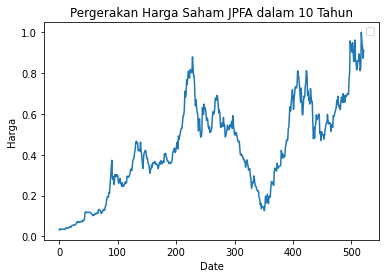

In [ ]:
JPFA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/JPFA.JK.csv')

JPFA_x = JPFA['No'].values
JPFA_y = JPFA['Skala'].values

plt.plot(JPFA_x,JPFA_y)
plt.title('Pergerakan Harga Saham JPFA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA JPFA**

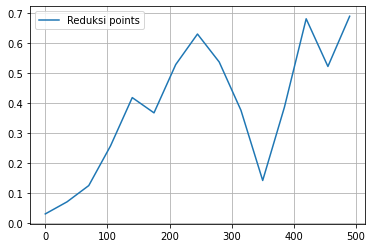

In [ ]:
JPFA_x15 = JPFA_x[0:522:35]
JPFA_y15 = JPFA_y[0:522:35]

plt.plot(JPFA_x15, JPFA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_JPFA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_JPFA_15: [0.03177966 0.06820522 0.07269973 0.23491227 0.49794551 0.29025483
 0.55289957 0.67611298 0.5307841  0.42956419 0.01367101 0.37507379
 0.95804873 0.22436546 0.69067797 0.         0.         0.
 0.        ]
k_JPFA_15: 3



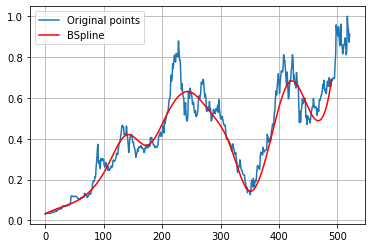

In [ ]:
import scipy.interpolate as interpolate

t_JPFA_15, c_JPFA_15, k_JPFA_15 = interpolate.splrep(JPFA_x15, JPFA_y15, s=0, k=3)
print('''\
t_JPFA_15: {}
c_JPFA_15: {}
k_JPFA_15: {}
'''.format(t_JPFA_15, c_JPFA_15, k_JPFA_15))
N = 522
xmin_JPFA_15, xmax_JPFA_15 = JPFA_x15.min(), JPFA_x15.max()
xx_JPFA_15 = np.linspace(xmin_JPFA_15, xmax_JPFA_15, N)
spline_JPFA_15 = interpolate.BSpline(t_JPFA_15, c_JPFA_15, k_JPFA_15, extrapolate=False)

plt.plot(JPFA_x, JPFA_y, label='Original points')
plt.plot(xx_JPFA_15, spline_JPFA_15(xx_JPFA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA JPFA**

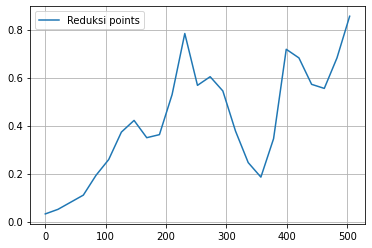

In [ ]:
JPFA_x25 = JPFA_x[0:522:21]
JPFA_y25 = JPFA_y[0:522:21]

plt.plot(JPFA_x25, JPFA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_JPFA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_JPFA_25: [0.03177966 0.03208214 0.08308148 0.09236225 0.20616629 0.23975226
 0.38567212 0.45484739 0.32459932 0.34421296 0.47227767 0.94464247
 0.4525423  0.651968   0.56246706 0.3651129  0.23979319 0.15029059
 0.27006139 0.84149776 0.67326962 0.55864411 0.51292841 0.75518834
 0.8559322  0.         0.         0.         0.        ]
k_JPFA_25: 3



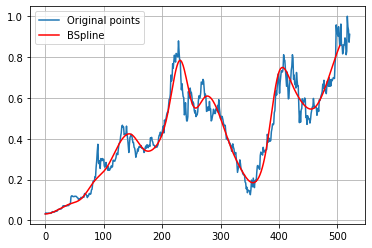

In [ ]:
import scipy.interpolate as interpolate

t_JPFA_25, c_JPFA_25, k_JPFA_25 = interpolate.splrep(JPFA_x25, JPFA_y25, s=0, k=3)
print('''\
t_JPFA_25: {}
c_JPFA_25: {}
k_JPFA_25: {}
'''.format(t_JPFA_25, c_JPFA_25, k_JPFA_25))
N = 522
xmin_JPFA_25, xmax_JPFA_25 = JPFA_x25.min(), JPFA_x25.max()
xx_JPFA_25 = np.linspace(xmin_JPFA_25, xmax_JPFA_25, N)
spline_JPFA_25 = interpolate.BSpline(t_JPFA_25, c_JPFA_25, k_JPFA_25, extrapolate=False)

plt.plot(JPFA_x, JPFA_y, label='Original points')
plt.plot(xx_JPFA_25, spline_JPFA_25(xx_JPFA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA JPFA**

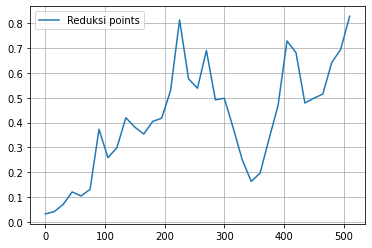

In [ ]:
JPFA_x35 = JPFA_x[0:522:15]
JPFA_y35 = JPFA_y[0:522:15]

plt.plot(JPFA_x35, JPFA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JPFA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_JPFA_35: [0.03177966 0.03837452 0.03659842 0.13722808 0.11136574 0.04273267
 0.50075443 0.19153775 0.28394203 0.46506703 0.372739   0.33211255
 0.42169214 0.40908498 0.44620522 0.98406024 0.49890977 0.47792782
 0.81819253 0.39336986 0.55748059 0.36399592 0.24924758 0.13901374
 0.17096864 0.35677273 0.41041503 0.8108892  0.71890954 0.40669299
 0.52719987 0.47179566 0.74220214 0.65114469 0.82838983 0.
 0.         0.         0.        ]
k_JPFA_35: 3



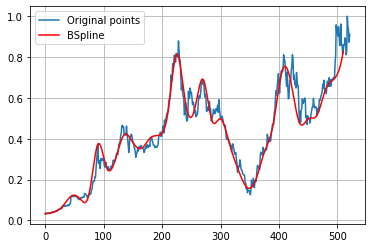

In [ ]:
import scipy.interpolate as interpolate

t_JPFA_35, c_JPFA_35, k_JPFA_35 = interpolate.splrep(JPFA_x35, JPFA_y35, s=0, k=3)
print('''\
t_JPFA_35: {}
c_JPFA_35: {}
k_JPFA_35: {}
'''.format(t_JPFA_35, c_JPFA_35, k_JPFA_35))
N = 522
xmin_JPFA_35, xmax_JPFA_35 = JPFA_x35.min(), JPFA_x35.max()
xx_JPFA_35 = np.linspace(xmin_JPFA_35, xmax_JPFA_35, N)
spline_JPFA_35 = interpolate.BSpline(t_JPFA_35, c_JPFA_35, k_JPFA_35, extrapolate=False)

plt.plot(JPFA_x, JPFA_y, label='Original points')
plt.plot(xx_JPFA_35, spline_JPFA_35(xx_JPFA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA JPFA**

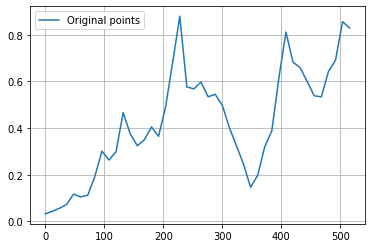

In [ ]:
JPFA_x45 = JPFA_x[0:522:12]
JPFA_y45 = JPFA_y[0:522:12]

plt.plot(JPFA_x45, JPFA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JPFA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_JPFA_45: [0.03177966 0.03556128 0.05790287 0.05943807 0.13616445 0.09759903
 0.09886314 0.17813485 0.34537713 0.24544138 0.24912852 0.55041741
 0.345812   0.31633457 0.33376496 0.44606323 0.30994823 0.50058452
 0.63686623 1.04517089 0.45787394 0.58096046 0.62506388 0.50352979
 0.56420678 0.50659225 0.39671237 0.3218125  0.26095287 0.10895228
 0.18035667 0.34928207 0.34200659 0.60896274 0.90858312 0.62534886
 0.68324177 0.59507388 0.53392034 0.49805831 0.67723624 0.63384345
 1.01517573 0.82838983 0.         0.         0.         0.        ]
k_JPFA_45: 3



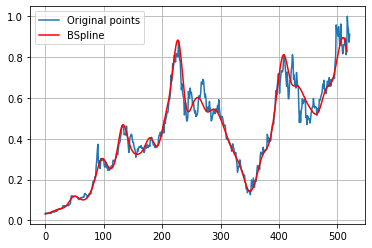

In [ ]:
import scipy.interpolate as interpolate

t_JPFA_45, c_JPFA_45, k_JPFA_45 = interpolate.splrep(JPFA_x45, JPFA_y45, s=0, k=3)
print('''\
t_JPFA_45: {}
c_JPFA_45: {}
k_JPFA_45: {}
'''.format(t_JPFA_45, c_JPFA_45, k_JPFA_45))
N = 522
xmin_JPFA_45, xmax_JPFA_45 = JPFA_x45.min(), JPFA_x45.max()
xx_JPFA_45 = np.linspace(xmin_JPFA_45, xmax_JPFA_45, N)
spline_JPFA_45 = interpolate.BSpline(t_JPFA_45, c_JPFA_45, k_JPFA_45, extrapolate=False)

plt.plot(JPFA_x, JPFA_y, label='Original points')
plt.plot(xx_JPFA_45, spline_JPFA_45(xx_JPFA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA JPFA**

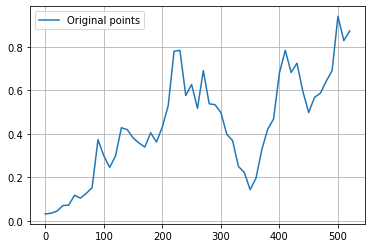

In [ ]:
JPFA_x55 = JPFA_x[0:522:10]
JPFA_y55 = JPFA_y[0:522:10]

plt.plot(JPFA_x55, JPFA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JPFA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_JPFA_55: [0.03177966 0.03868525 0.02326509 0.08307553 0.05151408 0.14307154
 0.08297942 0.1504345  0.07290968 0.47318101 0.27165442 0.2325742
 0.27262505 0.46929849 0.4179776  0.37574026 0.36719696 0.30377699
 0.45159339 0.31781555 0.45087322 0.4719119  0.83944529 0.84827303
 0.47085243 0.72594438 0.38808193 0.8234228  0.46229465 0.55621216
 0.51624655 0.36608979 0.40922479 0.20887547 0.25527335 0.10477689
 0.18494113 0.33511962 0.44491939 0.41486382 0.70494736 0.8458552
 0.61502166 0.7872785  0.58332195 0.45146759 0.59809582 0.56292878
 0.67137552 0.60326408 1.21175992 0.59750987 0.87288136 0.
 0.         0.         0.        ]
k_JPFA_55: 3



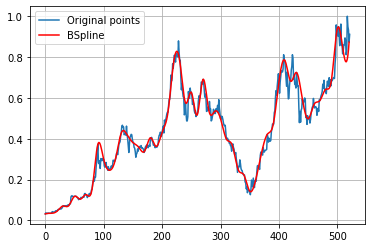

In [ ]:
import scipy.interpolate as interpolate

t_JPFA_55, c_JPFA_55, k_JPFA_55 = interpolate.splrep(JPFA_x55, JPFA_y55, s=0, k=3)
print('''\
t_JPFA_55: {}
c_JPFA_55: {}
k_JPFA_55: {}
'''.format(t_JPFA_55, c_JPFA_55, k_JPFA_55))
N = 522
xmin_JPFA_55, xmax_JPFA_55 = JPFA_x55.min(), JPFA_x55.max()
xx_JPFA_55 = np.linspace(xmin_JPFA_55, xmax_JPFA_55, N)
spline_JPFA_55 = interpolate.BSpline(t_JPFA_55, c_JPFA_55, k_JPFA_55, extrapolate=False)

plt.plot(JPFA_x, JPFA_y, label='Original points')
plt.plot(xx_JPFA_55, spline_JPFA_55(xx_JPFA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA JPFA**

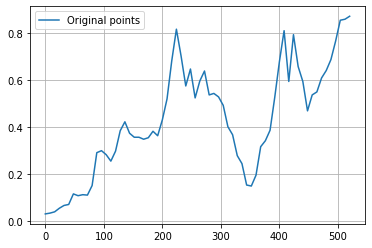

In [ ]:
JPFA_x65 = JPFA_x[0:522:8]
JPFA_y65 = JPFA_y[0:522:8]

plt.plot(JPFA_x65, JPFA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JPFA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_JPFA_65: [0.03177966 0.03596384 0.03252147 0.0558435  0.07386725 0.05546715
 0.13646753 0.10035764 0.1180341  0.10886187 0.11770485 0.33557296
 0.29424059 0.29254944 0.23895148 0.28978023 0.39430049 0.44657714
 0.36176384 0.3563675  0.36107125 0.34765257 0.34577609 0.40483627
 0.33572628 0.43869927 0.50269697 0.6776315  0.87999736 0.70915871
 0.50370677 0.73364131 0.45155849 0.61266712 0.6825188  0.49624072
 0.56133186 0.52538098 0.51511031 0.37604217 0.39597524 0.25192128
 0.27430574 0.12543205 0.15193217 0.16938164 0.35020228 0.33658888
 0.36276421 0.53862545 0.64798824 0.94993006 0.42093557 0.93836154
 0.59256741 0.64475

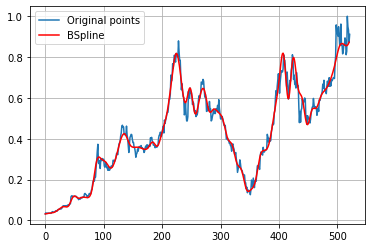

In [ ]:
import scipy.interpolate as interpolate

t_JPFA_65, c_JPFA_65, k_JPFA_65 = interpolate.splrep(JPFA_x65, JPFA_y65, s=0, k=3)
print('''\
t_JPFA_65: {}
c_JPFA_65: {}
k_JPFA_65: {}
'''.format(t_JPFA_65, c_JPFA_65, k_JPFA_65))
N = 522
xmin_JPFA_65, xmax_JPFA_65 = JPFA_x65.min(), JPFA_x65.max()
xx_JPFA_65 = np.linspace(xmin_JPFA_65, xmax_JPFA_65, N)
spline_JPFA_65 = interpolate.BSpline(t_JPFA_65, c_JPFA_65, k_JPFA_65, extrapolate=False)

plt.plot(JPFA_x, JPFA_y, label='Original points')
plt.plot(xx_JPFA_65, spline_JPFA_65(xx_JPFA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE JPFA**

In [ ]:

#RMSE 15 DATA JPFA
y_true_JPFA_15 = JPFA_y.tolist()
y_pred_JPFA_15 = spline_JPFA_15(xx_JPFA_15).tolist()
mse_JPFA_15 = mean_squared_error(y_true_JPFA_15, y_pred_JPFA_15)
rmse_JPFA_15 = np.sqrt(mse_JPFA_15)
print("rmse JPFA 15 =",rmse_JPFA_15)

#RMSE 25 DATA JPFA
y_true_JPFA_25 = JPFA_y.tolist()
y_pred_JPFA_25 = spline_JPFA_25(xx_JPFA_25).tolist()
mse_JPFA_25 = mean_squared_error(y_true_JPFA_25, y_pred_JPFA_25)
rmse_JPFA_25 = np.sqrt(mse_JPFA_25)
print("rmse JPFA 25 =",rmse_JPFA_25)

#RMSE 35 DATA JPFA
y_true_JPFA_35 = JPFA_y.tolist()
y_pred_JPFA_35 = spline_JPFA_35(xx_JPFA_35).tolist()
mse_JPFA_35 = mean_squared_error(y_true_JPFA_35, y_pred_JPFA_35)
rmse_JPFA_35 = np.sqrt(mse_JPFA_35)
print("rmse JPFA 35 =",rmse_JPFA_35)

#RMSE 45 DATA JPFA
y_true_JPFA_45 = JPFA_y.tolist()
y_pred_JPFA_45 = spline_JPFA_45(xx_JPFA_45).tolist()
mse_JPFA_45 = mean_squared_error(y_true_JPFA_45, y_pred_JPFA_45)
rmse_JPFA_45 = np.sqrt(mse_JPFA_45)
print("rmse JPFA 45 =",rmse_JPFA_45)

#RMSE 55 DATA JPFA
y_true_JPFA_55 = JPFA_y.tolist()
y_pred_JPFA_55 = spline_JPFA_55(xx_JPFA_55).tolist()
mse_JPFA_55 = mean_squared_error(y_true_JPFA_55, y_pred_JPFA_55)
rmse_JPFA_55 = np.sqrt(mse_JPFA_55)
print("rmse JPFA 55 =",rmse_JPFA_55)

#RMSE 65 DATA JPFA
y_true_JPFA_65 = JPFA_y.tolist()
y_pred_JPFA_65 = spline_JPFA_65(xx_JPFA_65).tolist()
mse_JPFA_65 = mean_squared_error(y_true_JPFA_65, y_pred_JPFA_65)
rmse_JPFA_65 = np.sqrt(mse_JPFA_65)
print("rmse JPFA 65 =",rmse_JPFA_65)

rmse JPFA 15 = 0.148267839643154
rmse JPFA 25 = 0.08919076838868559
rmse JPFA 35 = 0.07632981410293045
rmse JPFA 45 = 0.055043005640204604
rmse JPFA 55 = 0.03941408212263991
rmse JPFA 65 = 0.033685485744211735


# **JSMR**

No handles with labels found to put in legend.


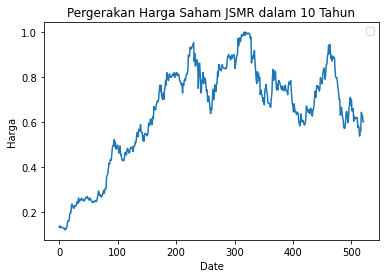

In [ ]:
JSMR = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/JSMR.JK.csv')

JSMR_x = JSMR['No'].values
JSMR_y = JSMR['Skala'].values

plt.plot(JSMR_x,JSMR_y)
plt.title('Pergerakan Harga Saham JSMR dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA JSMR**

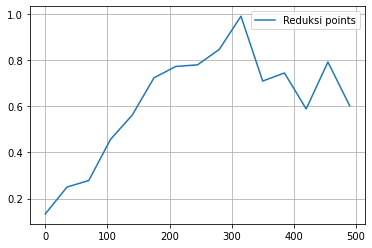

In [ ]:
JSMR_x15 = JSMR_x[0:522:35]
JSMR_y15 = JSMR_y[0:522:35]

plt.plot(JSMR_x15, JSMR_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JSMR_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_JSMR_15: [0.13333334 0.32815566 0.13737283 0.49534297 0.52860875 0.75864072
 0.77367461 0.77824187 0.78704142 1.14727609 0.56070007 0.86255621
 0.31546453 1.12737608 0.60210878 0.         0.         0.
 0.        ]
k_JSMR_15: 3



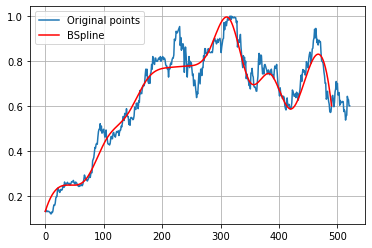

In [ ]:
import scipy.interpolate as interpolate

t_JSMR_15, c_JSMR_15, k_JSMR_15 = interpolate.splrep(JSMR_x15, JSMR_y15, s=0, k=3)
print('''\
t_JSMR_15: {}
c_JSMR_15: {}
k_JSMR_15: {}
'''.format(t_JSMR_15, c_JSMR_15, k_JSMR_15))
N = 522
xmin_JSMR_15, xmax_JSMR_15 = JSMR_x15.min(), JSMR_x15.max()
xx_JSMR_15 = np.linspace(xmin_JSMR_15, xmax_JSMR_15, N)
spline_JSMR_15 = interpolate.BSpline(t_JSMR_15, c_JSMR_15, k_JSMR_15, extrapolate=False)

plt.plot(JSMR_x, JSMR_y, label='Original points')
plt.plot(xx_JSMR_15, spline_JSMR_15(xx_JSMR_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA JSMR**

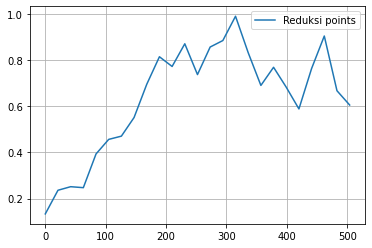

In [ ]:
JSMR_x25 = JSMR_x[0:522:21]
JSMR_y25 = JSMR_y[0:522:21]

plt.plot(JSMR_x25, JSMR_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JSMR_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_JSMR_25: [0.13333334 0.23207387 0.2867269  0.19844929 0.42365298 0.46483612
 0.45384855 0.54082089 0.68813286 0.87506659 0.69581449 0.97325645
 0.63221075 0.91895179 0.82882814 1.07100033 0.82401638 0.62241277
 0.82528459 0.68697866 0.51942993 0.76354653 1.08615865 0.41336625
 0.60492237 0.         0.         0.         0.        ]
k_JSMR_25: 3



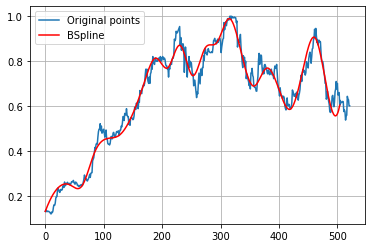

In [ ]:
import scipy.interpolate as interpolate

t_JSMR_25, c_JSMR_25, k_JSMR_25 = interpolate.splrep(JSMR_x25, JSMR_y25, s=0, k=3)
print('''\
t_JSMR_25: {}
c_JSMR_25: {}
k_JSMR_25: {}
'''.format(t_JSMR_25, c_JSMR_25, k_JSMR_25))
N = 522
xmin_JSMR_25, xmax_JSMR_25 = JSMR_x25.min(), JSMR_x25.max()
xx_JSMR_25 = np.linspace(xmin_JSMR_25, xmax_JSMR_25, N)
spline_JSMR_25 = interpolate.BSpline(t_JSMR_25, c_JSMR_25, k_JSMR_25, extrapolate=False)

plt.plot(JSMR_x, JSMR_y, label='Original points')
plt.plot(xx_JSMR_25, spline_JSMR_25(xx_JSMR_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA JSMR**

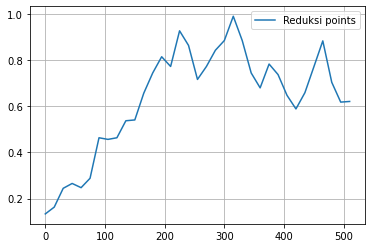

In [ ]:
JSMR_x35 = JSMR_x[0:522:15]
JSMR_y35 = JSMR_y[0:522:15]

plt.plot(JSMR_x35, JSMR_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JSMR_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_JSMR_35: [0.13333334 0.10349729 0.25546225 0.27236044 0.24244749 0.23995724
 0.52403973 0.44283254 0.44147609 0.57021179 0.49872804 0.67697859
 0.73020373 0.86536888 0.6925345  0.99607416 0.88106627 0.65860928
 0.77923168 0.85604503 0.8492206  1.05233725 0.87827626 0.7398224
 0.62559652 0.83358115 0.73481405 0.64821386 0.55443808 0.66227871
 0.74673086 0.9721234  0.55777655 0.62532999 0.62039713 0.
 0.         0.         0.        ]
k_JSMR_35: 3



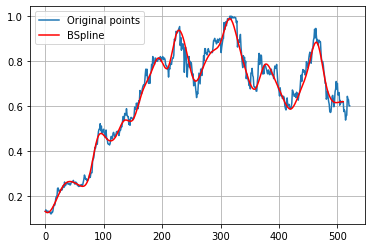

In [ ]:
import scipy.interpolate as interpolate

t_JSMR_35, c_JSMR_35, k_JSMR_35 = interpolate.splrep(JSMR_x35, JSMR_y35, s=0, k=3)
print('''\
t_JSMR_35: {}
c_JSMR_35: {}
k_JSMR_35: {}
'''.format(t_JSMR_35, c_JSMR_35, k_JSMR_35))
N = 522
xmin_JSMR_35, xmax_JSMR_35 = JSMR_x35.min(), JSMR_x35.max()
xx_JSMR_35 = np.linspace(xmin_JSMR_35, xmax_JSMR_35, N)
spline_JSMR_35 = interpolate.BSpline(t_JSMR_35, c_JSMR_35, k_JSMR_35, extrapolate=False)

plt.plot(JSMR_x, JSMR_y, label='Original points')
plt.plot(xx_JSMR_35, spline_JSMR_35(xx_JSMR_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA JSMR**

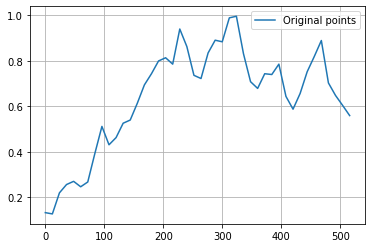

In [ ]:
JSMR_x45 = JSMR_x[0:522:12]
JSMR_y45 = JSMR_y[0:522:12]

plt.plot(JSMR_x45, JSMR_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_JSMR_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_JSMR_45: [0.13333334 0.05013598 0.23376351 0.25473427 0.28310628 0.23810383
 0.24658604 0.38397591 0.57540764 0.38807723 0.46176205 0.54382328
 0.52084217 0.61491058 0.70372889 0.73859276 0.80506244 0.84115756
 0.71452104 1.01655294 0.86137824 0.71688265 0.69214238 0.85139404
 0.91281134 0.8447282  1.01354054 1.03795549 0.81358626 0.69717812
 0.65033383 0.77727619 0.70372379 0.84993113 0.61234637 0.56595147
 0.65209264 0.76752097 0.79363933 0.97467449 0.64645434 0.6643776
 0.57554646 0.55990489 0.         0.         0.         0.        ]
k_JSMR_45: 3



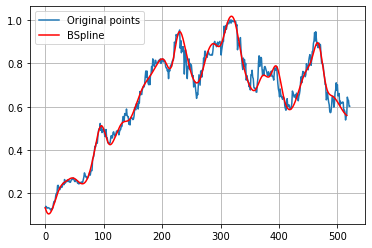

In [ ]:
import scipy.interpolate as interpolate

t_JSMR_45, c_JSMR_45, k_JSMR_45 = interpolate.splrep(JSMR_x45, JSMR_y45, s=0, k=3)
print('''\
t_JSMR_45: {}
c_JSMR_45: {}
k_JSMR_45: {}
'''.format(t_JSMR_45, c_JSMR_45, k_JSMR_45))
N = 522
xmin_JSMR_45, xmax_JSMR_45 = JSMR_x45.min(), JSMR_x45.max()
xx_JSMR_45 = np.linspace(xmin_JSMR_45, xmax_JSMR_45, N)
spline_JSMR_45 = interpolate.BSpline(t_JSMR_45, c_JSMR_45, k_JSMR_45, extrapolate=False)

plt.plot(JSMR_x, JSMR_y, label='Original points')
plt.plot(xx_JSMR_45, spline_JSMR_45(xx_JSMR_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA JSMR**


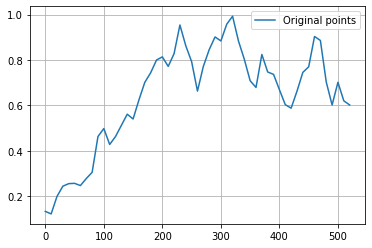

In [ ]:
JSMR_x55 = JSMR_x[0:522:10]
JSMR_y55 = JSMR_y[0:522:10]

plt.plot(JSMR_x55, JSMR_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_JSMR_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_JSMR_55: [0.13333334 0.06307409 0.19595722 0.25027398 0.25462756 0.26384992
 0.23102232 0.29416847 0.25966963 0.49873409 0.5243427  0.39337359
 0.47058184 0.50324776 0.59011082 0.50472765 0.63308112 0.71031543
 0.73618683 0.80809964 0.83141471 0.75045524 0.79834536 1.02458207
 0.82964242 0.8357968  0.58506757 0.80288155 0.83498725 0.93085307
 0.85213047 0.96588973 1.0316779  0.86529618 0.81240205 0.70614695
 0.61564274 0.90707171 0.70343789 0.76339034 0.66405196 0.59724121
 0.56803462 0.65886523 0.77211056 0.72630447 0.9439971  0.92090653
 0.69006648 0.53921621 0.8412231  0.49415769 0.60210878 0.
 0.         0.         0.        ]
k_JSMR_55: 3



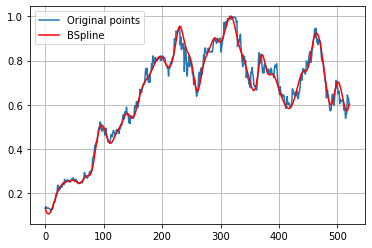

In [ ]:
import scipy.interpolate as interpolate

t_JSMR_55, c_JSMR_55, k_JSMR_55 = interpolate.splrep(JSMR_x55, JSMR_y55, s=0, k=3)
print('''\
t_JSMR_55: {}
c_JSMR_55: {}
k_JSMR_55: {}
'''.format(t_JSMR_55, c_JSMR_55, k_JSMR_55))
N = 522
xmin_JSMR_55, xmax_JSMR_55 = JSMR_x55.min(), JSMR_x55.max()
xx_JSMR_55 = np.linspace(xmin_JSMR_55, xmax_JSMR_55, N)
spline_JSMR_55 = interpolate.BSpline(t_JSMR_55, c_JSMR_55, k_JSMR_55, extrapolate=False)

plt.plot(JSMR_x, JSMR_y, label='Original points')
plt.plot(xx_JSMR_55, spline_JSMR_55(xx_JSMR_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA JSMR**

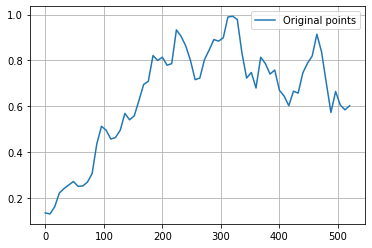

In [ ]:
JSMR_x65 = JSMR_x[0:522:8]
JSMR_y65 = JSMR_y[0:522:8]

plt.plot(JSMR_x65, JSMR_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_JSMR_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_JSMR_65: [0.13333334 0.12318529 0.12345361 0.23318388 0.23848253 0.2528826
 0.28262122 0.24189575 0.24874276 0.27050404 0.27766497 0.45041715
 0.53119629 0.49848141 0.44329689 0.46517704 0.47494365 0.60346715
 0.52171759 0.55176504 0.61858972 0.72124365 0.66485459 0.87197057
 0.77357937 0.83371202 0.77578627 0.73682641 0.99270277 0.8923624
 0.86942887 0.80887066 0.69508857 0.70551012 0.81971717 0.83667254
 0.9072763  0.88158985 0.87162899 1.02137252 0.97972677 1.01761789
 0.82348552 0.67791867 0.80168604 0.59955081 0.87590036 0.78106148
 0.7156484  0.79844738 0.63792946 0.66667416 0.56064199 0.70341055
 0.61820345 0.7656186

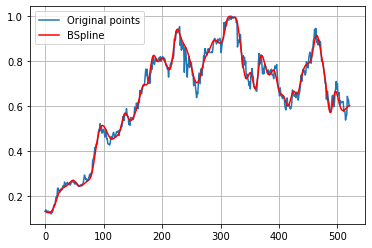

In [ ]:
import scipy.interpolate as interpolate

t_JSMR_65, c_JSMR_65, k_JSMR_65 = interpolate.splrep(JSMR_x65, JSMR_y65, s=0, k=3)
print('''\
t_JSMR_65: {}
c_JSMR_65: {}
k_JSMR_65: {}
'''.format(t_JSMR_65, c_JSMR_65, k_JSMR_65))
N = 522
xmin_JSMR_65, xmax_JSMR_65 = JSMR_x65.min(), JSMR_x65.max()
xx_JSMR_65 = np.linspace(xmin_JSMR_65, xmax_JSMR_65, N)
spline_JSMR_65 = interpolate.BSpline(t_JSMR_65, c_JSMR_65, k_JSMR_65, extrapolate=False)

plt.plot(JSMR_x, JSMR_y, label='Original points')
plt.plot(xx_JSMR_65, spline_JSMR_65(xx_JSMR_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE JSMR**

In [ ]:

#RMSE 15 DATA JSMR
y_true_JSMR_15 = JSMR_y.tolist()
y_pred_JSMR_15 = spline_JSMR_15(xx_JSMR_15).tolist()
mse_JSMR_15 = mean_squared_error(y_true_JSMR_15, y_pred_JSMR_15)
rmse_JSMR_15 = np.sqrt(mse_JSMR_15)
print("rmse JSMR 15 =",rmse_JSMR_15)

#RMSE 25 DATA JSMR
y_true_JSMR_25 = JSMR_y.tolist()
y_pred_JSMR_25 = spline_JSMR_25(xx_JSMR_25).tolist()
mse_JSMR_25 = mean_squared_error(y_true_JSMR_25, y_pred_JSMR_25)
rmse_JSMR_25 = np.sqrt(mse_JSMR_25)
print("rmse JSMR 25 =",rmse_JSMR_25)

#RMSE 35 DATA JSMR
y_true_JSMR_35 = JSMR_y.tolist()
y_pred_JSMR_35 = spline_JSMR_35(xx_JSMR_35).tolist()
mse_JSMR_35 = mean_squared_error(y_true_JSMR_35, y_pred_JSMR_35)
rmse_JSMR_35 = np.sqrt(mse_JSMR_35)
print("rmse JSMR 35 =",rmse_JSMR_35)

#RMSE 45 DATA JSMR
y_true_JSMR_45 = JSMR_y.tolist()
y_pred_JSMR_45 = spline_JSMR_45(xx_JSMR_45).tolist()
mse_JSMR_45 = mean_squared_error(y_true_JSMR_45, y_pred_JSMR_45)
rmse_JSMR_45 = np.sqrt(mse_JSMR_45)
print("rmse JSMR 45 =",rmse_JSMR_45)

#RMSE 55 DATA JSMR
y_true_JSMR_55 = JSMR_y.tolist()
y_pred_JSMR_55 = spline_JSMR_55(xx_JSMR_55).tolist()
mse_JSMR_55 = mean_squared_error(y_true_JSMR_55, y_pred_JSMR_55)
rmse_JSMR_55 = np.sqrt(mse_JSMR_55)
print("rmse JSMR 55 =",rmse_JSMR_55)

#RMSE 65 DATA JSMR
y_true_JSMR_65 = JSMR_y.tolist()
y_pred_JSMR_65 = spline_JSMR_65(xx_JSMR_65).tolist()
mse_JSMR_65 = mean_squared_error(y_true_JSMR_65, y_pred_JSMR_65)
rmse_JSMR_65 = np.sqrt(mse_JSMR_65)
print("rmse JSMR 65 =",rmse_JSMR_65)


rmse JSMR 15 = 0.09720727679945376
rmse JSMR 25 = 0.06565195903783194
rmse JSMR 35 = 0.05472639478744638
rmse JSMR 45 = 0.04077753716043072
rmse JSMR 55 = 0.028625615289989772
rmse JSMR 65 = 0.025295858221420185


# **KLBF**

No handles with labels found to put in legend.


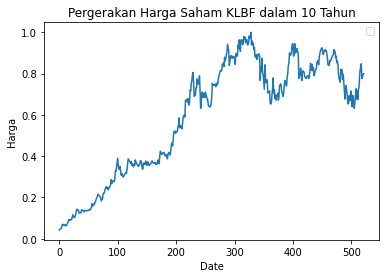

In [ ]:
KLBF = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/KLBF.JK.csv')

KLBF_x = KLBF['No'].values
KLBF_y = KLBF['Skala'].values

plt.plot(KLBF_x,KLBF_y)
plt.title('Pergerakan Harga Saham KLBF dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA KLBF**

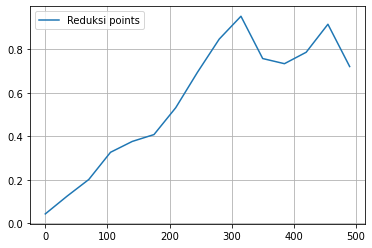

In [ ]:
KLBF_x15 = KLBF_x[0:522:35]
KLBF_y15 = KLBF_y[0:522:35]

plt.plot(KLBF_x15, KLBF_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_KLBF_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_KLBF_15: [0.04263158 0.12341343 0.12817313 0.3483982  0.38107254 0.38520637
 0.52547039 0.70238576 0.83340764 1.04819423 0.68960493 0.74075447
 0.75660228 1.07630412 0.72105263 0.         0.         0.
 0.        ]
k_KLBF_15: 3



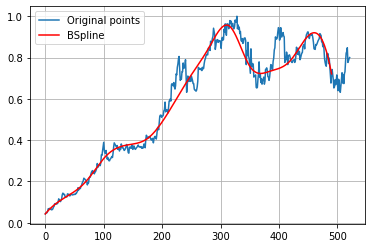

In [ ]:
import scipy.interpolate as interpolate

t_KLBF_15, c_KLBF_15, k_KLBF_15 = interpolate.splrep(KLBF_x15, KLBF_y15, s=0, k=3)
print('''\
t_KLBF_15: {}
c_KLBF_15: {}
k_KLBF_15: {}
'''.format(t_KLBF_15, c_KLBF_15, k_KLBF_15))
N = 522
xmin_KLBF_15, xmax_KLBF_15 = KLBF_x15.min(), KLBF_x15.max()
xx_KLBF_15 = np.linspace(xmin_KLBF_15, xmax_KLBF_15, N)
spline_KLBF_15 = interpolate.BSpline(t_KLBF_15, c_KLBF_15, k_KLBF_15, extrapolate=False)

plt.plot(KLBF_x, KLBF_y, label='Original points')
plt.plot(xx_KLBF_15, spline_KLBF_15(xx_KLBF_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA KLBF**

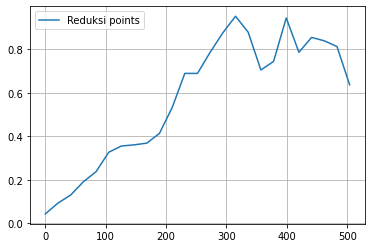

In [ ]:
KLBF_x25 = KLBF_x[0:522:21]
KLBF_y25 = KLBF_y[0:522:21]

plt.plot(KLBF_x25, KLBF_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_KLBF_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_KLBF_25: [0.04263158 0.09559987 0.09327394 0.20109787 0.2185365  0.34580874
 0.35612326 0.36127718 0.36192592 0.40154545 0.51083965 0.74456964
 0.64772388 0.80137695 0.86782096 0.98523394 0.90703274 0.66031929
 0.68326903 1.07502562 0.68504953 0.9058289  0.79567547 0.85939911
 0.63684211 0.         0.         0.         0.        ]
k_KLBF_25: 3



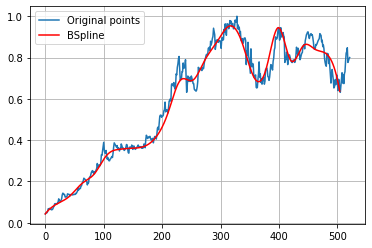

In [ ]:
import scipy.interpolate as interpolate

t_KLBF_25, c_KLBF_25, k_KLBF_25 = interpolate.splrep(KLBF_x25, KLBF_y25, s=0, k=3)
print('''\
t_KLBF_25: {}
c_KLBF_25: {}
k_KLBF_25: {}
'''.format(t_KLBF_25, c_KLBF_25, k_KLBF_25))
N = 522
xmin_KLBF_25, xmax_KLBF_25 = KLBF_x25.min(), KLBF_x25.max()
xx_KLBF_25 = np.linspace(xmin_KLBF_25, xmax_KLBF_25, N)
spline_KLBF_25 = interpolate.BSpline(t_KLBF_25, c_KLBF_25, k_KLBF_25, extrapolate=False)

plt.plot(KLBF_x, KLBF_y, label='Original points')
plt.plot(xx_KLBF_25, spline_KLBF_25(xx_KLBF_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA KLBF**

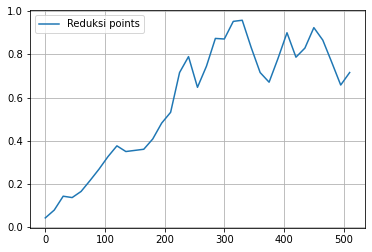

In [ ]:
KLBF_x35 = KLBF_x[0:522:15]
KLBF_y35 = KLBF_y[0:522:15]

plt.plot(KLBF_x35, KLBF_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_KLBF_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_KLBF_35: [0.04263158 0.02171695 0.17946084 0.12313331 0.16314044 0.21588386
 0.26806094 0.32239869 0.40023903 0.33453991 0.36160131 0.3506338
 0.39902139 0.50064904 0.48785611 0.73740021 0.85727991 0.57032227
 0.74564152 0.91553268 0.83433301 0.97345105 0.98765226 0.82330835
 0.70858803 0.63707638 0.76942223 0.97470838 0.73174424 0.81936728
 0.96447086 0.86485456 0.73951217 0.57629655 0.71578947 0.
 0.         0.         0.        ]
k_KLBF_35: 3



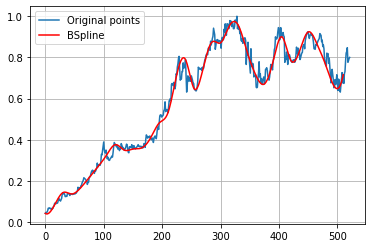

In [ ]:
import scipy.interpolate as interpolate

t_KLBF_35, c_KLBF_35, k_KLBF_35 = interpolate.splrep(KLBF_x35, KLBF_y35, s=0, k=3)
print('''\
t_KLBF_35: {}
c_KLBF_35: {}
k_KLBF_35: {}
'''.format(t_KLBF_35, c_KLBF_35, k_KLBF_35))
N = 522
xmin_KLBF_35, xmax_KLBF_35 = KLBF_x35.min(), KLBF_x35.max()
xx_KLBF_35 = np.linspace(xmin_KLBF_35, xmax_KLBF_35, N)
spline_KLBF_35 = interpolate.BSpline(t_KLBF_35, c_KLBF_35, k_KLBF_35, extrapolate=False)

plt.plot(KLBF_x, KLBF_y, label='Original points')
plt.plot(xx_KLBF_35, spline_KLBF_35(xx_KLBF_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA KLBF**

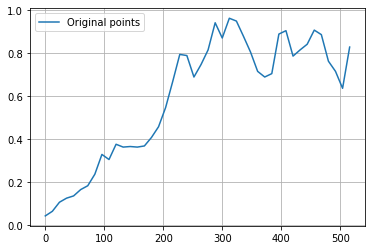

In [ ]:
KLBF_x45 = KLBF_x[0:522:12]
KLBF_y45 = KLBF_y[0:522:12]

plt.plot(KLBF_x45, KLBF_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_KLBF_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_KLBF_45: [0.04263158 0.03751747 0.10733349 0.1275524  0.12898115 0.17125986
 0.17755837 0.21745403 0.37367815 0.26151759 0.41183045 0.34905534
 0.37089558 0.3620992  0.35965498 0.4098072  0.44848465 0.54362261
 0.66123542 0.82196204 0.81933749 0.63753012 0.76738412 0.77714392
 1.01877705 0.80037946 1.00602089 0.95448436 0.87604169 0.81503309
 0.6954049  0.69808414 0.64910065 0.9370922  0.93937265 0.73699615
 0.8336954  0.8229591  0.92709977 0.91601024 0.72991189 0.7477488
 0.5136256  0.82894737 0.         0.         0.         0.        ]
k_KLBF_45: 3



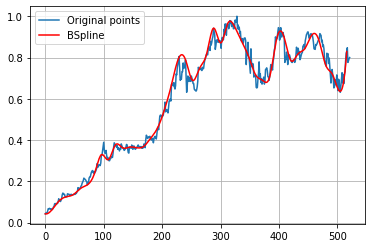

In [ ]:

import scipy.interpolate as interpolate

t_KLBF_45, c_KLBF_45, k_KLBF_45 = interpolate.splrep(KLBF_x45, KLBF_y45, s=0, k=3)
print('''\
t_KLBF_45: {}
c_KLBF_45: {}
k_KLBF_45: {}
'''.format(t_KLBF_45, c_KLBF_45, k_KLBF_45))
N = 522
xmin_KLBF_45, xmax_KLBF_45 = KLBF_x45.min(), KLBF_x45.max()
xx_KLBF_45 = np.linspace(xmin_KLBF_45, xmax_KLBF_45, N)
spline_KLBF_45 = interpolate.BSpline(t_KLBF_45, c_KLBF_45, k_KLBF_45, extrapolate=False)

plt.plot(KLBF_x, KLBF_y, label='Original points')
plt.plot(xx_KLBF_45, spline_KLBF_45(xx_KLBF_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA KLBF**

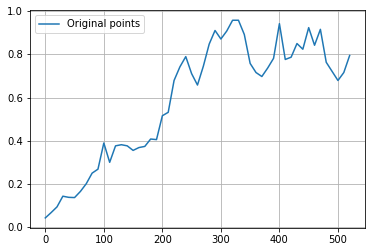

In [ ]:
KLBF_x55 = KLBF_x[0:522:10]
KLBF_y55 = KLBF_y[0:522:10]

plt.plot(KLBF_x55, KLBF_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_KLBF_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_KLBF_55: [0.04263158 0.07156738 0.05818102 0.16022847 0.1343406  0.12977755
 0.16760183 0.19139407 0.27313768 0.21605521 0.47316778 0.22811575
 0.41436921 0.37230215 0.38589587 0.34200912 0.37764661 0.35793077
 0.43273557 0.35849535 0.56486196 0.47679364 0.71743714 0.72714198
 0.82662649 0.70319414 0.62375484 0.74915493 0.84804651 0.94286956
 0.84363314 0.90891366 0.96808065 0.96613218 0.91475906 0.72746316
 0.72275671 0.67624685 0.7564664  0.71894017 1.05724659 0.70470505
 0.78182795 0.88903579 0.76202888 1.00495396 0.76026054 1.00663547
 0.70793442 0.74057421 0.62792128 0.74919725 0.79473684 0.
 0.         0.         0.        ]
k_KLBF_55: 3



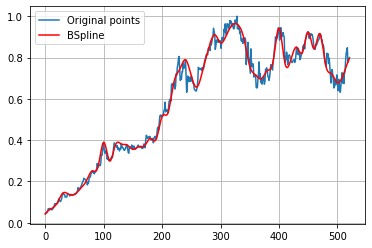

In [ ]:
import scipy.interpolate as interpolate

t_KLBF_55, c_KLBF_55, k_KLBF_55 = interpolate.splrep(KLBF_x55, KLBF_y55, s=0, k=3)
print('''\
t_KLBF_55: {}
c_KLBF_55: {}
k_KLBF_55: {}
'''.format(t_KLBF_55, c_KLBF_55, k_KLBF_55))
N = 522
xmin_KLBF_55, xmax_KLBF_55 = KLBF_x55.min(), KLBF_x55.max()
xx_KLBF_55 = np.linspace(xmin_KLBF_55, xmax_KLBF_55, N)
spline_KLBF_55 = interpolate.BSpline(t_KLBF_55, c_KLBF_55, k_KLBF_55, extrapolate=False)

plt.plot(KLBF_x, KLBF_y, label='Original points')
plt.plot(xx_KLBF_55, spline_KLBF_55(xx_KLBF_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA KLBF**

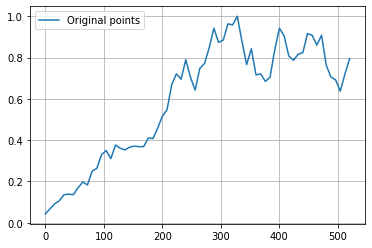

In [ ]:
KLBF_x65 = KLBF_x[0:522:8]
KLBF_y65 = KLBF_y[0:522:8]

plt.plot(KLBF_x65, KLBF_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_KLBF_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_KLBF_65: [0.04263158 0.05403819 0.09429203 0.09957072 0.14400015 0.13916553
 0.12670616 0.16874666 0.21514931 0.15170875 0.27696308 0.24043895
 0.34022849 0.37233131 0.27044627 0.40904151 0.35128242 0.34898672
 0.36856018 0.37150939 0.37171805 0.35214473 0.43022935 0.39009577
 0.45675597 0.53024875 0.51698588 0.68601827 0.74946735 0.64242813
 0.8492412  0.69744919 0.59254099 0.78501843 0.75159582 0.83491408
 0.99295838 0.84588396 0.86561102 0.9969351  0.92559595 1.04804951
 0.882206   0.69681069 0.9252881  0.65466851 0.75077472 0.66854842
 0.68029477 0.84185146 0.97335203 0.91737201 0.78873888 0.7750409
 0.83215016 0.791095

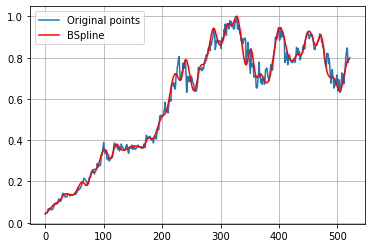

In [ ]:
import scipy.interpolate as interpolate

t_KLBF_65, c_KLBF_65, k_KLBF_65 = interpolate.splrep(KLBF_x65, KLBF_y65, s=0, k=3)
print('''\
t_KLBF_65: {}
c_KLBF_65: {}
k_KLBF_65: {}
'''.format(t_KLBF_65, c_KLBF_65, k_KLBF_65))
N = 522
xmin_KLBF_65, xmax_KLBF_65 = KLBF_x65.min(), KLBF_x65.max()
xx_KLBF_65 = np.linspace(xmin_KLBF_65, xmax_KLBF_65, N)
spline_KLBF_65 = interpolate.BSpline(t_KLBF_65, c_KLBF_65, k_KLBF_65, extrapolate=False)

plt.plot(KLBF_x, KLBF_y, label='Original points')
plt.plot(xx_KLBF_65, spline_KLBF_65(xx_KLBF_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE KLBF**

In [ ]:

#RMSE 15 DATA KLBF
y_true_KLBF_15 = KLBF_y.tolist()
y_pred_KLBF_15 = spline_KLBF_15(xx_KLBF_15).tolist()
mse_KLBF_15 = mean_squared_error(y_true_KLBF_15, y_pred_KLBF_15)
rmse_KLBF_15 = np.sqrt(mse_KLBF_15)
print("rmse KLBF 15 =",rmse_KLBF_15)

#RMSE 25 DATA KLBF
y_true_KLBF_25 = KLBF_y.tolist()
y_pred_KLBF_25 = spline_KLBF_25(xx_KLBF_25).tolist()
mse_KLBF_25 = mean_squared_error(y_true_KLBF_25, y_pred_KLBF_25)
rmse_KLBF_25 = np.sqrt(mse_KLBF_25)
print("rmse KLBF 25 =",rmse_KLBF_25)

#RMSE 35 DATA KLBF
y_true_KLBF_35 = KLBF_y.tolist()
y_pred_KLBF_35 = spline_KLBF_35(xx_KLBF_35).tolist()
mse_KLBF_35 = mean_squared_error(y_true_KLBF_35, y_pred_KLBF_35)
rmse_KLBF_35 = np.sqrt(mse_KLBF_35)
print("rmse KLBF 35 =",rmse_KLBF_35)

#RMSE 45 DATA KLBF
y_true_KLBF_45 = KLBF_y.tolist()
y_pred_KLBF_45 = spline_KLBF_45(xx_KLBF_45).tolist()
mse_KLBF_45 = mean_squared_error(y_true_KLBF_45, y_pred_KLBF_45)
rmse_KLBF_45 = np.sqrt(mse_KLBF_45)
print("rmse KLBF 45 =",rmse_KLBF_45)

#RMSE 55 DATA KLBF
y_true_KLBF_55 = KLBF_y.tolist()
y_pred_KLBF_55 = spline_KLBF_55(xx_KLBF_55).tolist()
mse_KLBF_55 = mean_squared_error(y_true_KLBF_55, y_pred_KLBF_55)
rmse_KLBF_55 = np.sqrt(mse_KLBF_55)
print("rmse KLBF 55 =",rmse_KLBF_55)

#RMSE 65 DATA KLBF
y_true_KLBF_65 = KLBF_y.tolist()
y_pred_KLBF_65 = spline_KLBF_65(xx_KLBF_65).tolist()
mse_KLBF_65 = mean_squared_error(y_true_KLBF_65, y_pred_KLBF_65)
rmse_KLBF_65 = np.sqrt(mse_KLBF_65)
print("rmse KLBF 65 =",rmse_KLBF_65)


rmse KLBF 15 = 0.08421445213880852
rmse KLBF 25 = 0.060742840205045244
rmse KLBF 35 = 0.05210043999013769
rmse KLBF 45 = 0.037849383849247686
rmse KLBF 55 = 0.029632274417925476
rmse KLBF 65 = 0.030473075144592025


# **LPKR**

No handles with labels found to put in legend.


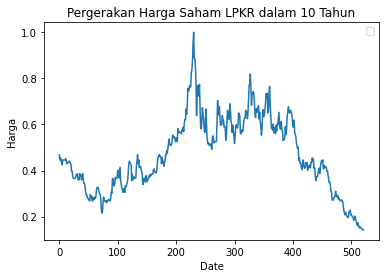

In [ ]:
LPKR = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/LPKR.JK.csv')

LPKR_x = LPKR['No'].values
LPKR_y = LPKR['Skala'].values

plt.plot(LPKR_x,LPKR_y)
plt.title('Pergerakan Harga Saham LPKR dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA LPKR**

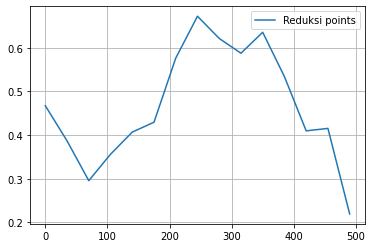

In [ ]:
LPKR_x15 = LPKR_x[0:522:35]
LPKR_y15 = LPKR_y[0:522:35]

plt.plot(LPKR_x15, LPKR_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LPKR_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_LPKR_15: [0.46728915 0.4737527  0.21803022 0.36493548 0.42110361 0.39133764
 0.58982408 0.70700496 0.61607018 0.55753878 0.67920885 0.53919962
 0.31012224 0.51824586 0.2192096  0.         0.         0.
 0.        ]
k_LPKR_15: 3



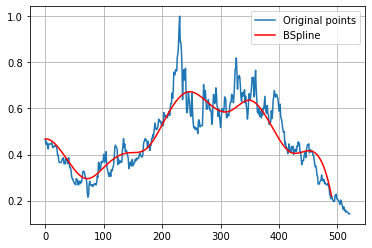

In [ ]:
import scipy.interpolate as interpolate

t_LPKR_15, c_LPKR_15, k_LPKR_15 = interpolate.splrep(LPKR_x15, LPKR_y15, s=0, k=3)
print('''\
t_LPKR_15: {}
c_LPKR_15: {}
k_LPKR_15: {}
'''.format(t_LPKR_15, c_LPKR_15, k_LPKR_15))
N = 522
xmin_LPKR_15, xmax_LPKR_15 = LPKR_x15.min(), LPKR_x15.max()
xx_LPKR_15 = np.linspace(xmin_LPKR_15, xmax_LPKR_15, N)
spline_LPKR_15 = interpolate.BSpline(t_LPKR_15, c_LPKR_15, k_LPKR_15, extrapolate=False)

plt.plot(LPKR_x, LPKR_y, label='Original points')
plt.plot(xx_LPKR_15, spline_LPKR_15(xx_LPKR_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA LPKR**

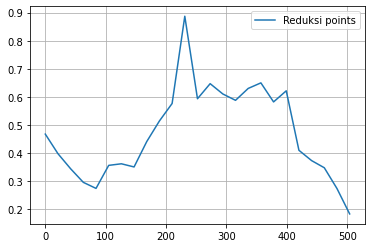

In [ ]:
LPKR_x25 = LPKR_x[0:522:21]
LPKR_y25 = LPKR_y[0:522:21]

plt.plot(LPKR_x25, LPKR_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPKR_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_LPKR_25: [0.46728915 0.41327621 0.35778305 0.29719329 0.24106471 0.38211583
 0.36607405 0.32308557 0.44328593 0.54784834 0.45007866 1.10947596
 0.43406437 0.7136004  0.59290332 0.57581529 0.62926964 0.68678027
 0.52192855 0.71704415 0.33871932 0.38571583 0.34571418 0.24141023
 0.18305152 0.         0.         0.         0.        ]
k_LPKR_25: 3



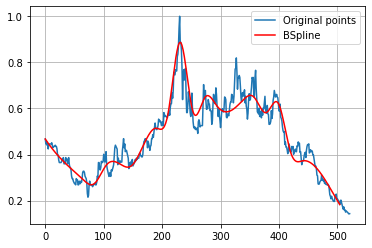

In [ ]:
import scipy.interpolate as interpolate

t_LPKR_25, c_LPKR_25, k_LPKR_25 = interpolate.splrep(LPKR_x25, LPKR_y25, s=0, k=3)
print('''\
t_LPKR_25: {}
c_LPKR_25: {}
k_LPKR_25: {}
'''.format(t_LPKR_25, c_LPKR_25, k_LPKR_25))
N = 522
xmin_LPKR_25, xmax_LPKR_25 = LPKR_x25.min(), LPKR_x25.max()
xx_LPKR_25 = np.linspace(xmin_LPKR_25, xmax_LPKR_25, N)
spline_LPKR_25 = interpolate.BSpline(t_LPKR_25, c_LPKR_25, k_LPKR_25, extrapolate=False)

plt.plot(LPKR_x, LPKR_y, label='Original points')
plt.plot(xx_LPKR_25, spline_LPKR_25(xx_LPKR_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA LPKR**

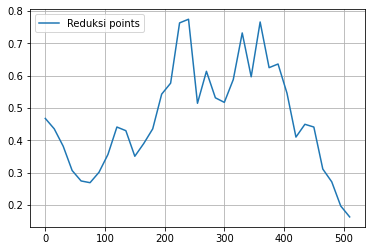

In [ ]:
LPKR_x35 = LPKR_x[0:522:15]
LPKR_y35 = LPKR_y[0:522:15]

plt.plot(LPKR_x35, LPKR_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LPKR_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_LPKR_35: [0.46728915 0.44767839 0.42057001 0.29387592 0.27252833 0.25957872
 0.30049942 0.34312675 0.46259563 0.45056833 0.31140928 0.40549677
 0.40559601 0.5822971  0.5194642  0.79748504 0.86689778 0.379017
 0.70179216 0.49179331 0.51748772 0.53995959 0.84810806 0.45745327
 0.89836267 0.54231426 0.67815473 0.55864064 0.35848129 0.46507146
 0.47615596 0.27438231 0.29617526 0.13665991 0.16271207 0.
 0.         0.         0.        ]
k_LPKR_35: 3



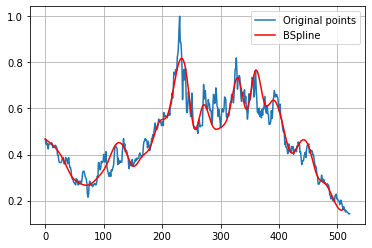

In [ ]:
import scipy.interpolate as interpolate

t_LPKR_35, c_LPKR_35, k_LPKR_35 = interpolate.splrep(LPKR_x35, LPKR_y35, s=0, k=3)
print('''\
t_LPKR_35: {}
c_LPKR_35: {}
k_LPKR_35: {}
'''.format(t_LPKR_35, c_LPKR_35, k_LPKR_35))
N = 522
xmin_LPKR_35, xmax_LPKR_35 = LPKR_x35.min(), LPKR_x35.max()
xx_LPKR_35 = np.linspace(xmin_LPKR_35, xmax_LPKR_35, N)
spline_LPKR_35 = interpolate.BSpline(t_LPKR_35, c_LPKR_35, k_LPKR_35, extrapolate=False)

plt.plot(LPKR_x, LPKR_y, label='Original points')
plt.plot(xx_LPKR_35, spline_LPKR_35(xx_LPKR_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA LPKR**

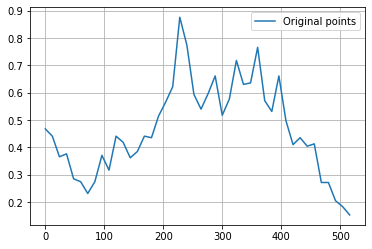

In [ ]:
LPKR_x45 = LPKR_x[0:522:12]
LPKR_y45 = LPKR_y[0:522:12]

plt.plot(LPKR_x45, LPKR_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPKR_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_LPKR_45: [0.46728915 0.52198374 0.30150252 0.41921319 0.24809586 0.29642632
 0.20976681 0.25025915 0.43276453 0.242332   0.49621952 0.41686754
 0.34479308 0.37345775 0.46646838 0.40474635 0.52472415 0.58111501
 0.54065927 0.98507237 0.77330707 0.56579253 0.52285663 0.58007956
 0.73310894 0.45359914 0.55419827 0.78724672 0.60191034 0.58478604
 0.87251931 0.51835495 0.47779986 0.75689873 0.46071971 0.3832855
 0.46377557 0.37179014 0.47280143 0.21158721 0.3079718  0.14220629
 0.2057342  0.1525427  0.         0.         0.         0.        ]
k_LPKR_45: 3



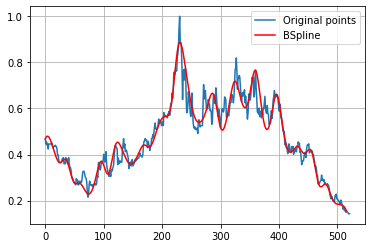

In [ ]:
import scipy.interpolate as interpolate

t_LPKR_45, c_LPKR_45, k_LPKR_45 = interpolate.splrep(LPKR_x45, LPKR_y45, s=0, k=3)
print('''\
t_LPKR_45: {}
c_LPKR_45: {}
k_LPKR_45: {}
'''.format(t_LPKR_45, c_LPKR_45, k_LPKR_45))
N = 522
xmin_LPKR_45, xmax_LPKR_45 = LPKR_x45.min(), LPKR_x45.max()
xx_LPKR_45 = np.linspace(xmin_LPKR_45, xmax_LPKR_45, N)
spline_LPKR_45 = interpolate.BSpline(t_LPKR_45, c_LPKR_45, k_LPKR_45, extrapolate=False)

plt.plot(LPKR_x, LPKR_y, label='Original points')
plt.plot(xx_LPKR_45, spline_LPKR_45(xx_LPKR_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA LPKR**

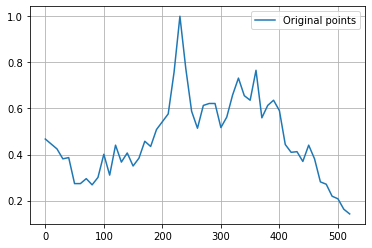

In [ ]:
LPKR_x55 = LPKR_x[0:522:10]
LPKR_y55 = LPKR_y[0:522:10]

plt.plot(LPKR_x55, LPKR_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPKR_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_LPKR_55: [0.46728915 0.43692209 0.46356808 0.35470567 0.43292899 0.23390784
 0.27500759 0.30962976 0.25894688 0.26592532 0.48205498 0.21264236
 0.5317878  0.30428406 0.45447325 0.31851052 0.37318693 0.49383419
 0.39724908 0.52734742 0.5442195  0.55002317 0.71332675 1.13905532
 0.73045198 0.58322994 0.46206238 0.6532785  0.60280259 0.66433559
 0.46867949 0.5626502  0.65361319 0.77206152 0.64798581 0.56821003
 0.89274788 0.45401668 0.64712918 0.63544557 0.62466235 0.40828915
 0.40320865 0.43651353 0.32532032 0.48255244 0.38854754 0.25140014
 0.2939945  0.19974393 0.22980186 0.12295228 0.14237333 0.
 0.         0.         0.        ]
k_LPKR_55: 3



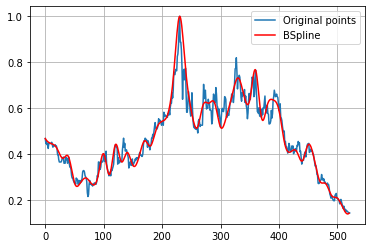

In [ ]:
import scipy.interpolate as interpolate

t_LPKR_55, c_LPKR_55, k_LPKR_55 = interpolate.splrep(LPKR_x55, LPKR_y55, s=0, k=3)
print('''\
t_LPKR_55: {}
c_LPKR_55: {}
k_LPKR_55: {}
'''.format(t_LPKR_55, c_LPKR_55, k_LPKR_55))
N = 522
xmin_LPKR_55, xmax_LPKR_55 = LPKR_x55.min(), LPKR_x55.max()
xx_LPKR_55 = np.linspace(xmin_LPKR_55, xmax_LPKR_55, N)
spline_LPKR_55 = interpolate.BSpline(t_LPKR_55, c_LPKR_55, k_LPKR_55, extrapolate=False)

plt.plot(LPKR_x, LPKR_y, label='Original points')
plt.plot(xx_LPKR_55, spline_LPKR_55(xx_LPKR_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA LPKR**

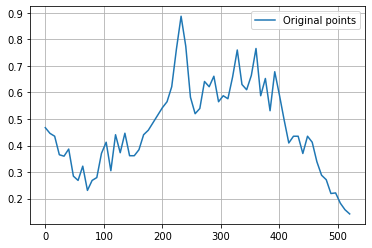

In [ ]:
LPKR_x65 = LPKR_x[0:522:8]
LPKR_y65 = LPKR_y[0:522:8]

plt.plot(LPKR_x65, LPKR_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LPKR_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_LPKR_65: [0.46728915 0.42089242 0.49025655 0.34779331 0.34560994 0.42896551
 0.25885751 0.2436274  0.37797552 0.17807922 0.2954603  0.25142218
 0.37464428 0.47365    0.2053388  0.53551152 0.29669274 0.51501474
 0.3212217  0.36959607 0.36989163 0.45592987 0.45046652 0.48797682
 0.51288961 0.5452227  0.5604682  0.60274797 0.75736439 0.9440966
 0.78829607 0.54681231 0.51599329 0.50786799 0.68983335 0.58026795
 0.71791933 0.51416922 0.61524725 0.55027593 0.64128796 0.83373671
 0.583109   0.6135014  0.62391439 0.8739055  0.47368181 0.75680137
 0.41438167 0.77212507 0.56492769 0.51054827 0.37594228 0.44331989
 0.46095609 0.323033

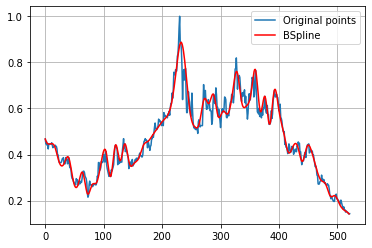

In [ ]:
import scipy.interpolate as interpolate

t_LPKR_65, c_LPKR_65, k_LPKR_65 = interpolate.splrep(LPKR_x65, LPKR_y65, s=0, k=3)
print('''\
t_LPKR_65: {}
c_LPKR_65: {}
k_LPKR_65: {}
'''.format(t_LPKR_65, c_LPKR_65, k_LPKR_65))
N = 522
xmin_LPKR_65, xmax_LPKR_65 = LPKR_x65.min(), LPKR_x65.max()
xx_LPKR_65 = np.linspace(xmin_LPKR_65, xmax_LPKR_65, N)
spline_LPKR_65 = interpolate.BSpline(t_LPKR_65, c_LPKR_65, k_LPKR_65, extrapolate=False)

plt.plot(LPKR_x, LPKR_y, label='Original points')
plt.plot(xx_LPKR_65, spline_LPKR_65(xx_LPKR_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE LPKR**

In [ ]:

#RMSE 15 DATA LPKR
y_true_LPKR_15 = LPKR_y.tolist()
y_pred_LPKR_15 = spline_LPKR_15(xx_LPKR_15).tolist()
mse_LPKR_15 = mean_squared_error(y_true_LPKR_15, y_pred_LPKR_15)
rmse_LPKR_15 = np.sqrt(mse_LPKR_15)
print("rmse LPKR 15 =",rmse_LPKR_15)

#RMSE 25 DATA LPKR
y_true_LPKR_25 = LPKR_y.tolist()
y_pred_LPKR_25 = spline_LPKR_25(xx_LPKR_25).tolist()
mse_LPKR_25 = mean_squared_error(y_true_LPKR_25, y_pred_LPKR_25)
rmse_LPKR_25 = np.sqrt(mse_LPKR_25)
print("rmse LPKR 25 =",rmse_LPKR_25)

#RMSE 35 DATA LPKR
y_true_LPKR_35 = LPKR_y.tolist()
y_pred_LPKR_35 = spline_LPKR_35(xx_LPKR_35).tolist()
mse_LPKR_35 = mean_squared_error(y_true_LPKR_35, y_pred_LPKR_35)
rmse_LPKR_35 = np.sqrt(mse_LPKR_35)
print("rmse LPKR 35 =",rmse_LPKR_35)

#RMSE 45 DATA LPKR
y_true_LPKR_45 = LPKR_y.tolist()
y_pred_LPKR_45 = spline_LPKR_45(xx_LPKR_45).tolist()
mse_LPKR_45 = mean_squared_error(y_true_LPKR_45, y_pred_LPKR_45)
rmse_LPKR_45 = np.sqrt(mse_LPKR_45)
print("rmse LPKR 45 =",rmse_LPKR_45)

#RMSE 55 DATA LPKR
y_true_LPKR_55 = LPKR_y.tolist()
y_pred_LPKR_55 = spline_LPKR_55(xx_LPKR_55).tolist()
mse_LPKR_55 = mean_squared_error(y_true_LPKR_55, y_pred_LPKR_55)
rmse_LPKR_55 = np.sqrt(mse_LPKR_55)
print("rmse LPKR 55 =",rmse_LPKR_55)

#RMSE 65 DATA LPKR
y_true_LPKR_65 = LPKR_y.tolist()
y_pred_LPKR_65 = spline_LPKR_65(xx_LPKR_65).tolist()
mse_LPKR_65 = mean_squared_error(y_true_LPKR_65, y_pred_LPKR_65)
rmse_LPKR_65 = np.sqrt(mse_LPKR_65)
print("rmse LPKR 65 =",rmse_LPKR_65)

rmse LPKR 15 = 0.08739918249535786
rmse LPKR 25 = 0.07153704934353604
rmse LPKR 35 = 0.06385275465070885
rmse LPKR 45 = 0.04861844206350493
rmse LPKR 55 = 0.04144268478873914
rmse LPKR 65 = 0.033348225571737666


# **LPPF**

No handles with labels found to put in legend.


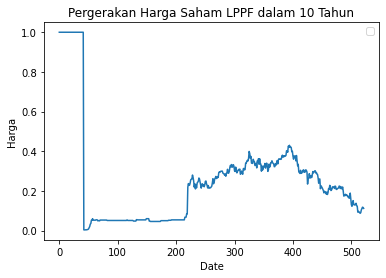

In [ ]:
LPPF = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/LPPF.JK.csv')

LPPF_x = LPPF['No'].values
LPPF_y = LPPF['Skala'].values

plt.plot(LPPF_x,LPPF_y)
plt.title('Pergerakan Harga Saham LPPF dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA LPPF**

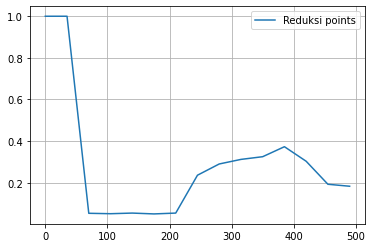

In [ ]:
LPPF_x15 = LPPF_x[0:522:35]
LPPF_y15 = LPPF_y[0:522:35]

plt.plot(LPPF_x15, LPPF_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LPPF_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_LPPF_15: [ 1.          1.91978998 -0.36607997  0.12920328  0.03144601  0.06901266
 -0.00749664  0.28497391  0.28360101  0.32062206  0.30591076  0.40573491
  0.27695451  0.12502275  0.183       0.          0.          0.
  0.        ]
k_LPPF_15: 3



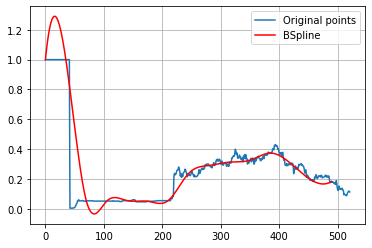

In [ ]:
import scipy.interpolate as interpolate

t_LPPF_15, c_LPPF_15, k_LPPF_15 = interpolate.splrep(LPPF_x15, LPPF_y15, s=0, k=3)
print('''\
t_LPPF_15: {}
c_LPPF_15: {}
k_LPPF_15: {}
'''.format(t_LPPF_15, c_LPPF_15, k_LPPF_15))
N = 522
xmin_LPPF_15, xmax_LPPF_15 = LPPF_x15.min(), LPPF_x15.max()
xx_LPPF_15 = np.linspace(xmin_LPPF_15, xmax_LPPF_15, N)
spline_LPPF_15 = interpolate.BSpline(t_LPPF_15, c_LPPF_15, k_LPPF_15, extrapolate=False)

plt.plot(LPPF_x, LPPF_y, label='Original points')
plt.plot(xx_LPPF_15, spline_LPPF_15(xx_LPPF_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA LPPF**

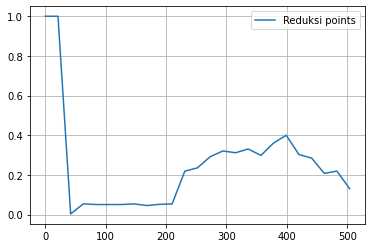

In [ ]:
LPPF_x25 = LPPF_x[0:522:21]
LPPF_y25 = LPPF_y[0:522:21]

plt.plot(LPPF_x25, LPPF_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPPF_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_LPPF_25: [ 1.          1.99221951 -0.48628902  0.15750854  0.02230549  0.0592695
  0.0466165   0.06026451  0.03632546  0.07043364 -0.00606004  0.27780652
  0.20883397  0.30285761  0.33173559  0.29620005  0.35546423  0.26794303
  0.36376366  0.44300232  0.26422706  0.31808945  0.12519037  0.29177982
  0.1305      0.          0.          0.          0.        ]
k_LPPF_25: 3



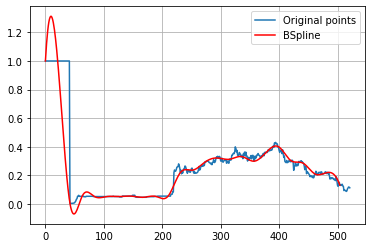

In [ ]:
import scipy.interpolate as interpolate

t_LPPF_25, c_LPPF_25, k_LPPF_25 = interpolate.splrep(LPPF_x25, LPPF_y25, s=0, k=3)
print('''\
t_LPPF_25: {}
c_LPPF_25: {}
k_LPPF_25: {}
'''.format(t_LPPF_25, c_LPPF_25, k_LPPF_25))
N = 522
xmin_LPPF_25, xmax_LPPF_25 = LPPF_x25.min(), LPPF_x25.max()
xx_LPPF_25 = np.linspace(xmin_LPPF_25, xmax_LPPF_25, N)
spline_LPPF_25 = interpolate.BSpline(t_LPPF_25, c_LPPF_25, k_LPPF_25, extrapolate=False)

plt.plot(LPPF_x, LPPF_y, label='Original points')
plt.plot(xx_LPPF_25, spline_LPPF_25(xx_LPPF_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA LPPF**

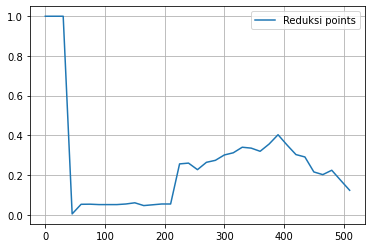

In [ ]:
LPPF_x35 = LPPF_x[0:522:15]
LPPF_y35 = LPPF_y[0:522:15]

plt.plot(LPPF_x35, LPPF_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPPF_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_LPPF_35: [ 1.          0.54296421  1.91407157 -0.37110736  0.1656526   0.02349696
  0.05835956  0.04906479  0.05138126  0.05141015  0.06697813  0.04067731
  0.04631263  0.07407219 -0.01860138  0.32433332  0.25726809  0.20659431
  0.27835468  0.26398696  0.30969748  0.3032231   0.3494101   0.3391365
  0.30704389  0.34968793  0.4302044   0.34749447  0.28881772  0.31523465
  0.1962437   0.19279057  0.26186184  0.12831908  0.123       0.
  0.          0.          0.        ]
k_LPPF_35: 3



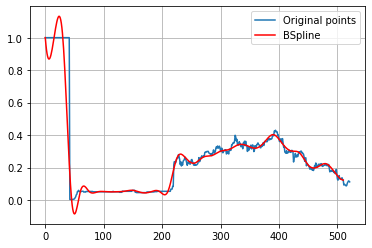

In [ ]:
import scipy.interpolate as interpolate

t_LPPF_35, c_LPPF_35, k_LPPF_35 = interpolate.splrep(LPPF_x35, LPPF_y35, s=0, k=3)
print('''\
t_LPPF_35: {}
c_LPPF_35: {}
k_LPPF_35: {}
'''.format(t_LPPF_35, c_LPPF_35, k_LPPF_35))
N = 522
xmin_LPPF_35, xmax_LPPF_35 = LPPF_x35.min(), LPPF_x35.max()
xx_LPPF_35 = np.linspace(xmin_LPPF_35, xmax_LPPF_35, N)
spline_LPPF_35 = interpolate.BSpline(t_LPPF_35, c_LPPF_35, k_LPPF_35, extrapolate=False)

plt.plot(LPPF_x, LPPF_y, label='Original points')
plt.plot(xx_LPPF_35, spline_LPPF_35(xx_LPPF_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA LPPF**

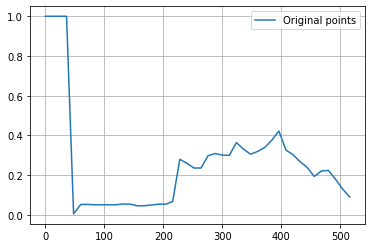

In [ ]:
LPPF_x45 = LPPF_x[0:522:12]
LPPF_y45 = LPPF_y[0:522:12]

plt.plot(LPPF_x45, LPPF_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPPF_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_LPPF_45: [ 1.          1.12230853  0.75538294  1.36692559 -0.37597096  0.16695825
  0.02313797  0.05848988  0.04890252  0.05190004  0.04949733  0.05611064
  0.05606012  0.04364889  0.04534431  0.05097385  0.05076029  0.06998498
 -0.00670022  0.36181591  0.2394366   0.24043769  0.21481263  0.31631178
  0.30794023  0.30592728  0.27435066  0.39667009  0.32296899  0.29745397
  0.32021514  0.33868547  0.36204298  0.46914262  0.29338655  0.31631119
  0.25936868  0.25121408  0.16977502  0.23068586  0.23348155  0.16135675
  0.11277163  0.0902      0.          0.          0.          0.        ]
k_LPPF_45: 3



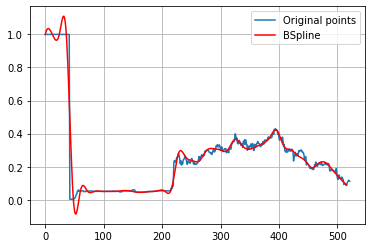

In [ ]:
import scipy.interpolate as interpolate

t_LPPF_45, c_LPPF_45, k_LPPF_45 = interpolate.splrep(LPPF_x45, LPPF_y45, s=0, k=3)
print('''\
t_LPPF_45: {}
c_LPPF_45: {}
k_LPPF_45: {}
'''.format(t_LPPF_45, c_LPPF_45, k_LPPF_45))
N = 522
xmin_LPPF_45, xmax_LPPF_45 = LPPF_x45.min(), LPPF_x45.max()
xx_LPPF_45 = np.linspace(xmin_LPPF_45, xmax_LPPF_45, N)
spline_LPPF_45 = interpolate.BSpline(t_LPPF_45, c_LPPF_45, k_LPPF_45, extrapolate=False)

plt.plot(LPPF_x, LPPF_y, label='Original points')
plt.plot(xx_LPPF_45, spline_LPPF_45(xx_LPPF_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA LPPF**

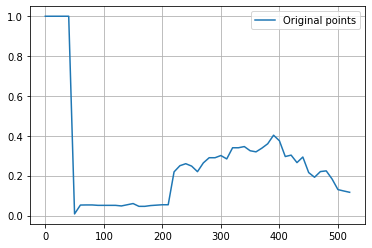

In [ ]:
LPPF_x55 = LPPF_x[0:522:10]
LPPF_y55 = LPPF_y[0:522:10]

plt.plot(LPPF_x55, LPPF_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LPPF_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_LPPF_55: [ 1.          0.96734966  1.06530067  0.90204899  1.36731627 -0.37131408
  0.16594004  0.0225539   0.06184435  0.04806868  0.05188091  0.05040768
  0.05248837  0.04563883  0.05295629  0.066536    0.0408997   0.04586518
  0.05163957  0.04757652  0.07005434 -0.00379388  0.26912117  0.2413092
  0.26564204  0.25612265  0.19786736  0.27240791  0.29650099  0.28158814
  0.31714644  0.2558261   0.36354917  0.32997721  0.35654197  0.31985491
  0.3140384   0.34099149  0.34999564  0.41902595  0.39190054  0.26337187
  0.33061197  0.23218023  0.33366711  0.19415135  0.1827275   0.22693864
  0.23251792  0.18698967  0.094368    0.137191    0.1165      0.
  0.          0.          0.        ]
k

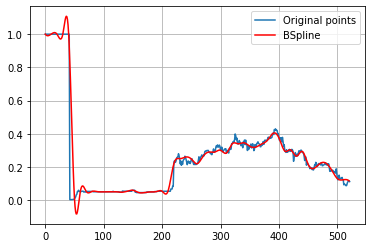

In [ ]:
import scipy.interpolate as interpolate

t_LPPF_55, c_LPPF_55, k_LPPF_55 = interpolate.splrep(LPPF_x55, LPPF_y55, s=0, k=3)
print('''\
t_LPPF_55: {}
c_LPPF_55: {}
k_LPPF_55: {}
'''.format(t_LPPF_55, c_LPPF_55, k_LPPF_55))
N = 522
xmin_LPPF_55, xmax_LPPF_55 = LPPF_x55.min(), LPPF_x55.max()
xx_LPPF_55 = np.linspace(xmin_LPPF_55, xmax_LPPF_55, N)
spline_LPPF_55 = interpolate.BSpline(t_LPPF_55, c_LPPF_55, k_LPPF_55, extrapolate=False)

plt.plot(LPPF_x, LPPF_y, label='Original points')
plt.plot(xx_LPPF_55, spline_LPPF_55(xx_LPPF_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**6. PERCOBAAN 65 DATA LPPF**

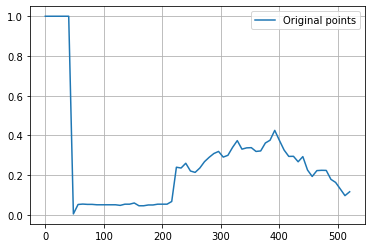

In [ ]:
LPPF_x65 = LPPF_x[0:522:8]
LPPF_y65 = LPPF_y[0:522:8]

plt.plot(LPPF_x65, LPPF_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LPPF_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_LPPF_65: [ 1.          1.00878048  0.98243905  1.02634143  0.90121965  1.36877997
 -0.37633953  0.16657813  0.025027    0.06031388  0.0517175   0.05081614
  0.05101793  0.05111213  0.05053356  0.05275362  0.04445197  0.0574385
  0.04979402  0.06738542  0.04066431  0.04595735  0.05150631  0.04801743
  0.05642399  0.05028663  0.0664295   0.00799537  0.30658903  0.20564852
  0.28681689  0.20708392  0.21084744  0.23352632  0.27104728  0.29028455
  0.30781452  0.33245737  0.279356    0.29611864  0.33616945  0.39920355
  0.31101635  0.34273107  0.34305938  0.31603141  0.30981498  0.37670866
  0.35535037  0.45788984  0.36609025  0

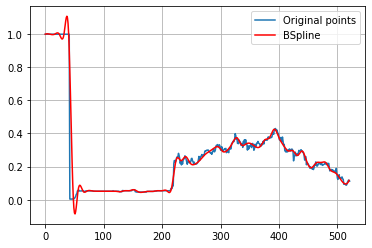

In [ ]:
import scipy.interpolate as interpolate

t_LPPF_65, c_LPPF_65, k_LPPF_65 = interpolate.splrep(LPPF_x65, LPPF_y65, s=0, k=3)
print('''\
t_LPPF_65: {}
c_LPPF_65: {}
k_LPPF_65: {}
'''.format(t_LPPF_65, c_LPPF_65, k_LPPF_65))
N = 522
xmin_LPPF_65, xmax_LPPF_65 = LPPF_x65.min(), LPPF_x65.max()
xx_LPPF_65 = np.linspace(xmin_LPPF_65, xmax_LPPF_65, N)
spline_LPPF_65 = interpolate.BSpline(t_LPPF_65, c_LPPF_65, k_LPPF_65, extrapolate=False)

plt.plot(LPPF_x, LPPF_y, label='Original points')
plt.plot(xx_LPPF_65, spline_LPPF_65(xx_LPPF_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE LPPF**

In [ ]:

#RMSE 15 DATA LPPF
y_true_LPPF_15 = LPPF_y.tolist()
y_pred_LPPF_15 = spline_LPPF_15(xx_LPPF_15).tolist()
mse_LPPF_15 = mean_squared_error(y_true_LPPF_15, y_pred_LPPF_15)
rmse_LPPF_15 = np.sqrt(mse_LPPF_15)
print("rmse LPPF 15 =",rmse_LPPF_15)

#RMSE 25 DATA LPPF
y_true_LPPF_25 = LPPF_y.tolist()
y_pred_LPPF_25 = spline_LPPF_25(xx_LPPF_25).tolist()
mse_LPPF_25 = mean_squared_error(y_true_LPPF_25, y_pred_LPPF_25)
rmse_LPPF_25 = np.sqrt(mse_LPPF_25)
print("rmse LPPF 25 =",rmse_LPPF_25)

#RMSE 35 DATA LPPF
y_true_LPPF_35 = LPPF_y.tolist()
y_pred_LPPF_35 = spline_LPPF_35(xx_LPPF_35).tolist()
mse_LPPF_35 = mean_squared_error(y_true_LPPF_35, y_pred_LPPF_35)
rmse_LPPF_35 = np.sqrt(mse_LPPF_35)
print("rmse LPPF 35 =",rmse_LPPF_35)

#RMSE 45 DATA LPPF
y_true_LPPF_45 = LPPF_y.tolist()
y_pred_LPPF_45 = spline_LPPF_45(xx_LPPF_45).tolist()
mse_LPPF_45 = mean_squared_error(y_true_LPPF_45, y_pred_LPPF_45)
rmse_LPPF_45 = np.sqrt(mse_LPPF_45)
print("rmse LPPF 45 =",rmse_LPPF_45)

#RMSE 55 DATA LPPF
y_true_LPPF_55 = LPPF_y.tolist()
y_pred_LPPF_55 = spline_LPPF_55(xx_LPPF_55).tolist()
mse_LPPF_55 = mean_squared_error(y_true_LPPF_55, y_pred_LPPF_55)
rmse_LPPF_55 = np.sqrt(mse_LPPF_55)
print("rmse LPPF 55 =",rmse_LPPF_55)

#RMSE 65 DATA LPPF
y_true_LPPF_65 = LPPF_y.tolist()
y_pred_LPPF_65 = spline_LPPF_65(xx_LPPF_65).tolist()
mse_LPPF_65 = mean_squared_error(y_true_LPPF_65, y_pred_LPPF_65)
rmse_LPPF_65 = np.sqrt(mse_LPPF_65)
print("rmse LPPF 65 =",rmse_LPPF_65)


rmse LPPF 15 = 0.14188301642920173
rmse LPPF 25 = 0.12785812237904923
rmse LPPF 35 = 0.07134194886131313
rmse LPPF 45 = 0.050487119148598075
rmse LPPF 55 = 0.06827141159232564
rmse LPPF 65 = 0.05670241425066748


# **LSIP**

No handles with labels found to put in legend.


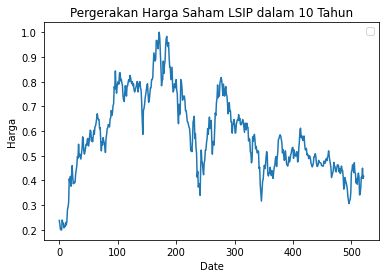

In [ ]:
LSIP = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/LSIP.JK.csv')

LSIP_x = LSIP['No'].values
LSIP_y = LSIP['Skala'].values

plt.plot(LSIP_x,LSIP_y)
plt.title('Pergerakan Harga Saham LSIP dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA LSIP**

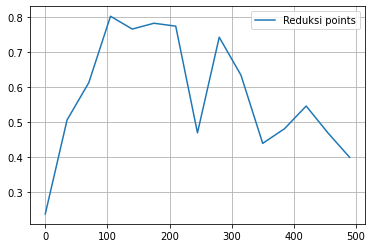

In [ ]:
LSIP_x15 = LSIP_x[0:522:35]
LSIP_y15 = LSIP_y[0:522:35]

plt.plot(LSIP_x15, LSIP_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LSIP_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_LSIP_15: [0.23833333 0.56879689 0.46323955 0.87833512 0.73964606 0.76308063
 0.90803143 0.25479367 0.89279389 0.63403077 0.38108303 0.48163712
 0.61594563 0.39536052 0.4        0.         0.         0.
 0.        ]
k_LSIP_15: 3



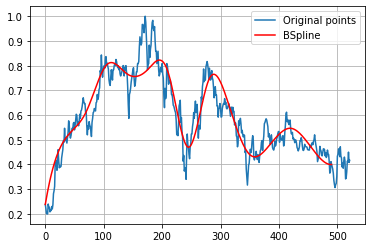

In [ ]:
import scipy.interpolate as interpolate

t_LSIP_15, c_LSIP_15, k_LSIP_15 = interpolate.splrep(LSIP_x15, LSIP_y15, s=0, k=3)
print('''\
t_LSIP_15: {}
c_LSIP_15: {}
k_LSIP_15: {}
'''.format(t_LSIP_15, c_LSIP_15, k_LSIP_15))
N = 522
xmin_LSIP_15, xmax_LSIP_15 = LSIP_x15.min(), LSIP_x15.max()
xx_LSIP_15 = np.linspace(xmin_LSIP_15, xmax_LSIP_15, N)
spline_LSIP_15 = interpolate.BSpline(t_LSIP_15, c_LSIP_15, k_LSIP_15, extrapolate=False)

plt.plot(LSIP_x, LSIP_y, label='Original points')
plt.plot(xx_LSIP_15, spline_LSIP_15(xx_LSIP_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA LSIP**

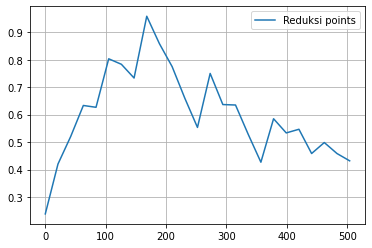

In [ ]:
LSIP_x25 = LSIP_x[0:522:21]
LSIP_y25 = LSIP_y[0:522:21]

plt.plot(LSIP_x25, LSIP_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LSIP_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_LSIP_25: [0.23833333 0.43174835 0.43733664 0.68718948 0.55144221 0.86704167
 0.8003911  0.63139393 1.07403319 0.82247331 0.78607356 0.68323244
 0.4409967  0.87278078 0.56788018 0.6756985  0.5393258  0.33699828
 0.67268109 0.48227737 0.59820944 0.40488489 0.57470637 0.39681348
 0.43166667 0.         0.         0.         0.        ]
k_LSIP_25: 3



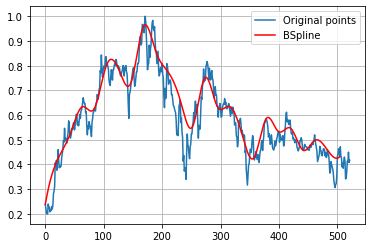

In [ ]:
import scipy.interpolate as interpolate

t_LSIP_25, c_LSIP_25, k_LSIP_25 = interpolate.splrep(LSIP_x25, LSIP_y25, s=0, k=3)
print('''\
t_LSIP_25: {}
c_LSIP_25: {}
k_LSIP_25: {}
'''.format(t_LSIP_25, c_LSIP_25, k_LSIP_25))
N = 522
xmin_LSIP_25, xmax_LSIP_25 = LSIP_x25.min(), LSIP_x25.max()
xx_LSIP_25 = np.linspace(xmin_LSIP_25, xmax_LSIP_25, N)
spline_LSIP_25 = interpolate.BSpline(t_LSIP_25, c_LSIP_25, k_LSIP_25, extrapolate=False)

plt.plot(LSIP_x, LSIP_y, label='Original points')
plt.plot(xx_LSIP_25, spline_LSIP_25(xx_LSIP_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA LSIP**

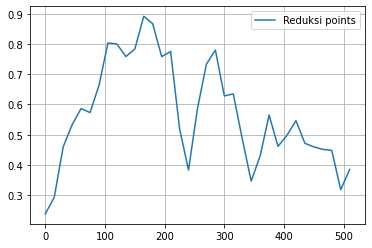

In [ ]:
LSIP_x35 = LSIP_x[0:522:15]
LSIP_y35 = LSIP_y[0:522:15]

plt.plot(LSIP_x35, LSIP_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LSIP_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_LSIP_35: [0.23833333 0.17261981 0.47892704 0.52424833 0.61274931 0.54475444
 0.64823291 0.8423139  0.8025115  0.74764009 0.75692812 0.92464744
 0.89448212 0.69742406 0.86582162 0.48928945 0.29702058 0.62262824
 0.73246648 0.84750583 0.55751019 0.69245341 0.48267618 0.29684186
 0.40995639 0.64333258 0.4067133  0.49981421 0.58402984 0.44406643
 0.46970443 0.43711586 0.51007091 0.17329788 0.385      0.
 0.         0.         0.        ]
k_LSIP_35: 3



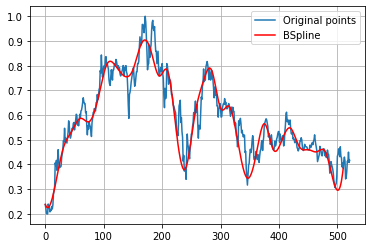

In [ ]:
import scipy.interpolate as interpolate

t_LSIP_35, c_LSIP_35, k_LSIP_35 = interpolate.splrep(LSIP_x35, LSIP_y35, s=0, k=3)
print('''\
t_LSIP_35: {}
c_LSIP_35: {}
k_LSIP_35: {}
'''.format(t_LSIP_35, c_LSIP_35, k_LSIP_35))
N = 522
xmin_LSIP_35, xmax_LSIP_35 = LSIP_x35.min(), LSIP_x35.max()
xx_LSIP_35 = np.linspace(xmin_LSIP_35, xmax_LSIP_35, N)
spline_LSIP_35 = interpolate.BSpline(t_LSIP_35, c_LSIP_35, k_LSIP_35, extrapolate=False)

plt.plot(LSIP_x, LSIP_y, label='Original points')
plt.plot(xx_LSIP_35, spline_LSIP_35(xx_LSIP_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA LSIP**

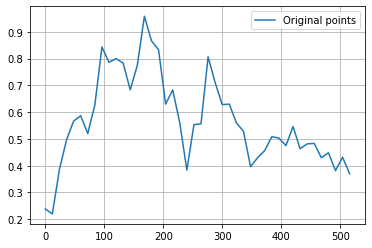

In [ ]:
LSIP_x45 = LSIP_x[0:522:12]
LSIP_y45 = LSIP_y[0:522:12]

plt.plot(LSIP_x45, LSIP_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LSIP_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_LSIP_45: [0.23833333 0.09544123 0.37661754 0.50049036 0.57045281 0.6176984
 0.4787536  0.5872872  0.9320976  0.74432239 0.81061283 0.81322628
 0.63648204 0.74084556 1.05013572 0.80861156 0.91541805 0.52971626
 0.74571693 0.58741602 0.264619   0.65410798 0.43894909 0.93009567
 0.68066824 0.60723139 0.66040621 0.53114376 0.57501873 0.33878131
 0.44985603 0.44179458 0.52296565 0.5163428  0.43166314 0.60700463
 0.42031833 0.49172204 0.50279351 0.39710392 0.48879081 0.2873802
 0.53172657 0.37       0.         0.         0.         0.        ]
k_LSIP_45: 3



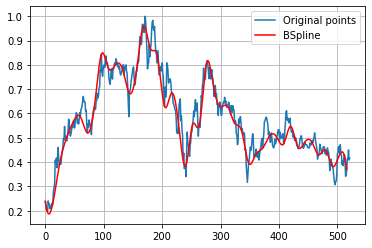

In [ ]:
import scipy.interpolate as interpolate

t_LSIP_45, c_LSIP_45, k_LSIP_45 = interpolate.splrep(LSIP_x45, LSIP_y45, s=0, k=3)
print('''\
t_LSIP_45: {}
c_LSIP_45: {}
k_LSIP_45: {}
'''.format(t_LSIP_45, c_LSIP_45, k_LSIP_45))
N = 522
xmin_LSIP_45, xmax_LSIP_45 = LSIP_x45.min(), LSIP_x45.max()
xx_LSIP_45 = np.linspace(xmin_LSIP_45, xmax_LSIP_45, N)
spline_LSIP_45 = interpolate.BSpline(t_LSIP_45, c_LSIP_45, k_LSIP_45, extrapolate=False)

plt.plot(LSIP_x, LSIP_y, label='Original points')
plt.plot(xx_LSIP_45, spline_LSIP_45(xx_LSIP_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA LSIP**

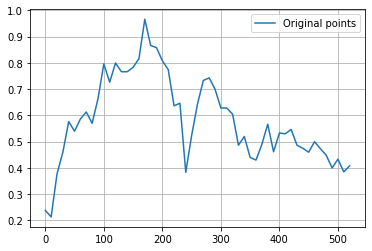

In [ ]:
LSIP_x55 = LSIP_x[0:522:10]
LSIP_y55 = LSIP_y[0:522:10]

plt.plot(LSIP_x55, LSIP_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_LSIP_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_LSIP_55: [0.23833333 0.06955681 0.40671971 0.42894821 0.63193032 0.50333051
 0.59474762 0.63767899 0.5345364  0.64417542 0.86876193 0.66077688
 0.84813056 0.74670089 0.7650659  0.79303552 0.76279203 1.05579636
 0.81402253 0.88811354 0.78352333 0.82779316 0.55530404 0.77099067
 0.24073328 0.56607622 0.63496186 0.75407635 0.74873275 0.71099266
 0.6072966  0.62982093 0.64341969 0.42650031 0.57057906 0.41118345
 0.42468715 0.47006797 0.63504099 0.38976809 0.57588666 0.50668529
 0.5773722  0.46382591 0.48732416 0.43687743 0.5251661  0.46245815
 0.46500129 0.36753669 0.49729035 0.31093816 0.40833333 0.
 0.         0.         0.        ]
k_LSIP_55: 3



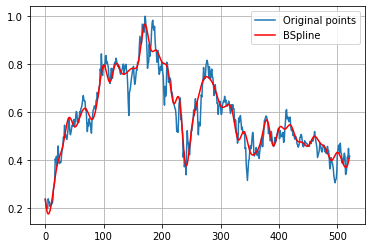

In [ ]:
import scipy.interpolate as interpolate

t_LSIP_55, c_LSIP_55, k_LSIP_55 = interpolate.splrep(LSIP_x55, LSIP_y55, s=0, k=3)
print('''\
t_LSIP_55: {}
c_LSIP_55: {}
k_LSIP_55: {}
'''.format(t_LSIP_55, c_LSIP_55, k_LSIP_55))
N = 522
xmin_LSIP_55, xmax_LSIP_55 = LSIP_x55.min(), LSIP_x55.max()
xx_LSIP_55 = np.linspace(xmin_LSIP_55, xmax_LSIP_55, N)
spline_LSIP_55 = interpolate.BSpline(t_LSIP_55, c_LSIP_55, k_LSIP_55, extrapolate=False)

plt.plot(LSIP_x, LSIP_y, label='Original points')
plt.plot(xx_LSIP_55, spline_LSIP_55(xx_LSIP_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA LSIP**


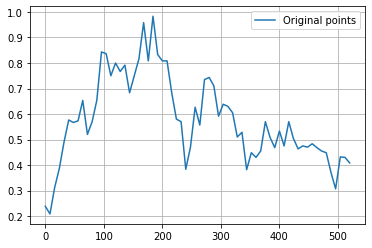

In [ ]:
LSIP_x65 = LSIP_x[0:522:8]
LSIP_y65 = LSIP_y[0:522:8]

plt.plot(LSIP_x65, LSIP_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_LSIP_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_LSIP_65: [0.23833333 0.1236818  0.31096974 0.37548984 0.49094087 0.60074666
 0.56607248 0.53496342 0.73407383 0.44874124 0.5909612  0.60741395
 0.89938301 0.85505401 0.70040093 0.84334225 0.72623006 0.85173751
 0.61681992 0.78098283 0.75924877 1.08202211 0.66266279 1.11732675
 0.76803023 0.81055233 0.83976044 0.68040592 0.53861587 0.64513058
 0.30086179 0.45142225 0.71344921 0.4547809  0.80742718 0.7255104
 0.75053124 0.53236465 0.67001018 0.61759463 0.63961132 0.45396011
 0.60454823 0.29784695 0.49406396 0.41589722 0.42234716 0.62471413
 0.49879631 0.43010063 0.59080117 0.40669467 0.63242013 0.4836248
 0.45308067 0.4840525

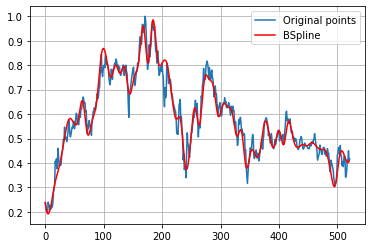

In [ ]:
import scipy.interpolate as interpolate

t_LSIP_65, c_LSIP_65, k_LSIP_65 = interpolate.splrep(LSIP_x65, LSIP_y65, s=0, k=3)
print('''\
t_LSIP_65: {}
c_LSIP_65: {}
k_LSIP_65: {}
'''.format(t_LSIP_65, c_LSIP_65, k_LSIP_65))
N = 522
xmin_LSIP_65, xmax_LSIP_65 = LSIP_x65.min(), LSIP_x65.max()
xx_LSIP_65 = np.linspace(xmin_LSIP_65, xmax_LSIP_65, N)
spline_LSIP_65 = interpolate.BSpline(t_LSIP_65, c_LSIP_65, k_LSIP_65, extrapolate=False)

plt.plot(LSIP_x, LSIP_y, label='Original points')
plt.plot(xx_LSIP_65, spline_LSIP_65(xx_LSIP_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE LSIP**

In [ ]:

#RMSE 15 DATA LSIP
y_true_LSIP_15 = LSIP_y.tolist()
y_pred_LSIP_15 = spline_LSIP_15(xx_LSIP_15).tolist()
mse_LSIP_15 = mean_squared_error(y_true_LSIP_15, y_pred_LSIP_15)
rmse_LSIP_15 = np.sqrt(mse_LSIP_15)
print("rmse LSIP 15 =",rmse_LSIP_15)

#RMSE 25 DATA LSIP
y_true_LSIP_25 = LSIP_y.tolist()
y_pred_LSIP_25 = spline_LSIP_25(xx_LSIP_25).tolist()
mse_LSIP_25 = mean_squared_error(y_true_LSIP_25, y_pred_LSIP_25)
rmse_LSIP_25 = np.sqrt(mse_LSIP_25)
print("rmse LSIP 25 =",rmse_LSIP_25)

#RMSE 35 DATA LSIP
y_true_LSIP_35 = LSIP_y.tolist()
y_pred_LSIP_35 = spline_LSIP_35(xx_LSIP_35).tolist()
mse_LSIP_35 = mean_squared_error(y_true_LSIP_35, y_pred_LSIP_35)
rmse_LSIP_35 = np.sqrt(mse_LSIP_35)
print("rmse LSIP 35 =",rmse_LSIP_35)

#RMSE 45 DATA LSIP
y_true_LSIP_45 = LSIP_y.tolist()
y_pred_LSIP_45 = spline_LSIP_45(xx_LSIP_45).tolist()
mse_LSIP_45 = mean_squared_error(y_true_LSIP_45, y_pred_LSIP_45)
rmse_LSIP_45 = np.sqrt(mse_LSIP_45)
print("rmse LSIP 45 =",rmse_LSIP_45)

#RMSE 55 DATA LSIP
y_true_LSIP_55 = LSIP_y.tolist()
y_pred_LSIP_55 = spline_LSIP_55(xx_LSIP_55).tolist()
mse_LSIP_55 = mean_squared_error(y_true_LSIP_55, y_pred_LSIP_55)
rmse_LSIP_55 = np.sqrt(mse_LSIP_55)
print("rmse LSIP 55 =",rmse_LSIP_55)

#RMSE 65 DATA LSIP
y_true_LSIP_65 = LSIP_y.tolist()
y_pred_LSIP_65 = spline_LSIP_65(xx_LSIP_65).tolist()
mse_LSIP_65 = mean_squared_error(y_true_LSIP_65, y_pred_LSIP_65)
rmse_LSIP_65 = np.sqrt(mse_LSIP_65)
print("rmse LSIP 65 =",rmse_LSIP_65)


rmse LSIP 15 = 0.09758893642892624
rmse LSIP 25 = 0.07539073832089538
rmse LSIP 35 = 0.05794009881384191
rmse LSIP 45 = 0.050642095132260145
rmse LSIP 55 = 0.04535730814136291
rmse LSIP 65 = 0.03657212302162757


# **MAIN**

No handles with labels found to put in legend.


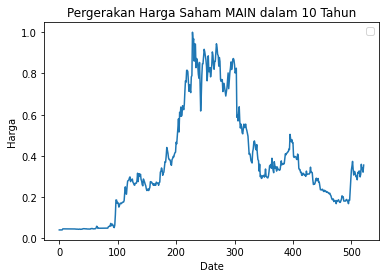

In [ ]:
MAIN = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/MAIN.JK.csv')

MAIN_x = MAIN['No'].values
MAIN_y = MAIN['Skala'].values

plt.plot(MAIN_x,MAIN_y)
plt.title('Pergerakan Harga Saham MAIN dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA MAIN**

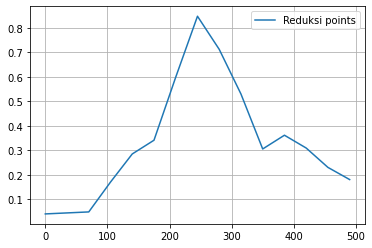

In [ ]:
MAIN_x15 = MAIN_x[0:522:35]
MAIN_y15 = MAIN_y[0:522:35]

plt.plot(MAIN_x15, MAIN_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAIN_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_MAIN_15: [ 0.04076433  0.08350204 -0.03248178  0.17305388  0.31308618  0.28670332
  0.58850819  0.95162063  0.68781185  0.56974344  0.21283222  0.41332259
  0.26832988  0.20437009  0.18089172  0.          0.          0.
  0.        ]
k_MAIN_15: 3



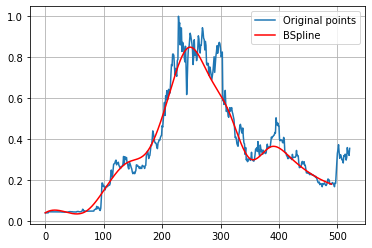

In [ ]:
import scipy.interpolate as interpolate

t_MAIN_15, c_MAIN_15, k_MAIN_15 = interpolate.splrep(MAIN_x15, MAIN_y15, s=0, k=3)
print('''\
t_MAIN_15: {}
c_MAIN_15: {}
k_MAIN_15: {}
'''.format(t_MAIN_15, c_MAIN_15, k_MAIN_15))
N = 522
xmin_MAIN_15, xmax_MAIN_15 = MAIN_x15.min(), MAIN_x15.max()
xx_MAIN_15 = np.linspace(xmin_MAIN_15, xmax_MAIN_15, N)
spline_MAIN_15 = interpolate.BSpline(t_MAIN_15, c_MAIN_15, k_MAIN_15, extrapolate=False)

plt.plot(MAIN_x, MAIN_y, label='Original points')
plt.plot(xx_MAIN_15, spline_MAIN_15(xx_MAIN_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA MAIN**

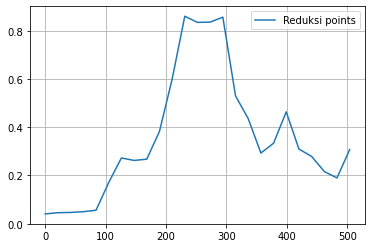

In [ ]:
MAIN_x25 = MAIN_x[0:522:21]
MAIN_y25 = MAIN_y[0:522:21]

plt.plot(MAIN_x25, MAIN_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAIN_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_MAIN_25: [0.04076433 0.04977385 0.04007014 0.05726209 0.02620136 0.17423822
 0.3010496  0.25723216 0.24454405 0.36968717 0.56970091 0.94386588
 0.81407122 0.80621866 0.97506689 0.4298195  0.48527296 0.24310141
 0.3002832  0.55831358 0.24862809 0.30449889 0.17484929 0.16130147
 0.30700637 0.         0.         0.         0.        ]
k_MAIN_25: 3



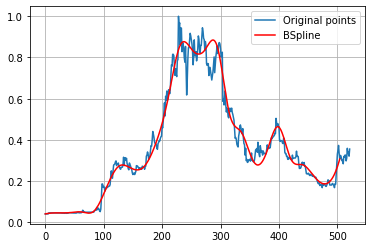

In [ ]:
import scipy.interpolate as interpolate

t_MAIN_25, c_MAIN_25, k_MAIN_25 = interpolate.splrep(MAIN_x25, MAIN_y25, s=0, k=3)
print('''\
t_MAIN_25: {}
c_MAIN_25: {}
k_MAIN_25: {}
'''.format(t_MAIN_25, c_MAIN_25, k_MAIN_25))
N = 522
xmin_MAIN_25, xmax_MAIN_25 = MAIN_x25.min(), MAIN_x25.max()
xx_MAIN_25 = np.linspace(xmin_MAIN_25, xmax_MAIN_25, N)
spline_MAIN_25 = interpolate.BSpline(t_MAIN_25, c_MAIN_25, k_MAIN_25, extrapolate=False)

plt.plot(MAIN_x, MAIN_y, label='Original points')
plt.plot(xx_MAIN_25, spline_MAIN_25(xx_MAIN_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA MAIN**

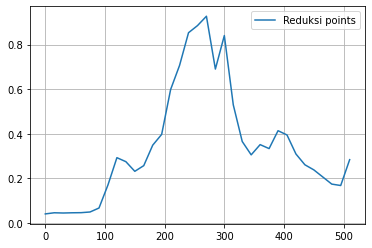

In [ ]:
MAIN_x35 = MAIN_x[0:522:15]
MAIN_y35 = MAIN_y[0:522:15]

plt.plot(MAIN_x35, MAIN_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAIN_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_MAIN_35: [0.04076433 0.04879438 0.04304819 0.04651052 0.0452034  0.05089245
 0.04778731 0.16152519 0.33031577 0.27517353 0.21994553 0.23612717
 0.37949484 0.34016099 0.64457459 0.67389735 0.90187424 0.83962481
 1.05172843 0.51779266 1.01977607 0.44768904 0.36908561 0.2695991
 0.38691291 0.29230341 0.44642121 0.40608817 0.29865286 0.25662524
 0.24172515 0.2057735  0.16260535 0.14035338 0.28407643 0.
 0.         0.         0.        ]
k_MAIN_35: 3



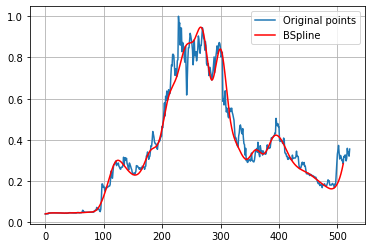

In [ ]:
import scipy.interpolate as interpolate

t_MAIN_35, c_MAIN_35, k_MAIN_35 = interpolate.splrep(MAIN_x35, MAIN_y35, s=0, k=3)
print('''\
t_MAIN_35: {}
c_MAIN_35: {}
k_MAIN_35: {}
'''.format(t_MAIN_35, c_MAIN_35, k_MAIN_35))
N = 522
xmin_MAIN_35, xmax_MAIN_35 = MAIN_x35.min(), MAIN_x35.max()
xx_MAIN_35 = np.linspace(xmin_MAIN_35, xmax_MAIN_35, N)
spline_MAIN_35 = interpolate.BSpline(t_MAIN_35, c_MAIN_35, k_MAIN_35, extrapolate=False)

plt.plot(MAIN_x, MAIN_y, label='Original points')
plt.plot(xx_MAIN_35, spline_MAIN_35(xx_MAIN_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA MAIN**

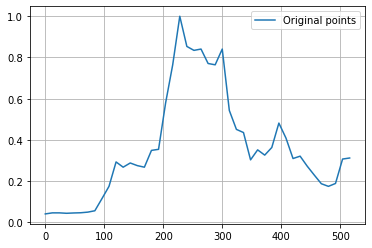

In [ ]:
MAIN_x45 = MAIN_x[0:522:12]
MAIN_y45 = MAIN_y[0:522:12]

plt.plot(MAIN_x45, MAIN_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAIN_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_MAIN_45: [0.04076433 0.04617642 0.04777455 0.04256323 0.04620528 0.04471754
 0.0531411  0.03927856 0.1260504  0.14441794 0.34341159 0.23989748
 0.30209404 0.2791149  0.23240177 0.39637356 0.2763715  0.6229812
 0.7094107  1.12536324 0.78913632 0.83911059 0.86079073 0.76231247
 0.71416323 0.96702189 0.46233519 0.4396883  0.48464408 0.23574813
 0.3914717  0.30791922 0.33353931 0.53626749 0.41056271 0.27498487
 0.34682266 0.26383914 0.23348956 0.1779988  0.17808213 0.14971453
 0.41399624 0.31210191 0.         0.         0.         0.        ]
k_MAIN_45: 3



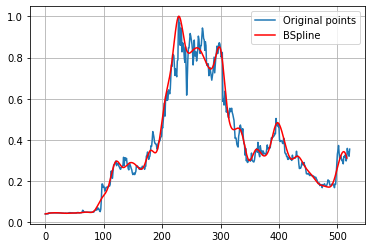

In [ ]:
import scipy.interpolate as interpolate

t_MAIN_45, c_MAIN_45, k_MAIN_45 = interpolate.splrep(MAIN_x45, MAIN_y45, s=0, k=3)
print('''\
t_MAIN_45: {}
c_MAIN_45: {}
k_MAIN_45: {}
'''.format(t_MAIN_45, c_MAIN_45, k_MAIN_45))
N = 522
xmin_MAIN_45, xmax_MAIN_45 = MAIN_x45.min(), MAIN_x45.max()
xx_MAIN_45 = np.linspace(xmin_MAIN_45, xmax_MAIN_45, N)
spline_MAIN_45 = interpolate.BSpline(t_MAIN_45, c_MAIN_45, k_MAIN_45, extrapolate=False)

plt.plot(MAIN_x, MAIN_y, label='Original points')
plt.plot(xx_MAIN_45, spline_MAIN_45(xx_MAIN_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA MAIN**

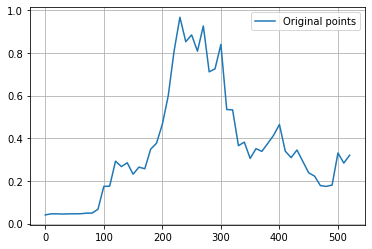

In [ ]:
MAIN_x55 = MAIN_x[0:522:10]
MAIN_y55 = MAIN_y[0:522:10]

plt.plot(MAIN_x55, MAIN_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_MAIN_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_MAIN_55: [0.04076433 0.04670924 0.0467089  0.0441617  0.04632567 0.04569485
 0.04605415 0.04830509 0.05422866 0.03134077 0.22397513 0.11989246
 0.3512321  0.23314091 0.32129979 0.19376184 0.29473564 0.21710451
 0.38079537 0.35398152 0.46569893 0.58067499 0.80395781 1.05699697
 0.77697153 0.95613604 0.71058622 1.05502227 0.63365591 0.68296554
 0.99116981 0.3969412  0.63125647 0.2805807  0.4400513  0.25220771
 0.38551275 0.31529544 0.38642652 0.39377557 0.52254765 0.30584276
 0.29484566 0.37209943 0.28809421 0.2258422  0.23783635 0.160392
 0.19065933 0.12410443 0.48966286 0.16026411 0.32101911 0.
 0.         0.         0.        ]
k_MAIN_55: 3



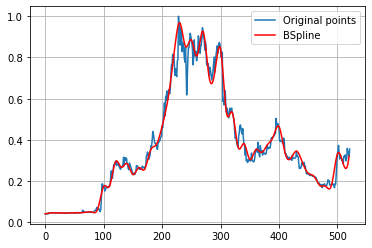

In [ ]:
import scipy.interpolate as interpolate

t_MAIN_55, c_MAIN_55, k_MAIN_55 = interpolate.splrep(MAIN_x55, MAIN_y55, s=0, k=3)
print('''\
t_MAIN_55: {}
c_MAIN_55: {}
k_MAIN_55: {}
'''.format(t_MAIN_55, c_MAIN_55, k_MAIN_55))
N = 522
xmin_MAIN_55, xmax_MAIN_55 = MAIN_x55.min(), MAIN_x55.max()
xx_MAIN_55 = np.linspace(xmin_MAIN_55, xmax_MAIN_55, N)
spline_MAIN_55 = interpolate.BSpline(t_MAIN_55, c_MAIN_55, k_MAIN_55, extrapolate=False)

plt.plot(MAIN_x, MAIN_y, label='Original points')
plt.plot(xx_MAIN_55, spline_MAIN_55(xx_MAIN_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA MAIN**

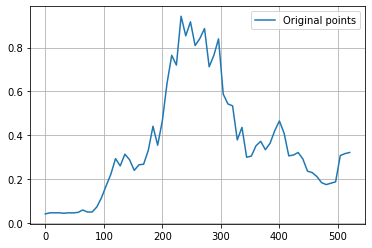

In [ ]:
MAIN_x65 = MAIN_x[0:522:8]
MAIN_y65 = MAIN_y[0:522:8]

plt.plot(MAIN_x65, MAIN_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAIN_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_MAIN_65: [0.04076433 0.04761165 0.04490409 0.04686892 0.04228825 0.046908
 0.045239   0.0442379  0.06519793 0.04656275 0.04511158 0.06955142
 0.11082285 0.17505527 0.20551658 0.33281472 0.22118633 0.34167562
 0.29236598 0.21624901 0.27958068 0.2552372  0.30456605 0.51375975
 0.28498094 0.47115726 0.62784224 0.83912982 0.60162574 1.07283857
 0.76307092 0.99589684 0.75652644 0.8315006  0.96205714 0.64001608
 0.75049002 0.94401108 0.51040831 0.53792254 0.59395248 0.28881531
 0.52084998 0.2417975  0.30813838 0.35240059 0.39181341 0.31219291
 0.36196272 0.41830016 0.48712965 0.42299015 0.27441294 0.313753
 0.32789988 0.30076211 

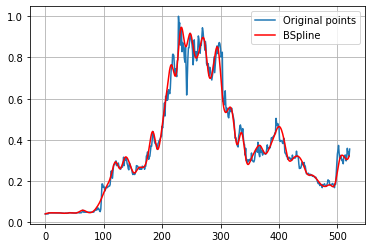

In [ ]:
import scipy.interpolate as interpolate

t_MAIN_65, c_MAIN_65, k_MAIN_65 = interpolate.splrep(MAIN_x65, MAIN_y65, s=0, k=3)
print('''\
t_MAIN_65: {}
c_MAIN_65: {}
k_MAIN_65: {}
'''.format(t_MAIN_65, c_MAIN_65, k_MAIN_65))
N = 522
xmin_MAIN_65, xmax_MAIN_65 = MAIN_x65.min(), MAIN_x65.max()
xx_MAIN_65 = np.linspace(xmin_MAIN_65, xmax_MAIN_65, N)
spline_MAIN_65 = interpolate.BSpline(t_MAIN_65, c_MAIN_65, k_MAIN_65, extrapolate=False)

plt.plot(MAIN_x, MAIN_y, label='Original points')
plt.plot(xx_MAIN_65, spline_MAIN_65(xx_MAIN_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE MAIN**

In [ ]:

#RMSE 15 DATA MAIN
y_true_MAIN_15 = MAIN_y.tolist()
y_pred_MAIN_15 = spline_MAIN_15(xx_MAIN_15).tolist()
mse_MAIN_15 = mean_squared_error(y_true_MAIN_15, y_pred_MAIN_15)
rmse_MAIN_15 = np.sqrt(mse_MAIN_15)
print("rmse MAIN 15 =",rmse_MAIN_15)

#RMSE 25 DATA MAIN
y_true_MAIN_25 = MAIN_y.tolist()
y_pred_MAIN_25 = spline_MAIN_25(xx_MAIN_25).tolist()
mse_MAIN_25 = mean_squared_error(y_true_MAIN_25, y_pred_MAIN_25)
rmse_MAIN_25 = np.sqrt(mse_MAIN_25)
print("rmse MAIN 25 =",rmse_MAIN_25)

#RMSE 35 DATA MAIN
y_true_MAIN_35 = MAIN_y.tolist()
y_pred_MAIN_35 = spline_MAIN_35(xx_MAIN_35).tolist()
mse_MAIN_35 = mean_squared_error(y_true_MAIN_35, y_pred_MAIN_35)
rmse_MAIN_35 = np.sqrt(mse_MAIN_35)
print("rmse MAIN 35 =",rmse_MAIN_35)

#RMSE 45 DATA MAIN
y_true_MAIN_45 = MAIN_y.tolist()
y_pred_MAIN_45 = spline_MAIN_45(xx_MAIN_45).tolist()
mse_MAIN_45 = mean_squared_error(y_true_MAIN_45, y_pred_MAIN_45)
rmse_MAIN_45 = np.sqrt(mse_MAIN_45)
print("rmse MAIN 45 =",rmse_MAIN_45)

#RMSE 55 DATA MAIN
y_true_MAIN_55 = MAIN_y.tolist()
y_pred_MAIN_55 = spline_MAIN_55(xx_MAIN_55).tolist()
mse_MAIN_55 = mean_squared_error(y_true_MAIN_55, y_pred_MAIN_55)
rmse_MAIN_55 = np.sqrt(mse_MAIN_55)
print("rmse MAIN 55 =",rmse_MAIN_55)

#RMSE 65 DATA MAIN
y_true_MAIN_65 = MAIN_y.tolist()
y_pred_MAIN_65 = spline_MAIN_65(xx_MAIN_65).tolist()
mse_MAIN_65 = mean_squared_error(y_true_MAIN_65, y_pred_MAIN_65)
rmse_MAIN_65 = np.sqrt(mse_MAIN_65)
print("rmse MAIN 65 =",rmse_MAIN_65)

rmse MAIN 15 = 0.08197650966978882
rmse MAIN 25 = 0.0745535866941215
rmse MAIN 35 = 0.06969974297299089
rmse MAIN 45 = 0.048029921531327374
rmse MAIN 55 = 0.037737327875956114
rmse MAIN 65 = 0.035001769612239025


# **MAPI**

No handles with labels found to put in legend.


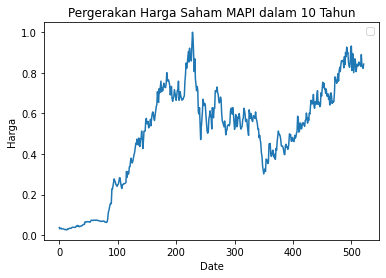

In [ ]:
MAPI = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/MAPI.JK.csv')

MAPI_x = MAPI['No'].values
MAPI_y = MAPI['Skala'].values

plt.plot(MAPI_x,MAPI_y)
plt.title('Pergerakan Harga Saham MAPI dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA MAPI**

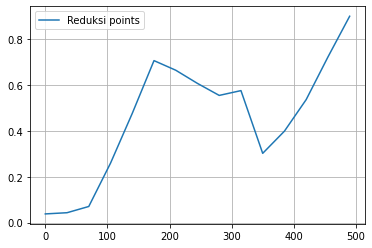

In [ ]:
MAPI_x15 = MAPI_x[0:522:35]
MAPI_y15 = MAPI_y[0:522:35]

plt.plot(MAPI_x15, MAPI_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAPI_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_MAPI_15: [ 0.03769634  0.08495197 -0.0521029   0.26899205  0.4508348   0.78630751
  0.64477288  0.62412979  0.50268702  0.69496504  0.17295018  0.42579967
  0.54815799  0.81165399  0.90052356  0.          0.          0.
  0.        ]
k_MAPI_15: 3



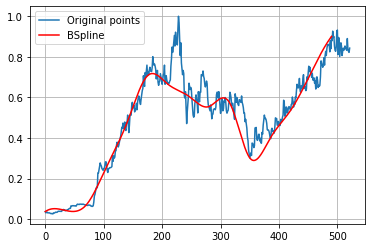

In [ ]:
import scipy.interpolate as interpolate

t_MAPI_15, c_MAPI_15, k_MAPI_15 = interpolate.splrep(MAPI_x15, MAPI_y15, s=0, k=3)
print('''\
t_MAPI_15: {}
c_MAPI_15: {}
k_MAPI_15: {}
'''.format(t_MAPI_15, c_MAPI_15, k_MAPI_15))
N = 522
xmin_MAPI_15, xmax_MAPI_15 = MAPI_x15.min(), MAPI_x15.max()
xx_MAPI_15 = np.linspace(xmin_MAPI_15, xmax_MAPI_15, N)
spline_MAPI_15 = interpolate.BSpline(t_MAPI_15, c_MAPI_15, k_MAPI_15, extrapolate=False)

plt.plot(MAPI_x, MAPI_y, label='Original points')
plt.plot(xx_MAPI_15, spline_MAPI_15(xx_MAPI_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA MAPI**

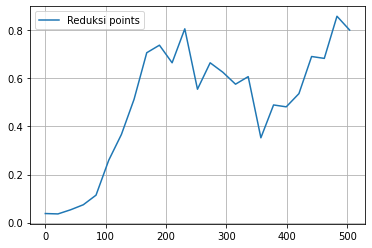

In [ ]:
MAPI_x25 = MAPI_x[0:522:21]
MAPI_y25 = MAPI_y[0:522:21]

plt.plot(MAPI_x25, MAPI_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_MAPI_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_MAPI_25: [0.03769633 0.0275538  0.04384528 0.07794936 0.08190458 0.27924909
 0.35607288 0.49541228 0.74081203 0.78217731 0.5597981  0.96815909
 0.40526188 0.74063634 0.62172157 0.52640408 0.72815948 0.20493707
 0.56936972 0.45475684 0.50165529 0.75851729 0.56165747 1.06537545
 0.80104712 0.         0.         0.         0.        ]
k_MAPI_25: 3



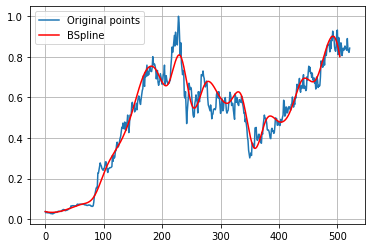

In [ ]:
import scipy.interpolate as interpolate

t_MAPI_25, c_MAPI_25, k_MAPI_25 = interpolate.splrep(MAPI_x25, MAPI_y25, s=0, k=3)
print('''\
t_MAPI_25: {}
c_MAPI_25: {}
k_MAPI_25: {}
'''.format(t_MAPI_25, c_MAPI_25, k_MAPI_25))
N = 522
xmin_MAPI_25, xmax_MAPI_25 = MAPI_x25.min(), MAPI_x25.max()
xx_MAPI_25 = np.linspace(xmin_MAPI_25, xmax_MAPI_25, N)
spline_MAPI_25 = interpolate.BSpline(t_MAPI_25, c_MAPI_25, k_MAPI_25, extrapolate=False)

plt.plot(MAPI_x, MAPI_y, label='Original points')
plt.plot(xx_MAPI_25, spline_MAPI_25(xx_MAPI_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA MAPI**

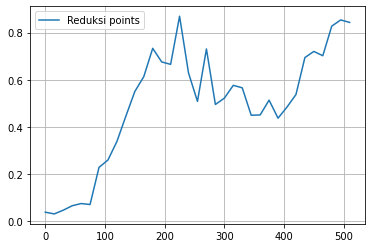

In [ ]:
MAPI_x35 = MAPI_x[0:522:15]
MAPI_y35 = MAPI_y[0:522:15]

plt.plot(MAPI_x35, MAPI_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAPI_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_MAPI_35: [0.03769633 0.01895092 0.04167931 0.06243741 0.09291034 0.01199454
 0.28005392 0.23428194 0.33779216 0.44072745 0.56945512 0.5798814
 0.78641194 0.67237659 0.5764377  1.0114014  0.59261641 0.38776649
 0.90343807 0.38068019 0.54242755 0.57840542 0.59944816 0.4164721
 0.42995141 0.56529295 0.38741084 0.50495898 0.49537103 0.73345219
 0.73312386 0.6534241  0.93233042 0.82310181 0.84293194 0.
 0.         0.         0.        ]
k_MAPI_35: 3



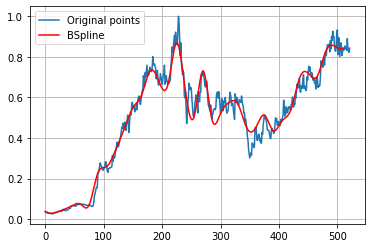

In [ ]:
import scipy.interpolate as interpolate

t_MAPI_35, c_MAPI_35, k_MAPI_35 = interpolate.splrep(MAPI_x35, MAPI_y35, s=0, k=3)
print('''\
t_MAPI_35: {}
c_MAPI_35: {}
k_MAPI_35: {}
'''.format(t_MAPI_35, c_MAPI_35, k_MAPI_35))
N = 522
xmin_MAPI_35, xmax_MAPI_35 = MAPI_x35.min(), MAPI_x35.max()
xx_MAPI_35 = np.linspace(xmin_MAPI_35, xmax_MAPI_35, N)
spline_MAPI_35 = interpolate.BSpline(t_MAPI_35, c_MAPI_35, k_MAPI_35, extrapolate=False)

plt.plot(MAPI_x, MAPI_y, label='Original points')
plt.plot(xx_MAPI_35, spline_MAPI_35(xx_MAPI_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA MAPI**

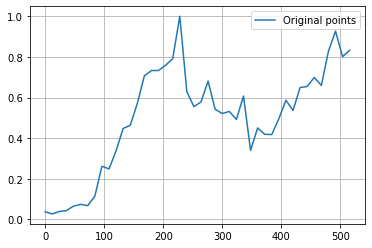

In [ ]:
MAPI_x45 = MAPI_x[0:522:12]
MAPI_y45 = MAPI_y[0:522:12]

plt.plot(MAPI_x45, MAPI_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAPI_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_MAPI_45: [0.03769634 0.01236859 0.04568168 0.03754206 0.07005935 0.07803205
 0.06388574 0.07480194 0.32172326 0.20898566 0.33448068 0.47926961
 0.43430474 0.56361615 0.73531442 0.73596385 0.71873594 0.78699816
 0.68824523 1.2034764  0.49784917 0.57476043 0.53295203 0.76463563
 0.49227508 0.51757295 0.56622894 0.40599298 0.76267874 0.18727111
 0.53012162 0.3938131  0.40771497 0.48213328 0.64176239 0.46914179
 0.70156575 0.61988319 0.74560308 0.59142176 0.84682505 1.0305634
 0.64702196 0.83246073 0.         0.         0.         0.        ]
k_MAPI_45: 3



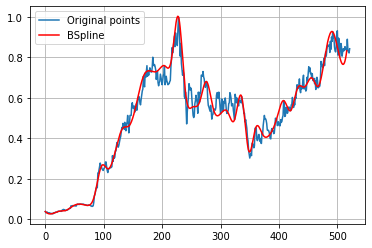

In [ ]:
import scipy.interpolate as interpolate

t_MAPI_45, c_MAPI_45, k_MAPI_45 = interpolate.splrep(MAPI_x45, MAPI_y45, s=0, k=3)
print('''\
t_MAPI_45: {}
c_MAPI_45: {}
k_MAPI_45: {}
'''.format(t_MAPI_45, c_MAPI_45, k_MAPI_45))
N = 522
xmin_MAPI_45, xmax_MAPI_45 = MAPI_x45.min(), MAPI_x45.max()
xx_MAPI_45 = np.linspace(xmin_MAPI_45, xmax_MAPI_45, N)
spline_MAPI_45 = interpolate.BSpline(t_MAPI_45, c_MAPI_45, k_MAPI_45, extrapolate=False)

plt.plot(MAPI_x, MAPI_y, label='Original points')
plt.plot(xx_MAPI_45, spline_MAPI_45(xx_MAPI_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA MAPI**


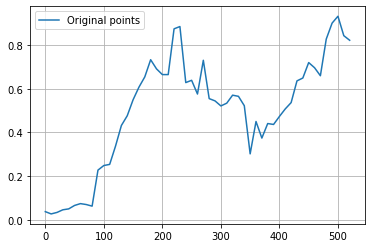

In [ ]:
MAPI_x55 = MAPI_x[0:522:10]
MAPI_y55 = MAPI_y[0:522:10]

plt.plot(MAPI_x55, MAPI_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAPI_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_MAPI_55: [0.03769634 0.02306224 0.02691218 0.0495532  0.04565455 0.06939926
 0.07255991 0.08643439 0.00264495 0.27994918 0.2440505  0.23599543
 0.33552799 0.44807062 0.46381256 0.55531787 0.61334528 0.63528008
 0.77223597 0.6736818  0.67963368 0.59731226 0.92064608 0.96617674
 0.52354749 0.7092668  0.47184606 0.85884636 0.47496745 0.57112675
 0.50754124 0.5275041  0.58663086 0.55005623 0.60581436 0.16176487
 0.55969161 0.30103938 0.48222418 0.41509009 0.47731074 0.51545753
 0.50797956 0.67251952 0.61869629 0.7479833  0.70874226 0.59505815
 0.86914034 0.89173128 0.99219078 0.75128681 0.82198953 0.
 0.         0.         0.        ]
k_MAPI_55: 3



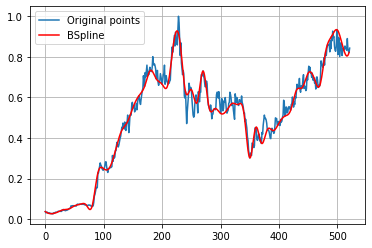

In [ ]:
import scipy.interpolate as interpolate

t_MAPI_55, c_MAPI_55, k_MAPI_55 = interpolate.splrep(MAPI_x55, MAPI_y55, s=0, k=3)
print('''\
t_MAPI_55: {}
c_MAPI_55: {}
k_MAPI_55: {}
'''.format(t_MAPI_55, c_MAPI_55, k_MAPI_55))
N = 522
xmin_MAPI_55, xmax_MAPI_55 = MAPI_x55.min(), MAPI_x55.max()
xx_MAPI_55 = np.linspace(xmin_MAPI_55, xmax_MAPI_55, N)
spline_MAPI_55 = interpolate.BSpline(t_MAPI_55, c_MAPI_55, k_MAPI_55, extrapolate=False)

plt.plot(MAPI_x, MAPI_y, label='Original points')
plt.plot(xx_MAPI_55, spline_MAPI_55(xx_MAPI_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA MAPI**


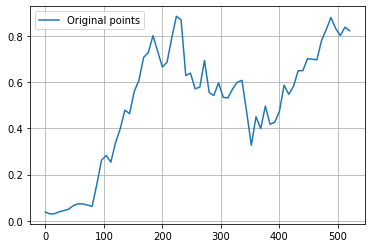

In [ ]:
MAPI_x65 = MAPI_x[0:522:8]
MAPI_y65 = MAPI_y[0:522:8]

plt.plot(MAPI_x65, MAPI_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MAPI_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_MAPI_65: [0.03769633 0.02983888 0.02540078 0.04038923 0.0448973  0.04703729
 0.06852424 0.07467728 0.07255721 0.07488446 0.03628192 0.15695122
 0.27832158 0.30044309 0.21624115 0.35815252 0.37732679 0.51997488
 0.41711925 0.59165281 0.57752603 0.74222212 0.6944232  0.84657722
 0.72555064 0.64912597 0.66747426 0.79616023 0.89134033 0.94737898
 0.53380342 0.68704083 0.55049399 0.53506697 0.78044232 0.50546742
 0.52753093 0.63571776 0.51074986 0.52547128 0.5758467  0.59522568
 0.64010923 0.48831645 0.23385008 0.53649266 0.32174998 0.5702247
 0.37536168 0.43513484 0.44116701 0.6399877  0.5172068  0.57390763
 0.67407367 0.625085

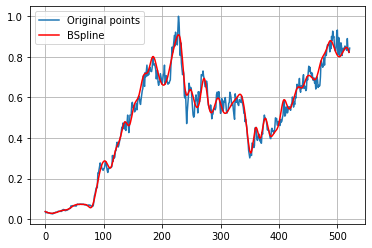

In [ ]:
import scipy.interpolate as interpolate

t_MAPI_65, c_MAPI_65, k_MAPI_65 = interpolate.splrep(MAPI_x65, MAPI_y65, s=0, k=3)
print('''\
t_MAPI_65: {}
c_MAPI_65: {}
k_MAPI_65: {}
'''.format(t_MAPI_65, c_MAPI_65, k_MAPI_65))
N = 522
xmin_MAPI_65, xmax_MAPI_65 = MAPI_x65.min(), MAPI_x65.max()
xx_MAPI_65 = np.linspace(xmin_MAPI_65, xmax_MAPI_65, N)
spline_MAPI_65 = interpolate.BSpline(t_MAPI_65, c_MAPI_65, k_MAPI_65, extrapolate=False)

plt.plot(MAPI_x, MAPI_y, label='Original points')
plt.plot(xx_MAPI_65, spline_MAPI_65(xx_MAPI_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE MAPI**

In [ ]:

#RMSE 15 DATA MAPI
y_true_MAPI_15 = MAPI_y.tolist()
y_pred_MAPI_15 = spline_MAPI_15(xx_MAPI_15).tolist()
mse_MAPI_15 = mean_squared_error(y_true_MAPI_15, y_pred_MAPI_15)
rmse_MAPI_15 = np.sqrt(mse_MAPI_15)
print("rmse MAPI 15 =",rmse_MAPI_15)

#RMSE 25 DATA MAPI
y_true_MAPI_25 = MAPI_y.tolist()
y_pred_MAPI_25 = spline_MAPI_25(xx_MAPI_25).tolist()
mse_MAPI_25 = mean_squared_error(y_true_MAPI_25, y_pred_MAPI_25)
rmse_MAPI_25 = np.sqrt(mse_MAPI_25)
print("rmse MAPI 25 =",rmse_MAPI_25)

#RMSE 35 DATA MAPI
y_true_MAPI_35 = MAPI_y.tolist()
y_pred_MAPI_35 = spline_MAPI_35(xx_MAPI_35).tolist()
mse_MAPI_35 = mean_squared_error(y_true_MAPI_35, y_pred_MAPI_35)
rmse_MAPI_35 = np.sqrt(mse_MAPI_35)
print("rmse MAPI 35 =",rmse_MAPI_35)

#RMSE 45 DATA MAPI
y_true_MAPI_45 = MAPI_y.tolist()
y_pred_MAPI_45 = spline_MAPI_45(xx_MAPI_45).tolist()
mse_MAPI_45 = mean_squared_error(y_true_MAPI_45, y_pred_MAPI_45)
rmse_MAPI_45 = np.sqrt(mse_MAPI_45)
print("rmse MAPI 45 =",rmse_MAPI_45)

#RMSE 55 DATA MAPI
y_true_MAPI_55 = MAPI_y.tolist()
y_pred_MAPI_55 = spline_MAPI_55(xx_MAPI_55).tolist()
mse_MAPI_55 = mean_squared_error(y_true_MAPI_55, y_pred_MAPI_55)
rmse_MAPI_55 = np.sqrt(mse_MAPI_55)
print("rmse MAPI 55 =",rmse_MAPI_55)

#RMSE 65 DATA MAPI
y_true_MAPI_65 = MAPI_y.tolist()
y_pred_MAPI_65 = spline_MAPI_65(xx_MAPI_65).tolist()
mse_MAPI_65 = mean_squared_error(y_true_MAPI_65, y_pred_MAPI_65)
rmse_MAPI_65 = np.sqrt(mse_MAPI_65)
print("rmse MAPI 65 =",rmse_MAPI_65)

rmse MAPI 15 = 0.08800046766149108
rmse MAPI 25 = 0.07939350763758281
rmse MAPI 35 = 0.05628159788625497
rmse MAPI 45 = 0.051288852370870025
rmse MAPI 55 = 0.03488097096432372
rmse MAPI 65 = 0.033674810508211


# **MNCN**

No handles with labels found to put in legend.


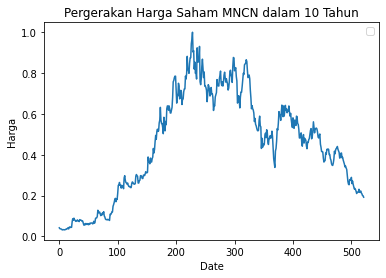

In [ ]:
MNCN = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/MNCN.JK.csv')

MNCN_x = MNCN['No'].values
MNCN_y = MNCN['Skala'].values

plt.plot(MNCN_x,MNCN_y)
plt.title('Pergerakan Harga Saham MNCN dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA MNCN**

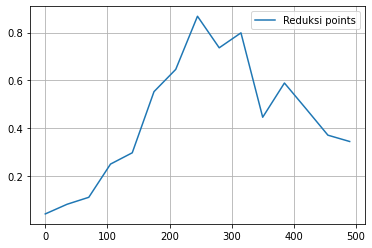

In [ ]:
MNCN_x15 = MNCN_x[0:522:35]
MNCN_y15 = MNCN_y[0:522:35]

plt.plot(MNCN_x15, MNCN_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MNCN_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_MNCN_15: [ 0.04166667  0.13024722 -0.00910555  0.30509351  0.21018174  0.63751287
  0.55643346  1.0117533   0.60488669  0.98536662  0.2453135   0.70837936
  0.36987672  0.3504783   0.34444444  0.          0.          0.
  0.        ]
k_MNCN_15: 3



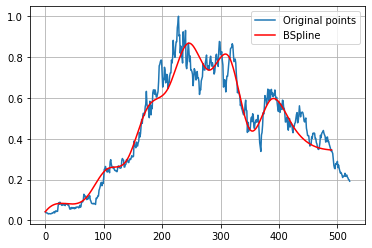

In [ ]:
import scipy.interpolate as interpolate

t_MNCN_15, c_MNCN_15, k_MNCN_15 = interpolate.splrep(MNCN_x15, MNCN_y15, s=0, k=3)
print('''\
t_MNCN_15: {}
c_MNCN_15: {}
k_MNCN_15: {}
'''.format(t_MNCN_15, c_MNCN_15, k_MNCN_15))
N = 522
xmin_MNCN_15, xmax_MNCN_15 = MNCN_x15.min(), MNCN_x15.max()
xx_MNCN_15 = np.linspace(xmin_MNCN_15, xmax_MNCN_15, N)
spline_MNCN_15 = interpolate.BSpline(t_MNCN_15, c_MNCN_15, k_MNCN_15, extrapolate=False)

plt.plot(MNCN_x, MNCN_y, label='Original points')
plt.plot(xx_MNCN_15, spline_MNCN_15(xx_MNCN_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA MNCN**

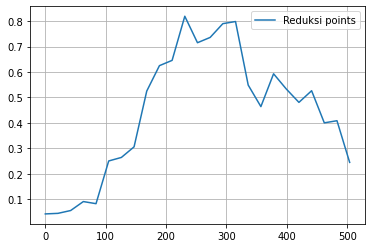

In [ ]:
MNCN_x25 = MNCN_x[0:522:21]
MNCN_y25 = MNCN_y[0:522:21]

plt.plot(MNCN_x25, MNCN_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MNCN_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_MNCN_25: [0.04166667 0.0560261  0.01517002 0.12104126 0.01586379 0.30717025
 0.25545523 0.25434218 0.5605094  0.65362023 0.5750097  0.92134098
 0.65629303 0.74515356 0.77975938 0.87747559 0.50200493 0.40617137
 0.65664292 0.52559027 0.44099599 0.59375909 0.25848159 0.52631476
 0.24444444 0.         0.         0.         0.        ]
k_MNCN_25: 3



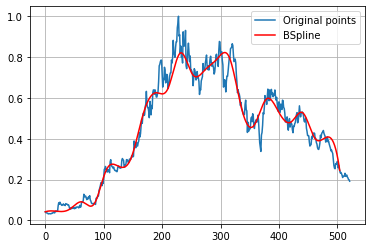

In [ ]:
import scipy.interpolate as interpolate

t_MNCN_25, c_MNCN_25, k_MNCN_25 = interpolate.splrep(MNCN_x25, MNCN_y25, s=0, k=3)
print('''\
t_MNCN_25: {}
c_MNCN_25: {}
k_MNCN_25: {}
'''.format(t_MNCN_25, c_MNCN_25, k_MNCN_25))
N = 522
xmin_MNCN_25, xmax_MNCN_25 = MNCN_x25.min(), MNCN_x25.max()
xx_MNCN_25 = np.linspace(xmin_MNCN_25, xmax_MNCN_25, N)
spline_MNCN_25 = interpolate.BSpline(t_MNCN_25, c_MNCN_25, k_MNCN_25, extrapolate=False)

plt.plot(MNCN_x, MNCN_y, label='Original points')
plt.plot(xx_MNCN_25, spline_MNCN_25(xx_MNCN_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA MNCN**

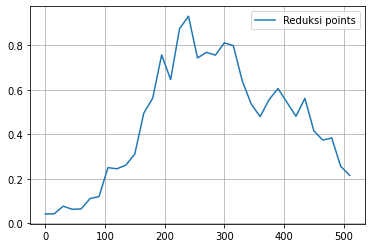

In [ ]:
MNCN_x35 = MNCN_x[0:522:15]
MNCN_y35 = MNCN_y[0:522:15]

plt.plot(MNCN_x35, MNCN_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_MNCN_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_MNCN_35: [0.04166667 0.00447039 0.10092034 0.05947598 0.04653684 0.13770999
 0.06928985 0.30179727 0.22352108 0.27078509 0.26000523 0.55586066
 0.48321879 0.8862642  0.5133911  0.93517142 0.99592322 0.66446904
 0.80453395 0.72572849 0.82588542 0.83739649 0.61619529 0.53948902
 0.44251529 0.56544983 0.62901874 0.55180855 0.42208039 0.64320321
 0.37177345 0.36136967 0.44542948 0.1387436  0.21527778 0.
 0.         0.         0.        ]
k_MNCN_35: 3



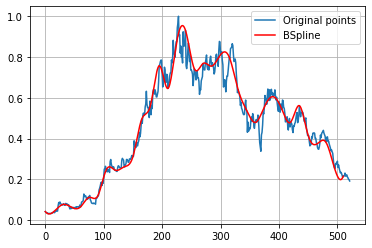

In [ ]:
import scipy.interpolate as interpolate

t_MNCN_35, c_MNCN_35, k_MNCN_35 = interpolate.splrep(MNCN_x35, MNCN_y35, s=0, k=3)
print('''\
t_MNCN_35: {}
c_MNCN_35: {}
k_MNCN_35: {}
'''.format(t_MNCN_35, c_MNCN_35, k_MNCN_35))
N = 522
xmin_MNCN_35, xmax_MNCN_35 = MNCN_x35.min(), MNCN_x35.max()
xx_MNCN_35 = np.linspace(xmin_MNCN_35, xmax_MNCN_35, N)
spline_MNCN_35 = interpolate.BSpline(t_MNCN_35, c_MNCN_35, k_MNCN_35, extrapolate=False)

plt.plot(MNCN_x, MNCN_y, label='Original points')
plt.plot(xx_MNCN_35, spline_MNCN_35(xx_MNCN_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA MNCN**

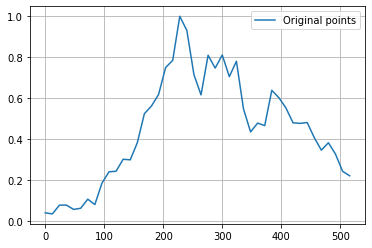

In [ ]:
MNCN_x45 = MNCN_x[0:522:12]
MNCN_y45 = MNCN_y[0:522:12]

plt.plot(MNCN_x45, MNCN_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_MNCN_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_MNCN_45: [ 0.04166667 -0.00448859  0.09411607  0.08213609  0.05533459  0.04652556
  0.14189652  0.03588837  0.20621665  0.25591169  0.2201366   0.33020856
  0.27569581  0.36700819  0.55627143  0.55790608  0.58710426  0.80201023
  0.70485481  1.08690386  0.94752973  0.70631054  0.51889477  0.91811037
  0.66699709  0.8972346   0.61073116  0.89317408  0.49990586  0.39886915
  0.52128422  0.39099396  0.71473993  0.58337966  0.56840809  0.45965465
  0.47630664  0.50178545  0.40821822  0.31534168  0.41374839  0.30163688
  0.20057045  0.22222222  0.          0.          0.          0.        ]
k_MNCN_45: 3



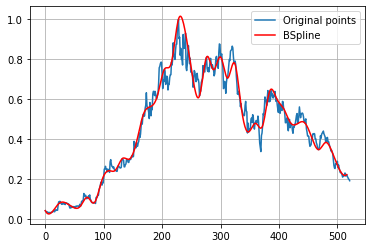

In [ ]:
import scipy.interpolate as interpolate

t_MNCN_45, c_MNCN_45, k_MNCN_45 = interpolate.splrep(MNCN_x45, MNCN_y45, s=0, k=3)
print('''\
t_MNCN_45: {}
c_MNCN_45: {}
k_MNCN_45: {}
'''.format(t_MNCN_45, c_MNCN_45, k_MNCN_45))
N = 522
xmin_MNCN_45, xmax_MNCN_45 = MNCN_x45.min(), MNCN_x45.max()
xx_MNCN_45 = np.linspace(xmin_MNCN_45, xmax_MNCN_45, N)
spline_MNCN_45 = interpolate.BSpline(t_MNCN_45, c_MNCN_45, k_MNCN_45, extrapolate=False)

plt.plot(MNCN_x, MNCN_y, label='Original points')
plt.plot(xx_MNCN_45, spline_MNCN_45(xx_MNCN_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA MNCN**

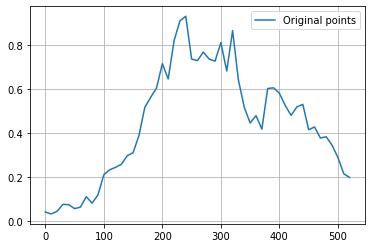

In [ ]:
MNCN_x55 = MNCN_x[0:522:10]
MNCN_y55 = MNCN_y[0:522:10]

plt.plot(MNCN_x55, MNCN_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MNCN_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_MNCN_55: [0.04166667 0.03367749 0.02181169 0.08575468 0.07751716 0.05417668
 0.04744279 0.13938551 0.06168184 0.10555378 0.23276971 0.23003406
 0.24709404 0.24825645 0.30988018 0.29555618 0.37456176 0.53953011
 0.56731779 0.56619874 0.79288726 0.55391889 0.86643719 0.896999
 1.00390014 0.67073379 0.72983137 0.78494073 0.73873905 0.67676975
 0.91251528 0.53983579 1.01980821 0.57259802 0.53146639 0.40153643
 0.53738787 0.32391207 0.67529718 0.59156588 0.59177264 0.52467688
 0.45951984 0.52057711 0.57483839 0.36340267 0.46321759 0.35039363
 0.40187456 0.34210814 0.28111    0.16812555 0.19861111 0.
 0.         0.         0.        ]
k_MNCN_55: 3



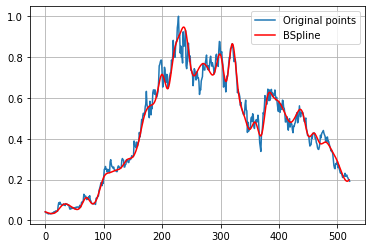

In [ ]:
import scipy.interpolate as interpolate

t_MNCN_55, c_MNCN_55, k_MNCN_55 = interpolate.splrep(MNCN_x55, MNCN_y55, s=0, k=3)
print('''\
t_MNCN_55: {}
c_MNCN_55: {}
k_MNCN_55: {}
'''.format(t_MNCN_55, c_MNCN_55, k_MNCN_55))
N = 522
xmin_MNCN_55, xmax_MNCN_55 = MNCN_x55.min(), MNCN_x55.max()
xx_MNCN_55 = np.linspace(xmin_MNCN_55, xmax_MNCN_55, N)
spline_MNCN_55 = interpolate.BSpline(t_MNCN_55, c_MNCN_55, k_MNCN_55, extrapolate=False)

plt.plot(MNCN_x, MNCN_y, label='Original points')
plt.plot(xx_MNCN_55, spline_MNCN_55(xx_MNCN_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 65 DATA MNCN**

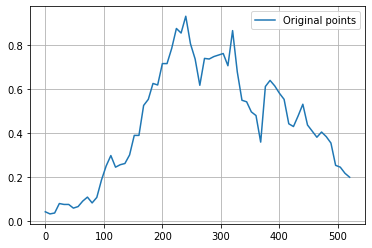

In [ ]:
MNCN_x65 = MNCN_x[0:522:8]
MNCN_y65 = MNCN_y[0:522:8]

plt.plot(MNCN_x65, MNCN_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_MNCN_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_MNCN_65: [ 0.04166667  0.04531332 -0.00173776  0.09612516  0.06777138  0.0827893
  0.05107142  0.06292501  0.0888952   0.12316085  0.06846139  0.09466024
  0.19456431  0.2437492   0.33043889  0.21782859  0.26491343  0.25585102
  0.27834914  0.43075241  0.33197454  0.57468275  0.51929445  0.6648061
  0.57148114  0.75760269  0.68977476  0.77496492  0.91869888  0.80023957
  1.00534285  0.76172236  0.78110104  0.53054014  0.7967384   0.71583959
  0.75656989  0.74121418  0.80357338  0.61115898  0.98512404  0.64001153
  0.5214965   0.56566912  0.465827    0.54602286  0.22508156  0.7036509
  0.62698152  0.62175634  0.56932644  0.5

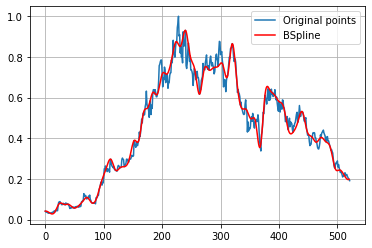

In [ ]:
import scipy.interpolate as interpolate

t_MNCN_65, c_MNCN_65, k_MNCN_65 = interpolate.splrep(MNCN_x65, MNCN_y65, s=0, k=3)
print('''\
t_MNCN_65: {}
c_MNCN_65: {}
k_MNCN_65: {}
'''.format(t_MNCN_65, c_MNCN_65, k_MNCN_65))
N = 522
xmin_MNCN_65, xmax_MNCN_65 = MNCN_x65.min(), MNCN_x65.max()
xx_MNCN_65 = np.linspace(xmin_MNCN_65, xmax_MNCN_65, N)
spline_MNCN_65 = interpolate.BSpline(t_MNCN_65, c_MNCN_65, k_MNCN_65, extrapolate=False)

plt.plot(MNCN_x, MNCN_y, label='Original points')
plt.plot(xx_MNCN_65, spline_MNCN_65(xx_MNCN_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE MNCN**

In [ ]:

#RMSE 15 DATA MNCN
y_true_MNCN_15 = MNCN_y.tolist()
y_pred_MNCN_15 = spline_MNCN_15(xx_MNCN_15).tolist()
mse_MNCN_15 = mean_squared_error(y_true_MNCN_15, y_pred_MNCN_15)
rmse_MNCN_15 = np.sqrt(mse_MNCN_15)
print("rmse MNCN 15 =",rmse_MNCN_15)

#RMSE 25 DATA MNCN
y_true_MNCN_25 = MNCN_y.tolist()
y_pred_MNCN_25 = spline_MNCN_25(xx_MNCN_25).tolist()
mse_MNCN_25 = mean_squared_error(y_true_MNCN_25, y_pred_MNCN_25)
rmse_MNCN_25 = np.sqrt(mse_MNCN_25)
print("rmse MNCN 25 =",rmse_MNCN_25)

#RMSE 35 DATA MNCN
y_true_MNCN_35 = MNCN_y.tolist()
y_pred_MNCN_35 = spline_MNCN_35(xx_MNCN_35).tolist()
mse_MNCN_35 = mean_squared_error(y_true_MNCN_35, y_pred_MNCN_35)
rmse_MNCN_35 = np.sqrt(mse_MNCN_35)
print("rmse MNCN 35 =",rmse_MNCN_35)

#RMSE 45 DATA MNCN
y_true_MNCN_45 = MNCN_y.tolist()
y_pred_MNCN_45 = spline_MNCN_45(xx_MNCN_45).tolist()
mse_MNCN_45 = mean_squared_error(y_true_MNCN_45, y_pred_MNCN_45)
rmse_MNCN_45 = np.sqrt(mse_MNCN_45)
print("rmse MNCN 45 =",rmse_MNCN_45)

#RMSE 55 DATA MNCN
y_true_MNCN_55 = MNCN_y.tolist()
y_pred_MNCN_55 = spline_MNCN_55(xx_MNCN_55).tolist()
mse_MNCN_55 = mean_squared_error(y_true_MNCN_55, y_pred_MNCN_55)
rmse_MNCN_55 = np.sqrt(mse_MNCN_55)
print("rmse MNCN 55 =",rmse_MNCN_55)

#RMSE 65 DATA MNCN
y_true_MNCN_65 = MNCN_y.tolist()
y_pred_MNCN_65 = spline_MNCN_65(xx_MNCN_65).tolist()
mse_MNCN_65 = mean_squared_error(y_true_MNCN_65, y_pred_MNCN_65)
rmse_MNCN_65 = np.sqrt(mse_MNCN_65)
print("rmse MNCN 65 =",rmse_MNCN_65)


rmse MNCN 15 = 0.09601213210680994
rmse MNCN 25 = 0.06907392412990797
rmse MNCN 35 = 0.0566465147644225
rmse MNCN 45 = 0.05260914115165266
rmse MNCN 55 = 0.03659951751539608
rmse MNCN 65 = 0.03605168518572941


# **PBRX**

No handles with labels found to put in legend.


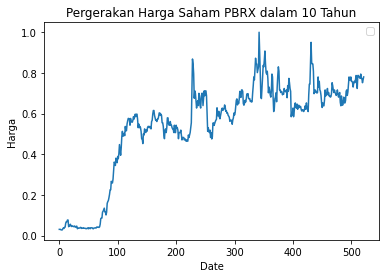

In [ ]:
PBRX = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PBRX.JK.csv')

PBRX_x = PBRX['No'].values
PBRX_y = PBRX['Skala'].values

plt.plot(PBRX_x,PBRX_y)
plt.title('Pergerakan Harga Saham PBRX dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA PBRX**

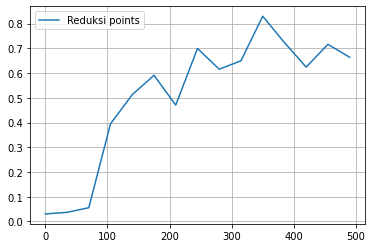

In [ ]:
PBRX_x15 = PBRX_x[0:522:35]
PBRX_y15 = PBRX_y[0:522:35]

plt.plot(PBRX_x15, PBRX_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PBRX_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_PBRX_15: [ 0.03057787  0.16432901 -0.22385957  0.48511104  0.47626629  0.68552583
  0.32773245  0.82595284  0.56587739  0.60415461  0.91537652  0.71306271
  0.5260433   0.84761665  0.66382979  0.          0.          0.
  0.        ]
k_PBRX_15: 3



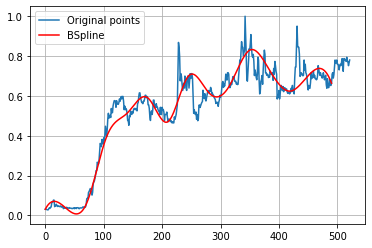

In [ ]:
import scipy.interpolate as interpolate

t_PBRX_15, c_PBRX_15, k_PBRX_15 = interpolate.splrep(PBRX_x15, PBRX_y15, s=0, k=3)
print('''\
t_PBRX_15: {}
c_PBRX_15: {}
k_PBRX_15: {}
'''.format(t_PBRX_15, c_PBRX_15, k_PBRX_15))
N = 522
xmin_PBRX_15, xmax_PBRX_15 = PBRX_x15.min(), PBRX_x15.max()
xx_PBRX_15 = np.linspace(xmin_PBRX_15, xmax_PBRX_15, N)
spline_PBRX_15 = interpolate.BSpline(t_PBRX_15, c_PBRX_15, k_PBRX_15, extrapolate=False)

plt.plot(PBRX_x, PBRX_y, label='Original points')
plt.plot(xx_PBRX_15, spline_PBRX_15(xx_PBRX_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA PBRX**

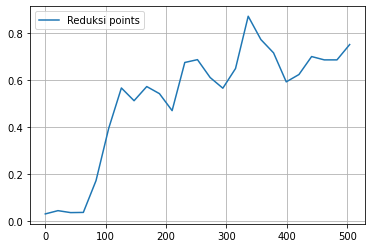

In [ ]:
PBRX_x25 = PBRX_x[0:522:21]
PBRX_y25 = PBRX_y[0:522:21]

plt.plot(PBRX_x25, PBRX_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PBRX_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_PBRX_25: [0.03057787 0.04602818 0.0524935  0.00558045 0.15874105 0.39354041
 0.63719084 0.45905798 0.60227929 0.56937368 0.37684739 0.74564523
 0.69325256 0.60639985 0.54923314 0.59241228 0.9789901  0.7256699
 0.75662818 0.54568973 0.61805972 0.72675224 0.66333145 0.68180945
 0.75177305 0.         0.         0.         0.        ]
k_PBRX_25: 3



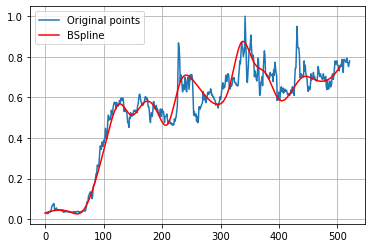

In [ ]:
import scipy.interpolate as interpolate

t_PBRX_25, c_PBRX_25, k_PBRX_25 = interpolate.splrep(PBRX_x25, PBRX_y25, s=0, k=3)
print('''\
t_PBRX_25: {}
c_PBRX_25: {}
k_PBRX_25: {}
'''.format(t_PBRX_25, c_PBRX_25, k_PBRX_25))
N = 522
xmin_PBRX_25, xmax_PBRX_25 = PBRX_x25.min(), PBRX_x25.max()
xx_PBRX_25 = np.linspace(xmin_PBRX_25, xmax_PBRX_25, N)
spline_PBRX_25 = interpolate.BSpline(t_PBRX_25, c_PBRX_25, k_PBRX_25, extrapolate=False)

plt.plot(PBRX_x, PBRX_y, label='Original points')
plt.plot(xx_PBRX_25, spline_PBRX_25(xx_PBRX_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA PBRX**

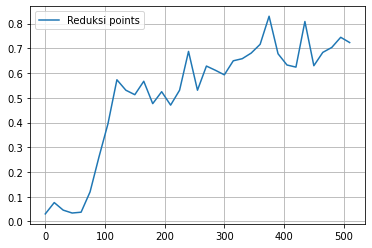

In [ ]:
PBRX_x35 = PBRX_x[0:522:15]
PBRX_y35 = PBRX_y[0:522:15]

plt.plot(PBRX_x35, PBRX_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PBRX_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_PBRX_35: [0.03057787 0.11503472 0.03748643 0.0367777  0.02072975 0.10546756
 0.27458893 0.36398093 0.63958088 0.51524436 0.48369695 0.62566986
 0.41498534 0.57297603 0.44117869 0.48471767 0.8042059  0.42351407
 0.6859931  0.60272629 0.57118686 0.66997308 0.64679317 0.69179041
 0.67115158 0.9214756  0.62166943 0.65993179 0.53434809 0.94735668
 0.527289   0.72221072 0.67392414 0.79566204 0.72340426 0.
 0.         0.         0.        ]
k_PBRX_35: 3



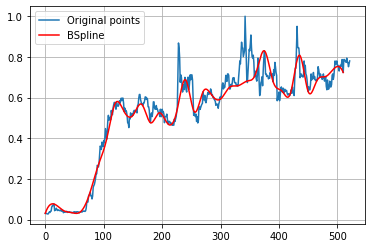

In [ ]:
import scipy.interpolate as interpolate

t_PBRX_35, c_PBRX_35, k_PBRX_35 = interpolate.splrep(PBRX_x35, PBRX_y35, s=0, k=3)
print('''\
t_PBRX_35: {}
c_PBRX_35: {}
k_PBRX_35: {}
'''.format(t_PBRX_35, c_PBRX_35, k_PBRX_35))
N = 522
xmin_PBRX_35, xmax_PBRX_35 = PBRX_x35.min(), PBRX_x35.max()
xx_PBRX_35 = np.linspace(xmin_PBRX_35, xmax_PBRX_35, N)
spline_PBRX_35 = interpolate.BSpline(t_PBRX_35, c_PBRX_35, k_PBRX_35, extrapolate=False)

plt.plot(PBRX_x, PBRX_y, label='Original points')
plt.plot(xx_PBRX_35, spline_PBRX_35(xx_PBRX_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA PBRX**

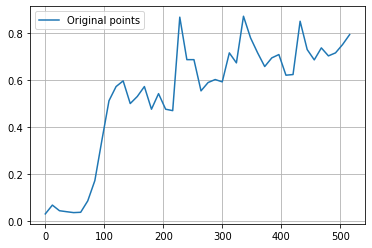

In [ ]:
PBRX_x45 = PBRX_x[0:522:12]
PBRX_y45 = PBRX_y[0:522:12]

plt.plot(PBRX_x45, PBRX_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PBRX_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_PBRX_45: [0.03057787 0.10024889 0.03453428 0.04162317 0.03737615 0.02569693
 0.08500039 0.15134495 0.3437049  0.54200562 0.56397466 0.63964457
 0.45972792 0.52477133 0.62544201 0.41100946 0.58910743 0.48918223
 0.31275089 1.08222267 0.56895414 0.7670161  0.4880368  0.60849629
 0.61840356 0.53491075 0.79940025 0.5653606  0.98171054 0.74183979
 0.73178138 0.62890705 0.70152659 0.73519937 0.61299507 0.54047993
 0.96976606 0.68683879 0.66585749 0.7688802  0.68415362 0.7263247
 0.76272418 0.79432624 0.         0.         0.         0.        ]
k_PBRX_45: 3



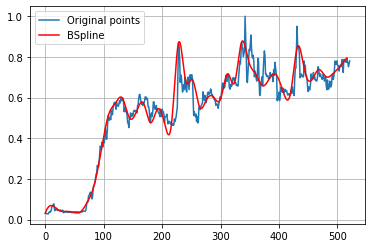

In [ ]:
import scipy.interpolate as interpolate

t_PBRX_45, c_PBRX_45, k_PBRX_45 = interpolate.splrep(PBRX_x45, PBRX_y45, s=0, k=3)
print('''\
t_PBRX_45: {}
c_PBRX_45: {}
k_PBRX_45: {}
'''.format(t_PBRX_45, c_PBRX_45, k_PBRX_45))
N = 522
xmin_PBRX_45, xmax_PBRX_45 = PBRX_x45.min(), PBRX_x45.max()
xx_PBRX_45 = np.linspace(xmin_PBRX_45, xmax_PBRX_45, N)
spline_PBRX_45 = interpolate.BSpline(t_PBRX_45, c_PBRX_45, k_PBRX_45, extrapolate=False)

plt.plot(PBRX_x, PBRX_y, label='Original points')
plt.plot(xx_PBRX_45, spline_PBRX_45(xx_PBRX_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA PBRX**

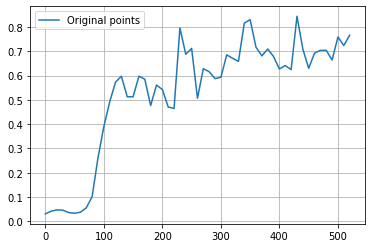

In [ ]:
PBRX_x55 = PBRX_x[0:522:10]
PBRX_y55 = PBRX_y[0:522:10]

plt.plot(PBRX_x55, PBRX_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PBRX_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_PBRX_55: [0.03057787 0.03988419 0.04810247 0.04830427 0.03382999 0.03320047
 0.03351367 0.05790911 0.06842606 0.27716369 0.39072338 0.49497254
 0.57844185 0.62880889 0.48860344 0.4924794  0.617181   0.62107746
 0.40842415 0.6038132  0.54149743 0.48681849 0.33363709 0.96485452
 0.58331928 0.82692369 0.37878162 0.69746478 0.60157204 0.58986407
 0.56237592 0.71807904 0.67594621 0.60366803 0.85831782 0.85667771
 0.69369475 0.66641562 0.72574915 0.68590691 0.59870829 0.68096205
 0.52425201 0.96671076 0.67273475 0.59766939 0.71531109 0.69427772
 0.7288546  0.61158046 0.87320956 0.62899806 0.76595745 0.
 0.         0.         0.        ]
k_PBRX_55: 3



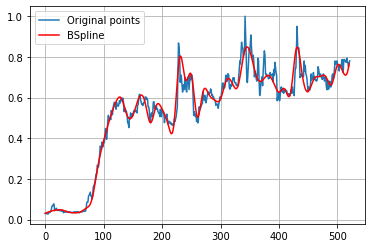

In [ ]:
import scipy.interpolate as interpolate

t_PBRX_55, c_PBRX_55, k_PBRX_55 = interpolate.splrep(PBRX_x55, PBRX_y55, s=0, k=3)
print('''\
t_PBRX_55: {}
c_PBRX_55: {}
k_PBRX_55: {}
'''.format(t_PBRX_55, c_PBRX_55, k_PBRX_55))
N = 522
xmin_PBRX_55, xmax_PBRX_55 = PBRX_x55.min(), PBRX_x55.max()
xx_PBRX_55 = np.linspace(xmin_PBRX_55, xmax_PBRX_55, N)
spline_PBRX_55 = interpolate.BSpline(t_PBRX_55, c_PBRX_55, k_PBRX_55, extrapolate=False)

plt.plot(PBRX_x, PBRX_y, label='Original points')
plt.plot(xx_PBRX_55, spline_PBRX_55(xx_PBRX_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA PBRX**

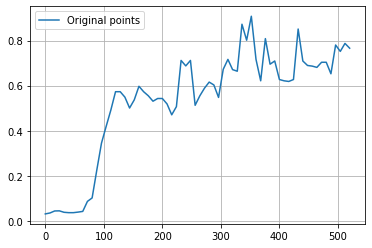

In [ ]:
PBRX_x65 = PBRX_x[0:522:8]
PBRX_y65 = PBRX_y[0:522:8]

plt.plot(PBRX_x65, PBRX_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PBRX_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_PBRX_65: [0.03057787 0.02825843 0.04536286 0.04590427 0.03607792 0.03661556
 0.03428452 0.04307103 0.02526711 0.10604264 0.06760573 0.23231147
 0.3541356  0.4193163  0.48343335 0.5960057  0.57009269 0.56117237
 0.47802632 0.53004993 0.62220801 0.56339887 0.56174533 0.51860711
 0.54808152 0.54568822 0.52578699 0.46304463 0.44444295 0.7986985
 0.63055869 0.80412204 0.4227488  0.58058479 0.58257162 0.62104362
 0.62687092 0.48849399 0.70425952 0.72851051 0.6795708  0.57873822
 0.98845505 0.70148412 1.0141191  0.68884798 0.52836133 0.9253663
 0.62123732 0.75989719 0.59449306 0.6238327  0.63783571 0.53546275
 0.98201544 0.6428584

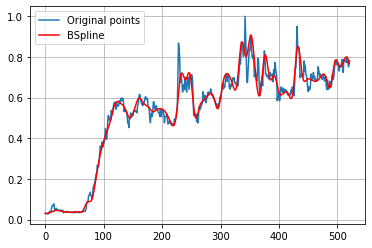

In [ ]:
import scipy.interpolate as interpolate

t_PBRX_65, c_PBRX_65, k_PBRX_65 = interpolate.splrep(PBRX_x65, PBRX_y65, s=0, k=3)
print('''\
t_PBRX_65: {}
c_PBRX_65: {}
k_PBRX_65: {}
'''.format(t_PBRX_65, c_PBRX_65, k_PBRX_65))
N = 522
xmin_PBRX_65, xmax_PBRX_65 = PBRX_x65.min(), PBRX_x65.max()
xx_PBRX_65 = np.linspace(xmin_PBRX_65, xmax_PBRX_65, N)
spline_PBRX_65 = interpolate.BSpline(t_PBRX_65, c_PBRX_65, k_PBRX_65, extrapolate=False)

plt.plot(PBRX_x, PBRX_y, label='Original points')
plt.plot(xx_PBRX_65, spline_PBRX_65(xx_PBRX_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE PBRX**

In [ ]:

#RMSE 15 DATA PBRX
y_true_PBRX_15 = PBRX_y.tolist()
y_pred_PBRX_15 = spline_PBRX_15(xx_PBRX_15).tolist()
mse_PBRX_15 = mean_squared_error(y_true_PBRX_15, y_pred_PBRX_15)
rmse_PBRX_15 = np.sqrt(mse_PBRX_15)
print("rmse PBRX 15 =",rmse_PBRX_15)

#RMSE 25 DATA PBRX
y_true_PBRX_25 = PBRX_y.tolist()
y_pred_PBRX_25 = spline_PBRX_25(xx_PBRX_25).tolist()
mse_PBRX_25 = mean_squared_error(y_true_PBRX_25, y_pred_PBRX_25)
rmse_PBRX_25 = np.sqrt(mse_PBRX_25)
print("rmse PBRX 25 =",rmse_PBRX_25)

#RMSE 35 DATA PBRX
y_true_PBRX_35 = PBRX_y.tolist()
y_pred_PBRX_35 = spline_PBRX_35(xx_PBRX_35).tolist()
mse_PBRX_35 = mean_squared_error(y_true_PBRX_35, y_pred_PBRX_35)
rmse_PBRX_35 = np.sqrt(mse_PBRX_35)
print("rmse PBRX 35 =",rmse_PBRX_35)

#RMSE 45 DATA PBRX
y_true_PBRX_45 = PBRX_y.tolist()
y_pred_PBRX_45 = spline_PBRX_45(xx_PBRX_45).tolist()
mse_PBRX_45 = mean_squared_error(y_true_PBRX_45, y_pred_PBRX_45)
rmse_PBRX_45 = np.sqrt(mse_PBRX_45)
print("rmse PBRX 45 =",rmse_PBRX_45)

#RMSE 55 DATA PBRX
y_true_PBRX_55 = PBRX_y.tolist()
y_pred_PBRX_55 = spline_PBRX_55(xx_PBRX_55).tolist()
mse_PBRX_55 = mean_squared_error(y_true_PBRX_55, y_pred_PBRX_55)
rmse_PBRX_55 = np.sqrt(mse_PBRX_55)
print("rmse PBRX 55 =",rmse_PBRX_55)

#RMSE 65 DATA PBRX
y_true_PBRX_65 = PBRX_y.tolist()
y_pred_PBRX_65 = spline_PBRX_65(xx_PBRX_65).tolist()
mse_PBRX_65 = mean_squared_error(y_true_PBRX_65, y_pred_PBRX_65)
rmse_PBRX_65 = np.sqrt(mse_PBRX_65)
print("rmse PBRX 65 =",rmse_PBRX_65)


rmse PBRX 15 = 0.08851118430644356
rmse PBRX 25 = 0.06715439479863819
rmse PBRX 35 = 0.06610043548539231
rmse PBRX 45 = 0.05446958841989775
rmse PBRX 55 = 0.041570290220217465
rmse PBRX 65 = 0.03774853130942031


# **PGAS**

No handles with labels found to put in legend.


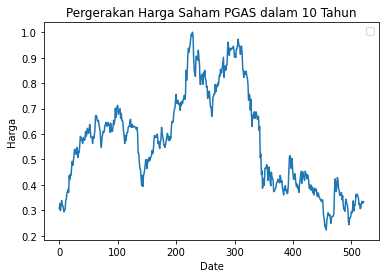

In [ ]:
PGAS = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PGAS.JK.csv')

PGAS_x = PGAS['No'].values
PGAS_y = PGAS['Skala'].values

plt.plot(PGAS_x,PGAS_y)
plt.title('Pergerakan Harga Saham PGAS dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA PGAS**

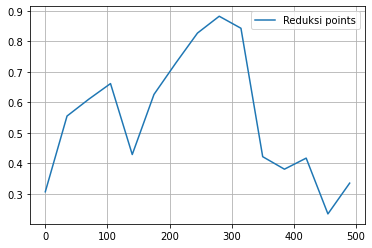

In [ ]:
PGAS_x15 = PGAS_x[0:522:35]
PGAS_y15 = PGAS_y[0:522:35]

plt.plot(PGAS_x15, PGAS_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PGAS_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_PGAS_15: [0.30708661 0.62850646 0.50479811 0.77987632 0.27543099 0.69320286
 0.70766309 0.84622351 0.86807278 0.97282396 0.29574949 0.37646155
 0.52120411 0.02050031 0.33543307 0.         0.         0.
 0.        ]
k_PGAS_15: 3



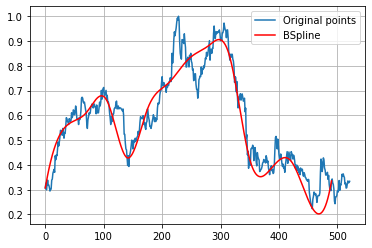

In [ ]:
import scipy.interpolate as interpolate

t_PGAS_15, c_PGAS_15, k_PGAS_15 = interpolate.splrep(PGAS_x15, PGAS_y15, s=0, k=3)
print('''\
t_PGAS_15: {}
c_PGAS_15: {}
k_PGAS_15: {}
'''.format(t_PGAS_15, c_PGAS_15, k_PGAS_15))
N = 522
xmin_PGAS_15, xmax_PGAS_15 = PGAS_x15.min(), PGAS_x15.max()
xx_PGAS_15 = np.linspace(xmin_PGAS_15, xmax_PGAS_15, N)
spline_PGAS_15 = interpolate.BSpline(t_PGAS_15, c_PGAS_15, k_PGAS_15, extrapolate=False)

plt.plot(PGAS_x, PGAS_y, label='Original points')
plt.plot(xx_PGAS_15, spline_PGAS_15(xx_PGAS_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA PGAS**

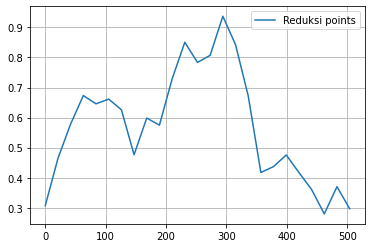

In [ ]:
PGAS_x25 = PGAS_x[0:522:21]
PGAS_y25 = PGAS_y[0:522:21]

plt.plot(PGAS_x25, PGAS_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PGAS_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_PGAS_25: [0.30708661 0.44445533 0.52644367 0.71066257 0.62422139 0.66646762
 0.67841206 0.37578966 0.67669703 0.50797342 0.7402282  0.90119251
 0.75736396 0.77013903 1.00459959 0.83350986 0.71647907 0.33521952
 0.44657987 0.50050826 0.40493041 0.38370709 0.17079195 0.51066702
 0.29685039 0.         0.         0.         0.        ]
k_PGAS_25: 3



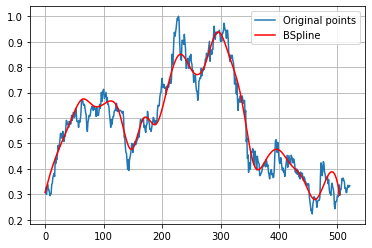

In [ ]:
import scipy.interpolate as interpolate

t_PGAS_25, c_PGAS_25, k_PGAS_25 = interpolate.splrep(PGAS_x25, PGAS_y25, s=0, k=3)
print('''\
t_PGAS_25: {}
c_PGAS_25: {}
k_PGAS_25: {}
'''.format(t_PGAS_25, c_PGAS_25, k_PGAS_25))
N = 522
xmin_PGAS_25, xmax_PGAS_25 = PGAS_x25.min(), PGAS_x25.max()
xx_PGAS_25 = np.linspace(xmin_PGAS_25, xmax_PGAS_25, N)
spline_PGAS_25 = interpolate.BSpline(t_PGAS_25, c_PGAS_25, k_PGAS_25, extrapolate=False)

plt.plot(PGAS_x, PGAS_y, label='Original points')
plt.plot(xx_PGAS_25, spline_PGAS_25(xx_PGAS_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA PGAS**

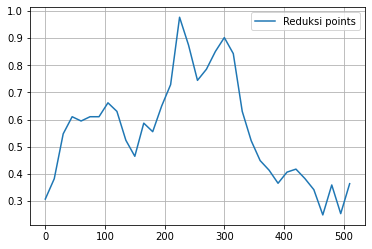

In [ ]:
PGAS_x35 = PGAS_x[0:522:15]
PGAS_y35 = PGAS_y[0:522:15]

plt.plot(PGAS_x35, PGAS_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_PGAS_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_PGAS_35: [0.30708661 0.27326642 0.55386086 0.62754204 0.57896801 0.62351504
 0.58838915 0.68434567 0.64273211 0.52425346 0.40198635 0.65520273
 0.49688776 0.68795488 0.64893052 1.0864018  0.86372999 0.70277271
 0.78974608 0.84847918 0.91869939 0.88617206 0.59173049 0.52643353
 0.43481883 0.42720452 0.33667805 0.41820925 0.42828022 0.37260688
 0.37735525 0.16836581 0.53333793 0.05970899 0.36377953 0.
 0.         0.         0.        ]
k_PGAS_35: 3



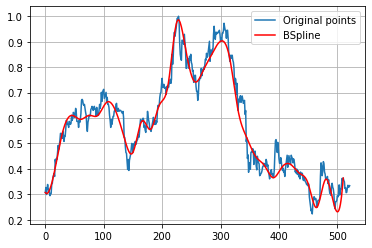

In [ ]:
import scipy.interpolate as interpolate

t_PGAS_35, c_PGAS_35, k_PGAS_35 = interpolate.splrep(PGAS_x35, PGAS_y35, s=0, k=3)
print('''\
t_PGAS_35: {}
c_PGAS_35: {}
k_PGAS_35: {}
'''.format(t_PGAS_35, c_PGAS_35, k_PGAS_35))
N = 522
xmin_PGAS_35, xmax_PGAS_35 = PGAS_x35.min(), PGAS_x35.max()
xx_PGAS_35 = np.linspace(xmin_PGAS_35, xmax_PGAS_35, N)
spline_PGAS_35 = interpolate.BSpline(t_PGAS_35, c_PGAS_35, k_PGAS_35, extrapolate=False)

plt.plot(PGAS_x, PGAS_y, label='Original points')
plt.plot(xx_PGAS_35, spline_PGAS_35(xx_PGAS_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA PGAS**

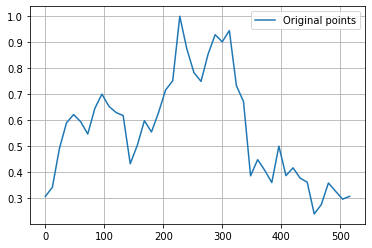

In [ ]:
PGAS_x45 = PGAS_x[0:522:12]
PGAS_y45 = PGAS_y[0:522:12]

plt.plot(PGAS_x45, PGAS_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PGAS_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_PGAS_45: [0.30708661 0.24749903 0.47547439 0.60142096 0.6306622  0.60821371
 0.50341208 0.66160253 0.72419353 0.64634776 0.61167526 0.68647876
 0.35107112 0.50766196 0.64190307 0.51527692 0.6276979  0.75345904
 0.65767856 1.12763777 0.83177038 0.7893752  0.7115162  0.86219777
 0.96567696 0.84989753 1.04418175 0.6426668  0.78357623 0.25767395
 0.50541302 0.41358737 0.2874816  0.60026574 0.31617984 0.45942435
 0.35005975 0.40805317 0.1909559  0.2690681  0.39103941 0.2977935
 0.28594577 0.30787402 0.         0.         0.         0.        ]
k_PGAS_45: 3



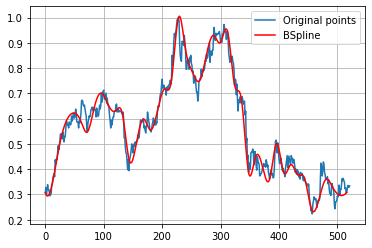

In [ ]:
import scipy.interpolate as interpolate

t_PGAS_45, c_PGAS_45, k_PGAS_45 = interpolate.splrep(PGAS_x45, PGAS_y45, s=0, k=3)
print('''\
t_PGAS_45: {}
c_PGAS_45: {}
k_PGAS_45: {}
'''.format(t_PGAS_45, c_PGAS_45, k_PGAS_45))
N = 522
xmin_PGAS_45, xmax_PGAS_45 = PGAS_x45.min(), PGAS_x45.max()
xx_PGAS_45 = np.linspace(xmin_PGAS_45, xmax_PGAS_45, N)
spline_PGAS_45 = interpolate.BSpline(t_PGAS_45, c_PGAS_45, k_PGAS_45, extrapolate=False)

plt.plot(PGAS_x, PGAS_y, label='Original points')
plt.plot(xx_PGAS_45, spline_PGAS_45(xx_PGAS_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA PGAS**

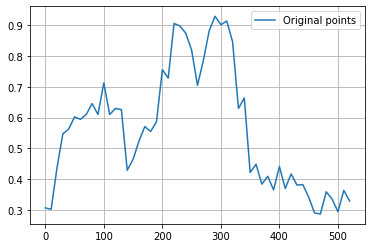

In [ ]:
PGAS_x55 = PGAS_x[0:522:10]
PGAS_y55 = PGAS_y[0:522:10]

plt.plot(PGAS_x55, PGAS_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PGAS_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_PGAS_55: [0.30708661 0.21948305 0.39843549 0.57380346 0.54597322 0.62025639
 0.58717443 0.59797501 0.68234284 0.54666939 0.79239692 0.55933346
 0.63168655 0.6934479  0.35042735 0.47964585 0.51839082 0.58852315
 0.55271343 0.5313318  0.84164441 0.63752363 0.97833982 0.88218795
 0.87873516 0.84696592 0.64678701 0.79423251 0.88651918 0.95102935
 0.88416657 0.92175319 0.90913562 0.5204445  0.78861394 0.3077769
 0.51256192 0.33488883 0.4533946  0.3082257  0.5058286  0.31412921
 0.45812702 0.35729973 0.39928824 0.34161031 0.28466422 0.2630399
 0.38758563 0.34094829 0.23464339 0.45433185 0.32913386 0.
 0.         0.         0.        ]
k_PGAS_55: 3



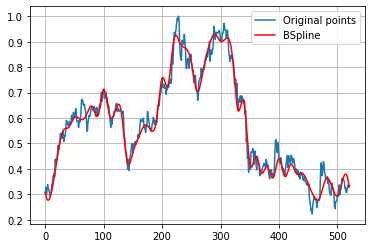

In [ ]:
import scipy.interpolate as interpolate

t_PGAS_55, c_PGAS_55, k_PGAS_55 = interpolate.splrep(PGAS_x55, PGAS_y55, s=0, k=3)
print('''\
t_PGAS_55: {}
c_PGAS_55: {}
k_PGAS_55: {}
'''.format(t_PGAS_55, c_PGAS_55, k_PGAS_55))
N = 522
xmin_PGAS_55, xmax_PGAS_55 = PGAS_x55.min(), PGAS_x55.max()
xx_PGAS_55 = np.linspace(xmin_PGAS_55, xmax_PGAS_55, N)
spline_PGAS_55 = interpolate.BSpline(t_PGAS_55, c_PGAS_55, k_PGAS_55, extrapolate=False)

plt.plot(PGAS_x, PGAS_y, label='Original points')
plt.plot(xx_PGAS_55, spline_PGAS_55(xx_PGAS_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA PGAS**

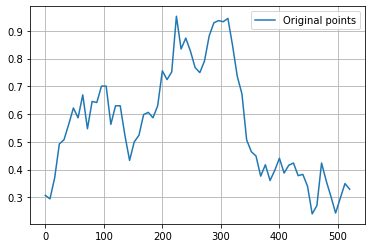

In [ ]:
PGAS_x65 = PGAS_x[0:522:8]
PGAS_y65 = PGAS_y[0:522:8]

plt.plot(PGAS_x65, PGAS_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PGAS_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_PGAS_65: [0.30708661 0.27193043 0.29550922 0.52707738 0.49104512 0.55598622
 0.66296275 0.52444626 0.75893726 0.45555273 0.70231639 0.60919744
 0.71128754 0.7503768  0.49192966 0.65985733 0.6481686  0.52699585
 0.3855803  0.52910816 0.49798708 0.62067581 0.60986086 0.57767603
 0.59912005 0.80537134 0.71482765 0.68177473 1.06988444 0.75522294
 0.91709782 0.82048028 0.761611   0.73937493 0.77852708 0.89454826
 0.93461848 0.94178097 0.9203049  0.97542464 0.84728787 0.71416404
 0.7133788  0.46696644 0.46127514 0.4753346  0.33029987 0.46173364
 0.32670258 0.39523555 0.47345757 0.35660347 0.42453799 0.43973275
 0.35826328 0.39493

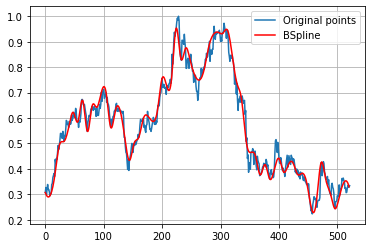

In [ ]:
import scipy.interpolate as interpolate

t_PGAS_65, c_PGAS_65, k_PGAS_65 = interpolate.splrep(PGAS_x65, PGAS_y65, s=0, k=3)
print('''\
t_PGAS_65: {}
c_PGAS_65: {}
k_PGAS_65: {}
'''.format(t_PGAS_65, c_PGAS_65, k_PGAS_65))
N = 522
xmin_PGAS_65, xmax_PGAS_65 = PGAS_x65.min(), PGAS_x65.max()
xx_PGAS_65 = np.linspace(xmin_PGAS_65, xmax_PGAS_65, N)
spline_PGAS_65 = interpolate.BSpline(t_PGAS_65, c_PGAS_65, k_PGAS_65, extrapolate=False)

plt.plot(PGAS_x, PGAS_y, label='Original points')
plt.plot(xx_PGAS_65, spline_PGAS_65(xx_PGAS_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE PGAS**

In [ ]:

#RMSE 15 DATA PGAS
y_true_PGAS_15 = PGAS_y.tolist()
y_pred_PGAS_15 = spline_PGAS_15(xx_PGAS_15).tolist()
mse_PGAS_15 = mean_squared_error(y_true_PGAS_15, y_pred_PGAS_15)
rmse_PGAS_15 = np.sqrt(mse_PGAS_15)
print("rmse PGAS 15 =",rmse_PGAS_15)

#RMSE 25 DATA PGAS
y_true_PGAS_25 = PGAS_y.tolist()
y_pred_PGAS_25 = spline_PGAS_25(xx_PGAS_25).tolist()
mse_PGAS_25 = mean_squared_error(y_true_PGAS_25, y_pred_PGAS_25)
rmse_PGAS_25 = np.sqrt(mse_PGAS_25)
print("rmse PGAS 25 =",rmse_PGAS_25)

#RMSE 35 DATA PGAS
y_true_PGAS_35 = PGAS_y.tolist()
y_pred_PGAS_35 = spline_PGAS_35(xx_PGAS_35).tolist()
mse_PGAS_35 = mean_squared_error(y_true_PGAS_35, y_pred_PGAS_35)
rmse_PGAS_35 = np.sqrt(mse_PGAS_35)
print("rmse PGAS 35 =",rmse_PGAS_35)

#RMSE 45 DATA PGAS
y_true_PGAS_45 = PGAS_y.tolist()
y_pred_PGAS_45 = spline_PGAS_45(xx_PGAS_45).tolist()
mse_PGAS_45 = mean_squared_error(y_true_PGAS_45, y_pred_PGAS_45)
rmse_PGAS_45 = np.sqrt(mse_PGAS_45)
print("rmse PGAS 45 =",rmse_PGAS_45)

#RMSE 55 DATA PGAS
y_true_PGAS_55 = PGAS_y.tolist()
y_pred_PGAS_55 = spline_PGAS_55(xx_PGAS_55).tolist()
mse_PGAS_55 = mean_squared_error(y_true_PGAS_55, y_pred_PGAS_55)
rmse_PGAS_55 = np.sqrt(mse_PGAS_55)
print("rmse PGAS 55 =",rmse_PGAS_55)

#RMSE 65 DATA PGAS
y_true_PGAS_65 = PGAS_y.tolist()
y_pred_PGAS_65 = spline_PGAS_65(xx_PGAS_65).tolist()
mse_PGAS_65 = mean_squared_error(y_true_PGAS_65, y_pred_PGAS_65)
rmse_PGAS_65 = np.sqrt(mse_PGAS_65)
print("rmse PGAS 65 =",rmse_PGAS_65)

rmse PGAS 15 = 0.08665747557343852
rmse PGAS 25 = 0.0682793753908178
rmse PGAS 35 = 0.05395313865819686
rmse PGAS 45 = 0.04413564055742517
rmse PGAS 55 = 0.033920341779957626
rmse PGAS 65 = 0.03136063760491753


# **PNBN**

No handles with labels found to put in legend.


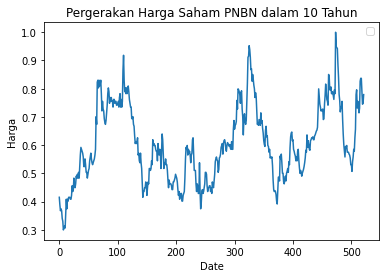

In [ ]:
PNBN = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PNBN.JK.csv')

PNBN_x = PNBN['No'].values
PNBN_y = PNBN['Skala'].values

plt.plot(PNBN_x,PNBN_y)
plt.title('Pergerakan Harga Saham PNBN dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA PNBN**

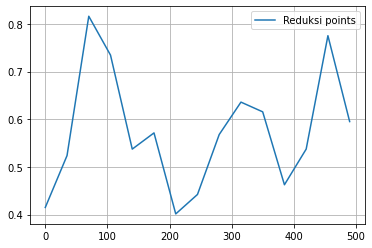

In [ ]:
PNBN_x15 = PNBN_x[0:522:35]
PNBN_y15 = PNBN_y[0:522:35]

plt.plot(PNBN_x15, PNBN_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PNBN_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_PNBN_15: [0.41496599 0.25962637 0.96033909 0.76187231 0.44995161 0.66281102
 0.32737572 0.43584936 0.58228807 0.64316163 0.66139196 0.40514808
 0.52298518 1.00636455 0.5952381  0.         0.         0.
 0.        ]
k_PNBN_15: 3



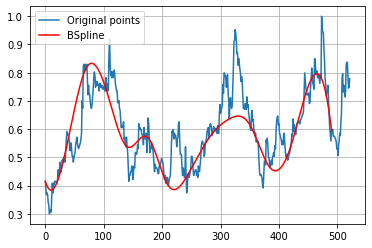

In [ ]:
import scipy.interpolate as interpolate

t_PNBN_15, c_PNBN_15, k_PNBN_15 = interpolate.splrep(PNBN_x15, PNBN_y15, s=0, k=3)
print('''\
t_PNBN_15: {}
c_PNBN_15: {}
k_PNBN_15: {}
'''.format(t_PNBN_15, c_PNBN_15, k_PNBN_15))
N = 522
xmin_PNBN_15, xmax_PNBN_15 = PNBN_x15.min(), PNBN_x15.max()
xx_PNBN_15 = np.linspace(xmin_PNBN_15, xmax_PNBN_15, N)
spline_PNBN_15 = interpolate.BSpline(t_PNBN_15, c_PNBN_15, k_PNBN_15, extrapolate=False)

plt.plot(PNBN_x, PNBN_y, label='Original points')
plt.plot(xx_PNBN_15, spline_PNBN_15(xx_PNBN_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA PNBN**

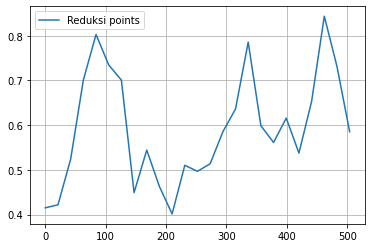

In [ ]:
PNBN_x25 = PNBN_x[0:522:21]
PNBN_y25 = PNBN_y[0:522:21]

plt.plot(PNBN_x25, PNBN_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_PNBN_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_PNBN_25: [0.41496599 0.38962737 0.43843233 0.71083223 0.85422042 0.68861261
 0.7994924  0.31749942 0.62438748 0.45025679 0.35009555 0.55752427
 0.48103185 0.49794016 0.60884017 0.57690325 0.89987336 0.53788902
 0.54040731 0.66782867 0.48215554 0.62803894 1.02272838 0.59407798
 0.58503401 0.         0.         0.         0.        ]
k_PNBN_25: 3



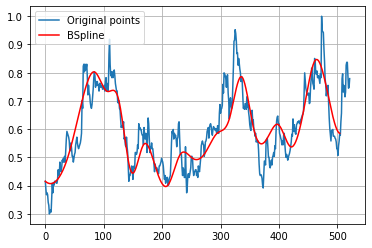

In [ ]:
import scipy.interpolate as interpolate

t_PNBN_25, c_PNBN_25, k_PNBN_25 = interpolate.splrep(PNBN_x25, PNBN_y25, s=0, k=3)
print('''\
t_PNBN_25: {}
c_PNBN_25: {}
k_PNBN_25: {}
'''.format(t_PNBN_25, c_PNBN_25, k_PNBN_25))
N = 522
xmin_PNBN_25, xmax_PNBN_25 = PNBN_x25.min(), PNBN_x25.max()
xx_PNBN_25 = np.linspace(xmin_PNBN_25, xmax_PNBN_25, N)
spline_PNBN_25 = interpolate.BSpline(t_PNBN_25, c_PNBN_25, k_PNBN_25, extrapolate=False)

plt.plot(PNBN_x, PNBN_y, label='Original points')
plt.plot(xx_PNBN_25, spline_PNBN_25(xx_PNBN_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA PNBN**

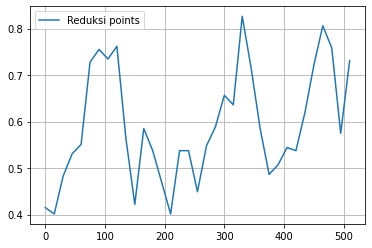

In [ ]:
PNBN_x35 = PNBN_x[0:522:15]
PNBN_y35 = PNBN_y[0:522:15]

plt.plot(PNBN_x35, PNBN_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PNBN_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_PNBN_35: [0.41496599 0.34267033 0.47112191 0.54955296 0.49473197 0.77764159
 0.76204859 0.7047763  0.82700947 0.55861439 0.32628806 0.66684562
 0.51653356 0.49150994 0.33375322 0.58164046 0.56417475 0.38615033
 0.58510149 0.55915799 0.70887881 0.54410229 0.93103858 0.69092708
 0.5909674  0.4554074  0.50577033 0.5623276  0.51022538 0.62126066
 0.71901768 0.82919922 0.7914938  0.38146399 0.73129252 0.
 0.         0.         0.        ]
k_PNBN_35: 3



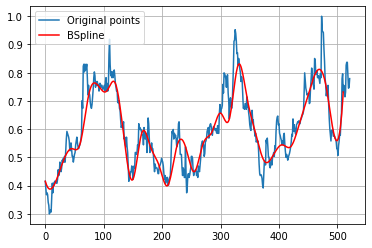

In [ ]:
import scipy.interpolate as interpolate

t_PNBN_35, c_PNBN_35, k_PNBN_35 = interpolate.splrep(PNBN_x35, PNBN_y35, s=0, k=3)
print('''\
t_PNBN_35: {}
c_PNBN_35: {}
k_PNBN_35: {}
'''.format(t_PNBN_35, c_PNBN_35, k_PNBN_35))
N = 522
xmin_PNBN_35, xmax_PNBN_35 = PNBN_x35.min(), PNBN_x35.max()
xx_PNBN_35 = np.linspace(xmin_PNBN_35, xmax_PNBN_35, N)
spline_PNBN_35 = interpolate.BSpline(t_PNBN_35, c_PNBN_35, k_PNBN_35, extrapolate=False)

plt.plot(PNBN_x, PNBN_y, label='Original points')
plt.plot(xx_PNBN_35, spline_PNBN_35(xx_PNBN_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA PNBN**

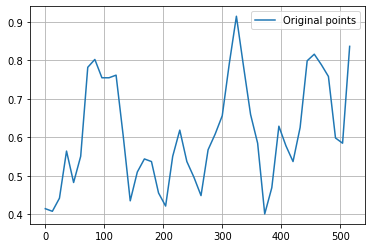

In [ ]:
PNBN_x45 = PNBN_x[0:522:12]
PNBN_y45 = PNBN_y[0:522:12]

plt.plot(PNBN_x45, PNBN_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PNBN_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_PNBN_45: [0.41496599 0.43882281 0.32643601 0.63619633 0.43909369 0.50538808
 0.84547645 0.80658366 0.74451542 0.74596691 0.8022292  0.61654488
 0.36424433 0.53872268 0.54208943 0.55822572 0.44949748 0.37847822
 0.56720188 0.65883672 0.51173697 0.51870521 0.39303403 0.60303621
 0.60298439 0.63808745 0.78344134 0.98324925 0.77335758 0.63760614
 0.63540154 0.33099178 0.44879461 0.69015632 0.56609031 0.5148702
 0.59891867 0.84455714 0.81877114 0.7783175  0.80265275 0.48190497
 0.57027201 0.83673469 0.         0.         0.         0.        ]
k_PNBN_45: 3



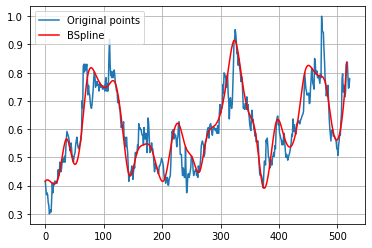

In [ ]:
import scipy.interpolate as interpolate

t_PNBN_45, c_PNBN_45, k_PNBN_45 = interpolate.splrep(PNBN_x45, PNBN_y45, s=0, k=3)
print('''\
t_PNBN_45: {}
c_PNBN_45: {}
k_PNBN_45: {}
'''.format(t_PNBN_45, c_PNBN_45, k_PNBN_45))
N = 522
xmin_PNBN_45, xmax_PNBN_45 = PNBN_x45.min(), PNBN_x45.max()
xx_PNBN_45 = np.linspace(xmin_PNBN_45, xmax_PNBN_45, N)
spline_PNBN_45 = interpolate.BSpline(t_PNBN_45, c_PNBN_45, k_PNBN_45, extrapolate=False)

plt.plot(PNBN_x, PNBN_y, label='Original points')
plt.plot(xx_PNBN_45, spline_PNBN_45(xx_PNBN_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA PNBN**

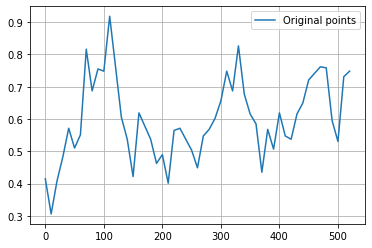

In [ ]:
PNBN_x55 = PNBN_x[0:522:10]
PNBN_y55 = PNBN_y[0:522:10]

plt.plot(PNBN_x55, PNBN_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PNBN_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_PNBN_55: [0.41496599 0.19776392 0.41739734 0.46290626 0.61755957 0.49542688
 0.46195742 0.96286591 0.58453814 0.82143052 0.66035204 1.02695725
 0.74202303 0.5763792  0.58511325 0.30765761 0.71486856 0.54715387
 0.56590372 0.41372105 0.55472229 0.30616529 0.62877981 0.56647057
 0.53390935 0.52238183 0.39697149 0.58360975 0.5543038  0.60733832
 0.62858782 0.81708591 0.59286444 0.9339053  0.63069803 0.60452705
 0.6450713  0.32539182 0.66560631 0.4203462  0.6938252  0.51863871
 0.51733425 0.63651407 0.63048702 0.73949705 0.7380554  0.75726094
 0.8043294  0.57644186 0.42296166 0.93137631 0.74829932 0.
 0.         0.         0.        ]
k_PNBN_55: 3



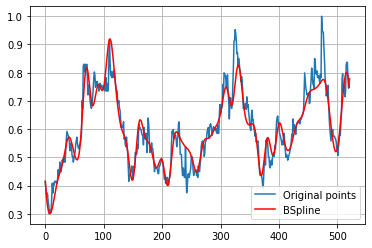

In [ ]:
import scipy.interpolate as interpolate

t_PNBN_55, c_PNBN_55, k_PNBN_55 = interpolate.splrep(PNBN_x55, PNBN_y55, s=0, k=3)
print('''\
t_PNBN_55: {}
c_PNBN_55: {}
k_PNBN_55: {}
'''.format(t_PNBN_55, c_PNBN_55, k_PNBN_55))
N = 522
xmin_PNBN_55, xmax_PNBN_55 = PNBN_x55.min(), PNBN_x55.max()
xx_PNBN_55 = np.linspace(xmin_PNBN_55, xmax_PNBN_55, N)
spline_PNBN_55 = interpolate.BSpline(t_PNBN_55, c_PNBN_55, k_PNBN_55, extrapolate=False)

plt.plot(PNBN_x, PNBN_y, label='Original points')
plt.plot(xx_PNBN_55, spline_PNBN_55(xx_PNBN_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA PNBN**

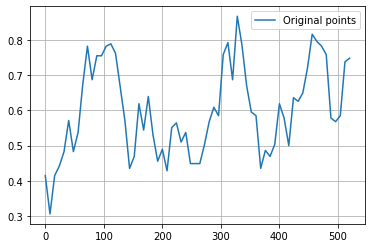

In [ ]:
PNBN_x65 = PNBN_x[0:522:8]
PNBN_y65 = PNBN_y[0:522:8]

plt.plot(PNBN_x65, PNBN_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PNBN_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_PNBN_65: [0.41496599 0.18070265 0.44811851 0.43779956 0.45632422 0.63486274
 0.43279623 0.53191151 0.66404751 0.85271477 0.61897097 0.79385034
 0.7362399  0.79180229 0.79042849 0.78117765 0.65628951 0.59366433
 0.39762459 0.42808222 0.70637305 0.46071129 0.71608792 0.51167173
 0.42089862 0.53942767 0.36016622 0.59133602 0.58061214 0.47397053
 0.58473024 0.41159832 0.46275403 0.43126313 0.50607102 0.56486096
 0.64264839 0.5176067  0.79712889 0.84489815 0.57838054 0.96402867
 0.76958643 0.67191134 0.56317638 0.64681172 0.35978083 0.52630985
 0.45334711 0.47662823 0.66054812 0.59546501 0.42697959 0.69661661
 0.6028805  0.64696

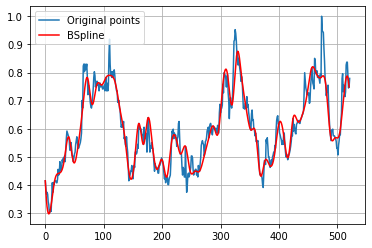

In [ ]:
import scipy.interpolate as interpolate

t_PNBN_65, c_PNBN_65, k_PNBN_65 = interpolate.splrep(PNBN_x65, PNBN_y65, s=0, k=3)
print('''\
t_PNBN_65: {}
c_PNBN_65: {}
k_PNBN_65: {}
'''.format(t_PNBN_65, c_PNBN_65, k_PNBN_65))
N = 522
xmin_PNBN_65, xmax_PNBN_65 = PNBN_x65.min(), PNBN_x65.max()
xx_PNBN_65 = np.linspace(xmin_PNBN_65, xmax_PNBN_65, N)
spline_PNBN_65 = interpolate.BSpline(t_PNBN_65, c_PNBN_65, k_PNBN_65, extrapolate=False)

plt.plot(PNBN_x, PNBN_y, label='Original points')
plt.plot(xx_PNBN_65, spline_PNBN_65(xx_PNBN_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE PNBN**

In [ ]:
#RMSE 15 DATA PNBN
y_true_PNBN_15 = PNBN_y.tolist()
y_pred_PNBN_15 = spline_PNBN_15(xx_PNBN_15).tolist()
mse_PNBN_15 = mean_squared_error(y_true_PNBN_15, y_pred_PNBN_15)
rmse_PNBN_15 = np.sqrt(mse_PNBN_15)
print("rmse PNBN 15 =",rmse_PNBN_15)

#RMSE 25 DATA PNBN
y_true_PNBN_25 = PNBN_y.tolist()
y_pred_PNBN_25 = spline_PNBN_25(xx_PNBN_25).tolist()
mse_PNBN_25 = mean_squared_error(y_true_PNBN_25, y_pred_PNBN_25)
rmse_PNBN_25 = np.sqrt(mse_PNBN_25)
print("rmse PNBN 25 =",rmse_PNBN_25)

#RMSE 35 DATA PNBN
y_true_PNBN_35 = PNBN_y.tolist()
y_pred_PNBN_35 = spline_PNBN_35(xx_PNBN_35).tolist()
mse_PNBN_35 = mean_squared_error(y_true_PNBN_35, y_pred_PNBN_35)
rmse_PNBN_35 = np.sqrt(mse_PNBN_35)
print("rmse PNBN 35 =",rmse_PNBN_35)

#RMSE 45 DATA PNBN
y_true_PNBN_45 = PNBN_y.tolist()
y_pred_PNBN_45 = spline_PNBN_45(xx_PNBN_45).tolist()
mse_PNBN_45 = mean_squared_error(y_true_PNBN_45, y_pred_PNBN_45)
rmse_PNBN_45 = np.sqrt(mse_PNBN_45)
print("rmse PNBN 45 =",rmse_PNBN_45)

#RMSE 55 DATA PNBN
y_true_PNBN_55 = PNBN_y.tolist()
y_pred_PNBN_55 = spline_PNBN_55(xx_PNBN_55).tolist()
mse_PNBN_55 = mean_squared_error(y_true_PNBN_55, y_pred_PNBN_55)
rmse_PNBN_55 = np.sqrt(mse_PNBN_55)
print("rmse PNBN 55 =",rmse_PNBN_55)

#RMSE 65 DATA PNBN
y_true_PNBN_65 = PNBN_y.tolist()
y_pred_PNBN_65 = spline_PNBN_65(xx_PNBN_65).tolist()
mse_PNBN_65 = mean_squared_error(y_true_PNBN_65, y_pred_PNBN_65)
rmse_PNBN_65 = np.sqrt(mse_PNBN_65)
print("rmse PNBN 65 =",rmse_PNBN_65)

rmse PNBN 15 = 0.11189794510779169
rmse PNBN 25 = 0.0994239386443898
rmse PNBN 35 = 0.08268513879618485
rmse PNBN 45 = 0.06313297407426567
rmse PNBN 55 = 0.048329450446828424
rmse PNBN 65 = 0.0446408760019491


# **PTBA**

No handles with labels found to put in legend.


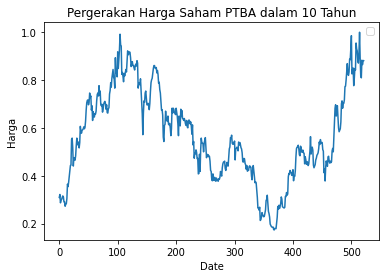

In [ ]:
PTBA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PTBA.JK.csv')

PTBA_x = PTBA['No'].values
PTBA_y = PTBA['Skala'].values

plt.plot(PTBA_x,PTBA_y)
plt.title('Pergerakan Harga Saham PTBA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA PTBA**

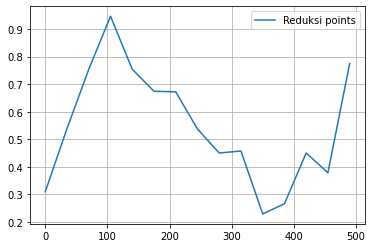

In [ ]:
PTBA_x15 = PTBA_x[0:522:35]
PTBA_y15 = PTBA_y[0:522:35]

plt.plot(PTBA_x15, PTBA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTBA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_PTBA_15: [0.30942623 0.50219037 0.61959467 1.06224052 0.70110967 0.65791096
 0.71232845 0.52556211 0.40673459 0.54627004 0.14998853 0.22467746
 0.6497938  0.12515433 0.77459016 0.         0.         0.
 0.        ]
k_PTBA_15: 3



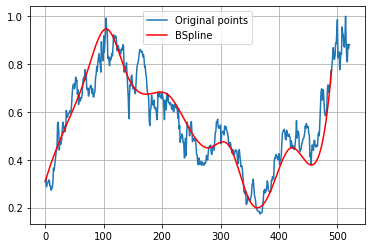

In [ ]:
import scipy.interpolate as interpolate

t_PTBA_15, c_PTBA_15, k_PTBA_15 = interpolate.splrep(PTBA_x15, PTBA_y15, s=0, k=3)
print('''\
t_PTBA_15: {}
c_PTBA_15: {}
k_PTBA_15: {}
'''.format(t_PTBA_15, c_PTBA_15, k_PTBA_15))
N = 522
xmin_PTBA_15, xmax_PTBA_15 = PTBA_x15.min(), PTBA_x15.max()
xx_PTBA_15 = np.linspace(xmin_PTBA_15, xmax_PTBA_15, N)
spline_PTBA_15 = interpolate.BSpline(t_PTBA_15, c_PTBA_15, k_PTBA_15, extrapolate=False)

plt.plot(PTBA_x, PTBA_y, label='Original points')
plt.plot(xx_PTBA_15, spline_PTBA_15(xx_PTBA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA PTBA**

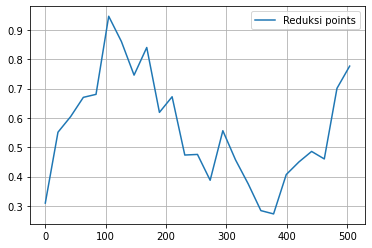

In [ ]:
PTBA_x25 = PTBA_x[0:522:21]
PTBA_y25 = PTBA_y[0:522:21]

plt.plot(PTBA_x25, PTBA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTBA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_PTBA_25: [0.30942623 0.60506127 0.53782827 0.71545705 0.57642815 1.06079756
 0.86070948 0.66029896 0.97350453 0.48666653 0.79294411 0.37434394
 0.54984408 0.27873876 0.65897138 0.42349048 0.38886999 0.27102958
 0.22988056 0.4446941  0.43191681 0.52640916 0.32637158 0.92928347
 0.77663934 0.         0.         0.         0.        ]
k_PTBA_25: 3



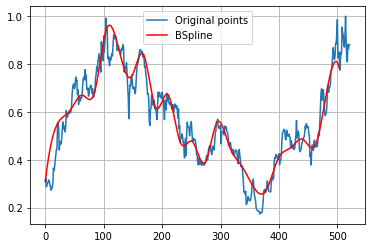

In [ ]:
import scipy.interpolate as interpolate

t_PTBA_25, c_PTBA_25, k_PTBA_25 = interpolate.splrep(PTBA_x25, PTBA_y25, s=0, k=3)
print('''\
t_PTBA_25: {}
c_PTBA_25: {}
k_PTBA_25: {}
'''.format(t_PTBA_25, c_PTBA_25, k_PTBA_25))
N = 522
xmin_PTBA_25, xmax_PTBA_25 = PTBA_x25.min(), PTBA_x25.max()
xx_PTBA_25 = np.linspace(xmin_PTBA_25, xmax_PTBA_25, N)
spline_PTBA_25 = interpolate.BSpline(t_PTBA_25, c_PTBA_25, k_PTBA_25, extrapolate=False)

plt.plot(PTBA_x, PTBA_y, label='Original points')
plt.plot(xx_PTBA_25, spline_PTBA_25(xx_PTBA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA PTBA**

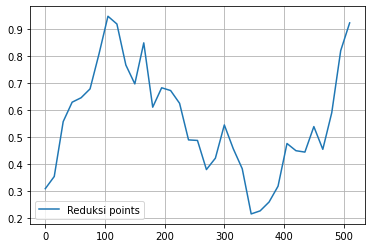

In [ ]:
PTBA_x35 = PTBA_x[0:522:15]
PTBA_y35 = PTBA_y[0:522:15]

plt.plot(PTBA_x35, PTBA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTBA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_PTBA_35: [0.30942623 0.20071266 0.58320583 0.63321722 0.64601263 0.65568309
 0.80092714 0.98487066 0.9399181  0.76365368 0.60382783 1.00136285
 0.4808847  0.73903276 0.65724653 0.66476799 0.43368151 0.53903055
 0.3364258  0.39600395 0.61234529 0.42510669 0.42903124 0.15794867
 0.23630522 0.26158453 0.27883208 0.53497241 0.43988483 0.40425877
 0.61111287 0.38489631 0.64344799 0.93954649 0.92213115 0.
 0.         0.         0.        ]
k_PTBA_35: 3



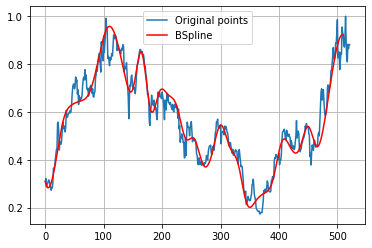

In [ ]:
import scipy.interpolate as interpolate

t_PTBA_35, c_PTBA_35, k_PTBA_35 = interpolate.splrep(PTBA_x35, PTBA_y35, s=0, k=3)
print('''\
t_PTBA_35: {}
c_PTBA_35: {}
k_PTBA_35: {}
'''.format(t_PTBA_35, c_PTBA_35, k_PTBA_35))
N = 522
xmin_PTBA_35, xmax_PTBA_35 = PTBA_x35.min(), PTBA_x35.max()
xx_PTBA_35 = np.linspace(xmin_PTBA_35, xmax_PTBA_35, N)
spline_PTBA_35 = interpolate.BSpline(t_PTBA_35, c_PTBA_35, k_PTBA_35, extrapolate=False)

plt.plot(PTBA_x, PTBA_y, label='Original points')
plt.plot(xx_PTBA_35, spline_PTBA_35(xx_PTBA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA PTBA**

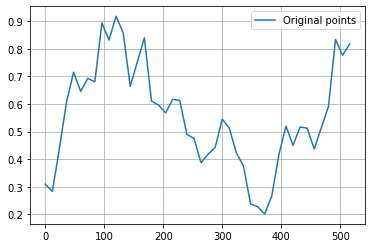

In [ ]:
PTBA_x45 = PTBA_x[0:522:12]
PTBA_y45 = PTBA_y[0:522:12]

plt.plot(PTBA_x45, PTBA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTBA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_PTBA_45: [0.30942623 0.18100838 0.39413078 0.60450055 0.77461885 0.58800766
 0.74630131 0.58252479 1.00556673 0.75586402 0.96278046 0.90121087
 0.58401541 0.74633404 0.9429435  0.52287557 0.62948864 0.53703871
 0.62809423 0.65140403 0.44251915 0.51704397 0.341764   0.43967053
 0.40775062 0.58506472 0.52248232 0.39877649 0.4151986  0.19042912
 0.24931443 0.17706725 0.25102311 0.41720097 0.57607465 0.39530371
 0.54148101 0.5371329  0.38375786 0.5466881  0.5155553  1.07091395
 0.60491188 0.81762295 0.         0.         0.         0.        ]
k_PTBA_45: 3



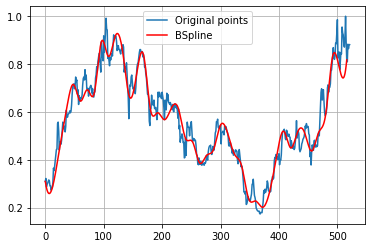

In [ ]:
import scipy.interpolate as interpolate

t_PTBA_45, c_PTBA_45, k_PTBA_45 = interpolate.splrep(PTBA_x45, PTBA_y45, s=0, k=3)
print('''\
t_PTBA_45: {}
c_PTBA_45: {}
k_PTBA_45: {}
'''.format(t_PTBA_45, c_PTBA_45, k_PTBA_45))
N = 522
xmin_PTBA_45, xmax_PTBA_45 = PTBA_x45.min(), PTBA_x45.max()
xx_PTBA_45 = np.linspace(xmin_PTBA_45, xmax_PTBA_45, N)
spline_PTBA_45 = interpolate.BSpline(t_PTBA_45, c_PTBA_45, k_PTBA_45, extrapolate=False)

plt.plot(PTBA_x, PTBA_y, label='Original points')
plt.plot(xx_PTBA_45, spline_PTBA_45(xx_PTBA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA PTBA**

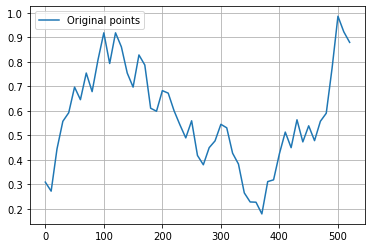

In [ ]:
PTBA_x55 = PTBA_x[0:522:10]
PTBA_y55 = PTBA_y[0:522:10]

plt.plot(PTBA_x55, PTBA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTBA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_PTBA_55: [0.30942623 0.14576112 0.42159251 0.58277517 0.55127343 0.7654098
 0.56741524 0.83788007 0.60565465 0.80917346 1.00191381 0.69136803
 0.99081079 0.85358555 0.75878146 0.63587878 0.87803127 0.81920925
 0.56644322 0.5789523  0.70791151 0.68366397 0.59021951 0.557917
 0.43630922 0.63537073 0.37876525 0.35776497 0.47091255 0.45735531
 0.5644203  0.55545531 0.39818471 0.41533043 0.23967388 0.21818717
 0.25847907 0.11265065 0.36919702 0.27941372 0.42503335 0.57168238
 0.36815515 0.65446752 0.3951223  0.6052072  0.41765546 0.5950726
 0.54631642 0.76064531 1.15797599 0.79908578 0.87909836 0.
 0.         0.         0.        ]
k_PTBA_55: 3



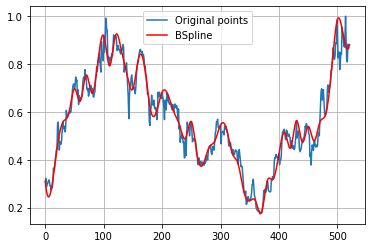

In [ ]:
import scipy.interpolate as interpolate

t_PTBA_55, c_PTBA_55, k_PTBA_55 = interpolate.splrep(PTBA_x55, PTBA_y55, s=0, k=3)
print('''\
t_PTBA_55: {}
c_PTBA_55: {}
k_PTBA_55: {}
'''.format(t_PTBA_55, c_PTBA_55, k_PTBA_55))
N = 522
xmin_PTBA_55, xmax_PTBA_55 = PTBA_x55.min(), PTBA_x55.max()
xx_PTBA_55 = np.linspace(xmin_PTBA_55, xmax_PTBA_55, N)
spline_PTBA_55 = interpolate.BSpline(t_PTBA_55, c_PTBA_55, k_PTBA_55, extrapolate=False)

plt.plot(PTBA_x, PTBA_y, label='Original points')
plt.plot(xx_PTBA_55, spline_PTBA_55(xx_PTBA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA PTBA**

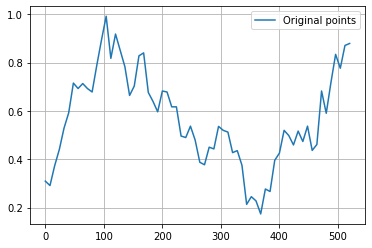

In [ ]:
PTBA_x65 = PTBA_x[0:522:8]
PTBA_y65 = PTBA_y[0:522:8]

plt.plot(PTBA_x65, PTBA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTBA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_PTBA_65: [0.30942623 0.22694997 0.36884597 0.42845918 0.54585661 0.56024554
 0.76643993 0.66497836 0.72938434 0.69617281 0.64166211 0.80685087
 0.86454096 1.09564102 0.70371463 0.99523817 0.8235294  0.81310323
 0.62077897 0.68738743 0.8468844  0.89228807 0.62494692 0.66530129
 0.54991348 0.71291363 0.69269428 0.58598137 0.66419993 0.45803861
 0.47905549 0.56426404 0.48519984 0.37198578 0.35062753 0.48779917
 0.39694629 0.58015338 0.49760414 0.54623335 0.39123294 0.45235946
 0.41203413 0.14950402 0.26863831 0.24520505 0.11529561 0.33500597
 0.20451657 0.44528839 0.38728067 0.55681842 0.50224893 0.42189078
 0.56428629 0.41932

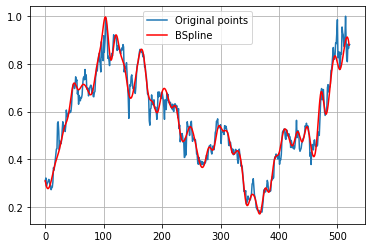

In [ ]:
import scipy.interpolate as interpolate

t_PTBA_65, c_PTBA_65, k_PTBA_65 = interpolate.splrep(PTBA_x65, PTBA_y65, s=0, k=3)
print('''\
t_PTBA_65: {}
c_PTBA_65: {}
k_PTBA_65: {}
'''.format(t_PTBA_65, c_PTBA_65, k_PTBA_65))
N = 522
xmin_PTBA_65, xmax_PTBA_65 = PTBA_x65.min(), PTBA_x65.max()
xx_PTBA_65 = np.linspace(xmin_PTBA_65, xmax_PTBA_65, N)
spline_PTBA_65 = interpolate.BSpline(t_PTBA_65, c_PTBA_65, k_PTBA_65, extrapolate=False)

plt.plot(PTBA_x, PTBA_y, label='Original points')
plt.plot(xx_PTBA_65, spline_PTBA_65(xx_PTBA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE PTBA**

In [ ]:

#RMSE 15 DATA PTBA
y_true_PTBA_15 = PTBA_y.tolist()
y_pred_PTBA_15 = spline_PTBA_15(xx_PTBA_15).tolist()
mse_PTBA_15 = mean_squared_error(y_true_PTBA_15, y_pred_PTBA_15)
rmse_PTBA_15 = np.sqrt(mse_PTBA_15)
print("rmse PTBA 15 =",rmse_PTBA_15)

#RMSE 25 DATA PTBA
y_true_PTBA_25 = PTBA_y.tolist()
y_pred_PTBA_25 = spline_PTBA_25(xx_PTBA_25).tolist()
mse_PTBA_25 = mean_squared_error(y_true_PTBA_25, y_pred_PTBA_25)
rmse_PTBA_25 = np.sqrt(mse_PTBA_25)
print("rmse PTBA 25 =",rmse_PTBA_25)

#RMSE 35 DATA PTBA
y_true_PTBA_35 = PTBA_y.tolist()
y_pred_PTBA_35 = spline_PTBA_35(xx_PTBA_35).tolist()
mse_PTBA_35 = mean_squared_error(y_true_PTBA_35, y_pred_PTBA_35)
rmse_PTBA_35 = np.sqrt(mse_PTBA_35)
print("rmse PTBA 35 =",rmse_PTBA_35)

#RMSE 45 DATA PTBA
y_true_PTBA_45 = PTBA_y.tolist()
y_pred_PTBA_45 = spline_PTBA_45(xx_PTBA_45).tolist()
mse_PTBA_45 = mean_squared_error(y_true_PTBA_45, y_pred_PTBA_45)
rmse_PTBA_45 = np.sqrt(mse_PTBA_45)
print("rmse PTBA 45 =",rmse_PTBA_45)

#RMSE 55 DATA PTBA
y_true_PTBA_55 = PTBA_y.tolist()
y_pred_PTBA_55 = spline_PTBA_55(xx_PTBA_55).tolist()
mse_PTBA_55 = mean_squared_error(y_true_PTBA_55, y_pred_PTBA_55)
rmse_PTBA_55 = np.sqrt(mse_PTBA_55)
print("rmse PTBA 55 =",rmse_PTBA_55)

#RMSE 65 DATA PTBA
y_true_PTBA_65 = PTBA_y.tolist()
y_pred_PTBA_65 = spline_PTBA_65(xx_PTBA_65).tolist()
mse_PTBA_65 = mean_squared_error(y_true_PTBA_65, y_pred_PTBA_65)
rmse_PTBA_65 = np.sqrt(mse_PTBA_65)
print("rmse PTBA 65 =",rmse_PTBA_65)

rmse PTBA 15 = 0.13937193633875564
rmse PTBA 25 = 0.0858878676982719
rmse PTBA 35 = 0.0711158105882386
rmse PTBA 45 = 0.056214045909303664
rmse PTBA 55 = 0.044367491261129696
rmse PTBA 65 = 0.038454422179762714


# **PTRO**

No handles with labels found to put in legend.


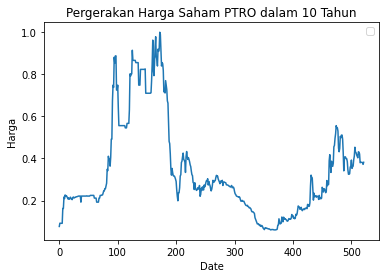

In [ ]:
PTRO = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PTRO.JK.csv')

PTRO_x = PTRO['No'].values
PTRO_y = PTRO['Skala'].values

plt.plot(PTRO_x,PTRO_y)
plt.title('Pergerakan Harga Saham PTRO dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA PTRO**

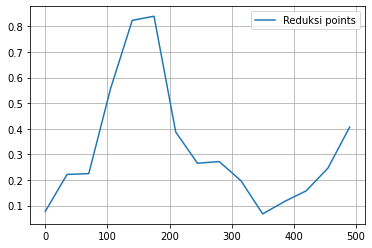

In [ ]:
PTRO_x15 = PTRO_x[0:522:35]
PTRO_y15 = PTRO_y[0:522:35]

plt.plot(PTRO_x15, PTRO_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTRO_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_PTRO_15: [ 0.07700535  0.38085904 -0.02695872  0.59177497  0.84207381  0.98110627
  0.27093426  0.25815135  0.28790418  0.22017844  0.01213071  0.13429337
  0.14689414  0.27762245  0.40641711  0.          0.          0.
  0.        ]
k_PTRO_15: 3



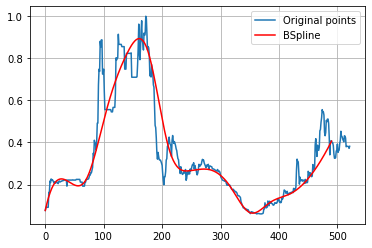

In [ ]:
import scipy.interpolate as interpolate

t_PTRO_15, c_PTRO_15, k_PTRO_15 = interpolate.splrep(PTRO_x15, PTRO_y15, s=0, k=3)
print('''\
t_PTRO_15: {}
c_PTRO_15: {}
k_PTRO_15: {}
'''.format(t_PTRO_15, c_PTRO_15, k_PTRO_15))
N = 522
xmin_PTRO_15, xmax_PTRO_15 = PTRO_x15.min(), PTRO_x15.max()
xx_PTRO_15 = np.linspace(xmin_PTRO_15, xmax_PTRO_15, N)
spline_PTRO_15 = interpolate.BSpline(t_PTRO_15, c_PTRO_15, k_PTRO_15, extrapolate=False)

plt.plot(PTRO_x, PTRO_y, label='Original points')
plt.plot(xx_PTRO_15, spline_PTRO_15(xx_PTRO_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA PTRO**

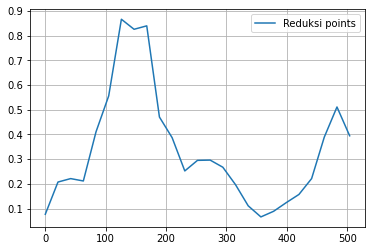

In [ ]:
PTRO_x25 = PTRO_x[0:522:21]
PTRO_y25 = PTRO_y[0:522:21]

plt.plot(PTRO_x25, PTRO_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTRO_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_PTRO_25: [0.07700535 0.20409018 0.27256829 0.14186057 0.46325459 0.46929218
 0.99647507 0.74266848 0.98686171 0.34731786 0.44739627 0.18609171
 0.3226754  0.2943297  0.2775459  0.19976477 0.10414369 0.05104017
 0.08955659 0.12463723 0.15627953 0.19356016 0.46590939 0.59351589
 0.39465241 0.         0.         0.         0.        ]
k_PTRO_25: 3



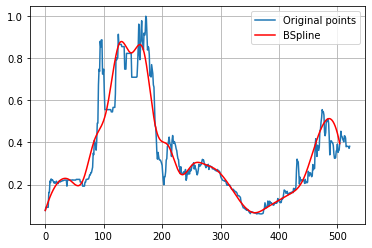

In [ ]:
import scipy.interpolate as interpolate

t_PTRO_25, c_PTRO_25, k_PTRO_25 = interpolate.splrep(PTRO_x25, PTRO_y25, s=0, k=3)
print('''\
t_PTRO_25: {}
c_PTRO_25: {}
k_PTRO_25: {}
'''.format(t_PTRO_25, c_PTRO_25, k_PTRO_25))
N = 522
xmin_PTRO_25, xmax_PTRO_25 = PTRO_x25.min(), PTRO_x25.max()
xx_PTRO_25 = np.linspace(xmin_PTRO_25, xmax_PTRO_25, N)
spline_PTRO_25 = interpolate.BSpline(t_PTRO_25, c_PTRO_25, k_PTRO_25, extrapolate=False)

plt.plot(PTRO_x, PTRO_y, label='Original points')
plt.plot(xx_PTRO_25, spline_PTRO_25(xx_PTRO_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA PTRO**

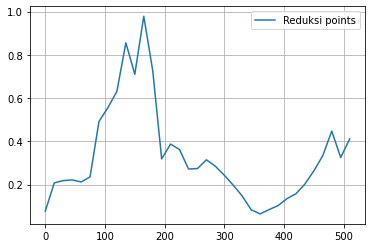

In [ ]:
PTRO_x35 = PTRO_x[0:522:15]
PTRO_y35 = PTRO_y[0:522:15]

plt.plot(PTRO_x35, PTRO_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTRO_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_PTRO_35: [0.07700535 0.23515328 0.21204639 0.22275038 0.22261832 0.15736458
 0.55968808 0.55575477 0.55419125 1.01357647 0.52519269 1.14661534
 0.76000371 0.17700618 0.44427104 0.36890431 0.24909569 0.26465946
 0.33504721 0.28178273 0.24477374 0.19580681 0.15274767 0.07234689
 0.0558327  0.08806564 0.09628978 0.14025117 0.15126169 0.19801758
 0.26950223 0.30258313 0.5955447  0.13805653 0.41069519 0.
 0.         0.         0.        ]
k_PTRO_35: 3



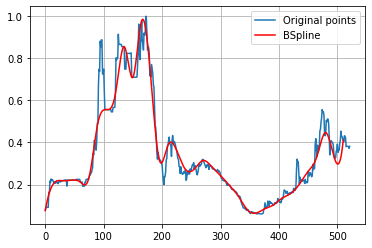

In [ ]:
import scipy.interpolate as interpolate

t_PTRO_35, c_PTRO_35, k_PTRO_35 = interpolate.splrep(PTRO_x35, PTRO_y35, s=0, k=3)
print('''\
t_PTRO_35: {}
c_PTRO_35: {}
k_PTRO_35: {}
'''.format(t_PTRO_35, c_PTRO_35, k_PTRO_35))
N = 522
xmin_PTRO_35, xmax_PTRO_35 = PTRO_x35.min(), PTRO_x35.max()
xx_PTRO_35 = np.linspace(xmin_PTRO_35, xmax_PTRO_35, N)
spline_PTRO_35 = interpolate.BSpline(t_PTRO_35, c_PTRO_35, k_PTRO_35, extrapolate=False)

plt.plot(PTRO_x, PTRO_y, label='Original points')
plt.plot(xx_PTRO_35, spline_PTRO_35(xx_PTRO_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA PTRO**

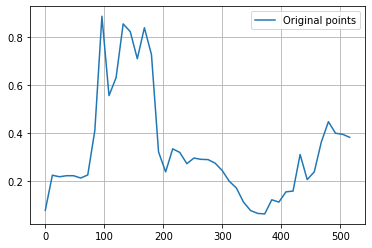

In [ ]:
PTRO_x45 = PTRO_x[0:522:12]
PTRO_y45 = PTRO_y[0:522:12]

plt.plot(PTRO_x45, PTRO_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTRO_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_PTRO_45: [0.07700535 0.27264763 0.20176357 0.22418173 0.2242472  0.20717172
 0.21765415 0.26980525 1.16729596 0.38721411 0.62074599 0.91589817
 0.84935117 0.62787362 0.90011692 0.80909186 0.227152   0.20743383
 0.36771163 0.32385871 0.24915299 0.30947585 0.2840666  0.29329517
 0.27537303 0.24799346 0.18933764 0.18182176 0.10369618 0.0707732
 0.06882599 0.03766616 0.15141848 0.08179361 0.18878676 0.08712351
 0.4060347  0.14970026 0.22724984 0.36589931 0.48455401 0.34279881
 0.42271824 0.38181818 0.         0.         0.         0.        ]
k_PTRO_45: 3



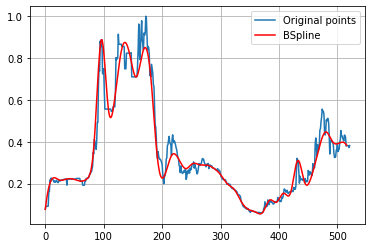

In [ ]:
import scipy.interpolate as interpolate

t_PTRO_45, c_PTRO_45, k_PTRO_45 = interpolate.splrep(PTRO_x45, PTRO_y45, s=0, k=3)
print('''\
t_PTRO_45: {}
c_PTRO_45: {}
k_PTRO_45: {}
'''.format(t_PTRO_45, c_PTRO_45, k_PTRO_45))
N = 522
xmin_PTRO_45, xmax_PTRO_45 = PTRO_x45.min(), PTRO_x45.max()
xx_PTRO_45 = np.linspace(xmin_PTRO_45, xmax_PTRO_45, N)
spline_PTRO_45 = interpolate.BSpline(t_PTRO_45, c_PTRO_45, k_PTRO_45, extrapolate=False)

plt.plot(PTRO_x, PTRO_y, label='Original points')
plt.plot(xx_PTRO_45, spline_PTRO_45(xx_PTRO_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA PTRO**

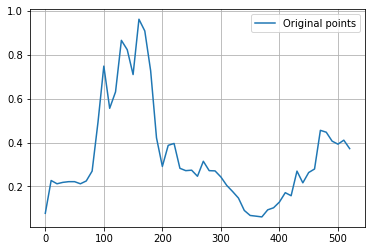

In [ ]:
PTRO_x55 = PTRO_x[0:522:10]
PTRO_y55 = PTRO_y[0:522:10]

plt.plot(PTRO_x55, PTRO_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_PTRO_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_PTRO_55: [0.07700535 0.2861137  0.19033944 0.22269049 0.21990175 0.22604476
 0.20426146 0.22749762 0.23334163 0.45624815 0.89353743 0.46158073
 0.59703806 0.93636329 0.85536975 0.58333419 1.07225606 0.90304263
 0.77011886 0.38011829 0.23775023 0.41433533 0.42790311 0.24838378
 0.27267943 0.29084504 0.20672117 0.35820612 0.24708536 0.28339895
 0.24284824 0.20189258 0.17524988 0.15593143 0.08016877 0.06371433
 0.06796856 0.04815476 0.10262096 0.09836674 0.117388   0.20213472
 0.10081109 0.33793642 0.16455555 0.30009809 0.21366173 0.52012131
 0.43954288 0.4040601  0.3756058  0.442411   0.37219251 0.
 0.         0.         0.        ]
k_PTRO_55: 3



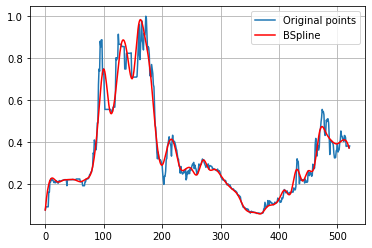

In [ ]:
import scipy.interpolate as interpolate

t_PTRO_55, c_PTRO_55, k_PTRO_55 = interpolate.splrep(PTRO_x55, PTRO_y55, s=0, k=3)
print('''\
t_PTRO_55: {}
c_PTRO_55: {}
k_PTRO_55: {}
'''.format(t_PTRO_55, c_PTRO_55, k_PTRO_55))
N = 522
xmin_PTRO_55, xmax_PTRO_55 = PTRO_x55.min(), PTRO_x55.max()
xx_PTRO_55 = np.linspace(xmin_PTRO_55, xmax_PTRO_55, N)
spline_PTRO_55 = interpolate.BSpline(t_PTRO_55, c_PTRO_55, k_PTRO_55, extrapolate=False)

plt.plot(PTRO_x, PTRO_y, label='Original points')
plt.plot(xx_PTRO_55, spline_PTRO_55(xx_PTRO_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA PTRO**

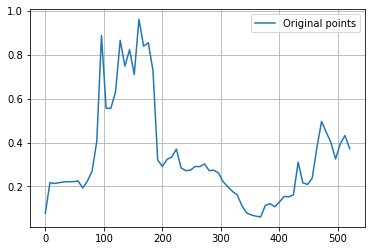

In [ ]:
PTRO_x65 = PTRO_x[0:522:8]
PTRO_y65 = PTRO_y[0:522:8]

plt.plot(PTRO_x65, PTRO_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PTRO_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_PTRO_65: [0.07700535 0.26236361 0.19880219 0.21971115 0.21979977 0.22301492
 0.21648281 0.2393961  0.17352638 0.22157861 0.28775276 0.24452264
 1.17265936 0.39104312 0.60006656 0.54558905 1.00367349 0.63757795
 0.93799331 0.5516253  1.11646808 0.75790345 0.88935129 0.81838124
 0.20076011 0.30371199 0.32984646 0.3148701  0.4128122  0.25420197
 0.27733179 0.26641738 0.29977945 0.27991938 0.31958048 0.25780148
 0.2791601  0.26833884 0.21325992 0.2005466  0.17171946 0.17139909
 0.10525102 0.07497651 0.06842583 0.06843249 0.04158752 0.12842596
 0.12492253 0.09701762 0.12871823 0.15816295 0.16269413 0.10229047
 0.39712793 0.17016

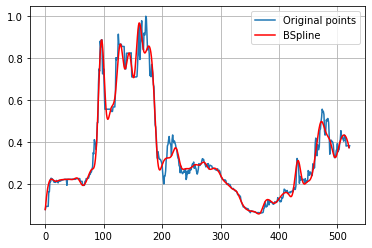

In [ ]:
import scipy.interpolate as interpolate

t_PTRO_65, c_PTRO_65, k_PTRO_65 = interpolate.splrep(PTRO_x65, PTRO_y65, s=0, k=3)
print('''\
t_PTRO_65: {}
c_PTRO_65: {}
k_PTRO_65: {}
'''.format(t_PTRO_65, c_PTRO_65, k_PTRO_65))
N = 522
xmin_PTRO_65, xmax_PTRO_65 = PTRO_x65.min(), PTRO_x65.max()
xx_PTRO_65 = np.linspace(xmin_PTRO_65, xmax_PTRO_65, N)
spline_PTRO_65 = interpolate.BSpline(t_PTRO_65, c_PTRO_65, k_PTRO_65, extrapolate=False)

plt.plot(PTRO_x, PTRO_y, label='Original points')
plt.plot(xx_PTRO_65, spline_PTRO_65(xx_PTRO_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE PTRO**

In [ ]:

#RMSE 15 DATA PTRO
y_true_PTRO_15 = PTRO_y.tolist()
y_pred_PTRO_15 = spline_PTRO_15(xx_PTRO_15).tolist()
mse_PTRO_15 = mean_squared_error(y_true_PTRO_15, y_pred_PTRO_15)
rmse_PTRO_15 = np.sqrt(mse_PTRO_15)
print("rmse PTRO 15 =",rmse_PTRO_15)

#RMSE 25 DATA PTRO
y_true_PTRO_25 = PTRO_y.tolist()
y_pred_PTRO_25 = spline_PTRO_25(xx_PTRO_25).tolist()
mse_PTRO_25 = mean_squared_error(y_true_PTRO_25, y_pred_PTRO_25)
rmse_PTRO_25 = np.sqrt(mse_PTRO_25)
print("rmse PTRO 25 =",rmse_PTRO_25)

#RMSE 35 DATA PTRO
y_true_PTRO_35 = PTRO_y.tolist()
y_pred_PTRO_35 = spline_PTRO_35(xx_PTRO_35).tolist()
mse_PTRO_35 = mean_squared_error(y_true_PTRO_35, y_pred_PTRO_35)
rmse_PTRO_35 = np.sqrt(mse_PTRO_35)
print("rmse PTRO 35 =",rmse_PTRO_35)

#RMSE 45 DATA PTRO
y_true_PTRO_45 = PTRO_y.tolist()
y_pred_PTRO_45 = spline_PTRO_45(xx_PTRO_45).tolist()
mse_PTRO_45 = mean_squared_error(y_true_PTRO_45, y_pred_PTRO_45)
rmse_PTRO_45 = np.sqrt(mse_PTRO_45)
print("rmse PTRO 45 =",rmse_PTRO_45)

#RMSE 55 DATA PTRO
y_true_PTRO_55 = PTRO_y.tolist()
y_pred_PTRO_55 = spline_PTRO_55(xx_PTRO_55).tolist()
mse_PTRO_55 = mean_squared_error(y_true_PTRO_55, y_pred_PTRO_55)
rmse_PTRO_55 = np.sqrt(mse_PTRO_55)
print("rmse PTRO 55 =",rmse_PTRO_55)

#RMSE 65 DATA PTRO
y_true_PTRO_65 = PTRO_y.tolist()
y_pred_PTRO_65 = spline_PTRO_65(xx_PTRO_65).tolist()
mse_PTRO_65 = mean_squared_error(y_true_PTRO_65, y_pred_PTRO_65)
rmse_PTRO_65 = np.sqrt(mse_PTRO_65)
print("rmse PTRO 65 =",rmse_PTRO_65)


rmse PTRO 15 = 0.12759465904102202
rmse PTRO 25 = 0.078591712842551
rmse PTRO 35 = 0.06702231434311498
rmse PTRO 45 = 0.053836897269741904
rmse PTRO 55 = 0.04690812585049504
rmse PTRO 65 = 0.03905312137562699


# **PWON**

No handles with labels found to put in legend.


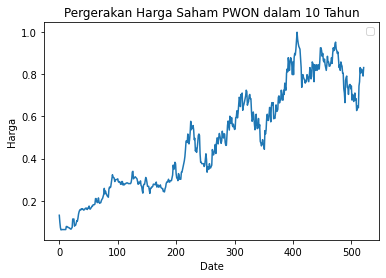

In [ ]:
PWON = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PWON.JK.csv')

PWON_x = PWON['No'].values
PWON_y = PWON['Skala'].values

plt.plot(PWON_x,PWON_y)
plt.title('Pergerakan Harga Saham PWON dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA PWON**

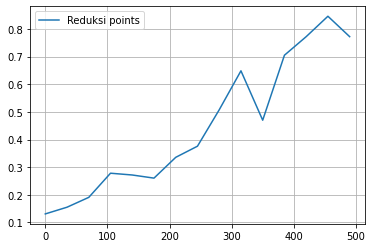

In [ ]:
PWON_x15 = PWON_x[0:522:35]
PWON_y15 = PWON_y[0:522:35]

plt.plot(PWON_x15, PWON_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PWON_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_PWON_15: [0.13099383 0.16686074 0.12637557 0.30624644 0.27262937 0.23338375
 0.35625173 0.35503215 0.47865322 0.77465028 0.31267857 0.7934274
 0.72459053 0.94307386 0.77181208 0.         0.         0.
 0.        ]
k_PWON_15: 3



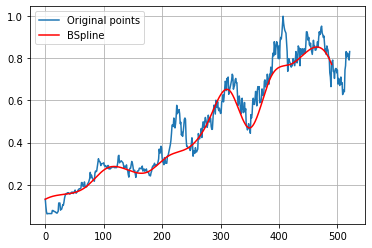

In [ ]:
import scipy.interpolate as interpolate

t_PWON_15, c_PWON_15, k_PWON_15 = interpolate.splrep(PWON_x15, PWON_y15, s=0, k=3)
print('''\
t_PWON_15: {}
c_PWON_15: {}
k_PWON_15: {}
'''.format(t_PWON_15, c_PWON_15, k_PWON_15))
N = 522
xmin_PWON_15, xmax_PWON_15 = PWON_x15.min(), PWON_x15.max()
xx_PWON_15 = np.linspace(xmin_PWON_15, xmax_PWON_15, N)
spline_PWON_15 = interpolate.BSpline(t_PWON_15, c_PWON_15, k_PWON_15, extrapolate=False)

plt.plot(PWON_x, PWON_y, label='Original points')
plt.plot(xx_PWON_15, spline_PWON_15(xx_PWON_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA PWON**

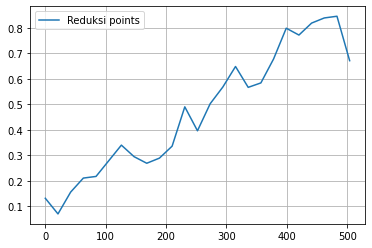

In [ ]:
PWON_x25 = PWON_x[0:522:21]
PWON_y25 = PWON_y[0:522:21]

plt.plot(PWON_x25, PWON_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PWON_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_PWON_25: [ 0.13099383 -0.00561967  0.14627573  0.2238374   0.20040973  0.27475989
  0.36950912  0.2848841   0.25694368  0.29807945  0.28228216  0.58621474
  0.31245621  0.53979935  0.54042693  0.70520434  0.5286886   0.57869896
  0.65987124  0.84893017  0.7363544   0.83652473  0.82822288  0.89964695
  0.67114094  0.          0.          0.          0.        ]
k_PWON_25: 3



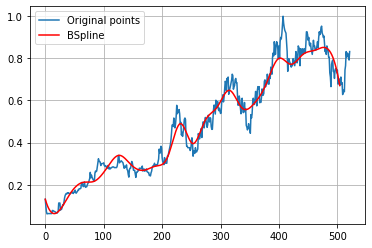

In [ ]:
import scipy.interpolate as interpolate

t_PWON_25, c_PWON_25, k_PWON_25 = interpolate.splrep(PWON_x25, PWON_y25, s=0, k=3)
print('''\
t_PWON_25: {}
c_PWON_25: {}
k_PWON_25: {}
'''.format(t_PWON_25, c_PWON_25, k_PWON_25))
N = 522
xmin_PWON_25, xmax_PWON_25 = PWON_x25.min(), PWON_x25.max()
xx_PWON_25 = np.linspace(xmin_PWON_25, xmax_PWON_25, N)
spline_PWON_25 = interpolate.BSpline(t_PWON_25, c_PWON_25, k_PWON_25, extrapolate=False)

plt.plot(PWON_x, PWON_y, label='Original points')
plt.plot(xx_PWON_25, spline_PWON_25(xx_PWON_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA PWON**

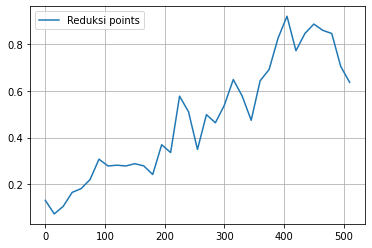

In [ ]:
PWON_x35 = PWON_x[0:522:15]
PWON_y35 = PWON_y[0:522:15]

plt.plot(PWON_x35, PWON_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PWON_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_PWON_35: [0.13099383 0.05049332 0.0720547  0.1784329  0.17735334 0.19891884
 0.34660885 0.25826454 0.28929141 0.27293767 0.28791634 0.30257545
 0.1729228  0.45539778 0.22025118 0.67702032 0.5347548  0.24436315
 0.58175232 0.41654704 0.530583   0.69065114 0.5967453  0.38545489
 0.70438817 0.65471056 0.8244206  1.00062719 0.68984915 0.87084868
 0.90058164 0.842261   0.89889535 0.5894785  0.63624161 0.
 0.         0.         0.        ]
k_PWON_35: 3



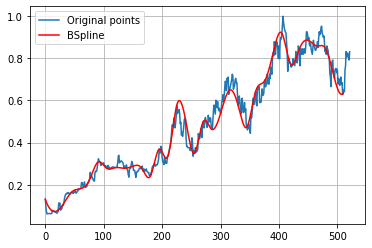

In [ ]:
import scipy.interpolate as interpolate

t_PWON_35, c_PWON_35, k_PWON_35 = interpolate.splrep(PWON_x35, PWON_y35, s=0, k=3)
print('''\
t_PWON_35: {}
c_PWON_35: {}
k_PWON_35: {}
'''.format(t_PWON_35, c_PWON_35, k_PWON_35))
N = 522
xmin_PWON_35, xmax_PWON_35 = PWON_x35.min(), PWON_x35.max()
xx_PWON_35 = np.linspace(xmin_PWON_35, xmax_PWON_35, N)
spline_PWON_35 = interpolate.BSpline(t_PWON_35, c_PWON_35, k_PWON_35, extrapolate=False)

plt.plot(PWON_x, PWON_y, label='Original points')
plt.plot(xx_PWON_35, spline_PWON_35(xx_PWON_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 45 DATA PWON**

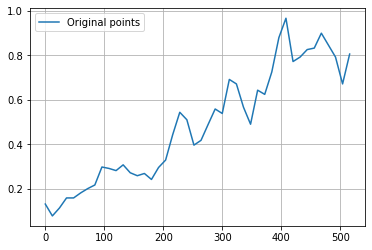

In [ ]:
PWON_x45 = PWON_x[0:522:12]
PWON_y45 = PWON_y[0:522:12]

plt.plot(PWON_x45, PWON_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PWON_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_PWON_45: [0.13099383 0.04905974 0.09028501 0.17278503 0.14886528 0.18266929
 0.20722267 0.19164534 0.32643218 0.28802456 0.26804949 0.32814532
 0.26298803 0.25005026 0.2871465  0.21210201 0.31410991 0.30327045
 0.44596267 0.570597   0.53339429 0.35622851 0.41753058 0.47834714
 0.60062446 0.46949058 0.75094343 0.6743867  0.57835543 0.41084932
 0.71784461 0.57549037 0.72516034 0.87286156 1.0585612  0.69155134
 0.80610591 0.83570289 0.80410269 0.94117496 0.82717065 0.82290041
 0.53150282 0.80536913 0.         0.         0.         0.        ]
k_PWON_45: 3



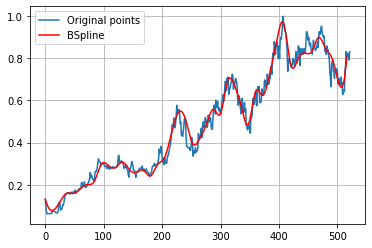

In [ ]:
import scipy.interpolate as interpolate

t_PWON_45, c_PWON_45, k_PWON_45 = interpolate.splrep(PWON_x45, PWON_y45, s=0, k=3)
print('''\
t_PWON_45: {}
c_PWON_45: {}
k_PWON_45: {}
'''.format(t_PWON_45, c_PWON_45, k_PWON_45))
N = 522
xmin_PWON_45, xmax_PWON_45 = PWON_x45.min(), PWON_x45.max()
xx_PWON_45 = np.linspace(xmin_PWON_45, xmax_PWON_45, N)
spline_PWON_45 = interpolate.BSpline(t_PWON_45, c_PWON_45, k_PWON_45, extrapolate=False)

plt.plot(PWON_x, PWON_y, label='Original points')
plt.plot(xx_PWON_45, spline_PWON_45(xx_PWON_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**5. PERCOBAAN 55 DATA PWON**

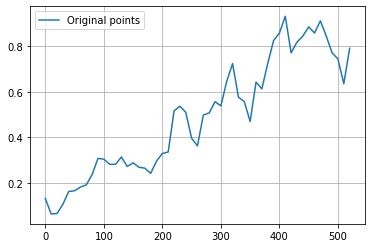

In [ ]:
PWON_x55 = PWON_x[0:522:10]
PWON_y55 = PWON_y[0:522:10]

plt.plot(PWON_x55, PWON_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PWON_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_PWON_55: [0.13099383 0.05377469 0.04689358 0.0979841  0.17910773 0.15590981
 0.18698724 0.18290633 0.22637272 0.32827934 0.30412872 0.27941517
 0.26657847 0.34263881 0.24529584 0.30632552 0.25658053 0.2780906
 0.21763423 0.30103691 0.35003023 0.27199655 0.57540638 0.52704905
 0.53787394 0.38185787 0.31053352 0.55050469 0.47536716 0.59232195
 0.49762691 0.64670063 0.79744977 0.51249358 0.61566317 0.36713562
 0.73458629 0.55223733 0.73700129 0.84875079 0.82101568 1.02154891
 0.69010412 0.84890711 0.82701914 0.91684185 0.82104969 0.95332182
 0.84217311 0.75181126 0.79133537 0.49258735 0.79194631 0.
 0.         0.         0.        ]
k_PWON_55: 3



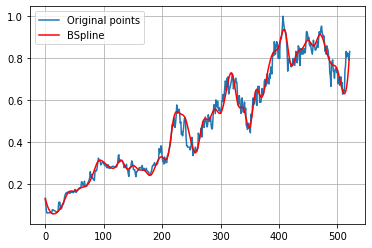

In [ ]:
import scipy.interpolate as interpolate

t_PWON_55, c_PWON_55, k_PWON_55 = interpolate.splrep(PWON_x55, PWON_y55, s=0, k=3)
print('''\
t_PWON_55: {}
c_PWON_55: {}
k_PWON_55: {}
'''.format(t_PWON_55, c_PWON_55, k_PWON_55))
N = 522
xmin_PWON_55, xmax_PWON_55 = PWON_x55.min(), PWON_x55.max()
xx_PWON_55 = np.linspace(xmin_PWON_55, xmax_PWON_55, N)
spline_PWON_55 = interpolate.BSpline(t_PWON_55, c_PWON_55, k_PWON_55, extrapolate=False)

plt.plot(PWON_x, PWON_y, label='Original points')
plt.plot(xx_PWON_55, spline_PWON_55(xx_PWON_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**6. PERCOBAAN 65 DATA PWON**

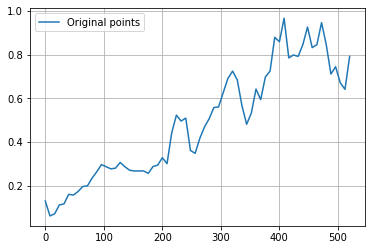

In [ ]:
PWON_x65 = PWON_x[0:522:8]
PWON_y65 = PWON_y[0:522:8]

plt.plot(PWON_x65, PWON_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_PWON_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_PWON_65: [0.13099383 0.05369424 0.04301145 0.12873925 0.09982621 0.18029254
 0.14932847 0.173309   0.20538178 0.1889599  0.24198395 0.25978088
 0.31022135 0.28473233 0.2780278  0.2721149  0.32188046 0.28398207
 0.26936974 0.26868665 0.26662192 0.27556394 0.24186056 0.30330253
 0.27647294 0.36261777 0.24621033 0.46462146 0.55302197 0.46423026
 0.56992278 0.31648132 0.33864858 0.42288411 0.47451297 0.49785595
 0.57835854 0.53904545 0.63190261 0.69441792 0.7380767  0.70226857
 0.56023158 0.45546282 0.50919231 0.70508339 0.52819226 0.7499328
 0.659996   0.95907648 0.77886586 1.07982248 0.70050192 0.82957922
 0.77312752 0.829588

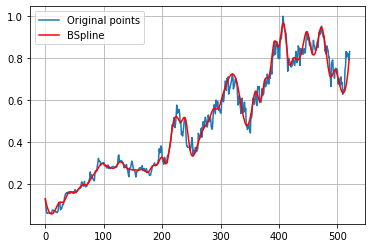

In [ ]:
import scipy.interpolate as interpolate

t_PWON_65, c_PWON_65, k_PWON_65 = interpolate.splrep(PWON_x65, PWON_y65, s=0, k=3)
print('''\
t_PWON_65: {}
c_PWON_65: {}
k_PWON_65: {}
'''.format(t_PWON_65, c_PWON_65, k_PWON_65))
N = 522
xmin_PWON_65, xmax_PWON_65 = PWON_x65.min(), PWON_x65.max()
xx_PWON_65 = np.linspace(xmin_PWON_65, xmax_PWON_65, N)
spline_PWON_65 = interpolate.BSpline(t_PWON_65, c_PWON_65, k_PWON_65, extrapolate=False)

plt.plot(PWON_x, PWON_y, label='Original points')
plt.plot(xx_PWON_65, spline_PWON_65(xx_PWON_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE PWON**

In [ ]:

#RMSE 15 DATA PWON
y_true_PWON_15 = PWON_y.tolist()
y_pred_PWON_15 = spline_PWON_15(xx_PWON_15).tolist()
mse_PWON_15 = mean_squared_error(y_true_PWON_15, y_pred_PWON_15)
rmse_PWON_15 = np.sqrt(mse_PWON_15)
print("rmse PWON 15 =",rmse_PWON_15)

#RMSE 25 DATA PWON
y_true_PWON_25 = PWON_y.tolist()
y_pred_PWON_25 = spline_PWON_25(xx_PWON_25).tolist()
mse_PWON_25 = mean_squared_error(y_true_PWON_25, y_pred_PWON_25)
rmse_PWON_25 = np.sqrt(mse_PWON_25)
print("rmse PWON 25 =",rmse_PWON_25)

#RMSE 35 DATA PWON
y_true_PWON_35 = PWON_y.tolist()
y_pred_PWON_35 = spline_PWON_35(xx_PWON_35).tolist()
mse_PWON_35 = mean_squared_error(y_true_PWON_35, y_pred_PWON_35)
rmse_PWON_35 = np.sqrt(mse_PWON_35)
print("rmse PWON 35 =",rmse_PWON_35)

#RMSE 45 DATA PWON
y_true_PWON_45 = PWON_y.tolist()
y_pred_PWON_45 = spline_PWON_45(xx_PWON_45).tolist()
mse_PWON_45 = mean_squared_error(y_true_PWON_45, y_pred_PWON_45)
rmse_PWON_45 = np.sqrt(mse_PWON_45)
print("rmse PWON 45 =",rmse_PWON_45)

#RMSE 55 DATA PWON
y_true_PWON_55 = PWON_y.tolist()
y_pred_PWON_55 = spline_PWON_55(xx_PWON_55).tolist()
mse_PWON_55 = mean_squared_error(y_true_PWON_55, y_pred_PWON_55)
rmse_PWON_55 = np.sqrt(mse_PWON_55)
print("rmse PWON 55 =",rmse_PWON_55)

#RMSE 65 DATA PWON
y_true_PWON_65 = PWON_y.tolist()
y_pred_PWON_65 = spline_PWON_65(xx_PWON_65).tolist()
mse_PWON_65 = mean_squared_error(y_true_PWON_65, y_pred_PWON_65)
rmse_PWON_65 = np.sqrt(mse_PWON_65)
print("rmse PWON 65 =",rmse_PWON_65)

rmse PWON 15 = 0.09635620879049767
rmse PWON 25 = 0.06600002505374578
rmse PWON 35 = 0.05590419012940696
rmse PWON 45 = 0.04251434162610495
rmse PWON 55 = 0.03460427761812499
rmse PWON 65 = 0.03172660586625964


# **RALS**

No handles with labels found to put in legend.


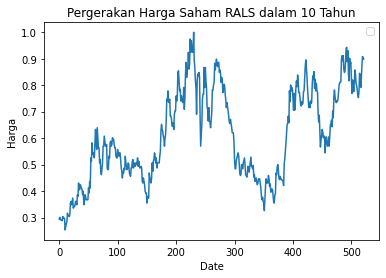

In [ ]:
RALS = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/RALS.JK.csv')

RALS_x = RALS['No'].values
RALS_y = RALS['Skala'].values

plt.plot(RALS_x,RALS_y)
plt.title('Pergerakan Harga Saham RALS dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA RALS**

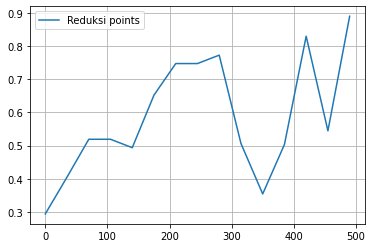

In [ ]:
RALS_x15 = RALS_x[0:522:35]
RALS_y15 = RALS_y[0:522:35]

plt.plot(RALS_x15, RALS_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_RALS_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_RALS_15: [0.2943038  0.33283442 0.54793876 0.53278595 0.4386297  0.67472058
 0.77388037 0.71077058 0.86404996 0.46594097 0.31016086 0.41999789
 1.23178059 0.04312869 0.88924051 0.         0.         0.
 0.        ]
k_RALS_15: 3



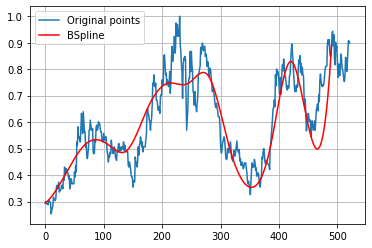

In [ ]:
import scipy.interpolate as interpolate

t_RALS_15, c_RALS_15, k_RALS_15 = interpolate.splrep(RALS_x15, RALS_y15, s=0, k=3)
print('''\
t_RALS_15: {}
c_RALS_15: {}
k_RALS_15: {}
'''.format(t_RALS_15, c_RALS_15, k_RALS_15))
N = 522
xmin_RALS_15, xmax_RALS_15 = RALS_x15.min(), RALS_x15.max()
xx_RALS_15 = np.linspace(xmin_RALS_15, xmax_RALS_15, N)
spline_RALS_15 = interpolate.BSpline(t_RALS_15, c_RALS_15, k_RALS_15, extrapolate=False)

plt.plot(RALS_x, RALS_y, label='Original points')
plt.plot(xx_RALS_15, spline_RALS_15(xx_RALS_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA RALS**

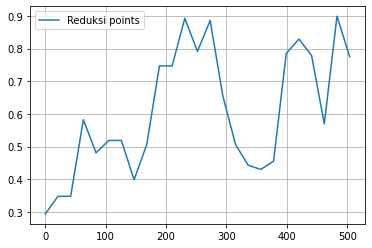

In [ ]:
RALS_x25 = RALS_x[0:522:21]
RALS_y25 = RALS_y[0:522:21]

plt.plot(RALS_x25, RALS_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_RALS_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_RALS_25: [0.2943038  0.48256168 0.10607917 0.7066513  0.41084351 0.53605062
 0.55887806 0.34236117 0.4640823  0.8392843  0.65979314 1.00255578
 0.68441411 1.00662323 0.60554867 0.50156185 0.42617863 0.45195149
 0.34829391 0.88905009 0.80436648 0.86816753 0.23574344 1.34336245
 0.77531646 0.         0.         0.         0.        ]
k_RALS_25: 3



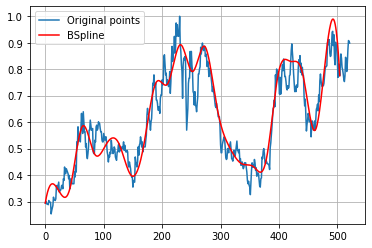

In [ ]:
import scipy.interpolate as interpolate

t_RALS_25, c_RALS_25, k_RALS_25 = interpolate.splrep(RALS_x25, RALS_y25, s=0, k=3)
print('''\
t_RALS_25: {}
c_RALS_25: {}
k_RALS_25: {}
'''.format(t_RALS_25, c_RALS_25, k_RALS_25))
N = 522
xmin_RALS_25, xmax_RALS_25 = RALS_x25.min(), RALS_x25.max()
xx_RALS_25 = np.linspace(xmin_RALS_25, xmax_RALS_25, N)
spline_RALS_25 = interpolate.BSpline(t_RALS_25, c_RALS_25, k_RALS_25, extrapolate=False)

plt.plot(RALS_x, RALS_y, label='Original points')
plt.plot(xx_RALS_25, spline_RALS_25(xx_RALS_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA RALS**

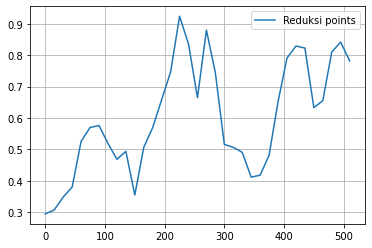

In [ ]:
RALS_x35 = RALS_x[0:522:15]
RALS_y35 = RALS_y[0:522:15]

plt.plot(RALS_x35, RALS_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_RALS_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_RALS_35: [0.2943038  0.26848903 0.3696675  0.33869495 0.56177684 0.56609643
 0.59155897 0.52336389 0.42890951 0.57112463 0.24861728 0.56098852
 0.54540331 0.67511977 0.7034847  0.99195408 0.87300278 0.52869303
 0.99956689 0.75152043 0.4563767  0.51790948 0.50996006 0.38528824
 0.41724142 0.45207521 0.6605337  0.81718241 0.8175721  0.88721273
 0.57028585 0.62911224 0.91515583 0.82802335 0.78164557 0.
 0.         0.         0.        ]
k_RALS_35: 3



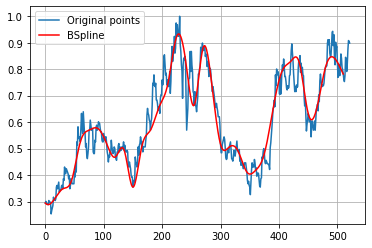

In [ ]:
import scipy.interpolate as interpolate

t_RALS_35, c_RALS_35, k_RALS_35 = interpolate.splrep(RALS_x35, RALS_y35, s=0, k=3)
print('''\
t_RALS_35: {}
c_RALS_35: {}
k_RALS_35: {}
'''.format(t_RALS_35, c_RALS_35, k_RALS_35))
N = 522
xmin_RALS_35, xmax_RALS_35 = RALS_x35.min(), RALS_x35.max()
xx_RALS_35 = np.linspace(xmin_RALS_35, xmax_RALS_35, N)
spline_RALS_35 = interpolate.BSpline(t_RALS_35, c_RALS_35, k_RALS_35, extrapolate=False)

plt.plot(RALS_x, RALS_y, label='Original points')
plt.plot(xx_RALS_35, spline_RALS_35(xx_RALS_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA RALS**

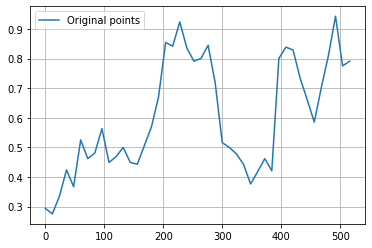

In [ ]:
RALS_x45 = RALS_x[0:522:12]
RALS_y45 = RALS_y[0:522:12]

plt.plot(RALS_x45, RALS_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_RALS_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_RALS_45: [0.2943038  0.26422536 0.25794168 0.48835119 0.27535498 0.61276055
 0.42550156 0.45738511 0.63103394 0.39822595 0.47226479 0.52284146
 0.43636937 0.4278836  0.51032409 0.56879474 0.63221847 0.92764782
 0.78377254 0.98789495 0.80895146 0.78895743 0.78205427 0.88662297
 0.74107411 0.45920717 0.51703394 0.47265709 0.4594263  0.34786555
 0.40860516 0.5240429  0.26737512 0.93177309 0.80933    0.8625525
 0.71514356 0.68193657 0.5254646  0.72886327 0.77427218 1.12165258
 0.55626232 0.79113924 0.         0.         0.         0.        ]
k_RALS_45: 3



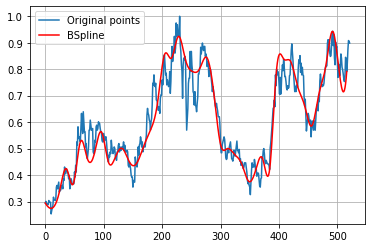

In [ ]:
import scipy.interpolate as interpolate

t_RALS_45, c_RALS_45, k_RALS_45 = interpolate.splrep(RALS_x45, RALS_y45, s=0, k=3)
print('''\
t_RALS_45: {}
c_RALS_45: {}
k_RALS_45: {}
'''.format(t_RALS_45, c_RALS_45, k_RALS_45))
N = 522
xmin_RALS_45, xmax_RALS_45 = RALS_x45.min(), RALS_x45.max()
xx_RALS_45 = np.linspace(xmin_RALS_45, xmax_RALS_45, N)
spline_RALS_45 = interpolate.BSpline(t_RALS_45, c_RALS_45, k_RALS_45, extrapolate=False)

plt.plot(RALS_x, RALS_y, label='Original points')
plt.plot(xx_RALS_45, spline_RALS_45(xx_RALS_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA RALS**

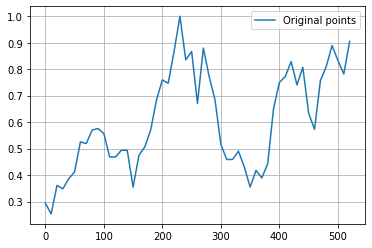

In [ ]:
RALS_x55 = RALS_x[0:522:10]
RALS_y55 = RALS_y[0:522:10]

plt.plot(RALS_x55, RALS_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_RALS_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_RALS_55: [0.2943038  0.12639282 0.43234095 0.31957929 0.4061399  0.37231682
 0.57294727 0.48779283 0.58980545 0.57070687 0.58306325 0.43881226
 0.47181429 0.48405717 0.55398233 0.26203882 0.52444468 0.48828371
 0.56039515 0.68785721 0.78944183 0.71133748 0.84622091 1.10631053
 0.72853699 0.99219976 0.50519563 1.01233419 0.72394862 0.72478272
 0.47818631 0.45740876 0.44534322 0.5143829  0.44016314 0.30724303
 0.45744703 0.36929796 0.40080417 0.68571322 0.76773534 0.7433454
 0.89179446 0.66416031 0.89460226 0.59920279 0.50605492 0.81328638
 0.77877426 0.93237609 0.79209386 0.73290877 0.90506329 0.
 0.         0.         0.        ]
k_RALS_55: 3



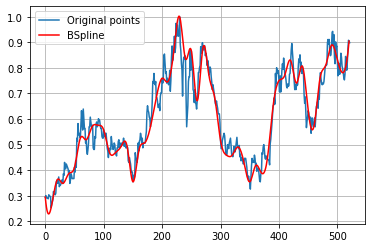

In [ ]:
import scipy.interpolate as interpolate

t_RALS_55, c_RALS_55, k_RALS_55 = interpolate.splrep(RALS_x55, RALS_y55, s=0, k=3)
print('''\
t_RALS_55: {}
c_RALS_55: {}
k_RALS_55: {}
'''.format(t_RALS_55, c_RALS_55, k_RALS_55))
N = 522
xmin_RALS_55, xmax_RALS_55 = RALS_x55.min(), RALS_x55.max()
xx_RALS_55 = np.linspace(xmin_RALS_55, xmax_RALS_55, N)
spline_RALS_55 = interpolate.BSpline(t_RALS_55, c_RALS_55, k_RALS_55, extrapolate=False)

plt.plot(RALS_x, RALS_y, label='Original points')
plt.plot(xx_RALS_55, spline_RALS_55(xx_RALS_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA RALS**

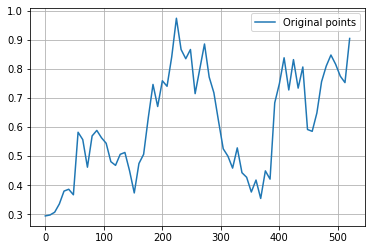

In [ ]:
RALS_x65 = RALS_x[0:522:8]
RALS_y65 = RALS_y[0:522:8]

plt.plot(RALS_x65, RALS_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_RALS_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_RALS_65: [0.2943038  0.29752207 0.29419636 0.33138478 0.38362564 0.41259369
 0.28245531 0.66011672 0.5707487  0.39866063 0.60676066 0.59201823
 0.556812   0.5604806  0.46708837 0.45724187 0.51407071 0.52444995
 0.46407884 0.31543723 0.51467857 0.47394976 0.62749709 0.81353022
 0.59939467 0.81420756 0.7007371  0.825882   1.0463678  0.83674806
 0.8091716  0.93922375 0.63646503 0.80605535 0.94311103 0.73795623
 0.73797543 0.62026863 0.50246904 0.52175394 0.41051519 0.58934986
 0.40297146 0.45699215 0.33235108 0.4730972  0.28158924 0.52712812
 0.30610083 0.77378503 0.70002488 0.92611545 0.62715888 0.93233762
 0.63716151 0.92407

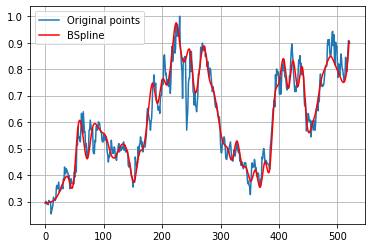

In [ ]:
import scipy.interpolate as interpolate

t_RALS_65, c_RALS_65, k_RALS_65 = interpolate.splrep(RALS_x65, RALS_y65, s=0, k=3)
print('''\
t_RALS_65: {}
c_RALS_65: {}
k_RALS_65: {}
'''.format(t_RALS_65, c_RALS_65, k_RALS_65))
N = 522
xmin_RALS_65, xmax_RALS_65 = RALS_x65.min(), RALS_x65.max()
xx_RALS_65 = np.linspace(xmin_RALS_65, xmax_RALS_65, N)
spline_RALS_65 = interpolate.BSpline(t_RALS_65, c_RALS_65, k_RALS_65, extrapolate=False)

plt.plot(RALS_x, RALS_y, label='Original points')
plt.plot(xx_RALS_65, spline_RALS_65(xx_RALS_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE RALS**

In [ ]:

#RMSE 15 DATA RALS
y_true_RALS_15 = RALS_y.tolist()
y_pred_RALS_15 = spline_RALS_15(xx_RALS_15).tolist()
mse_RALS_15 = mean_squared_error(y_true_RALS_15, y_pred_RALS_15)
rmse_RALS_15 = np.sqrt(mse_RALS_15)
print("rmse RALS 15 =",rmse_RALS_15)

#RMSE 25 DATA RALS
y_true_RALS_25 = RALS_y.tolist()
y_pred_RALS_25 = spline_RALS_25(xx_RALS_25).tolist()
mse_RALS_25 = mean_squared_error(y_true_RALS_25, y_pred_RALS_25)
rmse_RALS_25 = np.sqrt(mse_RALS_25)
print("rmse RALS 25 =",rmse_RALS_25)

#RMSE 35 DATA RALS
y_true_RALS_35 = RALS_y.tolist()
y_pred_RALS_35 = spline_RALS_35(xx_RALS_35).tolist()
mse_RALS_35 = mean_squared_error(y_true_RALS_35, y_pred_RALS_35)
rmse_RALS_35 = np.sqrt(mse_RALS_35)
print("rmse RALS 35 =",rmse_RALS_35)

#RMSE 45 DATA RALS
y_true_RALS_45 = RALS_y.tolist()
y_pred_RALS_45 = spline_RALS_45(xx_RALS_45).tolist()
mse_RALS_45 = mean_squared_error(y_true_RALS_45, y_pred_RALS_45)
rmse_RALS_45 = np.sqrt(mse_RALS_45)
print("rmse RALS 45 =",rmse_RALS_45)

#RMSE 55 DATA RALS
y_true_RALS_55 = RALS_y.tolist()
y_pred_RALS_55 = spline_RALS_55(xx_RALS_55).tolist()
mse_RALS_55 = mean_squared_error(y_true_RALS_55, y_pred_RALS_55)
rmse_RALS_55 = np.sqrt(mse_RALS_55)
print("rmse RALS 55 =",rmse_RALS_55)

#RMSE 65 DATA RALS
y_true_RALS_65 = RALS_y.tolist()
y_pred_RALS_65 = spline_RALS_65(xx_RALS_65).tolist()
mse_RALS_65 = mean_squared_error(y_true_RALS_65, y_pred_RALS_65)
rmse_RALS_65 = np.sqrt(mse_RALS_65)
print("rmse RALS 65 =",rmse_RALS_65)

rmse RALS 15 = 0.13994232982187538
rmse RALS 25 = 0.10050459058727547
rmse RALS 35 = 0.07052509744548431
rmse RALS 45 = 0.06303573214676418
rmse RALS 55 = 0.05038276201021863
rmse RALS 65 = 0.04602844945805893


# **SCMA**

No handles with labels found to put in legend.


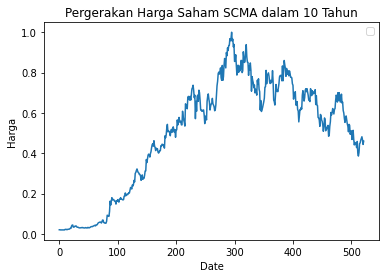

In [ ]:
SCMA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SCMA.JK.csv')

SCMA_x = SCMA['No'].values
SCMA_y = SCMA['Skala'].values

plt.plot(SCMA_x,SCMA_y)
plt.title('Pergerakan Harga Saham SCMA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA SCMA**

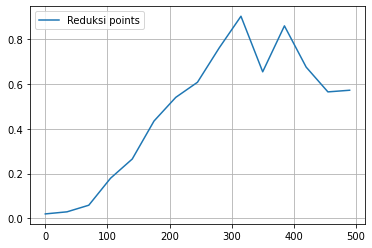

In [ ]:
SCMA_x15 = SCMA_x[0:522:35]
SCMA_y15 = SCMA_y[0:522:35]

plt.plot(SCMA_x15, SCMA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SCMA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_SCMA_15: [ 0.02014742  0.05223751 -0.02609665  0.20298609  0.23304869  0.45695675
  0.54846093  0.59244279  0.73041655  1.05591557  0.46361159  1.01838498
  0.49060985  0.57287689  0.57248157  0.          0.          0.
  0.        ]
k_SCMA_15: 3



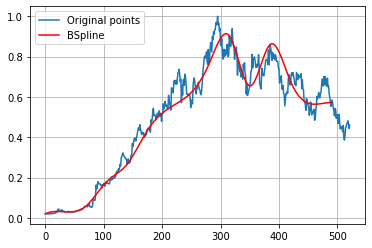

In [ ]:
import scipy.interpolate as interpolate

t_SCMA_15, c_SCMA_15, k_SCMA_15 = interpolate.splrep(SCMA_x15, SCMA_y15, s=0, k=3)
print('''\
t_SCMA_15: {}
c_SCMA_15: {}
k_SCMA_15: {}
'''.format(t_SCMA_15, c_SCMA_15, k_SCMA_15))
N = 522
xmin_SCMA_15, xmax_SCMA_15 = SCMA_x15.min(), SCMA_x15.max()
xx_SCMA_15 = np.linspace(xmin_SCMA_15, xmax_SCMA_15, N)
spline_SCMA_15 = interpolate.BSpline(t_SCMA_15, c_SCMA_15, k_SCMA_15, extrapolate=False)

plt.plot(SCMA_x, SCMA_y, label='Original points')
plt.plot(xx_SCMA_15, spline_SCMA_15(xx_SCMA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA SCMA**

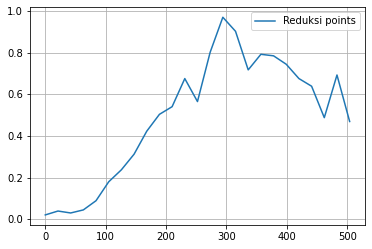

In [ ]:
SCMA_x25 = SCMA_x[0:522:21]
SCMA_y25 = SCMA_y[0:522:21]

plt.plot(SCMA_x25, SCMA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SCMA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_SCMA_25: [0.02014742 0.05704404 0.01637875 0.04213949 0.07397937 0.19265555
 0.23156549 0.30368691 0.42592274 0.52824868 0.48319558 0.78221224
 0.44200951 0.84041311 1.00960587 0.94425924 0.63104758 0.83621873
 0.77837725 0.76034597 0.64706935 0.7054307  0.25036534 1.0213161
 0.46928747 0.         0.         0.         0.        ]
k_SCMA_25: 3



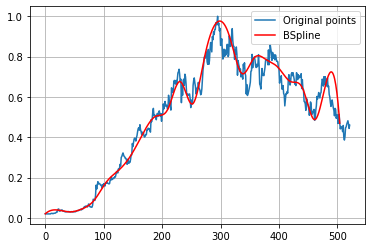

In [ ]:
import scipy.interpolate as interpolate

t_SCMA_25, c_SCMA_25, k_SCMA_25 = interpolate.splrep(SCMA_x25, SCMA_y25, s=0, k=3)
print('''\
t_SCMA_25: {}
c_SCMA_25: {}
k_SCMA_25: {}
'''.format(t_SCMA_25, c_SCMA_25, k_SCMA_25))
N = 522
xmin_SCMA_25, xmax_SCMA_25 = SCMA_x25.min(), SCMA_x25.max()
xx_SCMA_25 = np.linspace(xmin_SCMA_25, xmax_SCMA_25, N)
spline_SCMA_25 = interpolate.BSpline(t_SCMA_25, c_SCMA_25, k_SCMA_25, extrapolate=False)

plt.plot(SCMA_x, SCMA_y, label='Original points')
plt.plot(xx_SCMA_25, spline_SCMA_25(xx_SCMA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA SCMA**

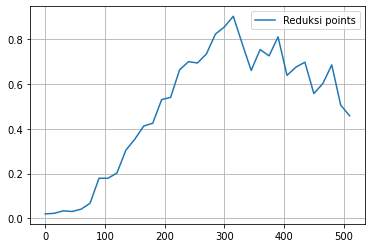

In [ ]:
SCMA_x35 = SCMA_x[0:522:15]
SCMA_y35 = SCMA_y[0:522:15]

plt.plot(SCMA_x35, SCMA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SCMA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_SCMA_35: [0.02014742 0.01016449 0.04404449 0.02492426 0.04678791 0.03558994
 0.21773195 0.16964934 0.17983775 0.32721586 0.33930863 0.43839973
 0.38375094 0.57696508 0.49266393 0.69562243 0.70519032 0.68509049
 0.71906687 0.84650444 0.8334903  0.94975548 0.78517818 0.59012148
 0.81993787 0.65592557 0.9126252  0.5584385  0.68654464 0.74943698
 0.50243962 0.58724187 0.81810138 0.31730066 0.45823096 0.
 0.         0.         0.        ]
k_SCMA_35: 3



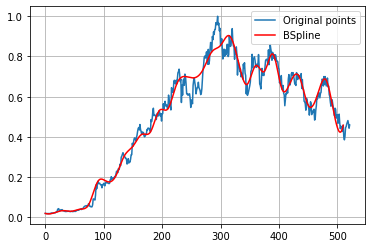

In [ ]:
import scipy.interpolate as interpolate

t_SCMA_35, c_SCMA_35, k_SCMA_35 = interpolate.splrep(SCMA_x35, SCMA_y35, s=0, k=3)
print('''\
t_SCMA_35: {}
c_SCMA_35: {}
k_SCMA_35: {}
'''.format(t_SCMA_35, c_SCMA_35, k_SCMA_35))
N = 522
xmin_SCMA_35, xmax_SCMA_35 = SCMA_x35.min(), SCMA_x35.max()
xx_SCMA_35 = np.linspace(xmin_SCMA_35, xmax_SCMA_35, N)
spline_SCMA_35 = interpolate.BSpline(t_SCMA_35, c_SCMA_35, k_SCMA_35, extrapolate=False)

plt.plot(SCMA_x, SCMA_y, label='Original points')
plt.plot(xx_SCMA_35, spline_SCMA_35(xx_SCMA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA SCMA**

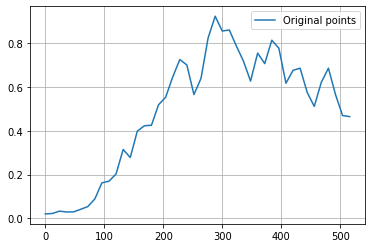

In [ ]:
SCMA_x45 = SCMA_x[0:522:12]
SCMA_y45 = SCMA_y[0:522:12]

plt.plot(SCMA_x45, SCMA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SCMA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_SCMA_45: [0.02014742 0.01062751 0.04066144 0.02745993 0.02675498 0.04242432
 0.05121359 0.07409725 0.18310995 0.16643594 0.16834532 0.37639899
 0.21303661 0.43730224 0.42596082 0.39448101 0.5464837  0.53014931
 0.6498724  0.74013998 0.73846204 0.50748606 0.62225711 0.83640933
 0.97068052 0.81649513 0.89356011 0.76896961 0.74800618 0.54367396
 0.83651174 0.63607761 0.85750705 0.81350106 0.54696538 0.69888312
 0.71155618 0.56791427 0.4664182  0.632752   0.73230354 0.49064012
 0.43588387 0.46437346 0.         0.         0.         0.        ]
k_SCMA_45: 3



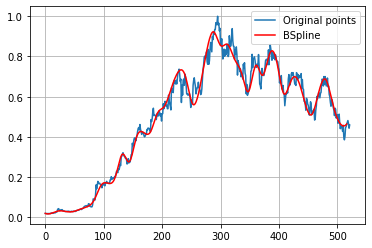

In [ ]:
import scipy.interpolate as interpolate

t_SCMA_45, c_SCMA_45, k_SCMA_45 = interpolate.splrep(SCMA_x45, SCMA_y45, s=0, k=3)
print('''\
t_SCMA_45: {}
c_SCMA_45: {}
k_SCMA_45: {}
'''.format(t_SCMA_45, c_SCMA_45, k_SCMA_45))
N = 522
xmin_SCMA_45, xmax_SCMA_45 = SCMA_x45.min(), SCMA_x45.max()
xx_SCMA_45 = np.linspace(xmin_SCMA_45, xmax_SCMA_45, N)
spline_SCMA_45 = interpolate.BSpline(t_SCMA_45, c_SCMA_45, k_SCMA_45, extrapolate=False)

plt.plot(SCMA_x, SCMA_y, label='Original points')
plt.plot(xx_SCMA_45, spline_SCMA_45(xx_SCMA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA SCMA**

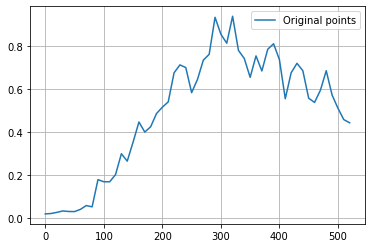

In [ ]:
SCMA_x55 = SCMA_x[0:522:10]
SCMA_y55 = SCMA_y[0:522:10]

plt.plot(SCMA_x55, SCMA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SCMA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_SCMA_55: [0.02014742 0.02056357 0.02349201 0.0365474  0.03049434 0.03017303
 0.03456293 0.0792411  0.00228104 0.23006226 0.15363698 0.17258884
 0.17320669 0.35080063 0.22211658 0.35287062 0.48925104 0.37317188
 0.42100982 0.49315738 0.52527957 0.50154745 0.7117739  0.70541102
 0.74176629 0.52899801 0.64347019 0.76690011 0.69679179 1.01595729
 0.84134464 0.74888529 1.0427211  0.71167995 0.79114876 0.57581345
 0.83434437 0.61260759 0.82087637 0.81396065 0.7881459  0.45606018
 0.71930871 0.72075902 0.71706553 0.52400097 0.53336795 0.57102847
 0.75008576 0.54165062 0.51038471 0.4226332  0.44348894 0.
 0.         0.         0.        ]
k_SCMA_55: 3



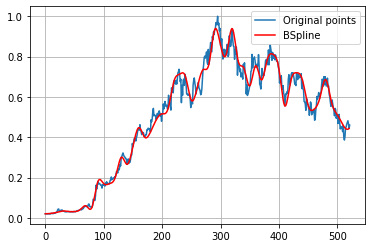

In [ ]:
import scipy.interpolate as interpolate

t_SCMA_55, c_SCMA_55, k_SCMA_55 = interpolate.splrep(SCMA_x55, SCMA_y55, s=0, k=3)
print('''\
t_SCMA_55: {}
c_SCMA_55: {}
k_SCMA_55: {}
'''.format(t_SCMA_55, c_SCMA_55, k_SCMA_55))
N = 522
xmin_SCMA_55, xmax_SCMA_55 = SCMA_x55.min(), SCMA_x55.max()
xx_SCMA_55 = np.linspace(xmin_SCMA_55, xmax_SCMA_55, N)
spline_SCMA_55 = interpolate.BSpline(t_SCMA_55, c_SCMA_55, k_SCMA_55, extrapolate=False)

plt.plot(SCMA_x, SCMA_y, label='Original points')
plt.plot(xx_SCMA_55, spline_SCMA_55(xx_SCMA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA SCMA**

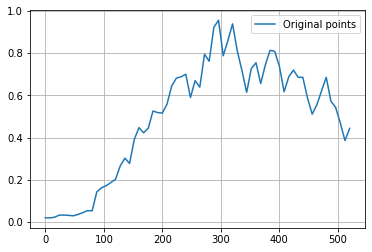

In [ ]:
SCMA_x65 = SCMA_x[0:522:8]
SCMA_y65 = SCMA_y[0:522:8]

plt.plot(SCMA_x65, SCMA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SCMA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_SCMA_65: [0.02014742 0.0204027  0.01533711 0.03618762 0.03224277 0.03238428
 0.0269179  0.03684829 0.04092237 0.0648185  0.02117955 0.16889083
 0.15829401 0.17090611 0.19002259 0.18939666 0.26860699 0.32831296
 0.23140898 0.4118988  0.46497616 0.41124325 0.42567738 0.5543519
 0.51170617 0.50938854 0.54656278 0.65816871 0.69054126 0.67057533
 0.75492153 0.51121273 0.73831109 0.55274193 0.88364502 0.68171974
 0.95950057 1.01590451 0.71152513 0.86281068 0.9969373  0.78088974
 0.74436859 0.54630421 0.75591827 0.79365908 0.59524395 0.76148305
 0.82565431 0.8155066  0.76244215 0.55732924 0.70848661 0.73648845
 0.66496992 0.716653

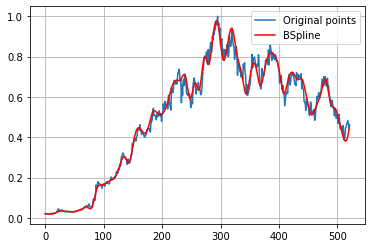

In [ ]:
import scipy.interpolate as interpolate

t_SCMA_65, c_SCMA_65, k_SCMA_65 = interpolate.splrep(SCMA_x65, SCMA_y65, s=0, k=3)
print('''\
t_SCMA_65: {}
c_SCMA_65: {}
k_SCMA_65: {}
'''.format(t_SCMA_65, c_SCMA_65, k_SCMA_65))
N = 522
xmin_SCMA_65, xmax_SCMA_65 = SCMA_x65.min(), SCMA_x65.max()
xx_SCMA_65 = np.linspace(xmin_SCMA_65, xmax_SCMA_65, N)
spline_SCMA_65 = interpolate.BSpline(t_SCMA_65, c_SCMA_65, k_SCMA_65, extrapolate=False)

plt.plot(SCMA_x, SCMA_y, label='Original points')
plt.plot(xx_SCMA_65, spline_SCMA_65(xx_SCMA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE SCMA**

In [ ]:

#RMSE 15 DATA SCMA
y_true_SCMA_15 = SCMA_y.tolist()
y_pred_SCMA_15 = spline_SCMA_15(xx_SCMA_15).tolist()
mse_SCMA_15 = mean_squared_error(y_true_SCMA_15, y_pred_SCMA_15)
rmse_SCMA_15 = np.sqrt(mse_SCMA_15)
print("rmse SCMA 15 =",rmse_SCMA_15)

#RMSE 25 DATA SCMA
y_true_SCMA_25 = SCMA_y.tolist()
y_pred_SCMA_25 = spline_SCMA_25(xx_SCMA_25).tolist()
mse_SCMA_25 = mean_squared_error(y_true_SCMA_25, y_pred_SCMA_25)
rmse_SCMA_25 = np.sqrt(mse_SCMA_25)
print("rmse SCMA 25 =",rmse_SCMA_25)

#RMSE 35 DATA SCMA
y_true_SCMA_35 = SCMA_y.tolist()
y_pred_SCMA_35 = spline_SCMA_35(xx_SCMA_35).tolist()
mse_SCMA_35 = mean_squared_error(y_true_SCMA_35, y_pred_SCMA_35)
rmse_SCMA_35 = np.sqrt(mse_SCMA_35)
print("rmse SCMA 35 =",rmse_SCMA_35)

#RMSE 45 DATA SCMA
y_true_SCMA_45 = SCMA_y.tolist()
y_pred_SCMA_45 = spline_SCMA_45(xx_SCMA_45).tolist()
mse_SCMA_45 = mean_squared_error(y_true_SCMA_45, y_pred_SCMA_45)
rmse_SCMA_45 = np.sqrt(mse_SCMA_45)
print("rmse SCMA 45 =",rmse_SCMA_45)

#RMSE 55 DATA SCMA
y_true_SCMA_55 = SCMA_y.tolist()
y_pred_SCMA_55 = spline_SCMA_55(xx_SCMA_55).tolist()
mse_SCMA_55 = mean_squared_error(y_true_SCMA_55, y_pred_SCMA_55)
rmse_SCMA_55 = np.sqrt(mse_SCMA_55)
print("rmse SCMA 55 =",rmse_SCMA_55)

#RMSE 65 DATA SCMA
y_true_SCMA_65 = SCMA_y.tolist()
y_pred_SCMA_65 = spline_SCMA_65(xx_SCMA_65).tolist()
mse_SCMA_65 = mean_squared_error(y_true_SCMA_65, y_pred_SCMA_65)
rmse_SCMA_65 = np.sqrt(mse_SCMA_65)
print("rmse SCMA 65 =",rmse_SCMA_65)


rmse SCMA 15 = 0.09542409420298287
rmse SCMA 25 = 0.08166939197225609
rmse SCMA 35 = 0.05703755592651904
rmse SCMA 45 = 0.03953716158575747
rmse SCMA 55 = 0.034416913302046284
rmse SCMA 65 = 0.030196250684382288


# **SMGR**

No handles with labels found to put in legend.


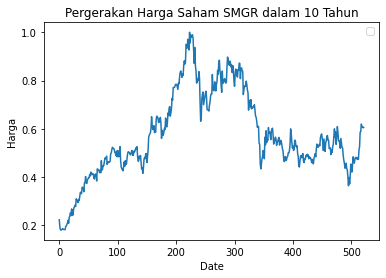

In [ ]:
SMGR = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SMGR.JK.csv')

SMGR_x = SMGR['No'].values
SMGR_y = SMGR['Skala'].values

plt.plot(SMGR_x,SMGR_y)
plt.title('Pergerakan Harga Saham SMGR dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA SMGR**

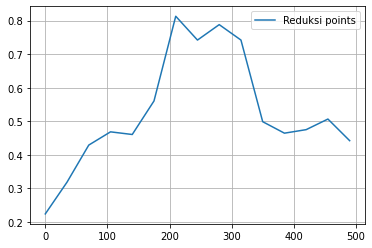

In [ ]:
SMGR_x15 = SMGR_x[0:522:35]
SMGR_y15 = SMGR_y[0:522:35]

plt.plot(SMGR_x15, SMGR_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMGR_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_SMGR_15: [0.22368421 0.25734121 0.43268601 0.47991836 0.44635879 0.49780437
 0.92558164 0.67881645 0.81178412 0.80299442 0.42886976 0.47363181
 0.46004956 0.5538568  0.44210526 0.         0.         0.
 0.        ]
k_SMGR_15: 3



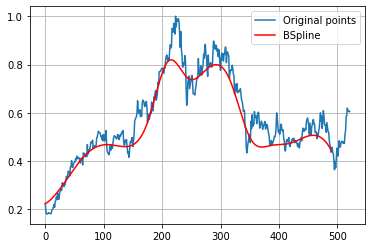

In [ ]:
import scipy.interpolate as interpolate

t_SMGR_15, c_SMGR_15, k_SMGR_15 = interpolate.splrep(SMGR_x15, SMGR_y15, s=0, k=3)
print('''\
t_SMGR_15: {}
c_SMGR_15: {}
k_SMGR_15: {}
'''.format(t_SMGR_15, c_SMGR_15, k_SMGR_15))
N = 522
xmin_SMGR_15, xmax_SMGR_15 = SMGR_x15.min(), SMGR_x15.max()
xx_SMGR_15 = np.linspace(xmin_SMGR_15, xmax_SMGR_15, N)
spline_SMGR_15 = interpolate.BSpline(t_SMGR_15, c_SMGR_15, k_SMGR_15, extrapolate=False)

plt.plot(SMGR_x, SMGR_y, label='Original points')
plt.plot(xx_SMGR_15, spline_SMGR_15(xx_SMGR_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA SMGR**

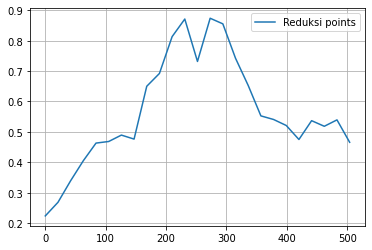

In [ ]:
SMGR_x25 = SMGR_x[0:522:21]
SMGR_y25 = SMGR_y[0:522:21]

plt.plot(SMGR_x25, SMGR_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMGR_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_SMGR_25: [0.22368421 0.23456352 0.32297823 0.40193617 0.48111657 0.45254493
 0.51923001 0.40737711 0.70915627 0.65599782 0.81948403 0.94501344
 0.62677801 0.93734819 0.86593448 0.73049285 0.6647257  0.52639381
 0.54548854 0.53638887 0.43527178 0.57252402 0.47007171 0.59785888
 0.46578947 0.         0.         0.         0.        ]
k_SMGR_25: 3



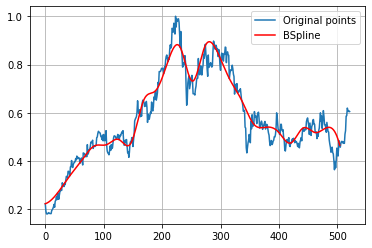

In [ ]:
import scipy.interpolate as interpolate

t_SMGR_25, c_SMGR_25, k_SMGR_25 = interpolate.splrep(SMGR_x25, SMGR_y25, s=0, k=3)
print('''\
t_SMGR_25: {}
c_SMGR_25: {}
k_SMGR_25: {}
'''.format(t_SMGR_25, c_SMGR_25, k_SMGR_25))
N = 522
xmin_SMGR_25, xmax_SMGR_25 = SMGR_x25.min(), SMGR_x25.max()
xx_SMGR_25 = np.linspace(xmin_SMGR_25, xmax_SMGR_25, N)
spline_SMGR_25 = interpolate.BSpline(t_SMGR_25, c_SMGR_25, k_SMGR_25, extrapolate=False)

plt.plot(SMGR_x, SMGR_y, label='Original points')
plt.plot(xx_SMGR_25, spline_SMGR_25(xx_SMGR_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA SMGR**

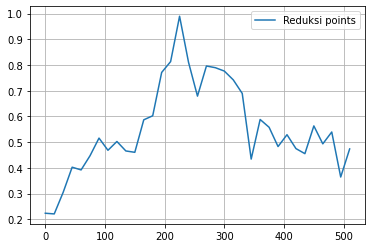

In [ ]:
SMGR_x35 = SMGR_x[0:522:15]
SMGR_y35 = SMGR_y[0:522:15]

plt.plot(SMGR_x35, SMGR_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMGR_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_SMGR_35: [0.22368421 0.18487754 0.24998176 0.43752736 0.36881189 0.43985667
 0.55597197 0.43099229 0.53058519 0.46245641 0.41432601 0.64339746
 0.5331368  0.83984483 0.73379968 1.10390382 0.78742714 0.60954553
 0.84807495 0.77447047 0.79088528 0.71988316 0.78221365 0.28810433
 0.67063219 0.5583143  0.44347904 0.56513796 0.46965332 0.40624877
 0.63693055 0.42497642 0.689928   0.13069389 0.47368421 0.
 0.         0.         0.        ]
k_SMGR_35: 3



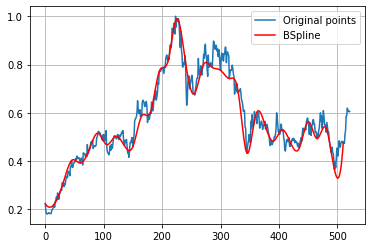

In [ ]:
import scipy.interpolate as interpolate

t_SMGR_35, c_SMGR_35, k_SMGR_35 = interpolate.splrep(SMGR_x35, SMGR_y35, s=0, k=3)
print('''\
t_SMGR_35: {}
c_SMGR_35: {}
k_SMGR_35: {}
'''.format(t_SMGR_35, c_SMGR_35, k_SMGR_35))
N = 522
xmin_SMGR_35, xmax_SMGR_35 = SMGR_x35.min(), SMGR_x35.max()
xx_SMGR_35 = np.linspace(xmin_SMGR_35, xmax_SMGR_35, N)
spline_SMGR_35 = interpolate.BSpline(t_SMGR_35, c_SMGR_35, k_SMGR_35, extrapolate=False)

plt.plot(SMGR_x, SMGR_y, label='Original points')
plt.plot(xx_SMGR_35, spline_SMGR_35(xx_SMGR_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA SMGR**

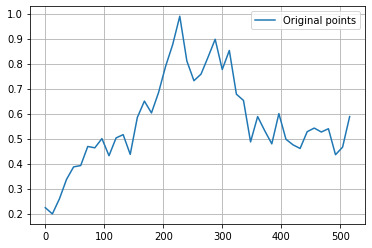

In [ ]:
SMGR_x45 = SMGR_x[0:522:12]
SMGR_y45 = SMGR_y[0:522:12]

plt.plot(SMGR_x45, SMGR_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMGR_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_SMGR_45: [0.22368421 0.16134069 0.23060809 0.33950453 0.40520232 0.36073881
 0.504474   0.43189151 0.54690734 0.38047915 0.52064976 0.5527113
 0.36324188 0.6153738  0.68052607 0.56252191 0.68517578 0.80203814
 0.84351377 1.08180153 0.76612221 0.71686754 0.75588131 0.80697565
 0.97411083 0.68079154 0.96061774 0.59252698 0.73506383 0.38300717
 0.65396012 0.53009973 0.41511463 0.68312596 0.45238154 0.49155841
 0.43138481 0.54606023 0.55016375 0.50591635 0.58406558 0.33152938
 0.50989321 0.5881579  0.         0.         0.         0.        ]
k_SMGR_45: 3



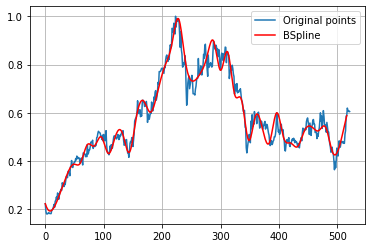

In [ ]:
import scipy.interpolate as interpolate

t_SMGR_45, c_SMGR_45, k_SMGR_45 = interpolate.splrep(SMGR_x45, SMGR_y45, s=0, k=3)
print('''\
t_SMGR_45: {}
c_SMGR_45: {}
k_SMGR_45: {}
'''.format(t_SMGR_45, c_SMGR_45, k_SMGR_45))
N = 522
xmin_SMGR_45, xmax_SMGR_45 = SMGR_x45.min(), SMGR_x45.max()
xx_SMGR_45 = np.linspace(xmin_SMGR_45, xmax_SMGR_45, N)
spline_SMGR_45 = interpolate.BSpline(t_SMGR_45, c_SMGR_45, k_SMGR_45, extrapolate=False)

plt.plot(SMGR_x, SMGR_y, label='Original points')
plt.plot(xx_SMGR_45, spline_SMGR_45(xx_SMGR_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA SMGR**

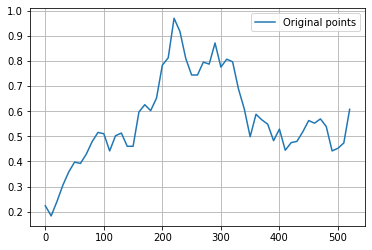

In [ ]:
SMGR_x55 = SMGR_x[0:522:10]
SMGR_y55 = SMGR_y[0:522:10]

plt.plot(SMGR_x55, SMGR_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMGR_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_SMGR_55: [0.22368421 0.13931447 0.22071316 0.308075   0.35672531 0.41239217
 0.37791654 0.42857324 0.48147471 0.51921213 0.53641362 0.3982913
 0.52305278 0.52528707 0.45474631 0.41888559 0.63286922 0.63384807
 0.58963325 0.62340841 0.83252258 0.75176443 1.03936707 0.91708309
 0.80282688 0.73476727 0.72652508 0.82755345 0.73957691 0.94308628
 0.72228849 0.82565451 0.82246189 0.66870844 0.63954646 0.42836888
 0.63908328 0.54424535 0.57867216 0.43317128 0.58601114 0.39646838
 0.49653639 0.46738606 0.51549833 0.58114695 0.53886126 0.5791975
 0.56276978 0.40656549 0.48261131 0.44093119 0.60789474 0.
 0.         0.         0.        ]
k_SMGR_55: 3



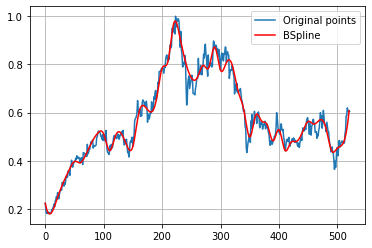

In [ ]:
import scipy.interpolate as interpolate

t_SMGR_55, c_SMGR_55, k_SMGR_55 = interpolate.splrep(SMGR_x55, SMGR_y55, s=0, k=3)
print('''\
t_SMGR_55: {}
c_SMGR_55: {}
k_SMGR_55: {}
'''.format(t_SMGR_55, c_SMGR_55, k_SMGR_55))
N = 522
xmin_SMGR_55, xmax_SMGR_55 = SMGR_x55.min(), SMGR_x55.max()
xx_SMGR_55 = np.linspace(xmin_SMGR_55, xmax_SMGR_55, N)
spline_SMGR_55 = interpolate.BSpline(t_SMGR_55, c_SMGR_55, k_SMGR_55, extrapolate=False)

plt.plot(SMGR_x, SMGR_y, label='Original points')
plt.plot(xx_SMGR_55, spline_SMGR_55(xx_SMGR_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA SMGR**

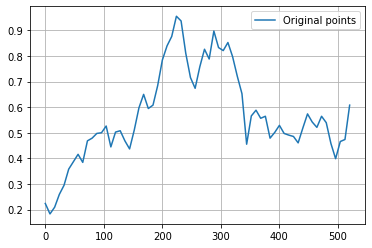

In [ ]:
SMGR_x65 = SMGR_x[0:522:8]
SMGR_y65 = SMGR_y[0:522:8]

plt.plot(SMGR_x65, SMGR_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMGR_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_SMGR_65: [0.22368421 0.16605374 0.1830241  0.26724016 0.28222439 0.37228334
 0.37601069 0.44472653 0.33982002 0.50125655 0.46568009 0.50970728
 0.47970131 0.5714875  0.39224344 0.5279598  0.51170684 0.47258126
 0.40849444 0.51449361 0.59668901 0.68296086 0.57146756 0.59958995
 0.67754106 0.79550896 0.84568624 0.85858817 0.97785582 0.96156748
 0.79692687 0.71388293 0.64227826 0.75910929 0.86865302 0.72417338
 0.96360082 0.80563388 0.8112321  0.87575353 0.80154325 0.70228401
 0.7156365  0.35095947 0.61210457 0.5953591  0.53540641 0.60248894
 0.44147992 0.50527558 0.54531248 0.48715869 0.49026327 0.49652505
 0.43679441 0.51945

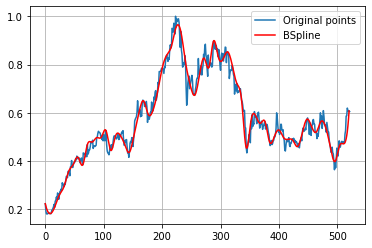

In [ ]:
import scipy.interpolate as interpolate

t_SMGR_65, c_SMGR_65, k_SMGR_65 = interpolate.splrep(SMGR_x65, SMGR_y65, s=0, k=3)
print('''\
t_SMGR_65: {}
c_SMGR_65: {}
k_SMGR_65: {}
'''.format(t_SMGR_65, c_SMGR_65, k_SMGR_65))
N = 522
xmin_SMGR_65, xmax_SMGR_65 = SMGR_x65.min(), SMGR_x65.max()
xx_SMGR_65 = np.linspace(xmin_SMGR_65, xmax_SMGR_65, N)
spline_SMGR_65 = interpolate.BSpline(t_SMGR_65, c_SMGR_65, k_SMGR_65, extrapolate=False)

plt.plot(SMGR_x, SMGR_y, label='Original points')
plt.plot(xx_SMGR_65, spline_SMGR_65(xx_SMGR_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE SMGR**

In [ ]:

#RMSE 15 DATA SMGR
y_true_SMGR_15 = SMGR_y.tolist()
y_pred_SMGR_15 = spline_SMGR_15(xx_SMGR_15).tolist()
mse_SMGR_15 = mean_squared_error(y_true_SMGR_15, y_pred_SMGR_15)
rmse_SMGR_15 = np.sqrt(mse_SMGR_15)
print("rmse SMGR 15 =",rmse_SMGR_15)

#RMSE 25 DATA SMGR
y_true_SMGR_25 = SMGR_y.tolist()
y_pred_SMGR_25 = spline_SMGR_25(xx_SMGR_25).tolist()
mse_SMGR_25 = mean_squared_error(y_true_SMGR_25, y_pred_SMGR_25)
rmse_SMGR_25 = np.sqrt(mse_SMGR_25)
print("rmse SMGR 25 =",rmse_SMGR_25)

#RMSE 35 DATA SMGR
y_true_SMGR_35 = SMGR_y.tolist()
y_pred_SMGR_35 = spline_SMGR_35(xx_SMGR_35).tolist()
mse_SMGR_35 = mean_squared_error(y_true_SMGR_35, y_pred_SMGR_35)
rmse_SMGR_35 = np.sqrt(mse_SMGR_35)
print("rmse SMGR 35 =",rmse_SMGR_35)

#RMSE 45 DATA SMGR
y_true_SMGR_45 = SMGR_y.tolist()
y_pred_SMGR_45 = spline_SMGR_45(xx_SMGR_45).tolist()
mse_SMGR_45 = mean_squared_error(y_true_SMGR_45, y_pred_SMGR_45)
rmse_SMGR_45 = np.sqrt(mse_SMGR_45)
print("rmse SMGR 45 =",rmse_SMGR_45)

#RMSE 55 DATA SMGR
y_true_SMGR_55 = SMGR_y.tolist()
y_pred_SMGR_55 = spline_SMGR_55(xx_SMGR_55).tolist()
mse_SMGR_55 = mean_squared_error(y_true_SMGR_55, y_pred_SMGR_55)
rmse_SMGR_55 = np.sqrt(mse_SMGR_55)
print("rmse SMGR 55 =",rmse_SMGR_55)

#RMSE 65 DATA SMGR
y_true_SMGR_65 = SMGR_y.tolist()
y_pred_SMGR_65 = spline_SMGR_65(xx_SMGR_65).tolist()
mse_SMGR_65 = mean_squared_error(y_true_SMGR_65, y_pred_SMGR_65)
rmse_SMGR_65 = np.sqrt(mse_SMGR_65)
print("rmse SMGR 65 =",rmse_SMGR_65)

rmse SMGR 15 = 0.0728396235513838
rmse SMGR 25 = 0.05796395187458622
rmse SMGR 35 = 0.06207207472819123
rmse SMGR 45 = 0.039012587833825094
rmse SMGR 55 = 0.031541042478978425
rmse SMGR 65 = 0.030399361670646018


# **SMRA**

No handles with labels found to put in legend.


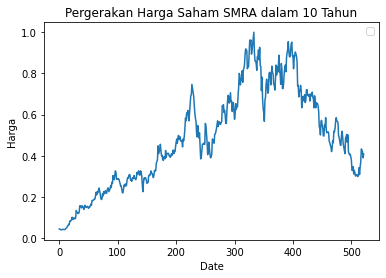

In [ ]:
SMRA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SMRA.JK.csv')

SMRA_x = SMRA['No'].values
SMRA_y = SMRA['Skala'].values

plt.plot(SMRA_x,SMRA_y)
plt.title('Pergerakan Harga Saham SMRA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA SMRA**

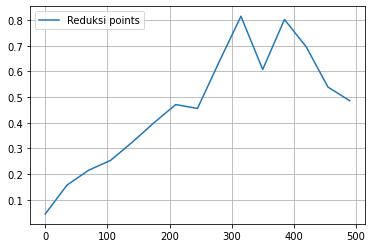

In [ ]:
SMRA_x15 = SMRA_x[0:522:35]
SMRA_y15 = SMRA_y[0:522:35]

plt.plot(SMRA_x15, SMRA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMRA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_SMRA_15: [0.04455696 0.14235795 0.21325879 0.24268566 0.3276292  0.39110134
 0.50796543 0.40235338 0.61679828 0.9583016  0.44113456 0.9227298
 0.60327155 0.48127561 0.48607595 0.         0.         0.
 0.        ]
k_SMRA_15: 3



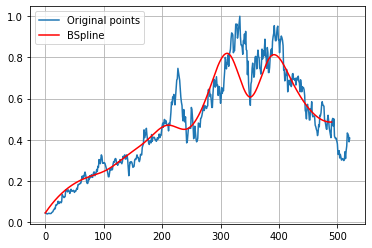

In [ ]:
import scipy.interpolate as interpolate

t_SMRA_15, c_SMRA_15, k_SMRA_15 = interpolate.splrep(SMRA_x15, SMRA_y15, s=0, k=3)
print('''\
t_SMRA_15: {}
c_SMRA_15: {}
k_SMRA_15: {}
'''.format(t_SMRA_15, c_SMRA_15, k_SMRA_15))
N = 522
xmin_SMRA_15, xmax_SMRA_15 = SMRA_x15.min(), SMRA_x15.max()
xx_SMRA_15 = np.linspace(xmin_SMRA_15, xmax_SMRA_15, N)
spline_SMRA_15 = interpolate.BSpline(t_SMRA_15, c_SMRA_15, k_SMRA_15, extrapolate=False)

plt.plot(SMRA_x, SMRA_y, label='Original points')
plt.plot(xx_SMRA_15, spline_SMRA_15(xx_SMRA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA SMRA**

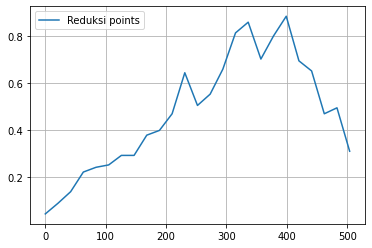

In [ ]:
SMRA_x25 = SMRA_x[0:522:21]
SMRA_y25 = SMRA_y[0:522:21]

plt.plot(SMRA_x25, SMRA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_SMRA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_SMRA_25: [0.04455696 0.08995131 0.08769231 0.24158389 0.24420808 0.23981164
 0.3155327  0.26008287 0.40616113 0.39375364 0.41882433 0.7562655
 0.42953141 0.56358355 0.64271665 0.8301068  0.92799538 0.62246864
 0.80491486 0.9730618  0.61929365 0.7269788  0.28004508 0.6568129
 0.3113924  0.         0.         0.         0.        ]
k_SMRA_25: 3



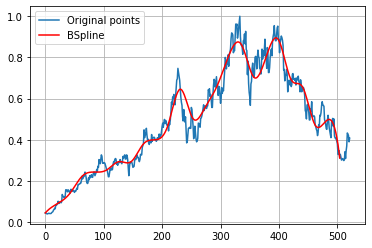

In [ ]:
import scipy.interpolate as interpolate

t_SMRA_25, c_SMRA_25, k_SMRA_25 = interpolate.splrep(SMRA_x25, SMRA_y25, s=0, k=3)
print('''\
t_SMRA_25: {}
c_SMRA_25: {}
k_SMRA_25: {}
'''.format(t_SMRA_25, c_SMRA_25, k_SMRA_25))
N = 522
xmin_SMRA_25, xmax_SMRA_25 = SMRA_x25.min(), SMRA_x25.max()
xx_SMRA_25 = np.linspace(xmin_SMRA_25, xmax_SMRA_25, N)
spline_SMRA_25 = interpolate.BSpline(t_SMRA_25, c_SMRA_25, k_SMRA_25, extrapolate=False)

plt.plot(SMRA_x, SMRA_y, label='Original points')
plt.plot(xx_SMRA_25, spline_SMRA_25(xx_SMRA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA SMRA**

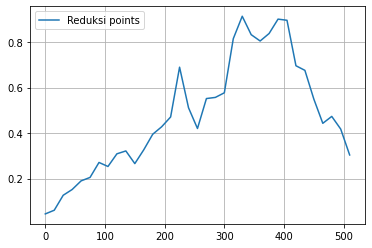

In [ ]:
SMRA_x35 = SMRA_x[0:522:15]
SMRA_y35 = SMRA_y[0:522:15]

plt.plot(SMRA_x35, SMRA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMRA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_SMRA_35: [0.04455696 0.00802924 0.14140988 0.14138729 0.204439   0.18009723
 0.30555183 0.22301192 0.32138784 0.34460128 0.22932098 0.33305153
 0.39796656 0.44470246 0.39031219 0.81936525 0.47146733 0.36311985
 0.59757224 0.55798358 0.51226559 0.8562452  0.95389286 0.81172768
 0.79666479 0.8319929  0.9032117  0.96275525 0.6229825  0.72252996
 0.54259388 0.40329705 0.53549536 0.37339156 0.30379747 0.
 0.         0.         0.        ]
k_SMRA_35: 3



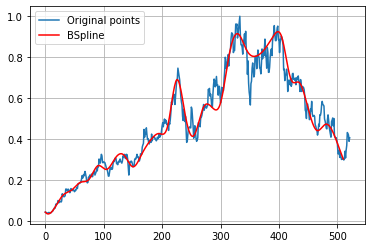

In [ ]:
import scipy.interpolate as interpolate

t_SMRA_35, c_SMRA_35, k_SMRA_35 = interpolate.splrep(SMRA_x35, SMRA_y35, s=0, k=3)
print('''\
t_SMRA_35: {}
c_SMRA_35: {}
k_SMRA_35: {}
'''.format(t_SMRA_35, c_SMRA_35, k_SMRA_35))
N = 522
xmin_SMRA_35, xmax_SMRA_35 = SMRA_x35.min(), SMRA_x35.max()
xx_SMRA_35 = np.linspace(xmin_SMRA_35, xmax_SMRA_35, N)
spline_SMRA_35 = interpolate.BSpline(t_SMRA_35, c_SMRA_35, k_SMRA_35, extrapolate=False)

plt.plot(SMRA_x, SMRA_y, label='Original points')
plt.plot(xx_SMRA_35, spline_SMRA_35(xx_SMRA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA SMRA**

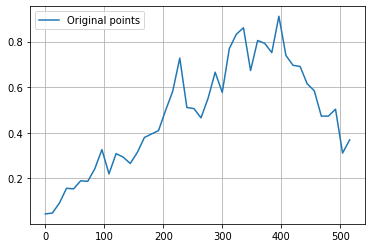

In [ ]:
SMRA_x45 = SMRA_x[0:522:12]
SMRA_y45 = SMRA_y[0:522:12]

plt.plot(SMRA_x45, SMRA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMRA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_SMRA_45: [0.04455696 0.03737307 0.05019057 0.18110655 0.13442637 0.20777024
 0.17373319 0.22134764 0.39910409 0.14172967 0.35549621 0.28945004
 0.24872893 0.31057095 0.39253158 0.39778374 0.38595372 0.51916087
 0.52980787 0.85527854 0.41616658 0.54840957 0.42816984 0.53384778
 0.74783143 0.46976321 0.83640687 0.80233083 0.95173816 0.5552735
 0.86767419 0.8044095  0.66911819 1.03051014 0.67719567 0.6961502
 0.71541871 0.58901041 0.61967888 0.44113484 0.45628809 0.61352946
 0.09766565 0.36962025 0.         0.         0.         0.        ]
k_SMRA_45: 3



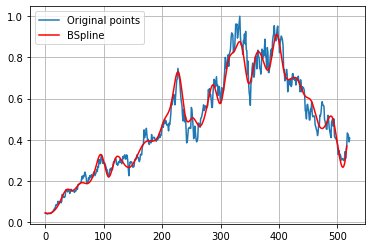

In [ ]:
import scipy.interpolate as interpolate

t_SMRA_45, c_SMRA_45, k_SMRA_45 = interpolate.splrep(SMRA_x45, SMRA_y45, s=0, k=3)
print('''\
t_SMRA_45: {}
c_SMRA_45: {}
k_SMRA_45: {}
'''.format(t_SMRA_45, c_SMRA_45, k_SMRA_45))
N = 522
xmin_SMRA_45, xmax_SMRA_45 = SMRA_x45.min(), SMRA_x45.max()
xx_SMRA_45 = np.linspace(xmin_SMRA_45, xmax_SMRA_45, N)
spline_SMRA_45 = interpolate.BSpline(t_SMRA_45, c_SMRA_45, k_SMRA_45, extrapolate=False)

plt.plot(SMRA_x, SMRA_y, label='Original points')
plt.plot(xx_SMRA_45, spline_SMRA_45(xx_SMRA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA SMRA**


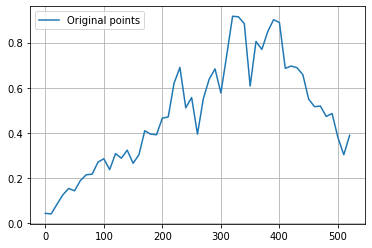

In [ ]:
SMRA_x55 = SMRA_x[0:522:10]
SMRA_y55 = SMRA_y[0:522:10]

plt.plot(SMRA_x55, SMRA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMRA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_SMRA_55: [0.04455696 0.01459033 0.07423706 0.12583851 0.1690022  0.12473495
 0.19788077 0.22298248 0.20132856 0.27803239 0.31185833 0.19098999
 0.35202983 0.25405525 0.36339475 0.23666953 0.28486383 0.44665997
 0.3892558  0.36593709 0.50142623 0.4232947  0.63071142 0.77537862
 0.40701462 0.66491732 0.27508823 0.60435001 0.61890412 0.74788162
 0.49083522 0.75206864 0.96671302 0.87981346 0.99757745 0.43114257
 0.92342188 0.70554966 0.87210102 0.89465388 0.95687841 0.60947805
 0.72166508 0.68107681 0.68567325 0.52559728 0.50814016 0.54057626
 0.44347886 0.52601464 0.31655283 0.25691346 0.38987342 0.
 0.         0.         0.        ]
k_SMRA_55: 3



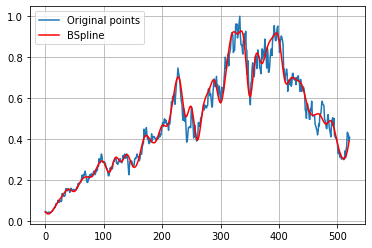

In [ ]:
import scipy.interpolate as interpolate

t_SMRA_55, c_SMRA_55, k_SMRA_55 = interpolate.splrep(SMRA_x55, SMRA_y55, s=0, k=3)
print('''\
t_SMRA_55: {}
c_SMRA_55: {}
k_SMRA_55: {}
'''.format(t_SMRA_55, c_SMRA_55, k_SMRA_55))
N = 522
xmin_SMRA_55, xmax_SMRA_55 = SMRA_x55.min(), SMRA_x55.max()
xx_SMRA_55 = np.linspace(xmin_SMRA_55, xmax_SMRA_55, N)
spline_SMRA_55 = interpolate.BSpline(t_SMRA_55, c_SMRA_55, k_SMRA_55, extrapolate=False)

plt.plot(SMRA_x, SMRA_y, label='Original points')
plt.plot(xx_SMRA_55, spline_SMRA_55(xx_SMRA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA SMRA**

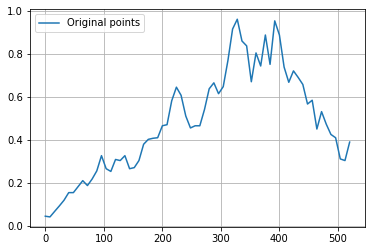

In [ ]:
SMRA_x65 = SMRA_x[0:522:8]
SMRA_y65 = SMRA_y[0:522:8]

plt.plot(SMRA_x65, SMRA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMRA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_SMRA_65: [0.04455696 0.02466632 0.05990788 0.09319726 0.11341112 0.1670823
 0.14484195 0.1801322  0.22830016 0.16742666 0.22604384 0.23472709
 0.369225   0.24786656 0.23424547 0.33413892 0.28236341 0.35919223
 0.24036132 0.27429919 0.28775837 0.39745213 0.40091414 0.4140812
 0.38833067 0.49335562 0.43318356 0.59922661 0.6635809  0.61986751
 0.5025187  0.43841214 0.47800996 0.44448474 0.53898777 0.65019707
 0.68807205 0.59245142 0.63326149 0.7631102  0.93201924 1.00754701
 0.80994461 0.91723152 0.5489774  0.91217533 0.63270103 1.02284334
 0.60757119 1.0582643  0.88595389 0.72956572 0.63122628 0.75565574
 0.67526469 0.6901209

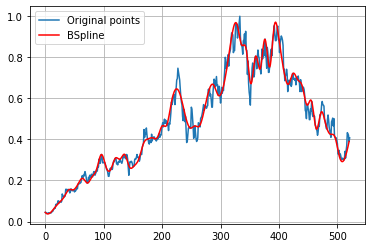

In [ ]:
import scipy.interpolate as interpolate

t_SMRA_65, c_SMRA_65, k_SMRA_65 = interpolate.splrep(SMRA_x65, SMRA_y65, s=0, k=3)
print('''\
t_SMRA_65: {}
c_SMRA_65: {}
k_SMRA_65: {}
'''.format(t_SMRA_65, c_SMRA_65, k_SMRA_65))
N = 522
xmin_SMRA_65, xmax_SMRA_65 = SMRA_x65.min(), SMRA_x65.max()
xx_SMRA_65 = np.linspace(xmin_SMRA_65, xmax_SMRA_65, N)
spline_SMRA_65 = interpolate.BSpline(t_SMRA_65, c_SMRA_65, k_SMRA_65, extrapolate=False)

plt.plot(SMRA_x, SMRA_y, label='Original points')
plt.plot(xx_SMRA_65, spline_SMRA_65(xx_SMRA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE SMRA**

In [ ]:

#RMSE 15 DATA SMRA
y_true_SMRA_15 = SMRA_y.tolist()
y_pred_SMRA_15 = spline_SMRA_15(xx_SMRA_15).tolist()
mse_SMRA_15 = mean_squared_error(y_true_SMRA_15, y_pred_SMRA_15)
rmse_SMRA_15 = np.sqrt(mse_SMRA_15)
print("rmse SMRA 15 =",rmse_SMRA_15)

#RMSE 25 DATA SMRA
y_true_SMRA_25 = SMRA_y.tolist()
y_pred_SMRA_25 = spline_SMRA_25(xx_SMRA_25).tolist()
mse_SMRA_25 = mean_squared_error(y_true_SMRA_25, y_pred_SMRA_25)
rmse_SMRA_25 = np.sqrt(mse_SMRA_25)
print("rmse SMRA 25 =",rmse_SMRA_25)

#RMSE 35 DATA SMRA
y_true_SMRA_35 = SMRA_y.tolist()
y_pred_SMRA_35 = spline_SMRA_35(xx_SMRA_35).tolist()
mse_SMRA_35 = mean_squared_error(y_true_SMRA_35, y_pred_SMRA_35)
rmse_SMRA_35 = np.sqrt(mse_SMRA_35)
print("rmse SMRA 35 =",rmse_SMRA_35)

#RMSE 45 DATA SMRA
y_true_SMRA_45 = SMRA_y.tolist()
y_pred_SMRA_45 = spline_SMRA_45(xx_SMRA_45).tolist()
mse_SMRA_45 = mean_squared_error(y_true_SMRA_45, y_pred_SMRA_45)
rmse_SMRA_45 = np.sqrt(mse_SMRA_45)
print("rmse SMRA 45 =",rmse_SMRA_45)

#RMSE 55 DATA SMRA
y_true_SMRA_55 = SMRA_y.tolist()
y_pred_SMRA_55 = spline_SMRA_55(xx_SMRA_55).tolist()
mse_SMRA_55 = mean_squared_error(y_true_SMRA_55, y_pred_SMRA_55)
rmse_SMRA_55 = np.sqrt(mse_SMRA_55)
print("rmse SMRA 55 =",rmse_SMRA_55)

#RMSE 65 DATA SMRA
y_true_SMRA_65 = SMRA_y.tolist()
y_pred_SMRA_65 = spline_SMRA_65(xx_SMRA_65).tolist()
mse_SMRA_65 = mean_squared_error(y_true_SMRA_65, y_pred_SMRA_65)
rmse_SMRA_65 = np.sqrt(mse_SMRA_65)
print("rmse SMRA 65 =",rmse_SMRA_65)


rmse SMRA 15 = 0.09175268452347037
rmse SMRA 25 = 0.0800684251184913
rmse SMRA 35 = 0.06886995251273827
rmse SMRA 45 = 0.051780222118163646
rmse SMRA 55 = 0.039875816950289744
rmse SMRA 65 = 0.03628739547664357


# **SMSM**

No handles with labels found to put in legend.


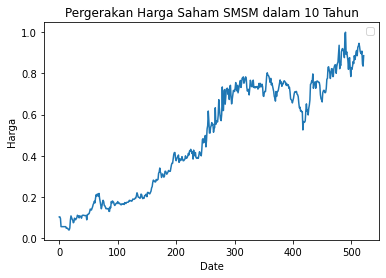

In [ ]:
SMSM = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SMSM.JK.csv')

SMSM_x = SMSM['No'].values
SMSM_y = SMSM['Skala'].values

plt.plot(SMSM_x,SMSM_y)
plt.title('Pergerakan Harga Saham SMSM dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA SMSM**

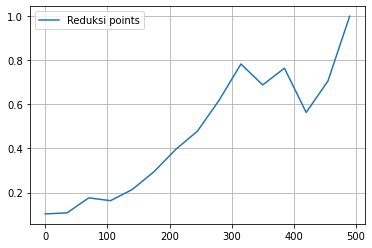

In [ ]:
SMSM_x15 = SMSM_x[0:522:35]
SMSM_y15 = SMSM_y[0:522:35]

plt.plot(SMSM_x15, SMSM_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMSM_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_SMSM_15: [0.1028481  0.03277599 0.22558726 0.13999464 0.21368045 0.28692915
 0.40442574 0.46878562 0.59226721 0.87891768 0.59142915 0.88511256
 0.30971399 0.86571263 1.         0.         0.         0.
 0.        ]
k_SMSM_15: 3



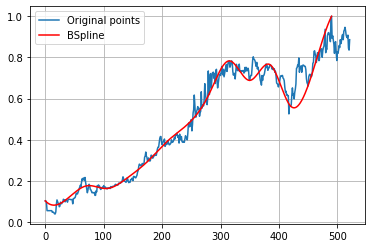

In [ ]:
import scipy.interpolate as interpolate

t_SMSM_15, c_SMSM_15, k_SMSM_15 = interpolate.splrep(SMSM_x15, SMSM_y15, s=0, k=3)
print('''\
t_SMSM_15: {}
c_SMSM_15: {}
k_SMSM_15: {}
'''.format(t_SMSM_15, c_SMSM_15, k_SMSM_15))
N = 522
xmin_SMSM_15, xmax_SMSM_15 = SMSM_x15.min(), SMSM_x15.max()
xx_SMSM_15 = np.linspace(xmin_SMSM_15, xmax_SMSM_15, N)
spline_SMSM_15 = interpolate.BSpline(t_SMSM_15, c_SMSM_15, k_SMSM_15, extrapolate=False)

plt.plot(SMSM_x, SMSM_y, label='Original points')
plt.plot(xx_SMSM_15, spline_SMSM_15(xx_SMSM_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA SMSM**

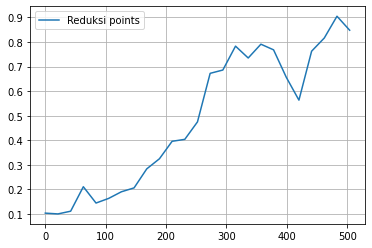

In [ ]:
SMSM_x25 = SMSM_x[0:522:21]
SMSM_y25 = SMSM_y[0:522:21]

plt.plot(SMSM_x25, SMSM_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMSM_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_SMSM_25: [0.1028481  0.14161978 0.00869083 0.27058718 0.10614459 0.16875851
 0.19666947 0.18380411 0.30229132 0.30639772 0.41832036 0.39373858
 0.42761139 0.74391712 0.63153026 0.84546816 0.68596417 0.82048528
 0.77893015 0.67297133 0.46905793 0.83054376 0.76944058 1.00926705
 0.84810127 0.         0.         0.         0.        ]
k_SMSM_25: 3



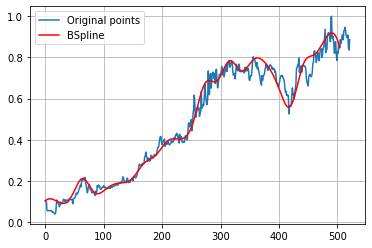

In [ ]:
import scipy.interpolate as interpolate

t_SMSM_25, c_SMSM_25, k_SMSM_25 = interpolate.splrep(SMSM_x25, SMSM_y25, s=0, k=3)
print('''\
t_SMSM_25: {}
c_SMSM_25: {}
k_SMSM_25: {}
'''.format(t_SMSM_25, c_SMSM_25, k_SMSM_25))
N = 522
xmin_SMSM_25, xmax_SMSM_25 = SMSM_x25.min(), SMSM_x25.max()
xx_SMSM_25 = np.linspace(xmin_SMSM_25, xmax_SMSM_25, N)
spline_SMSM_25 = interpolate.BSpline(t_SMSM_25, c_SMSM_25, k_SMSM_25, extrapolate=False)

plt.plot(SMSM_x, SMSM_y, label='Original points')
plt.plot(xx_SMSM_25, spline_SMSM_25(xx_SMSM_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA SMSM**

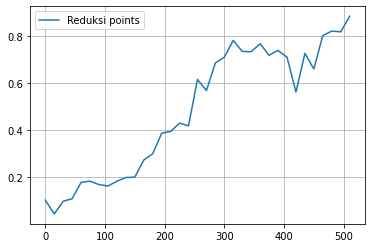

In [ ]:
SMSM_x35 = SMSM_x[0:522:15]
SMSM_y35 = SMSM_y[0:522:15]

plt.plot(SMSM_x35, SMSM_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMSM_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_SMSM_35: [ 0.1028481  -0.02768167  0.13210384  0.08335795  0.20171412  0.18257037
  0.16927024  0.15617147  0.18389199  0.20952638  0.17420502  0.29934974
  0.27080107  0.42124343  0.37017456  0.47147605  0.33094654  0.72056056
  0.48934287  0.73978947  0.67649925  0.82636542  0.71740615  0.72331376
  0.79914892  0.69401461  0.74441288  0.77137184  0.44225164  0.83936842
  0.56736326  0.85953295  0.8032087   0.81042097  0.88607595  0.
  0.          0.          0.        ]
k_SMSM_35: 3



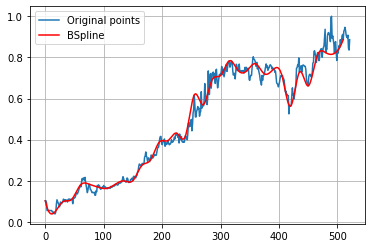

In [ ]:
import scipy.interpolate as interpolate

t_SMSM_35, c_SMSM_35, k_SMSM_35 = interpolate.splrep(SMSM_x35, SMSM_y35, s=0, k=3)
print('''\
t_SMSM_35: {}
c_SMSM_35: {}
k_SMSM_35: {}
'''.format(t_SMSM_35, c_SMSM_35, k_SMSM_35))
N = 522
xmin_SMSM_35, xmax_SMSM_35 = SMSM_x35.min(), SMSM_x35.max()
xx_SMSM_35 = np.linspace(xmin_SMSM_35, xmax_SMSM_35, N)
spline_SMSM_35 = interpolate.BSpline(t_SMSM_35, c_SMSM_35, k_SMSM_35, extrapolate=False)

plt.plot(SMSM_x, SMSM_y, label='Original points')
plt.plot(xx_SMSM_35, spline_SMSM_35(xx_SMSM_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA SMSM**

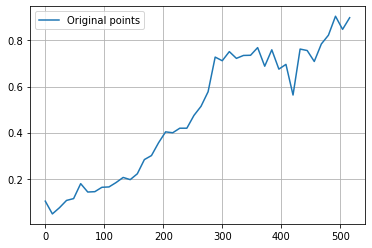

In [ ]:
SMSM_x45 = SMSM_x[0:522:12]
SMSM_y45 = SMSM_y[0:522:12]

plt.plot(SMSM_x45, SMSM_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMSM_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_SMSM_45: [0.1028481  0.02150238 0.05826106 0.11883205 0.08734396 0.21533641
 0.1240952  0.14271318 0.16897612 0.15923044 0.1814439  0.21625978
 0.1876942  0.2101786  0.30070532 0.28636721 0.3576233  0.41921552
 0.38640069 0.43233362 0.40008763 0.48313866 0.51545902 0.54046832
 0.78785758 0.67518995 0.7835345  0.70016571 0.74966341 0.71099077
 0.82093048 0.61921136 0.83197091 0.60986704 0.78235842 0.43791448
 0.84573048 0.75511296 0.67179235 0.81088217 0.79353972 1.00437718
 0.74306458 0.89873418 0.         0.         0.         0.        ]
k_SMSM_45: 3



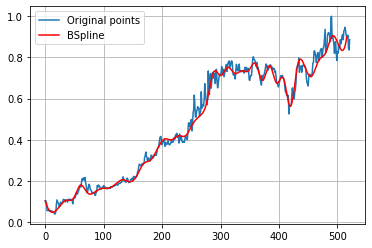

In [ ]:
import scipy.interpolate as interpolate

t_SMSM_45, c_SMSM_45, k_SMSM_45 = interpolate.splrep(SMSM_x45, SMSM_y45, s=0, k=3)
print('''\
t_SMSM_45: {}
c_SMSM_45: {}
k_SMSM_45: {}
'''.format(t_SMSM_45, c_SMSM_45, k_SMSM_45))
N = 522
xmin_SMSM_45, xmax_SMSM_45 = SMSM_x45.min(), SMSM_x45.max()
xx_SMSM_45 = np.linspace(xmin_SMSM_45, xmax_SMSM_45, N)
spline_SMSM_45 = interpolate.BSpline(t_SMSM_45, c_SMSM_45, k_SMSM_45, extrapolate=False)

plt.plot(SMSM_x, SMSM_y, label='Original points')
plt.plot(xx_SMSM_45, spline_SMSM_45(xx_SMSM_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA SMSM**

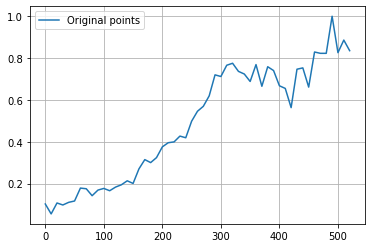

In [ ]:
SMSM_x55 = SMSM_x[0:522:10]
SMSM_y55 = SMSM_y[0:522:10]

plt.plot(SMSM_x55, SMSM_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_SMSM_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_SMSM_55: [ 0.1028481  -0.01491908  0.14613563  0.08419846  0.12116242  0.09570883
  0.1985339   0.18294037  0.12350207  0.17748171  0.18239386  0.15623398
  0.18950567  0.18700916  0.2301792   0.17391962  0.27983852  0.33014402
  0.2888259   0.31834984  0.38397725  0.40048797  0.38748858  0.44670961
  0.38896413  0.51325666  0.54851557  0.56799751  0.59721591  0.75991098
  0.6827604   0.7811993   0.78737912  0.72118297  0.74719279  0.63340029
  0.84895288  0.58471223  0.80428681  0.75035572  0.6373283   0.70666021
  0.4664106   0.80744423  0.78482516  0.57224249  0.89455933  0.82420373
  0.74533459  1.13116675  0.59627561  1.05866599  0.83544304  0.
  0.          0.          0.        ]


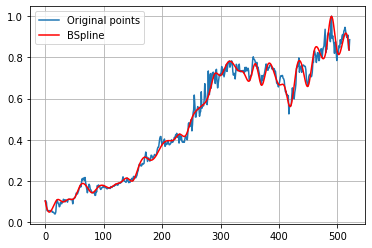

In [ ]:
import scipy.interpolate as interpolate

t_SMSM_55, c_SMSM_55, k_SMSM_55 = interpolate.splrep(SMSM_x55, SMSM_y55, s=0, k=3)
print('''\
t_SMSM_55: {}
c_SMSM_55: {}
k_SMSM_55: {}
'''.format(t_SMSM_55, c_SMSM_55, k_SMSM_55))
N = 522
xmin_SMSM_55, xmax_SMSM_55 = SMSM_x55.min(), SMSM_x55.max()
xx_SMSM_55 = np.linspace(xmin_SMSM_55, xmax_SMSM_55, N)
spline_SMSM_55 = interpolate.BSpline(t_SMSM_55, c_SMSM_55, k_SMSM_55, extrapolate=False)

plt.plot(SMSM_x, SMSM_y, label='Original points')
plt.plot(xx_SMSM_55, spline_SMSM_55(xx_SMSM_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA SMSM**

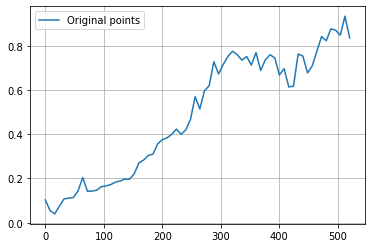

In [ ]:
SMSM_x65 = SMSM_x[0:522:8]
SMSM_y65 = SMSM_y[0:522:8]

plt.plot(SMSM_x65, SMSM_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SMSM_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_SMSM_65: [0.1028481  0.06922349 0.01186947 0.07581393 0.11509122 0.1093908
 0.11190253 0.12654339 0.24584795 0.11474836 0.149589   0.14132601
 0.16801834 0.16444872 0.17102223 0.18627248 0.18515369 0.2028596
 0.19011675 0.21388857 0.28344289 0.27575758 0.31289387 0.29545174
 0.36605868 0.37638951 0.38313013 0.39330516 0.44080114 0.38304726
 0.42416171 0.43612866 0.63195655 0.45376667 0.6384198  0.57166806
 0.7916801  0.62870016 0.72832939 0.74912152 0.78467818 0.76406448
 0.71602593 0.78164192 0.66690004 0.82765664 0.63639743 0.75650046
 0.75690452 0.7728435  0.62324048 0.74052368 0.59187998 0.57550069
 0.80864892 0.7658530

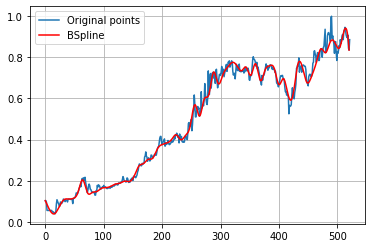

In [ ]:
import scipy.interpolate as interpolate

t_SMSM_65, c_SMSM_65, k_SMSM_65 = interpolate.splrep(SMSM_x65, SMSM_y65, s=0, k=3)
print('''\
t_SMSM_65: {}
c_SMSM_65: {}
k_SMSM_65: {}
'''.format(t_SMSM_65, c_SMSM_65, k_SMSM_65))
N = 522
xmin_SMSM_65, xmax_SMSM_65 = SMSM_x65.min(), SMSM_x65.max()
xx_SMSM_65 = np.linspace(xmin_SMSM_65, xmax_SMSM_65, N)
spline_SMSM_65 = interpolate.BSpline(t_SMSM_65, c_SMSM_65, k_SMSM_65, extrapolate=False)

plt.plot(SMSM_x, SMSM_y, label='Original points')
plt.plot(xx_SMSM_65, spline_SMSM_65(xx_SMSM_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE SMSM**

In [ ]:

#RMSE 15 DATA SMSM
y_true_SMSM_15 = SMSM_y.tolist()
y_pred_SMSM_15 = spline_SMSM_15(xx_SMSM_15).tolist()
mse_SMSM_15 = mean_squared_error(y_true_SMSM_15, y_pred_SMSM_15)
rmse_SMSM_15 = np.sqrt(mse_SMSM_15)
print("rmse SMSM 15 =",rmse_SMSM_15)

#RMSE 25 DATA SMSM
y_true_SMSM_25 = SMSM_y.tolist()
y_pred_SMSM_25 = spline_SMSM_25(xx_SMSM_25).tolist()
mse_SMSM_25 = mean_squared_error(y_true_SMSM_25, y_pred_SMSM_25)
rmse_SMSM_25 = np.sqrt(mse_SMSM_25)
print("rmse SMSM 25 =",rmse_SMSM_25)

#RMSE 35 DATA SMSM
y_true_SMSM_35 = SMSM_y.tolist()
y_pred_SMSM_35 = spline_SMSM_35(xx_SMSM_35).tolist()
mse_SMSM_35 = mean_squared_error(y_true_SMSM_35, y_pred_SMSM_35)
rmse_SMSM_35 = np.sqrt(mse_SMSM_35)
print("rmse SMSM 35 =",rmse_SMSM_35)

#RMSE 45 DATA SMSM
y_true_SMSM_45 = SMSM_y.tolist()
y_pred_SMSM_45 = spline_SMSM_45(xx_SMSM_45).tolist()
mse_SMSM_45 = mean_squared_error(y_true_SMSM_45, y_pred_SMSM_45)
rmse_SMSM_45 = np.sqrt(mse_SMSM_45)
print("rmse SMSM 45 =",rmse_SMSM_45)

#RMSE 55 DATA SMSM
y_true_SMSM_55 = SMSM_y.tolist()
y_pred_SMSM_55 = spline_SMSM_55(xx_SMSM_55).tolist()
mse_SMSM_55 = mean_squared_error(y_true_SMSM_55, y_pred_SMSM_55)
rmse_SMSM_55 = np.sqrt(mse_SMSM_55)
print("rmse SMSM 55 =",rmse_SMSM_55)

#RMSE 65 DATA SMSM
y_true_SMSM_65 = SMSM_y.tolist()
y_pred_SMSM_65 = spline_SMSM_65(xx_SMSM_65).tolist()
mse_SMSM_65 = mean_squared_error(y_true_SMSM_65, y_pred_SMSM_65)
rmse_SMSM_65 = np.sqrt(mse_SMSM_65)
print("rmse SMSM 65 =",rmse_SMSM_65)

rmse SMSM 15 = 0.08204607943031875
rmse SMSM 25 = 0.04957659357134575
rmse SMSM 35 = 0.0478792681319301
rmse SMSM 45 = 0.03816175945004962
rmse SMSM 55 = 0.028901013821159477
rmse SMSM 65 = 0.026645917841954192


# **SSIA**

No handles with labels found to put in legend.


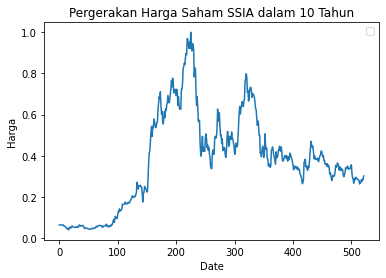

In [ ]:
SSIA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SSIA.JK.csv')

SSIA_x = SSIA['No'].values
SSIA_y = SSIA['Skala'].values

plt.plot(SSIA_x,SSIA_y)
plt.title('Pergerakan Harga Saham SSIA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA SSIA**

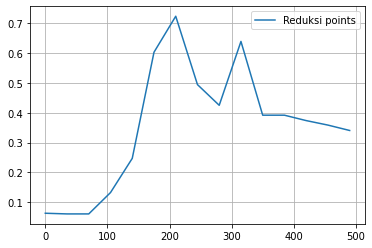

In [ ]:
SSIA_x15 = SSIA_x[0:522:35]
SSIA_y15 = SSIA_y[0:522:35]

plt.plot(SSIA_x15, SSIA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SSIA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_SSIA_15: [0.06325301 0.08893552 0.00398136 0.14670115 0.16871482 0.66036729
 0.80427385 0.45988669 0.32003481 0.80816682 0.2786232  0.42673796
 0.34285073 0.36697825 0.34036145 0.         0.         0.
 0.        ]
k_SSIA_15: 3



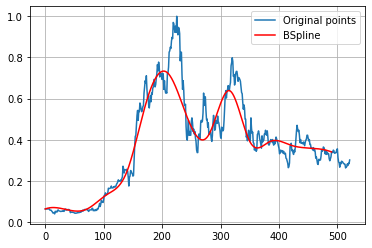

In [ ]:
import scipy.interpolate as interpolate

t_SSIA_15, c_SSIA_15, k_SSIA_15 = interpolate.splrep(SSIA_x15, SSIA_y15, s=0, k=3)
print('''\
t_SSIA_15: {}
c_SSIA_15: {}
k_SSIA_15: {}
'''.format(t_SSIA_15, c_SSIA_15, k_SSIA_15))
N = 522
xmin_SSIA_15, xmax_SSIA_15 = SSIA_x15.min(), SSIA_x15.max()
xx_SSIA_15 = np.linspace(xmin_SSIA_15, xmax_SSIA_15, N)
spline_SSIA_15 = interpolate.BSpline(t_SSIA_15, c_SSIA_15, k_SSIA_15, extrapolate=False)

plt.plot(SSIA_x, SSIA_y, label='Original points')
plt.plot(xx_SSIA_15, spline_SSIA_15(xx_SSIA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA SSIA**

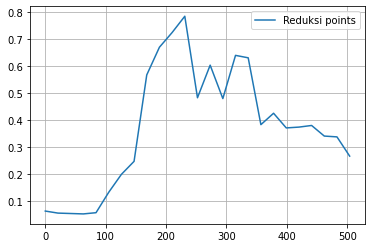

In [ ]:
SSIA_x25 = SSIA_x[0:522:21]
SSIA_y25 = SSIA_y[0:522:21]

plt.plot(SSIA_x25, SSIA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SSIA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_SSIA_25: [0.06325301 0.05563587 0.0528849  0.05596382 0.03875517 0.13238901
 0.22686951 0.15290403 0.64344209 0.67091796 0.68493426 0.92669438
 0.3070834  0.73653828 0.3612213  0.6920705  0.70182201 0.27774989
 0.48235914 0.34100631 0.3765072  0.39392873 0.30187214 0.3721061
 0.26626506 0.         0.         0.         0.        ]
k_SSIA_25: 3



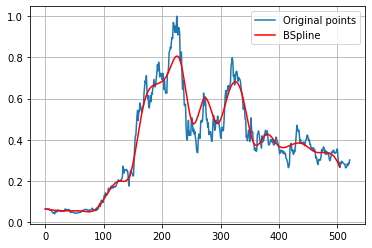

In [ ]:
import scipy.interpolate as interpolate

t_SSIA_25, c_SSIA_25, k_SSIA_25 = interpolate.splrep(SSIA_x25, SSIA_y25, s=0, k=3)
print('''\
t_SSIA_25: {}
c_SSIA_25: {}
k_SSIA_25: {}
'''.format(t_SSIA_25, c_SSIA_25, k_SSIA_25))
N = 522
xmin_SSIA_25, xmax_SSIA_25 = SSIA_x25.min(), SSIA_x25.max()
xx_SSIA_25 = np.linspace(xmin_SSIA_25, xmax_SSIA_25, N)
spline_SSIA_25 = interpolate.BSpline(t_SSIA_25, c_SSIA_25, k_SSIA_25, extrapolate=False)

plt.plot(SSIA_x, SSIA_y, label='Original points')
plt.plot(xx_SSIA_25, spline_SSIA_25(xx_SSIA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA SSIA**

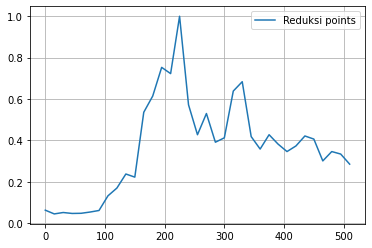

In [ ]:
SSIA_x35 = SSIA_x[0:522:15]
SSIA_y35 = SSIA_y[0:522:15]

plt.plot(SSIA_x35, SSIA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SSIA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_SSIA_35: [0.06325301 0.03164841 0.05982066 0.04562293 0.04587562 0.06003122
 0.03930069 0.15324794 0.14288827 0.29628332 0.0996893  0.64230889
 0.54794261 0.85266766 0.55945904 1.24684556 0.45315872 0.37425452
 0.61608826 0.34211534 0.36484796 0.67439641 0.76889168 0.3524465
 0.33337053 0.4646738  0.37419931 0.33370967 0.36927525 0.43015316
 0.44023257 0.2486756  0.41350007 0.30394274 0.28554217 0.
 0.         0.         0.        ]
k_SSIA_35: 3



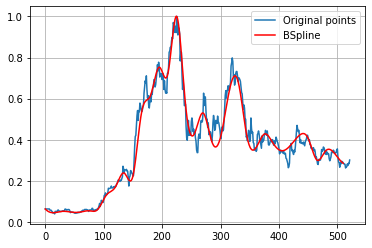

In [ ]:
import scipy.interpolate as interpolate

t_SSIA_35, c_SSIA_35, k_SSIA_35 = interpolate.splrep(SSIA_x35, SSIA_y35, s=0, k=3)
print('''\
t_SSIA_35: {}
c_SSIA_35: {}
k_SSIA_35: {}
'''.format(t_SSIA_35, c_SSIA_35, k_SSIA_35))
N = 522
xmin_SSIA_35, xmax_SSIA_35 = SSIA_x35.min(), SSIA_x35.max()
xx_SSIA_35 = np.linspace(xmin_SSIA_35, xmax_SSIA_35, N)
spline_SSIA_35 = interpolate.BSpline(t_SSIA_35, c_SSIA_35, k_SSIA_35, extrapolate=False)

plt.plot(SSIA_x, SSIA_y, label='Original points')
plt.plot(xx_SSIA_35, spline_SSIA_35(xx_SSIA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA SSIA**

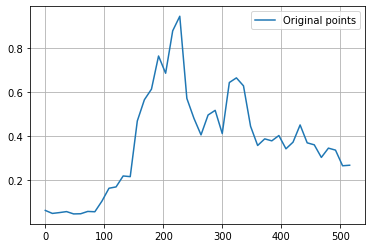

In [ ]:
SSIA_x45 = SSIA_x[0:522:12]
SSIA_y45 = SSIA_y[0:522:12]

plt.plot(SSIA_x45, SSIA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SSIA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_SSIA_45: [0.06325301 0.04545425 0.04952824 0.06269308 0.0442998  0.04474627
 0.06587173 0.04417645 0.10079598 0.18516976 0.14346475 0.26205558
 0.12759002 0.52878914 0.57653051 0.56267918 0.85949977 0.58968318
 0.90224944 1.07842749 0.45873938 0.52034991 0.35142723 0.51370022
 0.57569962 0.29193503 0.73246386 0.64567941 0.67879439 0.41625144
 0.33089864 0.41075642 0.35740098 0.43674807 0.31729347 0.35431899
 0.50639441 0.33094676 0.39271014 0.26688738 0.36504154 0.34666575
 0.20769122 0.2686747  0.         0.         0.         0.        ]
k_SSIA_45: 3



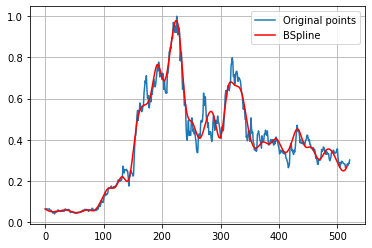

In [ ]:
import scipy.interpolate as interpolate

t_SSIA_45, c_SSIA_45, k_SSIA_45 = interpolate.splrep(SSIA_x45, SSIA_y45, s=0, k=3)
print('''\
t_SSIA_45: {}
c_SSIA_45: {}
k_SSIA_45: {}
'''.format(t_SSIA_45, c_SSIA_45, k_SSIA_45))
N = 522
xmin_SSIA_45, xmax_SSIA_45 = SSIA_x45.min(), SSIA_x45.max()
xx_SSIA_45 = np.linspace(xmin_SSIA_45, xmax_SSIA_45, N)
spline_SSIA_45 = interpolate.BSpline(t_SSIA_45, c_SSIA_45, k_SSIA_45, extrapolate=False)

plt.plot(SSIA_x, SSIA_y, label='Original points')
plt.plot(xx_SSIA_45, spline_SSIA_45(xx_SSIA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA SSIA**

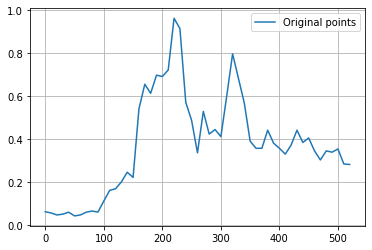

In [ ]:
SSIA_x55 = SSIA_x[0:522:10]
SSIA_y55 = SSIA_y[0:522:10]

plt.plot(SSIA_x55, SSIA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SSIA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_SSIA_55: [0.06325301 0.06434817 0.04449642 0.04896821 0.07025976 0.03595662
 0.04796196 0.06135217 0.07259322 0.04586532 0.11442742 0.17413585
 0.16493279 0.18721733 0.29704125 0.10654537 0.61412667 0.68995999
 0.56579241 0.73361736 0.69250925 0.65297213 1.03295162 0.99835393
 0.46760858 0.56494671 0.20031542 0.65788798 0.34885553 0.49488266
 0.34631264 0.59577041 0.88506355 0.65313201 0.60481805 0.34325843
 0.37154584 0.32116064 0.49441401 0.35780981 0.36952746 0.31468275
 0.35969335 0.48750769 0.34690238 0.43813581 0.34031343 0.27892372
 0.36929288 0.32221802 0.40459897 0.2091463  0.28313253 0.
 0.         0.         0.        ]
k_SSIA_55: 3



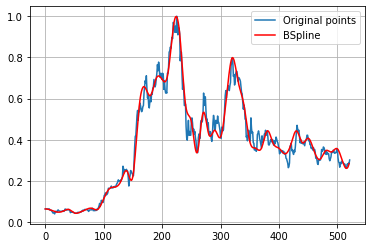

In [ ]:
import scipy.interpolate as interpolate

t_SSIA_55, c_SSIA_55, k_SSIA_55 = interpolate.splrep(SSIA_x55, SSIA_y55, s=0, k=3)
print('''\
t_SSIA_55: {}
c_SSIA_55: {}
k_SSIA_55: {}
'''.format(t_SSIA_55, c_SSIA_55, k_SSIA_55))
N = 522
xmin_SSIA_55, xmax_SSIA_55 = SSIA_x55.min(), SSIA_x55.max()
xx_SSIA_55 = np.linspace(xmin_SSIA_55, xmax_SSIA_55, N)
spline_SSIA_55 = interpolate.BSpline(t_SSIA_55, c_SSIA_55, k_SSIA_55, extrapolate=False)

plt.plot(SSIA_x, SSIA_y, label='Original points')
plt.plot(xx_SSIA_55, spline_SSIA_55(xx_SSIA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA SSIA**

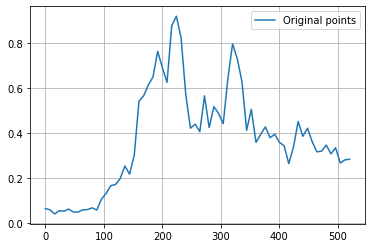

In [ ]:
SSIA_x65 = SSIA_x[0:522:8]
SSIA_y65 = SSIA_y[0:522:8]

plt.plot(SSIA_x65, SSIA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_SSIA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_SSIA_65: [0.06325301 0.08028972 0.0171314  0.0621543  0.04377879 0.06995944
 0.0423473  0.0452899  0.06113165 0.05355698 0.07705005 0.03583317
 0.1184727  0.12280614 0.1764473  0.16538056 0.18311479 0.28589521
 0.19137665 0.24980299 0.6166403  0.53664788 0.63435856 0.61266488
 0.81859637 0.70331107 0.52478586 0.95658162 0.92599609 0.86955451
 0.54759309 0.37380806 0.48729516 0.31556551 0.69020183 0.32121752
 0.57312087 0.49473273 0.37565905 0.65925759 0.85478048 0.7107771
 0.69367738 0.2916218  0.61573902 0.28156669 0.40859662 0.4515167
 0.35160165 0.41918513 0.33912772 0.37490639 0.22148767 0.32227545
 0.51350691 0.3345402

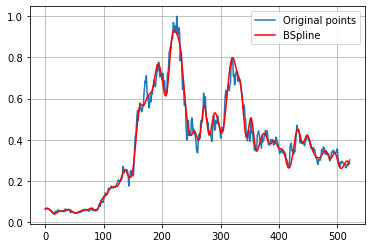

In [ ]:
import scipy.interpolate as interpolate

t_SSIA_65, c_SSIA_65, k_SSIA_65 = interpolate.splrep(SSIA_x65, SSIA_y65, s=0, k=3)
print('''\
t_SSIA_65: {}
c_SSIA_65: {}
k_SSIA_65: {}
'''.format(t_SSIA_65, c_SSIA_65, k_SSIA_65))
N = 522
xmin_SSIA_65, xmax_SSIA_65 = SSIA_x65.min(), SSIA_x65.max()
xx_SSIA_65 = np.linspace(xmin_SSIA_65, xmax_SSIA_65, N)
spline_SSIA_65 = interpolate.BSpline(t_SSIA_65, c_SSIA_65, k_SSIA_65, extrapolate=False)

plt.plot(SSIA_x, SSIA_y, label='Original points')
plt.plot(xx_SSIA_65, spline_SSIA_65(xx_SSIA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE SSIA**

In [ ]:

#RMSE 15 DATA SSIA
y_true_SSIA_15 = SSIA_y.tolist()
y_pred_SSIA_15 = spline_SSIA_15(xx_SSIA_15).tolist()
mse_SSIA_15 = mean_squared_error(y_true_SSIA_15, y_pred_SSIA_15)
rmse_SSIA_15 = np.sqrt(mse_SSIA_15)
print("rmse SSIA 15 =",rmse_SSIA_15)

#RMSE 25 DATA SSIA
y_true_SSIA_25 = SSIA_y.tolist()
y_pred_SSIA_25 = spline_SSIA_25(xx_SSIA_25).tolist()
mse_SSIA_25 = mean_squared_error(y_true_SSIA_25, y_pred_SSIA_25)
rmse_SSIA_25 = np.sqrt(mse_SSIA_25)
print("rmse SSIA 25 =",rmse_SSIA_25)

#RMSE 35 DATA SSIA
y_true_SSIA_35 = SSIA_y.tolist()
y_pred_SSIA_35 = spline_SSIA_35(xx_SSIA_35).tolist()
mse_SSIA_35 = mean_squared_error(y_true_SSIA_35, y_pred_SSIA_35)
rmse_SSIA_35 = np.sqrt(mse_SSIA_35)
print("rmse SSIA 35 =",rmse_SSIA_35)

#RMSE 45 DATA SSIA
y_true_SSIA_45 = SSIA_y.tolist()
y_pred_SSIA_45 = spline_SSIA_45(xx_SSIA_45).tolist()
mse_SSIA_45 = mean_squared_error(y_true_SSIA_45, y_pred_SSIA_45)
rmse_SSIA_45 = np.sqrt(mse_SSIA_45)
print("rmse SSIA 45 =",rmse_SSIA_45)

#RMSE 55 DATA SSIA
y_true_SSIA_55 = SSIA_y.tolist()
y_pred_SSIA_55 = spline_SSIA_55(xx_SSIA_55).tolist()
mse_SSIA_55 = mean_squared_error(y_true_SSIA_55, y_pred_SSIA_55)
rmse_SSIA_55 = np.sqrt(mse_SSIA_55)
print("rmse SSIA 55 =",rmse_SSIA_55)

#RMSE 65 DATA SSIA
y_true_SSIA_65 = SSIA_y.tolist()
y_pred_SSIA_65 = spline_SSIA_65(xx_SSIA_65).tolist()
mse_SSIA_65 = mean_squared_error(y_true_SSIA_65, y_pred_SSIA_65)
rmse_SSIA_65 = np.sqrt(mse_SSIA_65)
print("rmse SSIA 65 =",rmse_SSIA_65)

rmse SSIA 15 = 0.08319771656525049
rmse SSIA 25 = 0.08482417884448161
rmse SSIA 35 = 0.06875681433215115
rmse SSIA 45 = 0.047144705544431835
rmse SSIA 55 = 0.036826875527046186
rmse SSIA 65 = 0.03304259812812918


# **TBLA**

No handles with labels found to put in legend.


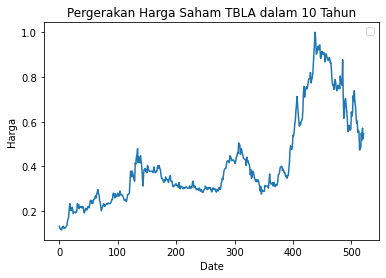

In [ ]:
TBLA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/TBLA.JK.csv')

TBLA_x = TBLA['No'].values
TBLA_y = TBLA['Skala'].values

plt.plot(TBLA_x,TBLA_y)
plt.title('Pergerakan Harga Saham TBLA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA TBLA**

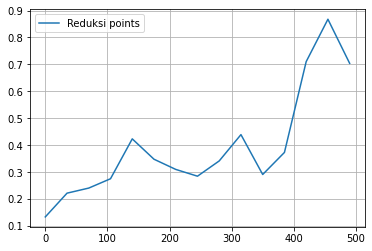

In [ ]:
TBLA_x15 = TBLA_x[0:522:35]
TBLA_y15 = TBLA_y[0:522:35]

plt.plot(TBLA_x15, TBLA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_TBLA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_TBLA_15: [0.13249211 0.2228226  0.25151568 0.2257759  0.49850338 0.31648818
 0.31756283 0.26815009 0.31330685 0.52278654 0.22646181 0.31269115
 0.90405238 0.92967728 0.70347003 0.         0.         0.
 0.        ]
k_TBLA_15: 3



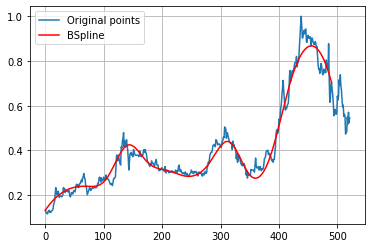

In [ ]:
import scipy.interpolate as interpolate

t_TBLA_15, c_TBLA_15, k_TBLA_15 = interpolate.splrep(TBLA_x15, TBLA_y15, s=0, k=3)
print('''\
t_TBLA_15: {}
c_TBLA_15: {}
k_TBLA_15: {}
'''.format(t_TBLA_15, c_TBLA_15, k_TBLA_15))
N = 522
xmin_TBLA_15, xmax_TBLA_15 = TBLA_x15.min(), TBLA_x15.max()
xx_TBLA_15 = np.linspace(xmin_TBLA_15, xmax_TBLA_15, N)
spline_TBLA_15 = interpolate.BSpline(t_TBLA_15, c_TBLA_15, k_TBLA_15, extrapolate=False)

plt.plot(TBLA_x, TBLA_y, label='Original points')
plt.plot(xx_TBLA_15, spline_TBLA_15(xx_TBLA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA TBLA**

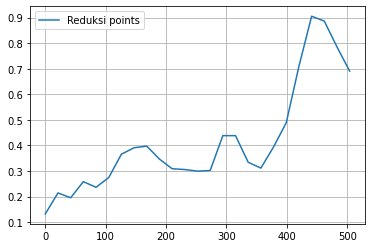

In [ ]:
TBLA_x25 = TBLA_x[0:522:21]
TBLA_y25 = TBLA_y[0:522:21]

plt.plot(TBLA_x25, TBLA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TBLA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_TBLA_25: [0.13249211 0.28776814 0.11847004 0.29337802 0.21634138 0.26081484
 0.38708697 0.38642087 0.41423271 0.34150635 0.30176084 0.30633988
 0.30884177 0.25640029 0.47880627 0.45928946 0.31495072 0.28721682
 0.40621353 0.45385966 0.71210177 0.95640833 0.87378596 0.73976317
 0.69085173 0.         0.         0.         0.        ]
k_TBLA_25: 3



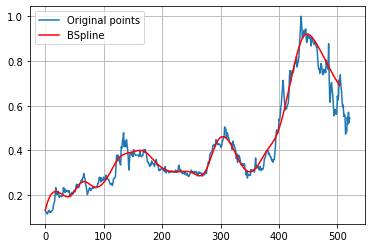

In [ ]:
import scipy.interpolate as interpolate

t_TBLA_25, c_TBLA_25, k_TBLA_25 = interpolate.splrep(TBLA_x25, TBLA_y25, s=0, k=3)
print('''\
t_TBLA_25: {}
c_TBLA_25: {}
k_TBLA_25: {}
'''.format(t_TBLA_25, c_TBLA_25, k_TBLA_25))
N = 522
xmin_TBLA_25, xmax_TBLA_25 = TBLA_x25.min(), TBLA_x25.max()
xx_TBLA_25 = np.linspace(xmin_TBLA_25, xmax_TBLA_25, N)
spline_TBLA_25 = interpolate.BSpline(t_TBLA_25, c_TBLA_25, k_TBLA_25, extrapolate=False)

plt.plot(TBLA_x, TBLA_y, label='Original points')
plt.plot(xx_TBLA_25, spline_TBLA_25(xx_TBLA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA TBLA**

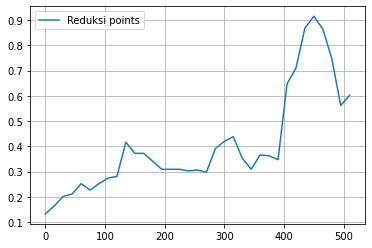

In [ ]:
TBLA_x35 = TBLA_x[0:522:15]
TBLA_y35 = TBLA_y[0:522:15]

plt.plot(TBLA_x35, TBLA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TBLA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_TBLA_35: [0.13249211 0.13445861 0.22004177 0.19412242 0.2780872  0.20772436
 0.25379138 0.29130571 0.22767348 0.48254296 0.34057739 0.38858598
 0.3385172  0.30150928 0.31033528 0.31203918 0.2963976  0.31940513
 0.26194402 0.41956959 0.40678077 0.47065748 0.34150414 0.28319978
 0.38058633 0.39003851 0.23591578 0.74831729 0.65094126 0.90659277
 0.92773498 0.8714263  0.73976417 0.41560687 0.60252366 0.
 0.         0.         0.        ]
k_TBLA_35: 3



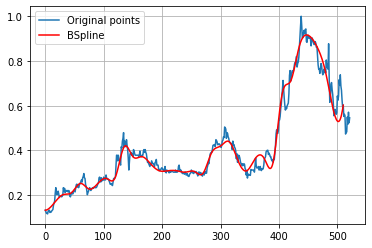

In [ ]:
import scipy.interpolate as interpolate

t_TBLA_35, c_TBLA_35, k_TBLA_35 = interpolate.splrep(TBLA_x35, TBLA_y35, s=0, k=3)
print('''\
t_TBLA_35: {}
c_TBLA_35: {}
k_TBLA_35: {}
'''.format(t_TBLA_35, c_TBLA_35, k_TBLA_35))
N = 522
xmin_TBLA_35, xmax_TBLA_35 = TBLA_x35.min(), TBLA_x35.max()
xx_TBLA_35 = np.linspace(xmin_TBLA_35, xmax_TBLA_35, N)
spline_TBLA_35 = interpolate.BSpline(t_TBLA_35, c_TBLA_35, k_TBLA_35, extrapolate=False)

plt.plot(TBLA_x, TBLA_y, label='Original points')
plt.plot(xx_TBLA_35, spline_TBLA_35(xx_TBLA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA TBLA**

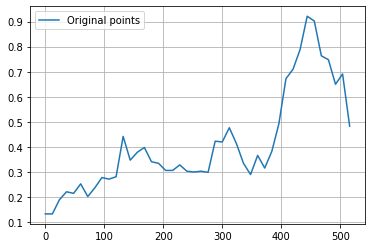

In [ ]:
TBLA_x45 = TBLA_x[0:522:12]
TBLA_y45 = TBLA_y[0:522:12]

plt.plot(TBLA_x45, TBLA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TBLA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_TBLA_45: [0.13249211 0.09406197 0.18096124 0.23486729 0.19101422 0.28814207
 0.17061307 0.24076212 0.28589679 0.28126584 0.21680009 0.53607639
 0.28873664 0.39099597 0.41857285 0.31957069 0.34730845 0.29750468
 0.29863499 0.34391749 0.29414929 0.29652004 0.31787782 0.24900337
 0.47664497 0.38069435 0.5179278  0.40563863 0.33901294 0.24461874
 0.42005151 0.27075881 0.38965772 0.46083115 0.71969909 0.69191822
 0.77130309 0.95473061 0.93658837 0.71216515 0.79519269 0.52542709
 0.8358669  0.48264984 0.         0.         0.         0.        ]
k_TBLA_45: 3



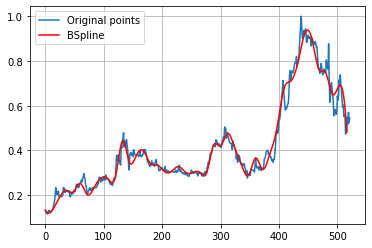

In [ ]:
import scipy.interpolate as interpolate

t_TBLA_45, c_TBLA_45, k_TBLA_45 = interpolate.splrep(TBLA_x45, TBLA_y45, s=0, k=3)
print('''\
t_TBLA_45: {}
c_TBLA_45: {}
k_TBLA_45: {}
'''.format(t_TBLA_45, c_TBLA_45, k_TBLA_45))
N = 522
xmin_TBLA_45, xmax_TBLA_45 = TBLA_x45.min(), TBLA_x45.max()
xx_TBLA_45 = np.linspace(xmin_TBLA_45, xmax_TBLA_45, N)
spline_TBLA_45 = interpolate.BSpline(t_TBLA_45, c_TBLA_45, k_TBLA_45, extrapolate=False)

plt.plot(TBLA_x, TBLA_y, label='Original points')
plt.plot(xx_TBLA_45, spline_TBLA_45(xx_TBLA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA TBLA**

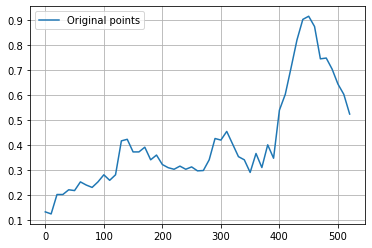

In [ ]:
TBLA_x55 = TBLA_x[0:522:10]
TBLA_y55 = TBLA_y[0:522:10]

plt.plot(TBLA_x55, TBLA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TBLA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_TBLA_55: [0.13249211 0.04379745 0.24237356 0.18712315 0.2343029  0.20058638
 0.26934526 0.23622817 0.22422786 0.24856387 0.29571226 0.25312966
 0.24381956 0.45613469 0.43006439 0.35988536 0.36383266 0.41822249
 0.31028053 0.38481942 0.3081705  0.31309797 0.29432721 0.32662789
 0.29190571 0.32278397 0.29077543 0.29329411 0.3227989  0.45967431
 0.39370889 0.48284028 0.40048202 0.33794455 0.36761358 0.23576518
 0.43065062 0.23721592 0.47916076 0.24992653 0.60315205 0.57405832
 0.71575661 0.82159033 0.91901773 0.91558797 0.90758938 0.69695672
 0.77146073 0.7030048  0.61545211 0.60552315 0.52365931 0.
 0.         0.         0.        ]
k_TBLA_55: 3



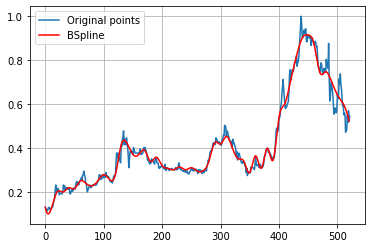

In [ ]:
import scipy.interpolate as interpolate

t_TBLA_55, c_TBLA_55, k_TBLA_55 = interpolate.splrep(TBLA_x55, TBLA_y55, s=0, k=3)
print('''\
t_TBLA_55: {}
c_TBLA_55: {}
k_TBLA_55: {}
'''.format(t_TBLA_55, c_TBLA_55, k_TBLA_55))
N = 522
xmin_TBLA_55, xmax_TBLA_55 = TBLA_x55.min(), TBLA_x55.max()
xx_TBLA_55 = np.linspace(xmin_TBLA_55, xmax_TBLA_55, N)
spline_TBLA_55 = interpolate.BSpline(t_TBLA_55, c_TBLA_55, k_TBLA_55, extrapolate=False)

plt.plot(TBLA_x, TBLA_y, label='Original points')
plt.plot(xx_TBLA_55, spline_TBLA_55(xx_TBLA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA TBLA**

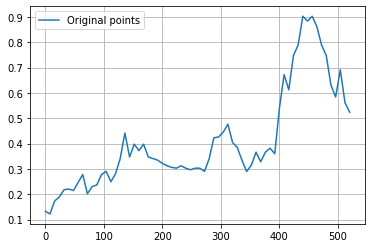

In [ ]:
TBLA_x65 = TBLA_x[0:522:8]
TBLA_y65 = TBLA_y[0:522:8]

plt.plot(TBLA_x65, TBLA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TBLA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_TBLA_65: [0.13249211 0.07375771 0.18907765 0.18078942 0.22548343 0.22327056
 0.20635548 0.23837376 0.31649018 0.16128065 0.24974368 0.2214481
 0.28402228 0.30807792 0.22499094 0.28722644 0.31064588 0.51435408
 0.28178006 0.4405446  0.34089958 0.42929557 0.32677619 0.34561859
 0.3349135  0.32103657 0.3115396  0.30662206 0.29793431 0.31867542
 0.30118106 0.29363505 0.30345856 0.3095654  0.27531453 0.3305014
 0.44684391 0.41840057 0.43475885 0.51133373 0.37795039 0.39957763
 0.33288734 0.27518214 0.30392353 0.39808272 0.29932918 0.37305483
 0.40403511 0.30102555 0.54959138 0.73720198 0.53314645 0.80213652
 0.74411188 0.9532771

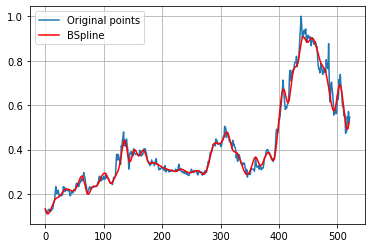

In [ ]:
import scipy.interpolate as interpolate

t_TBLA_65, c_TBLA_65, k_TBLA_65 = interpolate.splrep(TBLA_x65, TBLA_y65, s=0, k=3)
print('''\
t_TBLA_65: {}
c_TBLA_65: {}
k_TBLA_65: {}
'''.format(t_TBLA_65, c_TBLA_65, k_TBLA_65))
N = 522
xmin_TBLA_65, xmax_TBLA_65 = TBLA_x65.min(), TBLA_x65.max()
xx_TBLA_65 = np.linspace(xmin_TBLA_65, xmax_TBLA_65, N)
spline_TBLA_65 = interpolate.BSpline(t_TBLA_65, c_TBLA_65, k_TBLA_65, extrapolate=False)

plt.plot(TBLA_x, TBLA_y, label='Original points')
plt.plot(xx_TBLA_65, spline_TBLA_65(xx_TBLA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE TBLA**

In [ ]:

#RMSE 15 DATA TBLA
y_true_TBLA_15 = TBLA_y.tolist()
y_pred_TBLA_15 = spline_TBLA_15(xx_TBLA_15).tolist()
mse_TBLA_15 = mean_squared_error(y_true_TBLA_15, y_pred_TBLA_15)
rmse_TBLA_15 = np.sqrt(mse_TBLA_15)
print("rmse TBLA 15 =",rmse_TBLA_15)

#RMSE 25 DATA TBLA
y_true_TBLA_25 = TBLA_y.tolist()
y_pred_TBLA_25 = spline_TBLA_25(xx_TBLA_25).tolist()
mse_TBLA_25 = mean_squared_error(y_true_TBLA_25, y_pred_TBLA_25)
rmse_TBLA_25 = np.sqrt(mse_TBLA_25)
print("rmse TBLA 25 =",rmse_TBLA_25)

#RMSE 35 DATA TBLA
y_true_TBLA_35 = TBLA_y.tolist()
y_pred_TBLA_35 = spline_TBLA_35(xx_TBLA_35).tolist()
mse_TBLA_35 = mean_squared_error(y_true_TBLA_35, y_pred_TBLA_35)
rmse_TBLA_35 = np.sqrt(mse_TBLA_35)
print("rmse TBLA 35 =",rmse_TBLA_35)

#RMSE 45 DATA TBLA
y_true_TBLA_45 = TBLA_y.tolist()
y_pred_TBLA_45 = spline_TBLA_45(xx_TBLA_45).tolist()
mse_TBLA_45 = mean_squared_error(y_true_TBLA_45, y_pred_TBLA_45)
rmse_TBLA_45 = np.sqrt(mse_TBLA_45)
print("rmse TBLA 45 =",rmse_TBLA_45)

#RMSE 55 DATA TBLA
y_true_TBLA_55 = TBLA_y.tolist()
y_pred_TBLA_55 = spline_TBLA_55(xx_TBLA_55).tolist()
mse_TBLA_55 = mean_squared_error(y_true_TBLA_55, y_pred_TBLA_55)
rmse_TBLA_55 = np.sqrt(mse_TBLA_55)
print("rmse TBLA 55 =",rmse_TBLA_55)

#RMSE 65 DATA TBLA
y_true_TBLA_65 = TBLA_y.tolist()
y_pred_TBLA_65 = spline_TBLA_65(xx_TBLA_65).tolist()
mse_TBLA_65 = mean_squared_error(y_true_TBLA_65, y_pred_TBLA_65)
rmse_TBLA_65 = np.sqrt(mse_TBLA_65)
print("rmse TBLA 65 =",rmse_TBLA_65)

rmse TBLA 15 = 0.10982973145768107
rmse TBLA 25 = 0.07564572125903392
rmse TBLA 35 = 0.05118713181599232
rmse TBLA 45 = 0.03921220507050474
rmse TBLA 55 = 0.02853891370668811
rmse TBLA 65 = 0.027218798641612467


# **TINS**

No handles with labels found to put in legend.


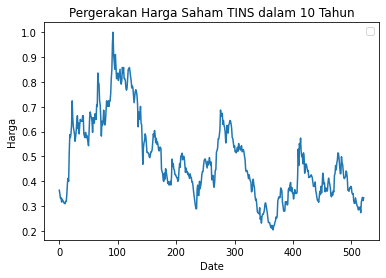

In [ ]:
TINS = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/TINS.JK.csv')

TINS_x = TINS['No'].values
TINS_y = TINS['Skala'].values

plt.plot(TINS_x,TINS_y)
plt.title('Pergerakan Harga Saham TINS dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA TINS**

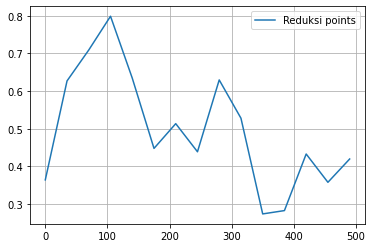

In [ ]:
TINS_x15 = TINS_x[0:522:35]
TINS_y15 = TINS_y[0:522:35]

plt.plot(TINS_x15, TINS_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TINS_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_TINS_15: [0.36417916 0.67461477 0.62166577 0.86588661 0.64477406 0.36097591
 0.5978782  0.32812152 0.72247168 0.55874358 0.20972482 0.24557548
 0.59040636 0.20725942 0.41963909 0.         0.         0.
 0.        ]
k_TINS_15: 3



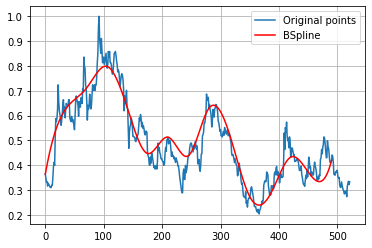

In [ ]:
import scipy.interpolate as interpolate

t_TINS_15, c_TINS_15, k_TINS_15 = interpolate.splrep(TINS_x15, TINS_y15, s=0, k=3)
print('''\
t_TINS_15: {}
c_TINS_15: {}
k_TINS_15: {}
'''.format(t_TINS_15, c_TINS_15, k_TINS_15))
N = 522
xmin_TINS_15, xmax_TINS_15 = TINS_x15.min(), TINS_x15.max()
xx_TINS_15 = np.linspace(xmin_TINS_15, xmax_TINS_15, N)
spline_TINS_15 = interpolate.BSpline(t_TINS_15, c_TINS_15, k_TINS_15, extrapolate=False)

plt.plot(TINS_x, TINS_y, label='Original points')
plt.plot(xx_TINS_15, spline_TINS_15(xx_TINS_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA TINS**

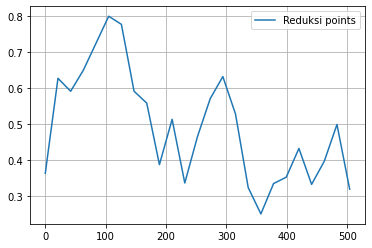

In [ ]:
TINS_x25 = TINS_x[0:522:21]
TINS_y25 = TINS_y[0:522:21]

plt.plot(TINS_x25, TINS_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TINS_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_TINS_25: [0.36417916 0.75519413 0.5194619  0.65563744 0.71945872 0.8098188
 0.83230755 0.51767279 0.64327858 0.25846279 0.65122843 0.21723373
 0.50371717 0.56192526 0.66947078 0.5501952  0.29691924 0.21013668
 0.37323478 0.31119186 0.50227953 0.27703516 0.42844923 0.60462377
 0.32025089 0.         0.         0.         0.        ]
k_TINS_25: 3



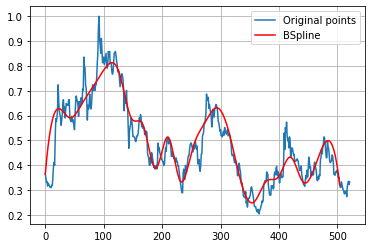

In [ ]:
import scipy.interpolate as interpolate

t_TINS_25, c_TINS_25, k_TINS_25 = interpolate.splrep(TINS_x25, TINS_y25, s=0, k=3)
print('''\
t_TINS_25: {}
c_TINS_25: {}
k_TINS_25: {}
'''.format(t_TINS_25, c_TINS_25, k_TINS_25))
N = 522
xmin_TINS_25, xmax_TINS_25 = TINS_x25.min(), TINS_x25.max()
xx_TINS_25 = np.linspace(xmin_TINS_25, xmax_TINS_25, N)
spline_TINS_25 = interpolate.BSpline(t_TINS_25, c_TINS_25, k_TINS_25, extrapolate=False)

plt.plot(TINS_x, TINS_y, label='Original points')
plt.plot(xx_TINS_25, spline_TINS_25(xx_TINS_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA TINS**

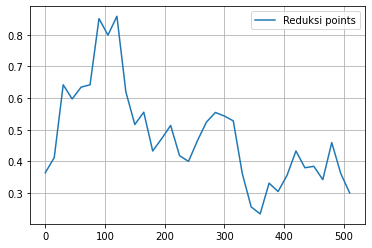

In [ ]:
TINS_x35 = TINS_x[0:522:15]
TINS_y35 = TINS_y[0:522:15]

plt.plot(TINS_x35, TINS_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TINS_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_TINS_35: [0.36417916 0.17531314 0.79414935 0.54335493 0.67721314 0.55375129
 0.95853147 0.71659497 0.96613012 0.56814772 0.47770879 0.61951723
 0.37555578 0.47527606 0.55320046 0.39253236 0.38413375 0.47093246
 0.52616407 0.56770241 0.52921826 0.57535772 0.3365217  0.25184426
 0.1933055  0.37962038 0.27597708 0.34521429 0.47669927 0.34533376
 0.42126855 0.27539843 0.61641476 0.22628031 0.30037325 0.
 0.         0.         0.        ]
k_TINS_35: 3



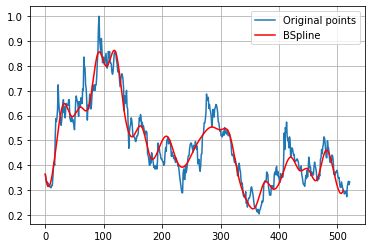

In [ ]:
import scipy.interpolate as interpolate

t_TINS_35, c_TINS_35, k_TINS_35 = interpolate.splrep(TINS_x35, TINS_y35, s=0, k=3)
print('''\
t_TINS_35: {}
c_TINS_35: {}
k_TINS_35: {}
'''.format(t_TINS_35, c_TINS_35, k_TINS_35))
N = 522
xmin_TINS_35, xmax_TINS_35 = TINS_x35.min(), TINS_x35.max()
xx_TINS_35 = np.linspace(xmin_TINS_35, xmax_TINS_35, N)
spline_TINS_35 = interpolate.BSpline(t_TINS_35, c_TINS_35, k_TINS_35, extrapolate=False)

plt.plot(TINS_x, TINS_y, label='Original points')
plt.plot(xx_TINS_35, spline_TINS_35(xx_TINS_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA TINS**

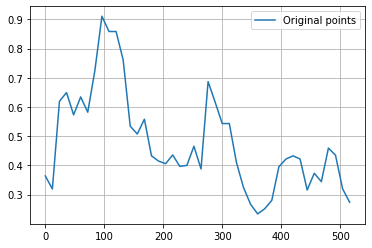

In [ ]:
TINS_x45 = TINS_x[0:522:12]
TINS_y45 = TINS_y[0:522:12]

plt.plot(TINS_x45, TINS_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TINS_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_TINS_45: [0.36417916 0.04048599 0.70484881 0.66997155 0.51949859 0.69083949
 0.52310221 0.70927976 0.98306987 0.8211349  0.88165369 0.8015135
 0.47945863 0.48662402 0.61882271 0.38733502 0.42885361 0.38680313
 0.45975602 0.38910026 0.36593444 0.54716183 0.2394459  0.82341273
 0.58820077 0.52102543 0.58763065 0.38838514 0.32365631 0.26499844
 0.21981296 0.26043634 0.24914239 0.42596773 0.41905186 0.42891112
 0.46264875 0.25158017 0.42603235 0.28383799 0.50589039 0.42999215
 0.2482634  0.27386972 0.         0.         0.         0.        ]
k_TINS_45: 3



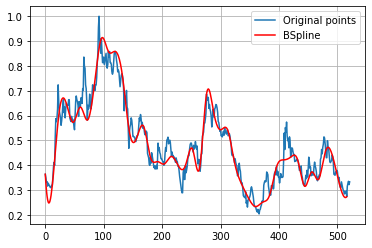

In [ ]:
import scipy.interpolate as interpolate

t_TINS_45, c_TINS_45, k_TINS_45 = interpolate.splrep(TINS_x45, TINS_y45, s=0, k=3)
print('''\
t_TINS_45: {}
c_TINS_45: {}
k_TINS_45: {}
'''.format(t_TINS_45, c_TINS_45, k_TINS_45))
N = 522
xmin_TINS_45, xmax_TINS_45 = TINS_x45.min(), TINS_x45.max()
xx_TINS_45 = np.linspace(xmin_TINS_45, xmax_TINS_45, N)
spline_TINS_45 = interpolate.BSpline(t_TINS_45, c_TINS_45, k_TINS_45, extrapolate=False)

plt.plot(TINS_x, TINS_y, label='Original points')
plt.plot(xx_TINS_45, spline_TINS_45(xx_TINS_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA TINS**

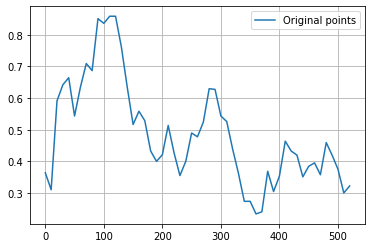

In [ ]:
TINS_x55 = TINS_x[0:522:10]
TINS_y55 = TINS_y[0:522:10]

plt.plot(TINS_x55, TINS_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TINS_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_TINS_55: [0.36417916 0.03822505 0.68772792 0.61418377 0.72467281 0.47219442
 0.64624422 0.74878745 0.6123416  0.9212621  0.80708215 0.86532628
 0.88087591 0.76043325 0.6445574  0.46729591 0.58475908 0.54291765
 0.41370952 0.39926069 0.38924755 0.56912382 0.41486741 0.33260082
 0.38607366 0.5231044  0.4588146  0.50730393 0.65526081 0.64840466
 0.51462063 0.55304599 0.4271145  0.3755964  0.24378866 0.29246731
 0.22956045 0.19397753 0.43897134 0.26318118 0.33704695 0.50891276
 0.41017179 0.44774518 0.31668202 0.39255671 0.41889753 0.30391834
 0.51221434 0.40359054 0.3871472  0.23269137 0.32245951 0.
 0.         0.         0.        ]
k_TINS_55: 3



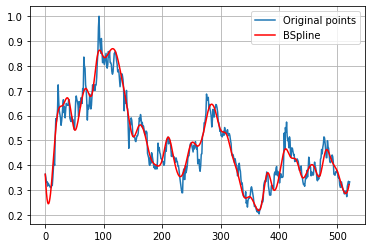

In [ ]:
import scipy.interpolate as interpolate

t_TINS_55, c_TINS_55, k_TINS_55 = interpolate.splrep(TINS_x55, TINS_y55, s=0, k=3)
print('''\
t_TINS_55: {}
c_TINS_55: {}
k_TINS_55: {}
'''.format(t_TINS_55, c_TINS_55, k_TINS_55))
N = 522
xmin_TINS_55, xmax_TINS_55 = TINS_x55.min(), TINS_x55.max()
xx_TINS_55 = np.linspace(xmin_TINS_55, xmax_TINS_55, N)
spline_TINS_55 = interpolate.BSpline(t_TINS_55, c_TINS_55, k_TINS_55, extrapolate=False)

plt.plot(TINS_x, TINS_y, label='Original points')
plt.plot(xx_TINS_55, spline_TINS_55(xx_TINS_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA TINS**

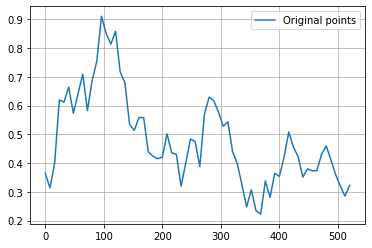

In [ ]:
TINS_x65 = TINS_x[0:522:8]
TINS_y65 = TINS_y[0:522:8]

plt.plot(TINS_x65, TINS_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TINS_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_TINS_65: [0.36417916 0.31783977 0.23596231 0.70078281 0.56113111 0.72633151
 0.51861231 0.63802466 0.78003883 0.49555567 0.7302666  0.70279389
 0.98095965 0.83606166 0.77926586 0.92747187 0.66010984 0.7305889
 0.4921595  0.50674514 0.56147019 0.59662401 0.40128368 0.43107724
 0.41769056 0.3877131  0.55683178 0.39390474 0.48247677 0.25529355
 0.41276831 0.49363303 0.51419911 0.29732087 0.62487557 0.63302406
 0.61978004 0.58509705 0.49854133 0.58790847 0.40975796 0.41016009
 0.33491861 0.1981743  0.35658141 0.21749482 0.17812594 0.40842924
 0.2156765  0.41183839 0.32351046 0.41440149 0.5499699  0.43362391
 0.4453972  0.315873

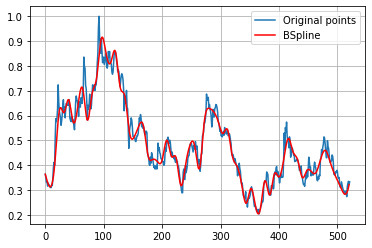

In [ ]:
import scipy.interpolate as interpolate

t_TINS_65, c_TINS_65, k_TINS_65 = interpolate.splrep(TINS_x65, TINS_y65, s=0, k=3)
print('''\
t_TINS_65: {}
c_TINS_65: {}
k_TINS_65: {}
'''.format(t_TINS_65, c_TINS_65, k_TINS_65))
N = 522
xmin_TINS_65, xmax_TINS_65 = TINS_x65.min(), TINS_x65.max()
xx_TINS_65 = np.linspace(xmin_TINS_65, xmax_TINS_65, N)
spline_TINS_65 = interpolate.BSpline(t_TINS_65, c_TINS_65, k_TINS_65, extrapolate=False)

plt.plot(TINS_x, TINS_y, label='Original points')
plt.plot(xx_TINS_65, spline_TINS_65(xx_TINS_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE TINS**

In [ ]:

#RMSE 15 DATA TINS
y_true_TINS_15 = TINS_y.tolist()
y_pred_TINS_15 = spline_TINS_15(xx_TINS_15).tolist()
mse_TINS_15 = mean_squared_error(y_true_TINS_15, y_pred_TINS_15)
rmse_TINS_15 = np.sqrt(mse_TINS_15)
print("rmse TINS 15 =",rmse_TINS_15)

#RMSE 25 DATA TINS
y_true_TINS_25 = TINS_y.tolist()
y_pred_TINS_25 = spline_TINS_25(xx_TINS_25).tolist()
mse_TINS_25 = mean_squared_error(y_true_TINS_25, y_pred_TINS_25)
rmse_TINS_25 = np.sqrt(mse_TINS_25)
print("rmse TINS 25 =",rmse_TINS_25)

#RMSE 35 DATA TINS
y_true_TINS_35 = TINS_y.tolist()
y_pred_TINS_35 = spline_TINS_35(xx_TINS_35).tolist()
mse_TINS_35 = mean_squared_error(y_true_TINS_35, y_pred_TINS_35)
rmse_TINS_35 = np.sqrt(mse_TINS_35)
print("rmse TINS 35 =",rmse_TINS_35)

#RMSE 45 DATA TINS
y_true_TINS_45 = TINS_y.tolist()
y_pred_TINS_45 = spline_TINS_45(xx_TINS_45).tolist()
mse_TINS_45 = mean_squared_error(y_true_TINS_45, y_pred_TINS_45)
rmse_TINS_45 = np.sqrt(mse_TINS_45)
print("rmse TINS 45 =",rmse_TINS_45)

#RMSE 55 DATA TINS
y_true_TINS_55 = TINS_y.tolist()
y_pred_TINS_55 = spline_TINS_55(xx_TINS_55).tolist()
mse_TINS_55 = mean_squared_error(y_true_TINS_55, y_pred_TINS_55)
rmse_TINS_55 = np.sqrt(mse_TINS_55)
print("rmse TINS 55 =",rmse_TINS_55)

#RMSE 65 DATA TINS
y_true_TINS_65 = TINS_y.tolist()
y_pred_TINS_65 = spline_TINS_65(xx_TINS_65).tolist()
mse_TINS_65 = mean_squared_error(y_true_TINS_65, y_pred_TINS_65)
rmse_TINS_65 = np.sqrt(mse_TINS_65)
print("rmse TINS 65 =",rmse_TINS_65)

rmse TINS 15 = 0.09225904485890711
rmse TINS 25 = 0.07925542024028531
rmse TINS 35 = 0.05716215142820912
rmse TINS 45 = 0.051772840273800295
rmse TINS 55 = 0.03940881732905736
rmse TINS 65 = 0.03533502357554047


# **TKIM**

No handles with labels found to put in legend.


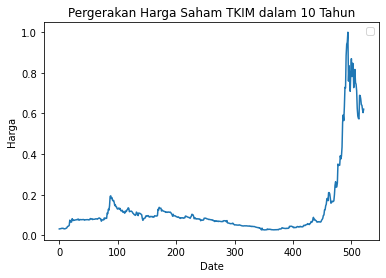

In [ ]:
TKIM = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/TKIM.JK.csv')

TKIM_x = TKIM['No'].values
TKIM_y = TKIM['Skala'].values

plt.plot(TKIM_x,TKIM_y)
plt.title('Pergerakan Harga Saham TKIM dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()


**1. PERCOBAAN 15 DATA TKIM**

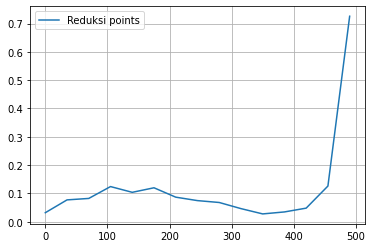

In [ ]:
TKIM_x15 = TKIM_x[0:522:35]
TKIM_y15 = TKIM_y[0:522:35]

plt.plot(TKIM_x15, TKIM_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_TKIM_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_TKIM_15: [0.0316513  0.10701095 0.03704978 0.1489476  0.08342033 0.13970622
 0.07632487 0.07467317 0.07152341 0.0459946  0.02142128 0.03279582
 0.06084008 0.02790164 0.72587413 0.         0.         0.
 0.        ]
k_TKIM_15: 3



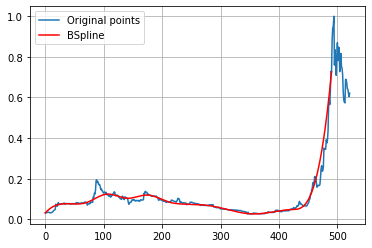

In [ ]:
import scipy.interpolate as interpolate

t_TKIM_15, c_TKIM_15, k_TKIM_15 = interpolate.splrep(TKIM_x15, TKIM_y15, s=0, k=3)
print('''\
t_TKIM_15: {}
c_TKIM_15: {}
k_TKIM_15: {}
'''.format(t_TKIM_15, c_TKIM_15, k_TKIM_15))
N = 522
xmin_TKIM_15, xmax_TKIM_15 = TKIM_x15.min(), TKIM_x15.max()
xx_TKIM_15 = np.linspace(xmin_TKIM_15, xmax_TKIM_15, N)
spline_TKIM_15 = interpolate.BSpline(t_TKIM_15, c_TKIM_15, k_TKIM_15, extrapolate=False)

plt.plot(TKIM_x, TKIM_y, label='Original points')
plt.plot(xx_TKIM_15, spline_TKIM_15(xx_TKIM_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA TKIM**

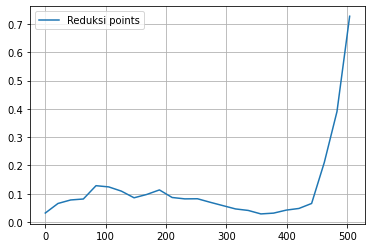

In [ ]:
TKIM_x25 = TKIM_x[0:522:21]
TKIM_y25 = TKIM_y[0:522:21]

plt.plot(TKIM_x25, TKIM_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TKIM_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_TKIM_25: [0.0316513  0.05867313 0.08967006 0.0645273  0.14610924 0.12093221
 0.11439688 0.07589144 0.0953017  0.12673952 0.07781633 0.08167403
 0.08565483 0.06844174 0.05888981 0.04341161 0.04438684 0.02407599
 0.030498   0.04190402 0.05363419 0.03055225 0.27899469 0.40651664
 0.72727273 0.         0.         0.         0.        ]
k_TKIM_25: 3



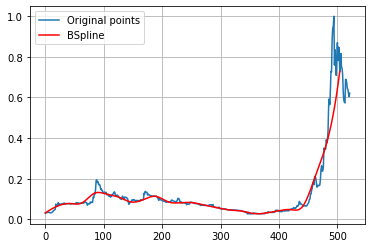

In [ ]:
import scipy.interpolate as interpolate

t_TKIM_25, c_TKIM_25, k_TKIM_25 = interpolate.splrep(TKIM_x25, TKIM_y25, s=0, k=3)
print('''\
t_TKIM_25: {}
c_TKIM_25: {}
k_TKIM_25: {}
'''.format(t_TKIM_25, c_TKIM_25, k_TKIM_25))
N = 522
xmin_TKIM_25, xmax_TKIM_25 = TKIM_x25.min(), TKIM_x25.max()
xx_TKIM_25 = np.linspace(xmin_TKIM_25, xmax_TKIM_25, N)
spline_TKIM_25 = interpolate.BSpline(t_TKIM_25, c_TKIM_25, k_TKIM_25, extrapolate=False)

plt.plot(TKIM_x, TKIM_y, label='Original points')
plt.plot(xx_TKIM_25, spline_TKIM_25(xx_TKIM_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA TKIM**

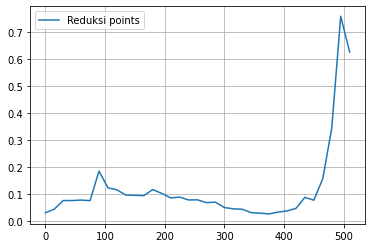

In [ ]:
TKIM_x35 = TKIM_x[0:522:15]
TKIM_y35 = TKIM_y[0:522:15]

plt.plot(TKIM_x35, TKIM_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TKIM_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_TKIM_35: [0.0316513  0.01607938 0.0931634  0.07033681 0.09313387 0.02933023
 0.24891864 0.09134432 0.12993904 0.08822255 0.10100849 0.08516668
 0.12933008 0.10325062 0.08000254 0.09641807 0.07325443 0.08533457
 0.06274212 0.07944069 0.04550352 0.04567811 0.04870711 0.02802492
 0.03220019 0.02443306 0.03487874 0.04080721 0.03350082 0.11218251
 0.0497971  0.15855916 0.3016754  1.12503642 0.62657343 0.
 0.         0.         0.        ]
k_TKIM_35: 3



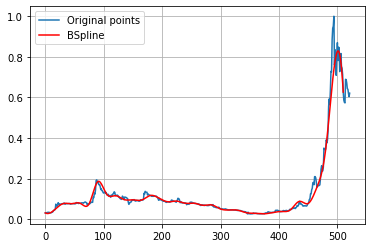

In [ ]:
import scipy.interpolate as interpolate

t_TKIM_35, c_TKIM_35, k_TKIM_35 = interpolate.splrep(TKIM_x35, TKIM_y35, s=0, k=3)
print('''\
t_TKIM_35: {}
c_TKIM_35: {}
k_TKIM_35: {}
'''.format(t_TKIM_35, c_TKIM_35, k_TKIM_35))
N = 522
xmin_TKIM_35, xmax_TKIM_35 = TKIM_x35.min(), TKIM_x35.max()
xx_TKIM_35 = np.linspace(xmin_TKIM_35, xmax_TKIM_35, N)
spline_TKIM_35 = interpolate.BSpline(t_TKIM_35, c_TKIM_35, k_TKIM_35, extrapolate=False)

plt.plot(TKIM_x, TKIM_y, label='Original points')
plt.plot(xx_TKIM_35, spline_TKIM_35(xx_TKIM_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA TKIM**

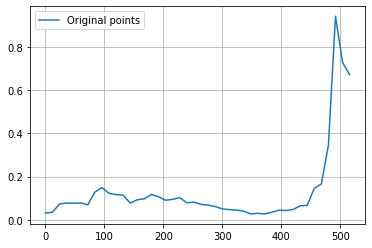

In [ ]:
TKIM_x45 = TKIM_x[0:522:12]
TKIM_y45 = TKIM_y[0:522:12]

plt.plot(TKIM_x45, TKIM_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TKIM_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_TKIM_45: [3.16513020e-02 1.51048939e-03 8.48755602e-02 7.74576565e-02
 7.42184937e-02 8.76062507e-02 4.75590294e-02 1.40469232e-01
 1.60460512e-01 1.15902963e-01 1.13744727e-01 1.28441174e-01
 5.89812192e-02 1.02704153e-01 8.83784000e-02 1.27619999e-01
 1.06879233e-01 8.64451698e-02 9.26838799e-02 1.13824623e-01
 6.79348498e-02 8.92063423e-02 6.79748651e-02 7.00348773e-02
 6.24971016e-02 4.92074881e-02 4.78058119e-02 4.48839522e-02
 4.45464894e-02 2.19650561e-02 3.37471340e-02 2.43051478e-02
 3.48504589e-02 4.77615465e-02 4.26348249e-02 4.18390119e-02
 7.70021357e-02 3.95230754e-02 1.67702765e-01 1.62393136e-01
 1.79647766e-01 1.52910817e+00 2.86844515e-01 6.71328671e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00]


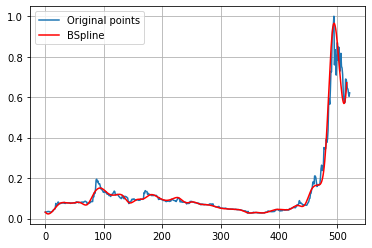

In [ ]:
import scipy.interpolate as interpolate

t_TKIM_45, c_TKIM_45, k_TKIM_45 = interpolate.splrep(TKIM_x45, TKIM_y45, s=0, k=3)
print('''\
t_TKIM_45: {}
c_TKIM_45: {}
k_TKIM_45: {}
'''.format(t_TKIM_45, c_TKIM_45, k_TKIM_45))
N = 522
xmin_TKIM_45, xmax_TKIM_45 = TKIM_x45.min(), TKIM_x45.max()
xx_TKIM_45 = np.linspace(xmin_TKIM_45, xmax_TKIM_45, N)
spline_TKIM_45 = interpolate.BSpline(t_TKIM_45, c_TKIM_45, k_TKIM_45, extrapolate=False)

plt.plot(TKIM_x, TKIM_y, label='Original points')
plt.plot(xx_TKIM_45, spline_TKIM_45(xx_TKIM_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA TKIM**

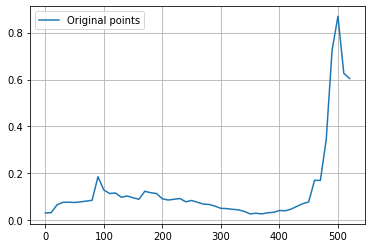

In [ ]:
TKIM_x55 = TKIM_x[0:522:10]
TKIM_y55 = TKIM_y[0:522:10]

plt.plot(TKIM_x55, TKIM_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TKIM_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_TKIM_55: [0.0316513  0.00525392 0.07075892 0.07792444 0.07768984 0.07582193
 0.07582805 0.09306842 0.04463338 0.2416624  0.10506611 0.11438756
 0.1238743  0.08943828 0.10862823 0.09838393 0.07525928 0.13950822
 0.11094278 0.12245829 0.08571472 0.08644118 0.08819944 0.09969032
 0.07121553 0.09021794 0.07604478 0.06754083 0.06953568 0.06107789
 0.04867023 0.05137405 0.04625314 0.04557145 0.03999255 0.02271011
 0.03364255 0.02397843 0.03491924 0.03102993 0.0457163  0.03785312
 0.0479062  0.05751509 0.08119427 0.04400152 0.21272972 0.12885581
 0.2922666  0.77480505 1.02674224 0.37124426 0.6041958  0.
 0.         0.         0.        ]
k_TKIM_55: 3



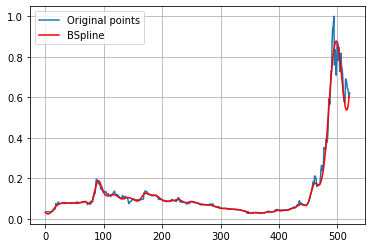

In [ ]:
import scipy.interpolate as interpolate

t_TKIM_55, c_TKIM_55, k_TKIM_55 = interpolate.splrep(TKIM_x55, TKIM_y55, s=0, k=3)
print('''\
t_TKIM_55: {}
c_TKIM_55: {}
k_TKIM_55: {}
'''.format(t_TKIM_55, c_TKIM_55, k_TKIM_55))
N = 522
xmin_TKIM_55, xmax_TKIM_55 = TKIM_x55.min(), TKIM_x55.max()
xx_TKIM_55 = np.linspace(xmin_TKIM_55, xmax_TKIM_55, N)
spline_TKIM_55 = interpolate.BSpline(t_TKIM_55, c_TKIM_55, k_TKIM_55, extrapolate=False)

plt.plot(TKIM_x, TKIM_y, label='Original points')
plt.plot(xx_TKIM_55, spline_TKIM_55(xx_TKIM_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA TKIM**

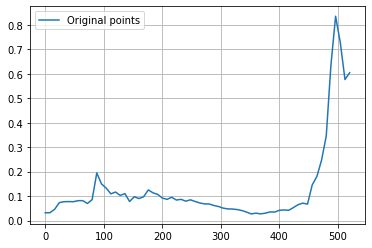

In [ ]:
TKIM_x65 = TKIM_x[0:522:8]
TKIM_y65 = TKIM_y[0:522:8]

plt.plot(TKIM_x65, TKIM_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TKIM_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_TKIM_65: [0.0316513  0.03024055 0.02891253 0.08031381 0.07582275 0.07833306
 0.07535071 0.08220197 0.08344421 0.07162399 0.04837142 0.24815466
 0.12668882 0.14330432 0.09565535 0.12848547 0.08972583 0.12852843
 0.05698953 0.11058367 0.08451356 0.09029135 0.13815881 0.10772296
 0.11102544 0.08975736 0.08170345 0.1031077  0.07687107 0.09240775
 0.07317679 0.08965545 0.07633346 0.0720809  0.0664836  0.07003168
 0.06015108 0.05859476 0.0495258  0.04707825 0.04747587 0.04497629
 0.04115044 0.03545693 0.02345542 0.03318292 0.02507164 0.0296634
 0.03753351 0.0316711  0.04389399 0.04450121 0.03824102 0.05428294
 0.06350832 0.081054

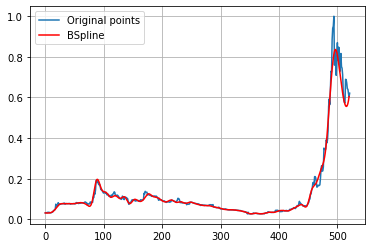

In [ ]:
import scipy.interpolate as interpolate

t_TKIM_65, c_TKIM_65, k_TKIM_65 = interpolate.splrep(TKIM_x65, TKIM_y65, s=0, k=3)
print('''\
t_TKIM_65: {}
c_TKIM_65: {}
k_TKIM_65: {}
'''.format(t_TKIM_65, c_TKIM_65, k_TKIM_65))
N = 522
xmin_TKIM_65, xmax_TKIM_65 = TKIM_x65.min(), TKIM_x65.max()
xx_TKIM_65 = np.linspace(xmin_TKIM_65, xmax_TKIM_65, N)
spline_TKIM_65 = interpolate.BSpline(t_TKIM_65, c_TKIM_65, k_TKIM_65, extrapolate=False)

plt.plot(TKIM_x, TKIM_y, label='Original points')
plt.plot(xx_TKIM_65, spline_TKIM_65(xx_TKIM_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE TKIM**


In [ ]:

#RMSE 15 DATA TKIM
y_true_TKIM_15 = TKIM_y.tolist()
y_pred_TKIM_15 = spline_TKIM_15(xx_TKIM_15).tolist()
mse_TKIM_15 = mean_squared_error(y_true_TKIM_15, y_pred_TKIM_15)
rmse_TKIM_15 = np.sqrt(mse_TKIM_15)
print("rmse TKIM 15 =",rmse_TKIM_15)

#RMSE 25 DATA TKIM
y_true_TKIM_25 = TKIM_y.tolist()
y_pred_TKIM_25 = spline_TKIM_25(xx_TKIM_25).tolist()
mse_TKIM_25 = mean_squared_error(y_true_TKIM_25, y_pred_TKIM_25)
rmse_TKIM_25 = np.sqrt(mse_TKIM_25)
print("rmse TKIM 25 =",rmse_TKIM_25)

#RMSE 35 DATA TKIM
y_true_TKIM_35 = TKIM_y.tolist()
y_pred_TKIM_35 = spline_TKIM_35(xx_TKIM_35).tolist()
mse_TKIM_35 = mean_squared_error(y_true_TKIM_35, y_pred_TKIM_35)
rmse_TKIM_35 = np.sqrt(mse_TKIM_35)
print("rmse TKIM 35 =",rmse_TKIM_35)

#RMSE 45 DATA TKIM
y_true_TKIM_45 = TKIM_y.tolist()
y_pred_TKIM_45 = spline_TKIM_45(xx_TKIM_45).tolist()
mse_TKIM_45 = mean_squared_error(y_true_TKIM_45, y_pred_TKIM_45)
rmse_TKIM_45 = np.sqrt(mse_TKIM_45)
print("rmse TKIM 45 =",rmse_TKIM_45)

#RMSE 55 DATA TKIM
y_true_TKIM_55 = TKIM_y.tolist()
y_pred_TKIM_55 = spline_TKIM_55(xx_TKIM_55).tolist()
mse_TKIM_55 = mean_squared_error(y_true_TKIM_55, y_pred_TKIM_55)
rmse_TKIM_55 = np.sqrt(mse_TKIM_55)
print("rmse TKIM 55 =",rmse_TKIM_55)

#RMSE 65 DATA TKIM
y_true_TKIM_65 = TKIM_y.tolist()
y_pred_TKIM_65 = spline_TKIM_65(xx_TKIM_65).tolist()
mse_TKIM_65 = mean_squared_error(y_true_TKIM_65, y_pred_TKIM_65)
rmse_TKIM_65 = np.sqrt(mse_TKIM_65)
print("rmse TKIM 65 =",rmse_TKIM_65)


rmse TKIM 15 = 0.12452753083004048
rmse TKIM 25 = 0.09522293611812858
rmse TKIM 35 = 0.07774202223144397
rmse TKIM 45 = 0.038840645021882676
rmse TKIM 55 = 0.025862748879134576
rmse TKIM 65 = 0.025649297358931532


# **TPIA**

No handles with labels found to put in legend.


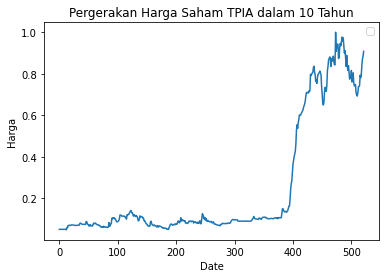

In [ ]:
TPIA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/TPIA.JK.csv')

TPIA_x = TPIA['No'].values
TPIA_y = TPIA['Skala'].values

plt.plot(TPIA_x,TPIA_y)
plt.title('Pergerakan Harga Saham TPIA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA TPIA**

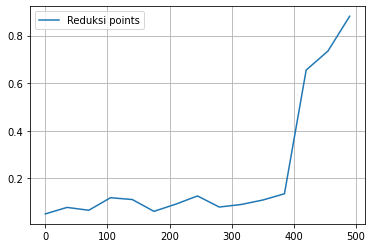

In [ ]:
TPIA_x15 = TPIA_x[0:522:35]
TPIA_y15 = TPIA_y[0:522:35]

plt.plot(TPIA_x15, TPIA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TPIA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_TPIA_15: [ 0.05084981  0.12064654  0.01310646  0.13652568  0.12303763  0.03929255
  0.08988321  0.15179715  0.06116269  0.08196219  0.15258487 -0.0378732
  1.09436095  0.53844941  0.88122605  0.          0.          0.
  0.        ]
k_TPIA_15: 3



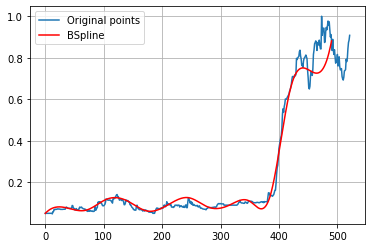

In [ ]:
import scipy.interpolate as interpolate

t_TPIA_15, c_TPIA_15, k_TPIA_15 = interpolate.splrep(TPIA_x15, TPIA_y15, s=0, k=3)
print('''\
t_TPIA_15: {}
c_TPIA_15: {}
k_TPIA_15: {}
'''.format(t_TPIA_15, c_TPIA_15, k_TPIA_15))
N = 522
xmin_TPIA_15, xmax_TPIA_15 = TPIA_x15.min(), TPIA_x15.max()
xx_TPIA_15 = np.linspace(xmin_TPIA_15, xmax_TPIA_15, N)
spline_TPIA_15 = interpolate.BSpline(t_TPIA_15, c_TPIA_15, k_TPIA_15, extrapolate=False)

plt.plot(TPIA_x, TPIA_y, label='Original points')
plt.plot(xx_TPIA_15, spline_TPIA_15(xx_TPIA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA TPIA**

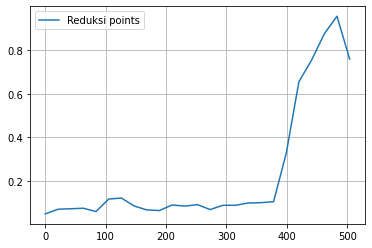

In [ ]:
TPIA_x25 = TPIA_x[0:522:21]
TPIA_y25 = TPIA_y[0:522:21]

plt.plot(TPIA_x25, TPIA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TPIA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_TPIA_25: [0.05084981 0.08063163 0.06492862 0.0883167  0.03631434 0.13651699
 0.1307193  0.08078787 0.06967224 0.05574708 0.10451    0.07683545
 0.1071781  0.05410183 0.10066471 0.08483568 0.10158892 0.11359117
 0.05785517 0.29587732 0.72643322 0.72947952 0.92747342 1.03626329
 0.75862069 0.         0.         0.         0.        ]
k_TPIA_25: 3



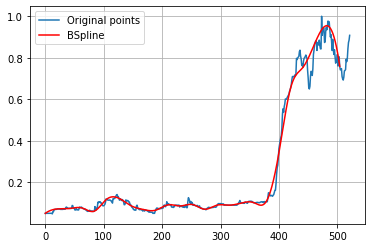

In [ ]:
import scipy.interpolate as interpolate

t_TPIA_25, c_TPIA_25, k_TPIA_25 = interpolate.splrep(TPIA_x25, TPIA_y25, s=0, k=3)
print('''\
t_TPIA_25: {}
c_TPIA_25: {}
k_TPIA_25: {}
'''.format(t_TPIA_25, c_TPIA_25, k_TPIA_25))
N = 522
xmin_TPIA_25, xmax_TPIA_25 = TPIA_x25.min(), TPIA_x25.max()
xx_TPIA_25 = np.linspace(xmin_TPIA_25, xmax_TPIA_25, N)
spline_TPIA_25 = interpolate.BSpline(t_TPIA_25, c_TPIA_25, k_TPIA_25, extrapolate=False)

plt.plot(TPIA_x, TPIA_y, label='Original points')
plt.plot(xx_TPIA_25, spline_TPIA_25(xx_TPIA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**3. PERCOBAAN 30 DATA TPIA**

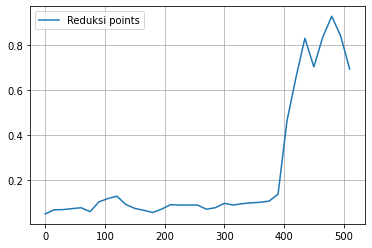

In [ ]:
TPIA_x35 = TPIA_x[0:522:15]
TPIA_y35 = TPIA_y[0:522:15]

plt.plot(TPIA_x35, TPIA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_TPIA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_TPIA_35: [0.05084981 0.07431057 0.0677918  0.07211197 0.08949682 0.03928376
 0.11894607 0.11228094 0.14503178 0.08387976 0.07458572 0.06910794
 0.05066619 0.07123785 0.09765964 0.08874612 0.08895222 0.09704136
 0.0644787  0.07471003 0.10696715 0.08415056 0.09802694 0.1014447
 0.09646373 0.12650913 0.04290205 0.53052454 0.61519287 0.93979368
 0.6038023  0.86108908 0.99741784 0.77447116 0.69272031 0.
 0.         0.         0.        ]
k_TPIA_35: 3



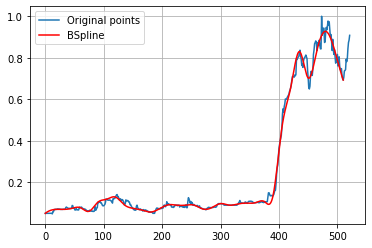

In [ ]:
import scipy.interpolate as interpolate

t_TPIA_35, c_TPIA_35, k_TPIA_35 = interpolate.splrep(TPIA_x35, TPIA_y35, s=0, k=3)
print('''\
t_TPIA_35: {}
c_TPIA_35: {}
k_TPIA_35: {}
'''.format(t_TPIA_35, c_TPIA_35, k_TPIA_35))
N = 522
xmin_TPIA_35, xmax_TPIA_35 = TPIA_x35.min(), TPIA_x35.max()
xx_TPIA_35 = np.linspace(xmin_TPIA_35, xmax_TPIA_35, N)
spline_TPIA_35 = interpolate.BSpline(t_TPIA_35, c_TPIA_35, k_TPIA_35, extrapolate=False)

plt.plot(TPIA_x, TPIA_y, label='Original points')
plt.plot(xx_TPIA_35, spline_TPIA_35(xx_TPIA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA TPIA**

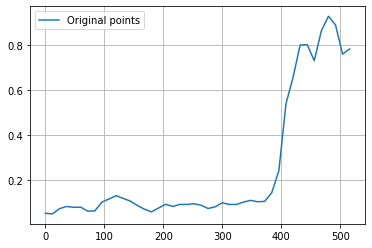

In [ ]:
TPIA_x45 = TPIA_x[0:522:12]
TPIA_y45 = TPIA_y[0:522:12]

plt.plot(TPIA_x45, TPIA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TPIA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_TPIA_45: [0.05084981 0.02975307 0.07190628 0.08462059 0.07386909 0.08477294
 0.05642216 0.05060236 0.11125945 0.10914234 0.13819325 0.1143725
 0.10839216 0.08392096 0.07044076 0.04953991 0.07441017 0.09963596
 0.07315541 0.09517869 0.08772618 0.09551294 0.08987172 0.06673813
 0.076453   0.10585999 0.08683622 0.08839148 0.10119421 0.11161419
 0.10226445 0.09313675 0.14802439 0.17229303 0.60706095 0.62196428
 0.83617164 0.82648001 0.664575   0.8922315  0.93891281 0.9074766
 0.64587856 0.7816092  0.         0.         0.         0.        ]
k_TPIA_45: 3



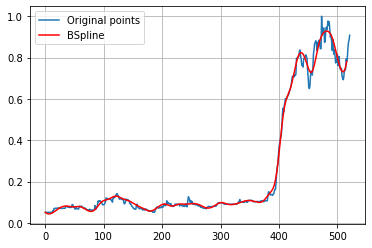

In [ ]:
import scipy.interpolate as interpolate

t_TPIA_45, c_TPIA_45, k_TPIA_45 = interpolate.splrep(TPIA_x45, TPIA_y45, s=0, k=3)
print('''\
t_TPIA_45: {}
c_TPIA_45: {}
k_TPIA_45: {}
'''.format(t_TPIA_45, c_TPIA_45, k_TPIA_45))
N = 522
xmin_TPIA_45, xmax_TPIA_45 = TPIA_x45.min(), TPIA_x45.max()
xx_TPIA_45 = np.linspace(xmin_TPIA_45, xmax_TPIA_45, N)
spline_TPIA_45 = interpolate.BSpline(t_TPIA_45, c_TPIA_45, k_TPIA_45, extrapolate=False)

plt.plot(TPIA_x, TPIA_y, label='Original points')
plt.plot(xx_TPIA_45, spline_TPIA_45(xx_TPIA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA TPIA**

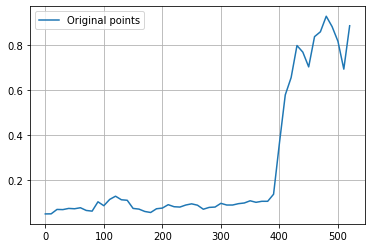

In [ ]:
TPIA_x55 = TPIA_x[0:522:10]
TPIA_y55 = TPIA_y[0:522:10]

plt.plot(TPIA_x55, TPIA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TPIA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_TPIA_55: [0.05084981 0.03113216 0.08155982 0.06581465 0.07885488 0.07009638
 0.08306304 0.06703444 0.04596977 0.12820374 0.06856424 0.12108232
 0.13764162 0.10463904 0.12531118 0.06208497 0.07767949 0.06047429
 0.05051436 0.08047881 0.06987385 0.10038258 0.07921836 0.07920743
 0.09138824 0.09683597 0.09445778 0.06241613 0.08554388 0.07381845
 0.10661863 0.08643623 0.08923281 0.09822888 0.09555469 0.1153087
 0.09763899 0.10794409 0.11147384 0.08704973 0.36896908 0.6215154
 0.61570029 0.84677316 0.7813082  0.63607685 0.89047636 0.82270737
 0.96811946 0.86803319 0.84012772 0.5400894  0.88505747 0.
 0.         0.         0.        ]
k_TPIA_55: 3



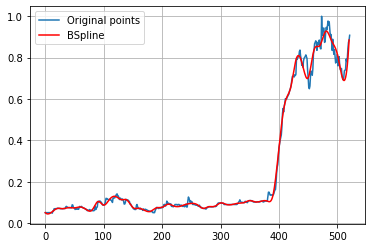

In [ ]:
import scipy.interpolate as interpolate

t_TPIA_55, c_TPIA_55, k_TPIA_55 = interpolate.splrep(TPIA_x55, TPIA_y55, s=0, k=3)
print('''\
t_TPIA_55: {}
c_TPIA_55: {}
k_TPIA_55: {}
'''.format(t_TPIA_55, c_TPIA_55, k_TPIA_55))
N = 522
xmin_TPIA_55, xmax_TPIA_55 = TPIA_x55.min(), TPIA_x55.max()
xx_TPIA_55 = np.linspace(xmin_TPIA_55, xmax_TPIA_55, N)
spline_TPIA_55 = interpolate.BSpline(t_TPIA_55, c_TPIA_55, k_TPIA_55, extrapolate=False)

plt.plot(TPIA_x, TPIA_y, label='Original points')
plt.plot(xx_TPIA_55, spline_TPIA_55(xx_TPIA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA TPIA**

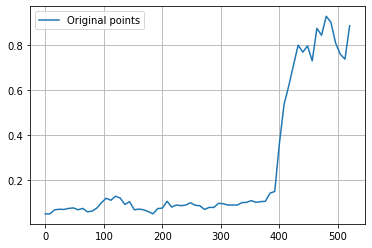

In [ ]:
TPIA_x65 = TPIA_x[0:522:8]
TPIA_y65 = TPIA_y[0:522:8]

plt.plot(TPIA_x65, TPIA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_TPIA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_TPIA_65: [0.05084981 0.03489641 0.0747835  0.07134065 0.06947877 0.07499441
 0.08187417 0.0623788  0.08383455 0.05361355 0.06277515 0.0744031
 0.09996922 0.13050255 0.10014933 0.13686889 0.12866294 0.07512121
 0.12598878 0.05278578 0.07809201 0.06812342 0.06463823 0.03890162
 0.08666013 0.06127442 0.12859897 0.06521888 0.09796179 0.08453029
 0.08746008 0.10722575 0.08390638 0.09423194 0.06090382 0.08640292
 0.07189463 0.10442869 0.09621681 0.08840706 0.09175129 0.08618411
 0.10510862 0.09816394 0.11604437 0.0966011  0.11136001 0.08982097
 0.17024529 0.08672521 0.38551412 0.55565976 0.61434795 0.7013944
 0.84063525 0.7291954

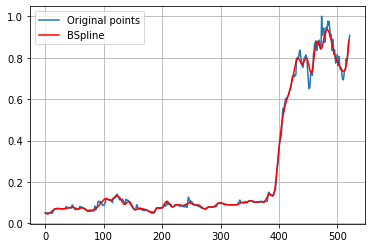

In [ ]:
import scipy.interpolate as interpolate

t_TPIA_65, c_TPIA_65, k_TPIA_65 = interpolate.splrep(TPIA_x65, TPIA_y65, s=0, k=3)
print('''\
t_TPIA_65: {}
c_TPIA_65: {}
k_TPIA_65: {}
'''.format(t_TPIA_65, c_TPIA_65, k_TPIA_65))
N = 522
xmin_TPIA_65, xmax_TPIA_65 = TPIA_x65.min(), TPIA_x65.max()
xx_TPIA_65 = np.linspace(xmin_TPIA_65, xmax_TPIA_65, N)
spline_TPIA_65 = interpolate.BSpline(t_TPIA_65, c_TPIA_65, k_TPIA_65, extrapolate=False)

plt.plot(TPIA_x, TPIA_y, label='Original points')
plt.plot(xx_TPIA_65, spline_TPIA_65(xx_TPIA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE TPIA**

In [ ]:

#RMSE 15 DATA TPIA
y_true_TPIA_15 = TPIA_y.tolist()
y_pred_TPIA_15 = spline_TPIA_15(xx_TPIA_15).tolist()
mse_TPIA_15 = mean_squared_error(y_true_TPIA_15, y_pred_TPIA_15)
rmse_TPIA_15 = np.sqrt(mse_TPIA_15)
print("rmse TPIA 15 =",rmse_TPIA_15)

#RMSE 25 DATA TPIA
y_true_TPIA_25 = TPIA_y.tolist()
y_pred_TPIA_25 = spline_TPIA_25(xx_TPIA_25).tolist()
mse_TPIA_25 = mean_squared_error(y_true_TPIA_25, y_pred_TPIA_25)
rmse_TPIA_25 = np.sqrt(mse_TPIA_25)
print("rmse TPIA 25 =",rmse_TPIA_25)

#RMSE 35 DATA TPIA
y_true_TPIA_35 = TPIA_y.tolist()
y_pred_TPIA_35 = spline_TPIA_35(xx_TPIA_35).tolist()
mse_TPIA_35 = mean_squared_error(y_true_TPIA_35, y_pred_TPIA_35)
rmse_TPIA_35 = np.sqrt(mse_TPIA_35)
print("rmse TPIA 35 =",rmse_TPIA_35)

#RMSE 45 DATA TPIA
y_true_TPIA_45 = TPIA_y.tolist()
y_pred_TPIA_45 = spline_TPIA_45(xx_TPIA_45).tolist()
mse_TPIA_45 = mean_squared_error(y_true_TPIA_45, y_pred_TPIA_45)
rmse_TPIA_45 = np.sqrt(mse_TPIA_45)
print("rmse TPIA 45 =",rmse_TPIA_45)

#RMSE 55 DATA TPIA
y_true_TPIA_55 = TPIA_y.tolist()
y_pred_TPIA_55 = spline_TPIA_55(xx_TPIA_55).tolist()
mse_TPIA_55 = mean_squared_error(y_true_TPIA_55, y_pred_TPIA_55)
rmse_TPIA_55 = np.sqrt(mse_TPIA_55)
print("rmse TPIA 55 =",rmse_TPIA_55)

#RMSE 65 DATA TPIA
y_true_TPIA_65 = TPIA_y.tolist()
y_pred_TPIA_65 = spline_TPIA_65(xx_TPIA_65).tolist()
mse_TPIA_65 = mean_squared_error(y_true_TPIA_65, y_pred_TPIA_65)
rmse_TPIA_65 = np.sqrt(mse_TPIA_65)
print("rmse TPIA 65 =",rmse_TPIA_65)

rmse TPIA 15 = 0.11644216351896425
rmse TPIA 25 = 0.07366223844876392
rmse TPIA 35 = 0.05683325851121022
rmse TPIA 45 = 0.03429040149984961
rmse TPIA 55 = 0.020336951184320818
rmse TPIA 65 = 0.01839638436216486


# **UNTR**

No handles with labels found to put in legend.


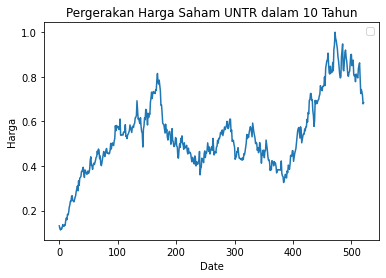

In [ ]:
UNTR = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/UNTR.JK.csv')

UNTR_x = UNTR['No'].values
UNTR_y = UNTR['Skala'].values

plt.plot(UNTR_x,UNTR_y)
plt.title('Pergerakan Harga Saham UNTR dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA UNTR**

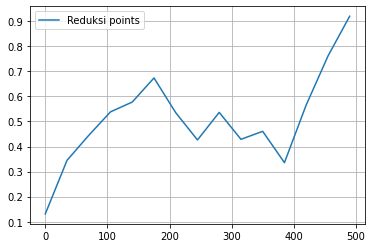

In [ ]:
UNTR_x15 = UNTR_x[0:522:35]
UNTR_y15 = UNTR_y[0:522:35]

plt.plot(UNTR_x15, UNTR_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNTR_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_UNTR_15: [0.13099449 0.34990939 0.39200396 0.56400364 0.53938158 0.74347003
 0.52923828 0.34957685 0.62995433 0.34810584 0.55012232 0.21515488
 0.73229258 0.78369746 0.92       0.         0.         0.
 0.        ]
k_UNTR_15: 3



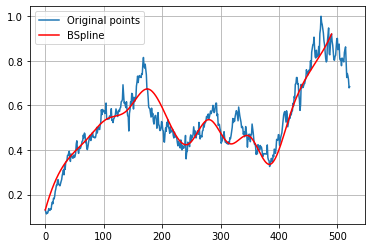

In [ ]:
import scipy.interpolate as interpolate

t_UNTR_15, c_UNTR_15, k_UNTR_15 = interpolate.splrep(UNTR_x15, UNTR_y15, s=0, k=3)
print('''\
t_UNTR_15: {}
c_UNTR_15: {}
k_UNTR_15: {}
'''.format(t_UNTR_15, c_UNTR_15, k_UNTR_15))
N = 522
xmin_UNTR_15, xmax_UNTR_15 = UNTR_x15.min(), UNTR_x15.max()
xx_UNTR_15 = np.linspace(xmin_UNTR_15, xmax_UNTR_15, N)
spline_UNTR_15 = interpolate.BSpline(t_UNTR_15, c_UNTR_15, k_UNTR_15, extrapolate=False)

plt.plot(UNTR_x, UNTR_y, label='Original points')
plt.plot(xx_UNTR_15, spline_UNTR_15(xx_UNTR_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA UNTR**

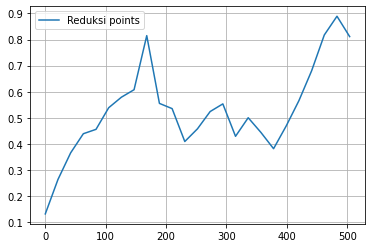

In [ ]:
UNTR_x25 = UNTR_x[0:522:21]
UNTR_y25 = UNTR_y[0:522:21]

plt.plot(UNTR_x25, UNTR_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNTR_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_UNTR_25: [0.13099449 0.23451377 0.33556392 0.45858306 0.43126399 0.54922594
 0.60223227 0.51434497 0.98538784 0.43410365 0.60819756 0.34310613
 0.47187794 0.51438212 0.61309359 0.35199351 0.55143237 0.44227701
 0.34195959 0.47738463 0.56100188 0.67235783 0.88196978 0.93057761
 0.81125    0.         0.         0.         0.        ]
k_UNTR_25: 3



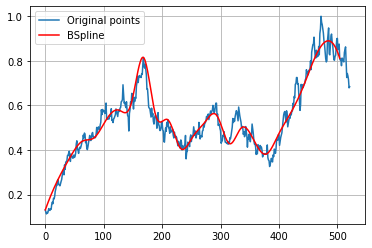

In [ ]:
import scipy.interpolate as interpolate

t_UNTR_25, c_UNTR_25, k_UNTR_25 = interpolate.splrep(UNTR_x25, UNTR_y25, s=0, k=3)
print('''\
t_UNTR_25: {}
c_UNTR_25: {}
k_UNTR_25: {}
'''.format(t_UNTR_25, c_UNTR_25, k_UNTR_25))
N = 522
xmin_UNTR_25, xmax_UNTR_25 = UNTR_x25.min(), UNTR_x25.max()
xx_UNTR_25 = np.linspace(xmin_UNTR_25, xmax_UNTR_25, N)
spline_UNTR_25 = interpolate.BSpline(t_UNTR_25, c_UNTR_25, k_UNTR_25, extrapolate=False)

plt.plot(UNTR_x, UNTR_y, label='Original points')
plt.plot(xx_UNTR_25, spline_UNTR_25(xx_UNTR_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA UNTR**

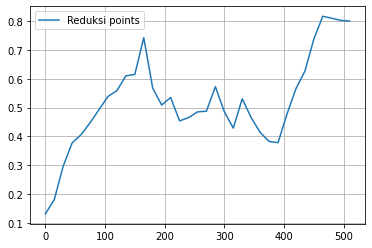

In [ ]:
UNTR_x35 = UNTR_x[0:522:15]
UNTR_y35 = UNTR_y[0:522:15]

plt.plot(UNTR_x35, UNTR_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNTR_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_UNTR_35: [0.13099449 0.11481    0.27753376 0.38969371 0.39981149 0.44827526
 0.48947741 0.55021022 0.5400817  0.64244285 0.5501469  0.84696956
 0.51697485 0.49013103 0.57500103 0.41986485 0.46803956 0.4979769
 0.45005282 0.62681181 0.47769993 0.37613846 0.59024624 0.4466266
 0.41324738 0.38288389 0.35021708 0.4849978  0.57479172 0.60958531
 0.74436703 0.83794657 0.79414673 0.80542663 0.8        0.
 0.         0.         0.        ]
k_UNTR_35: 3



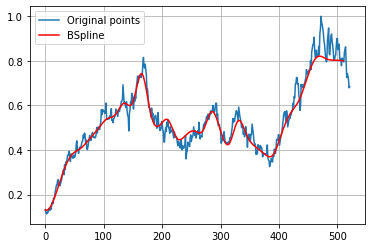

In [ ]:
import scipy.interpolate as interpolate

t_UNTR_35, c_UNTR_35, k_UNTR_35 = interpolate.splrep(UNTR_x35, UNTR_y35, s=0, k=3)
print('''\
t_UNTR_35: {}
c_UNTR_35: {}
k_UNTR_35: {}
'''.format(t_UNTR_35, c_UNTR_35, k_UNTR_35))
N = 522
xmin_UNTR_35, xmax_UNTR_35 = UNTR_x35.min(), UNTR_x35.max()
xx_UNTR_35 = np.linspace(xmin_UNTR_35, xmax_UNTR_35, N)
spline_UNTR_35 = interpolate.BSpline(t_UNTR_35, c_UNTR_35, k_UNTR_35, extrapolate=False)

plt.plot(UNTR_x, UNTR_y, label='Original points')
plt.plot(xx_UNTR_35, spline_UNTR_35(xx_UNTR_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA UNTR**

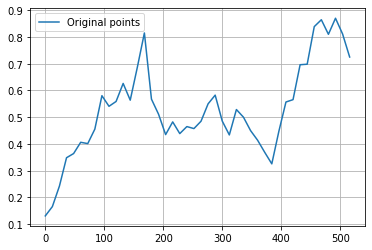

In [ ]:
UNTR_x45 = UNTR_x[0:522:12]
UNTR_y45 = UNTR_y[0:522:12]

plt.plot(UNTR_x45, UNTR_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNTR_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_UNTR_45: [0.13099449 0.14834028 0.17982695 0.37912315 0.34496143 0.42587107
 0.38876924 0.42742194 0.63440794 0.5177213  0.53952179 0.67717143
 0.5092925  0.66815857 0.93557322 0.47954856 0.55123255 0.38302126
 0.52668243 0.40524903 0.48482145 0.44546516 0.47831789 0.55126326
 0.61662906 0.47722051 0.38823889 0.57232392 0.49496544 0.44781432
 0.41377728 0.37957657 0.28041645 0.45250762 0.59455307 0.51053009
 0.75707656 0.63866367 0.87701874 0.88576135 0.76618586 0.95726498
 0.74511751 0.725      0.         0.         0.         0.        ]
k_UNTR_45: 3



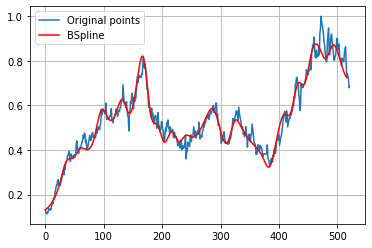

In [ ]:
import scipy.interpolate as interpolate

t_UNTR_45, c_UNTR_45, k_UNTR_45 = interpolate.splrep(UNTR_x45, UNTR_y45, s=0, k=3)
print('''\
t_UNTR_45: {}
c_UNTR_45: {}
k_UNTR_45: {}
'''.format(t_UNTR_45, c_UNTR_45, k_UNTR_45))
N = 522
xmin_UNTR_45, xmax_UNTR_45 = UNTR_x45.min(), UNTR_x45.max()
xx_UNTR_45 = np.linspace(xmin_UNTR_45, xmax_UNTR_45, N)
spline_UNTR_45 = interpolate.BSpline(t_UNTR_45, c_UNTR_45, k_UNTR_45, extrapolate=False)

plt.plot(UNTR_x, UNTR_y, label='Original points')
plt.plot(xx_UNTR_45, spline_UNTR_45(xx_UNTR_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA UNTR**

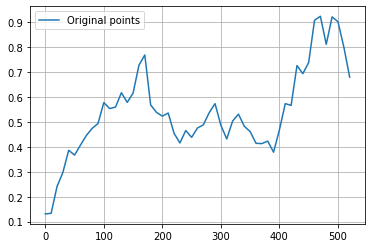

In [ ]:
UNTR_x55 = UNTR_x[0:522:10]
UNTR_y55 = UNTR_y[0:522:10]

plt.plot(UNTR_x55, UNTR_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNTR_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_UNTR_55: [0.13099449 0.04396388 0.25998847 0.27310227 0.42536392 0.3400771
 0.41359764 0.44274726 0.48337336 0.46477423 0.61392483 0.54067157
 0.540309   0.6510723  0.55290178 0.60232057 0.72781595 0.84391562
 0.50152158 0.55499807 0.50348613 0.56605741 0.44228425 0.38730561
 0.4984933  0.40872118 0.49162199 0.47479086 0.53421458 0.60585084
 0.47738207 0.39837089 0.51663439 0.55009157 0.46674933 0.47416111
 0.40035622 0.40691402 0.44698771 0.34013516 0.46122167 0.61997816
 0.4938657  0.79830904 0.66289812 0.70509847 0.94170799 0.96556957
 0.73101373 0.9703755  0.8865205  0.761896   0.67875    0.
 0.         0.         0.        ]
k_UNTR_55: 3



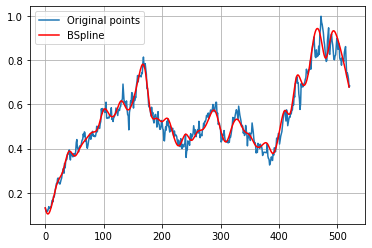

In [ ]:
import scipy.interpolate as interpolate

t_UNTR_55, c_UNTR_55, k_UNTR_55 = interpolate.splrep(UNTR_x55, UNTR_y55, s=0, k=3)
print('''\
t_UNTR_55: {}
c_UNTR_55: {}
k_UNTR_55: {}
'''.format(t_UNTR_55, c_UNTR_55, k_UNTR_55))
N = 522
xmin_UNTR_55, xmax_UNTR_55 = UNTR_x55.min(), UNTR_x55.max()
xx_UNTR_55 = np.linspace(xmin_UNTR_55, xmax_UNTR_55, N)
spline_UNTR_55 = interpolate.BSpline(t_UNTR_55, c_UNTR_55, k_UNTR_55, extrapolate=False)

plt.plot(UNTR_x, UNTR_y, label='Original points')
plt.plot(xx_UNTR_55, spline_UNTR_55(xx_UNTR_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA UNTR**

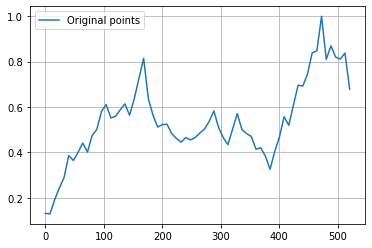

In [ ]:
UNTR_x65 = UNTR_x[0:522:8]
UNTR_y65 = UNTR_y[0:522:8]

plt.plot(UNTR_x65, UNTR_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNTR_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_UNTR_65: [0.13099449 0.08841762 0.17648965 0.24962931 0.2632712  0.42785082
 0.33996059 0.39714677 0.47262231 0.35869389 0.50097212 0.47843259
 0.59216766 0.63567177 0.52819038 0.56128682 0.57964221 0.64514432
 0.52228049 0.64823371 0.70228467 0.9001276  0.58720494 0.57605266
 0.49108443 0.52710963 0.53547705 0.47348215 0.46559433 0.43164053
 0.47784357 0.44698521 0.4642156  0.4861524  0.50117481 0.52414835
 0.61973178 0.49192452 0.47257014 0.40779491 0.49875023 0.61220416
 0.47618314 0.48306329 0.48656371 0.39068189 0.43320874 0.39648314
 0.28335869 0.42383212 0.44381285 0.60591647 0.47377128 0.61524843
 0.72148501 0.67631

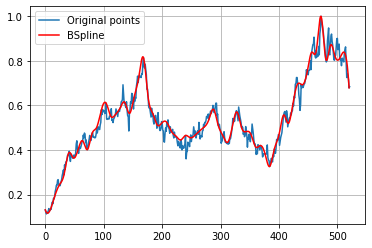

In [ ]:
import scipy.interpolate as interpolate

t_UNTR_65, c_UNTR_65, k_UNTR_65 = interpolate.splrep(UNTR_x65, UNTR_y65, s=0, k=3)
print('''\
t_UNTR_65: {}
c_UNTR_65: {}
k_UNTR_65: {}
'''.format(t_UNTR_65, c_UNTR_65, k_UNTR_65))
N = 522
xmin_UNTR_65, xmax_UNTR_65 = UNTR_x65.min(), UNTR_x65.max()
xx_UNTR_65 = np.linspace(xmin_UNTR_65, xmax_UNTR_65, N)
spline_UNTR_65 = interpolate.BSpline(t_UNTR_65, c_UNTR_65, k_UNTR_65, extrapolate=False)

plt.plot(UNTR_x, UNTR_y, label='Original points')
plt.plot(xx_UNTR_65, spline_UNTR_65(xx_UNTR_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE UNTR**

In [ ]:

#RMSE 15 DATA UNTR
y_true_UNTR_15 = UNTR_y.tolist()
y_pred_UNTR_15 = spline_UNTR_15(xx_UNTR_15).tolist()
mse_UNTR_15 = mean_squared_error(y_true_UNTR_15, y_pred_UNTR_15)
rmse_UNTR_15 = np.sqrt(mse_UNTR_15)
print("rmse UNTR 15 =",rmse_UNTR_15)

#RMSE 25 DATA UNTR
y_true_UNTR_25 = UNTR_y.tolist()
y_pred_UNTR_25 = spline_UNTR_25(xx_UNTR_25).tolist()
mse_UNTR_25 = mean_squared_error(y_true_UNTR_25, y_pred_UNTR_25)
rmse_UNTR_25 = np.sqrt(mse_UNTR_25)
print("rmse UNTR 25 =",rmse_UNTR_25)

#RMSE 35 DATA UNTR
y_true_UNTR_35 = UNTR_y.tolist()
y_pred_UNTR_35 = spline_UNTR_35(xx_UNTR_35).tolist()
mse_UNTR_35 = mean_squared_error(y_true_UNTR_35, y_pred_UNTR_35)
rmse_UNTR_35 = np.sqrt(mse_UNTR_35)
print("rmse UNTR 35 =",rmse_UNTR_35)

#RMSE 45 DATA UNTR
y_true_UNTR_45 = UNTR_y.tolist()
y_pred_UNTR_45 = spline_UNTR_45(xx_UNTR_45).tolist()
mse_UNTR_45 = mean_squared_error(y_true_UNTR_45, y_pred_UNTR_45)
rmse_UNTR_45 = np.sqrt(mse_UNTR_45)
print("rmse UNTR 45 =",rmse_UNTR_45)

#RMSE 55 DATA UNTR
y_true_UNTR_55 = UNTR_y.tolist()
y_pred_UNTR_55 = spline_UNTR_55(xx_UNTR_55).tolist()
mse_UNTR_55 = mean_squared_error(y_true_UNTR_55, y_pred_UNTR_55)
rmse_UNTR_55 = np.sqrt(mse_UNTR_55)
print("rmse UNTR 55 =",rmse_UNTR_55)

#RMSE 65 DATA UNTR
y_true_UNTR_65 = UNTR_y.tolist()
y_pred_UNTR_65 = spline_UNTR_65(xx_UNTR_65).tolist()
mse_UNTR_65 = mean_squared_error(y_true_UNTR_65, y_pred_UNTR_65)
rmse_UNTR_65 = np.sqrt(mse_UNTR_65)
print("rmse UNTR 65 =",rmse_UNTR_65)

rmse UNTR 15 = 0.10021937761310783
rmse UNTR 25 = 0.06790886740149668
rmse UNTR 35 = 0.05193325635998583
rmse UNTR 45 = 0.035788806746692894
rmse UNTR 55 = 0.035561039742221856
rmse UNTR 65 = 0.030604644193670472


# **UNVR**

No handles with labels found to put in legend.


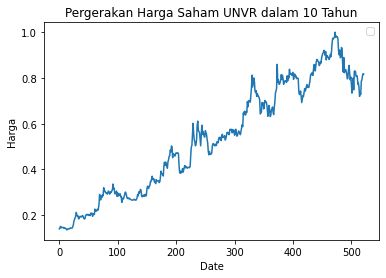

In [ ]:
UNVR = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/UNVR.JK.csv')

UNVR_x = UNVR['No'].values
UNVR_y = UNVR['Skala'].values

plt.plot(UNVR_x,UNVR_y)
plt.title('Pergerakan Harga Saham UNVR dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA UNVR**

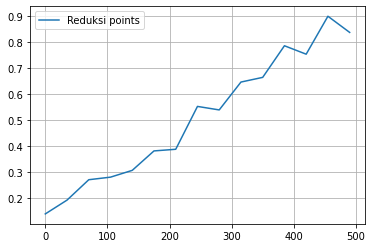

In [ ]:
UNVR_x15 = UNVR_x[0:522:35]
UNVR_y15 = UNVR_y[0:522:35]

plt.plot(UNVR_x15, UNVR_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNVR_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_UNVR_15: [0.14028777 0.13631964 0.29480676 0.27796372 0.28639806 0.4217678
 0.3196962  0.63038265 0.47711853 0.6985533  0.60816468 0.85619805
 0.62509458 1.08830703 0.83723022 0.         0.         0.
 0.        ]
k_UNVR_15: 3



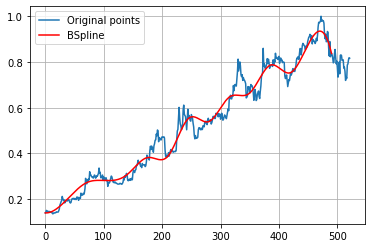

In [ ]:
import scipy.interpolate as interpolate

t_UNVR_15, c_UNVR_15, k_UNVR_15 = interpolate.splrep(UNVR_x15, UNVR_y15, s=0, k=3)
print('''\
t_UNVR_15: {}
c_UNVR_15: {}
k_UNVR_15: {}
'''.format(t_UNVR_15, c_UNVR_15, k_UNVR_15))
N = 522
xmin_UNVR_15, xmax_UNVR_15 = UNVR_x15.min(), UNVR_x15.max()
xx_UNVR_15 = np.linspace(xmin_UNVR_15, xmax_UNVR_15, N)
spline_UNVR_15 = interpolate.BSpline(t_UNVR_15, c_UNVR_15, k_UNVR_15, extrapolate=False)

plt.plot(UNVR_x, UNVR_y, label='Original points')
plt.plot(xx_UNVR_15, spline_UNVR_15(xx_UNVR_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**2. PERCOBAAN 25 DATA UNVR**

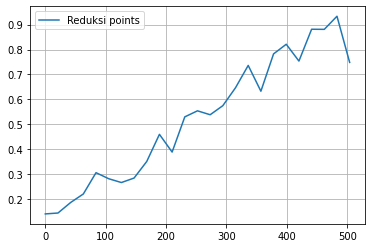

In [ ]:
UNVR_x25 = UNVR_x[0:522:21]
UNVR_y25 = UNVR_y[0:522:21]

plt.plot(UNVR_x25, UNVR_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()


t_UNVR_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_UNVR_25: [0.14028777 0.10827757 0.195765   0.19608571 0.34175441 0.27142903
 0.26137841 0.28017964 0.32293899 0.53238092 0.30473155 0.57962812
 0.55481353 0.52485877 0.57506792 0.62271129 0.81358334 0.53932227
 0.8249909  0.85495874 0.68143315 0.94089141 0.8100642  1.05461268
 0.74820144 0.         0.         0.         0.        ]
k_UNVR_25: 3



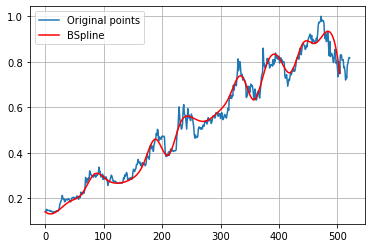

In [ ]:
import scipy.interpolate as interpolate

t_UNVR_25, c_UNVR_25, k_UNVR_25 = interpolate.splrep(UNVR_x25, UNVR_y25, s=0, k=3)
print('''\
t_UNVR_25: {}
c_UNVR_25: {}
k_UNVR_25: {}
'''.format(t_UNVR_25, c_UNVR_25, k_UNVR_25))
N = 522
xmin_UNVR_25, xmax_UNVR_25 = UNVR_x25.min(), UNVR_x25.max()
xx_UNVR_25 = np.linspace(xmin_UNVR_25, xmax_UNVR_25, N)
spline_UNVR_25 = interpolate.BSpline(t_UNVR_25, c_UNVR_25, k_UNVR_25, extrapolate=False)

plt.plot(UNVR_x, UNVR_y, label='Original points')
plt.plot(xx_UNVR_25, spline_UNVR_25(xx_UNVR_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA UNVR**

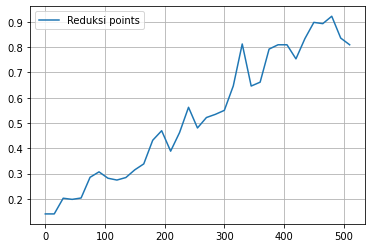

In [ ]:
UNVR_x35 = UNVR_x[0:522:15]
UNVR_y35 = UNVR_y[0:522:15]

plt.plot(UNVR_x35, UNVR_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNVR_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_UNVR_35: [0.14028777 0.07967986 0.23047841 0.19632376 0.1798156  0.30383832
 0.31526279 0.27503857 0.27343185 0.27691747 0.32393423 0.31583482
 0.44150346 0.50807938 0.34272576 0.45195281 0.62284428 0.42897224
 0.54256173 0.53027725 0.54136523 0.60372226 0.92324214 0.57830919
 0.64031965 0.82893737 0.79752801 0.83706572 0.71032422 0.84322014
 0.91859377 0.8699947  0.98912324 0.74430978 0.80935252 0.
 0.         0.         0.        ]
k_UNVR_35: 3



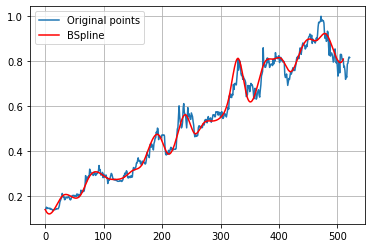

In [ ]:
import scipy.interpolate as interpolate

t_UNVR_35, c_UNVR_35, k_UNVR_35 = interpolate.splrep(UNVR_x35, UNVR_y35, s=0, k=3)
print('''\
t_UNVR_35: {}
c_UNVR_35: {}
k_UNVR_35: {}
'''.format(t_UNVR_35, c_UNVR_35, k_UNVR_35))
N = 522
xmin_UNVR_35, xmax_UNVR_35 = UNVR_x35.min(), UNVR_x35.max()
xx_UNVR_35 = np.linspace(xmin_UNVR_35, xmax_UNVR_35, N)
spline_UNVR_35 = interpolate.BSpline(t_UNVR_35, c_UNVR_35, k_UNVR_35, extrapolate=False)

plt.plot(UNVR_x, UNVR_y, label='Original points')
plt.plot(xx_UNVR_35, spline_UNVR_35(xx_UNVR_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**4. PERCOBAAN 40 DATA UNVR**

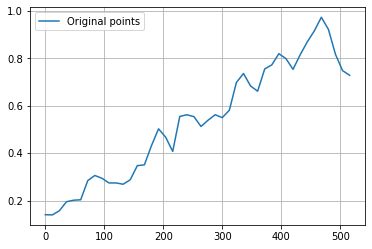

In [ ]:
UNVR_x45 = UNVR_x[0:522:12]
UNVR_y45 = UNVR_y[0:522:12]

plt.plot(UNVR_x45, UNVR_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNVR_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_UNVR_45: [0.14028777 0.13739944 0.13392414 0.20311559 0.20717895 0.17680169
 0.30503873 0.30807936 0.29717622 0.26760425 0.27809024 0.26571826
 0.27234607 0.37151615 0.32432315 0.43550778 0.52357377 0.48638418
 0.3366449  0.61128083 0.54736849 0.57154738 0.490183   0.54326018
 0.5714885  0.54308796 0.55562007 0.72004326 0.75395509 0.68050327
 0.62475124 0.78901694 0.75155509 0.83965477 0.80799129 0.72244483
 0.82381214 0.87079583 0.90523477 1.00107085 0.93130916 0.76551811
 0.72740281 0.72841727 0.         0.         0.         0.        ]
k_UNVR_45: 3



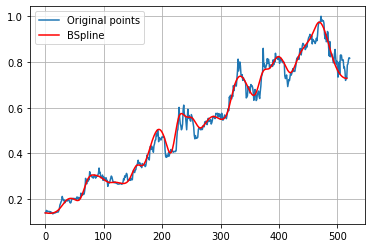

In [ ]:
import scipy.interpolate as interpolate

t_UNVR_45, c_UNVR_45, k_UNVR_45 = interpolate.splrep(UNVR_x45, UNVR_y45, s=0, k=3)
print('''\
t_UNVR_45: {}
c_UNVR_45: {}
k_UNVR_45: {}
'''.format(t_UNVR_45, c_UNVR_45, k_UNVR_45))
N = 522
xmin_UNVR_45, xmax_UNVR_45 = UNVR_x45.min(), UNVR_x45.max()
xx_UNVR_45 = np.linspace(xmin_UNVR_45, xmax_UNVR_45, N)
spline_UNVR_45 = interpolate.BSpline(t_UNVR_45, c_UNVR_45, k_UNVR_45, extrapolate=False)

plt.plot(UNVR_x, UNVR_y, label='Original points')
plt.plot(xx_UNVR_45, spline_UNVR_45(xx_UNVR_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA UNVR**

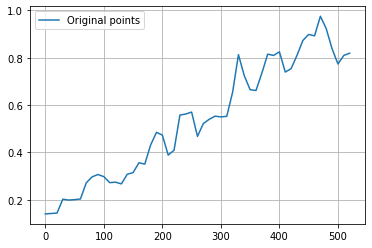

In [ ]:
UNVR_x55 = UNVR_x[0:522:10]
UNVR_y55 = UNVR_y[0:522:10]

plt.plot(UNVR_x55, UNVR_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNVR_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_UNVR_55: [0.14028777 0.16794043 0.09037814 0.2250443  0.1898069  0.20817413
 0.180734   0.28831433 0.29550509 0.31024085 0.30345958 0.26189208
 0.2838642  0.24833456 0.32531553 0.29572708 0.38026537 0.31990209
 0.44444283 0.49225465 0.49481193 0.36662711 0.36961486 0.60994941
 0.53591125 0.61870776 0.41012101 0.54656361 0.53312097 0.5583626
 0.55177397 0.53400197 0.62516778 0.88798876 0.69787719 0.66132983
 0.64421357 0.73034108 0.84269549 0.78736616 0.86395498 0.70465565
 0.75267422 0.80623021 0.87852007 0.91350248 0.85505995 1.0187757
 0.9187581  0.83946527 0.71586109 0.86273043 0.81879496 0.
 0.         0.         0.        ]
k_UNVR_55: 3



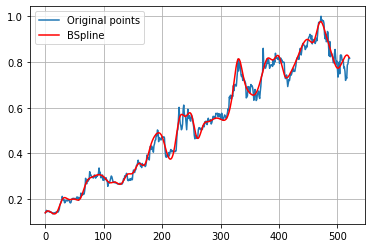

In [ ]:
import scipy.interpolate as interpolate

t_UNVR_55, c_UNVR_55, k_UNVR_55 = interpolate.splrep(UNVR_x55, UNVR_y55, s=0, k=3)
print('''\
t_UNVR_55: {}
c_UNVR_55: {}
k_UNVR_55: {}
'''.format(t_UNVR_55, c_UNVR_55, k_UNVR_55))
N = 522
xmin_UNVR_55, xmax_UNVR_55 = UNVR_x55.min(), UNVR_x55.max()
xx_UNVR_55 = np.linspace(xmin_UNVR_55, xmax_UNVR_55, N)
spline_UNVR_55 = interpolate.BSpline(t_UNVR_55, c_UNVR_55, k_UNVR_55, extrapolate=False)

plt.plot(UNVR_x, UNVR_y, label='Original points')
plt.plot(xx_UNVR_55, spline_UNVR_55(xx_UNVR_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA UNVR**

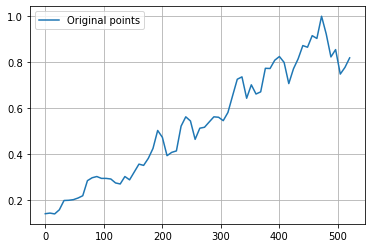

In [ ]:
UNVR_x65 = UNVR_x[0:522:8]
UNVR_y65 = UNVR_y[0:522:8]

plt.plot(UNVR_x65, UNVR_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_UNVR_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_UNVR_65: [0.14028777 0.15050581 0.13109269 0.14950904 0.21051166 0.19549469
 0.19995564 0.21331584 0.19857954 0.30351706 0.29238819 0.30750572
 0.29053856 0.29472853 0.29493581 0.27372966 0.25582902 0.3216593
 0.27048342 0.32302573 0.36906835 0.33739151 0.38568214 0.40764973
 0.53048154 0.48661115 0.36120336 0.42648907 0.37708498 0.54718542
 0.56366975 0.57043776 0.41896772 0.53786403 0.50511572 0.54149325
 0.56632137 0.56552345 0.53309564 0.57457601 0.65421183 0.73123854
 0.77515057 0.5845261  0.7446587  0.64547219 0.6419777  0.81179685
 0.75112268 0.81860454 0.8251786  0.82852278 0.65479504 0.79330427
 0.79878643 0.900039

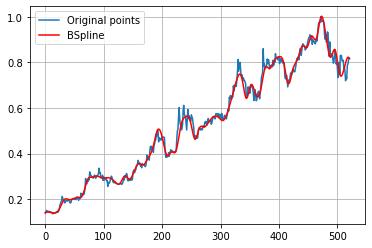

In [ ]:
import scipy.interpolate as interpolate

t_UNVR_65, c_UNVR_65, k_UNVR_65 = interpolate.splrep(UNVR_x65, UNVR_y65, s=0, k=3)
print('''\
t_UNVR_65: {}
c_UNVR_65: {}
k_UNVR_65: {}
'''.format(t_UNVR_65, c_UNVR_65, k_UNVR_65))
N = 522
xmin_UNVR_65, xmax_UNVR_65 = UNVR_x65.min(), UNVR_x65.max()
xx_UNVR_65 = np.linspace(xmin_UNVR_65, xmax_UNVR_65, N)
spline_UNVR_65 = interpolate.BSpline(t_UNVR_65, c_UNVR_65, k_UNVR_65, extrapolate=False)

plt.plot(UNVR_x, UNVR_y, label='Original points')
plt.plot(xx_UNVR_65, spline_UNVR_65(xx_UNVR_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


**RMSE UNVR**

In [ ]:

#RMSE 15 DATA UNVR
y_true_UNVR_15 = UNVR_y.tolist()
y_pred_UNVR_15 = spline_UNVR_15(xx_UNVR_15).tolist()
mse_UNVR_15 = mean_squared_error(y_true_UNVR_15, y_pred_UNVR_15)
rmse_UNVR_15 = np.sqrt(mse_UNVR_15)
print("rmse UNVR 15 =",rmse_UNVR_15)

#RMSE 25 DATA UNVR
y_true_UNVR_25 = UNVR_y.tolist()
y_pred_UNVR_25 = spline_UNVR_25(xx_UNVR_25).tolist()
mse_UNVR_25 = mean_squared_error(y_true_UNVR_25, y_pred_UNVR_25)
rmse_UNVR_25 = np.sqrt(mse_UNVR_25)
print("rmse UNVR 25 =",rmse_UNVR_25)

#RMSE 35 DATA UNVR
y_true_UNVR_35 = UNVR_y.tolist()
y_pred_UNVR_35 = spline_UNVR_35(xx_UNVR_35).tolist()
mse_UNVR_35 = mean_squared_error(y_true_UNVR_35, y_pred_UNVR_35)
rmse_UNVR_35 = np.sqrt(mse_UNVR_35)
print("rmse UNVR 35 =",rmse_UNVR_35)

#RMSE 45 DATA UNVR
y_true_UNVR_45 = UNVR_y.tolist()
y_pred_UNVR_45 = spline_UNVR_45(xx_UNVR_45).tolist()
mse_UNVR_45 = mean_squared_error(y_true_UNVR_45, y_pred_UNVR_45)
rmse_UNVR_45 = np.sqrt(mse_UNVR_45)
print("rmse UNVR 45 =",rmse_UNVR_45)

#RMSE 55 DATA UNVR
y_true_UNVR_55 = UNVR_y.tolist()
y_pred_UNVR_55 = spline_UNVR_55(xx_UNVR_55).tolist()
mse_UNVR_55 = mean_squared_error(y_true_UNVR_55, y_pred_UNVR_55)
rmse_UNVR_55 = np.sqrt(mse_UNVR_55)
print("rmse UNVR 55 =",rmse_UNVR_55)

#RMSE 65 DATA UNVR
y_true_UNVR_65 = UNVR_y.tolist()
y_pred_UNVR_65 = spline_UNVR_65(xx_UNVR_65).tolist()
mse_UNVR_65 = mean_squared_error(y_true_UNVR_65, y_pred_UNVR_65)
rmse_UNVR_65 = np.sqrt(mse_UNVR_65)
print("rmse UNVR 65 =",rmse_UNVR_65)

rmse UNVR 15 = 0.06647941287963038
rmse UNVR 25 = 0.05148630574198355
rmse UNVR 35 = 0.037621815614000985
rmse UNVR 45 = 0.0286425113522955
rmse UNVR 55 = 0.02299678866162358
rmse UNVR 65 = 0.02352070435054685


# **WIKA**

No handles with labels found to put in legend.


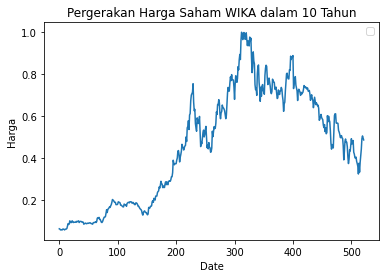

In [ ]:
WIKA = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/WIKA.JK.csv')

WIKA_x = WIKA['No'].values
WIKA_y = WIKA['Skala'].values

plt.plot(WIKA_x,WIKA_y)
plt.title('Pergerakan Harga Saham WIKA dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

**1. PERCOBAAN 15 DATA WIKA**

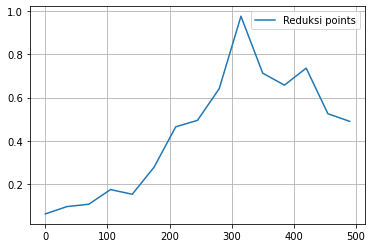

In [ ]:
WIKA_x15 = WIKA_x[0:522:35]
WIKA_y15 = WIKA_y[0:522:35]

plt.plot(WIKA_x15, WIKA_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_WIKA_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_WIKA_15: [0.06114145 0.12999963 0.036876   0.21314192 0.1099682  0.26002862
 0.51296104 0.47617867 0.54970931 1.17280472 0.62047826 0.62516894
 0.89094727 0.29837532 0.49003067 0.         0.         0.
 0.        ]
k_WIKA_15: 3



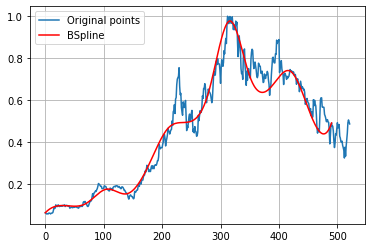

In [ ]:
import scipy.interpolate as interpolate

t_WIKA_15, c_WIKA_15, k_WIKA_15 = interpolate.splrep(WIKA_x15, WIKA_y15, s=0, k=3)
print('''\
t_WIKA_15: {}
c_WIKA_15: {}
k_WIKA_15: {}
'''.format(t_WIKA_15, c_WIKA_15, k_WIKA_15))
N = 522
xmin_WIKA_15, xmax_WIKA_15 = WIKA_x15.min(), WIKA_x15.max()
xx_WIKA_15 = np.linspace(xmin_WIKA_15, xmax_WIKA_15, N)
spline_WIKA_15 = interpolate.BSpline(t_WIKA_15, c_WIKA_15, k_WIKA_15, extrapolate=False)

plt.plot(WIKA_x, WIKA_y, label='Original points')
plt.plot(xx_WIKA_15, spline_WIKA_15(xx_WIKA_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**2. PERCOBAAN 25 DATA WIKA**

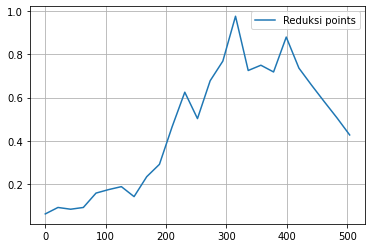

In [ ]:
WIKA_x25 = WIKA_x[0:522:21]
WIKA_y25 = WIKA_y[0:522:21]

plt.plot(WIKA_x25, WIKA_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_WIKA_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_WIKA_25: [0.06114145 0.10324464 0.08563075 0.07150817 0.17806358 0.16189046
 0.21785294 0.09169851 0.26317886 0.25775976 0.45034819 0.72889894
 0.38405827 0.75117988 0.67915176 1.14634782 0.59686342 0.81946686
 0.62526472 0.99196709 0.68947969 0.66919314 0.54689248 0.48690824
 0.42694289 0.         0.         0.         0.        ]
k_WIKA_25: 3



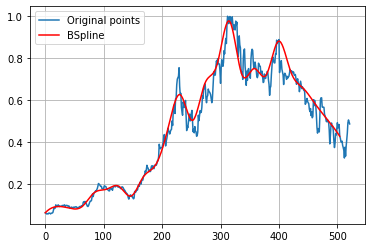

In [ ]:
import scipy.interpolate as interpolate

t_WIKA_25, c_WIKA_25, k_WIKA_25 = interpolate.splrep(WIKA_x25, WIKA_y25, s=0, k=3)
print('''\
t_WIKA_25: {}
c_WIKA_25: {}
k_WIKA_25: {}
'''.format(t_WIKA_25, c_WIKA_25, k_WIKA_25))
N = 522
xmin_WIKA_25, xmax_WIKA_25 = WIKA_x25.min(), WIKA_x25.max()
xx_WIKA_25 = np.linspace(xmin_WIKA_25, xmax_WIKA_25, N)
spline_WIKA_25 = interpolate.BSpline(t_WIKA_25, c_WIKA_25, k_WIKA_25, extrapolate=False)

plt.plot(WIKA_x, WIKA_y, label='Original points')
plt.plot(xx_WIKA_25, spline_WIKA_25(xx_WIKA_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**3. PERCOBAAN 30 DATA WIKA**

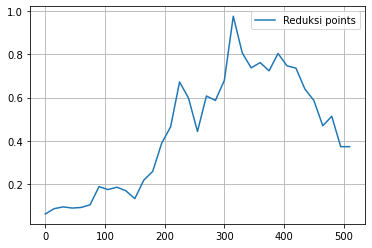

In [ ]:
WIKA_x35 = WIKA_x[0:522:15]
WIKA_y35 = WIKA_y[0:522:15]

plt.plot(WIKA_x35, WIKA_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_WIKA_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_WIKA_35: [0.06114145 0.08139522 0.10215507 0.08385953 0.09687228 0.07484771
 0.22330228 0.15694387 0.19240059 0.18214958 0.08987159 0.24912565
 0.21797421 0.42789112 0.40199208 0.75219201 0.62456329 0.33650888
 0.68701065 0.55946334 0.59687774 1.12910656 0.74810249 0.72087842
 0.7950158  0.6724352  0.86035999 0.71221671 0.77446569 0.60899953
 0.62762073 0.40169604 0.64281852 0.20236604 0.37265805 0.
 0.         0.         0.        ]
k_WIKA_35: 3



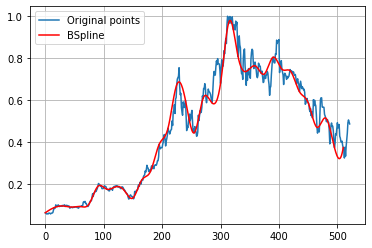

In [ ]:
import scipy.interpolate as interpolate

t_WIKA_35, c_WIKA_35, k_WIKA_35 = interpolate.splrep(WIKA_x35, WIKA_y35, s=0, k=3)
print('''\
t_WIKA_35: {}
c_WIKA_35: {}
k_WIKA_35: {}
'''.format(t_WIKA_35, c_WIKA_35, k_WIKA_35))
N = 522
xmin_WIKA_35, xmax_WIKA_35 = WIKA_x35.min(), WIKA_x35.max()
xx_WIKA_35 = np.linspace(xmin_WIKA_35, xmax_WIKA_35, N)
spline_WIKA_35 = interpolate.BSpline(t_WIKA_35, c_WIKA_35, k_WIKA_35, extrapolate=False)

plt.plot(WIKA_x, WIKA_y, label='Original points')
plt.plot(xx_WIKA_35, spline_WIKA_35(xx_WIKA_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**4. PERCOBAAN 40 DATA WIKA**

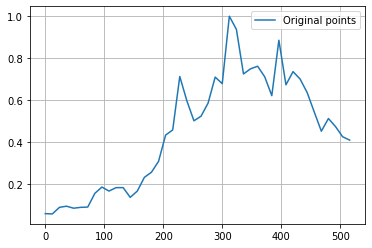

In [ ]:
WIKA_x45 = WIKA_x[0:522:12]
WIKA_y45 = WIKA_y[0:522:12]

plt.plot(WIKA_x45, WIKA_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_WIKA_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_WIKA_45: [0.06114145 0.03287997 0.09728323 0.09999948 0.08084407 0.09836252
 0.07190223 0.16837648 0.20024482 0.15564499 0.18804575 0.20086785
 0.11717867 0.16193847 0.24593794 0.25648348 0.27704175 0.49403874
 0.35550353 0.83937502 0.56688309 0.48004669 0.52924204 0.54972141
 0.7936141  0.5394058  1.12484357 0.96121991 0.65527129 0.77096331
 0.76087107 0.75892926 0.47514727 1.0741808  0.54334844 0.79590016
 0.69212992 0.64338846 0.5547949  0.40332498 0.55201557 0.44218671
 0.41125161 0.41080416 0.         0.         0.         0.        ]
k_WIKA_45: 3



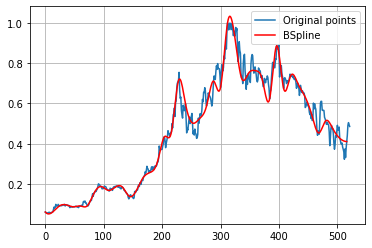

In [ ]:
import scipy.interpolate as interpolate

t_WIKA_45, c_WIKA_45, k_WIKA_45 = interpolate.splrep(WIKA_x45, WIKA_y45, s=0, k=3)
print('''\
t_WIKA_45: {}
c_WIKA_45: {}
k_WIKA_45: {}
'''.format(t_WIKA_45, c_WIKA_45, k_WIKA_45))
N = 522
xmin_WIKA_45, xmax_WIKA_45 = WIKA_x45.min(), WIKA_x45.max()
xx_WIKA_45 = np.linspace(xmin_WIKA_45, xmax_WIKA_45, N)
spline_WIKA_45 = interpolate.BSpline(t_WIKA_45, c_WIKA_45, k_WIKA_45, extrapolate=False)

plt.plot(WIKA_x, WIKA_y, label='Original points')
plt.plot(xx_WIKA_45, spline_WIKA_45(xx_WIKA_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 55 DATA WIKA**

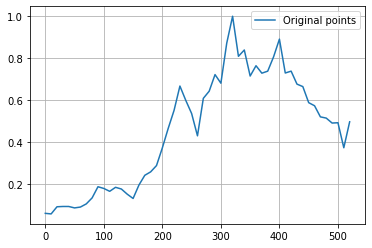

In [ ]:
WIKA_x55 = WIKA_x[0:522:10]
WIKA_y55 = WIKA_y[0:522:10]

plt.plot(WIKA_x55, WIKA_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_WIKA_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_WIKA_55: [0.06114145 0.02501465 0.10690023 0.09066868 0.09698237 0.0839013
 0.0891507  0.10569227 0.12395048 0.20557049 0.1787683  0.15544256
 0.19402715 0.17714464 0.15717746 0.10718887 0.20482865 0.2474099
 0.25661822 0.27503086 0.37151964 0.4725853  0.5261906  0.72428536
 0.57123344 0.57773493 0.3297754  0.67925754 0.59720925 0.77972612
 0.60453088 0.87823122 1.0999271  0.70575733 0.91943856 0.63823484
 0.80750879 0.70510684 0.73348354 0.77943921 0.9748515  0.65267675
 0.78070279 0.64359106 0.69428823 0.55818772 0.59413937 0.49840379
 0.5284884  0.46867378 0.55977606 0.2185788  0.4958993  0.
 0.         0.         0.        ]
k_WIKA_55: 3



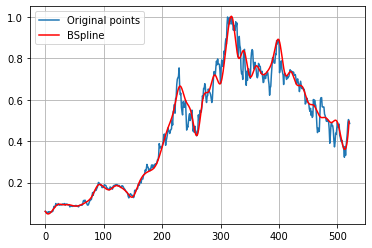

In [ ]:
import scipy.interpolate as interpolate

t_WIKA_55, c_WIKA_55, k_WIKA_55 = interpolate.splrep(WIKA_x55, WIKA_y55, s=0, k=3)
print('''\
t_WIKA_55: {}
c_WIKA_55: {}
k_WIKA_55: {}
'''.format(t_WIKA_55, c_WIKA_55, k_WIKA_55))
N = 522
xmin_WIKA_55, xmax_WIKA_55 = WIKA_x55.min(), WIKA_x55.max()
xx_WIKA_55 = np.linspace(xmin_WIKA_55, xmax_WIKA_55, N)
spline_WIKA_55 = interpolate.BSpline(t_WIKA_55, c_WIKA_55, k_WIKA_55, extrapolate=False)

plt.plot(WIKA_x, WIKA_y, label='Original points')
plt.plot(xx_WIKA_55, spline_WIKA_55(xx_WIKA_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**5. PERCOBAAN 65 DATA WIKA**

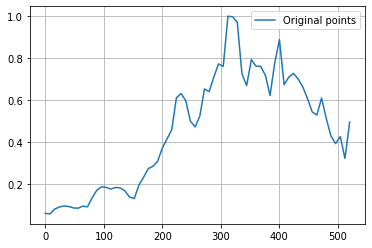

In [ ]:
WIKA_x65 = WIKA_x[0:522:8]
WIKA_y65 = WIKA_y[0:522:8]

plt.plot(WIKA_x65, WIKA_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_WIKA_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_WIKA_65: [0.06114145 0.03880735 0.08474964 0.09038002 0.09851905 0.09434806
 0.08658816 0.08103757 0.10284836 0.07822177 0.13861249 0.17439297
 0.19098921 0.18665091 0.17110297 0.18872037 0.18271137 0.17282517
 0.13685846 0.11126199 0.20885519 0.22723063 0.28439599 0.28192435
 0.2998631  0.37731247 0.42458174 0.41892187 0.65515869 0.62893022
 0.61988053 0.4785017  0.46612146 0.49397312 0.7047223  0.60833956
 0.70974011 0.81628362 0.66371455 1.09408368 0.95995073 1.04981033
 0.66960826 0.62502499 0.84931212 0.73858852 0.76971066 0.74779438
 0.55160468 0.77948603 0.99349514 0.5780554  0.73775799 0.7315386
 0.7023489  0.666874

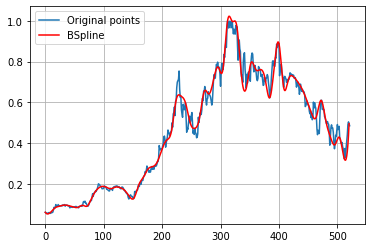

In [ ]:
import scipy.interpolate as interpolate

t_WIKA_65, c_WIKA_65, k_WIKA_65 = interpolate.splrep(WIKA_x65, WIKA_y65, s=0, k=3)
print('''\
t_WIKA_65: {}
c_WIKA_65: {}
k_WIKA_65: {}
'''.format(t_WIKA_65, c_WIKA_65, k_WIKA_65))
N = 522
xmin_WIKA_65, xmax_WIKA_65 = WIKA_x65.min(), WIKA_x65.max()
xx_WIKA_65 = np.linspace(xmin_WIKA_65, xmax_WIKA_65, N)
spline_WIKA_65 = interpolate.BSpline(t_WIKA_65, c_WIKA_65, k_WIKA_65, extrapolate=False)

plt.plot(WIKA_x, WIKA_y, label='Original points')
plt.plot(xx_WIKA_65, spline_WIKA_65(xx_WIKA_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

**RMSE WIKA**

In [ ]:

#RMSE 15 DATA WIKA
y_true_WIKA_15 = WIKA_y.tolist()
y_pred_WIKA_15 = spline_WIKA_15(xx_WIKA_15).tolist()
mse_WIKA_15 = mean_squared_error(y_true_WIKA_15, y_pred_WIKA_15)
rmse_WIKA_15 = np.sqrt(mse_WIKA_15)
print("rmse WIKA 15 =",rmse_WIKA_15)

#RMSE 25 DATA WIKA
y_true_WIKA_25 = WIKA_y.tolist()
y_pred_WIKA_25 = spline_WIKA_25(xx_WIKA_25).tolist()
mse_WIKA_25 = mean_squared_error(y_true_WIKA_25, y_pred_WIKA_25)
rmse_WIKA_25 = np.sqrt(mse_WIKA_25)
print("rmse WIKA 25 =",rmse_WIKA_25)

#RMSE 35 DATA WIKA
y_true_WIKA_35 = WIKA_y.tolist()
y_pred_WIKA_35 = spline_WIKA_35(xx_WIKA_35).tolist()
mse_WIKA_35 = mean_squared_error(y_true_WIKA_35, y_pred_WIKA_35)
rmse_WIKA_35 = np.sqrt(mse_WIKA_35)
print("rmse WIKA 35 =",rmse_WIKA_35)

#RMSE 45 DATA WIKA
y_true_WIKA_45 = WIKA_y.tolist()
y_pred_WIKA_45 = spline_WIKA_45(xx_WIKA_45).tolist()
mse_WIKA_45 = mean_squared_error(y_true_WIKA_45, y_pred_WIKA_45)
rmse_WIKA_45 = np.sqrt(mse_WIKA_45)
print("rmse WIKA 45 =",rmse_WIKA_45)

#RMSE 55 DATA WIKA
y_true_WIKA_55 = WIKA_y.tolist()
y_pred_WIKA_55 = spline_WIKA_55(xx_WIKA_55).tolist()
mse_WIKA_55 = mean_squared_error(y_true_WIKA_55, y_pred_WIKA_55)
rmse_WIKA_55 = np.sqrt(mse_WIKA_55)
print("rmse WIKA 55 =",rmse_WIKA_55)

#RMSE 65 DATA WIKA
y_true_WIKA_65 = WIKA_y.tolist()
y_pred_WIKA_65 = spline_WIKA_65(xx_WIKA_65).tolist()
mse_WIKA_65 = mean_squared_error(y_true_WIKA_65, y_pred_WIKA_65)
rmse_WIKA_65 = np.sqrt(mse_WIKA_65)
print("rmse WIKA 65 =",rmse_WIKA_65)


rmse WIKA 15 = 0.0854699197923087
rmse WIKA 25 = 0.06286196323055347
rmse WIKA 35 = 0.05704264062105036
rmse WIKA 45 = 0.04826548332075244
rmse WIKA 55 = 0.04086056397484346
rmse WIKA 65 = 0.037329935903717255


# **GJTL**

No handles with labels found to put in legend.


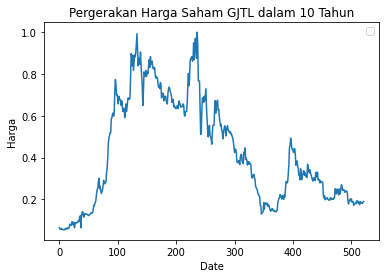

In [ ]:
GJTL = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/_GJTL.JK.csv')

GJTL_x = GJTL['No'].values
GJTL_y = GJTL['Skala'].values

plt.plot(GJTL_x,GJTL_y)
plt.title('Pergerakan Harga Saham GJTL dalam 10 Tahun')
plt.xlabel('Date')
plt.ylabel('Harga')
plt.legend(loc='best')
plt.show()

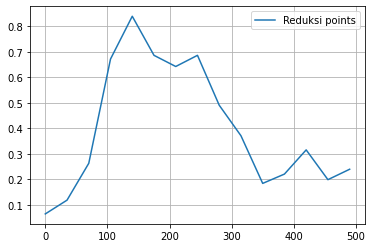

In [ ]:
GJTL_x15 = GJTL_x[0:522:35]
GJTL_y15 = GJTL_y[0:522:35]

plt.plot(GJTL_x15, GJTL_y15, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GJTL_15: [  0.   0.   0.   0.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385.
 420. 490. 490. 490. 490.]
c_GJTL_15: [0.06423358 0.15333347 0.00282211 0.73250649 0.91392792 0.64827818
 0.60974767 0.76674573 0.44005773 0.41608903 0.12040368 0.20594588
 0.43593876 0.04042478 0.23941606 0.         0.         0.
 0.        ]
k_GJTL_15: 3



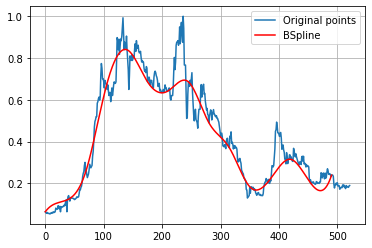

In [ ]:
import scipy.interpolate as interpolate

t_GJTL_15, c_GJTL_15, k_GJTL_15 = interpolate.splrep(GJTL_x15, GJTL_y15, s=0, k=3)
print('''\
t_GJTL_15: {}
c_GJTL_15: {}
k_GJTL_15: {}
'''.format(t_GJTL_15, c_GJTL_15, k_GJTL_15))
N = 522
xmin_GJTL_15, xmax_GJTL_15 = GJTL_x15.min(), GJTL_x15.max()
xx_GJTL_15 = np.linspace(xmin_GJTL_15, xmax_GJTL_15, N)
spline_GJTL_15 = interpolate.BSpline(t_GJTL_15, c_GJTL_15, k_GJTL_15, extrapolate=False)

plt.plot(GJTL_x, GJTL_y, label='Original points')
plt.plot(xx_GJTL_15, spline_GJTL_15(xx_GJTL_15), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

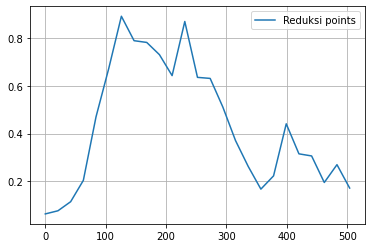

In [ ]:
GJTL_x25 = GJTL_x[0:522:21]
GJTL_y25 = GJTL_y[0:522:21]

plt.plot(GJTL_x25, GJTL_y25, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GJTL_25: [  0.   0.   0.   0.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231.
 252. 273. 294. 315. 336. 357. 378. 399. 420. 441. 462. 504. 504. 504.
 504.]
c_GJTL_25: [0.06423358 0.0566656  0.10637683 0.14980216 0.50983559 0.63129345
 0.99418768 0.73502152 0.79565325 0.76849688 0.50992129 1.04583258
 0.51842723 0.69067746 0.50280453 0.36379785 0.26682161 0.14555807
 0.15824539 0.56160635 0.24058467 0.36802576 0.04629589 0.42502724
 0.17226277 0.         0.         0.         0.        ]
k_GJTL_25: 3



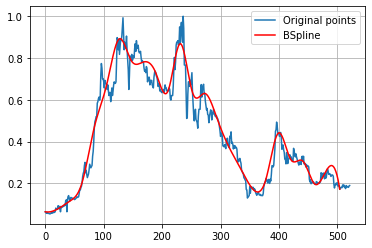

In [ ]:
import scipy.interpolate as interpolate

t_GJTL_25, c_GJTL_25, k_GJTL_25 = interpolate.splrep(GJTL_x25, GJTL_y25, s=0, k=3)
print('''\
t_GJTL_25: {}
c_GJTL_25: {}
k_GJTL_25: {}
'''.format(t_GJTL_25, c_GJTL_25, k_GJTL_25))
N = 522
xmin_GJTL_25, xmax_GJTL_25 = GJTL_x25.min(), GJTL_x25.max()
xx_GJTL_25 = np.linspace(xmin_GJTL_25, xmax_GJTL_25, N)
spline_GJTL_25 = interpolate.BSpline(t_GJTL_25, c_GJTL_25, k_GJTL_25, extrapolate=False)

plt.plot(GJTL_x, GJTL_y, label='Original points')
plt.plot(xx_GJTL_25, spline_GJTL_25(xx_GJTL_25), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


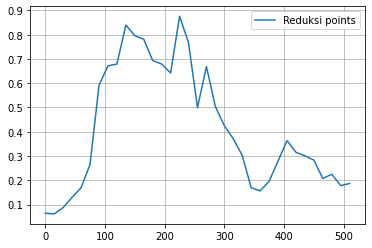

In [ ]:
GJTL_x35 = GJTL_x[0:522:15]
GJTL_y35 = GJTL_y[0:522:15]

plt.plot(GJTL_x35, GJTL_y35, label='Reduksi points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GJTL_35: [  0.   0.   0.   0.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165.
 180. 195. 210. 225. 240. 255. 270. 285. 300. 315. 330. 345. 360. 375.
 390. 405. 420. 435. 450. 465. 480. 510. 510. 510. 510.]
c_GJTL_35: [0.06423358 0.04984211 0.06965885 0.1300616  0.17455612 0.18777233
 0.66851515 0.68561233 0.6182326  0.91444997 0.76046385 0.81741724
 0.65599856 0.71917244 0.54030437 0.97362468 0.82067136 0.34223001
 0.80602904 0.44533268 0.43453807 0.36542016 0.32859883 0.13332323
 0.15416666 0.18723642 0.27061027 0.40331519 0.29715088 0.3000521
 0.30702028 0.17113685 0.27925832 0.11365551 0.18686131 0.
 0.         0.         0.        ]
k_GJTL_35: 3



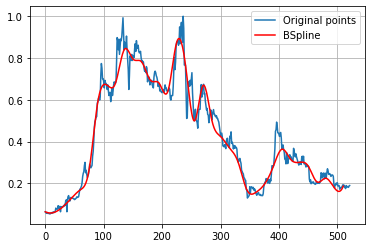

In [ ]:
import scipy.interpolate as interpolate

t_GJTL_35, c_GJTL_35, k_GJTL_35 = interpolate.splrep(GJTL_x35, GJTL_y35, s=0, k=3)
print('''\
t_GJTL_35: {}
c_GJTL_35: {}
k_GJTL_35: {}
'''.format(t_GJTL_35, c_GJTL_35, k_GJTL_35))
N = 522
xmin_GJTL_35, xmax_GJTL_35 = GJTL_x35.min(), GJTL_x35.max()
xx_GJTL_35 = np.linspace(xmin_GJTL_35, xmax_GJTL_35, N)
spline_GJTL_35 = interpolate.BSpline(t_GJTL_35, c_GJTL_35, k_GJTL_35, extrapolate=False)

plt.plot(GJTL_x, GJTL_y, label='Original points')
plt.plot(xx_GJTL_35, spline_GJTL_35(xx_GJTL_35), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

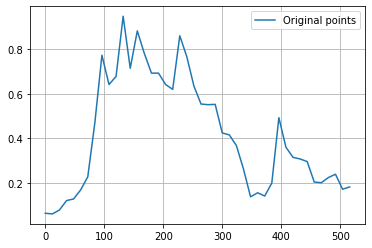

In [ ]:
GJTL_x45 = GJTL_x[0:522:12]
GJTL_y45 = GJTL_y[0:522:12]

plt.plot(GJTL_x45, GJTL_y45, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GJTL_45: [  0.   0.   0.   0.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132.
 144. 156. 168. 180. 192. 204. 216. 228. 240. 252. 264. 276. 288. 300.
 312. 324. 336. 348. 360. 372. 384. 396. 408. 420. 432. 444. 456. 468.
 480. 492. 516. 516. 516. 516.]
c_GJTL_45: [0.06423358 0.06292588 0.04787087 0.13573627 0.114225   0.17816667
 0.18916674 0.43158974 0.90491228 0.59109692 0.58471464 1.14303723
 0.5365671  1.00266517 0.7520423  0.67529702 0.70735356 0.65587268
 0.52317032 0.97407379 0.74841772 0.63079546 0.53861939 0.54319411
 0.59955306 0.37830167 0.43614536 0.37346725 0.27728492 0.0940354
 0.17518662 0.1424444  0.10467081 0.63887236 0.30042371 0.32293646
 0.29980127 0.32603366 0.17416628 0.20357859 0.22027847 0.27885733
 0.09962243 0.18248175 0.         0.         0.         0.        ]
k_GJTL_45: 3



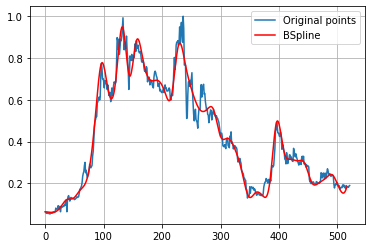

In [ ]:
import scipy.interpolate as interpolate

t_GJTL_45, c_GJTL_45, k_GJTL_45 = interpolate.splrep(GJTL_x45, GJTL_y45, s=0, k=3)
print('''\
t_GJTL_45: {}
c_GJTL_45: {}
k_GJTL_45: {}
'''.format(t_GJTL_45, c_GJTL_45, k_GJTL_45))
N = 522
xmin_GJTL_45, xmax_GJTL_45 = GJTL_x45.min(), GJTL_x45.max()
xx_GJTL_45 = np.linspace(xmin_GJTL_45, xmax_GJTL_45, N)
spline_GJTL_45 = interpolate.BSpline(t_GJTL_45, c_GJTL_45, k_GJTL_45, extrapolate=False)

plt.plot(GJTL_x, GJTL_y, label='Original points')
plt.plot(xx_GJTL_45, spline_GJTL_45(xx_GJTL_45), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()


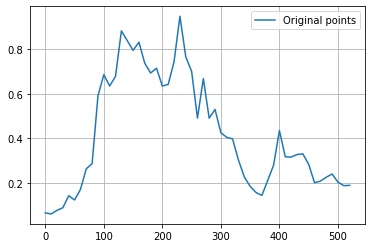

In [ ]:
GJTL_x55 = GJTL_x[0:522:10]
GJTL_y55 = GJTL_y[0:522:10]

plt.plot(GJTL_x55, GJTL_y55, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GJTL_55: [  0.   0.   0.   0.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110.
 120. 130. 140. 150. 160. 170. 180. 190. 200. 210. 220. 230. 240. 250.
 260. 270. 280. 290. 300. 310. 320. 330. 340. 350. 360. 370. 380. 390.
 400. 410. 420. 430. 440. 450. 460. 470. 480. 490. 500. 520. 520. 520.
 520.]
c_GJTL_55: [0.06423358 0.04096508 0.0874129  0.06839403 0.16931315 0.10398841
 0.15049963 0.31007147 0.18585683 0.66328952 0.70843033 0.61977748
 0.62267873 0.9625003  0.82659014 0.76763548 0.87659058 0.71870294
 0.67195532 0.75405973 0.60377658 0.64105292 0.68602634 1.08199501
 0.67942426 0.7988481  0.32956291 0.82596597 0.37825204 0.60409156
 0.38494375 0.40503853 0.4211795  0.29272521 0.22105836 0.18070558
 0.15976894 0.11744493 0.22884548 0.22848702 0.53019914 0.26093541
 0.32678917 0.32387873 0.3397397  0.29672452 0.17263229 0.21274631
 0.22017809 0.25544643 0.17422793 0.18879844 0.18832117 0.
 0.         0.         0.        ]
k_GJTL_55: 3



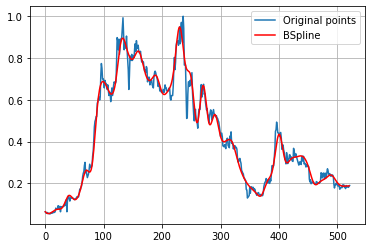

In [ ]:
import scipy.interpolate as interpolate

t_GJTL_55, c_GJTL_55, k_GJTL_55 = interpolate.splrep(GJTL_x55, GJTL_y55, s=0, k=3)
print('''\
t_GJTL_55: {}
c_GJTL_55: {}
k_GJTL_55: {}
'''.format(t_GJTL_55, c_GJTL_55, k_GJTL_55))
N = 522
xmin_GJTL_55, xmax_GJTL_55 = GJTL_x55.min(), GJTL_x55.max()
xx_GJTL_55 = np.linspace(xmin_GJTL_55, xmax_GJTL_55, N)
spline_GJTL_55 = interpolate.BSpline(t_GJTL_55, c_GJTL_55, k_GJTL_55, extrapolate=False)

plt.plot(GJTL_x, GJTL_y, label='Original points')
plt.plot(xx_GJTL_55, spline_GJTL_55(xx_GJTL_55), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

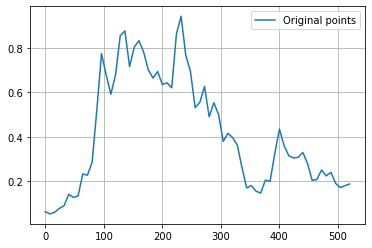

In [ ]:
GJTL_x65 = GJTL_x[0:522:8]
GJTL_y65 = GJTL_y[0:522:8]

plt.plot(GJTL_x65, GJTL_y65, label='Original points')
plt.grid()
plt.legend(loc='best')
plt.show()

t_GJTL_65: [  0.   0.   0.   0.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.
  96. 104. 112. 120. 128. 136. 144. 152. 160. 168. 176. 184. 192. 200.
 208. 216. 224. 232. 240. 248. 256. 264. 272. 280. 288. 296. 304. 312.
 320. 328. 336. 344. 352. 360. 368. 376. 384. 392. 400. 408. 416. 424.
 432. 440. 448. 456. 464. 472. 480. 488. 496. 504. 520. 520. 520. 520.]
c_GJTL_65: [0.06423358 0.05228192 0.04872084 0.08531291 0.07387222 0.16226389
 0.12670725 0.10171004 0.27229202 0.21058175 0.25180434 0.4989892
 0.87048703 0.66139845 0.55691186 0.65839937 0.88248337 0.93575476
 0.62997205 0.83632783 0.84223488 0.78743338 0.694163   0.6402942
 0.73006166 0.6000431  0.67998493 0.53403179 0.90651566 1.00778879
 0.71196423 0.74289444 0.47704194 0.53725897 0.70238933 0.41084795
 0.59728458 0.51972176 0.32820795 0.44481869 0.38886765 0.38219247
 0.26338437 0.14091239 0.19778358 0.15408466 0.12310406 0.23817062
 0.15924996 0.32482954 0.48595744 0.34155969 0.31130747 0.30518125
 0.29862445 0.3484961

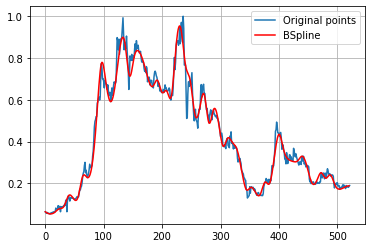

In [ ]:
import scipy.interpolate as interpolate

t_GJTL_65, c_GJTL_65, k_GJTL_65 = interpolate.splrep(GJTL_x65, GJTL_y65, s=0, k=3)
print('''\
t_GJTL_65: {}
c_GJTL_65: {}
k_GJTL_65: {}
'''.format(t_GJTL_65, c_GJTL_65, k_GJTL_65))
N = 522
xmin_GJTL_65, xmax_GJTL_65 = GJTL_x65.min(), GJTL_x65.max()
xx_GJTL_65 = np.linspace(xmin_GJTL_65, xmax_GJTL_65, N)
spline_GJTL_65 = interpolate.BSpline(t_GJTL_65, c_GJTL_65, k_GJTL_65, extrapolate=False)

plt.plot(GJTL_x, GJTL_y, label='Original points')
plt.plot(xx_GJTL_65, spline_GJTL_65(xx_GJTL_65), 'r', label='BSpline')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:

#RMSE 15 DATA GJTL
y_true_GJTL_15 = GJTL_y.tolist()
y_pred_GJTL_15 = spline_GJTL_15(xx_GJTL_15).tolist()
mse_GJTL_15 = mean_squared_error(y_true_GJTL_15, y_pred_GJTL_15)
rmse_GJTL_15 = np.sqrt(mse_GJTL_15)
print("rmse GJTL 15 =",rmse_GJTL_15)

#RMSE 25 DATA GJTL
y_true_GJTL_25 = GJTL_y.tolist()
y_pred_GJTL_25 = spline_GJTL_25(xx_GJTL_25).tolist()
mse_GJTL_25 = mean_squared_error(y_true_GJTL_25, y_pred_GJTL_25)
rmse_GJTL_25 = np.sqrt(mse_GJTL_25)
print("rmse GJTL 25 =",rmse_GJTL_25)

#RMSE 35 DATA GJTL
y_true_GJTL_35 = GJTL_y.tolist()
y_pred_GJTL_35 = spline_GJTL_35(xx_GJTL_35).tolist()
mse_GJTL_35 = mean_squared_error(y_true_GJTL_35, y_pred_GJTL_35)
rmse_GJTL_35 = np.sqrt(mse_GJTL_35)
print("rmse GJTL 35 =",rmse_GJTL_35)

#RMSE 45 DATA GJTL
y_true_GJTL_45 = GJTL_y.tolist()
y_pred_GJTL_45 = spline_GJTL_45(xx_GJTL_45).tolist()
mse_GJTL_45 = mean_squared_error(y_true_GJTL_45, y_pred_GJTL_45)
rmse_GJTL_45 = np.sqrt(mse_GJTL_45)
print("rmse GJTL 45 =",rmse_GJTL_45)

#RMSE 55 DATA GJTL
y_true_GJTL_55 = GJTL_y.tolist()
y_pred_GJTL_55 = spline_GJTL_55(xx_GJTL_55).tolist()
mse_GJTL_55 = mean_squared_error(y_true_GJTL_55, y_pred_GJTL_55)
rmse_GJTL_55 = np.sqrt(mse_GJTL_55)
print("rmse GJTL 55 =",rmse_GJTL_55)

#RMSE 65 DATA GJTL
y_true_GJTL_65 = GJTL_y.tolist()
y_pred_GJTL_65 = spline_GJTL_65(xx_GJTL_65).tolist()
mse_GJTL_65 = mean_squared_error(y_true_GJTL_65, y_pred_GJTL_65)
rmse_GJTL_65 = np.sqrt(mse_GJTL_65)
print("rmse GJTL 65 =",rmse_GJTL_65)

rmse GJTL 15 = 0.08936557764578316
rmse GJTL 25 = 0.07603283176558634
rmse GJTL 35 = 0.05805879123980758
rmse GJTL 45 = 0.04675032318727635
rmse GJTL 55 = 0.03532820891866697
rmse GJTL 65 = 0.034938243580894326


# **ANALISIS RMSE**

**RESULT RMSE 15 TITIK DATA**

In [ ]:
RMSE_15Data = np.asarray([rmse_GJTL_15, rmse_AALI_15, rmse_ACES_15, rmse_ADHI_15, rmse_ADRO_15, rmse_AGRO_15, rmse_AKRA_15, rmse_ANTM_15, rmse_ASII_15, rmse_ASRI_15, rmse_BBCA_15, rmse_BBKP_15, rmse_BBNI_15, rmse_BBRI_15, rmse_BDMN_15, rmse_BKSL_15, rmse_BMRI_15, rmse_BNGA_15,rmse_BRPT_15, rmse_BSDE_15, rmse_BTPN_15, rmse_BUMI_15, rmse_CPIN_15, rmse_CTRA_15, rmse_DOID_15, rmse_ELSA_15, rmse_EXCL_15, rmse_GGRM_15, rmse_HMSP_15, rmse_ICBP_15, rmse_IMAS_15, rmse_INCO_15, rmse_INDF_15, rmse_INDY_15, rmse_INKP_15, rmse_INTP_15, rmse_ISAT_15, rmse_JPFA_15, rmse_JSMR_15, rmse_KLBF_15,rmse_LPKR_15, rmse_LPPF_15, rmse_LSIP_15, rmse_MAIN_15, rmse_MAPI_15, rmse_MNCN_15, rmse_PBRX_15, rmse_PGAS_15, rmse_PNBN_15, rmse_PTBA_15, rmse_PTRO_15, rmse_PWON_15, rmse_RALS_15, rmse_SCMA_15, rmse_SMGR_15, rmse_SMRA_15,rmse_SMSM_15, rmse_SSIA_15, rmse_TBLA_15, rmse_TINS_15, rmse_TKIM_15, rmse_TPIA_15, rmse_UNTR_15, rmse_UNVR_15, rmse_WIKA_15, ])
np.savetxt("RMSE_15Data.csv", RMSE_15Data, delimiter=",")
files.download("RMSE_15Data.csv")

**RESULT RMSE 25 TITIK DATA**

In [ ]:
RMSE_25Data = np.asarray([rmse_GJTL_25, rmse_AALI_25, rmse_ACES_25, rmse_ADHI_25, rmse_ADRO_25, rmse_AGRO_25, rmse_AKRA_25, rmse_ANTM_25, rmse_ASII_25, rmse_ASRI_25, rmse_BBCA_25, rmse_BBKP_25, rmse_BBNI_25, rmse_BBRI_25, rmse_BDMN_25, rmse_BKSL_25, rmse_BMRI_25, rmse_BNGA_25,rmse_BRPT_25, rmse_BSDE_25, rmse_BTPN_25, rmse_BUMI_25, rmse_CPIN_25, rmse_CTRA_25, rmse_DOID_25, rmse_ELSA_25, rmse_EXCL_25, rmse_GGRM_25, rmse_HMSP_25, rmse_ICBP_25, rmse_IMAS_25, rmse_INCO_25, rmse_INDF_25, rmse_INDY_25, rmse_INKP_25, rmse_INTP_25, rmse_ISAT_25, rmse_JPFA_25, rmse_JSMR_25, rmse_KLBF_25,rmse_LPKR_25, rmse_LPPF_25, rmse_LSIP_25, rmse_MAIN_25, rmse_MAPI_25, rmse_MNCN_25, rmse_PBRX_25, rmse_PGAS_25, rmse_PNBN_25, rmse_PTBA_25, rmse_PTRO_25, rmse_PWON_25, rmse_RALS_25, rmse_SCMA_25, rmse_SMGR_25, rmse_SMRA_25,rmse_SMSM_25, rmse_SSIA_25, rmse_TBLA_25, rmse_TINS_25, rmse_TKIM_25, rmse_TPIA_25, rmse_UNTR_25, rmse_UNVR_25, rmse_WIKA_25, ])
np.savetxt("RMSE_25Data.csv", RMSE_25Data, delimiter=",")
files.download("RMSE_25Data.csv")

**RESULT RMSE 30 TITIK DATA**

In [ ]:
RMSE_35Data = np.asarray([rmse_GJTL_35, rmse_AALI_35, rmse_ACES_35, rmse_ADHI_35, rmse_ADRO_35, rmse_AGRO_35, rmse_AKRA_35, rmse_ANTM_35, rmse_ASII_35, rmse_ASRI_35, rmse_BBCA_35, rmse_BBKP_35, rmse_BBNI_35, rmse_BBRI_35, rmse_BDMN_35, rmse_BKSL_35, rmse_BMRI_35, rmse_BNGA_35,rmse_BRPT_35, rmse_BSDE_35, rmse_BTPN_35, rmse_BUMI_35, rmse_CPIN_35, rmse_CTRA_35, rmse_DOID_35, rmse_ELSA_35, rmse_EXCL_35, rmse_GGRM_35, rmse_HMSP_35, rmse_ICBP_35, rmse_IMAS_35, rmse_INCO_35, rmse_INDF_35, rmse_INDY_35, rmse_INKP_35, rmse_INTP_35, rmse_ISAT_35, rmse_JPFA_35, rmse_JSMR_35, rmse_KLBF_35,rmse_LPKR_35, rmse_LPPF_35, rmse_LSIP_35, rmse_MAIN_35, rmse_MAPI_35, rmse_MNCN_35, rmse_PBRX_35, rmse_PGAS_35, rmse_PNBN_35, rmse_PTBA_35, rmse_PTRO_35, rmse_PWON_35, rmse_RALS_35, rmse_SCMA_35, rmse_SMGR_35, rmse_SMRA_35,rmse_SMSM_35, rmse_SSIA_35, rmse_TBLA_35, rmse_TINS_35, rmse_TKIM_35, rmse_TPIA_35, rmse_UNTR_35, rmse_UNVR_35, rmse_WIKA_35, ])
np.savetxt("RMSE_35Data.csv", RMSE_35Data, delimiter=",")
files.download("RMSE_35Data.csv")

**RESULT RMSE 40 TITIK DATA**

In [ ]:
RMSE_45Data = np.asarray([rmse_GJTL_45, rmse_AALI_45, rmse_ACES_45, rmse_ADHI_45, rmse_ADRO_45, rmse_AGRO_45, rmse_AKRA_45, rmse_ANTM_45, rmse_ASII_45, rmse_ASRI_45, rmse_BBCA_45, rmse_BBKP_45, rmse_BBNI_45, rmse_BBRI_45, rmse_BDMN_45, rmse_BKSL_45, rmse_BMRI_45, rmse_BNGA_45,rmse_BRPT_45, rmse_BSDE_45, rmse_BTPN_45, rmse_BUMI_45, rmse_CPIN_45, rmse_CTRA_45, rmse_DOID_45, rmse_ELSA_45, rmse_EXCL_45, rmse_GGRM_45, rmse_HMSP_45, rmse_ICBP_45, rmse_IMAS_45, rmse_INCO_45, rmse_INDF_45, rmse_INDY_45, rmse_INKP_45, rmse_INTP_45, rmse_ISAT_45, rmse_JPFA_45, rmse_JSMR_45, rmse_KLBF_45,rmse_LPKR_45, rmse_LPPF_45, rmse_LSIP_45, rmse_MAIN_45, rmse_MAPI_45, rmse_MNCN_45, rmse_PBRX_45, rmse_PGAS_45, rmse_PNBN_45, rmse_PTBA_45, rmse_PTRO_45, rmse_PWON_45, rmse_RALS_45, rmse_SCMA_45, rmse_SMGR_45, rmse_SMRA_45,rmse_SMSM_45, rmse_SSIA_45, rmse_TBLA_45, rmse_TINS_45, rmse_TKIM_45, rmse_TPIA_45, rmse_UNTR_45, rmse_UNVR_45, rmse_WIKA_45, ])
np.savetxt("RMSE_45Data.csv", RMSE_45Data, delimiter=",")
files.download("RMSE_45Data.csv")

**RESULT RMSE 55 TITIK DATA**

In [ ]:
RMSE_55Data = np.asarray([rmse_GJTL_55, rmse_AALI_55, rmse_ACES_55, rmse_ADHI_55, rmse_ADRO_55, rmse_AGRO_55, rmse_AKRA_55, rmse_ANTM_55, rmse_ASII_55, rmse_ASRI_55, rmse_BBCA_55, rmse_BBKP_55, rmse_BBNI_55, rmse_BBRI_55, rmse_BDMN_55, rmse_BKSL_55, rmse_BMRI_55, rmse_BNGA_55,rmse_BRPT_55, rmse_BSDE_55, rmse_BTPN_55, rmse_BUMI_55, rmse_CPIN_55, rmse_CTRA_55, rmse_DOID_55, rmse_ELSA_55, rmse_EXCL_55, rmse_GGRM_55, rmse_HMSP_55, rmse_ICBP_55, rmse_IMAS_55, rmse_INCO_55, rmse_INDF_55, rmse_INDY_55, rmse_INKP_55, rmse_INTP_55, rmse_ISAT_55, rmse_JPFA_55, rmse_JSMR_55, rmse_KLBF_55,rmse_LPKR_55, rmse_LPPF_55, rmse_LSIP_55, rmse_MAIN_55, rmse_MAPI_55, rmse_MNCN_55, rmse_PBRX_55, rmse_PGAS_55, rmse_PNBN_55, rmse_PTBA_55, rmse_PTRO_55, rmse_PWON_55, rmse_RALS_55, rmse_SCMA_55, rmse_SMGR_55, rmse_SMRA_55,rmse_SMSM_55, rmse_SSIA_55, rmse_TBLA_55, rmse_TINS_55, rmse_TKIM_55, rmse_TPIA_55, rmse_UNTR_55, rmse_UNVR_55, rmse_WIKA_55, ])
np.savetxt("RMSE_55Data.csv", RMSE_55Data, delimiter=",")
files.download("RMSE_55Data.csv")

**RESULT RMSE 65 TITIK DATA**

In [ ]:
RMSE_65Data = np.asarray([rmse_GJTL_65, rmse_AALI_65, rmse_ACES_65, rmse_ADHI_65, rmse_ADRO_65, rmse_AGRO_65, rmse_AKRA_65, rmse_ANTM_65, rmse_ASII_65, rmse_ASRI_65, rmse_BBCA_65, rmse_BBKP_65, rmse_BBNI_65, rmse_BBRI_65, rmse_BDMN_65, rmse_BKSL_65, rmse_BMRI_65, rmse_BNGA_65,rmse_BRPT_65, rmse_BSDE_65, rmse_BTPN_65, rmse_BUMI_65, rmse_CPIN_65, rmse_CTRA_65, rmse_DOID_65, rmse_ELSA_65, rmse_EXCL_65, rmse_GGRM_65, rmse_HMSP_65, rmse_ICBP_65, rmse_IMAS_65, rmse_INCO_65, rmse_INDF_65, rmse_INDY_65, rmse_INKP_65, rmse_INTP_65, rmse_ISAT_65, rmse_JPFA_65, rmse_JSMR_65, rmse_KLBF_65,rmse_LPKR_65, rmse_LPPF_65, rmse_LSIP_65, rmse_MAIN_65, rmse_MAPI_65, rmse_MNCN_65, rmse_PBRX_65, rmse_PGAS_65, rmse_PNBN_65, rmse_PTBA_65, rmse_PTRO_65, rmse_PWON_65, rmse_RALS_65, rmse_SCMA_65, rmse_SMGR_65, rmse_SMRA_65,rmse_SMSM_65, rmse_SSIA_65, rmse_TBLA_65, rmse_TINS_65, rmse_TKIM_65, rmse_TPIA_65, rmse_UNTR_65, rmse_UNVR_65, rmse_WIKA_65, ])
np.savetxt("RMSE_65Data.csv", RMSE_65Data, delimiter=",")
files.download("RMSE_65Data.csv")

**RATA - RATA NILAI RMSE**

No handles with labels found to put in legend.


RATA RATA RMSE 15 TITIK = 0.10052925647073106
RATA RATA RMSE 25 TITIK = 0.07539022598613501
RATA RATA RMSE 35 TITIK = 0.06084391943839591
RATA RATA RMSE 45 TITIK = 0.04627149402767549
RATA RATA RMSE 55 TITIK = 0.03666451424078097
RATA RATA RMSE 65 TITIK = 0.032599507037733455


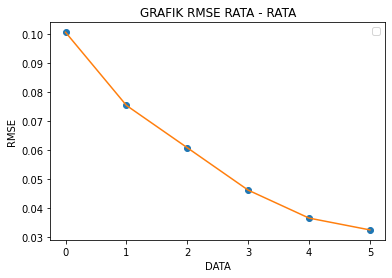

In [ ]:
# importing mean() 
from statistics import mean

print("RATA RATA RMSE 15 TITIK =", mean(RMSE_15Data)) 
print("RATA RATA RMSE 25 TITIK =", mean(RMSE_25Data)) 
print("RATA RATA RMSE 35 TITIK =", mean(RMSE_35Data)) 
print("RATA RATA RMSE 45 TITIK =", mean(RMSE_45Data))
print("RATA RATA RMSE 55 TITIK =", mean(RMSE_55Data))  
print("RATA RATA RMSE 65 TITIK =", mean(RMSE_65Data))

RMSE_SEMUA = np.asarray([mean(RMSE_15Data), mean(RMSE_25Data), mean(RMSE_35Data), mean(RMSE_45Data), mean(RMSE_55Data), mean(RMSE_65Data)])
plt.plot(RMSE_SEMUA,'o')
plt.plot(RMSE_SEMUA)
plt.title('GRAFIK RMSE RATA - RATA')
plt.xlabel('DATA')
plt.ylabel('RMSE')
plt.legend(loc='best')
plt.show()



In [ ]:
RMSE_15  = mean(RMSE_15Data)
RMSE_25  = mean(RMSE_25Data)
RMSE_35  = mean(RMSE_35Data)
RMSE_45  = mean(RMSE_45Data)
RMSE_55  = mean(RMSE_55Data)
RMSE_65  = mean(RMSE_65Data)

print("Data RMSE ASLI\n")
print("RMSE 15 =", RMSE_15)
print("RMSE 25 =", RMSE_25)
print("RMSE 35 =", RMSE_35)
print("RMSE 45 =", RMSE_45)
print("RMSE 55 =", RMSE_55)
print("RMSE 65 =", RMSE_65)


print("\nData PENGURANGAN RMSE")
# print("RMSE 65 - 55=", RMSE_65-RMSE_55)
# print("RMSE 55 - 45=", RMSE_55-RMSE_45)
# print("RMSE 45 - 35=", RMSE_45-RMSE_35)
# print("RMSE 35 - 25=", RMSE_35-RMSE_25)
# print("RMSE 25 - 15=", RMSE_25-RMSE_15)

# print("\n")
print("RMSE 15 - 25 =", RMSE_15-RMSE_25)
print("RMSE 25 - 35 =", RMSE_25-RMSE_35)
print("RMSE 35 - 45 =", RMSE_35-RMSE_45)
print("RMSE 45 - 55 =", RMSE_45-RMSE_55)
print("RMSE 55 - 65 =", RMSE_55-RMSE_65)

Data RMSE ASLI

RMSE 15 = 0.10052925647073106
RMSE 25 = 0.07539022598613501
RMSE 35 = 0.06084391943839591
RMSE 45 = 0.04627149402767549
RMSE 55 = 0.03666451424078097
RMSE 65 = 0.032599507037733455

Data PENGURANGAN RMSE
RMSE 15 - 25 = 0.02513903048459605
RMSE 25 - 35 = 0.014546306547739099
RMSE 35 - 45 = 0.014572425410720423
RMSE 45 - 55 = 0.009606979786894523
RMSE 55 - 65 = 0.004065007203047512


# PLOT RAW DATA & B-SPLINE

In [ ]:
DATA_SAHAM_KOMPAS =  pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA PERGERAKAN SAHAM GABUNGAN.csv')
AALI = DATA_SAHAM_KOMPAS['AALI'].values
ACES = DATA_SAHAM_KOMPAS['ACES'].values
ADHI = DATA_SAHAM_KOMPAS['ADHI'].values
ADRO = DATA_SAHAM_KOMPAS['ADRO'].values
AGRO = DATA_SAHAM_KOMPAS['AGRO'].values
AKRA = DATA_SAHAM_KOMPAS['AKRA'].values
ANTM = DATA_SAHAM_KOMPAS['ANTM'].values
ASII = DATA_SAHAM_KOMPAS['ASII'].values
ASRI = DATA_SAHAM_KOMPAS['ASRI'].values
BBCA = DATA_SAHAM_KOMPAS['BBCA'].values
BBKP = DATA_SAHAM_KOMPAS['BBKP'].values
BBNI = DATA_SAHAM_KOMPAS['BBNI'].values
BBRI = DATA_SAHAM_KOMPAS['BBRI'].values
BDMN = DATA_SAHAM_KOMPAS['BDMN'].values
BKSL = DATA_SAHAM_KOMPAS['BKSL'].values
BMRI = DATA_SAHAM_KOMPAS['BMRI'].values
BNGA = DATA_SAHAM_KOMPAS['BNGA'].values
BRPT = DATA_SAHAM_KOMPAS['BRPT'].values
BSDE = DATA_SAHAM_KOMPAS['BSDE'].values
BTPN = DATA_SAHAM_KOMPAS['BTPN'].values
BUMI = DATA_SAHAM_KOMPAS['BUMI'].values
CPIN = DATA_SAHAM_KOMPAS['CPIN'].values
CTRA = DATA_SAHAM_KOMPAS['CTRA'].values
DOID = DATA_SAHAM_KOMPAS['DOID'].values
ELSA = DATA_SAHAM_KOMPAS['ELSA'].values
EXCL = DATA_SAHAM_KOMPAS['EXCL'].values
GGRM = DATA_SAHAM_KOMPAS['GGRM'].values
HMSP = DATA_SAHAM_KOMPAS['HMSP'].values
ICBP = DATA_SAHAM_KOMPAS['ICBP'].values
IMAS = DATA_SAHAM_KOMPAS['IMAS'].values
INCO = DATA_SAHAM_KOMPAS['INCO'].values
INDF = DATA_SAHAM_KOMPAS['INDF'].values
INDY = DATA_SAHAM_KOMPAS['INDY'].values
INKP = DATA_SAHAM_KOMPAS['INKP'].values
INTP = DATA_SAHAM_KOMPAS['INTP'].values
ISAT = DATA_SAHAM_KOMPAS['ISAT'].values
ITMG = DATA_SAHAM_KOMPAS['ITMG'].values
JPFA = DATA_SAHAM_KOMPAS['JPFA'].values
JSMR = DATA_SAHAM_KOMPAS['JSMR'].values
KLBF = DATA_SAHAM_KOMPAS['KLBF'].values
LPKR = DATA_SAHAM_KOMPAS['LPKR'].values
LPPF = DATA_SAHAM_KOMPAS['LPPF'].values
LSIP = DATA_SAHAM_KOMPAS['LSIP'].values
MAIN = DATA_SAHAM_KOMPAS['MAIN'].values
MAPI = DATA_SAHAM_KOMPAS['MAPI'].values
MNCN = DATA_SAHAM_KOMPAS['MNCN'].values
PBRX = DATA_SAHAM_KOMPAS['PBRX'].values
PGAS = DATA_SAHAM_KOMPAS['PGAS'].values
PNBN = DATA_SAHAM_KOMPAS['PNBN'].values
PTBA = DATA_SAHAM_KOMPAS['PTBA'].values
PTRO = DATA_SAHAM_KOMPAS['PTRO'].values
PWON = DATA_SAHAM_KOMPAS['PWON'].values
RALS = DATA_SAHAM_KOMPAS['RALS'].values
SCMA = DATA_SAHAM_KOMPAS['SCMA'].values
SMGR = DATA_SAHAM_KOMPAS['SMGR'].values
SMRA = DATA_SAHAM_KOMPAS['SMRA'].values
SMSM = DATA_SAHAM_KOMPAS['SMSM'].values
SSIA = DATA_SAHAM_KOMPAS['SSIA'].values
TBLA = DATA_SAHAM_KOMPAS['TBLA'].values
TINS = DATA_SAHAM_KOMPAS['TINS'].values
TKIM = DATA_SAHAM_KOMPAS['TKIM'].values
TPIA = DATA_SAHAM_KOMPAS['TPIA'].values
UNTR = DATA_SAHAM_KOMPAS['UNTR'].values
UNVR = DATA_SAHAM_KOMPAS['UNVR'].values
WIKA = DATA_SAHAM_KOMPAS['WIKA'].values
GJTL = DATA_SAHAM_KOMPAS['GJTL'].values

**RAW DATA**

No handles with labels found to put in legend.


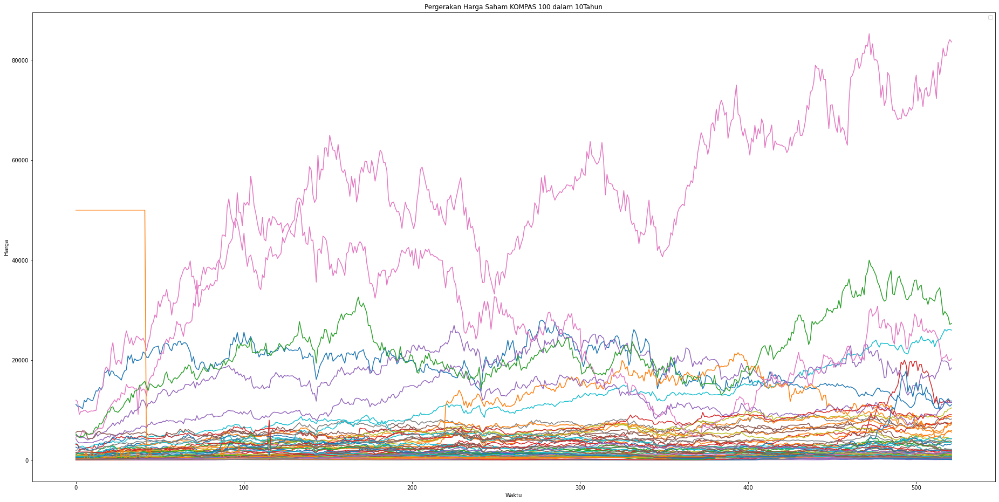

In [ ]:
plt.figure(figsize=(32,16))
plt.plot(AALI)
plt.plot(ACES)
plt.plot(ADHI)
plt.plot(ADRO)
plt.plot(AGRO)
plt.plot(AKRA)
plt.plot(ANTM)
plt.plot(ASII)
plt.plot(ASRI)
plt.plot(BBCA)
plt.plot(BBKP)
plt.plot(BBNI)
plt.plot(BBRI)
plt.plot(BDMN)
plt.plot(BKSL)
plt.plot(BMRI)
plt.plot(BNGA)
plt.plot(BRPT)
plt.plot(BSDE)
plt.plot(BTPN)
plt.plot(BUMI)
plt.plot(CPIN)
plt.plot(CTRA)
plt.plot(DOID)
plt.plot(ELSA)
plt.plot(EXCL)
plt.plot(GGRM)
plt.plot(HMSP)
plt.plot(ICBP)
plt.plot(IMAS)
plt.plot(INCO)
plt.plot(INDF)
plt.plot(INDY)
plt.plot(INKP)
plt.plot(INTP)
plt.plot(ISAT)
plt.plot(ITMG)
plt.plot(JPFA)
plt.plot(JSMR)
plt.plot(KLBF)
plt.plot(LPKR)
plt.plot(LPPF)
plt.plot(LSIP)
plt.plot(MAIN)
plt.plot(MAPI)
plt.plot(MNCN)
plt.plot(PBRX)
plt.plot(PGAS)
plt.plot(PNBN)
plt.plot(PTBA)
plt.plot(PTRO)
plt.plot(PWON)
plt.plot(RALS)
plt.plot(SCMA)
plt.plot(SMGR)
plt.plot(SMRA)
plt.plot(SMSM)
plt.plot(SSIA)
plt.plot(TBLA)
plt.plot(TINS)
plt.plot(TKIM)
plt.plot(TPIA)
plt.plot(UNTR)
plt.plot(UNVR)
plt.plot(WIKA)
plt.plot(GJTL)
plt.title('Pergerakan Harga Saham KOMPAS 100 dalam 10Tahun')
plt.xlabel('Waktu')
plt.ylabel('Harga')
plt.legend(loc = 'best')
plt.show()

**B-SPLINE**

No handles with labels found to put in legend.


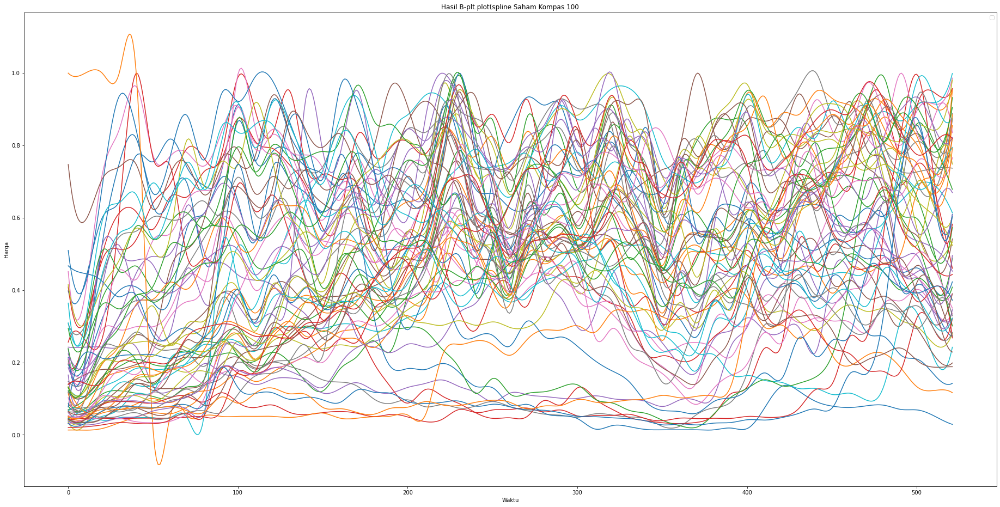

In [ ]:
plt.figure(figsize=(32,16))
plt.plot(spline_AALI_55(xx_AALI_55))
plt.plot(spline_ACES_55(xx_ACES_55))
plt.plot(spline_ADHI_55(xx_ADHI_55))
plt.plot(spline_ADRO_55(xx_ADRO_55))
plt.plot(spline_AGRO_55(xx_AGRO_55))
plt.plot(spline_AKRA_55(xx_AKRA_55))
plt.plot(spline_ANTM_55(xx_ANTM_55))
plt.plot(spline_ASII_55(xx_ASII_55))
plt.plot(spline_ASRI_55(xx_ASRI_55))
plt.plot(spline_BBCA_55(xx_BBCA_55))
plt.plot(spline_BBKP_55(xx_BBKP_55))
plt.plot(spline_BBNI_55(xx_BBNI_55))
plt.plot(spline_BBRI_55(xx_BBRI_55))
plt.plot(spline_BDMN_55(xx_BDMN_55))
plt.plot(spline_BKSL_55(xx_BKSL_55))
plt.plot(spline_BMRI_55(xx_BMRI_55))
plt.plot(spline_BNGA_55(xx_BNGA_55))
plt.plot(spline_BRPT_55(xx_BRPT_55))
plt.plot(spline_BSDE_55(xx_BSDE_55))
plt.plot(spline_BTPN_55(xx_BTPN_55))
plt.plot(spline_BUMI_55(xx_BUMI_55))
plt.plot(spline_CPIN_55(xx_CPIN_55))
plt.plot(spline_CTRA_55(xx_CTRA_55))
plt.plot(spline_DOID_55(xx_DOID_55))
plt.plot(spline_ELSA_55(xx_ELSA_55))
plt.plot(spline_EXCL_55(xx_EXCL_55))
plt.plot(spline_GGRM_55(xx_GGRM_55))
plt.plot(spline_HMSP_55(xx_HMSP_55))
plt.plot(spline_ICBP_55(xx_ICBP_55))
plt.plot(spline_IMAS_55(xx_IMAS_55))
plt.plot(spline_INCO_55(xx_INCO_55))
plt.plot(spline_INDF_55(xx_INDF_55))
plt.plot(spline_INDY_55(xx_INDY_55))
plt.plot(spline_INKP_55(xx_INKP_55))
plt.plot(spline_INTP_55(xx_INTP_55))
plt.plot(spline_ISAT_55(xx_ISAT_55))
plt.plot(spline_ITMG_55(xx_ITMG_55))
plt.plot(spline_JPFA_55(xx_JPFA_55))
plt.plot(spline_JSMR_55(xx_JSMR_55))
plt.plot(spline_KLBF_55(xx_KLBF_55))
plt.plot(spline_LPKR_55(xx_LPKR_55))
plt.plot(spline_LPPF_55(xx_LPPF_55))
plt.plot(spline_LSIP_55(xx_LSIP_55))
plt.plot(spline_MAIN_55(xx_MAIN_55))
plt.plot(spline_MAPI_55(xx_MAPI_55))
plt.plot(spline_MNCN_55(xx_MNCN_55))
plt.plot(spline_PBRX_55(xx_PBRX_55))
plt.plot(spline_PGAS_55(xx_PGAS_55))
plt.plot(spline_PNBN_55(xx_PNBN_55))
plt.plot(spline_PTBA_55(xx_PTBA_55))
plt.plot(spline_PTRO_55(xx_PTRO_55))
plt.plot(spline_PWON_55(xx_PWON_55))
plt.plot(spline_RALS_55(xx_RALS_55))
plt.plot(spline_SCMA_55(xx_SCMA_55))
plt.plot(spline_SMGR_55(xx_SMGR_55))
plt.plot(spline_SMRA_55(xx_SMRA_55))
plt.plot(spline_SMSM_55(xx_SMSM_55))
plt.plot(spline_SSIA_55(xx_SSIA_55))
plt.plot(spline_TBLA_55(xx_TBLA_55))
plt.plot(spline_TINS_55(xx_TINS_55))
plt.plot(spline_TKIM_55(xx_TKIM_55))
plt.plot(spline_TPIA_55(xx_TPIA_55))
plt.plot(spline_UNTR_55(xx_UNTR_55))
plt.plot(spline_UNVR_55(xx_UNVR_55))
plt.plot(spline_WIKA_55(xx_WIKA_55))
plt.plot(spline_GJTL_55(xx_GJTL_55))

plt.title('Hasil B-plt.plot(spline Saham Kompas 100')
plt.xlabel('Waktu')
plt.ylabel('Harga')
plt.legend(loc = 'best')
plt.show()


# **EXPORT DATA TO CSV**

In [ ]:
Koef_15 = np.asarray([c_AALI_15, c_ACES_15, c_ADHI_15, c_ADRO_15, c_AGRO_15, c_AKRA_15, c_ANTM_15, c_ASII_15, c_ASRI_15, c_BBCA_15, c_BBKP_15, c_BBNI_15, c_BBRI_15, c_BDMN_15, c_BKSL_15, c_BMRI_15, c_BNGA_15,c_BRPT_15, c_BSDE_15, c_BTPN_15, c_BUMI_15, c_CPIN_15, c_CTRA_15, c_DOID_15, c_ELSA_15, c_EXCL_15, c_GGRM_15, c_HMSP_15, c_ICBP_15, c_IMAS_15, c_INCO_15, c_INDF_15, c_INDY_15, c_INKP_15, c_INTP_15, c_ISAT_15, c_JPFA_15, c_JSMR_15, c_KLBF_15,c_LPKR_15, c_LPPF_15, c_LSIP_15, c_MAIN_15, c_MAPI_15, c_MNCN_15, c_PBRX_15, c_PGAS_15, c_PNBN_15, c_PTBA_15, c_PTRO_15, c_PWON_15, c_RALS_15, c_SCMA_15, c_SMGR_15, c_SMRA_15,c_SMSM_15, c_SSIA_15, c_TBLA_15, c_TINS_15, c_TKIM_15, c_TPIA_15, c_UNTR_15, c_UNVR_15, c_WIKA_15, c_GJTL_15])
np.savetxt("HasilBspline15.csv", Koef_15, delimiter=",")
files.download("HasilBspline15.csv")

In [ ]:
Koef_25 = np.asarray([c_AALI_25, c_ACES_25, c_ADHI_25, c_ADRO_25, c_AGRO_25, c_AKRA_25, c_ANTM_25, c_ASII_25, c_ASRI_25, c_BBCA_25, c_BBKP_25, c_BBNI_25, c_BBRI_25, c_BDMN_25, c_BKSL_25, c_BMRI_25, c_BNGA_25,c_BRPT_25, c_BSDE_25, c_BTPN_25, c_BUMI_25, c_CPIN_25, c_CTRA_25, c_DOID_25, c_ELSA_25, c_EXCL_25, c_GGRM_25, c_HMSP_25, c_ICBP_25, c_IMAS_25, c_INCO_25, c_INDF_25, c_INDY_25, c_INKP_25, c_INTP_25, c_ISAT_25, c_JPFA_25, c_JSMR_25, c_KLBF_25,c_LPKR_25, c_LPPF_25, c_LSIP_25, c_MAIN_25, c_MAPI_25, c_MNCN_25, c_PBRX_25, c_PGAS_25, c_PNBN_25, c_PTBA_25, c_PTRO_25, c_PWON_25, c_RALS_25, c_SCMA_25, c_SMGR_25, c_SMRA_25,c_SMSM_25, c_SSIA_25, c_TBLA_25, c_TINS_25, c_TKIM_25, c_TPIA_25, c_UNTR_25, c_UNVR_25, c_WIKA_25, c_GJTL_25])
np.savetxt("HasilBspline25.csv", Koef_25, delimiter=",")
files.download("HasilBspline25.csv")


In [ ]:
Koef_35 = np.asarray([c_AALI_35, c_ACES_35, c_ADHI_35, c_ADRO_35, c_AGRO_35, c_AKRA_35, c_ANTM_35, c_ASII_35, c_ASRI_35, c_BBCA_35, c_BBKP_35, c_BBNI_35, c_BBRI_35, c_BDMN_35, c_BKSL_35, c_BMRI_35, c_BNGA_35,c_BRPT_35, c_BSDE_35, c_BTPN_35, c_BUMI_35, c_CPIN_35, c_CTRA_35, c_DOID_35, c_ELSA_35, c_EXCL_35, c_GGRM_35, c_HMSP_35, c_ICBP_35, c_IMAS_35, c_INCO_35, c_INDF_35, c_INDY_35, c_INKP_35, c_INTP_35, c_ISAT_35, c_JPFA_35, c_JSMR_35, c_KLBF_35,c_LPKR_35, c_LPPF_35, c_LSIP_35, c_MAIN_35, c_MAPI_35, c_MNCN_35, c_PBRX_35, c_PGAS_35, c_PNBN_35, c_PTBA_35, c_PTRO_35, c_PWON_35, c_RALS_35, c_SCMA_35, c_SMGR_35, c_SMRA_35,c_SMSM_35, c_SSIA_35, c_TBLA_35, c_TINS_35, c_TKIM_35, c_TPIA_35, c_UNTR_35, c_UNVR_35, c_WIKA_35, c_GJTL_35])
np.savetxt("HasilBspline35.csv", Koef_35, delimiter=",")
files.download("HasilBspline35.csv")


In [ ]:
Koef_45 = np.asarray([c_AALI_45, c_ACES_45, c_ADHI_45, c_ADRO_45, c_AGRO_45, c_AKRA_45, c_ANTM_45, c_ASII_45, c_ASRI_45, c_BBCA_45, c_BBKP_45, c_BBNI_45, c_BBRI_45, c_BDMN_45, c_BKSL_45, c_BMRI_45, c_BNGA_45,c_BRPT_45, c_BSDE_45, c_BTPN_45, c_BUMI_45, c_CPIN_45, c_CTRA_45, c_DOID_45, c_ELSA_45, c_EXCL_45, c_GGRM_45, c_HMSP_45, c_ICBP_45, c_IMAS_45, c_INCO_45, c_INDF_45, c_INDY_45, c_INKP_45, c_INTP_45, c_ISAT_45, c_JPFA_45, c_JSMR_45, c_KLBF_45,c_LPKR_45, c_LPPF_45, c_LSIP_45, c_MAIN_45, c_MAPI_45, c_MNCN_45, c_PBRX_45, c_PGAS_45, c_PNBN_45, c_PTBA_45, c_PTRO_45, c_PWON_45, c_RALS_45, c_SCMA_45, c_SMGR_45, c_SMRA_45,c_SMSM_45, c_SSIA_45, c_TBLA_45, c_TINS_45, c_TKIM_45, c_TPIA_45, c_UNTR_45, c_UNVR_45, c_WIKA_45, c_GJTL_45])
np.savetxt("HasilBspline45.csv", Koef_45, delimiter=",")
files.download("HasilBspline45.csv")


In [ ]:
Koef_55 = np.asarray([c_AALI_55, c_ACES_55, c_ADHI_55, c_ADRO_55, c_AGRO_55, c_AKRA_55, c_ANTM_55, c_ASII_55, c_ASRI_55, c_BBCA_55, c_BBKP_55, c_BBNI_55, c_BBRI_55, c_BDMN_55, c_BKSL_55, c_BMRI_55, c_BNGA_55,c_BRPT_55, c_BSDE_55, c_BTPN_55, c_BUMI_55, c_CPIN_55, c_CTRA_55, c_DOID_55, c_ELSA_55, c_EXCL_55, c_GGRM_55, c_HMSP_55, c_ICBP_55, c_IMAS_55, c_INCO_55, c_INDF_55, c_INDY_55, c_INKP_55, c_INTP_55, c_ISAT_55, c_JPFA_55, c_JSMR_55, c_KLBF_55,c_LPKR_55, c_LPPF_55, c_LSIP_55, c_MAIN_55, c_MAPI_55, c_MNCN_55, c_PBRX_55, c_PGAS_55, c_PNBN_55, c_PTBA_55, c_PTRO_55, c_PWON_55, c_RALS_55, c_SCMA_55, c_SMGR_55, c_SMRA_55,c_SMSM_55, c_SSIA_55, c_TBLA_55, c_TINS_55, c_TKIM_55, c_TPIA_55, c_UNTR_55, c_UNVR_55, c_WIKA_55, c_GJTL_55])
np.savetxt("HasilBspline55.csv", Koef_55, delimiter=",")
files.download("HasilBspline55.csv")


In [ ]:
Koef_65 = np.asarray([c_AALI_65, c_ACES_65, c_ADHI_65, c_ADRO_65, c_AGRO_65, c_AKRA_65, c_ANTM_65, c_ASII_65, c_ASRI_65, c_BBCA_65, c_BBKP_65, c_BBNI_65, c_BBRI_65, c_BDMN_65, c_BKSL_65, c_BMRI_65, c_BNGA_65,c_BRPT_65, c_BSDE_65, c_BTPN_65, c_BUMI_65, c_CPIN_65, c_CTRA_65, c_DOID_65, c_ELSA_65, c_EXCL_65, c_GGRM_65, c_HMSP_65, c_ICBP_65, c_IMAS_65, c_INCO_65, c_INDF_65, c_INDY_65, c_INKP_65, c_INTP_65, c_ISAT_65, c_JPFA_65, c_JSMR_65, c_KLBF_65,c_LPKR_65, c_LPPF_65, c_LSIP_65, c_MAIN_65, c_MAPI_65, c_MNCN_65, c_PBRX_65, c_PGAS_65, c_PNBN_65, c_PTBA_65, c_PTRO_65, c_PWON_65, c_RALS_65, c_SCMA_65, c_SMGR_65, c_SMRA_65,c_SMSM_65, c_SSIA_65, c_TBLA_65, c_TINS_65, c_TKIM_65, c_TPIA_65, c_UNTR_65, c_UNVR_65, c_WIKA_65, c_GJTL_65])
np.savetxt("HasilBspline65.csv", Koef_65, delimiter=",")
files.download("HasilBspline65.csv")

In [ ]:
#data spline kompas 100
B_Spline = np.asarray([spline_AALI_55(xx_AALI_55), spline_ACES_55(xx_ACES_55), spline_ADHI_55(xx_ADHI_55), spline_ADRO_55(xx_ADRO_55), spline_AGRO_55(xx_AGRO_55), spline_AKRA_55(xx_AKRA_55), spline_ANTM_55(xx_ANTM_55), spline_ASII_55(xx_ASII_55), spline_ASRI_55(xx_ASRI_55), spline_BBCA_55(xx_BBCA_55), spline_BBKP_55(xx_BBKP_55), spline_BBNI_55(xx_BBNI_55), spline_BBRI_55(xx_BBRI_55), spline_BDMN_55(xx_BDMN_55), spline_BKSL_55(xx_BKSL_55), spline_BMRI_55(xx_BMRI_55), spline_BNGA_55(xx_BNGA_55), spline_BRPT_55(xx_BRPT_55), spline_BSDE_55(xx_BSDE_55), spline_BTPN_55(xx_BTPN_55), spline_BUMI_55(xx_BUMI_55), spline_CPIN_55(xx_CPIN_55), spline_CTRA_55(xx_CTRA_55), spline_DOID_55(xx_DOID_55), spline_ELSA_55(xx_ELSA_55), spline_EXCL_55(xx_EXCL_55), spline_GGRM_55(xx_GGRM_55), spline_HMSP_55(xx_HMSP_55), spline_ICBP_55(xx_ICBP_55), spline_IMAS_55(xx_IMAS_55), spline_INCO_55(xx_INCO_55), spline_INDF_55(xx_INDF_55), spline_INDY_55(xx_INDY_55), spline_INKP_55(xx_INKP_55), spline_INTP_55(xx_INTP_55), spline_ISAT_55(xx_ISAT_55), spline_JPFA_55(xx_JPFA_55), spline_JSMR_55(xx_JSMR_55), spline_KLBF_55(xx_KLBF_55), spline_LPKR_55(xx_LPKR_55), spline_LPPF_55(xx_LPPF_55), spline_LSIP_55(xx_LSIP_55), spline_MAIN_55(xx_MAIN_55), spline_MAPI_55(xx_MAPI_55), spline_MNCN_55(xx_MNCN_55), spline_PBRX_55(xx_PBRX_55), spline_PGAS_55(xx_PGAS_55), spline_PNBN_55(xx_PNBN_55), spline_PTBA_55(xx_PTBA_55), spline_PTRO_55(xx_PTRO_55), spline_PWON_55(xx_PWON_55), spline_RALS_55(xx_RALS_55), spline_SCMA_55(xx_SCMA_55), spline_SMGR_55(xx_SMGR_55), spline_SMRA_55(xx_SMRA_55), spline_SMSM_55(xx_SMSM_55), spline_SSIA_55(xx_SSIA_55), spline_TBLA_55(xx_TBLA_55), spline_TINS_55(xx_TINS_55), spline_TKIM_55(xx_TKIM_55), spline_TPIA_55(xx_TPIA_55), spline_UNTR_55(xx_UNTR_55), spline_UNVR_55(xx_UNVR_55), spline_WIKA_55(xx_WIKA_55), spline_GJTL_55(xx_GJTL_55)])
np.savetxt("B Spline_KOMPAS100.csv", B_Spline, delimiter=",")
files.download("B Spline_KOMPAS100.csv")

# **CLUSTERING KMEAS**

In [ ]:
Koefisien_55 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/HASIL B-SPLINE/HasilBspline55_1.csv')
Koefisien_55

,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0
3,ADRO,0.196226,0.118055,0.541248,0.507624,0.515905,0.666490,0.667192,0.830781,0.764402,0.696519,1.091033,0.882744,0.755348,1.076996,0.653648,0.746149,0.686286,0.742668,0.486438,0.526675,0.486107,0.721350,0.477551,0.334485,0.244887,0.429364,0.437656,0.287935,0.550225,0.420598,0.450400,0.392896,0.355375,0.359190,0.188998,0.231987,0.196260,0.205613,0.283176,0.291872,0.485186,0.586251,0.645280,0.772250,0.544964,0.806385,0.655913,0.894492,0.769894,0.644800,0.844138,0.603403,0.460377,0,0,0,0
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.031132,0.081560,0.065815,0.078855,0.070096,0.083063,0.067034,0.045970,0.128204,0.068564,0.121082,0.137642,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.540309,0.651072,0.552902,0.602321,0.727816,0.843916,0.501522,0.554998,0.503486,0.566057,0.442284,0.387306,0.498493,0.408721,0.491622,0.474791,0.534215,0.605851,0.477382,0.398371,0.51

In [ ]:
hasil_bspline = Koefisien_55.drop(["Saham"],axis=1)
X = hasil_bspline.copy()
X_array  = np.array(X)

**1. Clustering K = 2**

In [ ]:
# Number of clusters
kmeans_2 = KMeans(n_clusters=2)
# Fitting the input data
kmeans_2 = kmeans_2.fit(X_array)
# Getting the cluster labels
labels_2 = kmeans_2.predict(X_array)
# Centroid values
centroids_2 = kmeans_2.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=2",labels_2) # From Scratch
# print("Centroid K=2",centroids_2) # From sci-kit learn
Koefisien_55["kluster K = 2"] = labels_2
Koefisien_55

Hasil Clustering K=2 [1 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1
 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0]


,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster K = 2
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.540309,0.651072,0.552902,0.602321,0.727816,0.843916,0.501522,0.554998,0.503486,0.566057,0.442284,0.387306,0.498493,0.408721,0.491622,0.474791,0.534215,

**2. Clustering K = 3**

In [ ]:
# Number of clusters
kmeans_3 = KMeans(n_clusters=3)
# Fitting the input data
kmeans_3 = kmeans_3.fit(X_array)
# Getting the cluster labels
labels_3 = kmeans_3.predict(X_array)
# Centroid values
centroids_3 = kmeans_3.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=3",labels_3) # From Scratch
# print("Centroid K=3",centroids_3) # From sci-kit learn
Koefisien_55["kluster K = 3"] = labels_3
Koefisien_55

Hasil Clustering K=3 [0 2 2 0 1 2 0 0 2 2 0 2 2 0 0 2 0 1 2 0 1 2 2 1 0 0 2 2 2 0 0 2 1 1 0 0 2
 2 2 0 1 0 2 2 2 2 0 0 1 1 2 0 2 0 2 2 2 2 0 1 1 0 2 2 0]


,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster K = 2,kluster K = 3
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1,0
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1,2
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1,2
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0,0
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0,1
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.540309,0.651072,0.552902,0.602321,0.727816,0.843916,0.501522,0.554998,0.503486,0.566057,0.442284,0.387306,0.498493,0.4087

**3. Clustering K = 4**

In [ ]:
# Number of clusters
kmeans_4 = KMeans(n_clusters=4)
# Fitting the input data
kmeans_4 = kmeans_4.fit(X_array)
# Getting the cluster labels
labels_4 = kmeans_4.predict(X_array)
# Centroid values
centroids_4 = kmeans_4.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=4",labels_4) # From Scratch
# print("Centroid K=4",centroids_4) # From sci-kit learn
Koefisien_55["kluster K = 4"] = labels_4
Koefisien_55

Hasil Clustering K=4 [0 2 2 3 1 2 3 0 2 2 0 2 2 0 3 2 3 1 2 0 3 2 2 3 2 0 0 2 2 3 0 0 3 1 0 0 2
 0 2 2 1 3 2 2 2 2 0 0 1 3 2 0 2 0 2 2 2 2 3 1 1 0 2 2 3]


,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster K = 2,kluster K = 3,kluster K = 4
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1,0,0
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1,2,2
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1,2,2
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0,0,3
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0,1,1
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.540309,0.651072,0.552902,0.602321,0.727816,0.843916,0.501522,0.554998,0.503486,0.566057,0.4

**4. Clustering K = 5**

In [ ]:
# Number of clusters
kmeans_5 = KMeans(n_clusters=5)
# Fitting the input data
kmeans_5 = kmeans_5.fit(X_array)
# Getting the cluster labels
labels_5 = kmeans_5.predict(X_array)
# Centroid values
centroids_5 = kmeans_5.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=5",labels_5) # From Scratch
# print("Centroid K=5",centroids_5) # From sci-kit learn
Koefisien_55["kluster K = 5"] = labels_5
Koefisien_55

Hasil Clustering K=5 [2 0 0 1 3 0 1 2 4 0 2 0 0 2 4 0 1 3 0 2 1 0 0 1 2 2 0 0 0 4 2 2 1 3 2 2 0
 2 0 4 3 4 4 0 4 0 2 2 3 1 0 2 0 2 0 0 4 0 1 3 3 2 0 0 4]


,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster K = 2,kluster K = 3,kluster K = 4,kluster K = 5
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1,0,0,2
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1,2,2,0
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1,2,2,0
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0,0,3,1
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0,1,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0,1,1,3
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.540309,0.651072,0.552902,0.602321,0.727816,0.843916,0.501522,

**5. Clustering K = 6**

In [ ]:
# Number of clusters
kmeans_6 = KMeans(n_clusters=6)
# Fitting the input data
kmeans_6 = kmeans_6.fit(X_array)
# Getting the cluster labels
labels_6 = kmeans_6.predict(X_array)
# Centroid values
centroids_6 = kmeans_6.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=6",labels_6) # From Scratch
# print("Centroid K=6",centroids_6) # From sci-kit learn
Koefisien_55["kluster K = 6"] = labels_6
Koefisien_55

Hasil Clustering K=6 [5 0 2 1 3 2 1 5 4 0 5 0 0 5 4 0 1 3 2 5 1 0 2 1 2 5 0 0 0 4 1 5 1 3 5 5 0
 5 2 2 3 4 4 0 2 0 5 5 3 1 0 5 2 5 2 0 4 0 1 3 3 0 0 2 4]


,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster K = 2,kluster K = 3,kluster K = 4,kluster K = 5,kluster K = 6
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1,0,0,2,5
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1,2,2,0,0
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1,2,2,0,2
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0,0,3,1,1
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0,1,1,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0,1,1,3,3
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.540309,0.651072,0.552902,0.6023

**6. Clustering K = 7**

In [ ]:
# Number of clusters
kmeans_7 = KMeans(n_clusters=7)
# Fitting the input data
kmeans_7 = kmeans_7.fit(X_array)
# Getting the cluster labels
labels_7 = kmeans_7.predict(X_array)
# Centroid values
centroids_7 = kmeans_7.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=7",labels_7) # From Scratch
# print("Centroid K=7",centroids_7) # From sci-kit learn
Koefisien_55["kluster K = 7"] = labels_7
Koefisien_55

Hasil Clustering K=7 [1 5 6 4 3 6 4 1 0 5 1 5 5 1 0 5 4 3 6 0 4 5 6 4 5 1 5 5 5 0 1 1 4 3 1 1 5
 1 6 0 2 4 0 5 0 5 1 1 3 4 5 1 6 1 6 5 0 5 4 3 3 5 5 6 0]


,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster K = 2,kluster K = 3,kluster K = 4,kluster K = 5,kluster K = 6,kluster K = 7
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1,0,0,2,5,1
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1,2,2,0,0,5
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1,2,2,0,2,6
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0,0,3,1,1,4
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0,1,1,3,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0,1,1,3,3,3
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.425364,0.340077,0.413598,0.442747,0.483373,0.464774,0.613925,0.540672,0.5

**7. Clustering K = 8**

In [ ]:
# Number of clusters
kmeans_8 = KMeans(n_clusters=8)
# Fitting the input data
kmeans_8 = kmeans_8.fit(X_array)
# Getting the cluster labels
labels_8 = kmeans_8.predict(X_array)
# Centroid values
centroids_8 = kmeans_8.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=8",labels_8) # From Scratch
# print("Centroid K=8",centroids_8) # From sci-kit learn
Koefisien_55["kluster K = 8"] = labels_8

Hasil Clustering K=8 [6 1 5 0 2 5 0 7 3 1 6 1 1 0 3 1 4 2 5 7 4 1 5 4 1 6 7 1 1 3 0 7 4 2 7 6 1
 7 5 3 2 4 3 1 3 1 6 0 2 4 1 7 5 6 5 1 3 1 0 2 2 1 1 5 3]


**8. Clustering K = 9**

In [ ]:
# Number of clusters
kmeans_9 = KMeans(n_clusters=9)
# Fitting the input data
kmeans_9 = kmeans_9.fit(X_array)
# Getting the cluster labels
labels_9 = kmeans_9.predict(X_array)
# Centroid values
centroids_9 = kmeans_9.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=9",labels_9) # From Scratch
# print("Centroid K=9",centroids_9) # From sci-kit learn
Koefisien_55["kluster K = 9"] = labels_9

Hasil Clustering K=9 [5 4 1 0 2 1 0 8 7 4 5 4 4 8 3 4 0 2 1 5 0 4 1 0 1 5 8 4 4 3 0 8 0 2 8 8 4
 8 1 7 6 3 7 4 7 1 5 8 2 3 4 8 1 5 1 4 7 4 0 2 2 8 4 1 3]


**9. Clustering K = 10**

In [ ]:
# Number of clusters
kmeans_10 = KMeans(n_clusters=10)
# Fitting the input data
kmeans_10 = kmeans_10.fit(X_array)
# Getting the cluster labels
labels_10 = kmeans_10.predict(X_array)
# Centroid values
centroids_10 = kmeans_10.cluster_centers_
# Comparing with scikit-learn centroids
print("Hasil Clustering K=10",labels_10) # From Scratch
#print("Centroid K=10",centroids_10) # From sci-kit learn
Koefisien_55["kluster K = 10"] = labels_10

Hasil Clustering K=10 [6 0 8 6 4 8 6 5 3 0 2 0 0 6 7 0 7 4 5 2 1 0 8 1 0 2 5 8 8 7 6 5 1 4 5 6 0
 5 5 3 9 7 3 0 3 5 2 6 4 7 8 5 8 2 8 8 3 0 6 4 4 0 8 8 7]


**EVALUASI CLUSTERING DENGAN silhouette coefﬁcient**

/usr/local/lib/python3.6/dist-packages/sklearn/base.py:197: FutureWarning:

From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.



SilhouetteVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7f120fa22630>,
                     model=None)

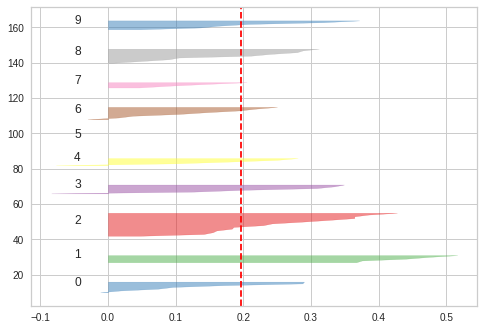

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.cluster import KMeans
model = SilhouetteVisualizer(KMeans(10))
model.fit(X_array)

silhouette K =  2 adalah 0.28008535167813253
silhouette K =  3 adalah 0.23548673238895668
silhouette K =  4 adalah 0.23473673539288686
silhouette K =  5 adalah 0.2307876789525587
silhouette K =  6 adalah 0.19262508916961862
silhouette K =  7 adalah 0.23290291230809373
silhouette K =  8 adalah 0.19946601820999876
silhouette K =  9 adalah 0.17681203094325973
silhouette K =  10 adalah 0.1877080137973555


Text(0, 0.5, 'Silhouette')

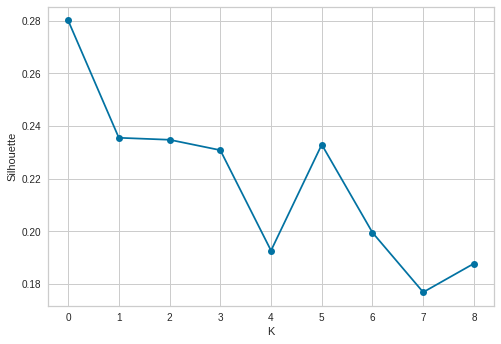

In [ ]:
from sklearn.metrics import silhouette_score
silhouettescore = []
kmax = 10

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, 11):
  kmeans = KMeans(n_clusters = k).fit(X_array)
  labelsX = kmeans.labels_
  silhouettescore.append(silhouette_score(X_array, labelsX, metric = 'euclidean'))

plt.plot(silhouettescore,'o-')
for x in range(0,9):
  print("silhouette K = ", x+2 ,  "adalah", silhouettescore[x])
plt.xlabel("K")
plt.ylabel("Silhouette")

**ELBOW METHOD**

[ KElbowVisualizer ](https://blog.floydhub.com/introduction-to-k-means-clustering-in-python-with-scikit-learn/)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


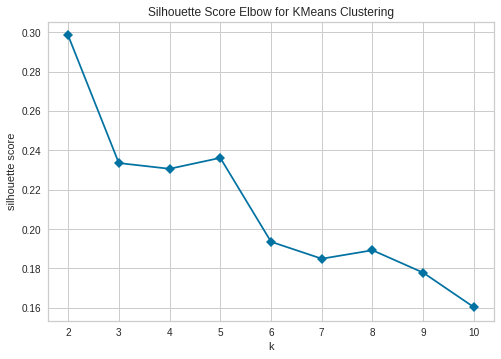

In [ ]:
# Import the KElbowVisualizer method 
from yellowbrick.cluster import KElbowVisualizer

# Instantiate a scikit-learn K-Means model
model = KMeans(random_state=0)

# Instantiate the KElbowVisualizer with the number of clusters and the metric 
visualizer = KElbowVisualizer(model, k=(2,11), metric='silhouette', timings=False)
# Fit the data and visualize
visualizer.fit(X_array)    
visualizer.poof()  

[**kmeans-elbow-method**](https://pythonprogramminglanguage.com/kmeans-elbow-method/)

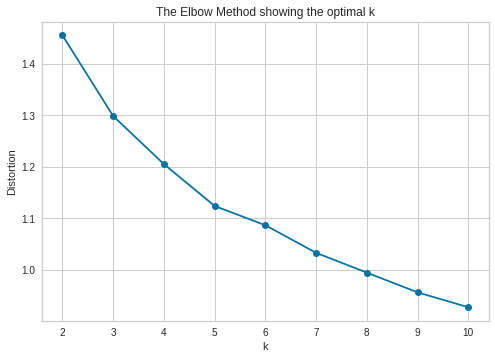

In [ ]:
from sklearn import metrics
from scipy.spatial.distance import cdist
distortions = []
K = range(2,11)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(X_array)
    kmeanModel.fit(X)
    distortions.append(sum(np.min(cdist(X_array, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'o-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

[**K-Means Elbow Method Code For Python**](https://predictivehacks.com/k-means-elbow-method-code-for-python/)

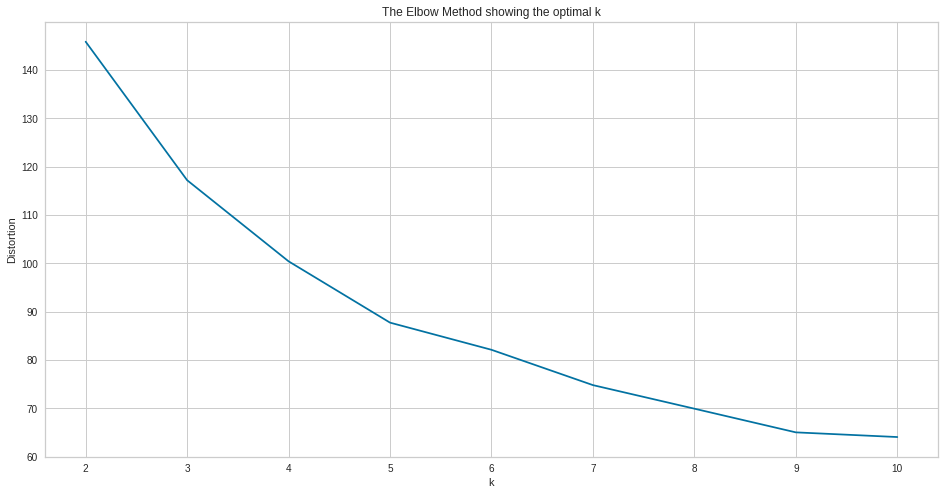

In [ ]:
distortionsK = []
K = range(2,11)
for k in K:
    kmeansModel = KMeans(n_clusters=k)
    kmeansModel.fit(X_array)
    distortionsK.append(kmeansModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(K, distortionsK, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

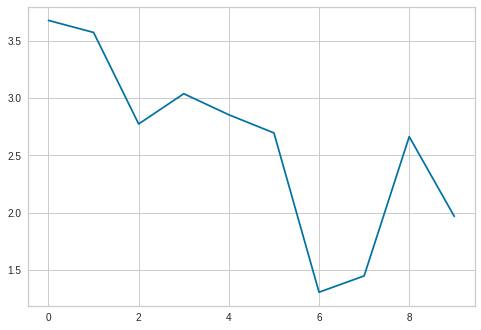

In [ ]:
from sklearn.cluster import KMeans

# function returns WSS score for k values from 1 to kmax
def calculate_WSS(points, kmax):
  sse = []
  for k in range(1, kmax+1):
    kmeans = KMeans(n_clusters = k).fit(points)
    centroids = kmeans.cluster_centers_
    pred_clusters = kmeans.predict(points)
    curr_sse = 0
    
    # calculate square of Euclidean distance of each point from its cluster center and add to current WSS
    for i in range(len(points)):
      curr_center = centroids[pred_clusters[i]]
      curr_sse += (points[i, 0] - curr_center[0]) ** 2 + (points[i, 1] - curr_center[1]) ** 2
      
    sse.append(curr_sse)
  return sse

calculate_WSS(X_array,10)

plt.plot(calculate_WSS(X_array,10))

In [ ]:
Koefisien_55
Koefisien_55.to_csv('HasilClusteringBspline55V1.csv') 
files.download('HasilClusteringBspline55V1.csv')

In [ ]:
Clustering_Result = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/HASIL CLUSTERING/Hasil Clustering.csv')
Clustering_Result

,Saham,Nilai-1,Nilai-2,Nilai-3,Nilai-4,Nilai-5,Nilai-6,Nilai-7,Nilai-8,Nilai-9,Nilai-10,Nilai-11,Nilai-12,Nilai-13,Nilai-14,Nilai-15,Nilai-16,Nilai-17,Nilai-18,Nilai-19,Nilai-20,Nilai-21,Nilai-22,Nilai-23,Nilai-24,Nilai-25,Nilai-26,Nilai-27,Nilai-28,Nilai-29,Nilai-30,Nilai-31,Nilai-32,Nilai-33,Nilai-34,Nilai-35,Nilai-36,Nilai-37,Nilai-38,Nilai-39,Nilai-40,Nilai-41,Nilai-42,Nilai-43,Nilai-44,Nilai-45,Nilai-46,Nilai-47,Nilai-48,Nilai-49,Nilai-50,Nilai-51,Nilai-52,Nilai-53,Nilai-54,Nilai-55,Nilai-56,Nilai-57,kluster_K=2,kluster_K=3,kluster_K=4,kluster_K=5,kluster_K=6,kluster_K=7,kluster_K=8,kluster_K=9,kluster_K=10
0,AALI,0.397961,0.265792,0.669941,0.595853,0.832512,0.706751,0.871103,0.717012,0.689432,0.657910,1.036079,0.677379,0.805432,0.794778,0.729754,0.735197,0.645786,0.834720,0.688808,0.756983,0.711840,0.660968,0.593276,0.741430,0.379778,0.770066,0.846093,0.968022,0.883872,0.965880,0.701586,0.737983,0.917923,0.590317,1.001433,0.500903,0.653129,0.539638,0.560780,0.482547,0.646770,0.512536,0.585397,0.524567,0.496911,0.555921,0.524234,0.468817,0.518701,0.422772,0.510916,0.321490,0.423006,0,0,0,0,1,0,0,2,5,1,6,5,6
1,ACES,0.050492,0.026077,0.062928,0.067411,0.083355,0.110644,0.076035,0.120298,0.119494,0.129596,0.188352,0.130111,0.176450,0.196874,0.216380,0.245803,0.295491,0.283709,0.330330,0.381855,0.483232,0.518003,0.513608,0.614450,0.530232,0.412162,0.339151,0.552543,0.539199,0.634922,0.560458,0.447838,0.599010,0.402022,0.487984,0.242764,0.567191,0.557324,0.547775,0.576166,0.649200,0.564739,0.436106,0.621986,0.715297,0.647976,0.922308,0.777546,0.924887,0.795039,1.002578,0.834776,0.954098,0,0,0,0,1,2,2,0,0,5,1,4,0
2,ADHI,0.079470,0.037159,0.121045,0.123620,0.114959,0.107935,0.089065,0.147726,0.114733,0.315198,0.197986,0.196170,0.241177,0.206010,0.142729,0.097246,0.199415,0.201784,0.296759,0.168794,0.426739,0.492455,0.861728,1.067257,0.829512,0.502104,0.277296,0.788706,0.859275,0.868227,0.610863,0.741302,1.017311,0.656998,0.805038,0.461917,0.716833,0.820038,0.892241,0.856147,0.909589,0.544587,0.696062,0.698690,0.724028,0.620050,0.729635,0.582599,0.723969,0.586516,0.531660,0.274685,0.488611,0,0,0,0,1,2,2,0,2,6,5,1,8
3,ADRO,0.182456,0.109771,0.503266,0.472002,0.479702,0.619719,0.620371,0.772481,0.710759,0.647640,1.014470,0.820797,0.702341,1.001418,0.607778,0.693787,0.638126,0.690551,0.452302,0.489715,0.451994,0.670729,0.444038,0.311012,0.227702,0.399233,0.406944,0.267729,0.511613,0.391083,0.418793,0.365324,0.330436,0.333983,0.175735,0.215707,0.182488,0.191184,0.263304,0.271389,0.451138,0.545111,0.599997,0.718057,0.506721,0.749796,0.609884,0.831720,0.715866,0.599551,0.784900,0.561059,0.428070,0,0,0,0,0,0,3,1,1,4,0,0,6
4,AGRO,0.242436,0.239017,0.249272,0.232181,0.280890,0.098873,0.124002,0.130647,0.222888,0.158219,0.169181,0.126666,0.159083,0.158302,0.152043,0.103004,0.126916,0.155163,0.116148,0.111524,0.134492,0.139370,0.160233,0.129482,0.122221,0.075753,0.127710,0.107526,0.106893,0.100193,0.098218,0.112818,0.097571,0.096898,0.097189,0.067288,0.104248,0.098072,0.068169,0.288075,0.261886,0.487912,0.362936,0.930937,0.825088,0.533420,0.550716,0.615114,0.498309,0.376291,0.423986,0.279651,0.322493,0,0,0,0,0,1,1,3,3,3,2,2,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.050850,0.503115,-0.024863,0.085859,0.073484,0.071535,0.082677,0.067138,0.045942,0.128211,0.068562,0.121083,0.137641,0.104639,0.125311,0.062085,0.077679,0.060474,0.050514,0.080479,0.069874,0.100383,0.079218,0.079207,0.091388,0.096836,0.094458,0.062416,0.085544,0.073818,0.106619,0.086436,0.089233,0.098229,0.095555,0.115309,0.097639,0.107944,0.111474,0.087050,0.368969,0.621515,0.615700,0.846773,0.781308,0.636077,0.890476,0.822707,0.968119,0.868033,0.840128,0.540089,0.885057,0,0,0,0,0,1,1,3,3,3,2,2,4
61,UNTR,0.130994,0.043964,0.259988,0.273102,0.

##**PLOT DATA CLUSETERING**

In [ ]:
clustering = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/HASIL CLUSTERING/HasilClusteringBspline55.csv')
# clustering = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA PERGERAKAN SAHAM GABUNGAN.csv')
clustering

,AALI,ACES,ADHI,ADRO,AGRO,AKRA,ANTM,ASII,ASRI,BBCA,BBKP,BBNI,BBRI,BDMN,BKSL,BMRI,BNGA,BRPT,BSDE,BTPN,BUMI,CPIN,CTRA,DOID,ELSA,EXCL,GGRM,HMSP,ICBP,IMAS,INCO,INDF,INDY,INKP,INTP,ISAT,JPFA,JSMR,KLBF,LPKR,LPPF,LSIP,MAIN,MAPI,MNCN,PBRX,PGAS,PNBN,PTBA,PTRO,PWON,RALS,SCMA,SMGR,SMRA,SMSM,SSIA,TBLA,TINS,TKIM,TPIA,UNTR,UNVR,WIKA,GJTL
0,0.397961,0.050492,0.079470,0.196226,0.242436,0.086076,0.451375,0.147541,0.044643,0.129063,0.194569,0.068946,0.122409,0.408853,0.238095,0.117326,0.202105,0.119318,0.034756,0.038158,0.213889,0.013287,0.069401,0.256281,0.165517,0.138889,0.053650,0.068906,0.048804,0.066260,0.509804,0.113333,0.207619,0.046500,0.185529,0.747475,0.031780,0.133333,0.042632,0.467289,1.000000,0.238333,0.040764,0.037696,0.041667,0.030578,0.307087,0.414966,0.309426,0.077005,0.130994,0.294304,0.020147,0.223684,0.044557,0.102848,0.063253,0.132492,0.364179,0.031651,0.050850,0.130994,0.140288,0.061141,0.064234
1,0.265792,0.026077,0.037159,0.118055,0.239017,0.046456,0.086101,0.108216,-0.010774,0.082961,0.098039,-0.008367,0.063660,0.162406,-0.039867,0.073456,0.034264,-0.045460,-0.025299,0.021762,-0.023920,0.013946,0.084035,0.359840,-0.124364,0.160484,0.033089,0.070601,0.003384,0.094823,0.246555,0.007858,0.068856,0.008321,0.092198,0.447294,0.038685,0.063074,0.071567,0.436922,0.967350,0.069557,0.046709,0.023062,0.033677,0.039884,0.219483,0.197764,0.145761,0.286114,0.053775,0.126393,0.020564,0.139314,0.014590,-0.014919,0.064348,0.043797,0.038225,0.005254,0.031132,0.043964,0.167940,0.025015,0.040965
2,0.669941,0.062928,0.121045,0.541248,0.249272,0.084304,0.798440,0.182203,0.126905,0.131879,0.312716,0.168600,0.161864,0.486506,0.390844,0.139419,0.350418,0.312510,0.087195,0.051713,0.499229,0.008233,0.108086,0.064239,0.681832,0.185978,0.092280,0.088307,0.095147,0.022111,0.575517,0.220950,0.661812,0.092608,0.234898,0.748509,0.023265,0.195957,0.058181,0.463568,1.065301,0.406720,0.046709,0.026912,0.021812,0.048102,0.398435,0.417397,0.421593,0.190339,0.046894,0.432341,0.023492,0.220713,0.074237,0.146136,0.044496,0.242374,0.687728,0.070759,0.081560,0.259988,0.090378,0.106900,0.087413
3,0.595853,0.067411,0.123620,0.507624,0.232181,0.102236,0.798356,0.340585,0.097439,0.148341,0.409239,0.169002,0.186986,0.629890,0.590453,0.220835,0.276127,0.215894,0.255649,0.060144,0.759258,0.033949,0.251625,0.571983,0.477482,0.178210,0.201045,0.054310,0.092926,0.052466,1.017444,0.215797,0.402600,0.091880,0.312464,0.724600,0.083076,0.250274,0.160228,0.354706,0.902049,0.428948,0.044162,0.049553,0.085755,0.048304,0.573803,0.462906,0.582775,0.222690,0.097984,0.319579,0.036547,0.308075,0.125839,0.084198,0.048968,0.187123,0.614184,0.077924,0.065815,0.273102,0.225044,0.090669,0.068394
4,0.832512,0.083355,0.114959,0.515905,0.280890,0.155432,1.072379,0.379796,0.117489,0.194158,0.419387,0.195063,0.218628,0.637762,0.340299,0.297756,0.306802,0.313976,0.246522,0.134881,0.898730,0.048852,0.220193,1.199280,0.480018,0.194789,0.142310,0.081938,0.172461,0.045354,0.861872,0.400485,0.506879,0.092053,0.466169,0.803515,0.051514,0.254628,0.134341,0.432929,1.367316,0.631930,0.046326,0.045655,0.077517,0.033830,0.545973,0.617560,0.551273,0.219902,0.179108,0.406140,0.030494,0.356725,0.169002,0.121162,0.070260,0.234303,0.724673,0.077690,0.078855,0.425364,0.189807,0.096982,0.169313
5,0.706751,0.110644,0.107935,0.666490,0.098873,0.126668,0.691938,0.366461,0.080818,0.176366,0.364773,0.182756,0.189796,0.517897,0.295970,0.247469,0.290346,0.232746,0.426558,0.087174,0.562489,0.066283,0.099465,0.630897,0.498996,0.209302,0.232351,0.063675,0.150245,0.051036,0.593891,0.348929,0.369886,0.082906,0.505605,0.546189,0.143072,0.263850,0.129778,0.233908,-0.371314,0.503331,0.045695,0.069399,0.054177,0.033200,0.620256,0.495427,0.765410,0.226045,0.155910,0.372317,0.030173,0.412392,0.124735,0.095709,0.035957,0.200586,0.472194,0.075822,0.070096,0.340077,0.208174,0.083901,0.103988
6,0.871103,0.076035,0.089065,0.667192,0.124002,0.127770,0.783710,0.383868,0.116381,0.184508,0.310414,0.158406,0.187990,0.702014,0.209156,0.2376

In [ ]:
AALI= clustering['AALI'].values
ACES= clustering['ACES'].values
ADHI= clustering['ADHI'].values
ADRO= clustering['ADRO'].values
AGRO= clustering['AGRO'].values
AKRA= clustering['AKRA'].values
ANTM= clustering['ANTM'].values
ASII= clustering['ASII'].values
ASRI= clustering['ASRI'].values
BBCA= clustering['BBCA'].values
BBKP= clustering['BBKP'].values
BBNI= clustering['BBNI'].values
BBRI= clustering['BBRI'].values
BDMN= clustering['BDMN'].values
BKSL= clustering['BKSL'].values
BMRI= clustering['BMRI'].values
BNGA= clustering['BNGA'].values
BRPT= clustering['BRPT'].values
BSDE= clustering['BSDE'].values
BTPN= clustering['BTPN'].values
BUMI= clustering['BUMI'].values
CPIN= clustering['CPIN'].values
CTRA= clustering['CTRA'].values
DOID= clustering['DOID'].values
ELSA= clustering['ELSA'].values
EXCL= clustering['EXCL'].values
GGRM= clustering['GGRM'].values
HMSP= clustering['HMSP'].values
ICBP= clustering['ICBP'].values
IMAS= clustering['IMAS'].values
INCO= clustering['INCO'].values
INDF= clustering['INDF'].values
INDY= clustering['INDY'].values
INKP= clustering['INKP'].values
INTP= clustering['INTP'].values
ISAT= clustering['ISAT'].values
JPFA= clustering['JPFA'].values
JSMR= clustering['JSMR'].values
KLBF= clustering['KLBF'].values
LPKR= clustering['LPKR'].values
LPPF= clustering['LPPF'].values
LSIP= clustering['LSIP'].values
MAIN= clustering['MAIN'].values
MAPI= clustering['MAPI'].values
MNCN= clustering['MNCN'].values
PBRX= clustering['PBRX'].values
PGAS= clustering['PGAS'].values
PNBN= clustering['PNBN'].values
PTBA= clustering['PTBA'].values
PTRO= clustering['PTRO'].values
PWON= clustering['PWON'].values
RALS= clustering['RALS'].values
SCMA= clustering['SCMA'].values
SMGR= clustering['SMGR'].values
SMRA= clustering['SMRA'].values
SMSM= clustering['SMSM'].values
SSIA= clustering['SSIA'].values
TBLA= clustering['TBLA'].values
TINS= clustering['TINS'].values
TKIM= clustering['TKIM'].values
TPIA= clustering['TPIA'].values
UNTR= clustering['UNTR'].values
UNVR= clustering['UNVR'].values
WIKA= clustering['WIKA'].values
GJTL= clustering['GJTL'].values


**K = 2**

**Kluster Label 0**

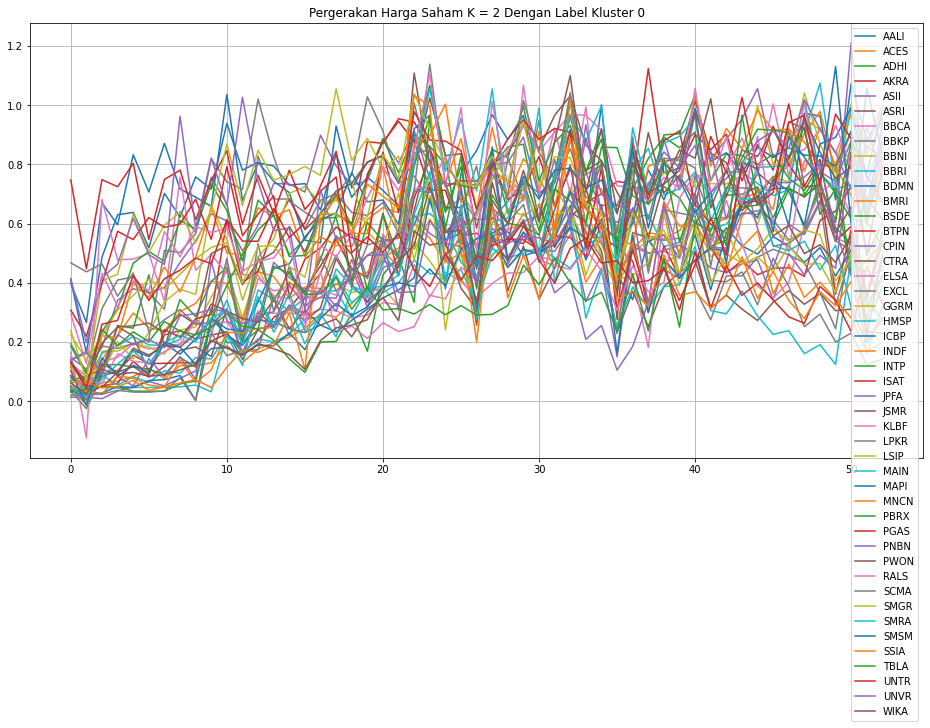

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 2 Dengan Label Kluster 0')
plt.plot(AALI, label='AALI')
plt.plot(ACES, label='ACES')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(ASII, label='ASII')
plt.plot(ASRI, label='ASRI')
plt.plot(BBCA, label='BBCA')
plt.plot(BBKP, label='BBKP')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BDMN, label='BDMN')
plt.plot(BMRI, label='BMRI')
plt.plot(BSDE, label='BSDE')
plt.plot(BTPN, label='BTPN')
plt.plot(CPIN, label='CPIN')
plt.plot(CTRA, label='CTRA')
plt.plot(ELSA, label='ELSA')
plt.plot(EXCL, label='EXCL')
plt.plot(GGRM, label='GGRM')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(INDF, label='INDF')
plt.plot(INTP, label='INTP')
plt.plot(ISAT, label='ISAT')
plt.plot(JPFA, label='JPFA')
plt.plot(JSMR, label='JSMR')
plt.plot(KLBF, label='KLBF')
plt.plot(LPKR, label='LPKR')
plt.plot(LSIP, label='LSIP')
plt.plot(MAIN, label='MAIN')
plt.plot(MAPI, label='MAPI')
plt.plot(MNCN, label='MNCN')
plt.plot(PBRX, label='PBRX')
plt.plot(PGAS, label='PGAS')
plt.plot(PNBN, label='PNBN')
plt.plot(PWON, label='PWON')
plt.plot(RALS, label='RALS')
plt.plot(SCMA, label='SCMA')
plt.plot(SMGR, label='SMGR')
plt.plot(SMRA, label='SMRA')
plt.plot(SMSM, label='SMSM')
plt.plot(SSIA, label='SSIA')
plt.plot(TBLA, label='TBLA')
plt.plot(UNTR, label='UNTR')
plt.plot(UNVR, label='UNVR')
plt.plot(WIKA, label='WIKA')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 1**

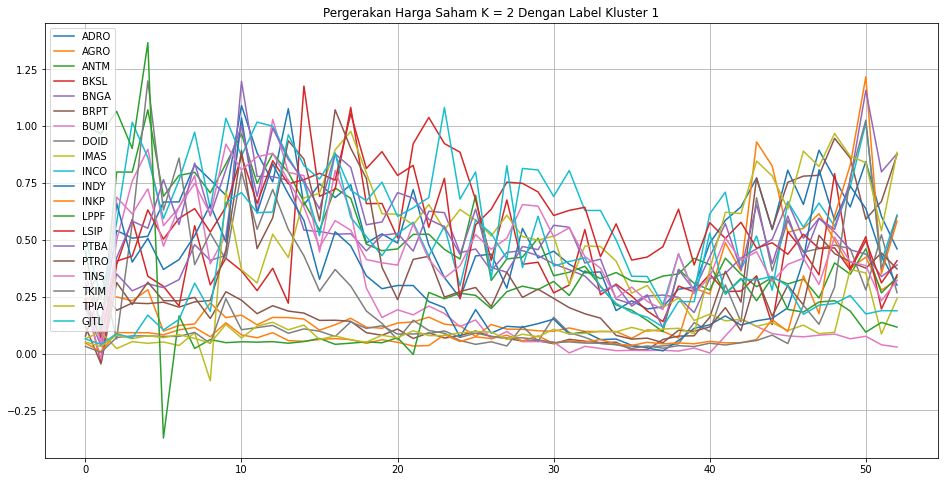

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 2 Dengan Label Kluster 1')
plt.plot(ADRO, label='ADRO')
plt.plot(AGRO, label='AGRO')
plt.plot(ANTM, label='ANTM')
plt.plot(BKSL, label='BKSL')
plt.plot(BNGA, label='BNGA')
plt.plot(BRPT, label='BRPT')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(IMAS, label='IMAS')
plt.plot(INCO, label='INCO')
plt.plot(INDY, label='INDY')
plt.plot(INKP, label='INKP')
plt.plot(LPPF, label='LPPF')
plt.plot(LSIP, label='LSIP')
plt.plot(PTBA, label='PTBA')
plt.plot(PTRO, label='PTRO')
plt.plot(TINS, label='TINS')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')
plt.plot(GJTL, label='GJTL')
plt.grid()
plt.legend(loc='best')
plt.show()

**K = 3**

**Kluster Label 0**

No handles with labels found to put in legend.


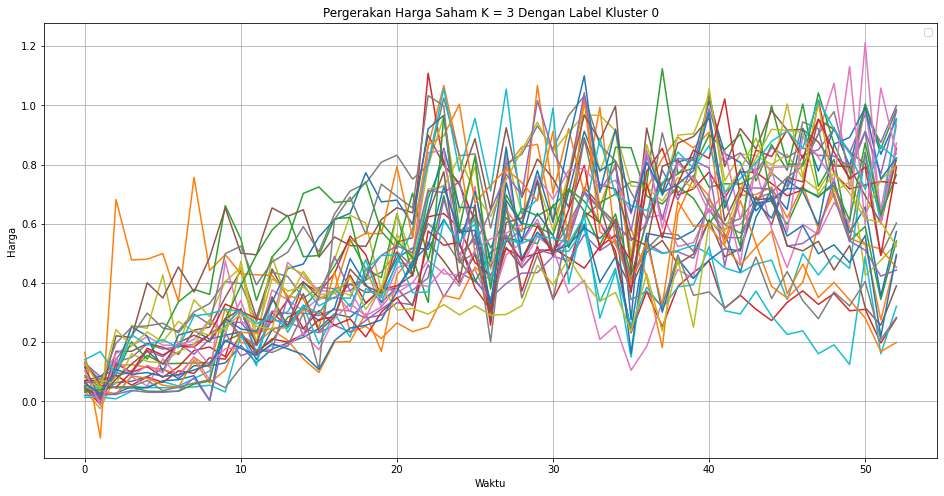

In [ ]:

plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 3 Dengan Label Kluster 0')

plt.plot(ACES)
plt.plot(ADHI)
plt.plot(AKRA)
plt.plot(ASRI)
plt.plot(BBCA)
plt.plot(BBNI)
plt.plot(BBRI)
plt.plot(BMRI)
plt.plot(BSDE)
plt.plot(CPIN)
plt.plot(CTRA)
plt.plot(ELSA)
plt.plot(GGRM)
plt.plot(HMSP)
plt.plot(ICBP)
plt.plot(INDF)
plt.plot(JPFA)
plt.plot(JSMR)
plt.plot(KLBF)
plt.plot(MAIN)
plt.plot(MAPI)
plt.plot(MNCN)
plt.plot(PBRX)
plt.plot(PWON)
plt.plot(SCMA)
plt.plot(SMRA)
plt.plot(SMSM)
plt.plot(SSIA)
plt.plot(TBLA)
plt.plot(UNVR)
plt.plot(WIKA)
plt.xlabel('Waktu')
plt.ylabel('Harga')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 1**

No handles with labels found to put in legend.


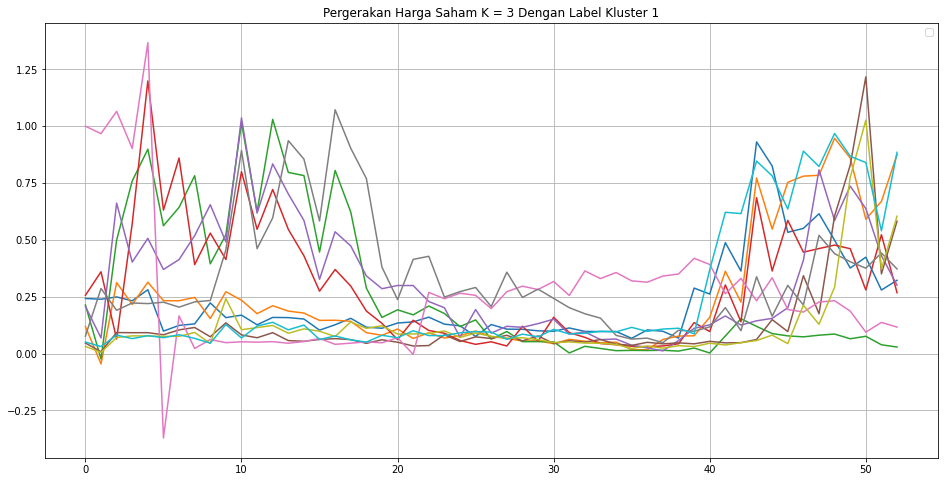

In [ ]:

plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 3 Dengan Label Kluster 1')

plt.plot(AGRO)
plt.plot(BRPT)
plt.plot(BUMI)
plt.plot(DOID)
plt.plot(INDY)
plt.plot(INKP)
plt.plot(LPPF)
plt.plot(PTRO)
plt.plot(TKIM)
plt.plot(TPIA)
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 2**

No handles with labels found to put in legend.


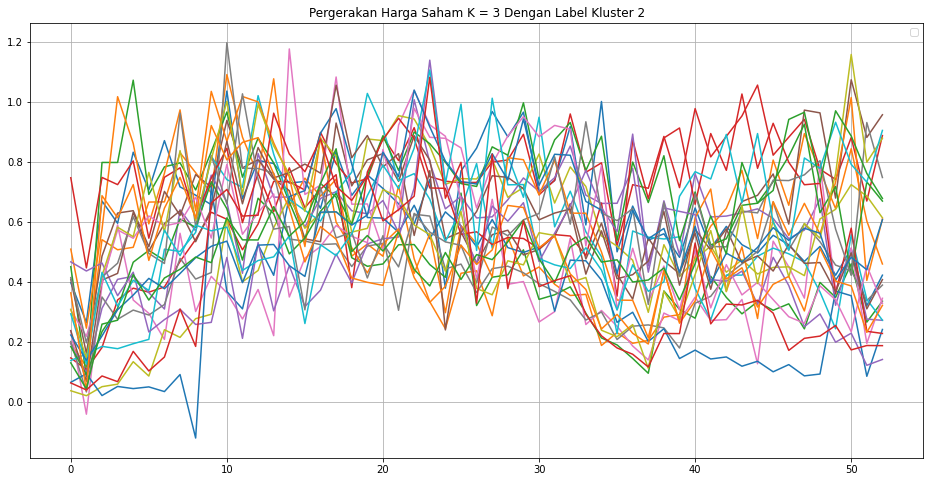

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 3 Dengan Label Kluster 2')
plt.plot(AALI)
plt.plot(ADRO)
plt.plot(ANTM)
plt.plot(ASII)
plt.plot(BBKP)
plt.plot(BDMN)
plt.plot(BKSL)
plt.plot(BNGA)
plt.plot(BTPN)
plt.plot(EXCL)
plt.plot(IMAS)
plt.plot(INCO)
plt.plot(INTP)
plt.plot(ISAT)
plt.plot(LPKR)
plt.plot(LSIP)
plt.plot(PGAS)
plt.plot(PNBN)
plt.plot(PTBA)
plt.plot(RALS)
plt.plot(SMGR)
plt.plot(TINS)
plt.plot(UNTR)
plt.plot(GJTL)
plt.grid()
plt.legend(loc='best')
plt.show()

**K = 4**

**Kluster Label 0**

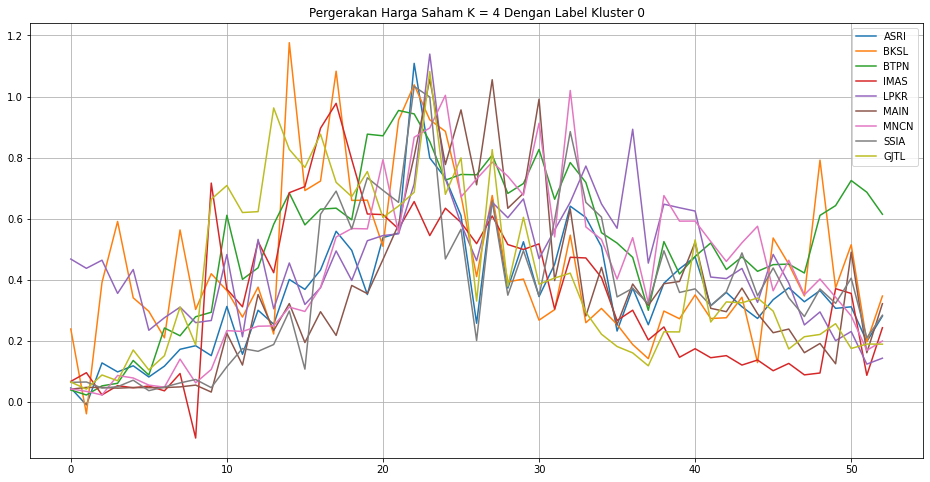

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 4 Dengan Label Kluster 0')
plt.plot(ASRI, label='ASRI')
plt.plot(BKSL, label='BKSL')
plt.plot(BTPN, label='BTPN')
plt.plot(IMAS, label='IMAS')
plt.plot(LPKR, label='LPKR')
plt.plot(MAIN, label='MAIN')
plt.plot(MNCN, label='MNCN')
plt.plot(SSIA, label='SSIA')
plt.plot(GJTL, label='GJTL')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 1**

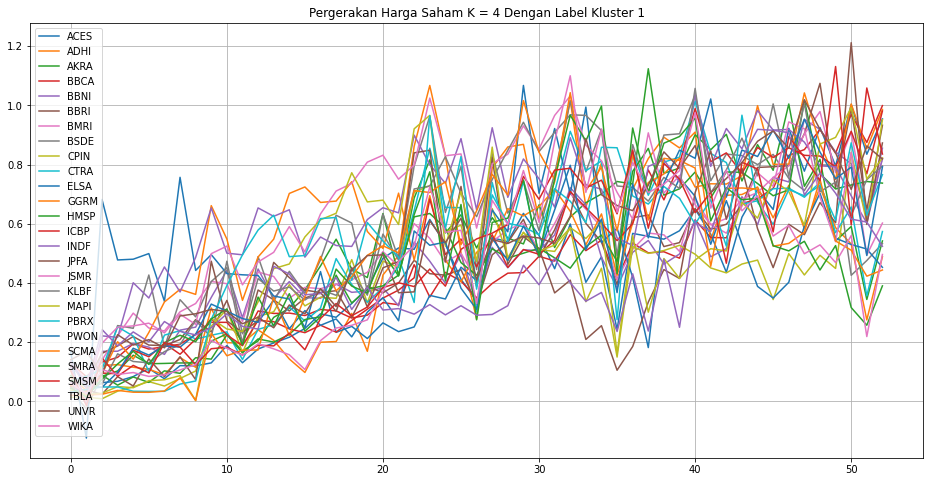

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 4 Dengan Label Kluster 1')
plt.plot(ACES, label='ACES')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(BBCA, label='BBCA')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BMRI, label='BMRI')
plt.plot(BSDE, label='BSDE')
plt.plot(CPIN, label='CPIN')
plt.plot(CTRA, label='CTRA')
plt.plot(ELSA, label='ELSA')
plt.plot(GGRM, label='GGRM')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(INDF, label='INDF')
plt.plot(JPFA, label='JPFA')
plt.plot(JSMR, label='JSMR')
plt.plot(KLBF, label='KLBF')
plt.plot(MAPI, label='MAPI')
plt.plot(PBRX, label='PBRX')
plt.plot(PWON, label='PWON')
plt.plot(SCMA, label='SCMA')
plt.plot(SMRA, label='SMRA')
plt.plot(SMSM, label='SMSM')
plt.plot(TBLA, label='TBLA')
plt.plot(UNVR, label='UNVR')
plt.plot(WIKA, label='WIKA')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 2**

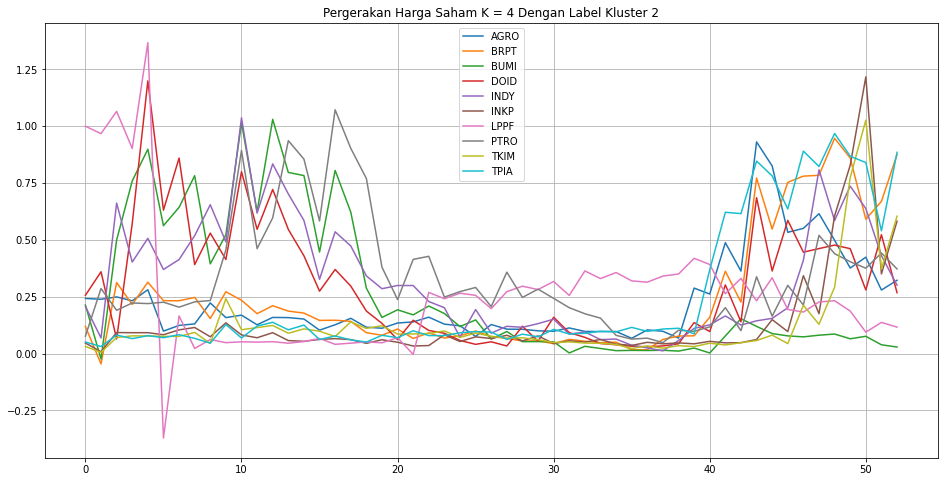

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 4 Dengan Label Kluster 2')
plt.plot(AGRO, label='AGRO')
plt.plot(BRPT, label='BRPT')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(INDY, label='INDY')
plt.plot(INKP, label='INKP')
plt.plot(LPPF, label='LPPF')
plt.plot(PTRO, label='PTRO')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 3**

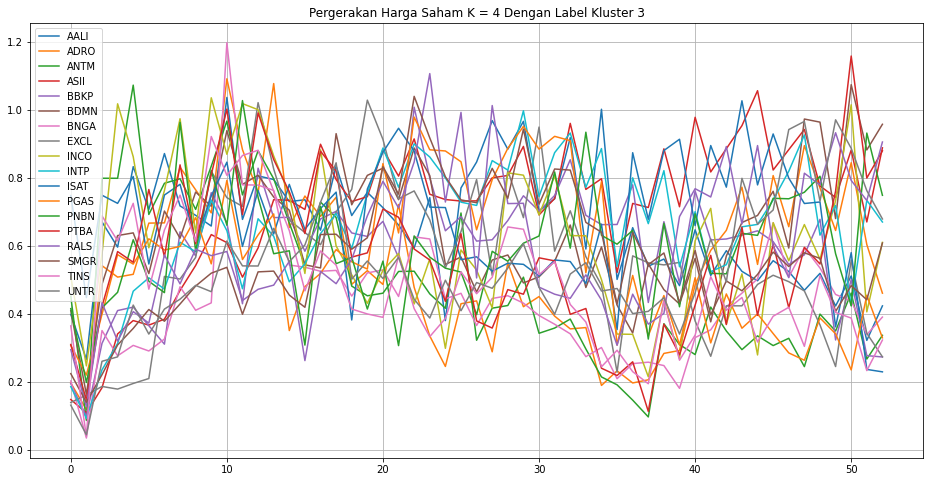

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 4 Dengan Label Kluster 3')
plt.plot(AALI, label='AALI')
plt.plot(ADRO, label='ADRO')
plt.plot(ANTM, label='ANTM')
plt.plot(ASII, label='ASII')
plt.plot(BBKP, label='BBKP')
plt.plot(BDMN, label='BDMN')
plt.plot(BNGA, label='BNGA')
plt.plot(EXCL, label='EXCL')
plt.plot(INCO, label='INCO')
plt.plot(INTP, label='INTP')
plt.plot(ISAT, label='ISAT')
plt.plot(PGAS, label='PGAS')
plt.plot(PNBN, label='PNBN')
plt.plot(PTBA, label='PTBA')
plt.plot(RALS, label='RALS')
plt.plot(SMGR, label='SMGR')
plt.plot(TINS, label='TINS')
plt.plot(UNTR, label='UNTR')
plt.grid()
plt.legend(loc='best')
plt.show()

**K = 5**

**Kluster Label 0**

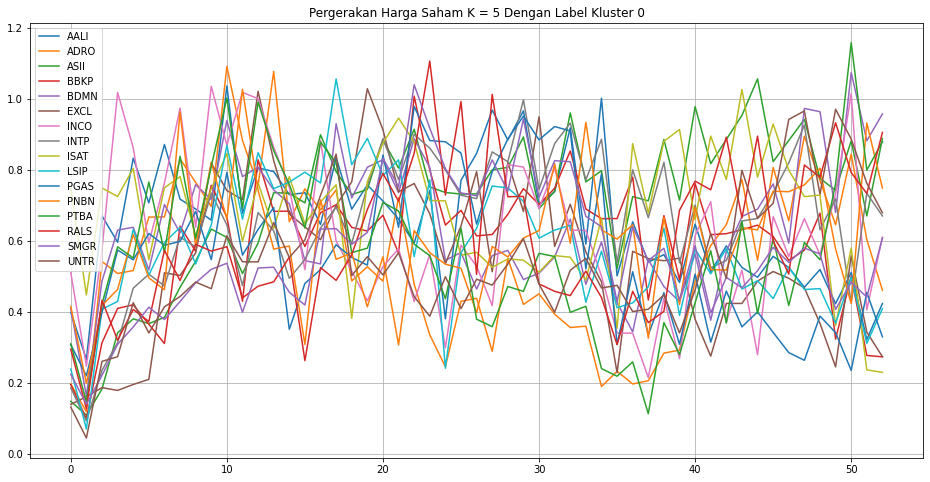

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 5 Dengan Label Kluster 0')
plt.plot(AALI, label='AALI')
plt.plot(ADRO, label='ADRO')
plt.plot(ASII, label='ASII')
plt.plot(BBKP, label='BBKP')
plt.plot(BDMN, label='BDMN')
plt.plot(EXCL, label='EXCL')
plt.plot(INCO, label='INCO')
plt.plot(INTP, label='INTP')
plt.plot(ISAT, label='ISAT')
plt.plot(LSIP, label='LSIP')
plt.plot(PGAS, label='PGAS')
plt.plot(PNBN, label='PNBN')
plt.plot(PTBA, label='PTBA')
plt.plot(RALS, label='RALS')
plt.plot(SMGR, label='SMGR')
plt.plot(UNTR, label='UNTR')

plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 1**

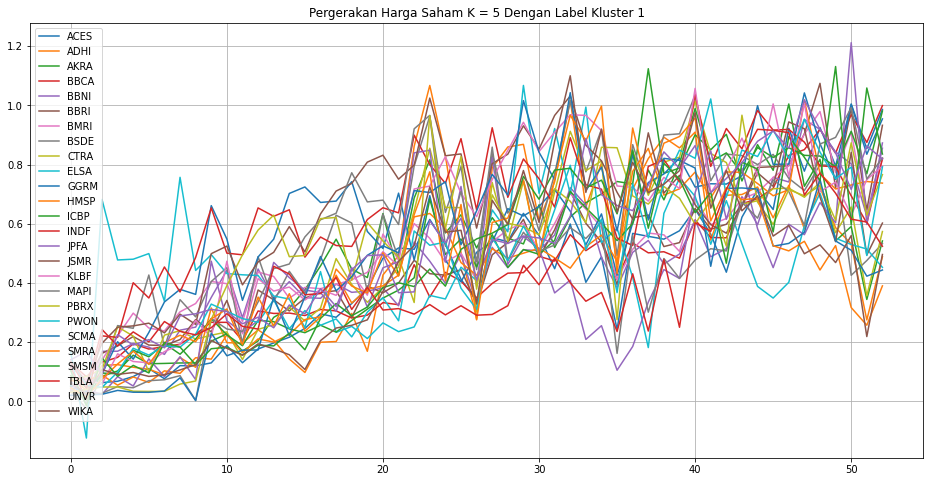

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 5 Dengan Label Kluster 1')
plt.plot(ACES, label='ACES')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(BBCA, label='BBCA')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BMRI, label='BMRI')
plt.plot(BSDE, label='BSDE')
plt.plot(CTRA, label='CTRA')
plt.plot(ELSA, label='ELSA')
plt.plot(GGRM, label='GGRM')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(INDF, label='INDF')
plt.plot(JPFA, label='JPFA')
plt.plot(JSMR, label='JSMR')
plt.plot(KLBF, label='KLBF')
plt.plot(MAPI, label='MAPI')
plt.plot(PBRX, label='PBRX')
plt.plot(PWON, label='PWON')
plt.plot(SCMA, label='SCMA')
plt.plot(SMRA, label='SMRA')
plt.plot(SMSM, label='SMSM')
plt.plot(TBLA, label='TBLA')
plt.plot(UNVR, label='UNVR')
plt.plot(WIKA, label='WIKA')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 2**

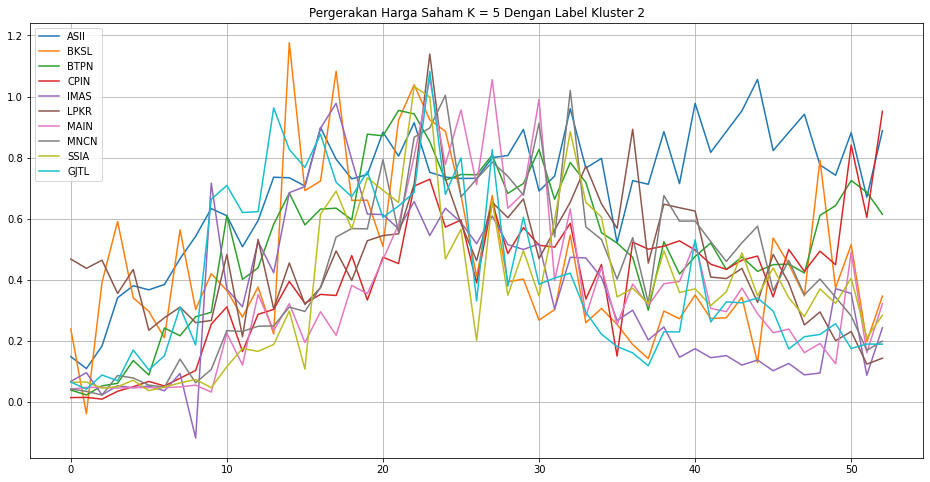

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 5 Dengan Label Kluster 2')
plt.plot(ASII, label='ASII')
plt.plot(BKSL, label='BKSL')
plt.plot(BTPN, label='BTPN')
plt.plot(CPIN, label='CPIN')
plt.plot(IMAS, label='IMAS')
plt.plot(LPKR, label='LPKR')
plt.plot(MAIN, label='MAIN')
plt.plot(MNCN, label='MNCN')
plt.plot(SSIA, label='SSIA')
plt.plot(GJTL, label='GJTL')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 3**

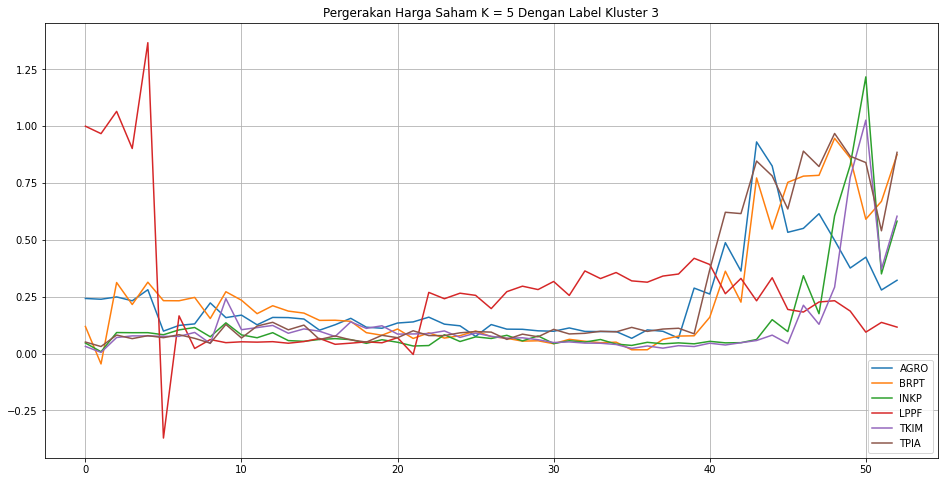

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 5 Dengan Label Kluster 3')
plt.plot(AGRO, label='AGRO')
plt.plot(BRPT, label='BRPT')
plt.plot(INKP, label='INKP')
plt.plot(LPPF, label='LPPF')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster Label 4**

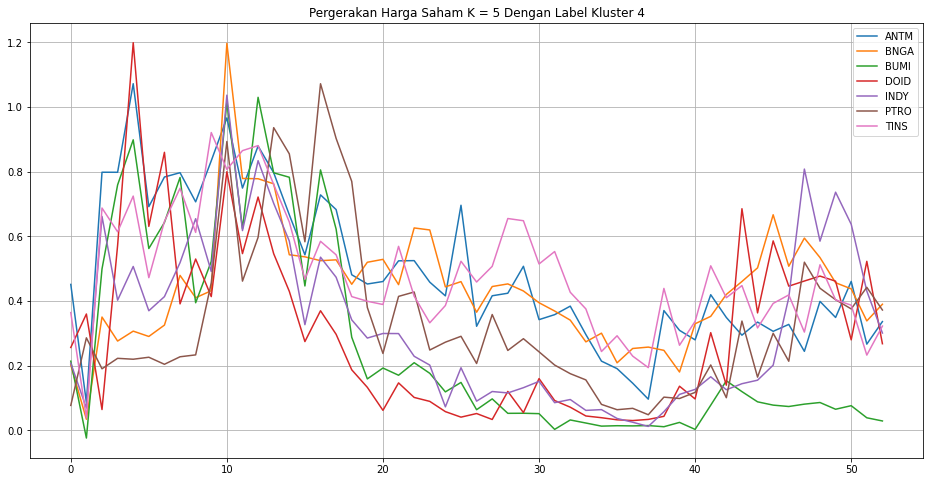

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 5 Dengan Label Kluster 4')

plt.plot(ANTM, label='ANTM')
plt.plot(BNGA, label='BNGA')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(INDY, label='INDY')
plt.plot(PTRO, label='PTRO')
plt.plot(TINS, label='TINS')
plt.grid()
plt.legend(loc='best')
plt.show()

**K = 6**

**Kluster label 0**

No handles with labels found to put in legend.


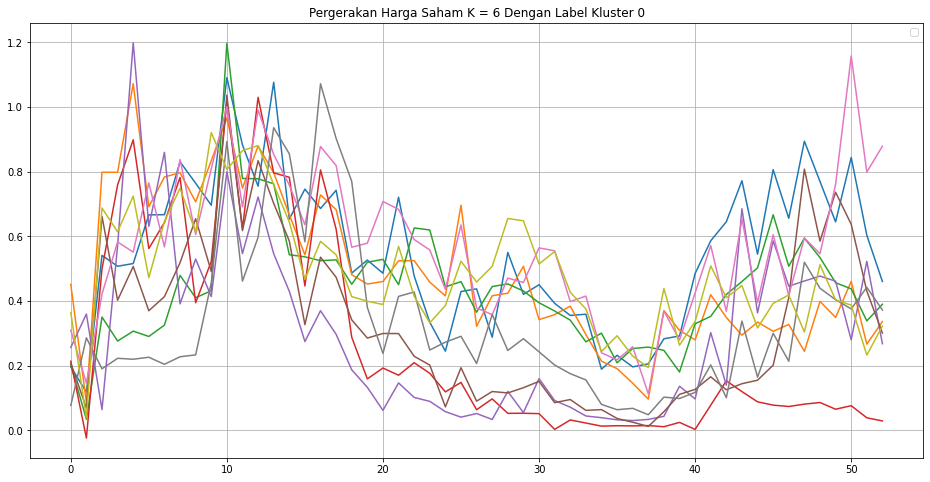

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 6 Dengan Label Kluster 0')
plt.plot(ADRO)
plt.plot(ANTM)
plt.plot(BNGA)
plt.plot(BUMI)
plt.plot(DOID)
plt.plot(INDY)
plt.plot(PTBA)
plt.plot(PTRO)
plt.plot(TINS)
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 1**

No handles with labels found to put in legend.


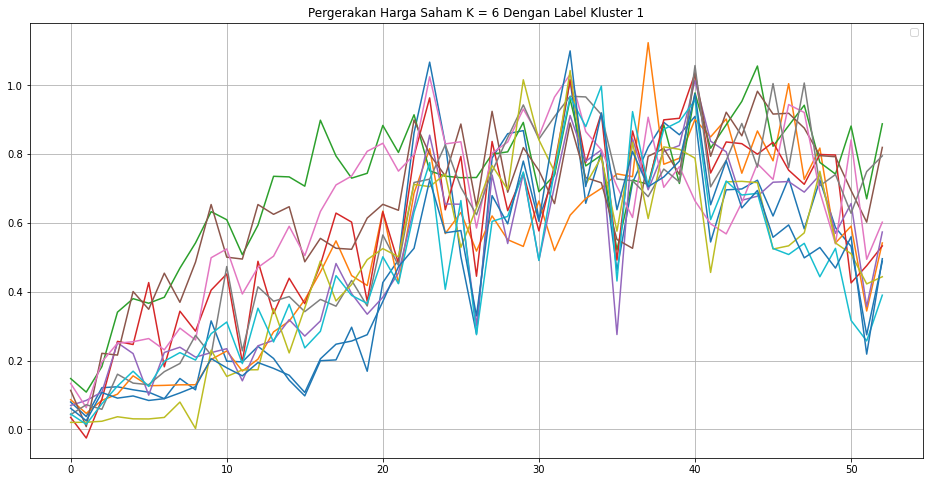

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 6 Dengan Label Kluster 1')
plt.plot(ADHI)
plt.plot(AKRA)
plt.plot(ASII)
plt.plot(BSDE)
plt.plot(CTRA)
plt.plot(INDF)
plt.plot(JSMR)
plt.plot(KLBF)
plt.plot(SCMA)
plt.plot(SMRA)
plt.plot(WIKA)
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 2**

No handles with labels found to put in legend.


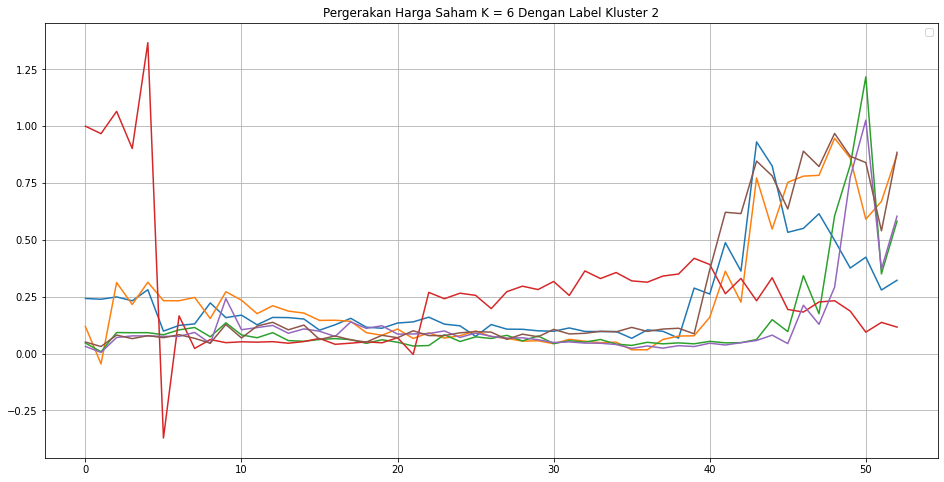

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 6 Dengan Label Kluster 2')
plt.plot(AGRO)
plt.plot(BRPT)
plt.plot(INKP)
plt.plot(LPPF)
plt.plot(TKIM)
plt.plot(TPIA)
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 3**

No handles with labels found to put in legend.


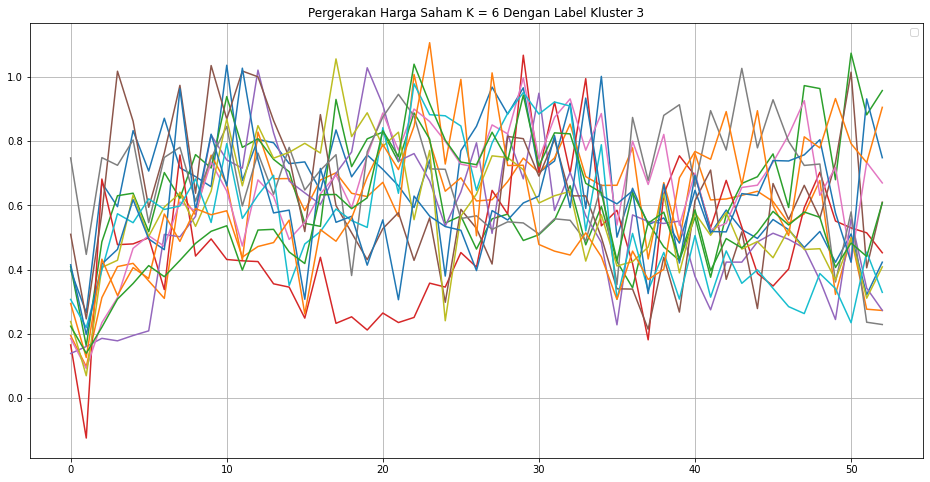

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 6 Dengan Label Kluster 3')
plt.plot(AALI)
plt.plot(BBKP)
plt.plot(BDMN)
plt.plot(ELSA)
plt.plot(EXCL)
plt.plot(INCO)
plt.plot(INTP)
plt.plot(ISAT)
plt.plot(LSIP)
plt.plot(PGAS)
plt.plot(PNBN)
plt.plot(RALS)
plt.plot(SMGR)
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 4**

No handles with labels found to put in legend.


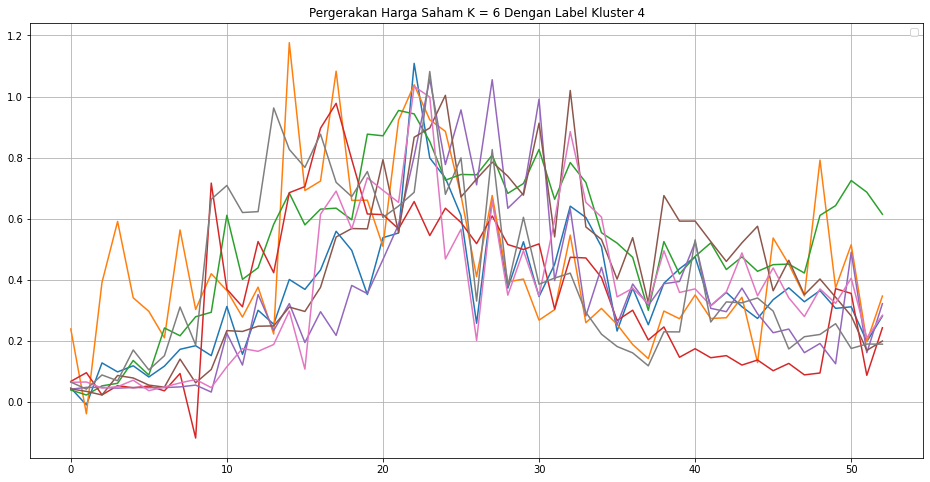

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 6 Dengan Label Kluster 4')
plt.plot(ASRI)
plt.plot(BKSL)
plt.plot(BTPN)
plt.plot(IMAS)
plt.plot(MAIN)
plt.plot(MNCN)
plt.plot(SSIA)
plt.plot(GJTL)
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 5**

No handles with labels found to put in legend.


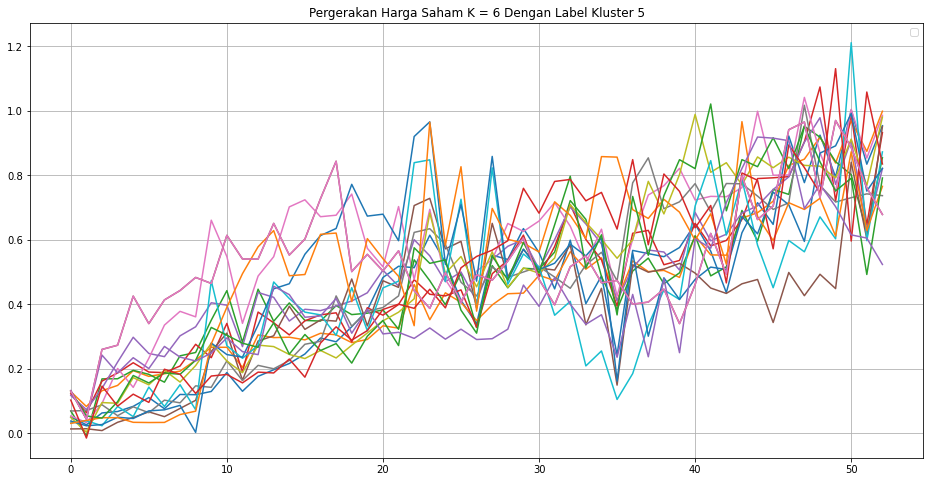

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 6 Dengan Label Kluster 5')
plt.plot(ACES)
plt.plot(BBCA)
plt.plot(BBNI)
plt.plot(BBRI)
plt.plot(BMRI)
plt.plot(CPIN)
plt.plot(GGRM)
plt.plot(HMSP)
plt.plot(ICBP)
plt.plot(JPFA)
plt.plot(MAPI)
plt.plot(PBRX)
plt.plot(PWON)
plt.plot(SMSM)
plt.plot(TBLA)
plt.plot(UNTR)
plt.plot(UNTR)
plt.grid()
plt.legend(loc='best')
plt.show()

K = 7

**Kluster label 0**

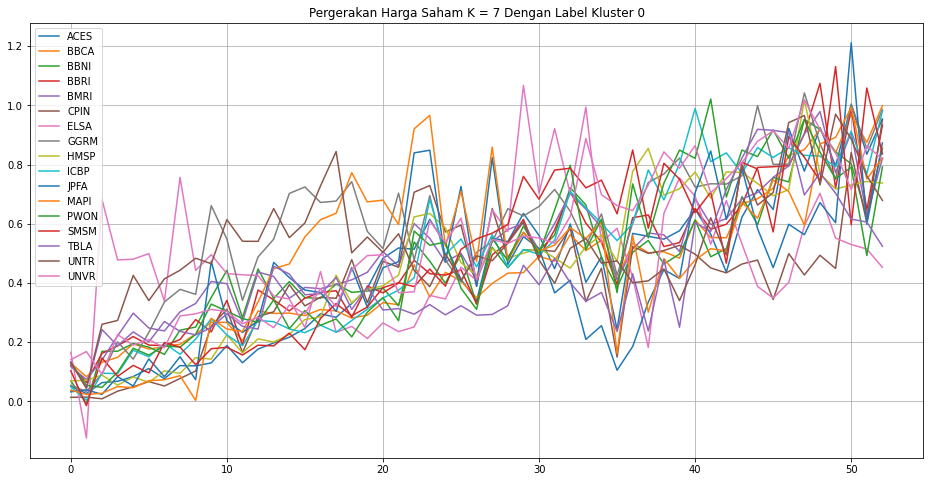

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 0')
plt.plot(ACES, label='ACES')
plt.plot(BBCA, label='BBCA')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BMRI, label='BMRI')
plt.plot(CPIN, label='CPIN')
plt.plot(ELSA, label='ELSA')
plt.plot(GGRM, label='GGRM')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(JPFA, label='JPFA')
plt.plot(MAPI, label='MAPI')
plt.plot(PWON, label='PWON')
plt.plot(SMSM, label='SMSM')
plt.plot(TBLA, label='TBLA')
plt.plot(UNTR, label='UNTR')
plt.plot(UNVR, label='UNVR')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 1**

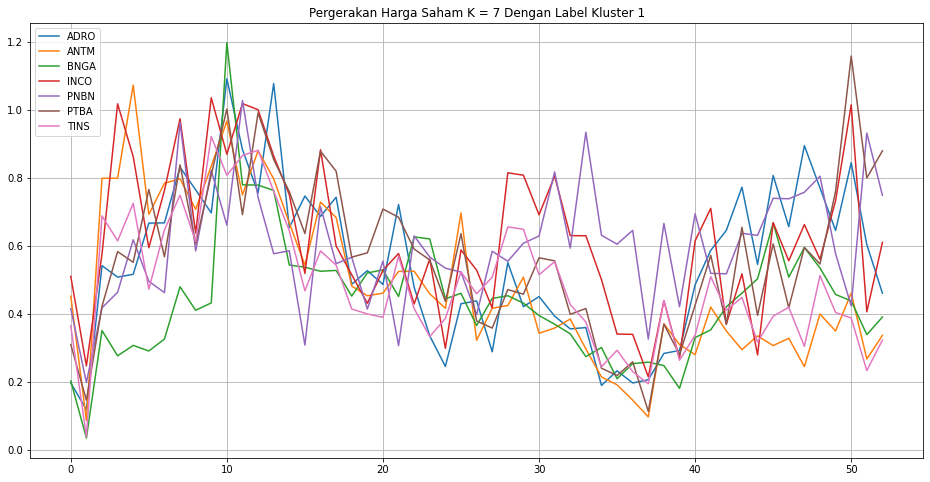

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 1')
plt.plot(ADRO, label='ADRO')
plt.plot(ANTM, label='ANTM')
plt.plot(BNGA, label='BNGA')
plt.plot(INCO, label='INCO')
plt.plot(PNBN, label='PNBN')
plt.plot(PTBA, label='PTBA')
plt.plot(TINS, label='TINS')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 2**

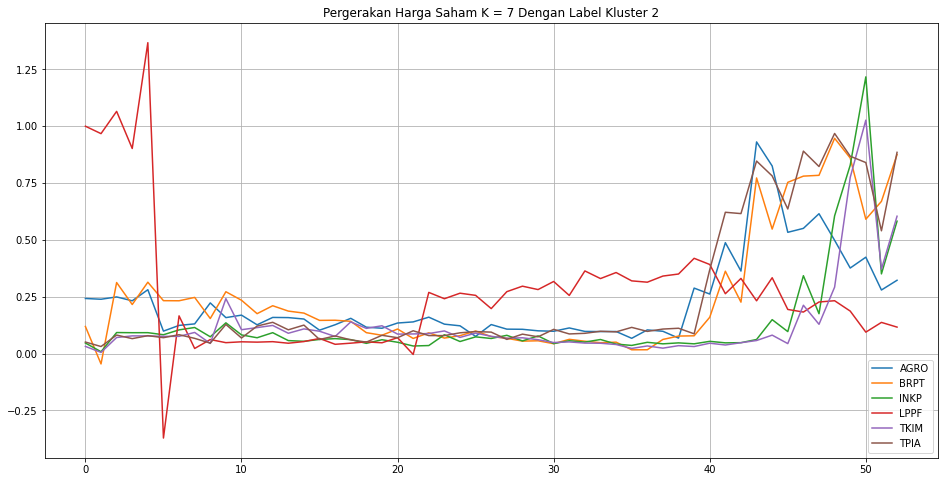

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 2')
plt.plot(AGRO, label='AGRO')
plt.plot(BRPT, label='BRPT')
plt.plot(INKP, label='INKP')
plt.plot(LPPF, label='LPPF')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 3**

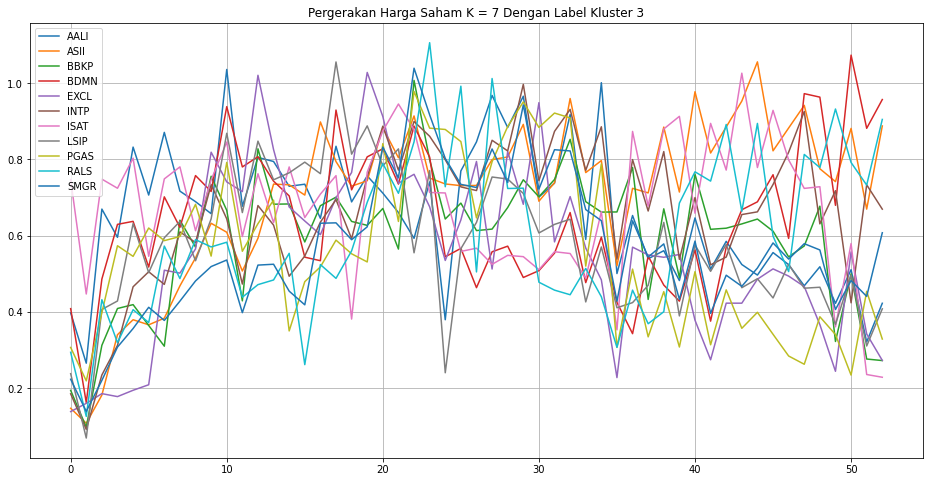

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 3')
plt.plot(AALI, label='AALI')
plt.plot(ASII, label='ASII')
plt.plot(BBKP, label='BBKP')
plt.plot(BDMN, label='BDMN')
plt.plot(EXCL, label='EXCL')
plt.plot(INTP, label='INTP')
plt.plot(ISAT, label='ISAT')
plt.plot(LSIP, label='LSIP')
plt.plot(PGAS, label='PGAS')
plt.plot(RALS, label='RALS')
plt.plot(SMGR, label='SMGR')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 4**

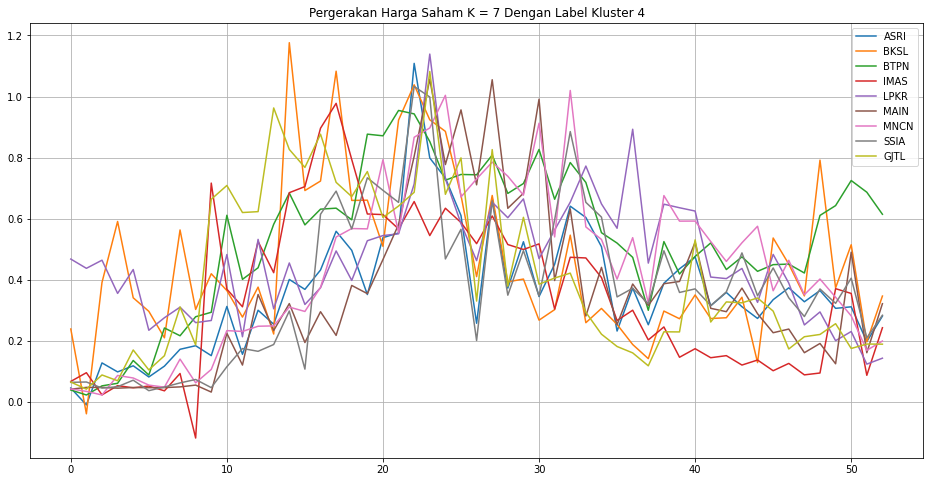

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 4')
plt.plot(ASRI, label='ASRI')
plt.plot(BKSL, label='BKSL')
plt.plot(BTPN, label='BTPN')
plt.plot(IMAS, label='IMAS')
plt.plot(LPKR, label='LPKR')
plt.plot(MAIN, label='MAIN')
plt.plot(MNCN, label='MNCN')
plt.plot(SSIA, label='SSIA')
plt.plot(GJTL, label='GJTL')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 5**

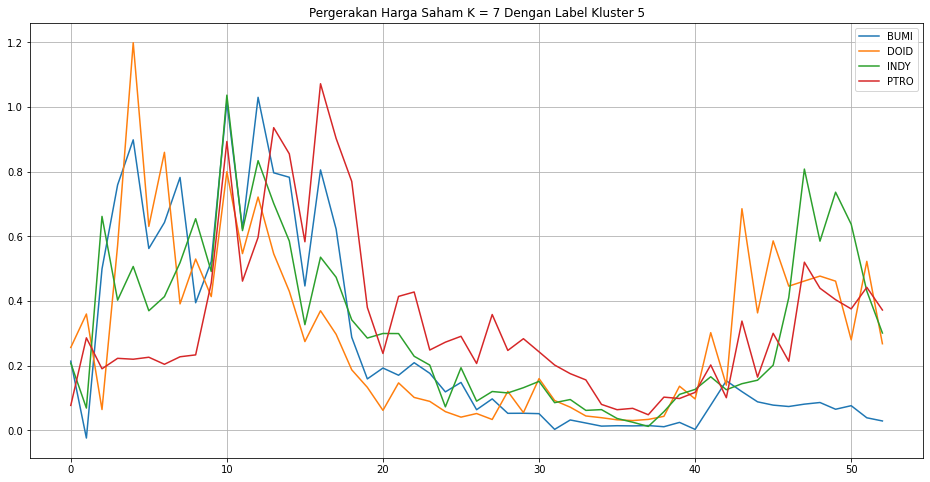

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 5')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(INDY, label='INDY')
plt.plot(PTRO, label='PTRO')
plt.grid()
plt.legend(loc='best')
plt.show()

**Kluster label 6**

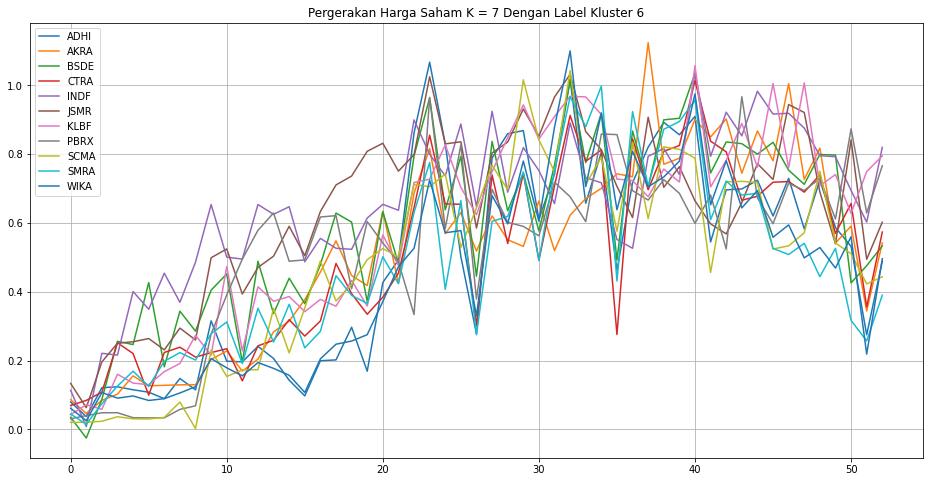

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 7 Dengan Label Kluster 6')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(BSDE, label='BSDE')
plt.plot(CTRA, label='CTRA')
plt.plot(INDF, label='INDF')
plt.plot(JSMR, label='JSMR')
plt.plot(KLBF, label='KLBF')
plt.plot(PBRX, label='PBRX')
plt.plot(SCMA, label='SCMA')
plt.plot(SMRA, label='SMRA')
plt.plot(WIKA, label='WIKA')
plt.grid()
plt.legend(loc='best')
plt.show()

**K = 8**

**Kluster label 0**

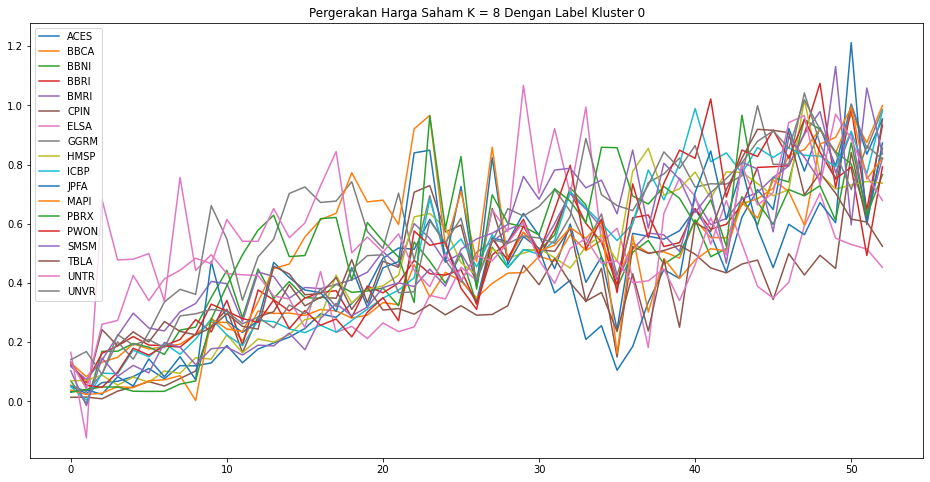

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 0')
plt.plot(ACES, label='ACES')
plt.plot(BBCA, label='BBCA')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BMRI, label='BMRI')
plt.plot(CPIN, label='CPIN')
plt.plot(ELSA, label='ELSA')
plt.plot(GGRM, label='GGRM')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(JPFA, label='JPFA')
plt.plot(MAPI, label='MAPI')
plt.plot(PBRX, label='PBRX')
plt.plot(PWON, label='PWON')
plt.plot(SMSM, label='SMSM')
plt.plot(TBLA, label='TBLA')
plt.plot(UNTR, label='UNTR')
plt.plot(UNVR, label='UNVR')
plt.legend(loc='best')
plt.show()

**Kluster label 1**

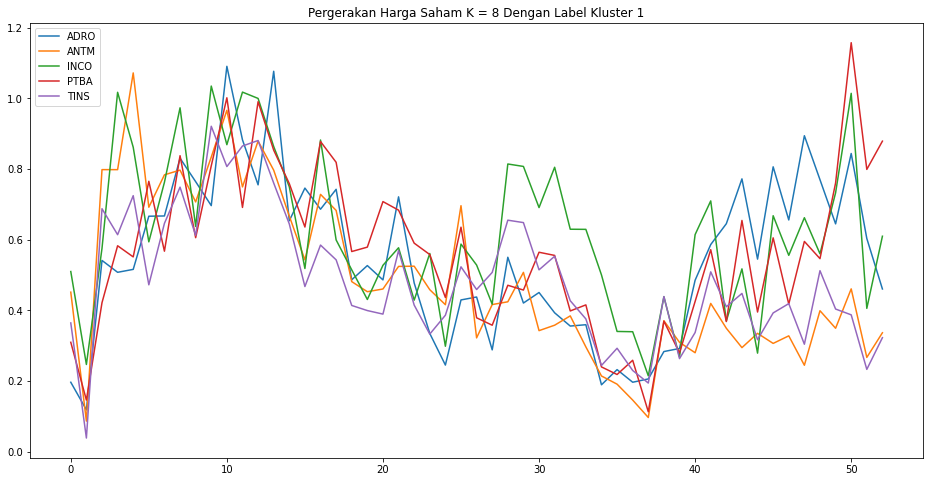

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 1')
plt.plot(ADRO, label='ADRO')
plt.plot(ANTM, label='ANTM')
plt.plot(INCO, label='INCO')
plt.plot(PTBA, label='PTBA')
plt.plot(TINS, label='TINS')
plt.legend(loc='best')
plt.show()

**Kluster label 2**

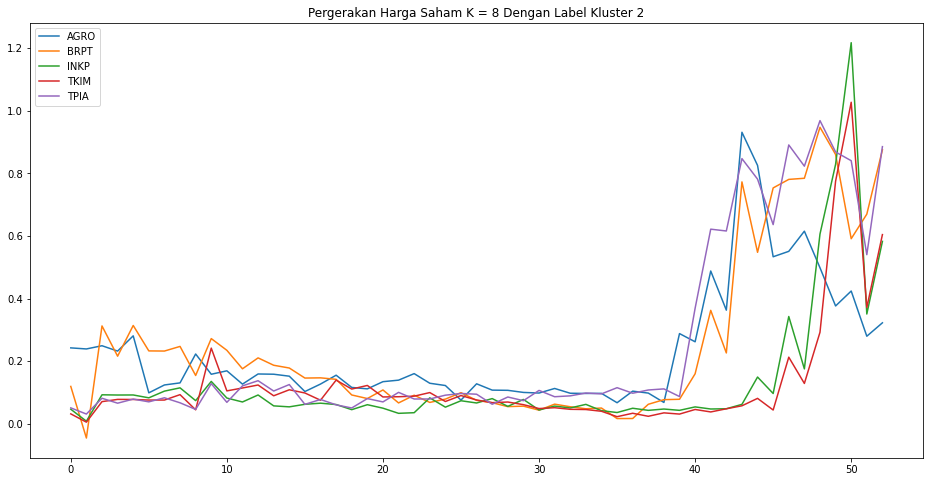

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 2')
plt.plot(AGRO, label='AGRO')
plt.plot(BRPT, label='BRPT')
plt.plot(INKP, label='INKP')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')
plt.legend(loc='best')
plt.show()

**Kluster label 3**

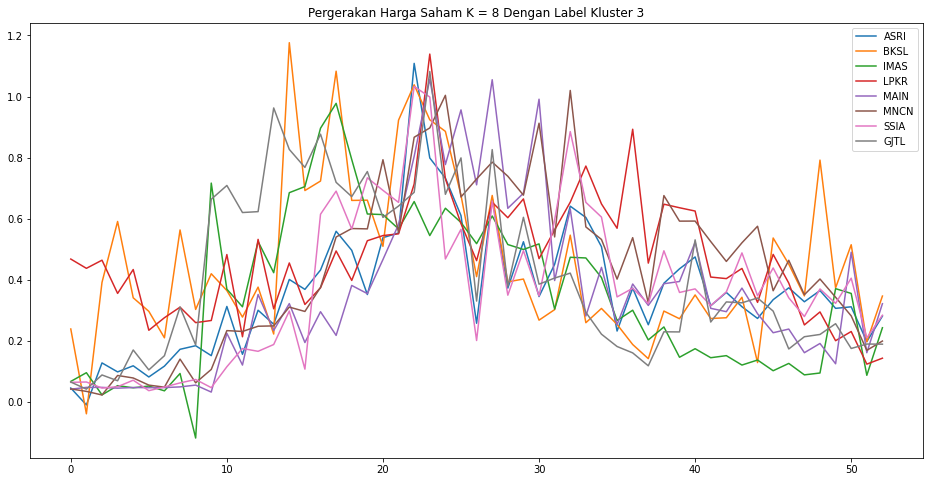

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 3')
plt.plot(ASRI, label='ASRI')
plt.plot(BKSL, label='BKSL')
plt.plot(IMAS, label='IMAS')
plt.plot(LPKR, label='LPKR')
plt.plot(MAIN, label='MAIN')
plt.plot(MNCN, label='MNCN')
plt.plot(SSIA, label='SSIA')
plt.plot(GJTL, label='GJTL')
plt.legend(loc='best')
plt.show()

**Kluster label 4**

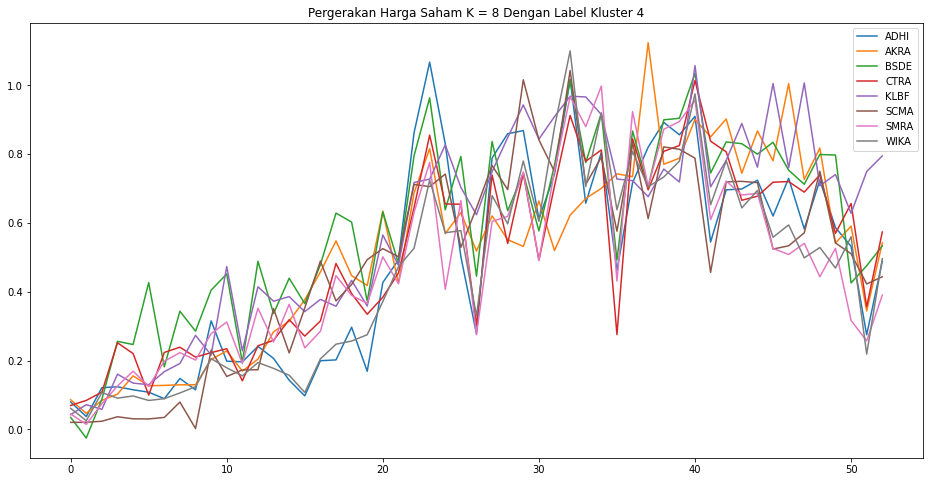

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 4')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(BSDE, label='BSDE')
plt.plot(CTRA, label='CTRA')
plt.plot(KLBF, label='KLBF')
plt.plot(SCMA, label='SCMA')
plt.plot(SMRA, label='SMRA')
plt.plot(WIKA, label='WIKA')
plt.legend(loc='best')
plt.show()

**Kluster label 5**

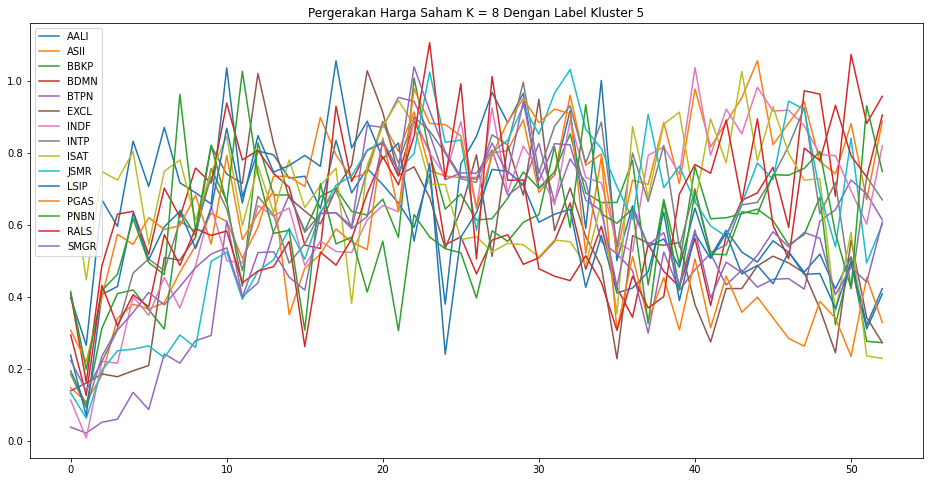

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 5')

plt.plot(AALI, label='AALI')
plt.plot(ASII, label='ASII')
plt.plot(BBKP, label='BBKP')
plt.plot(BDMN, label='BDMN')
plt.plot(BTPN, label='BTPN')
plt.plot(EXCL, label='EXCL')
plt.plot(INDF, label='INDF')
plt.plot(INTP, label='INTP')
plt.plot(ISAT, label='ISAT')
plt.plot(JSMR, label='JSMR')
plt.plot(LSIP, label='LSIP')
plt.plot(PGAS, label='PGAS')
plt.plot(PNBN, label='PNBN')
plt.plot(RALS, label='RALS')
plt.plot(SMGR, label='SMGR')
plt.legend(loc='best')
plt.show()

**Kluster label 6**

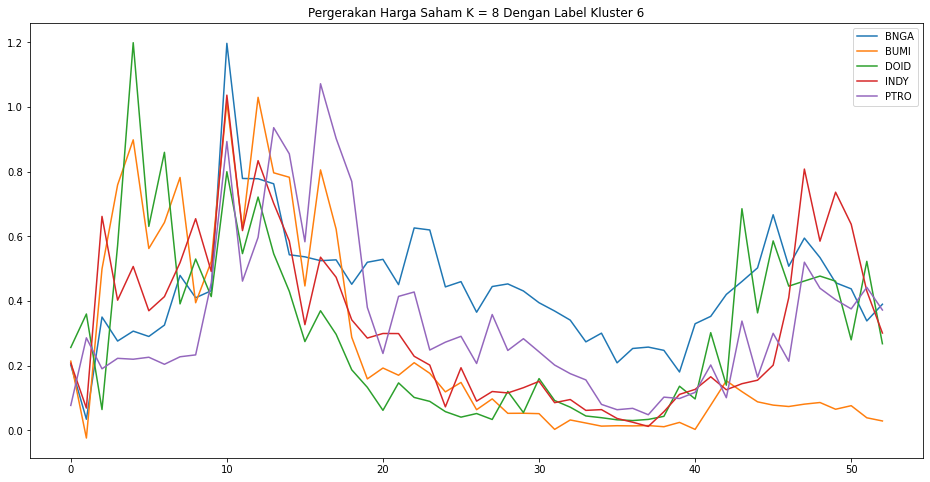

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 6')
plt.plot(BNGA, label='BNGA')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(INDY, label='INDY')
plt.plot(PTRO, label='PTRO')
plt.legend(loc='best')
plt.show()

**Kluster label 7**

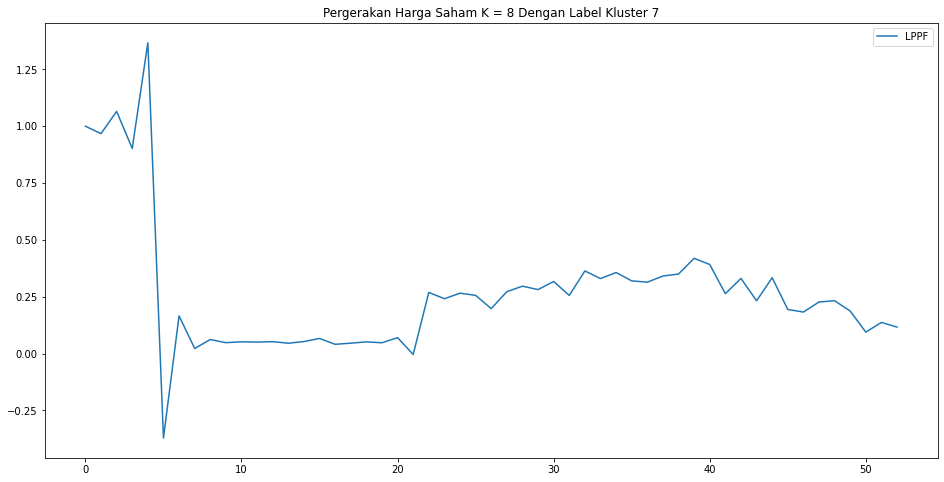

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 8 Dengan Label Kluster 7')
plt.plot(LPPF, label='LPPF')
plt.legend(loc='best')
plt.show()

**K = 9**

**Kluster label 0**

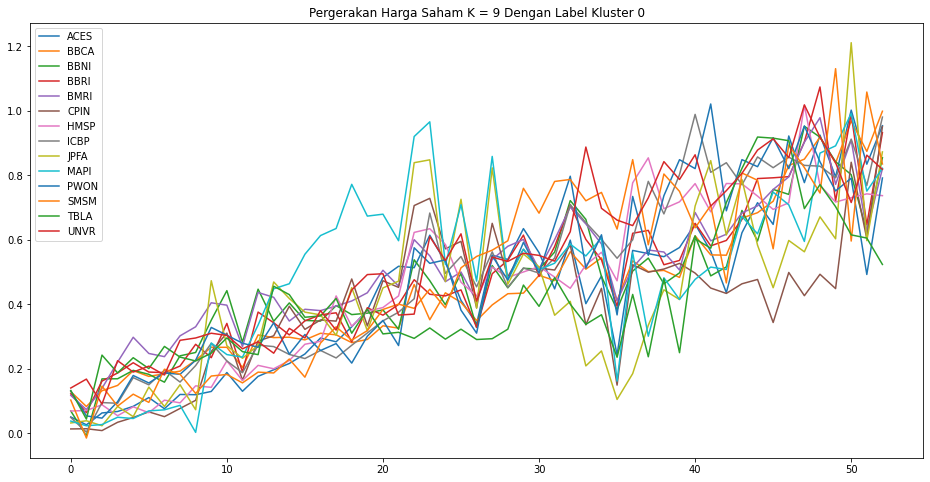

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 0')
plt.plot(ACES, label='ACES')
plt.plot(BBCA, label='BBCA')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BMRI, label='BMRI')
plt.plot(CPIN, label='CPIN')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(JPFA, label='JPFA')
plt.plot(MAPI, label='MAPI')
plt.plot(PWON, label='PWON')
plt.plot(SMSM, label='SMSM')
plt.plot(TBLA, label='TBLA')
plt.plot(UNVR, label='UNVR')
plt.legend(loc='best')
plt.show()

**Kluster label 1**

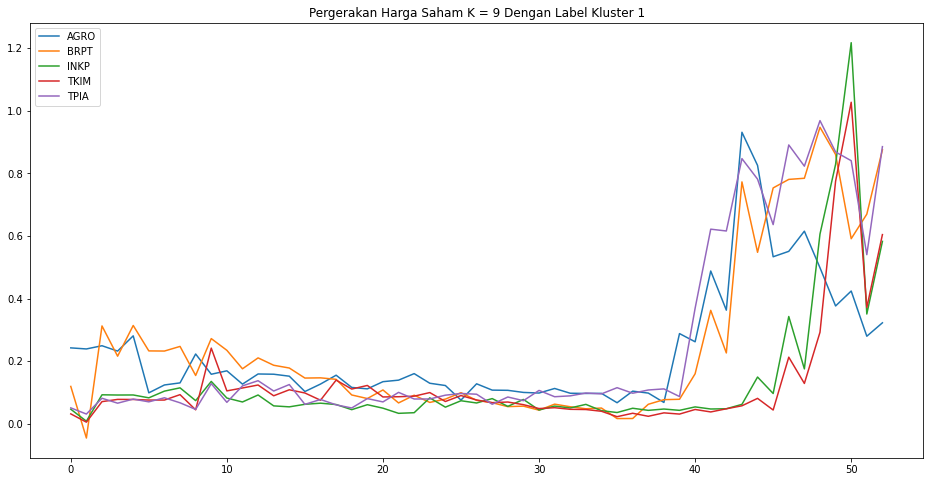

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 1')
plt.plot(AGRO, label='AGRO')
plt.plot(BRPT, label='BRPT')
plt.plot(INKP, label='INKP')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')
plt.legend(loc='best')
plt.show()

**Kluster label 2**

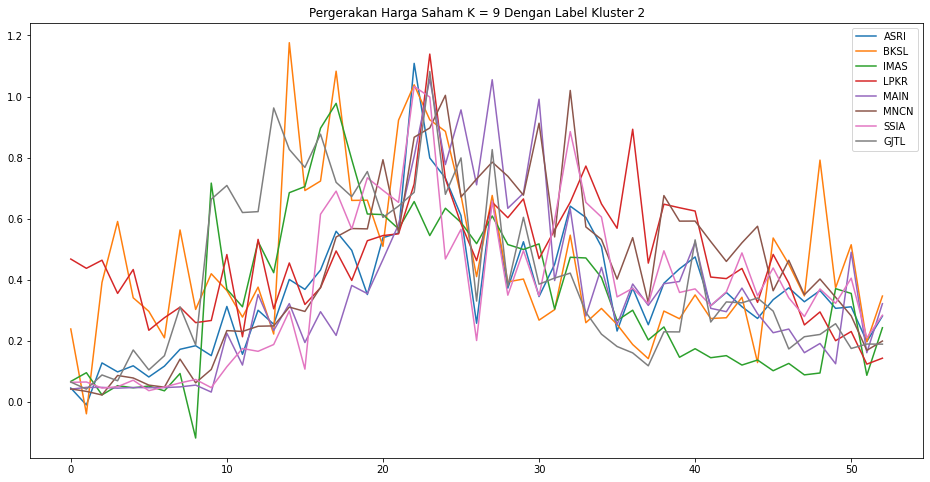

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 2')
plt.plot(ASRI, label='ASRI')
plt.plot(BKSL, label='BKSL')
plt.plot(IMAS, label='IMAS')
plt.plot(LPKR, label='LPKR')
plt.plot(MAIN, label='MAIN')
plt.plot(MNCN, label='MNCN')
plt.plot(SSIA, label='SSIA')
plt.plot(GJTL, label='GJTL')
plt.legend(loc='best')
plt.show()

**Kluster label 3**

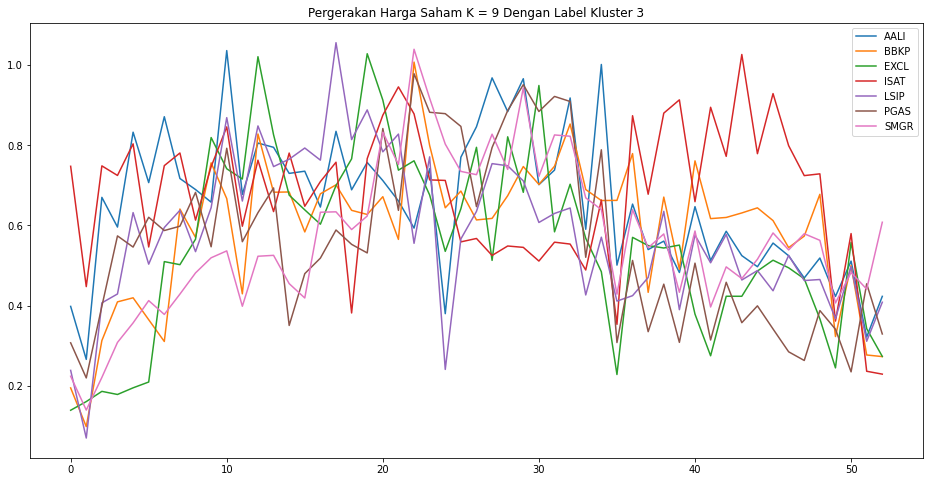

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 3')
plt.plot(AALI, label='AALI')
plt.plot(BBKP, label='BBKP')
plt.plot(EXCL, label='EXCL')
plt.plot(ISAT, label='ISAT')
plt.plot(LSIP, label='LSIP')
plt.plot(PGAS, label='PGAS')
plt.plot(SMGR, label='SMGR')
plt.legend(loc='best')
plt.show()

**Kluster label 4**

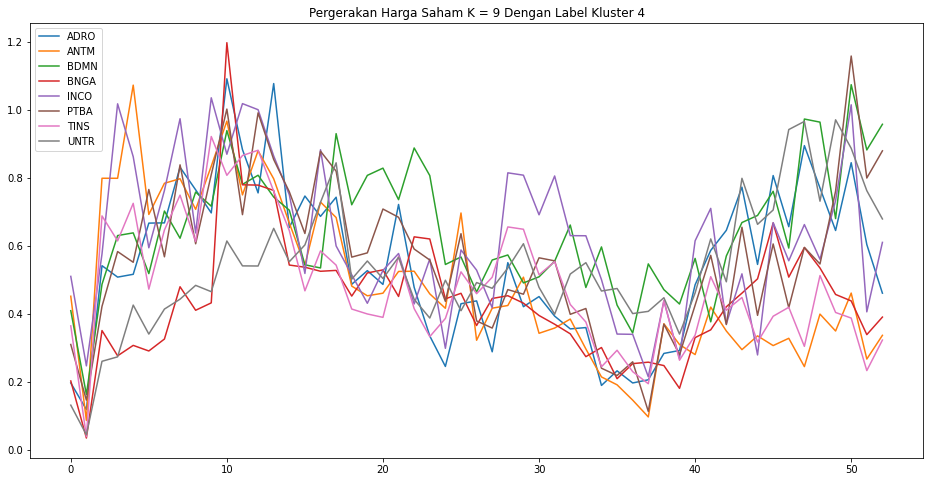

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 4')
plt.plot(ADRO, label='ADRO')
plt.plot(ANTM, label='ANTM')
plt.plot(BDMN, label='BDMN')
plt.plot(BNGA, label='BNGA')
plt.plot(INCO, label='INCO')
plt.plot(PTBA, label='PTBA')
plt.plot(TINS, label='TINS')
plt.plot(UNTR, label='UNTR')
plt.legend(loc='best')
plt.show()

**Kluster label 5**

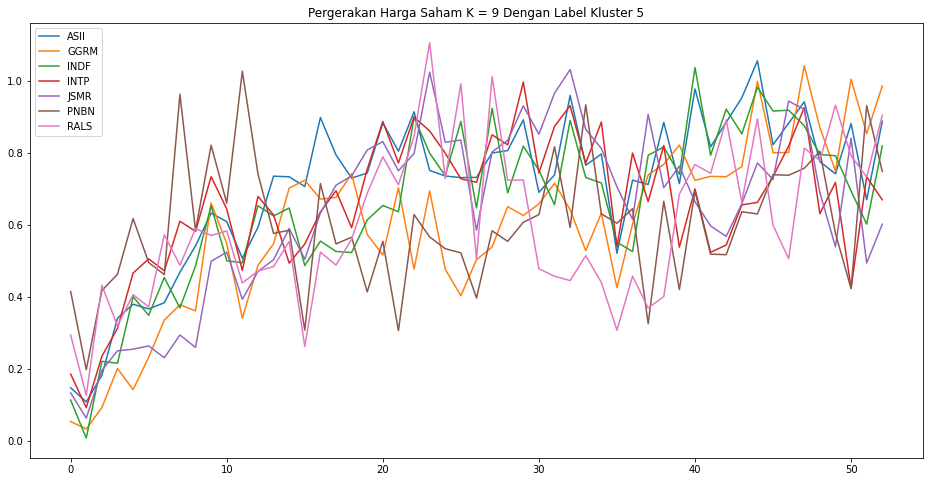

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 5')
plt.plot(ASII, label='ASII')
plt.plot(GGRM, label='GGRM')
plt.plot(INDF, label='INDF')
plt.plot(INTP, label='INTP')
plt.plot(JSMR, label='JSMR')
plt.plot(PNBN, label='PNBN')
plt.plot(RALS, label='RALS')
plt.legend(loc='best')
plt.show()

**Kluster label 6**

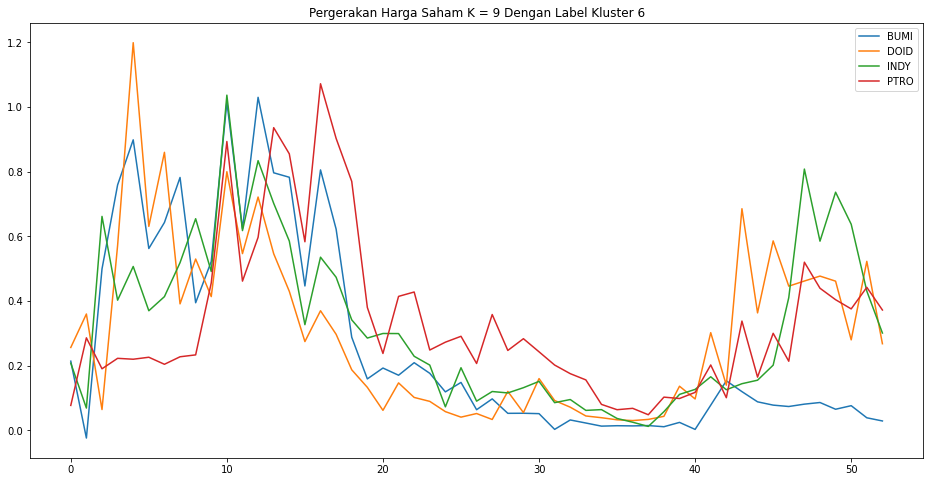

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 6')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(INDY, label='INDY')
plt.plot(PTRO, label='PTRO')
plt.legend(loc='best')
plt.show()

**Kluster label 7**

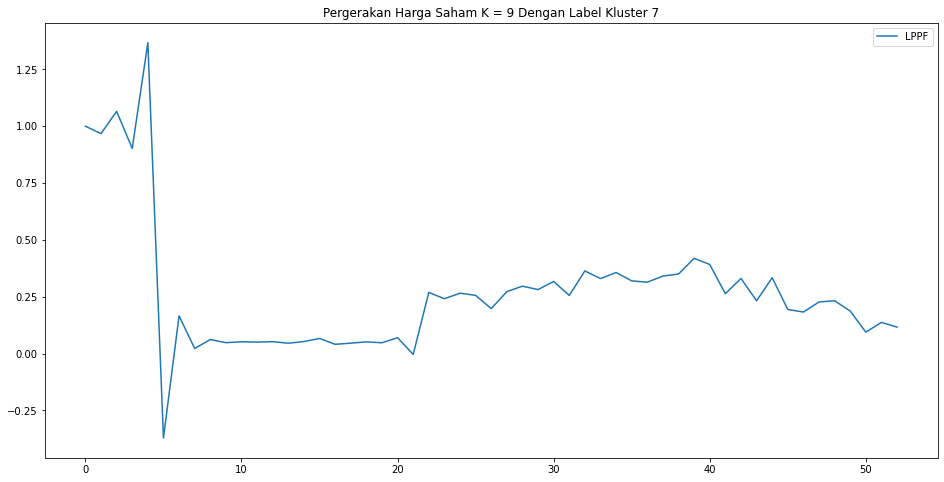

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 7')
plt.plot(LPPF, label='LPPF')
plt.legend(loc='best')
plt.show()


**Kluster label 8**

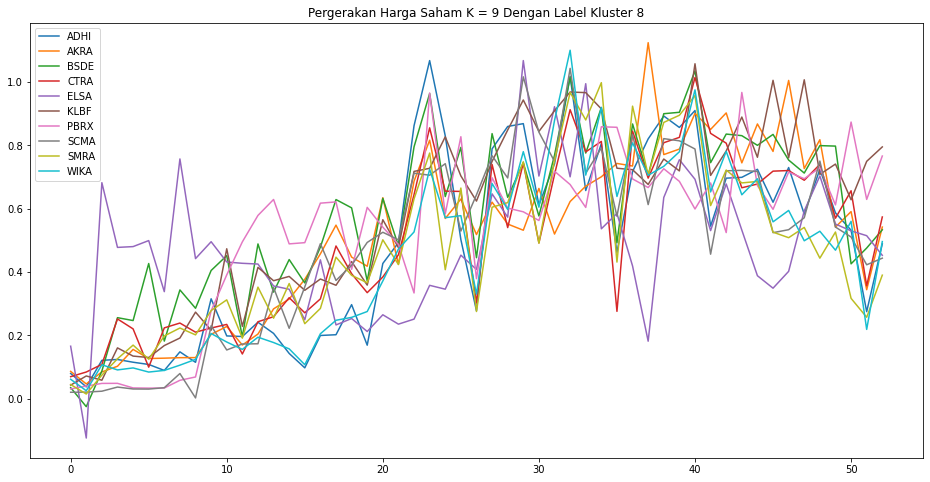

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 9 Dengan Label Kluster 8')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(BSDE, label='BSDE')
plt.plot(CTRA, label='CTRA')
plt.plot(ELSA, label='ELSA')
plt.plot(KLBF, label='KLBF')
plt.plot(PBRX, label='PBRX')
plt.plot(SCMA, label='SCMA')
plt.plot(SMRA, label='SMRA')
plt.plot(WIKA, label='WIKA')
plt.legend(loc='best')
plt.show()

**K = 10**

**Kluster label 0**

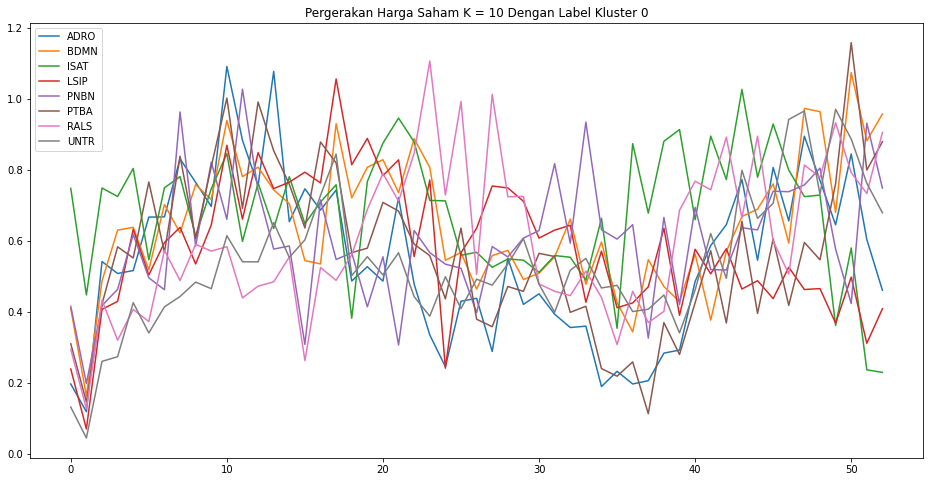

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 0')
plt.plot(ADRO, label='ADRO')
plt.plot(BDMN, label='BDMN')
plt.plot(ISAT, label='ISAT')
plt.plot(LSIP, label='LSIP')
plt.plot(PNBN, label='PNBN')
plt.plot(PTBA, label='PTBA')
plt.plot(RALS, label='RALS')
plt.plot(UNTR, label='UNTR')

plt.legend(loc='best')
plt.show()

**Kluster label 1**

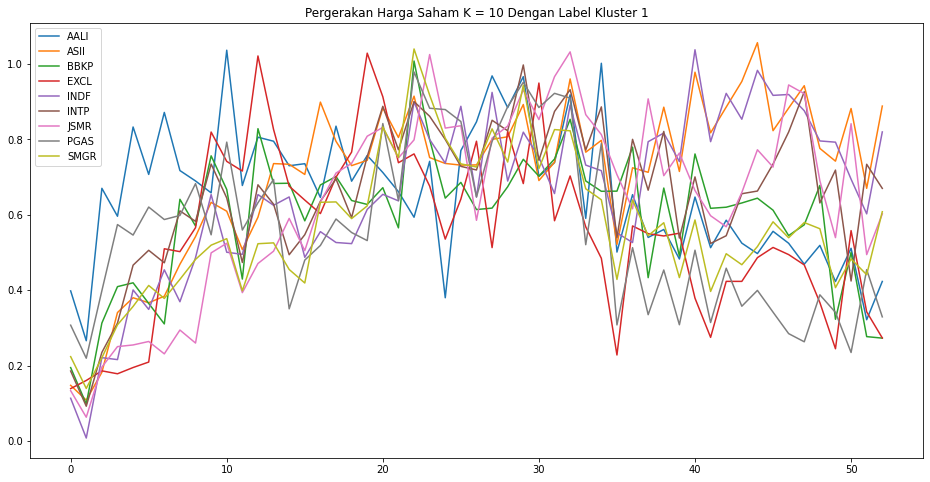

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 1')
plt.plot(AALI, label='AALI')
plt.plot(ASII, label='ASII')
plt.plot(BBKP, label='BBKP')
plt.plot(EXCL, label='EXCL')
plt.plot(INDF, label='INDF')
plt.plot(INTP, label='INTP')
plt.plot(JSMR, label='JSMR')
plt.plot(PGAS, label='PGAS')
plt.plot(SMGR, label='SMGR')
plt.legend(loc='best')
plt.show()

**Kluster label 2**

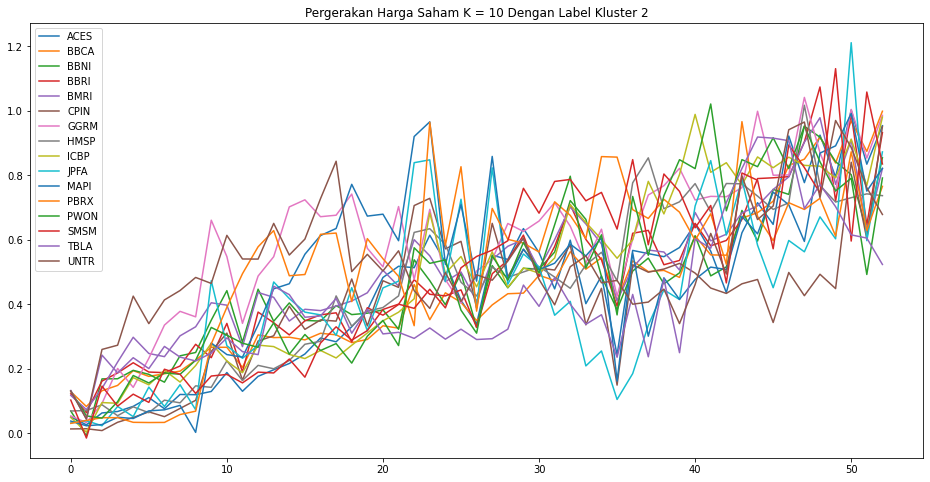

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 2')
plt.plot(ACES, label='ACES')
plt.plot(BBCA, label='BBCA')
plt.plot(BBNI, label='BBNI')
plt.plot(BBRI, label='BBRI')
plt.plot(BMRI, label='BMRI')
plt.plot(CPIN, label='CPIN')
plt.plot(GGRM, label='GGRM')
plt.plot(HMSP, label='HMSP')
plt.plot(ICBP, label='ICBP')
plt.plot(JPFA, label='JPFA')
plt.plot(MAPI, label='MAPI')
plt.plot(PBRX, label='PBRX')
plt.plot(PWON, label='PWON')
plt.plot(SMSM, label='SMSM')
plt.plot(TBLA, label='TBLA')
plt.plot(UNTR, label='UNTR')

plt.legend(loc='best')
plt.show()

**Kluster label 3**

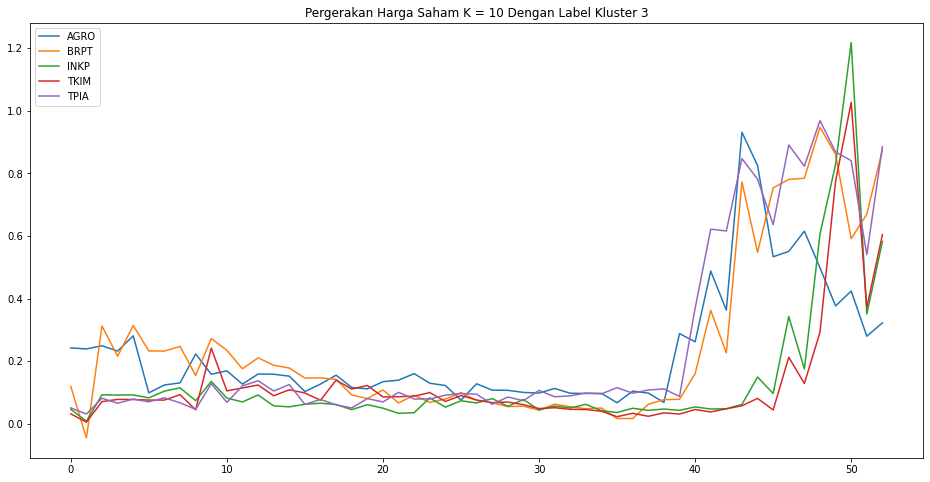

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 3')
plt.plot(AGRO, label='AGRO')
plt.plot(BRPT, label='BRPT')
plt.plot(INKP, label='INKP')
plt.plot(TKIM, label='TKIM')
plt.plot(TPIA, label='TPIA')

plt.legend(loc='best')
plt.show()

**Kluster label 4**

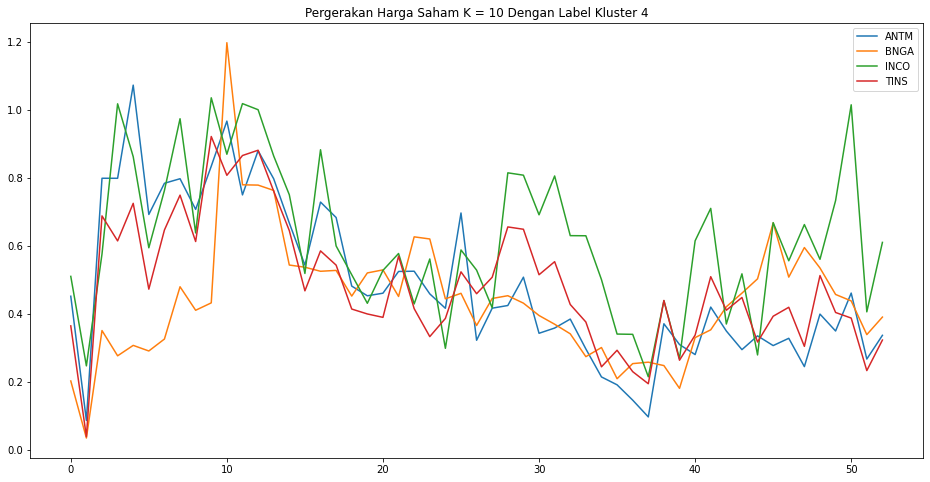

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 4')
plt.plot(ANTM, label='ANTM')
plt.plot(BNGA, label='BNGA')
plt.plot(INCO, label='INCO')
plt.plot(TINS, label='TINS')

plt.legend(loc='best')
plt.show()

**Kluster label 5**

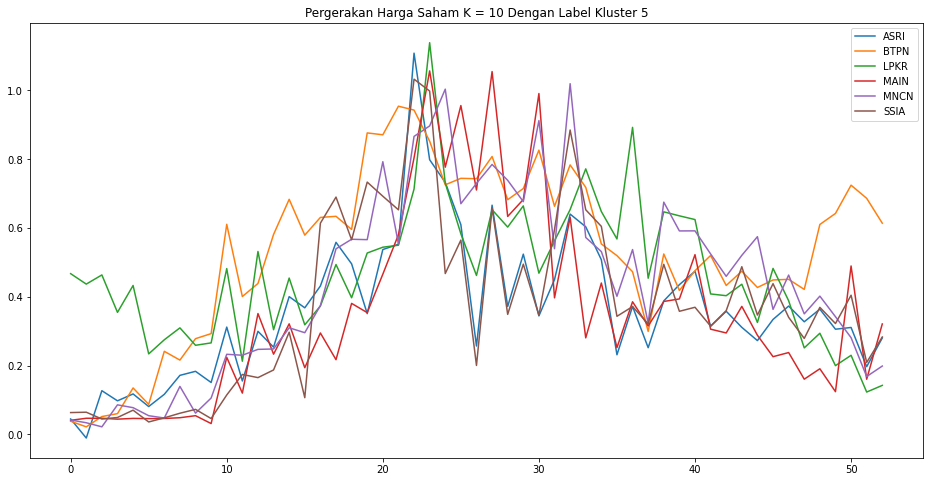

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 5')
plt.plot(ASRI, label='ASRI')
plt.plot(BTPN, label='BTPN')
plt.plot(LPKR, label='LPKR')
plt.plot(MAIN, label='MAIN')
plt.plot(MNCN, label='MNCN')
plt.plot(SSIA, label='SSIA')

plt.legend(loc='best')
plt.show()

**Kluster label 6**

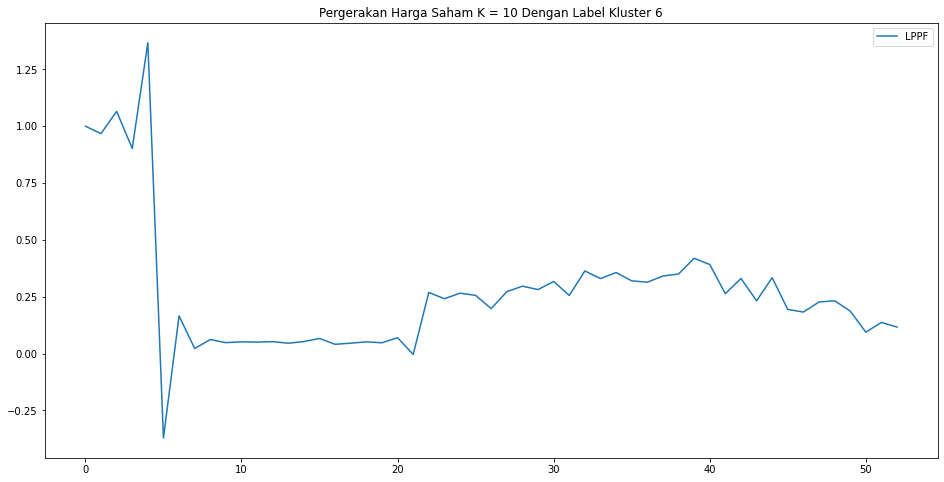

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 6')
plt.plot(LPPF, label='LPPF')
plt.legend(loc='best')
plt.show()

**Kluster label 7**

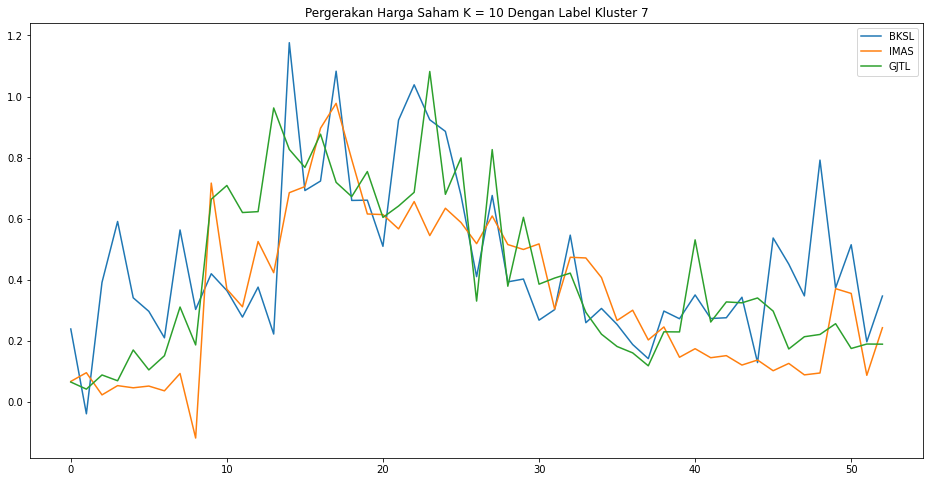

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 7')
plt.plot(BKSL, label='BKSL')
plt.plot(IMAS, label='IMAS')
plt.plot(GJTL, label='GJTL')

plt.legend(loc='best')
plt.show()

**Kluster label 8**

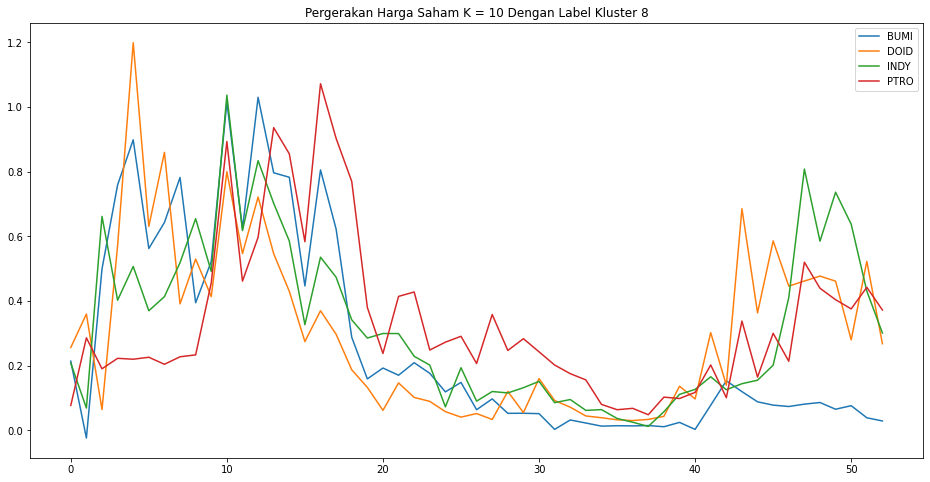

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 8')
plt.plot(BUMI, label='BUMI')
plt.plot(DOID, label='DOID')
plt.plot(INDY, label='INDY')
plt.plot(PTRO, label='PTRO')

plt.legend(loc='best')
plt.show()


**Kluster label 9**

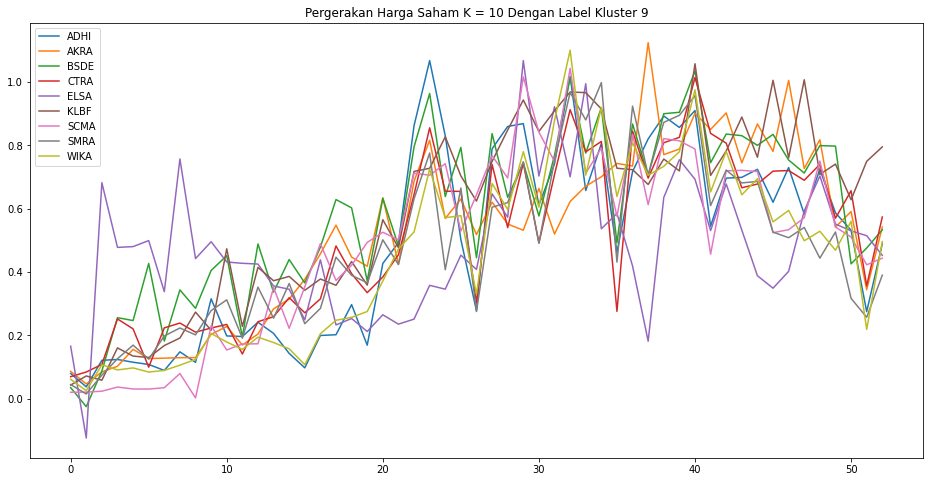

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Pergerakan Harga Saham K = 10 Dengan Label Kluster 9')
plt.plot(ADHI, label='ADHI')
plt.plot(AKRA, label='AKRA')
plt.plot(BSDE, label='BSDE')
plt.plot(CTRA, label='CTRA')
plt.plot(ELSA, label='ELSA')
plt.plot(KLBF, label='KLBF')
plt.plot(SCMA, label='SCMA')
plt.plot(SMRA, label='SMRA')
plt.plot(WIKA, label='WIKA')

plt.legend(loc='best')
plt.show()

#**RETURN SAHAM 2019 & 2009 S.D 2018**


1.   Return Saham
2.   Variansi Saham
3.   Expected Return



## **RETURN SAHAM**

In [ ]:
DATA_SAHAM = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA PERGERAKAN SAHAM GABUNGAN.csv')
DATA_SAHAM

,AALI,ACES,ADHI,ADRO,AGRO,AKRA,ANTM,ASII,ASRI,BBCA,BBKP,BBNI,BBRI,BDMN,BKSL,BMRI,BNGA,BRPT,BSDE,BTPN,BUMI,CPIN,CTRA,DOID,ELSA,EXCL,GGRM,HMSP,ICBP,IMAS,INCO,INDF,INDY,INKP,INTP,ISAT,JPFA,JSMR,KLBF,LPKR,LPPF,LSIP,MAIN,MAPI,MNCN,PBRX,PGAS,PNBN,PTBA,PTRO,PWON,RALS,SCMA,SMGR,SMRA,SMSM,SSIA,TBLA,TINS,TKIM,TPIA,UNTR,UNVR,WIKA,GJTL
0,11148.40039,77.0,254.539993,520,230.037003,680,1033.170044,1350,50,3375,192.623001,701.521973,472.5,3107.280029,75,1032.469971,471.498993,63.0,78.896599,217.500000,770,96,117.981003,502.274994,120,986.390991,4575,361.759003,510.0,596.343994,2600,1020,1090,930,5000,5550,75,947.780029,81,656.359009,50000.0,715,160,36.0,150,21.557400,1950,610,1510,360.0,97.590401,465,82,4250,88.0,162.5,105.0,210,824.447021,565.767029,331.795013,5239.779785,1560,208.367004,220
1,10767.20020,67.0,250.298004,680,230.037003,680,965.973022,1290,50,2925,202.253998,748.921997,475.0,3180.110107,60,983.304016,432.207001,53.0,81.681198,217.500000,470,96,120.439003,502.274994,125,986.390991,4900,371.179993,540.0,596.343994,2400,1080,1400,830,4750,5750,88,997.663025,89,626.181030,50000.0,665,160,30.0,135,21.557400,2075,570,1570,432.5,72.289200,475,82,3675,87.5,162.5,105.0,200,790.658020,573.413025,331.795013,4807.140137,1600,203.735992,205
2,10767.20020,71.0,224.843994,640,230.037003,650,915.575012,1265,50,2750,182.990997,673.080994,465.0,2136.250000,50,875.140015,392.915985,48.0,81.681198,212.061996,510,84,120.439003,502.274994,118,1035.709961,4625,367.411011,500.0,596.343994,2475,1000,1300,830,4600,5750,80,947.780029,90,641.270020,50000.0,605,160,32.0,132,21.557400,1900,540,1400,430.0,53.012100,460,79,3450,82.0,150.0,105.0,188,750.112000,573.413025,331.795013,4518.709961,1680,189.845001,195
3,10529.00000,63.0,224.843994,690,230.037003,680,923.974976,1290,50,2750,185.880997,692.041992,425.0,2160.530029,50,884.973022,412.562012,50.0,86.322098,208.436996,510,86,122.897003,502.274994,117,1085.030029,5075,373.063995,510.0,596.343994,2475,1020,1260,870,4475,5750,80,937.804016,92,618.637024,50000.0,600,160,34.0,128,19.597601,2025,550,1450,430.0,45.783100,460,79,3475,78.5,87.5,105.0,187,756.869995,596.348999,333.759003,4807.140137,1610,189.845001,210
4,10290.79981,63.0,216.358994,770,230.037003,620,898.775024,1170,50,2825,189.733002,711.002014,440.0,2257.629883,50,875.140015,412.562012,51.0,78.896599,199.375000,500,85,132.729004,502.274994,117,1134.349976,6000,373.063995,485.0,596.343994,2400,970,1280,880,4600,5800,84,957.757019,105,626.181030,50000.0,600,160,30.0,126,19.597601,2150,540,1470,430.0,46.987900,460,79,3450,79.0,87.5,105.0,184,716.322998,619.286011,333.759003,4662.919922,1640,194.475006,196
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
517,11650.00000,1490.0,1540.000000,1285,310.000000,3790,740.000000,8325,352,26150,280.000000,8750.000000,3650.0,7500.000000,113,7575.000000,935.000000,412.0,1315.000000,3470.000000,136,6800,1050.000000,570.000000,330,1890.000000,80825,3710.000000,9750.0,2170.000000,3180,6575,2000,11600,19850,1990,2360,4580.000000,1610,211.089005,5200.0,1240,1410,850.0,765,545.000000,2060,1230,3950,1785.0,615.000000,1300,1925,11775,855.0,1415.0,468.0,870,715.000000,11500.000000,5200.000000,29725.000000,8750,1505.000000,635
518,11875.00000,1525.0,1625.000000,1255,308.000000,4280,755.000000,8250,342,25825,286.000000,8450.000000,3620.0,7300.000000,116,7475.000000,915.000000,436.0,1285.000000,3500.000000,128,6500,1035.000000,565.000000,342,1915.000000,80975,3770.000000,9675.0,2140.000000,3040,6725,1880,11500,19750,1810,2240,4500.000000,1475,207.914993,5575.0,1230,1310,800.0,750,545.000000,2130,1160,4310,1785.0,610.000000,1380,1960,11600,845.0,1435.0,456.0,820,740.000000,11450.000000,5500.000000,29300.000000,8800,1675.000000,630
519,12300.00000,1495.0,1645.000000,1245,316.000000,4390,760.000000,8425,338,2615

In [ ]:
return_saham = DATA_SAHAM.pct_change()
return_saham

,AALI,ACES,ADHI,ADRO,AGRO,AKRA,ANTM,ASII,ASRI,BBCA,BBKP,BBNI,BBRI,BDMN,BKSL,BMRI,BNGA,BRPT,BSDE,BTPN,BUMI,CPIN,CTRA,DOID,ELSA,EXCL,GGRM,HMSP,ICBP,IMAS,INCO,INDF,INDY,INKP,INTP,ISAT,JPFA,JSMR,KLBF,LPKR,LPPF,LSIP,MAIN,MAPI,MNCN,PBRX,PGAS,PNBN,PTBA,PTRO,PWON,RALS,SCMA,SMGR,SMRA,SMSM,SSIA,TBLA,TINS,TKIM,TPIA,UNTR,UNVR,WIKA,GJTL
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.034193,-0.129870,-0.016665,0.307692,0.000000,0.000000,-0.065040,-0.044444,0.000000,-0.133333,0.049999,0.067567,0.005291,0.023439,-0.200000,-0.047620,-0.083334,-0.158730,0.035294,0.000000,-0.389610,0.000000,0.020834,0.000000,0.041667,0.000000,0.071038,0.026042,0.058824,0.000000,-0.076923,0.058824,0.284404,-0.107527,-0.050000,0.036036,0.173333,0.052631,0.098765,-0.045978,0.000000,-0.069930,0.000000,-0.166667,-0.100000,0.000000,0.064103,-0.065574,0.039735,0.201389,-0.259259,0.021505,0.000000,-0.135294,-0.005682,0.000000,0.000000,-0.047619,-0.040984,0.013514,0.000000,-0.082568,0.025641,-0.022225,-0.068182
2,0.000000,0.059701,-0.101695,-0.058824,0.000000,-0.044118,-0.052173,-0.019380,0.000000,-0.059829,-0.095242,-0.101267,-0.021053,-0.328247,-0.166667,-0.110001,-0.090908,-0.094340,0.000000,-0.025002,0.085106,-0.125000,0.000000,0.000000,-0.056000,0.049999,-0.056122,-0.010154,-0.074074,0.000000,0.031250,-0.074074,-0.071429,0.000000,-0.031579,0.000000,-0.090909,-0.050000,0.011236,0.024097,0.000000,-0.090226,0.000000,0.066667,-0.022222,0.000000,-0.084337,-0.052632,-0.108280,-0.005780,-0.266666,-0.031579,-0.036585,-0.061224,-0.062857,-0.076923,0.000000,-0.060000,-0.051281,0.000000,0.000000,-0.060000,0.050000,-0.068181,-0.048780
3,-0.022123,-0.112676,0.000000,0.078125,0.000000,0.046154,0.009175,0.019763,0.000000,0.000000,0.015793,0.028170,-0.086022,0.011366,0.000000,0.011236,0.050001,0.041667,0.056817,-0.017094,0.000000,0.023810,0.020409,0.000000,-0.008475,0.047620,0.097297,0.015386,0.020000,0.000000,0.000000,0.020000,-0.030769,0.048193,-0.027174,0.000000,0.000000,-0.010526,0.022222,-0.035294,0.000000,-0.008264,0.000000,0.062500,-0.030303,-0.090911,0.065789,0.018519,0.035714,0.000000,-0.136365,0.000000,0.000000,0.007246,-0.042683,-0.416667,0.000000,-0.005319,0.009009,0.039999,0.005919,0.063830,-0.041667,0.000000,0.076923
4,-0.022623,0.000000,-0.037737,0.115942,0.000000,-0.088235,-0.027273,-0.093023,0.000000,0.027273,0.020723,0.027397,0.035294,0.044943,0.000000,-0.011111,0.000000,0.020000,-0.086021,-0.043476,-0.019608,-0.011628,0.080002,0.000000,0.000000,0.045455,0.182266,0.000000,-0.049020,0.000000,-0.030303,-0.049020,0.015873,0.011494,0.027933,0.008696,0.050000,0.021276,0.141304,0.012195,0.000000,0.000000,0.000000,-0.117647,-0.015625,0.000000,0.061728,-0.018182,0.013793,0.000000,0.026315,0.000000,0.000000,-0.007194,0.006369,0.000000,0.000000,-0.016043,-0.053572,0.038462,0.000000,-0.030001,0.018634,0.024388,-0.066667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
517,0.081206,-0.003344,0.069444,0.023904,-0.006410,-0.028205,0.233333,-0.008929,0.121019,0.027505,-0.096774,0.023392,0.000000,0.023891,0.018018,0.023649,0.027473,0.009804,0.035433,-0.030726,0.079365,0.198238,0.060606,0.000000,0.085526,-0.068966,-0.019114,0.027701,0.083333,0.130208,0.152174,0.086777,0.058201,-0.008547,0.002525,-0.043269,0.207161,0.150754,0.022222,-0.014814,0.152993,0.117117,0.151020,0.069182,-0.043750,-0.026786,0.053708,0.000000,-0.010025,0.000000,0.025000,0.040000,0.018519,0.053691,0.171233,-0.003521,0.049327,0.137255,0.153226,-0.041667,0.019608,0.025000,0.080247,0.075000,0.016000
518,0.019313,0.023490,0.055195,-0.023346,-0.006452,0.129288,0.020270,-0.009009,-0.028409

In [ ]:
np.savetxt("Return Saham.csv", return_saham, delimiter=",")
files.download("Return Saham.csv")

In [ ]:
np.savetxt("Korelasi Return Saham.csv", return_saham.corr(), delimiter=",")
files.download("Korelasi Return Saham.csv")

**EXPECTED RETURN SAHAM**

In [ ]:
Return_sahamT = np.transpose(return_saham)

In [ ]:
Expected_return_saham = Return_sahamT.mean(axis=1)
print("Expected Return Saham =\n", Expected_return_saham)

Expected Return Saham =
 AALI    0.001315
ACES    0.006764
ADHI    0.005380
ADRO    0.003453
AGRO    0.003268
          ...   
TPIA    0.064701
UNTR    0.004401
UNVR    0.005699
WIKA    0.005429
GJTL    0.005352
Length: 65, dtype: float64


In [ ]:
np.savetxt("Expected Return Saham.csv", Expected_return_saham, delimiter=",")
files.download("Expected Return Saham.csv")

**VARIANSI RETURN SAHAM**

In [ ]:
Variansi_return_saham = Return_sahamT.var(axis=1)
print("variansi Return Saham =\n", Variansi_return_saham)

variansi Return Saham =
 AALI    0.002451
ACES    0.002155
ADHI    0.003791
ADRO    0.003718
AGRO    0.006031
          ...   
TPIA    0.307054
UNTR    0.002458
UNVR    0.005853
WIKA    0.002951
GJTL    0.007008
Length: 65, dtype: float64


In [ ]:
np.savetxt("Variasi Return Saham.csv", Variansi_return_saham, delimiter=",")
files.download("Variasi Return Saham.csv")

##**SAHAM DATA 2019**

In [ ]:
AALI2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/AALI.JK.csv')
ADRO2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/ADRO.JK.csv')
ANTM2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/ANTM.JK.csv')
ASII2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/ASII.JK.csv')
BBCA2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/BBCA2019.JK.csv')
BBKP2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/BBKP.JK.csv')
BKSL2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/BKSL.JK.csv')
BNGA2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/BNGA2019.JK.csv')
BTPN2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/BTPN.JK.csv')
BUMI2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/BUMI.JK.csv')
CPIN2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/CPIN.JK.csv')
GGRM2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/GGRM.JK.csv')
IMAS2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/IMAS.JK.csv')
INCO2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/INCO.JK.csv')
INDY2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/INDY.JK.csv')
INKP2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/INKP.JK.csv')
JSMR2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/JSMR.JK.csv')
KLBF2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/KLBF.JK.csv')
LPKR2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/LPKR.JK.csv')
LPPF2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/LPPF.JK.csv')
LSIP2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/LSIP.JK.csv')
MNCN2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/MNCN.JK.csv')
PBRX2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/PBRX.JK.csv')
PTBA2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/PTBA.JK.csv')
PTRO2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/PTRO.JK.csv')
SCMA2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/SCMA.JK.csv')
TPIA2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/TPIA.JK.csv')
UNTR2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/UNTR.JK.csv')

In [ ]:
Data_2019 = np.asarray([AALI2019['Close'],ADRO2019['Close'],ANTM2019['Close'],ASII2019['Close'],BBCA2019['Close'],BBKP2019['Close'],BKSL2019['Close'],BNGA2019['Close'],BTPN2019['Close'],BUMI2019['Close'],CPIN2019['Close'],GGRM2019['Close'],IMAS2019['Close'],INCO2019['Close'],INDY2019['Close'],INKP2019['Close'],JSMR2019['Close'],KLBF2019['Close'],LPKR2019['Close'],LPPF2019['Close'],LSIP2019['Close'],MNCN2019['Close'],PBRX2019['Close'],PTBA2019['Close'],PTRO2019['Close'],SCMA2019['Close'],TPIA2019['Close'],UNTR2019['Close']])
Data_Test = np.transpose(pd.DataFrame(Data_2019,index =['AALI','ADRO','ANTM','ASII','BBCA','BBKP','BKSL','BNGA','BTPN','BUMI','CPIN','GGRM','IMAS','INCO','INDY','INKP','JSMR','KLBF','LPKR','LPPF','LSIP','MNCN','PBRX','PTBA','PTRO','SCMA','TPIA','UNTR']))
Data_Test

,AALI,ADRO,ANTM,ASII,BBCA,BBKP,BKSL,BNGA,BTPN,BUMI,CPIN,GGRM,IMAS,INCO,INDY,INKP,JSMR,KLBF,LPKR,LPPF,LSIP,MNCN,PBRX,PTBA,PTRO,SCMA,TPIA,UNTR
0,12425.0,1390.0,770.0,8150.0,26225.0,302.0,116.0,1115.0,3530.0,137.0,7575.0,82750.0,2130.0,3260.0,1950.0,11150.0,4810.0,1595.0,214.263000,5775.0,1375.0,750.0,540.0,4400.0,1900.0,1880.0,5900.0,27975.0
1,12625.0,1410.0,780.0,8150.0,26000.0,324.0,120.0,1100.0,3650.0,150.0,7925.0,83625.0,2560.0,3390.0,1925.0,12600.0,4820.0,1615.0,211.089005,6000.0,1320.0,820.0,545.0,4390.0,1860.0,1905.0,5700.0,26000.0
2,12875.0,1470.0,855.0,8325.0,27725.0,344.0,118.0,1140.0,3680.0,174.0,8300.0,82775.0,2900.0,3740.0,2130.0,11950.0,4840.0,1605.0,211.089005,6275.0,1440.0,825.0,550.0,4470.0,1995.0,1940.0,5400.0,26850.0
3,14200.0,1390.0,910.0,8375.0,27475.0,364.0,121.0,1130.0,3790.0,172.0,8300.0,84700.0,3070.0,3550.0,2210.0,13525.0,4860.0,1610.0,226.960007,7250.0,1490.0,880.0,545.0,4350.0,2030.0,1965.0,5500.0,26300.0
4,13750.0,1360.0,1010.0,8200.0,27500.0,362.0,131.0,1155.0,3790.0,162.0,7950.0,81000.0,3220.0,3810.0,2150.0,12500.0,4820.0,1605.0,220.612000,6575.0,1400.0,830.0,555.0,4240.0,1960.0,1830.0,5750.0,26250.0
5,13550.0,1260.0,980.0,8000.0,27475.0,386.0,135.0,1240.0,3880.0,148.0,7400.0,81000.0,3170.0,3610.0,1955.0,12500.0,4960.0,1595.0,234.895996,7000.0,1405.0,850.0,555.0,4260.0,1870.0,1810.0,5550.0,25375.0
6,13750.0,1245.0,995.0,7875.0,27400.0,378.0,138.0,1270.0,3700.0,153.0,7600.0,85000.0,3290.0,3650.0,1785.0,11875.0,5100.0,1575.0,220.612000,5925.0,1355.0,955.0,550.0,3980.0,1875.0,1760.0,5475.0,26150.0
7,13300.0,1405.0,1085.0,7650.0,27450.0,414.0,131.0,1240.0,3700.0,156.0,7150.0,82500.0,3050.0,3840.0,2080.0,12175.0,4910.0,1505.0,222.199005,5975.0,1360.0,945.0,550.0,4130.0,1980.0,1740.0,5675.0,27250.0
8,12825.0,1410.0,1050.0,7150.0,27675.0,396.0,125.0,1215.0,3610.0,153.0,7200.0,94400.0,3060.0,3870.0,2130.0,11250.0,5375.0,1515.0,238.070007,5500.0,1260.0,910.0,545.0,4060.0,1960.0,1840.0,5725.0,27500.0
9,12375.0,1450.0,1000.0,7225.0,27525.0,370.0,113.0,1160.0,3660.0,134.0,7050.0,91775.0,2890.0,3600.0,2100.0,10325.0,5025.0,1520.0,203.153000,3650.0,1230.0,825.0,540.0,4020.0,1920.0,1785.0,5500.0,26900.0


In [ ]:
#RETURN SAHAM 2019
Return_Saham_2019 = Data_Test.pct_change()
Return_Saham_2019

,AALI,ADRO,ANTM,ASII,BBCA,BBKP,BKSL,BNGA,BTPN,BUMI,CPIN,GGRM,IMAS,INCO,INDY,INKP,JSMR,KLBF,LPKR,LPPF,LSIP,MNCN,PBRX,PTBA,PTRO,SCMA,TPIA,UNTR
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.016097,0.014388,0.012987,0.000000,-0.008580,0.072848,0.034483,-0.013453,0.033994,0.094891,0.046205,0.010574,0.201878,0.039877,-0.012821,0.130045,0.002079,0.012539,-0.014814,0.038961,-0.040000,0.093333,0.009259,-0.002273,-0.021053,0.013298,-0.033898,-0.070599
2,0.019802,0.042553,0.096154,0.021472,0.066346,0.061728,-0.016667,0.036364,0.008219,0.160000,0.047319,-0.010164,0.132812,0.103245,0.106494,-0.051587,0.004149,-0.006192,0.000000,0.045833,0.090909,0.006098,0.009174,0.018223,0.072581,0.018373,-0.052632,0.032692
3,0.102913,-0.054422,0.064327,0.006006,-0.009017,0.058140,0.025424,-0.008772,0.029891,-0.011494,0.000000,0.023256,0.058621,-0.050802,0.037559,0.131799,0.004132,0.003115,0.075186,0.155378,0.034722,0.066667,-0.009091,-0.026846,0.017544,0.012887,0.018519,-0.020484
4,-0.031690,-0.021583,0.109890,-0.020896,0.000910,-0.005495,0.082645,0.022124,0.000000,-0.058140,-0.042169,-0.043684,0.048860,0.073239,-0.027149,-0.075786,-0.008230,-0.003106,-0.027970,-0.093103,-0.060403,-0.056818,0.018349,-0.025287,-0.034483,-0.068702,0.045455,-0.001901
5,-0.014545,-0.073529,-0.029703,-0.024390,-0.000909,0.066298,0.030534,0.073593,0.023747,-0.086420,-0.069182,0.000000,-0.015528,-0.052493,-0.090698,0.000000,0.029046,-0.006231,0.064747,0.064639,0.003571,0.024096,0.000000,0.004717,-0.045918,-0.010929,-0.034783,-0.033333
6,0.014760,-0.011905,0.015306,-0.015625,-0.002730,-0.020725,0.022222,0.024194,-0.046392,0.033784,0.027027,0.049383,0.037855,0.011080,-0.086957,-0.050000,0.028226,-0.012539,-0.060810,-0.153571,-0.035587,0.123529,-0.009009,-0.065728,0.002674,-0.027624,-0.013514,0.030542
7,-0.032727,0.128514,0.090452,-0.028571,0.001825,0.095238,-0.050725,-0.023622,0.000000,0.019608,-0.059211,-0.029412,-0.072948,0.052055,0.165266,0.025263,-0.037255,-0.044444,0.007194,0.008439,0.003690,-0.010471,0.000000,0.037688,0.056000,-0.011364,0.036530,0.042065
8,-0.035714,0.003559,-0.032258,-0.065359,0.008197,-0.043478,-0.045802,-0.020161,-0.024324,-0.019231,0.006993,0.144242,0.003279,0.007812,0.024038,-0.075975,0.094705,0.006645,0.071427,-0.079498,-0.073529,-0.037037,-0.009091,-0.016949,-0.010101,0.057471,0.008811,0.009174
9,-0.035088,0.028369,-0.047619,0.010490,-0.005420,-0.065657,-0.096000,-0.045267,0.013850,-0.124183,-0.020833,-0.027807,-0.055556,-0.069767,-0.014085,-0.082222,-0.065116,0.003300,-0.146667,-0.336364,-0.023810,-0.093407,-0.009174,-0.009852,-0.020408,-0.029891,-0.039301,-0.021818


In [ ]:
np.savetxt("Return Saham 2019.csv", Return_Saham_2019, delimiter=",")
files.download("Return Saham 2019.csv")

In [ ]:
Return_Saham_2019
np.savetxt("Korelasi Return Saham 2019.csv", Return_Saham_2019.corr(), delimiter=",")
files.download("Korelasi Return Saham 2019.csv")

**Expected Return 2019**

In [ ]:
Return_sahamT = np.transpose(Return_Saham_2019)
Expected_Return_Saham_2019 = Return_sahamT.mean(axis=1)
print("Expected Return Saham =\n", Expected_Return_Saham_2019)

Expected Return Saham =
 AALI    0.003936
ADRO    0.004147
ANTM    0.003616
ASII   -0.002774
BBCA    0.004852
BBKP   -0.004743
BKSL   -0.004354
BNGA   -0.002288
BTPN   -0.001304
BUMI   -0.011776
CPIN   -0.000858
GGRM   -0.007129
IMAS   -0.009165
INCO    0.004523
INDY   -0.006136
INKP   -0.003991
JSMR    0.002437
KLBF    0.000637
LPKR    0.003729
LPPF   -0.002386
LSIP    0.002811
MNCN    0.017777
PBRX    0.000531
PTBA   -0.008263
PTRO   -0.002314
SCMA   -0.003937
TPIA    0.012392
UNTR   -0.004191
dtype: float64


In [ ]:
np.savetxt("Expected Return Saham 2019.csv", Expected_Return_Saham_2019, delimiter=",")
files.download("Expected Return Saham 2019.csv")

**Variansi Saham 2019**

In [ ]:
Variansi_Return_Saham_2019 = Return_sahamT.var(axis=1)
print("variansi Return Saham =\n", Variansi_Return_Saham_2019)

variansi Return Saham =
 AALI    0.001789
ADRO    0.004259
ANTM    0.004070
ASII    0.000716
BBCA    0.000364
BBKP    0.002004
BKSL    0.003279
BNGA    0.001002
BTPN    0.000579
BUMI    0.004450
CPIN    0.004241
GGRM    0.002762
IMAS    0.005261
INCO    0.005139
INDY    0.007084
INKP    0.006672
JSMR    0.002139
KLBF    0.000687
LPKR    0.002902
LPPF    0.006924
LSIP    0.002768
MNCN    0.005711
PBRX    0.003425
PTBA    0.002668
PTRO    0.001902
SCMA    0.003333
TPIA    0.003173
UNTR    0.001714
dtype: float64


In [ ]:
np.savetxt("Variasi Return Saham.csv", Variansi_Return_Saham_2019, delimiter=",")
files.download("Variasi Return Saham.csv")

In [ ]:
resultsaham2019 = np.asarray([Expected_Return_Saham_2019,Variansi_Return_Saham_2019])
Data_result2019 = pd.DataFrame(resultsaham2019,index=['ER','Variansi'], columns=['AALI','ADRO','ANTM','ASII','BBCA','BBKP','BKSL','BNGA','BTPN','BUMI','CPIN','GGRM','IMAS','INCO','INDY','INKP','JSMR','KLBF','LPKR','LPPF','LSIP','MNCN','PBRX','PTBA','PTRO','SCMA','TPIA','UNTR'])
Data_result2019

,AALI,ADRO,ANTM,ASII,BBCA,BBKP,BKSL,BNGA,BTPN,BUMI,CPIN,GGRM,IMAS,INCO,INDY,INKP,JSMR,KLBF,LPKR,LPPF,LSIP,MNCN,PBRX,PTBA,PTRO,SCMA,TPIA,UNTR
ER,0.003936,0.004147,0.003616,-0.002774,0.004852,-0.004743,-0.004354,-0.002288,-0.001304,-0.011776,-0.000858,-0.007129,-0.009165,0.004523,-0.006136,-0.003991,0.002437,0.000637,0.003729,-0.002386,0.002811,0.017777,0.000531,-0.008263,-0.002314,-0.003937,0.012392,-0.004191
Variansi,0.001789,0.004259,0.004070,0.000716,0.000364,0.002004,0.003279,0.001002,0.000579,0.004450,0.004241,0.002762,0.005261,0.005139,0.007084,0.006672,0.002139,0.000687,0.002902,0.006924,0.002768,0.005711,0.003425,0.002668,0.001902,0.003333,0.003173,0.001714


# **PEMBENTUKAN PORTOFOLIO TEORITIS & UJI DENGAN METODE MEAN VARIANCE**

## LOAD DATA SAHAM

In [ ]:
portofolio = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Expected Return & Variansi Saham.csv')
portofolio

,Saham,AALI,ACES,ADHI,ADRO,AGRO,AKRA,ANTM,ASII,ASRI,BBCA,BBKP,BBNI,BBRI,BDMN,BKSL,BMRI,BNGA,BRPT,BSDE,BTPN,BUMI,CPIN,CTRA,DOID,ELSA,EXCL,GGRM,HMSP,ICBP,IMAS,INCO,INDF,INDY,INKP,INTP,ISAT,JPFA,JSMR,KLBF,LPKR,LPPF,LSIP,MAIN,MAPI,MNCN,PBRX,PGAS,PNBN,PTBA,PTRO,PWON,RALS,SCMA,SMGR,SMRA,SMSM,SSIA,TBLA,TINS,TKIM,TPIA,UNTR,UNVR,WIKA,GJTL
0,Expected Return Saham,0.001315,0.006764,0.005380,0.003453,0.003268,0.004936,0.001005,0.004377,0.005482,0.004482,0.001563,0.005859,0.004894,0.003208,0.003939,0.004600,0.002580,0.006423,0.007405,0.006561,0.001374,0.010519,0.006178,0.004274,0.004189,0.003130,0.007120,0.005244,0.006615,0.006475,0.002597,0.004699,0.003821,0.007120,0.003644,-0.001088,0.008791,0.003602,0.006543,-0.000910,0.008229,0.003622,0.013407,0.007838,0.014555,0.017755,0.001769,0.003485,0.003692,0.008320,0.005408,0.004124,0.020649,0.002888,0.006212,0.006119,0.005342,0.003873,0.001588,0.008132,0.064701,0.004401,0.005699,0.005429,0.005352
1,Risiko Saham,0.002451,0.002155,0.003791,0.003718,0.006031,0.002826,0.003269,0.001837,0.004024,0.001116,0.001825,0.002015,0.001935,0.003022,0.007005,0.001652,0.002785,0.005720,0.004353,0.002653,0.011509,0.004578,0.004134,0.009185,0.004589,0.003718,0.003239,0.001648,0.001627,0.009586,0.004422,0.001767,0.006909,0.004994,0.002306,0.002403,0.004859,0.001432,0.001836,0.002717,0.012287,0.005649,0.044684,0.003949,0.067148,0.066940,0.003359,0.005058,0.003397,0.013503,0.003809,0.004072,0.113841,0.001966,0.004040,0.004275,0.004860,0.002341,0.003641,0.005212,0.307054,0.002458,0.005853,0.002951,0.007008


In [ ]:
#Return Portofolio
Return_Saham = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Return Saham.csv')
Return_Saham

,AALI,ACES,ADHI,ADRO,AGRO,AKRA,ANTM,ASII,ASRI,BBCA,BBKP,BBNI,BBRI,BDMN,BKSL,BMRI,BNGA,BRPT,BSDE,BTPN,BUMI,CPIN,CTRA,DOID,ELSA,EXCL,GGRM,HMSP,ICBP,IMAS,INCO,INDF,INDY,INKP,INTP,ISAT,JPFA,JSMR,KLBF,LPKR,LPPF,LSIP,MAIN,MAPI,MNCN,PBRX,PGAS,PNBN,PTBA,PTRO,PWON,RALS,SCMA,SMGR,SMRA,SMSM,SSIA,TBLA,TINS,TKIM,TPIA,UNTR,UNVR,WIKA,GJTL
0,-0.034193,-0.129870,-0.016665,0.307692,0.000000,0.000000,-0.065040,-0.044444,0.000000,-0.133333,0.049999,0.067567,0.005291,0.023439,-0.200000,-0.047620,-0.083334,-0.158730,0.035294,0.000000,-0.389610,0.000000,0.020834,0.000000,0.041667,0.000000,0.071038,0.026042,0.058824,0.000000,-0.076923,0.058824,0.284404,-0.107527,-0.050000,0.036036,0.173333,0.052631,0.098765,-0.045978,0.000000,-0.069930,0.000000,-0.166667,-0.100000,0.000000,0.064103,-0.065574,0.039735,0.201389,-0.259259,0.021505,0.000000,-0.135294,-0.005682,0.000000,0.000000,-0.047619,-0.040984,0.013514,0.000000,-0.082568,0.025641,-0.022225,-0.068182
1,0.000000,0.059701,-0.101695,-0.058824,0.000000,-0.044118,-0.052173,-0.019380,0.000000,-0.059829,-0.095242,-0.101267,-0.021053,-0.328247,-0.166667,-0.110001,-0.090908,-0.094340,0.000000,-0.025002,0.085106,-0.125000,0.000000,0.000000,-0.056000,0.049999,-0.056122,-0.010154,-0.074074,0.000000,0.031250,-0.074074,-0.071429,0.000000,-0.031579,0.000000,-0.090909,-0.050000,0.011236,0.024097,0.000000,-0.090226,0.000000,0.066667,-0.022222,0.000000,-0.084337,-0.052632,-0.108280,-0.005780,-0.266666,-0.031579,-0.036585,-0.061224,-0.062857,-0.076923,0.000000,-0.060000,-0.051281,0.000000,0.000000,-0.060000,0.050000,-0.068181,-0.048780
2,-0.022123,-0.112676,0.000000,0.078125,0.000000,0.046154,0.009175,0.019763,0.000000,0.000000,0.015793,0.028170,-0.086022,0.011366,0.000000,0.011236,0.050001,0.041667,0.056817,-0.017094,0.000000,0.023810,0.020409,0.000000,-0.008475,0.047620,0.097297,0.015386,0.020000,0.000000,0.000000,0.020000,-0.030769,0.048193,-0.027174,0.000000,0.000000,-0.010526,0.022222,-0.035294,0.000000,-0.008264,0.000000,0.062500,-0.030303,-0.090911,0.065789,0.018519,0.035714,0.000000,-0.136365,0.000000,0.000000,0.007246,-0.042683,-0.416667,0.000000,-0.005319,0.009009,0.039999,0.005919,0.063830,-0.041667,0.000000,0.076923
3,-0.022623,0.000000,-0.037737,0.115942,0.000000,-0.088235,-0.027273,-0.093023,0.000000,0.027273,0.020723,0.027397,0.035294,0.044943,0.000000,-0.011111,0.000000,0.020000,-0.086021,-0.043476,-0.019608,-0.011628,0.080002,0.000000,0.000000,0.045455,0.182266,0.000000,-0.049020,0.000000,-0.030303,-0.049020,0.015873,0.011494,0.027933,0.008696,0.050000,0.021276,0.141304,0.012195,0.000000,0.000000,0.000000,-0.117647,-0.015625,0.000000,0.061728,-0.018182,0.013793,0.000000,0.026315,0.000000,0.000000,-0.007194,0.006369,0.000000,0.000000,-0.016043,-0.053572,0.038462,0.000000,-0.030001,0.018634,0.024388,-0.066667
4,0.162038,0.015873,0.019606,0.116883,0.000000,0.016129,0.084112,-0.068376,0.000000,-0.088496,-0.010151,-0.026667,-0.073864,-0.086019,0.000000,-0.022472,0.000000,-0.009804,-0.035294,0.000000,0.520000,0.011765,0.111114,0.000000,0.034188,0.000000,-0.100000,0.000000,0.000000,0.000000,-0.020833,0.000000,0.125000,0.011364,-0.021739,0.008621,0.011905,-0.010417,0.219048,-0.048192,0.000000,0.200000,0.000000,0.000000,-0.103175,0.000000,-0.058140,-0.074074,0.027211,0.000000,0.000000,-0.010870,0.000000,0.021739,0.037975,0.000000,0.000000,0.114130,0.037736,-0.012346,0.000000,0.072165,-0.006098,-0.023808,-0.020408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,0.081206,-0.003344,0.069444,0.023904,-0.006410,-0.028205,0.233333,-0.008929,0.121019,0.027505,-0.096774,0.023392,0.000000,0.023891,0.018018,0.023649,0.027473,0.009804,0.035433,-0.030726,0.079365,0.198238,0.060606,0.000000,0.085526,-0.068966,-0.019114,0.027701,0.083333,0.130208,0.152174,0.086777,0.058201,-0.008547,0.002525,-0.043269,0.207161

In [ ]:
Data_Saham_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/ER&VAR 2019.csv')
Data_Saham_2019

,Saham,AALI,ADRO,ANTM,ASII,BBCA,BBKP,BKSL,BNGA,BTPN,BUMI,CPIN,GGRM,IMAS,INCO,INDY,INKP,JSMR,KLBF,LPKR,LPPF,LSIP,MNCN,PBRX,PTBA,PTRO,SCMA,TPIA,UNTR
0,ER,0.003936,0.004147,0.003616,-0.002774,0.004852,-0.004743,-0.004354,-0.002288,-0.001304,-0.011776,-0.000858,-0.007129,-0.009165,0.004523,-0.006136,-0.003991,0.002437,0.000637,0.003729,-0.002386,0.002811,0.017777,0.000531,-0.008263,-0.002314,-0.003937,0.012392,-0.004191
1,Risk,0.001789,0.004259,0.004070,0.000716,0.000364,0.002004,0.003279,0.001002,0.000579,0.004450,0.004241,0.002762,0.005261,0.005139,0.007084,0.006672,0.002139,0.000687,0.002902,0.006924,0.002768,0.005711,0.003425,0.002668,0.001902,0.003333,0.003173,0.001714


In [ ]:
Data_Return_Saham_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/Return Saham 2019.csv')
Data_Return_Saham_2019

,AALI,ADRO,ANTM,ASII,BBCA,BBKP,BKSL,BNGA,BTPN,BUMI,CPIN,GGRM,IMAS,INCO,INDY,INKP,JSMR,KLBF,LPKR,LPPF,LSIP,MNCN,PBRX,PTBA,PTRO,SCMA,TPIA,UNTR
0,0.016097,0.014388,0.012987,0.000000,-0.008580,0.072848,0.034483,-0.013453,0.033994,0.094891,0.046205,0.010574,0.201878,0.039877,-0.012821,0.130045,0.002079,0.012539,-0.014814,0.038961,-0.040000,0.093333,0.009259,-0.002273,-0.021053,0.013298,-0.033898,-0.070599
1,0.019802,0.042553,0.096154,0.021472,0.066346,0.061728,-0.016667,0.036364,0.008219,0.160000,0.047319,-0.010164,0.132812,0.103245,0.106494,-0.051587,0.004149,-0.006192,0.000000,0.045833,0.090909,0.006098,0.009174,0.018223,0.072581,0.018373,-0.052632,0.032692
2,0.102913,-0.054422,0.064327,0.006006,-0.009017,0.058140,0.025424,-0.008772,0.029891,-0.011494,0.000000,0.023256,0.058621,-0.050802,0.037559,0.131799,0.004132,0.003115,0.075186,0.155378,0.034722,0.066667,-0.009091,-0.026846,0.017544,0.012887,0.018519,-0.020484
3,-0.031690,-0.021583,0.109890,-0.020896,0.000910,-0.005495,0.082645,0.022124,0.000000,-0.058140,-0.042169,-0.043684,0.048860,0.073239,-0.027149,-0.075786,-0.008230,-0.003106,-0.027970,-0.093103,-0.060403,-0.056818,0.018349,-0.025287,-0.034483,-0.068702,0.045455,-0.001901
4,-0.014545,-0.073529,-0.029703,-0.024390,-0.000909,0.066298,0.030534,0.073593,0.023747,-0.086420,-0.069182,0.000000,-0.015528,-0.052493,-0.090698,0.000000,0.029046,-0.006231,0.064747,0.064639,0.003571,0.024096,0.000000,0.004717,-0.045918,-0.010929,-0.034783,-0.033333
5,0.014760,-0.011905,0.015306,-0.015625,-0.002730,-0.020725,0.022222,0.024194,-0.046392,0.033784,0.027027,0.049383,0.037855,0.011080,-0.086957,-0.050000,0.028226,-0.012539,-0.060810,-0.153571,-0.035587,0.123529,-0.009009,-0.065728,0.002674,-0.027624,-0.013514,0.030542
6,-0.032727,0.128514,0.090452,-0.028571,0.001825,0.095238,-0.050725,-0.023622,0.000000,0.019608,-0.059211,-0.029412,-0.072948,0.052055,0.165266,0.025263,-0.037255,-0.044444,0.007194,0.008439,0.003690,-0.010471,0.000000,0.037688,0.056000,-0.011364,0.036530,0.042065
7,-0.035714,0.003559,-0.032258,-0.065359,0.008197,-0.043478,-0.045802,-0.020161,-0.024324,-0.019231,0.006993,0.144242,0.003279,0.007812,0.024038,-0.075975,0.094705,0.006645,0.071427,-0.079498,-0.073529,-0.037037,-0.009091,-0.016949,-0.010101,0.057471,0.008811,0.009174
8,-0.035088,0.028369,-0.047619,0.010490,-0.005420,-0.065657,-0.096000,-0.045267,0.013850,-0.124183,-0.020833,-0.027807,-0.055556,-0.069767,-0.014085,-0.082222,-0.065116,0.003300,-0.146667,-0.336364,-0.023810,-0.093407,-0.009174,-0.009852,-0.020408,-0.029891,-0.039301,-0.021818
9,0.002020,-0.013793,-0.045000,0.013841,0.008174,0.016216,-0.017699,-0.034483,-0.008197,-0.022388,0.099291,-0.002996,0.013841,-0.019444,-0.014286,-0.024213,0.044776,0.016447,0.140628,0.139726,-0.028455,0.024242,0.027778,0.007463,0.000000,-0.022409,0.022727,-0.002788


In [ ]:
korelasi_Saham2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/SAHAM 2019/Korelasi Return Saham 2019.csv')
korelasi_Saham2019

,Saham,AALI,ADRO,ANTM,ASII,BBCA,BBKP,BKSL,BNGA,BTPN,BUMI,CPIN,GGRM,IMAS,INCO,INDY,INKP,JSMR,KLBF,LPKR,LPPF,LSIP,MNCN,PBRX,PTBA,PTRO,SCMA,TPIA,UNTR
0,AALI,1.000000,0.036671,0.115331,0.143742,0.043376,0.174196,-0.032529,0.036065,0.167200,-0.153610,0.247934,-0.026827,-0.028215,0.102328,0.147460,0.289610,-0.070654,0.131014,0.118522,0.097897,0.747113,0.239362,-0.036296,0.161468,0.228845,0.059637,-0.138052,-0.005423
1,ADRO,0.036671,1.000000,0.203336,0.390650,0.231823,0.124426,0.038606,-0.099111,0.072434,0.344477,0.155405,0.174185,0.137484,0.234276,0.745685,0.256032,0.077699,0.125345,0.008417,0.084545,0.022158,0.278519,0.067993,0.657965,0.549669,0.418161,0.055830,0.659299
2,ANTM,0.115331,0.203336,1.000000,0.032660,0.355595,0.322879,0.178854,0.227833,0.039132,0.315544,-0.057709,0.166413,0.234448,0.786020,0.346072,0.271822,0.285113,0.344787,0.076469,0.118602,0.150312,0.300908,0.042024,0.131688,0.249741,-0.034292,0.332849,0.104719
3,ASII,0.143742,0.390650,0.032660,1.000000,0.290917,0.046618,0.203647,-0.041210,0.158554,0.339457,0.171908,-0.059760,0.244263,0.024309,0.231048,0.272729,0.296899,0.259077,0.095002,0.207106,0.219898,0.390664,-0.008440,0.404113,0.208501,0.313785,-0.228715,0.298184
4,BBCA,0.043376,0.231823,0.355595,0.290917,1.000000,0.143499,0.193980,0.262408,0.132359,0.311681,0.157708,0.229273,0.351615,0.344933,0.365315,0.258039,0.350085,0.430984,0.216526,0.255416,0.068183,0.291947,0.020013,0.224649,0.506465,0.042343,0.165988,0.259172
5,BBKP,0.174196,0.124426,0.322879,0.046618,0.143499,1.000000,0.365771,0.320905,0.385796,0.253819,0.269911,0.184451,0.323427,0.144625,0.299311,0.533363,-0.092994,0.099594,0.331264,0.269972,0.245509,0.274213,-0.085839,0.218930,0.250323,0.125148,-0.013473,0.042271
6,BKSL,-0.032529,0.038606,0.178854,0.203647,0.193980,0.365771,1.000000,0.251572,-0.016836,0.240070,-0.025550,0.165696,0.368721,0.088237,0.042614,0.447053,0.211602,0.151802,0.329464,0.207778,-0.095398,0.241777,0.193295,0.113211,-0.009360,-0.031716,0.171297,0.082254
7,BNGA,0.036065,-0.099111,0.227833,-0.041210,0.262408,0.320905,0.251572,1.000000,0.018666,0.207952,-0.103721,0.035806,0.091765,0.083024,-0.036475,0.192173,0.300875,0.211671,0.204415,-0.029617,0.213264,-0.095383,-0.069897,-0.090628,0.043932,-0.043527,0.142703,-0.009782
8,BTPN,0.167200,0.072434,0.039132,0.158554,0.132359,0.385796,-0.016836,0.018666,1.000000,0.162320,0.112674,0.159021,0.197885,0.014286,0.188054,0.291991,-0.073711,0.338072,0.046865,0.221540,0.178594,0.100920,-0.256582,0.152157,0.163790,0.089505,-0.166952,-0.047730
9,BUMI,-0.153610,0.344477,0.315544,0.339457,0.311681,0.253819,0.240070,0.207952,0.162320,1.000000,0.196251,0.231762,0.386887,0.245229,0.321740,0.199671,0.281161,0.117941,0.083324,0.243219,0.022237,0.240098,0.105056,0.147508,0.350446,0.149189,-0.032347,0.344189


In [ ]:
korelasi_Saham = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Korelasi Return Saham.csv')
korelasi_Saham

,Saham,AALI,ACES,ADHI,ADRO,AGRO,AKRA,ANTM,ASII,ASRI,BBCA,BBKP,BBNI,BBRI,BDMN,BKSL,BMRI,BNGA,BRPT,BSDE,BTPN,BUMI,CPIN,CTRA,DOID,ELSA,EXCL,GGRM,HMSP,ICBP,IMAS,INCO,INDF,INDY,INKP,INTP,ISAT,JPFA,JSMR,KLBF,LPKR,LPPF,LSIP,MAIN,MAPI,MNCN,PBRX,PGAS,PNBN,PTBA,PTRO,PWON,RALS,SCMA,SMGR,SMRA,SMSM,SSIA,TBLA,TINS,TKIM,TPIA,UNTR,UNVR,WIKA,GJTL
0,AALI,1.000000,0.029059,0.097111,0.274787,0.000997,0.158535,0.274181,0.283830,0.149783,0.142243,0.163747,0.217862,0.201873,0.172280,0.097039,0.231263,0.225932,0.152556,0.125037,0.093028,0.175562,0.179778,0.194872,0.222654,0.246368,0.128863,0.108676,0.094384,0.179491,-0.002576,0.337366,0.309881,0.231010,0.133936,0.176148,0.077692,0.159442,0.206079,0.077380,0.156389,0.036848,0.533938,0.051868,0.153601,0.062634,0.043955,0.189167,0.091394,0.270179,0.076040,0.068412,0.088183,0.039343,0.193173,0.168050,0.067584,0.155724,0.420777,0.379165,0.083391,0.051321,0.375280,0.018286,0.148313,0.148939
1,ACES,0.029059,1.000000,0.162322,0.081379,0.100743,0.219715,0.146087,0.179678,0.213795,0.205745,0.145560,0.226150,0.246805,0.084090,0.121142,0.266675,0.127372,0.067706,0.229440,0.121004,0.126578,0.174963,0.228848,0.056796,0.089329,0.104296,0.131034,0.117824,0.157256,0.021972,0.140011,0.118516,0.129025,0.170596,0.239369,0.172480,0.157117,0.205917,0.202258,0.208045,0.005113,0.068175,0.028693,0.225618,0.036888,0.009870,0.113021,0.109936,0.115820,0.114793,0.248866,0.188841,0.007710,0.268708,0.264249,0.143943,0.135139,0.040442,0.125184,0.078435,-0.016611,0.132288,0.052258,0.195264,0.164711
2,ADHI,0.097111,0.162322,1.000000,0.124358,0.135575,0.310256,0.301457,0.284959,0.445188,0.284546,0.220892,0.336715,0.286164,0.212781,0.278269,0.320722,0.177886,0.169459,0.431160,0.097366,0.159009,0.316970,0.395585,0.129260,0.311269,0.141810,0.142741,0.183948,0.268856,0.126425,0.270273,0.253418,0.160608,0.175161,0.251597,0.209028,0.236508,0.362890,0.169466,0.380885,0.127219,0.095461,0.089570,0.236679,0.101206,0.065017,0.200002,0.173171,0.134573,0.082303,0.262295,0.267157,0.080131,0.305530,0.417233,0.133001,0.333359,0.255930,0.302434,0.190999,0.080583,0.203989,0.024758,0.653950,0.224615
3,ADRO,0.274787,0.081379,0.124358,1.000000,0.044723,0.194410,0.388717,0.305127,0.225093,0.197536,0.255904,0.259095,0.256604,0.249732,0.171625,0.275443,0.247873,0.181779,0.225808,0.151877,0.281904,0.262397,0.196891,0.308593,0.292652,0.231405,0.181342,0.193582,0.120419,0.030366,0.375663,0.221461,0.376978,0.165318,0.204587,0.237171,0.294590,0.241463,0.254657,0.151711,0.022611,0.220069,0.060632,0.101391,0.037638,0.025871,0.253578,0.141998,0.612766,0.149050,0.066657,0.151855,0.009345,0.181108,0.203633,0.040449,0.222596,0.306261,0.428079,0.136867,0.013902,0.469243,0.010608,0.122624,0.191297
4,AGRO,0.000997,0.100743,0.135575,0.044723,1.000000,0.103609,0.111764,0.107212,0.162606,0.092800,0.204327,0.106506,0.111180,0.052702,0.102506,0.146862,0.150422,0.071069,0.084244,0.074444,0.036784,0.111650,0.120742,0.166271,0.112303,0.049829,0.066223,0.064764,0.064768,0.060389,0.146865,0.035775,0.192635,0.098715,0.103955,0.133678,0.103609,0.067926,0.032819,0.128561,0.026191,0.038460,0.023296,0.059022,0.010572,0.013498,0.097580,0.064174,0.073956,0.084382,0.150015,0.092174,-0.000637,0.099899,0.163815,0.012952,0.085682,0.055547,0.112818,0.113444,0.010218,0.076368,-0.007403,0.155139,0.079018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,TPIA,0.051321,-0.016611,0.080583,0.013902,0.010218,0.083610,-0.015764,0.038224,-0.009145,0.072983,0.020815,0.065860,0.033390,0.024692,0.020294,0.058506,-0.038890,0.050164,0.058417,0.018073,0.028561,0.075139,-0.011985,0.011159,0.020370,0.024469,-0.067856,0.057088,0.114759,0.198895,-0.018082,0.095413,0.034392,0.038250,-0.034719,0.093206,0.128262,-0.008519,-0.030396,0.035433,-0.011204,0.017091,0.051934,0.061531,0.037978,0.019713,-0.

##**PORTOFOLIO 1**

**BNGA X BBCA**


In [ ]:
#Covariance
import math
BNGA = portofolio['BNGA'].values
BBCA = portofolio['BBCA'].values

Risk_BNGA = BNGA[1]
Risk_BBCA = BBCA[1]
KorelasiBNGA_BBCA = korelasi_Saham['BNGA'][9]
c11_P1 = Risk_BNGA
c12_P1 = KorelasiBNGA_BBCA*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBCA)
c21_P1 = c12_P1
c22_P1 = Risk_BBCA

C_P1 = np.array([[c11_P1,c12_P1],[c21_P1,c22_P1]])
print("Covariance = \n", C_P1)

Covariance = 
 [[0.00278468 0.00052329]
 [0.00052329 0.0011161 ]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P1 = np.array([1,1])
uT_P1 = np.transpose(u_P1)
CInv_P1 = inv(C_P1)
Wopt_P1 = np.dot(u_P1,CInv_P1)/(u_P1.dot(CInv_P1).dot(uT_P1))
print("W1 Opt = ",Wopt_P1[0],"\nW2 Opt = ", Wopt_P1[1])

W1 Opt =  0.20769692570732093 
W2 Opt =  0.7923030742926791


array([0.20769693, 0.79230307])

In [ ]:
#Risk Minimum Portofolio
woptT_P1 = np.transpose(Wopt_P1)
Risk_P1 = Wopt_P1.dot(C_P1).dot(woptT_P1)
print("Risk Portofolio = ", Risk_P1)

Risk Portofolio =  0.0009929744737981385


In [ ]:
#Ekspected Return Portofolio
ER_BNGA = BNGA[0]
ER_BBCA = BBCA[0]
M1 = np.array([ER_BNGA, ER_BBCA])
ER_P1 = np.dot(M1,woptT_P1)
print("Expected Return Portofolio = ", ER_P1)

Expected Return Portofolio =  0.004086721887710399


In [ ]:
# RETURN PORTOFOLIO
R_BNGA = Return_Saham['BNGA'].values
R_BBCA = Return_Saham['BBCA'].values

Return_Portofolio_BNGA = R_BNGA * Wopt_P1[0]
Return_Portofolio_BBCA = R_BBCA * Wopt_P1[1]
KvP1 = Return_Portofolio_BNGA + Return_Portofolio_BBCA
print("Return Portofolio 1 = \n", KvP1)
print("Rata-Rata Return Portofolio", KvP1.mean())

Return Portofolio 1 = 
 [-1.22948667e-01 -6.62840325e-02  1.03849667e-02  2.16082654e-02
 -7.01153161e-02 -5.21991831e-03 -7.43587709e-02  7.84547847e-02
  6.66664325e-02 -2.59649549e-03  1.20070724e-01  2.77739938e-02
 -9.04027638e-04  9.95311572e-02  3.63797091e-02 -4.25150947e-03
  2.36409212e-02 -3.77612930e-02  5.85057463e-02 -1.98246408e-02
  1.72239795e-02  8.72976921e-02 -7.19595312e-02 -1.70464568e-03
 -7.50347829e-03  3.29681339e-03  2.75105232e-02 -2.00967513e-02
  1.72981227e-02  8.44554177e-02  6.20637757e-02 -2.88332079e-02
  3.13509555e-02 -1.66705471e-02  4.62297014e-02 -2.06301298e-02
  4.23073329e-02  3.01013077e-03  5.73265755e-02 -2.29939269e-02
 -1.20123642e-03 -4.05758456e-02  0.00000000e+00  1.41695815e-02
  1.35143571e-02  1.06432493e-02  2.96214364e-02 -3.61965870e-02
  1.81871790e-02 -1.64207894e-02  2.09603984e-02  2.21868298e-02
  5.15786678e-03  1.36924540e-02 -5.66032934e-02  1.41535831e-02
 -3.73336528e-02  4.63398816e-02  4.12657849e-02 -1.59156533e-02
 

**Expected Return yang di tentukan**

In [ ]:
muv_P1 = ER_P1+0.0015
A1_P1 = np.array([[1,u_P1.dot(CInv_P1).dot(np.transpose(M1))],[muv_P1, M1.dot(CInv_P1).dot(np.transpose(M1))]])
A2_P1 = np.array([[u_P1.dot(CInv_P1).dot(uT_P1),1], [M1.dot(CInv_P1).dot(uT_P1),muv_P1]])
A3_P1 = np.array([[u_P1.dot(CInv_P1).dot(uT_P1), u_P1.dot(CInv_P1).dot(np.transpose(M1))], [M1.dot(CInv_P1).dot(uT_P1), M1.dot(CInv_P1).dot(np.transpose(M1))]])
print("A1_P1 = ", A1_P1)
print("\n A2_P1 = ", A2_P1)
print("\n A3_P1 = ", A3_P1)

A1_P1 =  [[1.         4.1156364 ]
 [0.00558672 0.01808637]]

 A2_P1 =  [[1.00707523e+03 1.00000000e+00]
 [4.11563640e+00 5.58672189e-03]]

 A3_P1 =  [[1.00707523e+03 4.11563640e+00]
 [4.11563640e+00 1.80863671e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P1_er = (det(A1_P1)*np.dot(u_P1,CInv_P1)+det(A2_P1)*np.dot(M1, CInv_P1))/(det(A3_P1))
print(Wopt_P1_er)

[-0.58112121  1.58112121]


In [ ]:
WoptT_P1_er = np.transpose(Wopt_P1_er)
(Risk_P1_er)= Wopt_P1_er.dot(C_P1).dot(np.transpose(Wopt_P1_er))
print(Risk_P1_er)

0.002768955037934431


In [ ]:
# RETURN PORTOFOLIO
R_BNGA_er = Return_Saham['BNGA'].values
R_BBCA_er = Return_Saham['BBCA'].values

Return_Portofolio_BNGA_er = R_BNGA_er * Wopt_P1_er[0]
Return_Portofolio_BBCA_er = R_BBCA_er * Wopt_P1_er[1]
KvP1_er = Return_Portofolio_BNGA_er + Return_Portofolio_BBCA_er 
print("Return Portofolio 1_er = \n", KvP1_er)
print("Rata-Rata Return Portofolio", KvP1_er.mean())

Return Portofolio 1_er = 
 [-1.62388889e-01 -4.17685067e-02 -2.90563975e-02  4.31214871e-02
 -1.39922231e-01 -2.22681359e-02 -8.98262237e-02  1.44120580e-01
  1.45329926e-01  7.26480951e-03  1.38791763e-01 -4.75673648e-02
 -1.46995352e-01  1.26216240e-01 -4.55222232e-02 -9.89930101e-02
  1.95219527e-02 -6.19022729e-02  1.57668295e-01 -2.53390633e-02
  3.43721995e-02  1.59782253e-01 -1.15156421e-01  8.44463052e-02
 -3.10322234e-02 -9.22424911e-03  5.49000416e-02 -7.12179958e-02
  4.35009583e-03  1.53897919e-01  1.09425411e-01 -2.90934651e-02
  4.79225739e-02 -1.88385261e-02  4.83334675e-02 -2.71482840e-02
  9.86515971e-02 -8.42213157e-03  8.59564623e-02 -3.20587630e-02
 -1.64199039e-02 -2.56627821e-02  0.00000000e+00  4.29181878e-02
 -1.76104597e-02 -4.98739140e-02  9.89370686e-02 -7.22339636e-02
  5.01223140e-02 -3.27693521e-02  4.18286027e-02  1.62306415e-02
  2.39315727e-02 -3.31223413e-04 -8.60491770e-02  5.89006523e-04
 -7.45030939e-02  7.90217174e-02  8.23500624e-02 -1.24683783e-0

## **Pengujian Portofolio 1**

In [ ]:
#Covariance
import math
BNGA_2019 = Data_Saham_2019['BNGA'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values

Risk_BNGA2019 = BNGA_2019[1]
Risk_BBCA2019 = BBCA_2019[1]

Korelasi = korelasi_Saham2019['BNGA'][4]
c11_P1_uji = Risk_BNGA2019
c12_P1_uji = Korelasi*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BBCA2019)
c21_P1_uji = c12_P1_uji
c22_P1_uji = Risk_BBCA2019

C_P1_uji = np.array([[c11_P1_uji,c12_P1_uji],[c21_P1_uji,c22_P1_uji]])
print("Covariance P 2019 = \n", C_P1_uji)

Covariance P 2019 = 
 [[0.00100223 0.00015855]
 [0.00015855 0.00036425]]


In [ ]:
#Risk Minimum Portofolio
woptT_P1 = np.transpose(Wopt_P1)
Risk_P1_uji = Wopt_P1.dot(C_P1_uji).dot(woptT_P1)
print("Risk Portofolio 1 2019 = ", Risk_P1_uji)

Risk Portofolio 1 2019 =  0.00032407193020621045


In [ ]:
#Ekspected Return Portofolio
ER_BNGA_2019 = BNGA_2019[0]
ER_BBCA_2019 = BBCA_2019[0]
M1_uji = np.array([ER_BNGA_2019, ER_BBCA_2019])
ER_P1_uji = np.dot(M1_uji,woptT_P1)
print("Expected Return Portofolio 1 = ", ER_P1_uji)

Expected Return Portofolio 1 =  0.0033689393731803


In [ ]:
# RETURN PORTOFOLIO
Return_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values
Return_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values

Return_Portofolio_BNGA = Return_BNGA_2019 * Wopt_P1[0]
Return_Portofolio_BBCA = Return_BBCA_2019 * Wopt_P1[1]
KvP1_Uji = Return_Portofolio_BNGA + Return_Portofolio_BBCA
print("Return Portofolio 1 uji = \n", KvP1_Uji)
print("Rata-Rata Return Portofolio 1 uji = ", KvP1_Uji.mean())

Return Portofolio 1 uji = 
 [-0.00959177  0.06011888 -0.00896621  0.005316    0.01456478  0.00286213
 -0.00346042  0.00230685 -0.01369624 -0.00068537 -0.0163436   0.00089713
  0.00098303 -0.00302419  0.01923032  0.00553959 -0.01299626  0.00160031
 -0.04336238  0.0417857   0.01351619  0.01143033  0.00781749  0.02367388
  0.01550891 -0.02470388  0.03517045  0.03254467 -0.0244386  -0.03108171
  0.01227182 -0.00231337 -0.00329303 -0.00925445 -0.00145717  0.00127998
 -0.00041556  0.00591762 -0.00826654  0.01804475  0.00790883  0.00017671
  0.0058382  -0.00376858 -0.0051332  -0.00392759  0.02340612 -0.00588575
  0.00118756  0.03629664  0.00405587  0.        ]
Rata-Rata Return Portofolio 1 uji =  0.003368939402467044


**EXPECTED RETURN DITENTUKAN**

In [ ]:
u_P1 = np.array([1,1])
uT_P1 = np.transpose(u_P1)
CInv_P1_uji = np.transpose(C_P1_uji)

muv_P1_uji = ER_P1_uji+0.0015
A1_P1_uji = np.array([[1,u_P1_uji.dot(CInv_P1_uji).dot(np.transpose(M1_uji))],[muv_P1_uji, M1_uji.dot(CInv_P1_uji).dot(np.transpose(M1_uji))]])
A2_P1_uji = np.array([[u_P1_uji.dot(CInv_P1_uji).dot(uT_P1_uji),1], [M1_uji.dot(CInv_P1_uji).dot(uT_P1_uji),muv_P1_uji]])
A3_P1_uji = np.array([[u_P1_uji.dot(CInv_P1_uji).dot(uT_P1_uji), u_P1_uji.dot(CInv_P1_uji).dot(np.transpose(M1_uji))], [M1_uji.dot(CInv_P1_uji).dot(uT_P1_uji), M1_uji.dot(CInv_P1_uji).dot(np.transpose(M1_uji))]])
print("A1_P1_uji = ", A1_P1_uji)
print("A2_P1_uji = ", A2_P1_uji)
print("A3_P1_uji = ", A3_P1_uji)

A1_P1_uji =  [[ 1.00000000e+00 -1.19481687e-07]
 [ 4.86893937e-03  1.03018316e-08]]
A2_P1_uji =  [[ 1.68358108e-03  1.00000000e+00]
 [-1.19481687e-07  4.86893937e-03]]
A3_P1_uji =  [[ 1.68358108e-03 -1.19481687e-07]
 [-1.19481687e-07  1.03018316e-08]]


In [ ]:
WoptT_P1_uji_er = np.transpose(Wopt_P1_uji_er)
(Risk_P1_uji_er)= Wopt_P1_uji_er.dot(C_P1_uji).dot(np.transpose(Wopt_P1_uji_er))
print(Risk_P1_uji_er)

0.00036523812871571505


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P1_uji_er = (det(A1_P1_uji)*np.dot(u_P1_uji,CInv_P1_uji)+det(A2_P1_uji)*np.dot(M1_uji, CInv_P1_uji))/(det(A3_P1_uji))
print(Wopt_P1_uji_er)

[-0.0023849  1.0023849]


In [ ]:
# RETURN PORTOFOLIO
Return_BNGA_2019_er = Data_Return_Saham_2019['BNGA'].values
Return_BBCA_2019_er = Data_Return_Saham_2019['BBCA'].values

Return_Portofolio_BNGA_er = Return_BNGA_2019_er * Wopt_P1_uji_er[0]
Return_Portofolio_BBCA_er = Return_BBCA_2019_er * Wopt_P1_uji_er[1]
KvP1_Uji_er = Return_Portofolio_BNGA_er + Return_Portofolio_BBCA_er
print("Return Portofolio 1 uji = \n", KvP1_Uji_er)
print("Rata-Rata Return Portofolio 1 uji = ", KvP1_Uji_er.mean())

Return Portofolio 1 uji = 
 [-8.56797763e-03  6.64176593e-02 -9.01771778e-03  8.59324764e-04
 -1.08677130e-03 -2.79396341e-03  1.88550626e-03  8.26435205e-03
 -5.32502180e-03  8.27612008e-03 -1.71259990e-02  8.33373524e-03
 -3.68940662e-03  4.64915374e-03  2.18278529e-02  1.07255391e-02
 -1.14156536e-02 -1.81816638e-03 -4.09710703e-02  5.68626068e-02
  2.38641749e-02  1.02964054e-02 -1.47115371e-02  1.36916836e-02
  1.96211512e-02 -1.82911410e-02  3.83008430e-02  3.02772901e-02
 -1.58001856e-02 -3.06902248e-02  6.60230525e-03 -4.16003684e-03
 -4.16618831e-03  1.79488377e-03  5.91704691e-03 -5.04277949e-03
  3.37357313e-03  7.48669254e-03  9.49214393e-05  2.14555240e-02
  3.17203270e-03 -2.44129623e-03  1.13437251e-02  3.26712201e-03
 -2.35126277e-03 -7.60221232e-04  2.39101034e-02 -4.65529250e-03
 -5.54950685e-03  4.72946633e-02  3.75028497e-03  0.00000000e+00]
Rata-Rata Return Portofolio 1 uji =  0.004868939547908309


##**PORTOFOLIO 2**

In [ ]:
import math
INKP = portofolio['INKP'].values
BBKP = portofolio['BBKP'].values
BBCA = portofolio['BBCA'].values

Korelasi12 = korelasi_Saham['INKP'][10]
Korelasi13 = korelasi_Saham['INKP'][9]
Korelasi23 = korelasi_Saham['BBKP'][9]

Risk_BBCA = BBCA[1]
Risk_INKP = INKP[1]
Risk_BBKP = BBKP[1]

cov_BBCA_INKP = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BBKP = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_INKP_BBKP = Korelasi23*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)

c11_P2 = Risk_BBCA
c12_P2 = cov_BBCA_INKP
c13_P2 = cov_BBCA_BBKP

c21_P2 = cov_BBCA_INKP
c22_P2 = Risk_INKP
c23_P2 = cov_INKP_BBKP

c31_P2 = cov_BBCA_BBKP
c32_P2 = cov_INKP_BBKP
c33_P2 = Risk_BBKP


C_P2 = np.array([[c11_P2,c12_P2,c13_P2],
                 [c21_P2,c22_P2,c23_P2],
                 [c31_P2,c32_P2,c33_P2]
                 ])
print("Covariance = \n", C_P2)

Covariance = 
 [[0.0011161  0.00038914 0.00026048]
 [0.00038914 0.00499416 0.00073031]
 [0.00026048 0.00073031 0.0018246 ]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P2 = np.array([1,1,1])
uT_P2 = np.transpose(u_P2)
CInv_P2 = inv(C_P2)
Wopt_P2 = np.dot(u_P2,CInv_P2)/(u_P2 .dot(CInv_P2).dot(uT_P2))
print("W1 Opt = ",Wopt_P2[0],"\nW2 Opt = ", Wopt_P2[1],"\nW3 Opt = ", Wopt_P2[2])

W1 Opt =  0.6140104808342344 
W2 Opt =  0.06408696264376854 
W3 Opt =  0.3219025565219972


In [ ]:
#Risk Minimum Portofolio
woptT_P2 = np.transpose(Wopt_P2)
Risk_P2 = Wopt_P2.dot(C_P2).dot(woptT_P2)
print("Risk Portofolio = ", Risk_P2)

Risk Portofolio =  0.0007940827594839814


In [ ]:
#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_INKP = INKP[0]
ER_BBKP = BBKP[0]

M2 = np.array([ER_BBCA, ER_INKP, ER_BBKP])
ER_P2 = np.dot(M2,woptT_P2)
print("Expected Return Portofolio = ", ER_P2)


Expected Return Portofolio =  0.0037112746004816293


In [ ]:
R_BBCA = Return_Saham['BBCA'].values
R_INKP = Return_Saham['INKP'].values
R_BBKP = Return_Saham['BBKP'].values

Return_Portofolio_BBCA = R_BBCA * Wopt_P2[0]
Return_Portofolio_INKP = R_INKP * Wopt_P2[1]
Return_Portofolio_BBKP = R_BBKP * Wopt_P2[2]


KvP2 = Return_Portofolio_BBCA + Return_Portofolio_INKP + Return_Portofolio_BBKP
print("Return Portofolio 2 = \n", KvP2)

print("Rata-Rata Return Portofolio", KvP2.mean())

Return Portofolio 2 = 
 [-7.26642633e-02 -6.73941950e-02  8.17237627e-03  2.41531467e-02
 -5.68766086e-02 -2.36087575e-03 -5.58365702e-02  6.23932258e-02
  5.29231405e-02  3.30116930e-03  1.24713629e-01  3.20636606e-02
  1.59706630e-02  9.01868518e-02  1.91772436e-02 -3.99254733e-03
  3.14135966e-02  2.68195820e-02  3.51907395e-02 -4.87863553e-03
  8.85737288e-03  9.47592552e-02 -5.71073071e-02 -1.96561288e-02
 -3.99131188e-03 -3.79008919e-03  4.58150413e-02  1.93303083e-02
  4.35970773e-02  6.17391046e-02  5.00390363e-02 -4.30268741e-02
  2.35236585e-02 -1.20086744e-02  5.16630706e-02 -2.03661364e-02
  4.37626575e-02  5.31804702e-03  4.26038594e-02 -1.86554053e-02
 -5.61341494e-03 -4.22412524e-02 -3.48298709e-03  3.25266258e-03
  1.17370281e-02 -9.73455717e-04  2.49005696e-02 -3.14946779e-02
  1.59659357e-02 -1.65953453e-02  1.55154023e-02  4.13593242e-02
  8.99386527e-03  2.06504249e-03 -4.43968282e-02  8.02334574e-03
 -4.10194316e-02  3.96116692e-02  4.39145182e-02 -3.55070534e-02
 

**Expected return yang ditentukan**

In [ ]:
muv_P2 = ER_P2+0.0015
A1_P2 = np.array([[1,u_P2.dot(CInv_P2).dot(np.transpose(M2))],[muv_P2, M2.dot(CInv_P2).dot(np.transpose(M2))]])
A2_P2 = np.array([[u_P2.dot(CInv_P2).dot(uT_P2),1], [M2.dot(CInv_P2).dot(uT_P2),muv_P2]])
A3_P2 = np.array([[u_P2.dot(CInv_P2).dot(uT_P2), u_P2.dot(CInv_P2).dot(np.transpose(M2))], [M2.dot(CInv_P2).dot(uT_P2), M2.dot(CInv_P2).dot(np.transpose(M2))]])
print("A1_P2 = ", A1_P2)
print("A2_P2 = ", A2_P2)
print("A3_P2 = ", A3_P2)

A1_P2 =  [[1.         4.67366223]
 [0.00521127 0.02437938]]
A2_P2 =  [[1.25931458e+03 1.00000000e+00]
 [4.67366223e+00 5.21127460e-03]]
A3_P2 =  [[1.25931458e+03 4.67366223e+00]
 [4.67366223e+00 2.43793802e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P2_er = (det(A1_P2)*np.dot(u_P2,CInv_P2)+det(A2_P2)*np.dot(M2, CInv_P2))/(det(A3_P2))
print(Wopt_P2_er)

[ 0.77840562  0.24769985 -0.02610547]


In [ ]:
WoptT_P2_er = np.transpose(Wopt_P2_er)
(Risk_P2_er)= Wopt_P2_er.dot(C_P2).dot(np.transpose(Wopt_P2_er))
print(Risk_P2_er)

0.0011139514577399904


## **PENGUJIAN PORTOFOLIO 2**

In [ ]:
#Covariance
#      BBCA_2019   INKP_2019   BBKP_2019
# BBCA_2019 c11     c12   c13
# INKP_2019 c21     c22   c23
# BBKP_2019 c31     c32   c33

import math
BBCA_2019 = Data_Saham_2019['BBCA'].values
INKP_2019 = Data_Saham_2019['INKP'].values
BBKP_2019 = Data_Saham_2019['BBKP'].values


Korelasi12 = korelasi_Saham2019['BBCA'][15]
Korelasi13 = korelasi_Saham2019['BBCA'][5]
Korelasi23 = korelasi_Saham2019['INKP'][5]

Risk_BBCA_2019 = BBCA_2019[1]
Risk_INKP_2019 = INKP_2019[1]
Risk_BBKP_2019 = BBKP_2019[1]

cov_BBCA_2019_INKP_2019 = Korelasi12*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_INKP_2019)
cov_BBCA_2019_BBKP_2019 = Korelasi13*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BBKP_2019)
cov_INKP_2019_BBKP_2019 = Korelasi23*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BBKP_2019)

c11_P2_Uji = Risk_BBCA_2019
c12_P2_Uji = cov_BBCA_2019_INKP_2019
c13_P2_Uji = cov_BBCA_2019_BBKP_2019

c21_P2_Uji = cov_BBCA_2019_INKP_2019
c22_P2_Uji = Risk_INKP_2019
c23_P2_Uji = cov_INKP_2019_BBKP_2019

c31_P2_Uji = cov_BBCA_2019_BBKP_2019
c32_P2_Uji = cov_INKP_2019_BBKP_2019
c33_P2_Uji = Risk_BBKP_2019


C_P2_Uji = np.array([[c11_P2_Uji,c12_P2_Uji,c13_P2_Uji],
                 [c21_P2_Uji,c22_P2_Uji,c23_P2_Uji],
                 [c31_P2_Uji,c32_P2_Uji,c33_P2_Uji]
                 ])
print("Covariance = \n", C_P2_Uji)

Covariance = 
 [[0.00036425 0.00040227 0.0001226 ]
 [0.00040227 0.00667219 0.00195027]
 [0.0001226  0.00195027 0.0020039 ]]


In [ ]:
#Risk Minimum Portofolio
woptT_P2 = np.transpose(Wopt_P2)
Risk_P2_uji = Wopt_P2.dot(C_P2_Uji).dot(woptT_P2)
print("Risk Portofolio 2 UJI = ", Risk_P2_uji)

Risk Portofolio 2 UJI =  0.0005329654185568389


In [ ]:
#Ekspected Return Portofolio
ER_BBCA_2019 = BBCA_2019[0]
ER_INKP_2019 = INKP_2019[0]
ER_BBKP_2019 = BBKP_2019[0]

M2_Uji = np.array([ER_BBCA_2019, ER_INKP_2019, ER_BBKP_2019 ])
ER_P2_Uji = np.dot(M2_Uji,woptT_P2)
print("Expected Return Portofolio 2 UJI = ", ER_P2_Uji)

Expected Return Portofolio 2 UJI =  0.0011964868918353806


In [ ]:
Return_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
Return_INKP_2019 = Data_Return_Saham_2019['INKP'].values
Return_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values

Return_Portofolio_BBCA = Return_BBCA_2019 * Wopt_P2[0]
Return_Portofolio_INKP = Return_INKP_2019 * Wopt_P2[1]
Return_Portofolio_BBKP = Return_BBKP_2019 * Wopt_P2[2]


KvP2_Uji = Return_Portofolio_BBCA + Return_Portofolio_INKP + Return_Portofolio_BBKP
print("Return Portofolio 2 UJI = \n", KvP2_Uji)

Return Portofolio 2 UJI = 
 [ 0.02651607  0.05730169  0.02162526 -0.00606686  0.02078341 -0.011552
  0.03339688 -0.01383192 -0.02973236  0.00868746 -0.0344336  -0.03804491
 -0.0030049  -0.00549912  0.02006324  0.00028207 -0.03176882 -0.02346706
 -0.03549387  0.05441028  0.02380357  0.01134208 -0.00412187  0.05188937
  0.00586792 -0.00828413  0.01771932  0.00815751 -0.02899575 -0.03581963
  0.00826386  0.01547446 -0.02052721 -0.00911389  0.0143867  -0.01491051
  0.00348648 -0.0057495  -0.0258268   0.03356008  0.01965042 -0.00225685
  0.00642603 -0.01207223 -0.00206017 -0.01552958 -0.01478095  0.01825152
 -0.01312532  0.01960545  0.00733599  0.        ]


**Expected Return Yang Ditentukan**

In [ ]:
CInv_P2_Uji = np.transpose(C_P2_Uji)

muv_P2_Uji = ER_P2_Uji+0.0015
A1_P2_Uji = np.array([[1,u_P2.dot(CInv_P2_Uji).dot(np.transpose(M2_Uji))],[muv_P2_Uji, M2_Uji.dot(CInv_P2_Uji).dot(np.transpose(M2_Uji))]])
A2_P2_Uji = np.array([[u_P2.dot(CInv_P2_Uji).dot(uT_P2),1], [M2_Uji.dot(CInv_P2_Uji).dot(uT_P2),muv_P2_Uji]])
A3_P2_Uji = np.array([[u_P2.dot(CInv_P2_Uji).dot(uT_P2), u_P2.dot(CInv_P2_Uji).dot(np.transpose(M2_Uji))], [M2_Uji.dot(CInv_P2_Uji).dot(uT_P2), M2_Uji.dot(CInv_P2_Uji).dot(np.transpose(M2_Uji))]])
print("A1_P2_Uji = ", A1_P2_Uji)
print("A2_P2_Uji = ", A2_P2_Uji)
print("A3_P2_Uji = ", A3_P2_Uji)

A1_P2_Uji =  [[ 1.00000000e+00 -5.10441269e-05]
 [ 2.69648689e-03  2.12575031e-07]]
A2_P2_Uji =  [[ 1.39906211e-02  1.00000000e+00]
 [-5.10441269e-05  2.69648689e-03]]
A3_P2_Uji =  [[ 1.39906211e-02 -5.10441269e-05]
 [-5.10441269e-05  2.12575031e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P2_Uji_er = (det(A1_P2_Uji)*np.dot(u_P2,CInv_P2_Uji)+det(A2_P2_Uji)*np.dot(M2_Uji, CInv_P2_Uji))/(det(A3_P2_Uji))
print(Wopt_P2_Uji_er)

[ 0.74376223  0.40330644 -0.14706866]


In [ ]:
WoptT_P2_Uji_er = np.transpose(Wopt_P2_Uji_er)
(Risk_P2_Uji_er)= Wopt_P2_Uji_er.dot(C_P2_Uji).dot(np.transpose(Wopt_P2_Uji_er))
print(Risk_P2_Uji_er)

0.0013132713924893884


##**PORTOFOLIO 3**

In [ ]:
import math
BTPN = portofolio['BTPN'].values
BBCA = portofolio['BBCA'].values
BUMI = portofolio['BUMI'].values
BBKP = portofolio['BBKP'].values


Korelasi12 = korelasi_Saham['BTPN'][9]
Korelasi13 = korelasi_Saham['BTPN'][20]
Korelasi14 = korelasi_Saham['BTPN'][10]
Korelasi23 = korelasi_Saham['BBCA'][20]
Korelasi24 = korelasi_Saham['BBCA'][10]
Korelasi34 = korelasi_Saham['BUMI'][10]

Risk_BTPN = BTPN[1]
Risk_BBCA = BBCA[1]
Risk_BUMI = BUMI[1]
Risk_BBKP = BBKP[1]

cov_BTPN_BBCA = Korelasi12*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBCA)
cov_BTPN_BUMI = Korelasi13*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BUMI)
cov_BTPN_BBKP = Korelasi14*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBKP)
cov_BBCA_BUMI = Korelasi23*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BUMI)
cov_BBCA_BBKP = Korelasi24*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_BUMI_BBKP = Korelasi34*math.sqrt(Risk_BUMI)*math.sqrt(Risk_BBKP)

c11_P3 = Risk_BTPN
c12_P3 = cov_BTPN_BBCA
c13_P3 = cov_BTPN_BUMI
c14_P3 = cov_BTPN_BBKP

c21_P3 = cov_BTPN_BBCA
c22_P3 = Risk_BBCA
c23_P3 = cov_BBCA_BUMI
c24_P3 = cov_BBCA_BBKP

c31_P3 = cov_BTPN_BUMI
c32_P3 = cov_BBCA_BUMI
c33_P3 = Risk_BUMI
c34_P3 = cov_BUMI_BBKP

c41_P3 = cov_BTPN_BBKP
c42_P3 = cov_BBCA_BBKP
c43_P3 = cov_BUMI_BBKP
c44_P3 = Risk_BBKP


C_P3 = np.array([[c11_P3, c12_P3, c13_P3, c14_P3],
                 [c21_P3, c22_P3, c23_P3, c24_P3],
                 [c31_P3, c32_P3, c33_P3, c34_P3],
                 [c41_P3, c42_P3, c43_P3, c44_P3],
                 ])
print("Covariance = \n", C_P3)


Covariance = 
 [[0.00265251 0.00026815 0.00049638 0.00038723]
 [0.00026815 0.0011161  0.00049777 0.00034524]
 [0.00049638 0.00049777 0.01150861 0.00090054]
 [0.00038723 0.00034524 0.00090054 0.0018246 ]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P3 = np.array([1,1,1,1])
uT_P3 = np.transpose(u_P3)
CInv_P3 = inv(C_P3)
Wopt_P3 = np.dot(u_P3,CInv_P3)/(u_P3 .dot(CInv_P3).dot(uT_P3))
print("W1 Opt = ",Wopt_P3[0],"\nW2 Opt = ", Wopt_P3[1],"\nW3 Opt = ", Wopt_P3[2],"\nW4 Opt = ", Wopt_P3[3])

W1 Opt =  0.1868030683276707 
W2 Opt =  0.5382161439954029 
W3 Opt =  0.013147385776937442 
W4 Opt =  0.261833401899989


In [ ]:
#Risk Minimum Portofolio
woptT_P3 = np.transpose(Wopt_P3)
Risk_P3 = Wopt_P3.dot(C_P3).dot(woptT_P3)
print("Risk Portofolio = ", Risk_P3)

Risk Portofolio =  0.0007477343543003322


In [ ]:
#Ekspected Return Portofolio
ER_BTPN = BTPN[0]
ER_BBCA = BBCA[0]
ER_BUMI = BUMI[0]
ER_BBKP = BBKP[0]

M3 = np.array([ER_BTPN, ER_BBCA, ER_BUMI, ER_BBKP])
ER_P3 = np.dot(M3,woptT_P3)
print("Ekspected Return Portofolio = ", ER_P3)

Ekspected Return Portofolio =  0.004065019534273646


In [ ]:
R_BTPN = Return_Saham['BTPN'].values
R_BBCA = Return_Saham['BBCA'].values
R_BUMI = Return_Saham['BUMI'].values
R_BBKP = Return_Saham['BBKP'].values

Return_Portofolio_BTPN = R_BTPN * Wopt_P3[0]
Return_Portofolio_BBCA = R_BBCA * Wopt_P3[1]
Return_Portofolio_BUMI = R_BUMI * Wopt_P3[2]
Return_Portofolio_BBKP = R_BBKP * Wopt_P3[3]


KvP3 = Return_Portofolio_BTPN + Return_Portofolio_BBCA + Return_Portofolio_BUMI + Return_Portofolio_BBKP
print("Return Portofolio 3 = \n", KvP3)
print("Rata-Rata Return Portofolio", KvP3.mean())

Return Portofolio 3 = 
 [-6.37930485e-02 -6.06899898e-02  9.41945684e-04  1.17253535e-02
 -4.34509986e-02 -4.77226512e-04 -5.10220350e-02  5.64984968e-02
  4.68642529e-02  1.85303617e-03  1.42918353e-01  2.86969732e-02
  2.46651507e-02  9.91832308e-02  2.23355723e-03  1.71809504e-02
  3.54046815e-02 -1.66629836e-02  3.23153562e-02 -9.85814069e-03
  3.05213983e-02  6.04023680e-02 -4.61660837e-02 -1.29476152e-02
 -7.15962297e-03  7.83146104e-03  3.26931834e-02  1.37783436e-02
  8.59882628e-02  6.38178572e-02  6.30846747e-02 -3.51021588e-02
  2.62803777e-02  1.81702209e-02  3.83389729e-02 -1.01770509e-02
  3.73189790e-02  2.82094540e-02  5.62654970e-02 -2.02103907e-02
 -6.47700557e-03 -5.04486284e-02  1.80483466e-03 -4.96502002e-03
  2.10533285e-02 -4.35657102e-03  2.35496617e-02 -1.54062216e-02
  2.09487743e-02 -1.25289663e-02  2.00212599e-02  3.26090146e-02
  2.82596680e-03  4.09659957e-02 -1.88776143e-02  1.16464038e-02
 -3.05032578e-02  3.91336535e-02  5.55799976e-02 -1.82203532e-02
 

**EXPECTED RETURN YANG DITENTUKAN**

In [ ]:
muv_P3 = ER_P3+0.0015
A1_P3 = np.array([[1,u_P3.dot(CInv_P3).dot(np.transpose(M3))],[muv_P3, M3.dot(CInv_P3).dot(np.transpose(M3))]])
A2_P3 = np.array([[u_P3.dot(CInv_P3).dot(uT_P3),1], [M3.dot(CInv_P3).dot(uT_P3),muv_P3]])
A3_P3 = np.array([[u_P3.dot(CInv_P3).dot(uT_P3), u_P3.dot(CInv_P3).dot(np.transpose(M3))], [M3.dot(CInv_P3).dot(uT_P3), M3.dot(CInv_P3).dot(np.transpose(M3))]])
print("A1_P3 = ", A1_P3)
print("A2_P3 = ", A2_P3)
print("A3_P3 = ", A3_P3)

A1_P3 =  [[1.         5.4364488 ]
 [0.00556502 0.02988364]]
A2_P3 =  [[1.33737335e+03 1.00000000e+00]
 [5.43644880e+00 5.56501953e-03]]
A3_P3 =  [[1.33737335e+03 5.43644880e+00]
 [5.43644880e+00 2.98836429e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P3_er = (det(A1_P3)*np.dot(u_P3,CInv_P3)+det(A2_P3)*np.dot(M3, CInv_P3))/(det(A3_P3))
print(Wopt_P3_er)

[ 0.40779818  0.67147592 -0.02225272 -0.05702138]


In [ ]:
WoptT_P3_er = np.transpose(Wopt_P3_er)
(Risk_P3_er)= Wopt_P3_er.dot(C_P3).dot(np.transpose(Wopt_P3_er))
print(Risk_P3_er)

0.0010367749990921056


## **PENGUJIAN PORTOFOLIO 3**

In [ ]:
import math
BTPN_2019 = Data_Saham_2019['BTPN'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values
BUMI_2019 = Data_Saham_2019['BUMI'].values
BBKP_2019 = Data_Saham_2019['BBKP'].values

Korelasi12 = korelasi_Saham2019['BTPN'][4]
Korelasi13 = korelasi_Saham2019['BTPN'][9]
Korelasi14 = korelasi_Saham2019['BTPN'][5]
Korelasi23 = korelasi_Saham2019['BBCA'][9]
Korelasi24 = korelasi_Saham2019['BBCA'][5]
Korelasi34 = korelasi_Saham2019['BUMI'][9]

Risk_BTPN_2019 = BTPN_2019[1]
Risk_BBCA_2019 = BBCA_2019[1]
Risk_BUMI_2019 = BUMI_2019[1]
Risk_BBKP_2019 = BBKP_2019[1]

cov_BTPN_2019_BBCA_2019 = Korelasi12*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BBCA_2019)
cov_BTPN_2019_BUMI_2019 = Korelasi13*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BUMI_2019)
cov_BTPN_2019_BBKP_2019 = Korelasi14*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BBKP_2019)
cov_BBCA_2019_BUMI_2019 = Korelasi23*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BUMI_2019)
cov_BBCA_2019_BBKP_2019 = Korelasi24*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BBKP_2019)
cov_BUMI_2019_BBKP_2019 = Korelasi34*math.sqrt(Risk_BUMI_2019)*math.sqrt(Risk_BBKP_2019)

c11_P3_Uji = Risk_BTPN_2019
c12_P3_Uji = cov_BTPN_2019_BBCA_2019
c13_P3_Uji = cov_BTPN_2019_BUMI_2019
c14_P3_Uji = cov_BTPN_2019_BBKP_2019

c21_P3_Uji = cov_BTPN_2019_BBCA_2019
c22_P3_Uji = Risk_BBCA_2019
c23_P3_Uji = cov_BBCA_2019_BUMI_2019
c24_P3_Uji = cov_BBCA_2019_BBKP_2019

c31_P3_Uji = cov_BTPN_2019_BUMI_2019
c32_P3_Uji = cov_BBCA_2019_BUMI_2019
c33_P3_Uji = Risk_BUMI_2019
c34_P3_Uji = cov_BUMI_2019_BBKP_2019

c41_P3_Uji = cov_BTPN_2019_BBKP_2019
c42_P3_Uji = cov_BBCA_2019_BBKP_2019
c43_P3_Uji = cov_BUMI_2019_BBKP_2019
c44_P3_Uji = Risk_BBKP_2019


C_P3_Uji = np.array([[c11_P3_Uji, c12_P3_Uji, c13_P3_Uji, c14_P3_Uji],
                 [c21_P3_Uji, c22_P3_Uji, c23_P3_Uji, c24_P3_Uji],
                 [c31_P3_Uji, c32_P3_Uji, c33_P3_Uji, c34_P3_Uji],
                 [c41_P3_Uji, c42_P3_Uji, c43_P3_Uji, c44_P3_Uji],
                 ])
print("Covariance = \n", C_P3_Uji)

Covariance = 
 [[5.79172000e-04 6.07934113e-05 2.60578174e-04 4.15622900e-04]
 [6.07934113e-05 3.64251000e-04 3.96801838e-04 1.22598741e-04]
 [2.60578174e-04 3.96801838e-04 4.44965700e-03 2.98607600e-03]
 [4.15622900e-04 1.22598741e-04 2.98607600e-03 2.00389600e-03]]


In [ ]:
#Risk Minimum Portofolio
woptT_P3 = np.transpose(Wopt_P3)
Risk_P3_uji = Wopt_P3.dot(C_P3_Uji).dot(woptT_P3)
print("Risk Portofolio = ", Risk_P3_uji)

Risk Portofolio =  0.00037876504762510637


In [ ]:
#Ekspected Return Portofolio
ER_BTPN_2019 = BTPN_2019[0]
ER_BBCA_2019 = BBCA_2019[0]
ER_BUMI_2019 = BUMI_2019[0]
ER_BBKP_2019 = BBKP_2019[0]

M3_Uji = np.array([ER_BTPN_2019, ER_BBCA_2019, ER_BUMI_2019, ER_BBKP_2019])
ER_P3_Uji = np.dot(M3_Uji,woptT_P3)
print("Ekspected Return Portofolio = ", ER_P3_Uji)

Ekspected Return Portofolio =  0.0009710205531280045


In [ ]:
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
R_BUMI_2019 = Data_Return_Saham_2019['BUMI'].values
R_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values

Return_Portofolio_BTPN_2019 = R_BTPN_2019 * Wopt_P3[0]
Return_Portofolio_BBCA_2019 = R_BBCA_2019 * Wopt_P3[1]
Return_Portofolio_BUMI_2019 = R_BUMI_2019 * Wopt_P3[2]
Return_Portofolio_BBKP_2019 = R_BBKP_2019 * Wopt_P3[3]


KvP3_Uji = Return_Portofolio_BTPN_2019 + Return_Portofolio_BBCA_2019 + Return_Portofolio_BUMI_2019 + Return_Portofolio_BBKP_2019
print("Return Portofolio 3 = \n", KvP3_Uji)

Return Portofolio 3 = 
 [ 2.20540852e-02  5.55100762e-02  1.58023736e-02 -1.71329527e-03
  2.01695962e-02 -1.51177501e-02  2.61764528e-02 -1.17691461e-02
 -1.91536243e-02  6.82001696e-03 -2.16458175e-02 -2.99091367e-02
 -2.51734438e-03  3.23327078e-05  2.15419205e-02  4.62945035e-03
 -2.65630964e-02 -1.32390232e-02 -3.49819552e-02  4.25382106e-02
  1.51822697e-02  7.69877021e-03 -2.37963535e-03  2.67497713e-02
  6.38389818e-03 -1.81374645e-03  1.40767006e-02 -4.80604907e-03
 -1.91195312e-02 -3.44148143e-02  4.50066102e-03  2.12762439e-02
 -1.34856305e-02 -1.28518376e-02  8.73410064e-03 -8.60220428e-03
  2.48095076e-03 -4.40897750e-03 -2.66648509e-02  3.08799024e-02
  6.47765699e-03  6.28633172e-03 -6.02786526e-03 -9.33189412e-03
 -2.77868893e-03 -1.19331926e-02 -9.73247793e-03  1.52736614e-02
 -1.59120532e-02  2.61406842e-02  3.95058877e-03  0.00000000e+00]


Expected Return yang ditentukan

In [ ]:
CInv_P3_Uji = np.transpose(C_P3_Uji)

muv_P3_Uji = ER_P3_Uji+0.0015
A1_P3_Uji = np.array([[1,u_P3.dot(CInv_P3_Uji).dot(np.transpose(M3_Uji))],[muv_P3_Uji, M3_Uji.dot(CInv_P3_Uji).dot(np.transpose(M3_Uji))]])
A2_P3_Uji = np.array([[u_P3.dot(CInv_P3_Uji).dot(uT_P3),1], [M3_Uji.dot(CInv_P3_Uji).dot(uT_P3),muv_P3_Uji]])
A3_P3_Uji = np.array([[u_P3.dot(CInv_P3_Uji).dot(uT_P3), u_P3.dot(CInv_P3_Uji).dot(np.transpose(M3_Uji))], [M3_Uji.dot(CInv_P3_Uji).dot(uT_P3), M3_Uji.dot(CInv_P3_Uji).dot(np.transpose(M3_Uji))]])
print("A1_P3_Uji = ", A1_P3_Uji)
print("A2_P3_Uji = ", A2_P3_Uji)
print("A3_P3_Uji = ", A3_P3_Uji)

A1_P3_Uji =  [[ 1.00000000e+00 -1.18655877e-04]
 [ 2.47102055e-03  9.66600943e-07]]
A2_P3_Uji =  [[ 1.58819181e-02  1.00000000e+00]
 [-1.18655877e-04  2.47102055e-03]]
A3_P3_Uji =  [[ 1.58819181e-02 -1.18655877e-04]
 [-1.18655877e-04  9.66600943e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P3_Uji_er = (det(A1_P3_Uji)*np.dot(u_P3,CInv_P3_Uji)+det(A2_P3_Uji)*np.dot(M3_Uji, CInv_P3_Uji))/(det(A3_P3_Uji))
print(Wopt_P3_Uji_er)

[ 0.62065151  0.49261727 -0.05020313 -0.06306565]


In [ ]:
WoptT_P3_Uji_er = np.transpose(Wopt_P3_Uji_er)
(Risk_P3_Uji_er)= Wopt_P3_Uji_er.dot(C_P3_Uji).dot(np.transpose(Wopt_P3_Uji_er))
print(Risk_P3_Uji_er)

0.00031074370774803123


##**PORTOFOLIO 4**

In [ ]:
import math
AALI = portofolio['AALI'].values
BBCA = portofolio['BBCA'].values
BTPN = portofolio['BTPN'].values
INKP = portofolio['INKP'].values
BNGA = portofolio['BNGA'].values


Korelasi12 = korelasi_Saham['AALI'][9]
Korelasi13 = korelasi_Saham['AALI'][19]
Korelasi14 = korelasi_Saham['AALI'][33]
Korelasi15 = korelasi_Saham['AALI'][16]
Korelasi23 = korelasi_Saham['BBCA'][19]
Korelasi24 = korelasi_Saham['BBCA'][33]
Korelasi25 = korelasi_Saham['BBCA'][16]
Korelasi34 = korelasi_Saham['BTPN'][33]
Korelasi35 = korelasi_Saham['BTPN'][16]
Korelasi45 = korelasi_Saham['INKP'][16]

Risk_AALI = AALI[1]
Risk_BBCA = BBCA[1]
Risk_BTPN = BTPN[1]
Risk_INKP = INKP[1]
Risk_BNGA = BNGA[1]

cov_AALI_BBCA = Korelasi12*math.sqrt(Risk_AALI)*math.sqrt(Risk_BBCA)
cov_AALI_BTPN = Korelasi13*math.sqrt(Risk_AALI)*math.sqrt(Risk_BTPN)
cov_AALI_INKP = Korelasi14*math.sqrt(Risk_AALI)*math.sqrt(Risk_INKP)
cov_AALI_BNGA = Korelasi15*math.sqrt(Risk_AALI)*math.sqrt(Risk_BNGA)
cov_BBCA_BTPN = Korelasi23*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_INKP = Korelasi24*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BNGA = Korelasi25*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BTPN_INKP = Korelasi34*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INKP)
cov_BTPN_BNGA = Korelasi35*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BNGA)
cov_INKP_BNGA = Korelasi45*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)

c11_P4 = Risk_AALI
c12_P4 = cov_AALI_BBCA
c13_P4 = cov_AALI_BTPN
c14_P4 = cov_AALI_INKP
c15_P4 = cov_AALI_BNGA

c21_P4 = cov_AALI_BBCA
c22_P4 = Risk_BBCA
c23_P4 = cov_BBCA_BTPN
c24_P4 = cov_BBCA_INKP
c25_P4 = cov_BBCA_BNGA

c31_P4 = cov_AALI_BTPN
c32_P4 = cov_BBCA_BTPN
c33_P4 = Risk_BTPN
c34_P4 = cov_BTPN_INKP
c35_P4 = cov_BTPN_BNGA

c41_P4 = cov_AALI_INKP 
c42_P4 = cov_BBCA_INKP 
c43_P4 = cov_BTPN_INKP 
c44_P4 = Risk_INKP
c45_P4 = cov_INKP_BNGA 

c51_P4 = cov_AALI_BNGA
c52_P4 = cov_BBCA_BNGA
c53_P4 = cov_BTPN_BNGA
c54_P4 = cov_INKP_BNGA
c55_P4 = Risk_BNGA


C_P4 = np.array([[c11_P4, c12_P4, c13_P4, c14_P4, c15_P4],
                 [c21_P4, c22_P4, c23_P4, c24_P4, c25_P4],
                 [c31_P4, c32_P4, c33_P4, c34_P4, c35_P4],
                 [c41_P4, c42_P4, c43_P4, c44_P4, c45_P4],
                 [c51_P4, c52_P4, c53_P4, c54_P4, c55_P4],
                 ])
print("Covariance = \n", C_P4)


Covariance = 
 [[0.00245073 0.00023525 0.00023719 0.00046857 0.00059022]
 [0.00023525 0.0011161  0.00026815 0.00043094 0.00052329]
 [0.00023719 0.00026815 0.00265251 0.00050612 0.00036424]
 [0.00046857 0.00043094 0.00050612 0.00499416 0.0005262 ]
 [0.00059022 0.00052329 0.00036424 0.0005262  0.00278468]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P4 = np.array([1,1,1,1,1])
uT_P4 = np.transpose(u_P4)
CInv_P4 = inv(C_P4)
Wopt_P4 = np.dot(u_P4,CInv_P4)/(u_P4 .dot(CInv_P4).dot(uT_P4))
print("W1 Opt = ",Wopt_P4[0],"\nW2 Opt = ", Wopt_P4[1],"\nW3 Opt = ", Wopt_P4[2],"\nW4 Opt = ", Wopt_P4[3],"\nW5 Opt = ", Wopt_P4[4])

W1 Opt =  0.1928580117227977 
W2 Opt =  0.487811129022554 
W3 Opt =  0.17747443163445176 
W4 Opt =  0.05407198346306306 
W5 Opt =  0.08778444415713346


In [ ]:
#Risk Minimum Portofolio
woptT_P4 = np.transpose(Wopt_P4)
Risk_P4 = Wopt_P4.dot(C_P4).dot(woptT_P4)
print("Risk Portofolio = ", Risk_P4)

Risk Portofolio =  0.0007066433347033263


In [ ]:
#Ekspected Return Portofolio
ER_AALI = AALI[0]
ER_BBCA = BBCA[0]
ER_BTPN = BTPN[0]
ER_INKP = INKP[0]
ER_BNGA = BNGA[0]

M4 = np.array([ER_AALI,ER_BBCA, ER_BTPN,  ER_INKP, ER_BNGA])
ER_P4 = np.dot(M4,woptT_P4)
print("Ekspected Return Portofolio 4 = ", ER_P4)

Ekspected Return Portofolio 4 =  0.004215608359005924


In [ ]:
R_AALI = Return_Saham['AALI'].values
R_BBCA = Return_Saham['BBCA'].values
R_BTPN = Return_Saham['BTPN'].values
R_INKP = Return_Saham['INKP'].values
R_BNGA = Return_Saham['BNGA'].values


Return_Portofolio_AALI = R_AALI * Wopt_P4[0]
Return_Portofolio_BBCA = R_BBCA * Wopt_P4[1]
Return_Portofolio_BTPN = R_BTPN * Wopt_P4[2]
Return_Portofolio_INKP = R_INKP * Wopt_P4[3]
Return_Portofolio_BNGA = R_BNGA * Wopt_P4[4]


KvP4 = Return_Portofolio_AALI + Return_Portofolio_BBCA + Return_Portofolio_BTPN + Return_Portofolio_INKP + Return_Portofolio_BNGA
print("Return Portofolio 4 = \n", KvP4)
print("Rata-Rata Return Portofolio", KvP4.mean())

Return Portofolio 4 = 
 [-8.47655667e-02 -4.16028498e-02 -3.05158089e-04  1.84651283e-03
 -1.13043571e-02 -1.19209920e-03 -3.77889373e-02  4.36334334e-02
  3.71595989e-02 -1.86671263e-03  1.22654984e-01  2.67512114e-02
  5.64774806e-03  9.83314804e-02  4.05013245e-03  2.67364381e-02
  5.68183534e-02  1.17898794e-02  3.28050711e-02 -3.17903005e-02
  4.22454461e-02  5.60325952e-02 -5.64435489e-02 -1.54136418e-03
 -4.78713075e-03  2.19644635e-03  4.19885140e-03  1.41395311e-03
  6.50679722e-02  6.38580151e-02  8.56947462e-02 -3.17650479e-02
  4.13512877e-02 -5.75892997e-03  3.30723586e-02 -7.64025997e-03
  2.72353000e-02  2.76781317e-02  5.46892328e-02 -4.42379978e-03
 -2.23317538e-03 -4.26732898e-02 -2.50731800e-03  4.83651325e-03
  2.14434333e-02  1.02155137e-02  2.29081924e-02 -9.42618188e-03
  2.00571184e-02 -2.15266187e-02  2.17392879e-02  2.53231175e-02
  2.02221452e-02  4.35999686e-02 -1.68574668e-02  6.35569941e-03
 -2.57694755e-02  4.58843300e-02  4.30684205e-02 -5.72420660e-03
 

**Expected Return yang ditentukan**

In [ ]:
muv_P4 = ER_P4+0.0015
A1_P4 = np.array([[1,u_P4.dot(CInv_P4).dot(np.transpose(M4))],[muv_P4, M4.dot(CInv_P4).dot(np.transpose(M4))]])
A2_P4 = np.array([[u_P4.dot(CInv_P4).dot(uT_P4),1], [M4.dot(CInv_P4).dot(uT_P4),muv_P4]])
A4_P4 = np.array([[u_P4.dot(CInv_P4).dot(uT_P4), u_P4.dot(CInv_P4).dot(np.transpose(M4))], [M4.dot(CInv_P4).dot(uT_P4), M4.dot(CInv_P4).dot(np.transpose(M4))]])
print("A1_P4 = ", A1_P4)
print("A2_P4 = ", A2_P4)
print("A4_P4 = ", A4_P4)

A1_P4 =  [[1.00000000e+00 5.96568050e+00]
 [5.71560836e-03 3.40072231e-02]]
A2_P4 =  [[1.41514106e+03 1.00000000e+00]
 [5.96568050e+00 5.71560836e-03]]
A4_P4 =  [[1.41514106e+03 5.96568050e+00]
 [5.96568050e+00 3.40072231e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P4_er = (det(A1_P4)*np.dot(u_P4,CInv_P4)+det(A2_P4)*np.dot(M4, CInv_P4))/(det(A4_P4))
print(Wopt_P4_er)

[-0.02363108  0.54322937  0.33454434  0.16322696 -0.01736959]


In [ ]:
WoptT_P4_er = np.transpose(Wopt_P4_er)
(Risk_P4_er)= Wopt_P4_er.dot(C_P4).dot(np.transpose(Wopt_P4_er))
print(Risk_P4_er)

0.0009606438286825921


## **PENGUJIAN PORTOFOLIO 4**

In [ ]:
import math
AALI_2019 = Data_Saham_2019['AALI'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values
BTPN_2019 = Data_Saham_2019['BTPN'].values
INKP_2019 = Data_Saham_2019['INKP'].values
BNGA_2019 = Data_Saham_2019['BNGA'].values


Korelasi = 0.1
Korelasi12 = korelasi_Saham['AALI'][4]
Korelasi13 = korelasi_Saham['AALI'][8]
Korelasi14 = korelasi_Saham['AALI'][15]
Korelasi15 = korelasi_Saham['AALI'][7]
Korelasi23 = korelasi_Saham['BBCA'][8]
Korelasi24 = korelasi_Saham['BBCA'][15]
Korelasi25 = korelasi_Saham['BBCA'][7]
Korelasi34 = korelasi_Saham['BTPN'][15]
Korelasi35 = korelasi_Saham['BTPN'][7]
Korelasi45 = korelasi_Saham['INKP'][7]

Risk_AALI_2019 = AALI_2019[1]
Risk_BBCA_2019 = BBCA_2019[1]
Risk_BTPN_2019 = BTPN_2019[1]
Risk_INKP_2019 = INKP_2019[1]
Risk_BNGA_2019 = BNGA_2019[1]

cov_AALI_2019_BBCA_2019 = Korelasi12*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_BBCA_2019)
cov_AALI_2019_BTPN_2019 = Korelasi13*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_BTPN_2019)
cov_AALI_2019_INKP_2019 = Korelasi14*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_INKP_2019)
cov_AALI_2019_BNGA_2019 = Korelasi15*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_BNGA_2019)
cov_BBCA_2019_BTPN_2019 = Korelasi23*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BTPN_2019)
cov_BBCA_2019_INKP_2019 = Korelasi24*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_INKP_2019)
cov_BBCA_2019_BNGA_2019 = Korelasi25*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BNGA_2019)
cov_BTPN_2019_INKP_2019 = Korelasi34*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_INKP_2019)
cov_BTPN_2019_BNGA_2019 = Korelasi35*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BNGA_2019)
cov_INKP_2019_BNGA_2019 = Korelasi45*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BNGA_2019)

c11_P4_Uji = Risk_AALI_2019
c12_P4_Uji = cov_AALI_2019_BBCA_2019
c13_P4_Uji = cov_AALI_2019_BTPN_2019
c14_P4_Uji = cov_AALI_2019_INKP_2019
c15_P4_Uji = cov_AALI_2019_BNGA_2019

c21_P4_Uji = cov_AALI_2019_BBCA_2019
c22_P4_Uji = Risk_BBCA_2019
c23_P4_Uji = cov_BBCA_2019_BTPN_2019
c24_P4_Uji = cov_BBCA_2019_INKP_2019
c25_P4_Uji = cov_BBCA_2019_BNGA_2019

c31_P4_Uji = cov_AALI_2019_BTPN_2019
c32_P4_Uji = cov_BBCA_2019_BTPN_2019
c33_P4_Uji = Risk_BTPN_2019
c34_P4_Uji = cov_BTPN_2019_INKP_2019
c35_P4_Uji = cov_BTPN_2019_BNGA_2019

c41_P4_Uji = cov_AALI_2019_INKP_2019 
c42_P4_Uji = cov_BBCA_2019_INKP_2019 
c43_P4_Uji = cov_BTPN_2019_INKP_2019 
c44_P4_Uji = Risk_INKP_2019
c45_P4_Uji = cov_INKP_2019_BNGA_2019 

c51_P4_Uji = cov_AALI_2019_BNGA_2019
c52_P4_Uji = cov_BBCA_2019_BNGA_2019
c53_P4_Uji = cov_BTPN_2019_BNGA_2019
c54_P4_Uji = cov_INKP_2019_BNGA_2019
c55_P4_Uji = Risk_BNGA_2019


C_P4_Uji = np.array([[c11_P4_Uji, c12_P4_Uji, c13_P4_Uji, c14_P4_Uji, c15_P4_Uji],
                 [c21_P4_Uji, c22_P4_Uji, c23_P4_Uji, c24_P4_Uji, c25_P4_Uji],
                 [c31_P4_Uji, c32_P4_Uji, c33_P4_Uji, c34_P4_Uji, c35_P4_Uji],
                 [c41_P4_Uji, c42_P4_Uji, c43_P4_Uji, c44_P4_Uji, c45_P4_Uji],
                 [c51_P4_Uji, c52_P4_Uji, c53_P4_Uji, c54_P4_Uji, c55_P4_Uji],
                 ])
print("Covariance = \n", C_P4_Uji)

Covariance = 
 [[1.78893000e-03 8.04763461e-07 1.52462824e-04 7.98981469e-04
  3.80048976e-04]
 [8.04763461e-07 3.64251000e-04 1.53366658e-04 9.41574360e-04
  2.91961808e-04]
 [1.52462824e-04 1.53366658e-04 5.79172000e-04 4.67628538e-04
  1.44083866e-04]
 [7.98981469e-04 9.41574360e-04 4.67628538e-04 6.67219400e-03
  5.34826987e-04]
 [3.80048976e-04 2.91961808e-04 1.44083866e-04 5.34826987e-04
  1.00223300e-03]]


In [ ]:
#Risk Minimum Data_Saham_2019
woptT_P4 = np.transpose(Wopt_P4)
Risk_P4_uji = Wopt_P4.dot(C_P4_Uji).dot(woptT_P4)
print("Risk PORTOFOLIO 4 UJI = ", Risk_P4_uji)

Risk PORTOFOLIO 4 UJI =  0.000358582657432378


In [ ]:
#Ekspected Return Data_Saham_2019
ER_AALI_2019 = AALI_2019[0]
ER_BBCA_2019 = BBCA_2019[0]
ER_BTPN_2019 = BTPN_2019[0]
ER_INKP_2019 = INKP_2019[0]
ER_BNGA_2019 = BNGA_2019[0]

M4_Uji = np.array([ER_AALI_2019,ER_BBCA_2019, ER_BTPN_2019,  ER_INKP_2019, ER_BNGA_2019])
ER_P4_Uji = np.dot(M4_Uji,woptT_P4)
print("Ekspected Return Data_Saham_2019 4 = ", ER_P4_Uji)

Ekspected Return Data_Saham_2019 4 =  0.0024777326986268125


In [ ]:
R_AALI_2019 = Data_Return_Saham_2019['AALI'].values
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_INKP_2019 = Data_Return_Saham_2019['INKP'].values
R_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values


Return_Data_Saham_2019_AALI_2019 = R_AALI_2019 * Wopt_P4[0]
Return_Data_Saham_2019_BBCA_2019 = R_BBCA_2019 * Wopt_P4[1]
Return_Data_Saham_2019_BTPN_2019 = R_BTPN_2019 * Wopt_P4[2]
Return_Data_Saham_2019_INKP_2019 = R_INKP_2019 * Wopt_P4[3]
Return_Data_Saham_2019_BNGA_2019 = R_BNGA_2019 * Wopt_P4[4]


KvP4_Uji = Return_Data_Saham_2019_AALI_2019 + Return_Data_Saham_2019_BBCA_2019 + Return_Data_Saham_2019_BTPN_2019 + Return_Data_Saham_2019_INKP_2019 + Return_Data_Saham_2019_BNGA_2019
print("Return Data_Saham_2019 4 = \n", KvP4_Uji)
print("Rata-Rata Return Data_Saham_2019", KvP4_Uji.mean())

Return Data_Saham_2019 4 = 
 [ 0.01080308  0.03804479  0.02711041 -0.00782357  0.00742609 -0.00729812
 -0.00612917 -0.01308427 -0.01537252 -0.00141384 -0.02488346 -0.01166429
  0.01594917  0.00124061 -0.00180835 -0.00747488 -0.01130572 -0.01655023
 -0.0341827   0.0421733   0.02139417  0.00299428 -0.00816538  0.02873318
  0.0203663  -0.02577951  0.01077896  0.00382193 -0.01677064 -0.03315272
  0.02346425  0.01532235 -0.00680068 -0.01273014  0.00015077  0.00513946
  0.00081752 -0.00173369 -0.01503694  0.01554628  0.00083815  0.01908665
  0.02013809  0.01823921 -0.00943078  0.00394709  0.0084683   0.01798887
 -0.00789381  0.03261193  0.01273231  0.        ]
Rata-Rata Return Data_Saham_2019 0.0024777327184557956


**Expected Return yang ditentukan**

In [ ]:
CInv_P4_Uji = np.transpose(C_P4_Uji)

muv_P4_Uji = ER_P4_Uji+0.0015
A1_P4_Uji = np.array([[1,u_P4.dot(CInv_P4_Uji).dot(np.transpose(M4_Uji))],[muv_P4_Uji, M4_Uji.dot(CInv_P4_Uji).dot(np.transpose(M4_Uji))]])
A2_P4_Uji = np.array([[u_P4.dot(CInv_P4_Uji).dot(uT_P4),1], [M4_Uji.dot(CInv_P4_Uji).dot(uT_P4),muv_P4_Uji]])
A4_P4_Uji = np.array([[u_P4.dot(CInv_P4_Uji).dot(uT_P4), u_P4.dot(CInv_P4_Uji).dot(np.transpose(M4_Uji))], [M4_Uji.dot(CInv_P4_Uji).dot(uT_P4), M4_Uji.dot(CInv_P4_Uji).dot(np.transpose(M4_Uji))]])
print("A1_P4_Uji = ", A1_P4_Uji)
print("A2_P4_Uji = ", A2_P4_Uji)
print("A4_P4_Uji = ", A4_P4_Uji)

A1_P4_Uji =  [[ 1.00000000e+00 -2.41311493e-05]
 [ 3.97773270e-03  8.59373522e-08]]
A2_P4_Uji =  [[ 1.81382605e-02  1.00000000e+00]
 [-2.41311493e-05  3.97773270e-03]]
A4_P4_Uji =  [[ 1.81382605e-02 -2.41311493e-05]
 [-2.41311493e-05  8.59373522e-08]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P4_Uji_er = (det(A1_P4_Uji)*np.dot(u_P4,CInv_P4_Uji)+det(A2_P4_Uji)*np.dot(M4_Uji, CInv_P4_Uji))/(det(A4_P4_Uji))
print("bobot =", Wopt_P4_Uji_er)

#Risk Portofolio
WoptT_P4_Uji_er = np.transpose(Wopt_P4_Uji_er)
(Risk_P4_Uji_er)= Wopt_P4_Uji_er.dot(C_P4_Uji).dot(np.transpose(Wopt_P4_Uji_er))
print("Resiko =", Risk_P4_Uji_er)

bobot = [ 0.8563669   0.04482513  0.12037284 -0.29201915  0.27045427]
Resiko = 0.0016473816378682665


##**PORTOFOLIO 5**

In [ ]:
#Covariance
#    A      B     C      D    E
# A c11     c12   c13	C14  C15
# B c21     c22   c23	C24  C25
# C c31     c32   c33	C34  C35
# D c41     c42   c43	C44  C45
# E c51     c52   c53	C54  C55

import math
BNGA = portofolio['BNGA'].values
JSMR = portofolio['JSMR'].values
INKP = portofolio['INKP'].values
BBKP = portofolio['BBKP'].values
BTPN = portofolio['BTPN'].values
BBCA = portofolio['BBCA'].values

Korelasi12 = korelasi_Saham['BNGA'][37]
Korelasi13 = korelasi_Saham['BNGA'][33]
Korelasi14 = korelasi_Saham['BNGA'][10]
Korelasi15 = korelasi_Saham['BNGA'][19]
Korelasi16 = korelasi_Saham['BNGA'][9]
Korelasi23 = korelasi_Saham['JSMR'][33]
Korelasi24 = korelasi_Saham['JSMR'][10]
Korelasi25 = korelasi_Saham['JSMR'][19]
Korelasi26 = korelasi_Saham['JSMR'][9]
Korelasi34 = korelasi_Saham['INKP'][10]
Korelasi35 = korelasi_Saham['INKP'][19]
Korelasi36 = korelasi_Saham['INKP'][9]
Korelasi45 = korelasi_Saham['BBKP'][19]
Korelasi46 = korelasi_Saham['BBKP'][9]
Korelasi56 = korelasi_Saham['BTPN'][9]


Risk_BNGA = BNGA[1]
Risk_JSMR = JSMR[1]
Risk_INKP = INKP[1]
Risk_BBKP = BBKP[1]
Risk_BTPN = BTPN[1]
Risk_BBCA = BBCA[1]

cov_BNGA_JSMR = Korelasi12*math.sqrt(Risk_BNGA)*math.sqrt(Risk_JSMR)
cov_BNGA_INKP = Korelasi13*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INKP)
cov_BNGA_BBKP = Korelasi14*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBKP)
cov_BNGA_BTPN = Korelasi15*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BTPN)
cov_BNGA_BBCA = Korelasi16*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBCA)
cov_JSMR_INKP = Korelasi23*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INKP)
cov_JSMR_BBKP = Korelasi24*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BBKP)
cov_JSMR_BTPN = Korelasi25*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BTPN)
cov_JSMR_BBCA = Korelasi26*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BBCA)
cov_INKP_BBKP = Korelasi34*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)
cov_INKP_BTPN = Korelasi35*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_BBCA = Korelasi36*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBCA)
cov_BBKP_BTPN = Korelasi45*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BTPN)
cov_BBKP_BBCA = Korelasi46*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BBCA)
cov_BTPN_BBCA = Korelasi56*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBCA)


c11_P5 = Risk_BNGA
c12_P5 = cov_BNGA_JSMR
c13_P5 = cov_BNGA_INKP
c14_P5 = cov_BNGA_BBKP
c15_P5 = cov_BNGA_BTPN
c16_P5 = cov_BNGA_BBCA

c21_P5 = cov_BNGA_JSMR
c22_P5 = Risk_JSMR
c23_P5 = cov_JSMR_INKP
c24_P5 = cov_JSMR_BBKP
c25_P5 = cov_JSMR_BTPN
c26_P5 = cov_JSMR_BBCA

c31_P5 = cov_BNGA_INKP
c32_P5 = cov_JSMR_INKP
c33_P5 = Risk_INKP
c34_P5 = cov_INKP_BBKP
c35_P5 = cov_INKP_BTPN
c36_P5 = cov_INKP_BBCA

c41_P5 = cov_BNGA_BBKP
c42_P5 = cov_JSMR_BBKP
c43_P5 = cov_INKP_BBKP
c44_P5 = Risk_BBKP
c45_P5 = cov_BBKP_BTPN
c46_P5 = cov_BBKP_BBCA

c51_P5 = cov_BNGA_BTPN
c52_P5 = cov_JSMR_BTPN
c53_P5 = cov_INKP_BTPN
c54_P5 = cov_BBKP_BTPN
c55_P5 = Risk_BTPN
c56_P5 = cov_BTPN_BBCA

c61_P5 = cov_BNGA_BBCA
c62_P5 = cov_JSMR_BBCA
c63_P5 = cov_INKP_BBCA
c64_P5 = cov_BBKP_BBCA
c65_P5 = cov_BTPN_BBCA
c66_P5 = Risk_BBCA


C_P5 = np.array([[c11_P5, c12_P5, c13_P5, c14_P5, c15_P5, c16_P5],
                 [c21_P5, c22_P5, c23_P5, c24_P5, c25_P5, c26_P5],
                 [c31_P5, c32_P5, c33_P5, c34_P5, c35_P5, c36_P5],
                 [c41_P5, c42_P5, c43_P5, c44_P5, c45_P5, c46_P5],
                 [c51_P5, c52_P5, c53_P5, c54_P5, c55_P5, c56_P5],
				 [c61_P5, c62_P5, c63_P5, c64_P5, c65_P5, c66_P5],
                 ])
print("Covariance = \n", C_P5)

Covariance = 
 [[0.00278468 0.00048638 0.0005262  0.00073929 0.00036424 0.00052329]
 [0.00048638 0.00143214 0.00060675 0.00030299 0.00029787 0.00040954]
 [0.0005262  0.00060675 0.00499416 0.00049755 0.00050612 0.00043094]
 [0.00073929 0.00030299 0.00049755 0.0018246  0.00038723 0.00034524]
 [0.00036424 0.00029787 0.00050612 0.00038723 0.00265251 0.00026815]
 [0.00052329 0.00040954 0.00043094 0.00034524 0.00026815 0.0011161 ]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P5 = np.array([1,1,1,1,1,1])
uT_P5 = np.transpose(u_P5)
CInv_P5 = inv(C_P5)
Wopt_P5 = np.dot(u_P5,CInv_P5)/(u_P5 .dot(CInv_P5).dot(uT_P5))
print("W1 Opt = ",Wopt_P5[0],"\nW2 Opt = ", Wopt_P5[1],"\nW3 Opt = ", Wopt_P5[2],"\nW4 Opt = ", Wopt_P5[3],"\nW5 Opt = ", Wopt_P5[4],"\nW6 Opt = ", Wopt_P5[5])

W1 Opt =  0.045858046373254475 
W2 Opt =  0.2465135948668921 
W3 Opt =  0.029530009179443796 
W4 Opt =  0.1844324336305229 
W5 Opt =  0.1371964647042998 
W6 Opt =  0.3564694512455868


In [ ]:
#Risk Minimum Portofolio
woptT_P5 = np.transpose(Wopt_P5)
Risk_P5 = Wopt_P5.dot(C_P5).dot(woptT_P5)
print("Risk Portofolio = ", Risk_P5)

Risk Portofolio =  0.0006359973238585014


In [ ]:
#Ekspected Return Portofolio
ER_BNGA = BNGA[0]
ER_JSMR = JSMR[0]
ER_INKP = INKP[0]
ER_BBKP = BBKP[0]
ER_BTPN = BTPN[0]
ER_BBCA = BBCA[0]

M5 = np.array([ER_BNGA,ER_JSMR, ER_INKP,  ER_BBKP, ER_BTPN,ER_BBCA])
ER_P5 = np.dot(M5,woptT_P5)
print("Ekspected Return Portofolio 4 = ", ER_P5)

Ekspected Return Portofolio 4 =  0.0040025145232328325


In [ ]:
R_BNGA = Return_Saham['BNGA'].values
R_JSMR = Return_Saham['JSMR'].values
R_INKP = Return_Saham['INKP'].values
R_BBKP = Return_Saham['BBKP'].values
R_BTPN = Return_Saham['BTPN'].values
R_BBCA = Return_Saham['BBCA'].values

Return_Portofolio_BNGA = R_BNGA * Wopt_P5[0]
Return_Portofolio_JSMR = R_JSMR * Wopt_P5[1]
Return_Portofolio_INKP = R_INKP * Wopt_P5[2]
Return_Portofolio_BBKP = R_BBKP * Wopt_P5[3]
Return_Portofolio_BTPN = R_BTPN * Wopt_P5[4]
Return_Portofolio_BBCA = R_BBCA * Wopt_P5[5]

KvP5 = Return_Portofolio_BNGA + Return_Portofolio_JSMR + Return_Portofolio_INKP + Return_Portofolio_BBKP + Return_Portofolio_BTPN + Return_Portofolio_BBCA
print("Return Portofolio 4 = \n", KvP5)
print("Rata-Rata Return Portofolio", KvP5.mean())

Return Portofolio 4 = 
 [-3.23302411e-02 -5.88176063e-02  1.68886338e-03  1.31634577e-02
 -3.56505306e-02  2.48537228e-03 -4.35813364e-02  3.42776335e-02
  1.95283050e-02 -1.48329045e-03  1.20874784e-01  1.80101923e-02
  3.84708292e-02  1.06566748e-01  2.32465052e-02  1.36198282e-02
  3.92185343e-02  3.90656253e-02  2.52277583e-02 -7.47224689e-03
  6.56077847e-02  4.83880665e-02 -4.54218118e-02 -2.08714669e-02
 -5.24671826e-03  1.89442937e-02  2.11504860e-02  9.17595989e-03
  6.57120790e-02  5.76551363e-02  4.76134471e-02 -3.65647837e-02
  4.52575315e-02 -3.90122515e-03  3.08362274e-02 -7.63002250e-04
  2.59514674e-02  2.63312478e-02  3.26739077e-02 -1.29619923e-02
 -4.50036049e-05 -4.31077946e-02 -5.81091857e-04  1.26885684e-03
  2.30042289e-02  1.42164264e-03  1.24175690e-02 -2.63875655e-03
  8.00631606e-03 -1.43738927e-02  1.00115830e-02  3.34090484e-02
  3.39928631e-03  2.85084643e-02 -2.11869643e-02  1.10253072e-02
 -2.63264245e-02  2.71013882e-02  4.29796182e-02 -8.88303290e-03
 

**Expected Return yang ditentukan**

In [ ]:
muv_P5 = ER_P5+0.0015
A1_P5 = np.array([[1,u_P5.dot(CInv_P5).dot(np.transpose(M5))],[muv_P5, M5.dot(CInv_P5).dot(np.transpose(M5))]])
A2_P5 = np.array([[u_P5.dot(CInv_P5).dot(uT_P5),1], [M5.dot(CInv_P5).dot(uT_P5),muv_P5]])
A5_P5 = np.array([[u_P5.dot(CInv_P5).dot(uT_P5), u_P5.dot(CInv_P5).dot(np.transpose(M5))], [M5.dot(CInv_P5).dot(uT_P5), M5.dot(CInv_P5).dot(np.transpose(M5))]])
print("A1_P5 = ", A1_P5)
print("A2_P5 = ", A2_P5)
print("A5_P5 = ", A5_P5)

A1_P5 =  [[1.00000000e+00 6.29328831e+00]
 [5.50251452e-03 3.54908683e-02]]
A2_P5 =  [[1.57233366e+03 1.00000000e+00]
 [6.29328831e+00 5.50251452e-03]]
A5_P5 =  [[1.57233366e+03 6.29328831e+00]
 [6.29328831e+00 3.54908683e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P5_er = (det(A1_P5)*np.dot(u_P5,CInv_P5)+det(A2_P5)*np.dot(M5, CInv_P5))/(det(A5_P5))
print("bobot =",Wopt_P5_er)

bobot = [-0.01270788  0.16609854  0.13418964 -0.05769985  0.29841924  0.47170032]


In [ ]:
WoptT_P5_er = np.transpose(Wopt_P5_er)
(Risk_P5_er)= Wopt_P5_er.dot(C_P5).dot(np.transpose(Wopt_P5_er))
print("Resiko =", Risk_P5_er)

Resiko = 0.0008544038397022217


##**PENGUJIAN PORTOFOLIO 5**

In [ ]:
import math
BNGA_2019 = Data_Saham_2019['BNGA'].values
JSMR_2019 = Data_Saham_2019['JSMR'].values
INKP_2019 = Data_Saham_2019['INKP'].values
BBKP_2019 = Data_Saham_2019['BBKP'].values
BTPN_2019 = Data_Saham_2019['BTPN'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values

Korelasi12 = korelasi_Saham['BNGA'][16]
Korelasi13 = korelasi_Saham['BNGA'][15]
Korelasi14 = korelasi_Saham['BNGA'][5]
Korelasi15 = korelasi_Saham['BNGA'][8]
Korelasi16 = korelasi_Saham['BNGA'][4]
Korelasi23 = korelasi_Saham['JSMR'][15]
Korelasi24 = korelasi_Saham['JSMR'][5]
Korelasi25 = korelasi_Saham['JSMR'][8]
Korelasi26 = korelasi_Saham['JSMR'][4]
Korelasi34 = korelasi_Saham['INKP'][5]
Korelasi35 = korelasi_Saham['INKP'][8]
Korelasi36 = korelasi_Saham['INKP'][4]
Korelasi45 = korelasi_Saham['BBKP'][8]
Korelasi46 = korelasi_Saham['BBKP'][4]
Korelasi56 = korelasi_Saham['BTPN'][4]

Risk_BNGA_2019 = BNGA_2019[1]
Risk_JSMR_2019 = JSMR_2019[1]
Risk_INKP_2019 = INKP_2019[1]
Risk_BBKP_2019 = BBKP_2019[1]
Risk_BTPN_2019 = BTPN_2019[1]
Risk_BBCA_2019 = BBCA_2019[1]

cov_BNGA_2019_JSMR_2019 = Korelasi12*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_JSMR_2019)
cov_BNGA_2019_INKP_2019 = Korelasi13*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_INKP_2019)
cov_BNGA_2019_BBKP_2019 = Korelasi14*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_BBKP_2019)
cov_BNGA_2019_BTPN_2019 = Korelasi15*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_BTPN_2019)
cov_BNGA_2019_BBCA_2019 = Korelasi16*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_BBCA_2019)
cov_JSMR_2019_INKP_2019 = Korelasi23*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_INKP_2019)
cov_JSMR_2019_BBKP_2019 = Korelasi24*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_BBKP_2019)
cov_JSMR_2019_BTPN_2019 = Korelasi25*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_BTPN_2019)
cov_JSMR_2019_BBCA_2019 = Korelasi26*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_BBCA_2019)
cov_INKP_2019_BBKP_2019 = Korelasi34*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BBKP_2019)
cov_INKP_2019_BTPN_2019 = Korelasi35*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BTPN_2019)
cov_INKP_2019_BBCA_2019 = Korelasi36*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BBCA_2019)
cov_BBKP_2019_BTPN_2019 = Korelasi45*math.sqrt(Risk_BBKP_2019)*math.sqrt(Risk_BTPN_2019)
cov_BBKP_2019_BBCA_2019 = Korelasi46*math.sqrt(Risk_BBKP_2019)*math.sqrt(Risk_BBCA_2019)
cov_BTPN_2019_BBCA_2019 = Korelasi56*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BBCA_2019)

c11_P5_Uji = Risk_BNGA_2019
c12_P5_Uji = cov_BNGA_2019_JSMR_2019
c13_P5_Uji = cov_BNGA_2019_INKP_2019
c14_P5_Uji = cov_BNGA_2019_BBKP_2019
c15_P5_Uji = cov_BNGA_2019_BTPN_2019
c16_P5_Uji = cov_BNGA_2019_BBCA_2019

c21_P5_Uji = cov_BNGA_2019_JSMR_2019
c22_P5_Uji = Risk_JSMR_2019
c23_P5_Uji = cov_JSMR_2019_INKP_2019
c24_P5_Uji = cov_JSMR_2019_BBKP_2019
c25_P5_Uji = cov_JSMR_2019_BTPN_2019
c26_P5_Uji = cov_JSMR_2019_BBCA_2019

c31_P5_Uji = cov_BNGA_2019_INKP_2019
c32_P5_Uji = cov_JSMR_2019_INKP_2019
c33_P5_Uji = Risk_INKP_2019
c34_P5_Uji = cov_INKP_2019_BBKP_2019
c35_P5_Uji = cov_INKP_2019_BTPN_2019
c36_P5_Uji = cov_INKP_2019_BBCA_2019

c41_P5_Uji = cov_BNGA_2019_BBKP_2019
c42_P5_Uji = cov_JSMR_2019_BBKP_2019
c43_P5_Uji = cov_INKP_2019_BBKP_2019
c44_P5_Uji = Risk_BBKP_2019
c45_P5_Uji = cov_BBKP_2019_BTPN_2019
c46_P5_Uji = cov_BBKP_2019_BBCA_2019

c51_P5_Uji = cov_BNGA_2019_BTPN_2019
c52_P5_Uji = cov_JSMR_2019_BTPN_2019
c53_P5_Uji = cov_INKP_2019_BTPN_2019
c54_P5_Uji = cov_BBKP_2019_BTPN_2019
c55_P5_Uji = Risk_BTPN_2019
c56_P5_Uji = cov_BTPN_2019_BBCA_2019

c61_P5_Uji = cov_BNGA_2019_BBCA_2019
c62_P5_Uji = cov_JSMR_2019_BBCA_2019
c63_P5_Uji = cov_INKP_2019_BBCA_2019
c64_P5_Uji = cov_BBKP_2019_BBCA_2019
c65_P5_Uji = cov_BTPN_2019_BBCA_2019
c66_P5_Uji = Risk_BBCA_2019


C_P5_Uji = np.array([[c11_P5_Uji, c12_P5_Uji, c13_P5_Uji, c14_P5_Uji, c15_P5_Uji, c16_P5_Uji],
                 [c21_P5_Uji, c22_P5_Uji, c23_P5_Uji, c24_P5_Uji, c25_P5_Uji, c26_P5_Uji],
                 [c31_P5_Uji, c32_P5_Uji, c33_P5_Uji, c34_P5_Uji, c35_P5_Uji, c36_P5_Uji],
                 [c41_P5_Uji, c42_P5_Uji, c43_P5_Uji, c44_P5_Uji, c45_P5_Uji, c46_P5_Uji],
                 [c51_P5_Uji, c52_P5_Uji, c53_P5_Uji, c54_P5_Uji, c55_P5_Uji, c56_P5_Uji],
				 [c61_P5_Uji, c62_P5_Uji, c63_P5_Uji, c64_P5_Uji, c65_P5_Uji, c66_P5_Uji],
                 ])
print("Covariance = \n", C_P5_Uji)

Covariance = 
 [[1.00223300e-03 1.46424859e-03 9.11809007e-04 3.40925453e-04
  1.99212935e-04 9.08855821e-05]
 [1.46424859e-03 2.13924700e-03 1.57296372e-03 6.81052348e-04
  4.28858851e-04 5.99605830e-05]
 [9.11809007e-04 1.57296372e-03 6.67219400e-03 6.15468811e-04
  6.13632812e-04 1.53892330e-04]
 [3.40925453e-04 6.81052348e-04 6.15468811e-04 2.00389600e-03
  3.01973556e-04 1.74567406e-04]
 [1.99212935e-04 4.28858851e-04 6.13632812e-04 3.01973556e-04
  5.79172000e-04 3.41925906e-05]
 [9.08855821e-05 5.99605830e-05 1.53892330e-04 1.74567406e-04
  3.41925906e-05 3.64251000e-04]]


In [ ]:
#Risk Minimum Portofolio
woptT_P5 = np.transpose(Wopt_P5)
Risk_P5_uji = Wopt_P5.dot(C_P5_Uji).dot(woptT_P5)
print("Risk Portofolio = ", Risk_P5_uji)

Risk Portofolio =  0.000490968406322095


In [ ]:
#Ekspected Return Portofolio
ER_BNGA_2019 = BNGA_2019[0]
ER_JSMR_2019 = JSMR_2019[0]
ER_INKP_2019 = INKP_2019[0]
ER_BBKP_2019 = BBKP_2019[0]
ER_BTPN_2019 = BTPN_2019[0]
ER_BBCA_2019 = BBCA_2019[0]

M5_Uji = np.array([ER_BNGA_2019,ER_JSMR_2019, ER_INKP_2019,  ER_BBKP_2019, ER_BNGA_2019,ER_BBCA_2019])
ER_P5_Uji = np.dot(M5_Uji,woptT_P5)
print("Ekspected Return Portofolio 4 = ", ER_P5_Uji)

Ekspected Return Portofolio 4 =  0.0009187204865845398


In [ ]:
R_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values
R_JSMR_2019 = Data_Return_Saham_2019['JSMR'].values
R_INKP_2019 = Data_Return_Saham_2019['INKP'].values
R_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values

Return_Portofolio_BNGA_2019 = R_BNGA_2019 * Wopt_P5[0]
Return_Portofolio_JSMR_2019 = R_JSMR_2019 * Wopt_P5[1]
Return_Portofolio_INKP_2019 = R_INKP_2019 * Wopt_P5[2]
Return_Portofolio_BBKP_2019 = R_BBKP_2019 * Wopt_P5[3]
Return_Portofolio_BTPN_2019 = R_BTPN_2019 * Wopt_P5[4]
Return_Portofolio_BBCA_2019 = R_BBCA_2019 * Wopt_P5[5]


KvP5_Uji = Return_Portofolio_BNGA_2019 + Return_Portofolio_JSMR_2019 + Return_Portofolio_INKP_2019 + Return_Portofolio_BBKP_2019 + Return_Portofolio_BTPN_2019 + Return_Portofolio_BBCA_2019
print("Return Portofolio 4 = \n", KvP5_Uji)

Return Portofolio 4 = 
 [ 1.87768157e-02  3.73298073e-02  1.61178828e-02 -3.94131589e-03
  2.56964456e-02 -4.56927905e-03  8.69440605e-03  1.17437496e-02
 -3.26970055e-02  1.35217521e-02 -2.58013831e-02  1.60650997e-02
  3.74174958e-03  1.63241548e-03  6.27636999e-03  1.02444154e-02
 -4.24589453e-02 -2.44351167e-02 -3.04932534e-02  5.25642372e-02
  1.30566386e-02  5.72516192e-03  9.44535351e-05  3.76779054e-02
  5.94263001e-03 -2.19056591e-02  2.26949846e-02  9.05870127e-03
 -3.53292483e-02 -2.99710791e-02  1.66743155e-02  1.42847465e-02
 -1.43429101e-02 -2.43109828e-02  6.08957061e-03  1.70997435e-03
 -7.86351568e-05  2.10388915e-03 -2.59633706e-02  2.34771155e-02
  6.79607419e-03  1.41870327e-02 -2.29648673e-02 -1.80109878e-02
 -1.47818096e-03 -1.54286920e-02  3.20452299e-03  5.86350751e-03
  6.09092693e-03  1.85370132e-02 -6.69966341e-03  0.00000000e+00]


**Expected Return yang ditentukan**

In [ ]:
CInv_P5_Uji = np.transpose(C_P5_Uji)

muv_P5_Uji = ER_P5_Uji+0.0015
A1_P5_Uji = np.array([[1,u_P5.dot(CInv_P5_Uji).dot(np.transpose(M5_Uji))],[muv_P5_Uji, M5_Uji.dot(CInv_P5_Uji).dot(np.transpose(M5_Uji))]])
A2_P5_Uji = np.array([[u_P5.dot(CInv_P5_Uji).dot(uT_P5),1], [M5_Uji.dot(CInv_P5_Uji).dot(uT_P5),muv_P5_Uji]])
A5_P5_Uji = np.array([[u_P5.dot(CInv_P5_Uji).dot(uT_P5), u_P5.dot(CInv_P5_Uji).dot(np.transpose(M5_Uji))], [M5_Uji.dot(CInv_P5_Uji).dot(uT_P5), M5_Uji.dot(CInv_P5_Uji).dot(np.transpose(M5_Uji))]])
print("A1_P5_Uji = ", A1_P5_Uji)
print("A2_P5_Uji = ", A2_P5_Uji)
print("A5_P5_Uji = ", A5_P5_Uji)

A1_P5_Uji =  [[ 1.00000000e+00 -5.59876564e-05]
 [ 2.41872049e-03  1.65339401e-07]]
A2_P5_Uji =  [[ 2.80482821e-02  1.00000000e+00]
 [-5.59876564e-05  2.41872049e-03]]
A5_P5_Uji =  [[ 2.80482821e-02 -5.59876564e-05]
 [-5.59876564e-05  1.65339401e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P5_Uji_er = (det(A1_P5_Uji)*np.dot(u_P5,CInv_P5_Uji)+det(A2_P5_Uji)*np.dot(M5_Uji, CInv_P5_Uji))/(det(A5_P5_Uji))
print("bobot =",Wopt_P5_Uji_er)

#Risk Portofolio
WoptT_P5_Uji_er = np.transpose(Wopt_P5_Uji_er)
(Risk_P5_Uji_er)= Wopt_P5_Uji_er.dot(C_P5_Uji).dot(np.transpose(Wopt_P5_Uji_er))
print("Resiko =", Risk_P5_Uji_er)

bobot = [ 0.47305176  0.58313857 -0.23580079 -0.07616104  0.06487329  0.19089821]
Resiko = 0.0014935393031402019


##**PORTOFOLIO 6**

In [ ]:
#Covariance
#    A      B     C      D    E
# A c11     c12   c13C14  C15
# B c21     c22   c23C24  C25
# C c31     c32   c33C34  C35
# D c41     c42   c43C44  C45
# E c51     c52   c53C54  C55

import math
BBCA = portofolio['BBCA'].values
BNGA = portofolio['BNGA'].values
INKP = portofolio['INKP'].values
BBKP = portofolio['BBKP'].values
BTPN = portofolio['BTPN'].values
INDY = portofolio['INDY'].values
JSMR = portofolio['JSMR'].values

Korelasi12 = korelasi_Saham['BBCA'][16]
Korelasi13 = korelasi_Saham['BBCA'][33]
Korelasi14 = korelasi_Saham['BBCA'][10]
Korelasi15 = korelasi_Saham['BBCA'][19]
Korelasi16 = korelasi_Saham['BBCA'][32]
Korelasi17 = korelasi_Saham['BBCA'][37]

Korelasi23 = korelasi_Saham['BNGA'][33]
Korelasi24 = korelasi_Saham['BNGA'][10]
Korelasi25 = korelasi_Saham['BNGA'][19]
Korelasi26 = korelasi_Saham['BNGA'][32]
Korelasi27 = korelasi_Saham['BNGA'][37]

Korelasi34 = korelasi_Saham['INKP'][10]
Korelasi35 = korelasi_Saham['INKP'][19]
Korelasi36 = korelasi_Saham['INKP'][32]
Korelasi37 = korelasi_Saham['INKP'][37]

Korelasi45 = korelasi_Saham['BBKP'][19]
Korelasi46 = korelasi_Saham['BBKP'][32]
Korelasi47 = korelasi_Saham['BBKP'][37]

Korelasi56 = korelasi_Saham['BTPN'][32]
Korelasi57 = korelasi_Saham['BTPN'][37]

Korelasi67 = korelasi_Saham['INDY'][37]

Risk_BBCA = BBCA[1]
Risk_BNGA = BNGA[1]
Risk_INKP = INKP[1]
Risk_BBKP = BBKP[1]
Risk_BTPN = BTPN[1]
Risk_INDY = INDY[1]
Risk_JSMR = JSMR[1]

cov_BBCA_BNGA = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBCA)
cov_BBCA_INKP = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BBKP = Korelasi14*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_BBCA_BTPN = Korelasi15*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_INDY = Korelasi16*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INDY)
cov_BBCA_JSMR = Korelasi17*math.sqrt(Risk_BBCA)*math.sqrt(Risk_JSMR)
cov_BNGA_INKP = Korelasi23*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INKP)
cov_BNGA_BBKP = Korelasi24*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBKP)
cov_BNGA_BTPN = Korelasi25*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BTPN)
cov_BNGA_INDY = Korelasi26*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INDY)
cov_BNGA_JSMR = Korelasi27*math.sqrt(Risk_BNGA)*math.sqrt(Risk_JSMR)
cov_INKP_BBKP = Korelasi34*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)
cov_INKP_BTPN = Korelasi35*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_INDY = Korelasi36*math.sqrt(Risk_INKP)*math.sqrt(Risk_INDY)
cov_INKP_JSMR = Korelasi37*math.sqrt(Risk_INKP)*math.sqrt(Risk_JSMR)
cov_BBKP_BTPN = Korelasi45*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BTPN)
cov_BBKP_INDY = Korelasi46*math.sqrt(Risk_BBKP)*math.sqrt(Risk_INDY)
cov_BBKP_JSMR = Korelasi47*math.sqrt(Risk_BBKP)*math.sqrt(Risk_JSMR)
cov_BTPN_INDY = Korelasi56*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INDY)
cov_BTPN_JSMR = Korelasi57*math.sqrt(Risk_BTPN)*math.sqrt(Risk_JSMR)
cov_INDY_JSMR = Korelasi67*math.sqrt(Risk_INDY)*math.sqrt(Risk_JSMR)

c11_P6 =  Risk_BBCA
c12_P6 = cov_BBCA_BNGA 
c13_P6 = cov_BBCA_INKP 
c14_P6 = cov_BBCA_INKP 
c15_P6 = cov_BBCA_BTPN 
c16_P6 = cov_BBCA_INDY 
c17_P6 = cov_BBCA_JSMR 

c21_P6 = cov_BBCA_INKP 
c22_P6 =  Risk_BNGA 
c23_P6 = cov_BNGA_INKP 
c24_P6 = cov_BNGA_INKP 
c25_P6 = cov_BNGA_BTPN 
c26_P6 = cov_BNGA_INDY 
c27_P6 = cov_BNGA_JSMR 

c31_P6 = cov_BBCA_INKP 
c32_P6 = cov_BNGA_INKP 
c33_P6 =  Risk_INKP
c34_P6 = cov_INKP_BBKP 
c35_P6 = cov_INKP_BTPN 
c36_P6 = cov_INKP_INDY 
c37_P6 = cov_INKP_JSMR 

c41_P6 = cov_BBCA_BBKP 
c42_P6 = cov_BNGA_BBKP 
c43_P6 = cov_INKP_BBKP 
c44_P6 =  Risk_BBKP 
c45_P6 = cov_BBKP_BTPN 
c46_P6 = cov_BBKP_INDY 
c47_P6 = cov_BBKP_JSMR 

c51_P6 = cov_BBCA_BTPN 
c52_P6 = cov_BNGA_BTPN 
c53_P6 = cov_INKP_BTPN 
c54_P6 = cov_BBKP_BTPN 
c55_P6 =  Risk_BTPN 
c56_P6 = cov_BTPN_INDY 
c57_P6 = cov_BTPN_JSMR 

c61_P6 = cov_BBCA_INDY 
c62_P6 = cov_BNGA_INDY 
c63_P6 = cov_INKP_INDY 
c64_P6 = cov_INKP_INDY 
c65_P6 = cov_BTPN_INDY 
c66_P6 =  Risk_INDY 
c67_P6 = cov_INDY_JSMR 

c71_P6 = cov_BBCA_JSMR 
c72_P6 = cov_BNGA_JSMR 
c73_P6 = cov_INKP_JSMR 
c74_P6 = cov_BBKP_JSMR 
c75_P6 = cov_BBKP_JSMR 
c76_P6 = cov_INDY_JSMR 
c77_P6 =  Risk_JSMR  

C_P6 = np.array([
[c11_P6, c12_P6,c13_P6,c14_P6,c15_P6,c16_P6,c17_P6],
[c21_P6,c22_P6, c23_P6,c24_P6,c25_P6,c26_P6,c27_P6],
[c31_P6,c32_P6,c33_P6,c34_P6,c35_P6,c36_P6,c37_P6],
[c41_P6,c42_P6,c43_P6,c44_P6, c45_P6,c46_P6,c47_P6],
[c51_P6,c52_P6,c53_P6,c54_P6,c55_P6, c56_P6,c57_P6],
[c61_P6,c62_P6,c63_P6,c64_P6,c65_P6,c66_P6, c67_P6],
[c71_P6,c72_P6,c73_P6,c74_P6,c75_P6,c76_P6,c77_P6 ] ])

print("Covariance P6 = \n", C_P6)

Covariance P6 = 
 [[0.0011161  0.00033129 0.00043094 0.00043094 0.00026815 0.00035115
  0.00040954]
 [0.00043094 0.00278468 0.0005262  0.0005262  0.00036424 0.00086498
  0.00048638]
 [0.00043094 0.0005262  0.00499416 0.00049755 0.00050612 0.00151429
  0.00060675]
 [0.00034524 0.00073929 0.00049755 0.0018246  0.00038723 0.00087039
  0.00030299]
 [0.00026815 0.00036424 0.00050612 0.00038723 0.00265251 0.0005941
  0.00029787]
 [0.00035115 0.00086498 0.00151429 0.00151429 0.0005941  0.00690856
  0.00073969]
 [0.00040954 0.00048638 0.00060675 0.00030299 0.00030299 0.00073969
  0.00143214]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P6 = np.array([1,1,1,1,1,1,1])
uT_P6 = np.transpose(u_P6)
CInv_P6 = inv(C_P6)
Wopt_P6 = np.dot(u_P6,CInv_P6)/(u_P6 .dot(CInv_P6).dot(uT_P6))
print("W1 Opt = ",Wopt_P6[0],"\nW2 Opt = ", Wopt_P6[1],"\nW3 Opt = ", Wopt_P6[2],"\nW4 Opt = ", Wopt_P6[3],"\nW5 Opt = ", Wopt_P6[4],"\nW6 Opt = ", Wopt_P6[5],"\nW7 Opt = ", Wopt_P6[6])


W1 Opt =  0.3552771444612186 
W2 Opt =  0.076412286573644 
W3 Opt =  0.028935008087986012 
W4 Opt =  0.1649703678964242 
W5 Opt =  0.1354045291393481 
W6 Opt =  -0.0003887013476471343 
W7 Opt =  0.23938936518902618


In [ ]:
#Risk Minimum Portofolio
woptT_P6 = np.transpose(Wopt_P6)
Risk_P6 = Wopt_P6.dot(C_P6).dot(woptT_P6)
print("Risk Portofolio = ", Risk_P6)

Risk Portofolio =  0.000633088137985703


In [ ]:
#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_BNGA = BNGA[0]
ER_INKP = INKP[0]
ER_BBKP = BBKP[0]
ER_BTPN = BTPN[0]
ER_INDY = INDY[0]
ER_JSMR = JSMR[0]

M6 = np.array([ER_BBCA, ER_BNGA, ER_INKP,  ER_BBKP, ER_BTPN, ER_INDY, ER_JSMR])
ER_P6 = np.dot(M6,woptT_P6)
print("Ekspected Return Portofolio 4 = ", ER_P6)

Ekspected Return Portofolio 4 =  0.004002440425532837


In [ ]:
R_BBCA = Return_Saham['BBCA'].values
R_BNGA = Return_Saham['BNGA'].values
R_INKP = Return_Saham['INKP'].values
R_BBKP = Return_Saham['BBKP'].values
R_BTPN = Return_Saham['BTPN'].values
R_INDY = Return_Saham['INDY'].values
R_JSMR = Return_Saham['JSMR'].values

Return_Portofolio_BBCA = R_BBCA * Wopt_P6[0]
Return_Portofolio_BNGA = R_BNGA * Wopt_P6[1]
Return_Portofolio_INKP = R_INKP * Wopt_P6[2]
Return_Portofolio_BBKP = R_BBKP * Wopt_P6[3]
Return_Portofolio_BTPN = R_BTPN * Wopt_P6[4]
Return_Portofolio_INDY = R_INDY * Wopt_P6[5]
Return_Portofolio_JSMR = R_JSMR * Wopt_P6[6]

KvP6 = Return_Portofolio_BBCA + Return_Portofolio_BNGA + Return_Portofolio_INKP + Return_Portofolio_BBKP + Return_Portofolio_BTPN + Return_Portofolio_JSMR +  Return_Portofolio_INDY  
print("Return Portofolio 4 = \n", KvP6)
print("Rata-Rata Return Portofolio 4 = ", KvP6.mean())

Return Portofolio 4 = 
 [-3.61120956e-02 -5.92415162e-02  2.99813022e-03  1.26409485e-02
 -3.53285914e-02  2.74866812e-03 -4.47402916e-02  3.43098422e-02
  1.93533537e-02 -1.96912640e-03  1.20188595e-01  1.95745869e-02
  4.00554615e-02  1.06232992e-01  2.60881076e-02  1.56565451e-02
  3.85354820e-02  3.67410763e-02  2.43260786e-02 -8.43139062e-03
  6.43465638e-02  4.77112434e-02 -4.57794070e-02 -2.16130600e-02
 -4.68786442e-03  1.89606602e-02  1.96554284e-02  7.93281174e-03
  6.39542315e-02  5.76668639e-02  4.74002284e-02 -3.58715783e-02
  4.50352290e-02 -4.28436172e-03  3.08121695e-02 -9.96106491e-04
  2.49167517e-02  2.61802763e-02  3.32756646e-02 -1.31250185e-02
  5.43691792e-04 -4.32269596e-02 -5.71272700e-04  1.20365252e-03
  2.35533370e-02  3.60252107e-03  1.14242768e-02 -2.63838792e-03
  7.66808153e-03 -1.39308723e-02  9.99435632e-03  3.23661778e-02
  3.37445237e-03  2.92900961e-02 -2.16016204e-02  1.17562822e-02
 -2.55562808e-02  2.70908129e-02  4.18809341e-02 -5.55135537e-03
 

**Expected Return yang ditentukan**

In [ ]:
muv_P6 = ER_P6+0.0016
A1_P6 = np.array([[1,u_P6.dot(CInv_P6).dot(np.transpose(M6))],[muv_P6, M6.dot(CInv_P6).dot(np.transpose(M6))]])
A2_P6 = np.array([[u_P6.dot(CInv_P6).dot(uT_P6),1], [M6.dot(CInv_P6).dot(uT_P6),muv_P6]])
A6_P6 = np.array([[u_P6.dot(CInv_P6).dot(uT_P6), u_P6.dot(CInv_P6).dot(np.transpose(M6))], [M6.dot(CInv_P6).dot(uT_P6), M6.dot(CInv_P6).dot(np.transpose(M6))]])
print("A1_P6 = ", A1_P6)
print("A2_P6 = ", A2_P6)
print("A6_P6 = ", A6_P6)

A1_P6 =  [[1.00000000e+00 6.32209038e+00]
 [5.60244043e-03 3.55736036e-02]]
A2_P6 =  [[1.57955890e+03 1.00000000e+00]
 [6.27789254e+00 5.60244043e-03]]
A6_P6 =  [[1.57955890e+03 6.32209038e+00]
 [6.27789254e+00 3.55736036e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P6_er = (det(A1_P6)*np.dot(u_P6,CInv_P6)+det(A2_P6)*np.dot(M6, CInv_P6))/(det(A6_P6))
print("bobot =",Wopt_P6_er)

WoptT_P6_er = np.transpose(Wopt_P6_er)
(Risk_P6_er)= Wopt_P6_er.dot(C_P6).dot(np.transpose(Wopt_P6_er))
print("Resiko =", Risk_P6_er)

bobot = [ 4.72792862e-01  2.68721581e-02  1.41442053e-01 -1.10442211e-01
  3.09094310e-01  5.74135543e-05  1.53295771e-01]
Resiko = 0.0008824268416417154


##**PENGUJIAN PORTOFOLIO 6**

In [ ]:
#Covariance
#    A      B     C      D    E
# A c11     c12   c13C14  C15
# B c21     c22   c23C24  C25
# C c31     c32   c33C34  C35
# D c41     c42   c43C44  C45
# E c51     c52   c53C54  C55

import math
BBCA2019 = Data_Saham_2019['BBCA'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
INKP2019 = Data_Saham_2019['INKP'].values
BBKP2019 = Data_Saham_2019['BBKP'].values
BTPN2019 = Data_Saham_2019['BTPN'].values
INDY2019 = Data_Saham_2019['INDY'].values
JSMR2019 = Data_Saham_2019['JSMR'].values

Korelasi12 = korelasi_Saham2019['BBCA'][7]
Korelasi13 = korelasi_Saham2019['BBCA'][15]
Korelasi14 = korelasi_Saham2019['BBCA'][5]
Korelasi15 = korelasi_Saham2019['BBCA'][8]
Korelasi16 = korelasi_Saham2019['BBCA'][14]
Korelasi17 = korelasi_Saham2019['BBCA'][17]

Korelasi23 = korelasi_Saham2019['BNGA'][15]
Korelasi24 = korelasi_Saham2019['BNGA'][5]
Korelasi25 = korelasi_Saham2019['BNGA'][8]
Korelasi26 = korelasi_Saham2019['BNGA'][14]
Korelasi27 = korelasi_Saham2019['BNGA'][17]

Korelasi34 = korelasi_Saham2019['INKP'][5]
Korelasi35 = korelasi_Saham2019['INKP'][8]
Korelasi36 = korelasi_Saham2019['INKP'][14]
Korelasi37 = korelasi_Saham2019['INKP'][17]

Korelasi45 = korelasi_Saham2019['BBKP'][8]
Korelasi46 = korelasi_Saham2019['BBKP'][14]
Korelasi47 = korelasi_Saham2019['BBKP'][17]

Korelasi56 = korelasi_Saham2019['BTPN'][14]
Korelasi57 = korelasi_Saham2019['BTPN'][17]

Korelasi67 = korelasi_Saham2019['INDY'][17]

Risk_BBCA2019 = BBCA2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_BBKP2019 = BBKP2019[1]
Risk_BTPN2019 = BTPN2019[1]
Risk_INDY2019 = INDY2019[1]
Risk_JSMR2019 = JSMR2019[1]

cov_BBCA2019_BNGA2019 = Korelasi12*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BBCA2019)
cov_BBCA2019_INKP2019 = Korelasi13*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_BBKP2019 = Korelasi14*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BBKP2019)
cov_BBCA2019_BTPN2019 = Korelasi15*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BTPN2019)
cov_BBCA2019_INDY2019 = Korelasi16*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INDY2019)
cov_BBCA2019_JSMR2019 = Korelasi17*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_JSMR2019)
cov_BNGA2019_INKP2019 = Korelasi23*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INKP2019)
cov_BNGA2019_BBKP2019 = Korelasi24*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BBKP2019)
cov_BNGA2019_BTPN2019 = Korelasi25*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BTPN2019)
cov_BNGA2019_INDY2019 = Korelasi26*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INDY2019)
cov_BNGA2019_JSMR2019 = Korelasi27*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_JSMR2019)
cov_INKP2019_BBKP2019 = Korelasi34*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BBKP2019)
cov_INKP2019_BTPN2019 = Korelasi35*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BTPN2019)
cov_INKP2019_INDY2019 = Korelasi36*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_INDY2019)
cov_INKP2019_JSMR2019 = Korelasi37*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_JSMR2019)
cov_BBKP2019_BTPN2019 = Korelasi45*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_BTPN2019)
cov_BBKP2019_INDY2019 = Korelasi46*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_INDY2019)
cov_BBKP2019_JSMR2019 = Korelasi47*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_JSMR2019)
cov_BTPN2019_INDY2019 = Korelasi56*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_INDY2019)
cov_BTPN2019_JSMR2019 = Korelasi57*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_JSMR2019)
cov_INDY2019_JSMR2019 = Korelasi67*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_JSMR2019)

c11_P6_Uji =  Risk_BBCA2019
c12_P6_Uji = cov_BBCA2019_BNGA2019 
c13_P6_Uji = cov_BBCA2019_INKP2019 
c14_P6_Uji = cov_BBCA2019_INKP2019 
c15_P6_Uji = cov_BBCA2019_BTPN2019 
c16_P6_Uji = cov_BBCA2019_INDY2019 
c17_P6_Uji = cov_BBCA2019_JSMR2019 

c21_P6_Uji = cov_BBCA2019_INKP2019 
c22_P6_Uji =  Risk_BNGA2019 
c23_P6_Uji = cov_BNGA2019_INKP2019 
c24_P6_Uji = cov_BNGA2019_INKP2019 
c25_P6_Uji = cov_BNGA2019_BTPN2019 
c26_P6_Uji = cov_BNGA2019_INDY2019 
c27_P6_Uji = cov_BNGA2019_JSMR2019 

c31_P6_Uji = cov_BBCA2019_INKP2019 
c32_P6_Uji = cov_BNGA2019_INKP2019 
c33_P6_Uji =  Risk_INKP2019
c34_P6_Uji = cov_INKP2019_BBKP2019 
c35_P6_Uji = cov_INKP2019_BTPN2019 
c36_P6_Uji = cov_INKP2019_INDY2019 
c37_P6_Uji = cov_INKP2019_JSMR2019 

c41_P6_Uji = cov_BBCA2019_BBKP2019 
c42_P6_Uji = cov_BNGA2019_BBKP2019 
c43_P6_Uji = cov_INKP2019_BBKP2019 
c44_P6_Uji =  Risk_BBKP2019 
c45_P6_Uji = cov_BBKP2019_BTPN2019 
c46_P6_Uji = cov_BBKP2019_INDY2019 
c47_P6_Uji = cov_BBKP2019_JSMR2019 

c51_P6_Uji = cov_BBCA2019_BTPN2019 
c52_P6_Uji = cov_BNGA2019_BTPN2019 
c53_P6_Uji = cov_INKP2019_BTPN2019 
c54_P6_Uji = cov_BBKP2019_BTPN2019 
c55_P6_Uji =  Risk_BTPN2019 
c56_P6_Uji = cov_BTPN2019_INDY2019 
c57_P6_Uji = cov_BTPN2019_JSMR2019 

c61_P6_Uji = cov_BBCA2019_INDY2019 
c62_P6_Uji = cov_BNGA2019_INDY2019 
c63_P6_Uji = cov_INKP2019_INDY2019 
c64_P6_Uji = cov_INKP2019_INDY2019 
c65_P6_Uji = cov_BTPN2019_INDY2019 
c66_P6_Uji =  Risk_INDY2019 
c67_P6_Uji = cov_INDY2019_JSMR2019 

c71_P6_Uji = cov_BBCA2019_JSMR2019 
c72_P6_Uji = cov_BNGA2019_JSMR2019 
c73_P6_Uji = cov_INKP2019_JSMR2019 
c74_P6_Uji = cov_BBKP2019_JSMR2019 
c75_P6_Uji = cov_BBKP2019_JSMR2019 
c76_P6_Uji = cov_INDY2019_JSMR2019 
c77_P6_Uji =  Risk_JSMR2019  

C_P6_Uji = np.array([
[c11_P6_Uji, c12_P6_Uji,c13_P6_Uji,c14_P6_Uji,c15_P6_Uji,c16_P6_Uji,c17_P6_Uji],
[c21_P6_Uji,c22_P6_Uji, c23_P6_Uji,c24_P6_Uji,c25_P6_Uji,c26_P6_Uji,c27_P6_Uji],
[c31_P6_Uji,c32_P6_Uji,c33_P6_Uji,c34_P6_Uji,c35_P6_Uji,c36_P6_Uji,c37_P6_Uji],
[c41_P6_Uji,c42_P6_Uji,c43_P6_Uji,c44_P6_Uji, c45_P6_Uji,c46_P6_Uji,c47_P6_Uji],
[c51_P6_Uji,c52_P6_Uji,c53_P6_Uji,c54_P6_Uji,c55_P6_Uji, c56_P6_Uji,c57_P6_Uji],
[c61_P6_Uji,c62_P6_Uji,c63_P6_Uji,c64_P6_Uji,c65_P6_Uji,c66_P6_Uji, c67_P6_Uji],
[c71_P6_Uji,c72_P6_Uji,c73_P6_Uji,c74_P6_Uji,c75_P6_Uji,c76_P6_Uji,c77_P6_Uji ] ])

print("Covariance P6_Uji = \n", C_P6_Uji)

Covariance P6_Uji = 
 [[ 3.64251000e-04  9.55824769e-05  4.02272764e-04  4.02272764e-04
   6.07934113e-05  5.86814530e-04  3.80445149e-04]
 [ 4.02272764e-04  1.00223300e-03  4.96947585e-04  4.96947585e-04
   1.42210158e-05 -9.71876093e-05  3.09939413e-04]
 [ 4.02272764e-04  4.96947585e-04  6.67219400e-03  1.95026854e-03
   5.73994265e-04  2.17617900e-03  1.38715024e-03]
 [ 1.22598741e-04  4.54776721e-04  1.95026854e-03  2.00389600e-03
   4.15622900e-04  1.12770076e-03  2.06206200e-04]
 [ 6.07934113e-05  1.42210158e-05  5.73994265e-04  4.15622900e-04
   5.79172000e-04  3.80906765e-04  3.76307820e-04]
 [ 5.86814530e-04 -9.71876093e-05  2.17617900e-03  2.17617900e-03
   3.80906765e-04  7.08381000e-03  2.67774794e-04]
 [ 3.80445149e-04  3.09939413e-04  1.38715024e-03  2.06206200e-04
   2.06206200e-04  2.67774794e-04  2.13924700e-03]]


In [ ]:
#Risk Minimum Portofolio
woptT_P6 = np.transpose(Wopt_P6)
Risk_P6_uji = Wopt_P6.dot(C_P6_Uji).dot(woptT_P6)
print("Risk Portofolio = ", Risk_P6_uji)

Risk Portofolio =  0.0004896681986989537


In [ ]:
#Ekspected Return Portofolio
ER_BBCA2019 = BBCA2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_INKP2019 = INKP2019[0]
ER_BBKP2019 = BBKP2019[0]
ER_BTPN2019 = BTPN2019[0]
ER_INDY2019 = INDY2019[0]
ER_JSMR2019 = JSMR2019[0]

M6_Uji = np.array([ER_BBCA2019, ER_BNGA2019, ER_INKP2019,  ER_BBKP2019, ER_BTPN2019, ER_INDY2019, ER_JSMR2019])
ER_P6_Uji = np.dot(M6_Uji,woptT_P6)
print("Ekspected Return Portofolio 4 = ", ER_P6_Uji)

Ekspected Return Portofolio 4 =  0.0010600766112085454


In [ ]:
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
R_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values
R_INKP_2019 = Data_Return_Saham_2019['INKP'].values
R_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_INDY_2019 = Data_Return_Saham_2019['INDY'].values
R_JSMR_2019 = Data_Return_Saham_2019['JSMR'].values

Return_Portofolio_BBCA_2019 = R_BBCA_2019 * Wopt_P6[0]
Return_Portofolio_BNGA_2019 = R_BNGA_2019 * Wopt_P6[1]
Return_Portofolio_INKP_2019 = R_INKP_2019 * Wopt_P6[2]
Return_Portofolio_BBKP_2019 = R_BBKP_2019 * Wopt_P6[3]
Return_Portofolio_BTPN_2019 = R_BTPN_2019 * Wopt_P6[4]
Return_Portofolio_INDY_2019 = R_INDY_2019 * Wopt_P6[5]
Return_Portofolio_JSMR_2019 = R_JSMR_2019 * Wopt_P6[6]

KvP6_Uji = Return_Portofolio_BBCA_2019 + Return_Portofolio_BNGA_2019 + Return_Portofolio_INKP_2019 + Return_Portofolio_BBKP_2019 + Return_Portofolio_BTPN_2019 + Return_Portofolio_JSMR_2019 +  Return_Portofolio_INDY_2019  
print("Return Portofolio 4 = \n", KvP6_Uji)
print("Rata-Rata Return Portofolio", KvP6_Uji.mean())

Return Portofolio 4 = 
 [ 0.01681011  0.03710541  0.01455308 -0.00304521  0.02644158 -0.00347786
  0.00630309  0.01136889 -0.03230236  0.01185846 -0.02476818  0.01635832
  0.00420949  0.00090368  0.00603115  0.00998525 -0.04107451 -0.02259087
 -0.03137022  0.05067107  0.01216438  0.0059332   0.0024956   0.03768328
  0.00609573 -0.0234797   0.02329718  0.01068622 -0.03571085 -0.02991377
  0.01724349  0.01355001 -0.0135176  -0.02477358  0.00468179  0.00282899
 -0.00060158  0.00239922 -0.0256292   0.02242739  0.00698476  0.0142705
 -0.0223519  -0.01778884 -0.00195822 -0.01508372  0.0053509   0.00461146
  0.00710783  0.018734   -0.00658338  0.        ]
Rata-Rata Return Portofolio 0.001060076628967332


**Expected Return yang ditentukan**

In [ ]:
CInv_P6_Uji = np.transpose(C_P6_Uji)

muv_P6_Uji = ER_P6_Uji+0.0016
A1_P6_Uji = np.array([[1,u_P6.dot(CInv_P6_Uji).dot(np.transpose(M6_Uji))],[muv_P6_Uji, M6_Uji.dot(CInv_P6_Uji).dot(np.transpose(M6_Uji))]])
A2_P6_Uji = np.array([[u_P6.dot(CInv_P6_Uji).dot(uT_P6),1], [M6_Uji.dot(CInv_P6_Uji).dot(uT_P6),muv_P6_Uji]])
A6_P6_Uji = np.array([[u_P6.dot(CInv_P6_Uji).dot(uT_P6), u_P6.dot(CInv_P6_Uji).dot(np.transpose(M6_Uji))], [M6_Uji.dot(CInv_P6_Uji).dot(uT_P6), M6_Uji.dot(CInv_P6_Uji).dot(np.transpose(M6_Uji))]])
print("A1_P6_Uji = ", A1_P6_Uji)
print("A2_P6_Uji = ", A2_P6_Uji)
print("A6_P6_Uji = ", A6_P6_Uji)

A1_P6_Uji =  [[ 1.00000000e+00 -1.47545202e-04]
 [ 2.66007661e-03  6.51151446e-07]]
A2_P6_Uji =  [[ 4.47303457e-02  1.00000000e+00]
 [-1.46046255e-04  2.66007661e-03]]
A6_P6_Uji =  [[ 4.47303457e-02 -1.47545202e-04]
 [-1.46046255e-04  6.51151446e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P6_Uji_er = (det(A1_P6_Uji)*np.dot(u_P6,CInv_P6_Uji)+det(A2_P6_Uji)*np.dot(M6_Uji, CInv_P6_Uji))/(det(A6_P6_Uji))
print("bobot =",Wopt_P6_Uji_er)

#Risk Portofolio
WoptT_P6_Uji_er = np.transpose(Wopt_P6_Uji_er)
(Risk_P6_Uji_er)= Wopt_P6_Uji_er.dot(C_P6_Uji).dot(np.transpose(Wopt_P6_Uji_er))
print("Resiko =", Risk_P6_Uji_er)

bobot = [ 0.15071683  0.24443772  0.27973608  0.00139275  0.11468967 -0.34032093
  0.60177329]
Resiko = 0.0024234646420139396


##**PORTOFOLIO 7**

In [ ]:
BBCA = portofolio['BBCA'].values
ANTM = portofolio['ANTM'].values
INKP = portofolio['INKP'].values
LPKR = portofolio['LPKR'].values
KLBF = portofolio['KLBF'].values
JSMR = portofolio['JSMR'].values
BNGA = portofolio['BNGA'].values
LPPF = portofolio['LPPF'].values

Risk_BBCA = BBCA[1]
Risk_ANTM = ANTM[1]
Risk_INKP = INKP[1]
Risk_LPKR = LPKR[1]
Risk_KLBF = KLBF[1]
Risk_JSMR = JSMR[1]
Risk_BNGA = BNGA[1]
Risk_LPPF = LPPF[1]

Korelasi12 = korelasi_Saham['BBCA'][6]
Korelasi13 = korelasi_Saham['BBCA'][33]
Korelasi14 = korelasi_Saham['BBCA'][39]
Korelasi15 = korelasi_Saham['BBCA'][38]
Korelasi16 = korelasi_Saham['BBCA'][37]
Korelasi17 = korelasi_Saham['BBCA'][16]
Korelasi18 = korelasi_Saham['BBCA'][40]

Korelasi23 = korelasi_Saham['ANTM'][33]
Korelasi24 = korelasi_Saham['ANTM'][39]
Korelasi25 = korelasi_Saham['ANTM'][38]
Korelasi26 = korelasi_Saham['ANTM'][37]
Korelasi27 = korelasi_Saham['ANTM'][16]
Korelasi28 = korelasi_Saham['ANTM'][40]

Korelasi34 = korelasi_Saham['INKP'][39]
Korelasi35 = korelasi_Saham['INKP'][38]
Korelasi36 = korelasi_Saham['INKP'][37]
Korelasi37 = korelasi_Saham['INKP'][16]
Korelasi38 = korelasi_Saham['INKP'][40]

Korelasi45 = korelasi_Saham['LPKR'][38]
Korelasi46 = korelasi_Saham['LPKR'][37]
Korelasi47 = korelasi_Saham['LPKR'][16]
Korelasi48 = korelasi_Saham['LPKR'][40]

Korelasi56 = korelasi_Saham['KLBF'][37]
Korelasi57 = korelasi_Saham['KLBF'][16]
Korelasi58 = korelasi_Saham['KLBF'][40]

Korelasi67 = korelasi_Saham['JSMR'][16]
Korelasi68 = korelasi_Saham['JSMR'][40]

Korelasi78 = korelasi_Saham['BNGA'][40]

cov_BBCA_ANTM = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_ANTM)
cov_BBCA_INKP = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_LPKR = Korelasi14*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPKR)
cov_BBCA_KLBF = Korelasi15*math.sqrt(Risk_BBCA)*math.sqrt(Risk_KLBF)
cov_BBCA_JSMR = Korelasi16*math.sqrt(Risk_BBCA)*math.sqrt(Risk_JSMR)
cov_BBCA_BNGA = Korelasi17*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BBCA_LPPF = Korelasi18*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPPF)

cov_ANTM_INKP = Korelasi23*math.sqrt(Risk_ANTM)*math.sqrt(Risk_INKP)
cov_ANTM_LPKR = Korelasi24*math.sqrt(Risk_ANTM)*math.sqrt(Risk_LPKR)
cov_ANTM_KLBF = Korelasi25*math.sqrt(Risk_ANTM)*math.sqrt(Risk_KLBF)
cov_ANTM_JSMR = Korelasi26*math.sqrt(Risk_ANTM)*math.sqrt(Risk_JSMR)
cov_ANTM_BNGA = Korelasi27*math.sqrt(Risk_ANTM)*math.sqrt(Risk_BNGA)
cov_ANTM_LPPF = Korelasi28*math.sqrt(Risk_ANTM)*math.sqrt(Risk_LPPF)

cov_INKP_LPKR = Korelasi34*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPKR)
cov_INKP_KLBF = Korelasi35*math.sqrt(Risk_INKP)*math.sqrt(Risk_KLBF)
cov_INKP_JSMR = Korelasi36*math.sqrt(Risk_INKP)*math.sqrt(Risk_JSMR)
cov_INKP_BNGA = Korelasi37*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)
cov_INKP_LPPF = Korelasi38*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPPF)

cov_LPKR_KLBF = Korelasi45*math.sqrt(Risk_LPKR)*math.sqrt(Risk_KLBF)
cov_LPKR_JSMR = Korelasi46*math.sqrt(Risk_LPKR)*math.sqrt(Risk_JSMR)
cov_LPKR_BNGA = Korelasi47*math.sqrt(Risk_LPKR)*math.sqrt(Risk_BNGA)
cov_LPKR_LPPF = Korelasi48*math.sqrt(Risk_LPKR)*math.sqrt(Risk_LPPF)

cov_KLBF_JSMR = Korelasi56*math.sqrt(Risk_KLBF)*math.sqrt(Risk_JSMR)
cov_KLBF_BNGA = Korelasi57*math.sqrt(Risk_KLBF)*math.sqrt(Risk_BNGA)
cov_KLBF_LPPF = Korelasi58*math.sqrt(Risk_KLBF)*math.sqrt(Risk_LPPF)

cov_JSMR_BNGA = Korelasi67*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BNGA)
cov_JSMR_LPPF = Korelasi68*math.sqrt(Risk_JSMR)*math.sqrt(Risk_LPPF)

cov_BNGA_LPPF = Korelasi78*math.sqrt(Risk_BNGA)*math.sqrt(Risk_LPPF)

c11_P7 = Risk_BBCA
c12_P7 = cov_BBCA_ANTM
c13_P7 = cov_BBCA_INKP
c14_P7 = cov_BBCA_LPKR
c15_P7 = cov_BBCA_KLBF
c16_P7 = cov_BBCA_JSMR
c17_P7 = cov_BBCA_BNGA
c18_P7 = cov_BBCA_LPPF

c21_P7 = cov_BBCA_ANTM
c22_P7 = Risk_ANTM
c23_P7 = cov_ANTM_INKP
c24_P7 = cov_ANTM_LPKR
c25_P7 = cov_ANTM_KLBF
c26_P7 = cov_ANTM_JSMR
c27_P7 = cov_ANTM_BNGA
c28_P7 = cov_ANTM_LPPF

c31_P7 = cov_BBCA_INKP
c32_P7 = cov_ANTM_INKP
c33_P7 = Risk_INKP
c34_P7 = cov_INKP_LPKR
c35_P7 = cov_INKP_KLBF
c36_P7 = cov_INKP_JSMR
c37_P7 = cov_INKP_BNGA
c38_P7 = cov_INKP_LPPF
 
c41_P7 = cov_BBCA_LPKR
c42_P7 = cov_ANTM_LPKR
c43_P7 = cov_INKP_LPKR
c44_P7 = Risk_LPKR
c45_P7 = cov_LPKR_KLBF
c46_P7 = cov_LPKR_JSMR
c47_P7 = cov_LPKR_BNGA
c48_P7 = cov_LPKR_LPPF

c51_P7 = cov_BBCA_KLBF
c52_P7 = cov_ANTM_KLBF
c53_P7 = cov_INKP_KLBF
c54_P7 = cov_LPKR_KLBF
c55_P7 = Risk_KLBF
c56_P7 = cov_KLBF_JSMR
c57_P7 = cov_KLBF_BNGA
c58_P7 = cov_KLBF_LPPF

c61_P7 = cov_BBCA_JSMR
c62_P7 = cov_ANTM_JSMR
c63_P7 = cov_INKP_JSMR
c64_P7 = cov_LPKR_JSMR
c65_P7 = cov_KLBF_JSMR
c66_P7 = Risk_JSMR
c67_P7 = cov_JSMR_BNGA
c68_P7 = cov_JSMR_LPPF

c71_P7 = cov_BBCA_BNGA
c72_P7 = cov_ANTM_BNGA
c73_P7 = cov_INKP_BNGA
c74_P7 = cov_LPKR_BNGA
c75_P7 = cov_KLBF_BNGA
c76_P7 = cov_JSMR_LPPF
c77_P7 = Risk_BNGA
c78_P7 = cov_BNGA_LPPF

c81_P7 = cov_BBCA_LPPF
c82_P7 = cov_ANTM_LPPF
c83_P7 = cov_INKP_LPPF
c84_P7 = cov_LPKR_LPPF
c85_P7 = cov_KLBF_LPPF
c86_P7 = cov_JSMR_LPPF
c87_P7 = cov_BNGA_LPPF
c88_P7 = Risk_LPPF

C_P7 = np.array([
[c11_P7, c12_P7, c13_P7, c14_P7, c15_P7, c16_P7, c17_P7, c18_P7],
[c21_P7, c22_P7, c23_P7, c24_P7, c25_P7, c26_P7, c27_P7, c28_P7],
[c31_P7, c32_P7, c33_P7, c34_P7, c35_P7, c36_P7, c37_P7, c38_P7],
[c41_P7, c42_P7, c43_P7, c44_P7, c45_P7, c46_P7, c47_P7, c48_P7],
[c51_P7, c52_P7, c53_P7, c54_P7, c55_P7, c56_P7, c57_P7, c58_P7],
[c61_P7, c62_P7, c63_P7, c64_P7, c65_P7, c66_P7, c67_P7, c68_P7],
[c71_P7, c72_P7, c73_P7, c74_P7, c75_P7, c76_P7, c77_P7, c78_P7],
[c81_P7, c82_P7, c83_P7, c84_P7, c85_P7, c86_P7, c87_P7, c88_P7],
])
print("Covariance P7 = \n", C_P7)

Covariance P7 = 
 [[0.0011161  0.00050557 0.00043094 0.00057049 0.00031998 0.00040954
  0.00052329 0.00038146]
 [0.00050557 0.00326876 0.00121082 0.00077727 0.00046137 0.00079286
  0.00067024 0.00074715]
 [0.00043094 0.00121082 0.00499416 0.00072208 0.0004491  0.00060675
  0.0005262  0.00047721]
 [0.00057049 0.00077727 0.00072208 0.00271659 0.00053279 0.00052787
  0.00062442 0.00101332]
 [0.00031998 0.00046137 0.0004491  0.00053279 0.00183625 0.00041471
  0.00049998 0.00050622]
 [0.00040954 0.00079286 0.00060675 0.00052787 0.00041471 0.00143214
  0.00048638 0.00050368]
 [0.00052329 0.00067024 0.0005262  0.00062442 0.00049998 0.00050368
  0.00278468 0.00042869]
 [0.00038146 0.00074715 0.00047721 0.00101332 0.00050622 0.00050368
  0.00042869 0.01228682]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P7 = np.array([1,1,1,1,1,1,1,1])
uT_P7 = np.transpose(u_P7)
CInv_P7 = inv(C_P7)
Wopt_P7 = np.dot(u_P7,CInv_P7)/(u_P7 .dot(CInv_P7).dot(uT_P7))
print("W1 Opt = ",Wopt_P7[0],"\nW2 Opt = ", Wopt_P7[1],"\nW3 Opt = ", Wopt_P7[2],"\nW4 Opt = ", Wopt_P7[3],"\nW5 Opt = ", Wopt_P7[4],"\nW6 Opt = ", Wopt_P7[5],"\nW7 Opt = ", Wopt_P7[6],"\nW8 Opt = ", Wopt_P7[7])

W1 Opt =  0.3775263624704335 
W2 Opt =  0.021502797113224323 
W3 Opt =  0.03575512990083611 
W4 Opt =  0.04773581427637999 
W5 Opt =  0.19853917231497367 
W6 Opt =  0.23163602258002075 
W7 Opt =  0.0707350603962833 
W8 Opt =  0.016569640947848404


In [ ]:
#Risk Minimum Portofolio
woptT_P7 = np.transpose(Wopt_P7)
Risk_P7 = Wopt_P7.dot(C_P7).dot(woptT_P7)
print("Risk Portofolio = ",Risk_P7 )

Risk Portofolio =  0.0006765965494898636


In [ ]:
#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_ANTM = ANTM[0]
ER_INKP = INKP[0]
ER_LPKR = LPKR[0]
ER_KLBF = KLBF[0]
ER_JSMR = JSMR[0]
ER_BNGA = BNGA[0]
ER_LPPF = LPPF[0]

M7 = np.array([ER_BBCA, ER_ANTM, ER_INKP, ER_LPKR, ER_KLBF, ER_JSMR, ER_BNGA, ER_LPPF])
ER_P7 = np.dot(M7,woptT_P7)
print("Ekspected Return Portofolio 7 = ", ER_P7)

Ekspected Return Portofolio 7 =  0.004377021061579121


In [ ]:
R_BBCA =  Return_Saham['BBCA'].values
R_ANTM =  Return_Saham['ANTM'].values
R_INKP =  Return_Saham['INKP'].values
R_LPKR =  Return_Saham['LPKR'].values
R_KLBF =  Return_Saham['KLBF'].values
R_JSMR =  Return_Saham['JSMR'].values
R_BNGA =  Return_Saham['BNGA'].values
R_LPPF =  Return_Saham['LPPF'].values

Return_Portofolio_BBCA =  R_BBCA * Wopt_P7[0]
Return_Portofolio_ANTM =  R_ANTM * Wopt_P7[1]
Return_Portofolio_INKP =  R_INKP * Wopt_P7[2]
Return_Portofolio_LPKR =  R_LPKR * Wopt_P7[3]
Return_Portofolio_KLBF =  R_KLBF * Wopt_P7[4]
Return_Portofolio_JSMR =  R_JSMR * Wopt_P7[5]
Return_Portofolio_BNGA =  R_BNGA * Wopt_P7[6]
Return_Portofolio_LPPF =  R_LPPF * Wopt_P7[7]

KvP7 = Return_Portofolio_BBCA + Return_Portofolio_ANTM + Return_Portofolio_INKP + Return_Portofolio_LPKR + Return_Portofolio_KLBF + Return_Portofolio_JSMR + Return_Portofolio_BNGA + Return_Portofolio_LPPF
print("Return Portofolio 7 = \n", KvP7)
print("Rata-Rata Return Portofolio 4 = ", KvP7.mean())

Return Portofolio 7 = 
 [-0.03186932 -0.03834     0.00574628  0.04368562  0.00758162 -0.00261199
 -0.02875975  0.02701182  0.01066239  0.00604665  0.0578432   0.00974741
  0.01933589  0.11008044  0.03785789  0.02535994  0.03351471  0.03456321
  0.03472755 -0.00342638  0.0479411   0.07298517 -0.0255428  -0.02522732
 -0.00451511  0.0040707   0.02597389  0.00015179  0.04555988  0.07010487
  0.03390911 -0.03665379  0.04318929 -0.04616153  0.0307048  -0.00063313
  0.02271008  0.02522973  0.01753097 -0.00586993 -0.00287489 -0.05588584
  0.00670277  0.0117237   0.01268719 -0.00150207  0.0145081  -0.00783842
  0.00697406 -0.01090735  0.02050124  0.03515815  0.01938218  0.01239776
 -0.02266873  0.02777004 -0.03780739  0.03589343  0.02091843 -0.01252387
  0.04785217  0.05493525  0.01058797  0.00065061  0.04731803  0.01920391
  0.00950913 -0.02339276 -0.03476244 -0.00741812 -0.0098108  -0.03377303
  0.03287633  0.01464017  0.04356514  0.02923547 -0.00133058  0.01116884
  0.02275415  0.00477248  0

**Expected Return yang ditentukan**

In [ ]:
muv_P7 = ER_P7+0.0017
A1_P7 = np.array([[1,u_P7.dot(CInv_P7).dot(np.transpose(M7))],[muv_P7, M7.dot(CInv_P7).dot(np.transpose(M7))]])
A2_P7 = np.array([[u_P7.dot(CInv_P7).dot(uT_P7),1], [M7.dot(CInv_P7).dot(uT_P7),muv_P7]])
A7_P7 = np.array([[u_P7.dot(CInv_P7).dot(uT_P7), u_P7.dot(CInv_P7).dot(np.transpose(M7))], [M7.dot(CInv_P7).dot(uT_P7), M7.dot(CInv_P7).dot(np.transpose(M7))]])
print("A1_P7 = ", A1_P7)
print("A2_P7 = ", A2_P7)
print("A7_P7 = ", A7_P7)

A1_P7 =  [[1.00000000e+00 6.46917438e+00]
 [6.07702106e-03 5.51301327e-02]]
A2_P7 =  [[1.47798566e+03 1.00000000e+00]
 [6.47218415e+00 6.07702106e-03]]
A7_P7 =  [[1.47798566e+03 6.46917438e+00]
 [6.47218415e+00 5.51301327e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P7_er = (det(A1_P7)*np.dot(u_P7,CInv_P7)+det(A2_P7)*np.dot(M7, CInv_P7))/(det(A7_P7))
print("bobot =",Wopt_P7_er)

WoptT_P7_er = np.transpose(Wopt_P7_er)
(Risk_P7_er)= Wopt_P7_er.dot(C_P7).dot(np.transpose(Wopt_P7_er))
print("Resiko =", Risk_P7_er)

bobot = [ 0.45251111 -0.05325583  0.09711621 -0.10897865  0.3142892   0.21790817
  0.03434761  0.04625285]
Resiko = 0.0007842981869555672


##**PENGUJIAN PORTOFOLIO 7**

In [ ]:
BBCA2019 = Data_Saham_2019['BBCA'].values
ANTM2019 = Data_Saham_2019['ANTM'].values
INKP2019 = Data_Saham_2019['INKP'].values
LPKR2019 = Data_Saham_2019['LPKR'].values
KLBF2019 = Data_Saham_2019['KLBF'].values
JSMR2019 = Data_Saham_2019['JSMR'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
LPPF2019 = Data_Saham_2019['LPPF'].values

Risk_BBCA2019 = BBCA2019[1]
Risk_ANTM2019 = ANTM2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_LPKR2019 = LPKR2019[1]
Risk_KLBF2019 = KLBF2019[1]
Risk_JSMR2019 = JSMR2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_LPPF2019 = LPPF2019[1]

Korelasi12 = korelasi_Saham2019['BBCA'][2]
Korelasi13 = korelasi_Saham2019['BBCA'][15]
Korelasi14 = korelasi_Saham2019['BBCA'][18]
Korelasi15 = korelasi_Saham2019['BBCA'][17]
Korelasi16 = korelasi_Saham2019['BBCA'][16]
Korelasi17 = korelasi_Saham2019['BBCA'][7]
Korelasi18 = korelasi_Saham2019['BBCA'][19]

Korelasi23 = korelasi_Saham2019['ANTM'][15]
Korelasi24 = korelasi_Saham2019['ANTM'][18]
Korelasi25 = korelasi_Saham2019['ANTM'][17]
Korelasi26 = korelasi_Saham2019['ANTM'][16]
Korelasi27 = korelasi_Saham2019['ANTM'][7]
Korelasi28 = korelasi_Saham2019['ANTM'][19]

Korelasi34 = korelasi_Saham2019['INKP'][18]
Korelasi35 = korelasi_Saham2019['INKP'][17]
Korelasi36 = korelasi_Saham2019['INKP'][16]
Korelasi37 = korelasi_Saham2019['INKP'][7]
Korelasi38 = korelasi_Saham2019['INKP'][19]

Korelasi45 = korelasi_Saham2019['LPKR'][17]
Korelasi46 = korelasi_Saham2019['LPKR'][16]
Korelasi47 = korelasi_Saham2019['LPKR'][7]
Korelasi48 = korelasi_Saham2019['LPKR'][19]

Korelasi56 = korelasi_Saham2019['KLBF'][16]
Korelasi57 = korelasi_Saham2019['KLBF'][7]
Korelasi58 = korelasi_Saham2019['KLBF'][19]

Korelasi67 = korelasi_Saham2019['JSMR'][7]
Korelasi68 = korelasi_Saham2019['JSMR'][19]

Korelasi78 = korelasi_Saham2019['BNGA'][19]

cov_BBCA2019_ANTM2019 = Korelasi12*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_ANTM2019)
cov_BBCA2019_INKP2019 = Korelasi13*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_LPKR2019 = Korelasi14*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPKR2019)
cov_BBCA2019_KLBF2019 = Korelasi15*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_KLBF2019)
cov_BBCA2019_JSMR2019 = Korelasi16*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_JSMR2019)
cov_BBCA2019_BNGA2019 = Korelasi17*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BNGA2019)
cov_BBCA2019_LPPF2019 = Korelasi18*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPPF2019)

cov_ANTM2019_INKP2019 = Korelasi23*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_INKP2019)
cov_ANTM2019_LPKR2019 = Korelasi24*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_LPKR2019)
cov_ANTM2019_KLBF2019 = Korelasi25*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_KLBF2019)
cov_ANTM2019_JSMR2019 = Korelasi26*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_JSMR2019)
cov_ANTM2019_BNGA2019 = Korelasi27*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_BNGA2019)
cov_ANTM2019_LPPF2019 = Korelasi28*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_LPPF2019)

cov_INKP2019_LPKR2019 = Korelasi34*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPKR2019)
cov_INKP2019_KLBF2019 = Korelasi35*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_KLBF2019)
cov_INKP2019_JSMR2019 = Korelasi36*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_JSMR2019)
cov_INKP2019_BNGA2019 = Korelasi37*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BNGA2019)
cov_INKP2019_LPPF2019 = Korelasi38*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPPF2019)

cov_LPKR2019_KLBF2019 = Korelasi45*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_KLBF2019)
cov_LPKR2019_JSMR2019 = Korelasi46*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_JSMR2019)
cov_LPKR2019_BNGA2019 = Korelasi47*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_BNGA2019)
cov_LPKR2019_LPPF2019 = Korelasi48*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_LPPF2019)

cov_KLBF2019_JSMR2019 = Korelasi56*math.sqrt(Risk_KLBF2019)*math.sqrt(Risk_JSMR2019)
cov_KLBF2019_BNGA2019 = Korelasi57*math.sqrt(Risk_KLBF2019)*math.sqrt(Risk_BNGA2019)
cov_KLBF2019_LPPF2019 = Korelasi58*math.sqrt(Risk_KLBF2019)*math.sqrt(Risk_LPPF2019)

cov_JSMR2019_BNGA2019 = Korelasi67*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BNGA2019)
cov_JSMR2019_LPPF2019 = Korelasi68*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_LPPF2019)

cov_BNGA2019_LPPF2019 = Korelasi78*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_LPPF2019)

c11_P7_Uji = Risk_BBCA2019
c12_P7_Uji = cov_BBCA2019_ANTM2019
c13_P7_Uji = cov_BBCA2019_INKP2019
c14_P7_Uji = cov_BBCA2019_LPKR2019
c15_P7_Uji = cov_BBCA2019_KLBF2019
c16_P7_Uji = cov_BBCA2019_JSMR2019
c17_P7_Uji = cov_BBCA2019_BNGA2019
c18_P7_Uji = cov_BBCA2019_LPPF2019

c21_P7_Uji = cov_BBCA2019_ANTM2019
c22_P7_Uji = Risk_ANTM2019
c23_P7_Uji = cov_ANTM2019_INKP2019
c24_P7_Uji = cov_ANTM2019_LPKR2019
c25_P7_Uji = cov_ANTM2019_KLBF2019
c26_P7_Uji = cov_ANTM2019_JSMR2019
c27_P7_Uji = cov_ANTM2019_BNGA2019
c28_P7_Uji = cov_ANTM2019_LPPF2019

c31_P7_Uji = cov_BBCA2019_INKP2019
c32_P7_Uji = cov_ANTM2019_INKP2019
c33_P7_Uji = Risk_INKP2019
c34_P7_Uji = cov_INKP2019_LPKR2019
c35_P7_Uji = cov_INKP2019_KLBF2019
c36_P7_Uji = cov_INKP2019_JSMR2019
c37_P7_Uji = cov_INKP2019_BNGA2019
c38_P7_Uji = cov_INKP2019_LPPF2019
 
c41_P7_Uji = cov_BBCA2019_LPKR2019
c42_P7_Uji = cov_ANTM2019_LPKR2019
c43_P7_Uji = cov_INKP2019_LPKR2019
c44_P7_Uji = Risk_LPKR2019
c45_P7_Uji = cov_LPKR2019_KLBF2019
c46_P7_Uji = cov_LPKR2019_JSMR2019
c47_P7_Uji = cov_LPKR2019_BNGA2019
c48_P7_Uji = cov_LPKR2019_LPPF2019

c51_P7_Uji = cov_BBCA2019_KLBF2019
c52_P7_Uji = cov_ANTM2019_KLBF2019
c53_P7_Uji = cov_INKP2019_KLBF2019
c54_P7_Uji = cov_LPKR2019_KLBF2019
c55_P7_Uji = Risk_KLBF2019
c56_P7_Uji = cov_KLBF2019_JSMR2019
c57_P7_Uji = cov_KLBF2019_BNGA2019
c58_P7_Uji = cov_KLBF2019_LPPF2019

c61_P7_Uji = cov_BBCA2019_JSMR2019
c62_P7_Uji = cov_ANTM2019_JSMR2019
c63_P7_Uji = cov_INKP2019_JSMR2019
c64_P7_Uji = cov_LPKR2019_JSMR2019
c65_P7_Uji = cov_KLBF2019_JSMR2019
c66_P7_Uji = Risk_JSMR2019
c67_P7_Uji = cov_JSMR2019_BNGA2019
c68_P7_Uji = cov_JSMR2019_LPPF2019

c71_P7_Uji = cov_BBCA2019_BNGA2019
c72_P7_Uji = cov_ANTM2019_BNGA2019
c73_P7_Uji = cov_INKP2019_BNGA2019
c74_P7_Uji = cov_LPKR2019_BNGA2019
c75_P7_Uji = cov_KLBF2019_BNGA2019
c76_P7_Uji = cov_JSMR2019_LPPF2019
c77_P7_Uji = Risk_BNGA2019
c78_P7_Uji = cov_BNGA2019_LPPF2019

c81_P7_Uji = cov_BBCA2019_LPPF2019
c82_P7_Uji = cov_ANTM2019_LPPF2019
c83_P7_Uji = cov_INKP2019_LPPF2019
c84_P7_Uji = cov_LPKR2019_LPPF2019
c85_P7_Uji = cov_KLBF2019_LPPF2019
c86_P7_Uji = cov_JSMR2019_LPPF2019
c87_P7_Uji = cov_BNGA2019_LPPF2019
c88_P7_Uji = Risk_LPPF2019

C_P7_Uji = np.array([
[c11_P7_Uji, c12_P7_Uji, c13_P7_Uji, c14_P7_Uji, c15_P7_Uji, c16_P7_Uji, c17_P7_Uji, c18_P7_Uji],
[c21_P7_Uji, c22_P7_Uji, c23_P7_Uji, c24_P7_Uji, c25_P7_Uji, c26_P7_Uji, c27_P7_Uji, c28_P7_Uji],
[c31_P7_Uji, c32_P7_Uji, c33_P7_Uji, c34_P7_Uji, c35_P7_Uji, c36_P7_Uji, c37_P7_Uji, c38_P7_Uji],
[c41_P7_Uji, c42_P7_Uji, c43_P7_Uji, c44_P7_Uji, c45_P7_Uji, c46_P7_Uji, c47_P7_Uji, c48_P7_Uji],
[c51_P7_Uji, c52_P7_Uji, c53_P7_Uji, c54_P7_Uji, c55_P7_Uji, c56_P7_Uji, c57_P7_Uji, c58_P7_Uji],
[c61_P7_Uji, c62_P7_Uji, c63_P7_Uji, c64_P7_Uji, c65_P7_Uji, c66_P7_Uji, c67_P7_Uji, c68_P7_Uji],
[c71_P7_Uji, c72_P7_Uji, c73_P7_Uji, c74_P7_Uji, c75_P7_Uji, c76_P7_Uji, c77_P7_Uji, c78_P7_Uji],
[c81_P7_Uji, c82_P7_Uji, c83_P7_Uji, c84_P7_Uji, c85_P7_Uji, c86_P7_Uji, c87_P7_Uji, c88_P7_Uji],
])
print("Covariance P7 = \n", C_P7_Uji)

Covariance P7 = 
 [[ 3.64251000e-04  4.32977226e-04  4.02272764e-04  2.22628241e-04
   2.15668738e-04  3.09032804e-04  1.58548542e-04  4.05627146e-04]
 [ 4.32977226e-04  4.07022100e-03  1.41653487e-03  2.62821756e-04
   5.76747404e-04  8.41310293e-04  4.60161551e-04  6.29620548e-04]
 [ 4.02272764e-04  1.41653487e-03  6.67219400e-03  1.90721091e-03
   7.86354989e-04  4.22165530e-04  4.96947585e-04  1.63792149e-03]
 [ 2.22628241e-04  2.62821756e-04  1.90721091e-03  2.90228000e-03
   2.75264107e-04  8.43062985e-04  3.48632003e-04  1.80054399e-03]
 [ 2.15668738e-04  5.76747404e-04  7.86354989e-04  2.75264107e-04
   6.87466000e-04  3.15728215e-04  1.75700077e-04  4.14255232e-04]
 [ 3.09032804e-04  8.41310293e-04  4.22165530e-04  8.43062985e-04
   3.15728215e-04  2.13924700e-03  4.40555736e-04  6.97341169e-04]
 [ 1.58548542e-04  4.60161551e-04  4.96947585e-04  3.48632003e-04
   1.75700077e-04  6.97341169e-04  1.00223300e-03 -7.80188541e-05]
 [ 4.05627146e-04  6.29620548e-04  1.63792149e-03  

In [ ]:
#Risk Minimum Data_Saham_2019
WoptT_P7 = np.transpose(Wopt_P7)
Risk_P7_uji = Wopt_P7.dot(C_P7_Uji).dot(WoptT_P7)
print("Risk Data_Saham_2019 P7 = ", Risk_P7_uji )

Risk Data_Saham_2019 P7 =  0.00048014533482614003


In [ ]:
#Ekspected Return Data_Saham_2019
ER_BBCA2019 = BBCA2019[0]
ER_ANTM2019 = ANTM2019[0]
ER_INKP2019 = INKP2019[0]
ER_LPKR2019 = LPKR2019[0]
ER_KLBF2019 = KLBF2019[0]
ER_JSMR2019 = JSMR2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_LPPF2019 = LPPF2019[0]

M7_Uji = np.array([ER_BBCA2019, ER_ANTM2019, ER_INKP2019, ER_LPKR2019, ER_KLBF2019, ER_JSMR2019, ER_BNGA2019, ER_LPPF2019])
ER_P7_Uji = np.dot(M7_Uji,WoptT_P7)
print("Ekspected Return Data_Saham_2019 7 = ", ER_P7_Uji)

Ekspected Return Data_Saham_2019 7 =  0.002434194747447378


In [ ]:
R_BBCA2019 =  Data_Return_Saham_2019['BBCA'].values
R_ANTM2019 =  Data_Return_Saham_2019['ANTM'].values
R_INKP2019 =  Data_Return_Saham_2019['INKP'].values
R_LPKR2019 =  Data_Return_Saham_2019['LPKR'].values
R_KLBF2019 =  Data_Return_Saham_2019['KLBF'].values
R_JSMR2019 =  Data_Return_Saham_2019['JSMR'].values
R_BNGA2019 =  Data_Return_Saham_2019['BNGA'].values
R_LPPF2019 =  Data_Return_Saham_2019['LPPF'].values

Return_Data_Saham_2019_BBCA2019 =  R_BBCA2019 * Wopt_P7[0]
Return_Data_Saham_2019_ANTM2019 =  R_ANTM2019 * Wopt_P7[1]
Return_Data_Saham_2019_INKP2019 =  R_INKP2019 * Wopt_P7[2]
Return_Data_Saham_2019_LPKR2019 =  R_LPKR2019 * Wopt_P7[3]
Return_Data_Saham_2019_KLBF2019 =  R_KLBF2019 * Wopt_P7[4]
Return_Data_Saham_2019_JSMR2019 =  R_JSMR2019 * Wopt_P7[5]
Return_Data_Saham_2019_BNGA2019 =  R_BNGA2019 * Wopt_P7[6]
Return_Data_Saham_2019_LPPF2019 =  R_LPPF2019 * Wopt_P7[7]

KvP7_Uji = Return_Data_Saham_2019_BBCA2019 + Return_Data_Saham_2019_ANTM2019 + Return_Data_Saham_2019_INKP2019 + Return_Data_Saham_2019_LPKR2019 + Return_Data_Saham_2019_KLBF2019 + Return_Data_Saham_2019_JSMR2019 + Return_Data_Saham_2019_BNGA2019 + Return_Data_Saham_2019_LPPF2019
print("Return Data_Saham_2019 7 = \n", KvP7_Uji)
print("Rata-Rata Return Data_Saham_2019 4 = ", KvP7_Uji.mean())

Return Data_Saham_2019 7 = 
 [ 0.00364793  0.02833391  0.00981035 -0.00383922  0.01387652 -0.00217669
 -0.01510404  0.02360681 -0.03621474  0.02147895 -0.02437603  0.03533298
  0.00662909  0.00011985 -0.00046112  0.01716239 -0.03636648 -0.02252119
 -0.04110081  0.05060899  0.0198098   0.01263093 -0.01275687  0.04644351
  0.00610594 -0.03499692  0.03785653  0.02920115 -0.03304451 -0.03153449
  0.02889123  0.01170481 -0.00425338 -0.0058502   0.00367322  0.00506202
 -0.00534022  0.00688965 -0.01491026  0.01817892  0.00128061  0.00398466
 -0.02419432 -0.00598728 -0.00640912 -0.00886247  0.02558307 -0.00775876
  0.01866937  0.0240998  -0.00603575  0.        ]
Rata-Rata Return Data_Saham_2019 4 =  0.0024341947248382105


**Expected Return yang ditentukan**

In [ ]:
CInv_P7_Uji = np.transpose(C_P7_Uji)

muv_P7_Uji = ER_P7_Uji+0.0017
A1_P7_Uji = np.array([[1,u_P7.dot(CInv_P7_Uji).dot(np.transpose(M7_Uji))],[muv_P7_Uji, M7_Uji.dot(CInv_P7_Uji).dot(np.transpose(M7_Uji))]])
A2_P7_Uji = np.array([[u_P7.dot(CInv_P7_Uji).dot(uT_P7),1], [M7_Uji.dot(CInv_P7_Uji).dot(uT_P7),muv_P7_Uji]])
A7_P7_Uji = np.array([[u_P7.dot(CInv_P7_Uji).dot(uT_P7), u_P7.dot(CInv_P7_Uji).dot(np.transpose(M7_Uji))], [M7_Uji.dot(CInv_P7_Uji).dot(uT_P7), M7_Uji.dot(CInv_P7_Uji).dot(np.transpose(M7_Uji))]])
print("A1_P7_Uji = ", A1_P7_Uji)
print("A2_P7_Uji = ", A2_P7_Uji)
print("A7_P7_Uji = ", A7_P7_Uji)

A1_P7_Uji =  [[1.00000000e+00 4.00157269e-07]
 [4.13419475e-03 1.68517843e-07]]
A2_P7_Uji =  [[5.86538865e-02 1.00000000e+00]
 [1.61343685e-06 4.13419475e-03]]
A7_P7_Uji =  [[5.86538865e-02 4.00157269e-07]
 [1.61343685e-06 1.68517843e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P7_Uji_er = (det(A1_P7_Uji)*np.dot(u_P7,CInv_P7_Uji)+det(A2_P7_Uji)*np.dot(M7_Uji, CInv_P7_Uji))/(det(A7_P7_Uji))
print("bobot =",Wopt_P7_Uji_er)

#Risk Portofolio
WoptT_P7_Uji_er = np.transpose(Wopt_P7_Uji_er)
(Risk_P7_Uji_er)= Wopt_P7_Uji_er.dot(C_P7_Uji).dot(np.transpose(Wopt_P7_Uji_er))
print("Resiko =", Risk_P7_Uji_er)

bobot = [ 0.09399108  0.43931986 -0.15699685  0.20247798  0.07857734  0.31449273
  0.09048954 -0.0327828 ]
Resiko = 0.001459640477396143


##**PORTOFOLIO 8**

In [ ]:
BBCA = portofolio['BBCA'].values
INKP = portofolio['INKP'].values
BTPN = portofolio['BTPN'].values
BBKP = portofolio['BBKP'].values
BNGA = portofolio['BNGA'].values
JSMR = portofolio['JSMR'].values
INDY = portofolio['INDY'].values
LPPF = portofolio['LPPF'].values
KLBF = portofolio['KLBF'].values

Risk_BBCA = BBCA[1]
Risk_INKP = INKP[1]
Risk_BTPN = BTPN[1]
Risk_BBKP = BBKP[1]
Risk_BNGA = BNGA[1]
Risk_JSMR = JSMR[1]
Risk_INDY = INDY[1]
Risk_LPPF = LPPF[1]
Risk_KLBF = KLBF[1]

Korelasi12 = korelasi_Saham['BBCA'][33]
Korelasi13 = korelasi_Saham['BBCA'][19]
Korelasi14 = korelasi_Saham['BBCA'][10]
Korelasi15 = korelasi_Saham['BBCA'][16]
Korelasi16 = korelasi_Saham['BBCA'][37]
Korelasi17 = korelasi_Saham['BBCA'][32]
Korelasi18 = korelasi_Saham['BBCA'][40]
Korelasi19 = korelasi_Saham['BBCA'][38]

Korelasi23 = korelasi_Saham['INKP'][19]
Korelasi24 = korelasi_Saham['INKP'][10]
Korelasi25 = korelasi_Saham['INKP'][16]
Korelasi26 = korelasi_Saham['INKP'][37]
Korelasi27 = korelasi_Saham['INKP'][32]
Korelasi28 = korelasi_Saham['INKP'][40]
Korelasi29 = korelasi_Saham['INKP'][38]

Korelasi34 = korelasi_Saham['BTPN'][10]
Korelasi35 = korelasi_Saham['BTPN'][16]
Korelasi36 = korelasi_Saham['BTPN'][37]
Korelasi37 = korelasi_Saham['BTPN'][32]
Korelasi38 = korelasi_Saham['BTPN'][40]
Korelasi39 = korelasi_Saham['BTPN'][38]

Korelasi45 = korelasi_Saham['BBKP'][16]
Korelasi46 = korelasi_Saham['BBKP'][37]
Korelasi47 = korelasi_Saham['BBKP'][32]
Korelasi48 = korelasi_Saham['BBKP'][40]
Korelasi49 = korelasi_Saham['BBKP'][38]

Korelasi56 = korelasi_Saham['BNGA'][37]
Korelasi57 = korelasi_Saham['BNGA'][32]
Korelasi58 = korelasi_Saham['BNGA'][40]
Korelasi59 = korelasi_Saham['BNGA'][38]

Korelasi67 = korelasi_Saham['JSMR'][32]
Korelasi68 = korelasi_Saham['JSMR'][40]
Korelasi69 = korelasi_Saham['JSMR'][38]

Korelasi78 = korelasi_Saham['INDY'][40]
Korelasi79 = korelasi_Saham['INDY'][38]

Korelasi89 = korelasi_Saham['LPPF'][38]

cov_BBCA_INKP = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BTPN = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_BBKP = Korelasi14*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_BBCA_BNGA = Korelasi15*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BBCA_JSMR = Korelasi16*math.sqrt(Risk_BBCA)*math.sqrt(Risk_JSMR)
cov_BBCA_INDY = Korelasi17*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INDY)
cov_BBCA_LPPF = Korelasi18*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPPF)
cov_BBCA_KLBF = Korelasi19*math.sqrt(Risk_BBCA)*math.sqrt(Risk_KLBF)

cov_INKP_BTPN = Korelasi23*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_BBKP = Korelasi24*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)
cov_INKP_BNGA = Korelasi25*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)
cov_INKP_JSMR = Korelasi26*math.sqrt(Risk_INKP)*math.sqrt(Risk_JSMR)
cov_INKP_INDY = Korelasi27*math.sqrt(Risk_INKP)*math.sqrt(Risk_INDY)
cov_INKP_LPPF = Korelasi28*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPPF)
cov_INKP_KLBF = Korelasi29*math.sqrt(Risk_INKP)*math.sqrt(Risk_KLBF)

cov_BTPN_BBKP = Korelasi34*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBKP)
cov_BTPN_BNGA = Korelasi35*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BNGA)
cov_BTPN_JSMR = Korelasi36*math.sqrt(Risk_BTPN)*math.sqrt(Risk_JSMR)
cov_BTPN_INDY = Korelasi37*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INDY)
cov_BTPN_LPPF = Korelasi38*math.sqrt(Risk_BTPN)*math.sqrt(Risk_LPPF)
cov_BTPN_KLBF = Korelasi39*math.sqrt(Risk_BTPN)*math.sqrt(Risk_KLBF)

cov_BBKP_BNGA = Korelasi45*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BNGA)
cov_BBKP_JSMR = Korelasi46*math.sqrt(Risk_BBKP)*math.sqrt(Risk_JSMR)
cov_BBKP_INDY = Korelasi47*math.sqrt(Risk_BBKP)*math.sqrt(Risk_INDY)
cov_BBKP_LPPF = Korelasi48*math.sqrt(Risk_BBKP)*math.sqrt(Risk_LPPF)
cov_BBKP_KLBF = Korelasi49*math.sqrt(Risk_BBKP)*math.sqrt(Risk_KLBF)

cov_BNGA_JSMR = Korelasi56*math.sqrt(Risk_BNGA)*math.sqrt(Risk_JSMR)
cov_BNGA_INDY = Korelasi57*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INDY)
cov_BNGA_LPPF = Korelasi58*math.sqrt(Risk_BNGA)*math.sqrt(Risk_LPPF)
cov_BNGA_KLBF = Korelasi59*math.sqrt(Risk_BNGA)*math.sqrt(Risk_KLBF)

cov_JSMR_INDY = Korelasi67*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INDY)
cov_JSMR_LPPF = Korelasi68*math.sqrt(Risk_JSMR)*math.sqrt(Risk_LPPF)
cov_JSMR_KLBF = Korelasi69*math.sqrt(Risk_JSMR)*math.sqrt(Risk_KLBF)

cov_INDY_LPPF = Korelasi78*math.sqrt(Risk_INDY)*math.sqrt(Risk_LPPF)
cov_INDY_KLBF = Korelasi79*math.sqrt(Risk_INDY)*math.sqrt(Risk_KLBF)

cov_LPPF_KLBF = Korelasi89*math.sqrt(Risk_LPPF)*math.sqrt(Risk_KLBF)

c11_P8 =  Risk_BBCA
c12_P8 = cov_BBCA_INKP
c13_P8 = cov_BBCA_BTPN 
c14_P8 = cov_BBCA_BBKP 
c15_P8 = cov_BBCA_BNGA 
c16_P8 = cov_BBCA_JSMR 
c17_P8 = cov_BBCA_INDY 
c18_P8 = cov_BBCA_LPPF
c19_P8 = cov_BBCA_KLBF

c21_P8 = cov_BBCA_INKP
c22_P8 = Risk_INKP
c23_P8 = cov_INKP_BTPN 
c24_P8 = cov_INKP_BBKP 
c25_P8 = cov_INKP_BNGA 
c26_P8 = cov_INKP_JSMR 
c27_P8 = cov_INKP_INDY 
c28_P8 = cov_INKP_LPPF
c29_P8 = cov_INKP_KLBF

c31_P8 = cov_BBCA_BTPN
c32_P8 = cov_INKP_BTPN
c33_P8 = Risk_BTPN
c34_P8 = cov_BTPN_BBKP 
c35_P8 = cov_BTPN_BNGA 
c36_P8 = cov_BTPN_JSMR 
c37_P8 = cov_BTPN_INDY 
c38_P8 = cov_BTPN_LPPF
c39_P8 = cov_BTPN_KLBF

c41_P8 = cov_BBCA_BBKP 
c42_P8 = cov_INKP_BBKP
c43_P8 = cov_BTPN_BBKP
c44_P8 = Risk_BBKP
c45_P8 = cov_BBKP_BNGA 
c46_P8 = cov_BBKP_JSMR 
c47_P8 = cov_BBKP_INDY 
c48_P8 = cov_BBKP_LPPF
c49_P8 = cov_BBKP_KLBF

c51_P8 = cov_BBCA_BNGA
c52_P8 = cov_INKP_BNGA
c53_P8 = cov_BTPN_BNGA
c54_P8 = cov_BBKP_BNGA
c55_P8 = Risk_BNGA 
c56_P8 = cov_BNGA_JSMR 
c57_P8 = cov_BNGA_INDY 
c58_P8 = cov_BNGA_LPPF
c59_P8 = cov_BNGA_KLBF

c61_P8 = cov_BBCA_JSMR
c62_P8 = cov_INKP_JSMR
c63_P8 = cov_BTPN_JSMR
c64_P8 = cov_BBKP_JSMR
c65_P8 = cov_BNGA_JSMR
c66_P8 = Risk_JSMR 
c67_P8 = cov_JSMR_INDY 
c68_P8 = cov_JSMR_LPPF
c69_P8 = cov_JSMR_KLBF

c71_P8 = cov_BBCA_INDY 
c72_P8 = cov_INKP_INDY
c73_P8 = cov_BTPN_INDY
c74_P8 = cov_BBKP_INDY
c75_P8 = cov_BNGA_INDY
c76_P8 = cov_JSMR_INDY
c77_P8 = Risk_INDY 
c78_P8 = cov_INDY_LPPF
c79_P8 = cov_INDY_KLBF

c81_P8 = cov_BBCA_LPPF
c82_P8 = cov_INKP_LPPF
c83_P8 = cov_BTPN_LPPF
c84_P8 = cov_BBKP_LPPF
c85_P8 = cov_BNGA_LPPF
c86_P8 = cov_JSMR_LPPF
c87_P8 = cov_INDY_LPPF
c88_P8 = Risk_LPPF
c89_P8 = cov_LPPF_KLBF

c91_P9 = cov_BBCA_KLBF
c92_P9 = cov_INKP_KLBF
c93_P9 = cov_BTPN_KLBF
c94_P9 = cov_BBKP_KLBF
c95_P9 = cov_BNGA_KLBF
c96_P9 = cov_JSMR_KLBF
c97_P9 = cov_INDY_KLBF
c98_P9 = cov_LPPF_KLBF
c99_P9 = Risk_KLBF

C_P8 = np.array([
[c11_P8, c12_P8, c13_P8, c14_P8, c15_P8, c16_P8, c17_P8, c18_P8, c19_P8],
[c21_P8, c22_P8, c23_P8, c24_P8, c25_P8, c26_P8, c27_P8, c28_P8, c29_P8],
[c31_P8, c32_P8, c33_P8, c34_P8, c35_P8, c36_P8, c37_P8, c38_P8, c39_P8],
[c41_P8, c42_P8, c43_P8, c44_P8, c45_P8, c46_P8, c47_P8, c48_P8, c49_P8],
[c51_P8, c52_P8, c53_P8, c54_P8, c55_P8, c56_P8, c57_P8, c58_P8, c59_P8],
[c61_P8, c62_P8, c63_P8, c64_P8, c65_P8, c66_P8, c67_P8, c68_P8, c69_P8],
[c71_P8, c72_P8, c73_P8, c74_P8, c75_P8, c76_P8, c77_P8, c78_P8, c79_P8],
[c81_P8, c82_P8, c83_P8, c84_P8, c85_P8, c86_P8, c87_P8, c88_P8, c89_P8],
[c91_P9, c92_P9, c93_P9, c94_P9, c95_P9, c96_P9, c97_P9, c98_P9, c99_P9],
])
print("Covariance P8 = \n", C_P8)

Covariance P8 = 
 [[0.0011161  0.00043094 0.00026815 0.00034524 0.00052329 0.00040954
  0.00035115 0.00038146 0.00031998]
 [0.00043094 0.00499416 0.00050612 0.00049755 0.0005262  0.00060675
  0.00151429 0.00047721 0.0004491 ]
 [0.00026815 0.00050612 0.00265251 0.00038723 0.00036424 0.00029787
  0.0005941  0.00074385 0.0002819 ]
 [0.00034524 0.00049755 0.00038723 0.0018246  0.00073929 0.00030299
  0.00087039 0.00030886 0.00047408]
 [0.00052329 0.0005262  0.00036424 0.00073929 0.00278468 0.00048638
  0.00086498 0.00042869 0.00049998]
 [0.00040954 0.00060675 0.00029787 0.00030299 0.00048638 0.00143214
  0.00073969 0.00050368 0.00041471]
 [0.00035115 0.00151429 0.0005941  0.00087039 0.00086498 0.00073969
  0.00690856 0.00045574 0.00070064]
 [0.00038146 0.00047721 0.00074385 0.00030886 0.00042869 0.00050368
  0.00045574 0.01228682 0.00050622]
 [0.00031998 0.0004491  0.0002819  0.00047408 0.00049998 0.00041471
  0.00070064 0.00050622 0.00183625]]


In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P8 = np.array([1,1,1,1,1,1,1,1,1])
uT_P8 = np.transpose(u_P8)
CInv_P8 = inv(C_P8)
Wopt_P8 = np.dot(u_P8,CInv_P8)/(u_P8 .dot(CInv_P8).dot(uT_P8))
print("W1 Opt = ",Wopt_P8[0],"\nW2 Opt = ", Wopt_P8[1],"\nW3 Opt = ", Wopt_P8[2],"\nW4 Opt = ", Wopt_P8[3],"\nW5 Opt = ", Wopt_P8[4],"\nW6 Opt = ", Wopt_P8[5],"\nW7 Opt = ", Wopt_P8[6],"\nW8 Opt = ", Wopt_P8[7],"\nW9 Opt = ", Wopt_P8[8])

W1 Opt =  0.31364513854752646 
W2 Opt =  0.024044571027350095 
W3 Opt =  0.12116459783035038 
W4 Opt =  0.14954546053037218 
W5 Opt =  0.03224955240603003 
W6 Opt =  0.20343464392541658 
W7 Opt =  -0.006192743395915227 
W8 Opt =  0.011217717643456476 
W9 Opt =  0.150891061485413


In [ ]:
#Risk Minimum 
WoptT_P8 = np.transpose(Wopt_P8)
Risk_P8 = Wopt_P8.dot(C_P8).dot(WoptT_P8)
print("Risk P8 = ", Risk_P8)

Risk P8 =  0.000595116888223217


In [ ]:
#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_INKP = INKP[0]
ER_BTPN = BTPN[0]
ER_BBKP = BBKP[0]
ER_BNGA = BNGA[0]
ER_JSMR = JSMR[0]
ER_INDY = INDY[0]
ER_LPPF = LPPF[0]
ER_KLBF = KLBF[0]

M8 = np.array([ER_BBCA,ER_INKP,ER_BTPN,ER_BBKP,ER_BNGA,ER_JSMR,ER_INDY,ER_LPPF,ER_KLBF])
ER_P8 = np.dot(M8,WoptT_P8)
print("Ekspected Return Portofolio 8 = ", ER_P8)

Ekspected Return Portofolio 8 =  0.004477525640075421


In [ ]:
R_BBCA =  Return_Saham['BBCA'].values
R_INKP =  Return_Saham['INKP'].values
R_BTPN =  Return_Saham['BTPN'].values
R_BBKP =  Return_Saham['BBKP'].values
R_BNGA =  Return_Saham['BNGA'].values
R_JSMR =  Return_Saham['JSMR'].values
R_INDY =  Return_Saham['INDY'].values
R_LPPF =  Return_Saham['LPPF'].values
R_KLBF =  Return_Saham['KLBF'].values

Return_BBCA =  R_BBCA * Wopt_P8[0]
Return_INKP =  R_INKP * Wopt_P8[1]
Return_BTPN =  R_BTPN * Wopt_P8[2]
Return_BBKP =  R_BBKP * Wopt_P8[3]
Return_BNGA =  R_BNGA * Wopt_P8[4]
Return_JSMR =  R_JSMR * Wopt_P8[5]
Return_INDY =  R_INDY * Wopt_P8[6]
Return_LPPF =  R_LPPF * Wopt_P8[7]
Return_KLBF =  R_KLBF * Wopt_P8[8]

KvP8 = Return_BBCA + Return_INKP + Return_BTPN + Return_BBKP + Return_BNGA + Return_JSMR + Return_INDY + Return_LPPF + Return_KLBF
print("Return Portofolio 8 = \n", KvP8)
print("Rata-Rata Return PORTOFOLIO 8 = ", KvP8.mean())


Return Portofolio 8 = 
 [-1.57664925e-02 -4.70031378e-02  4.46426273e-03  3.22132148e-02
  1.15802740e-03 -8.36940494e-04 -2.97746233e-02  2.51356444e-02
  1.06558053e-02  6.47465236e-03  9.11117422e-02  1.89530549e-02
  3.75652871e-02  1.07860765e-01  2.38509611e-02  3.52211243e-02
  3.40457113e-02  2.50573196e-02  2.46848945e-02 -1.72857265e-03
  5.34496311e-02  5.66487583e-02 -1.83172658e-02 -2.76668251e-02
 -4.70919847e-03  9.65458523e-03  2.89989000e-02  1.53288255e-02
  8.04845743e-02  5.91839223e-02  3.88130187e-02 -3.57494571e-02
  3.91506470e-02 -1.58228654e-02  2.55221864e-02  2.41239403e-04
  2.24782475e-02  4.06904443e-02  2.64183997e-02 -1.10638439e-02
 -1.15516555e-03 -5.50163959e-02  5.79244227e-03  2.37577804e-03
  2.11960753e-02 -1.72119999e-03  1.16377776e-02  1.61885768e-03
  1.17426171e-02 -9.02334930e-03  1.70345110e-02  3.76601729e-02
  8.59832137e-03  3.33551632e-02 -8.16106528e-03  2.71798371e-02
 -3.03732055e-02  2.96130162e-02  3.74709434e-02 -8.96357045e-03
 

**Expected Return yang ditentukan**

In [ ]:
muv_P8 = ER_P8+0.0018
A1_P8 = np.array([[1,u_P8.dot(CInv_P8).dot(np.transpose(M8))],[muv_P8, M8.dot(CInv_P8).dot(np.transpose(M8))]])
A2_P8 = np.array([[u_P8.dot(CInv_P8).dot(uT_P8),1], [M8.dot(CInv_P8).dot(uT_P8),muv_P8]])
A8_P8 = np.array([[u_P8.dot(CInv_P8).dot(uT_P8), u_P8.dot(CInv_P8).dot(np.transpose(M8))], [M8.dot(CInv_P8).dot(uT_P8), M8.dot(CInv_P8).dot(np.transpose(M8))]])
print("A1_P8 = ", A1_P8)
print("A2_P8 = ", A2_P8)
print("A8_P8 = ", A8_P8)

A1_P8 =  [[1.00000000e+00 7.52377512e+00]
 [6.27752564e-03 4.97375879e-02]]
A2_P8 =  [[1.68034216e+03 1.00000000e+00]
 [7.52377512e+00 6.27752564e-03]]
A8_P8 =  [[1.68034216e+03 7.52377512e+00]
 [7.52377512e+00 4.97375879e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P8_er = (det(A1_P8)*np.dot(u_P8,CInv_P8)+det(A2_P8)*np.dot(M8, CInv_P8))/(det(A8_P8))
print("bobot =",Wopt_P8_er)

WoptT_P8_er = np.transpose(Wopt_P8_er)
(Risk_P8_er)= Wopt_P8_er.dot(C_P8).dot(np.transpose(Wopt_P8_er))
print("Resiko =", Risk_P8_er)

bobot = [ 0.34531325  0.09749118  0.22142595 -0.08109122 -0.03042985  0.0838146
 -0.01428768  0.04108643  0.33667733]
Resiko = 0.0007969899221343215


##**PENGUJIAN PORTOFOLIO 8**

In [ ]:
BBCA2019 = Data_Saham_2019['BBCA'].values
INKP2019 = Data_Saham_2019['INKP'].values
BTPN2019 = Data_Saham_2019['BTPN'].values
BBKP2019 = Data_Saham_2019['BBKP'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
JSMR2019 = Data_Saham_2019['JSMR'].values
INDY2019 = Data_Saham_2019['INDY'].values
LPPF2019 = Data_Saham_2019['LPPF'].values
KLBF2019 = Data_Saham_2019['KLBF'].values

Risk_BBCA2019 = BBCA2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_BTPN2019 = BTPN2019[1]
Risk_BBKP2019 = BBKP2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_JSMR2019 = JSMR2019[1]
Risk_INDY2019 = INDY2019[1]
Risk_LPPF2019 = LPPF2019[1]
Risk_KLBF2019 = KLBF2019[1]

Korelasi12 = korelasi_Saham['BBCA'][33]
Korelasi13 = korelasi_Saham['BBCA'][19]
Korelasi14 = korelasi_Saham['BBCA'][10]
Korelasi15 = korelasi_Saham['BBCA'][16]
Korelasi16 = korelasi_Saham['BBCA'][37]
Korelasi17 = korelasi_Saham['BBCA'][32]
Korelasi18 = korelasi_Saham['BBCA'][40]
Korelasi19 = korelasi_Saham['BBCA'][38]

Korelasi23 = korelasi_Saham['INKP'][19]
Korelasi24 = korelasi_Saham['INKP'][10]
Korelasi25 = korelasi_Saham['INKP'][16]
Korelasi26 = korelasi_Saham['INKP'][37]
Korelasi27 = korelasi_Saham['INKP'][32]
Korelasi28 = korelasi_Saham['INKP'][40]
Korelasi29 = korelasi_Saham['INKP'][38]

Korelasi34 = korelasi_Saham['BTPN'][10]
Korelasi35 = korelasi_Saham['BTPN'][16]
Korelasi36 = korelasi_Saham['BTPN'][37]
Korelasi37 = korelasi_Saham['BTPN'][32]
Korelasi38 = korelasi_Saham['BTPN'][40]
Korelasi39 = korelasi_Saham['BTPN'][38]

Korelasi45 = korelasi_Saham['BBKP'][16]
Korelasi46 = korelasi_Saham['BBKP'][37]
Korelasi47 = korelasi_Saham['BBKP'][32]
Korelasi48 = korelasi_Saham['BBKP'][40]
Korelasi49 = korelasi_Saham['BBKP'][38]

Korelasi56 = korelasi_Saham['BNGA'][37]
Korelasi57 = korelasi_Saham['BNGA'][32]
Korelasi58 = korelasi_Saham['BNGA'][40]
Korelasi59 = korelasi_Saham['BNGA'][38]

Korelasi67 = korelasi_Saham['JSMR'][32]
Korelasi68 = korelasi_Saham['JSMR'][40]
Korelasi69 = korelasi_Saham['JSMR'][38]

Korelasi78 = korelasi_Saham['INDY'][40]
Korelasi79 = korelasi_Saham['INDY'][38]

Korelasi89 = korelasi_Saham['LPPF'][38]

cov_BBCA2019_INKP2019 = Korelasi12*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_BTPN2019 = Korelasi13*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BTPN2019)
cov_BBCA2019_BBKP2019 = Korelasi14*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BBKP2019)
cov_BBCA2019_BNGA2019 = Korelasi15*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BNGA2019)
cov_BBCA2019_JSMR2019 = Korelasi16*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_JSMR2019)
cov_BBCA2019_INDY2019 = Korelasi17*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INDY2019)
cov_BBCA2019_LPPF2019 = Korelasi18*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPPF2019)
cov_BBCA2019_KLBF2019 = Korelasi19*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_KLBF2019)

cov_INKP2019_BTPN2019 = Korelasi23*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BTPN2019)
cov_INKP2019_BBKP2019 = Korelasi24*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BBKP2019)
cov_INKP2019_BNGA2019 = Korelasi25*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BNGA2019)
cov_INKP2019_JSMR2019 = Korelasi26*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_JSMR2019)
cov_INKP2019_INDY2019 = Korelasi27*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_INDY2019)
cov_INKP2019_LPPF2019 = Korelasi28*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPPF2019)
cov_INKP2019_KLBF2019 = Korelasi29*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_KLBF2019)

cov_BTPN2019_BBKP2019 = Korelasi34*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_BBKP2019)
cov_BTPN2019_BNGA2019 = Korelasi35*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_BNGA2019)
cov_BTPN2019_JSMR2019 = Korelasi36*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_JSMR2019)
cov_BTPN2019_INDY2019 = Korelasi37*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_INDY2019)
cov_BTPN2019_LPPF2019 = Korelasi38*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_LPPF2019)
cov_BTPN2019_KLBF2019 = Korelasi39*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_KLBF2019)

cov_BBKP2019_BNGA2019 = Korelasi45*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_BNGA2019)
cov_BBKP2019_JSMR2019 = Korelasi46*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_JSMR2019)
cov_BBKP2019_INDY2019 = Korelasi47*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_INDY2019)
cov_BBKP2019_LPPF2019 = Korelasi48*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_LPPF2019)
cov_BBKP2019_KLBF2019 = Korelasi49*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_KLBF2019)

cov_BNGA2019_JSMR2019 = Korelasi56*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_JSMR2019)
cov_BNGA2019_INDY2019 = Korelasi57*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INDY2019)
cov_BNGA2019_LPPF2019 = Korelasi58*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_LPPF2019)
cov_BNGA2019_KLBF2019 = Korelasi59*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_KLBF2019)

cov_JSMR2019_INDY2019 = Korelasi67*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_INDY2019)
cov_JSMR2019_LPPF2019 = Korelasi68*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_LPPF2019)
cov_JSMR2019_KLBF2019 = Korelasi69*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_KLBF2019)

cov_INDY2019_LPPF2019 = Korelasi78*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_LPPF2019)
cov_INDY2019_KLBF2019 = Korelasi79*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_KLBF2019)

cov_LPPF2019_KLBF2019 = Korelasi89*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_KLBF2019)

c11_P8_Uji =  Risk_BBCA2019
c12_P8_Uji = cov_BBCA2019_INKP2019
c13_P8_Uji = cov_BBCA2019_BTPN2019 
c14_P8_Uji = cov_BBCA2019_BBKP2019 
c15_P8_Uji = cov_BBCA2019_BNGA2019 
c16_P8_Uji = cov_BBCA2019_JSMR2019 
c17_P8_Uji = cov_BBCA2019_INDY2019 
c18_P8_Uji = cov_BBCA2019_LPPF2019
c19_P8_Uji = cov_BBCA2019_KLBF2019

c21_P8_Uji = cov_BBCA2019_INKP2019
c22_P8_Uji = Risk_INKP2019
c23_P8_Uji = cov_INKP2019_BTPN2019 
c24_P8_Uji = cov_INKP2019_BBKP2019 
c25_P8_Uji = cov_INKP2019_BNGA2019 
c26_P8_Uji = cov_INKP2019_JSMR2019 
c27_P8_Uji = cov_INKP2019_INDY2019 
c28_P8_Uji = cov_INKP2019_LPPF2019
c29_P8_Uji = cov_INKP2019_KLBF2019

c31_P8_Uji = cov_BBCA2019_BTPN2019
c32_P8_Uji = cov_INKP2019_BTPN2019
c33_P8_Uji = Risk_BTPN2019
c34_P8_Uji = cov_BTPN2019_BBKP2019 
c35_P8_Uji = cov_BTPN2019_BNGA2019 
c36_P8_Uji = cov_BTPN2019_JSMR2019 
c37_P8_Uji = cov_BTPN2019_INDY2019 
c38_P8_Uji = cov_BTPN2019_LPPF2019
c39_P8_Uji = cov_BTPN2019_KLBF2019

c41_P8_Uji = cov_BBCA2019_BBKP2019 
c42_P8_Uji = cov_INKP2019_BBKP2019
c43_P8_Uji = cov_BTPN2019_BBKP2019
c44_P8_Uji = Risk_BBKP2019
c45_P8_Uji = cov_BBKP2019_BNGA2019 
c46_P8_Uji = cov_BBKP2019_JSMR2019 
c47_P8_Uji = cov_BBKP2019_INDY2019 
c48_P8_Uji = cov_BBKP2019_LPPF2019
c49_P8_Uji = cov_BBKP2019_KLBF2019

c51_P8_Uji = cov_BBCA2019_BNGA2019
c52_P8_Uji = cov_INKP2019_BNGA2019
c53_P8_Uji = cov_BTPN2019_BNGA2019
c54_P8_Uji = cov_BBKP2019_BNGA2019
c55_P8_Uji = Risk_BNGA2019 
c56_P8_Uji = cov_BNGA2019_JSMR2019 
c57_P8_Uji = cov_BNGA2019_INDY2019 
c58_P8_Uji = cov_BNGA2019_LPPF2019
c59_P8_Uji = cov_BNGA2019_KLBF2019

c61_P8_Uji = cov_BBCA2019_JSMR2019
c62_P8_Uji = cov_INKP2019_JSMR2019
c63_P8_Uji = cov_BTPN2019_JSMR2019
c64_P8_Uji = cov_BBKP2019_JSMR2019
c65_P8_Uji = cov_BNGA2019_JSMR2019
c66_P8_Uji = Risk_JSMR2019 
c67_P8_Uji = cov_JSMR2019_INDY2019 
c68_P8_Uji = cov_JSMR2019_LPPF2019
c69_P8_Uji = cov_JSMR2019_KLBF2019

c71_P8_Uji = cov_BBCA2019_INDY2019 
c72_P8_Uji = cov_INKP2019_INDY2019
c73_P8_Uji = cov_BTPN2019_INDY2019
c74_P8_Uji = cov_BBKP2019_INDY2019
c75_P8_Uji = cov_BNGA2019_INDY2019
c76_P8_Uji = cov_JSMR2019_INDY2019
c77_P8_Uji = Risk_INDY2019 
c78_P8_Uji = cov_INDY2019_LPPF2019
c79_P8_Uji = cov_INDY2019_KLBF2019

c81_P8_Uji = cov_BBCA2019_LPPF2019
c82_P8_Uji = cov_INKP2019_LPPF2019
c83_P8_Uji = cov_BTPN2019_LPPF2019
c84_P8_Uji = cov_BBKP2019_LPPF2019
c85_P8_Uji = cov_BNGA2019_LPPF2019
c86_P8_Uji = cov_JSMR2019_LPPF2019
c87_P8_Uji = cov_INDY2019_LPPF2019
c88_P8_Uji = Risk_LPPF2019
c89_P8_Uji = cov_LPPF2019_KLBF2019

c91_P9 = cov_BBCA2019_KLBF2019
c92_P9 = cov_INKP2019_KLBF2019
c93_P9 = cov_BTPN2019_KLBF2019
c94_P9 = cov_BBKP2019_KLBF2019
c95_P9 = cov_BNGA2019_KLBF2019
c96_P9 = cov_JSMR2019_KLBF2019
c97_P9 = cov_INDY2019_KLBF2019
c98_P9 = cov_LPPF2019_KLBF2019
c99_P9 = Risk_KLBF2019

C_P8_Uji = np.array([
[c11_P8_Uji, c12_P8_Uji, c13_P8_Uji, c14_P8_Uji, c15_P8_Uji, c16_P8_Uji, c17_P8_Uji, c18_P8_Uji, c19_P8_Uji],
[c21_P8_Uji, c22_P8_Uji, c23_P8_Uji, c24_P8_Uji, c25_P8_Uji, c26_P8_Uji, c27_P8_Uji, c28_P8_Uji, c29_P8_Uji],
[c31_P8_Uji, c32_P8_Uji, c33_P8_Uji, c34_P8_Uji, c35_P8_Uji, c36_P8_Uji, c37_P8_Uji, c38_P8_Uji, c39_P8_Uji],
[c41_P8_Uji, c42_P8_Uji, c43_P8_Uji, c44_P8_Uji, c45_P8_Uji, c46_P8_Uji, c47_P8_Uji, c48_P8_Uji, c49_P8_Uji],
[c51_P8_Uji, c52_P8_Uji, c53_P8_Uji, c54_P8_Uji, c55_P8_Uji, c56_P8_Uji, c57_P8_Uji, c58_P8_Uji, c59_P8_Uji],
[c61_P8_Uji, c62_P8_Uji, c63_P8_Uji, c64_P8_Uji, c65_P8_Uji, c66_P8_Uji, c67_P8_Uji, c68_P8_Uji, c69_P8_Uji],
[c71_P8_Uji, c72_P8_Uji, c73_P8_Uji, c74_P8_Uji, c75_P8_Uji, c76_P8_Uji, c77_P8_Uji, c78_P8_Uji, c79_P8_Uji],
[c81_P8_Uji, c82_P8_Uji, c83_P8_Uji, c84_P8_Uji, c85_P8_Uji, c86_P8_Uji, c87_P8_Uji, c88_P8_Uji, c89_P8_Uji],
[c91_P9, c92_P9, c93_P9, c94_P9, c95_P9, c96_P9, c97_P9, c98_P9, c99_P9],
])
print("Covariance P8 = \n", C_P8_Uji)

Covariance P8 = 
 [[3.64251000e-04 2.84554416e-04 7.15813996e-05 2.06694384e-04
  1.79344606e-04 2.85942839e-04 2.03131385e-04 1.63587889e-04
  1.11848774e-04]
 [2.84554416e-04 6.67219400e-03 2.73360868e-04 6.02688052e-04
  3.64880355e-04 8.57132723e-04 1.77236352e-03 4.14063247e-04
  3.17615540e-04]
 [7.15813996e-05 2.73360868e-04 5.79172000e-04 1.89626519e-04
  1.02108848e-04 1.70113559e-04 2.81108437e-04 2.60928342e-04
  8.05997194e-05]
 [2.06694384e-04 6.02688052e-04 1.89626519e-04 2.00389600e-03
  4.64798194e-04 3.88073304e-04 9.23652488e-04 2.42982873e-04
  3.03995761e-04]
 [1.79344606e-04 3.64880355e-04 1.02108848e-04 4.64798194e-04
  1.00223300e-03 3.56624867e-04 5.25465813e-04 1.93061958e-04
  1.83530485e-04]
 [2.85942839e-04 8.57132723e-04 1.70113559e-04 3.88073304e-04
  3.56624867e-04 2.13924700e-03 9.15440439e-04 4.62116704e-04
  3.10128902e-04]
 [2.03131385e-04 1.77236352e-03 2.81108437e-04 9.23652488e-04
  5.25465813e-04 9.15440439e-04 7.08381000e-03 3.46427531e-04
  4.34

In [ ]:
#Risk Minimum 
WoptT_P8 = np.transpose(Wopt_P8)
Risk_P8_uji = Wopt_P8.dot(C_P8_Uji).dot(WoptT_P8)
print("Risk P8 = ",Risk_P8_uji)

Risk P8 =  0.0003818225748361817


In [ ]:
#Ekspected Return Data_Saham_2019
ER_BBCA2019 = BBCA2019[0]
ER_INKP2019 = INKP2019[0]
ER_BTPN2019 = BTPN2019[0]
ER_BBKP2019 = BBKP2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_JSMR2019 = JSMR2019[0]
ER_INDY2019 = INDY2019[0]
ER_LPPF2019 = LPPF2019[0]
ER_KLBF2019 = KLBF2019[0]

M8_Uji = np.array([ER_BBCA2019,ER_INKP2019,ER_BTPN2019,ER_BBKP2019,ER_BNGA2019,ER_JSMR2019,ER_INDY2019,ER_LPPF2019,ER_KLBF2019])
ER_P8_Uji = np.dot(M8_Uji,WoptT_P8)
print("Ekspected Return Data_Saham_2019 8 = ", ER_P8_Uji)

Ekspected Return Data_Saham_2019 8 =  0.0010876749150508336


In [ ]:
R_BBCA2019 =  Data_Return_Saham_2019['BBCA'].values
R_INKP2019 =  Data_Return_Saham_2019['INKP'].values
R_BTPN2019 =  Data_Return_Saham_2019['BTPN'].values
R_BBKP2019 =  Data_Return_Saham_2019['BBKP'].values
R_BNGA2019 =  Data_Return_Saham_2019['BNGA'].values
R_JSMR2019 =  Data_Return_Saham_2019['JSMR'].values
R_INDY2019 =  Data_Return_Saham_2019['INDY'].values
R_LPPF2019 =  Data_Return_Saham_2019['LPPF'].values
R_KLBF2019 =  Data_Return_Saham_2019['KLBF'].values

Return_BBCA2019 =  R_BBCA2019 * Wopt_P8[0]
Return_INKP2019 =  R_INKP2019 * Wopt_P8[1]
Return_BTPN2019 =  R_BTPN2019 * Wopt_P8[2]
Return_BBKP2019 =  R_BBKP2019 * Wopt_P8[3]
Return_BNGA2019 =  R_BNGA2019 * Wopt_P8[4]
Return_JSMR2019 =  R_JSMR2019 * Wopt_P8[5]
Return_INDY2019 =  R_INDY2019 * Wopt_P8[6]
Return_LPPF2019 =  R_LPPF2019 * Wopt_P8[7]
Return_KLBF2019 =  R_KLBF2019 * Wopt_P8[8]

KvP8_Uji = Return_BBCA2019 + Return_INKP2019 + Return_BTPN2019 + Return_BBKP2019 + Return_BNGA2019 + Return_JSMR2019 + Return_INDY2019 + Return_LPPF2019 + Return_KLBF2019
print("Return Data_Saham_2019 8 = \n", KvP8_Uji)
print("Rata-Rata Return Data_Saham_2019 8 = ", KvP8_Uji.mean())

Return Data_Saham_2019 8 = 
 [ 0.01784646  0.03073302  0.01519536 -0.00466428  0.02113561 -0.00733276
 -0.00055358  0.00987281 -0.02971222  0.01554817 -0.0250197   0.01260385
  0.00562727 -0.00103424  0.00454702  0.01242589 -0.03821379 -0.02357694
 -0.03675607  0.04509882  0.01845464  0.00958762 -0.00700415  0.03788596
  0.00191439 -0.02004053  0.02215818  0.00998579 -0.02942193 -0.03152738
  0.01964592  0.02226138 -0.00711124 -0.01469483  0.00442671  0.00179055
 -0.00045611  0.00417243 -0.02437452  0.02450711  0.00191513  0.00852256
 -0.02458165 -0.01403827 -0.0056334  -0.01185582  0.00957776  0.00435313
  0.00558227  0.02275725 -0.00597058  0.        ]
Rata-Rata Return Data_Saham_2019 8 =  0.0010876748626028059


**Expected Return yang ditentukan**

In [ ]:
CInv_P8_Uji = np.transpose(C_P8_Uji)

muv_P8_Uji = ER_P8_Uji+0.0018
A1_P8_Uji = np.array([[1,u_P8.dot(CInv_P8_Uji).dot(np.transpose(M8_Uji))],[muv_P8_Uji, M8_Uji.dot(CInv_P8_Uji).dot(np.transpose(M8_Uji))]])
A2_P8_Uji = np.array([[u_P8.dot(CInv_P8_Uji).dot(uT_P8),1], [M8_Uji.dot(CInv_P8_Uji).dot(uT_P8),muv_P8_Uji]])
A8_P8_Uji = np.array([[u_P8.dot(CInv_P8_Uji).dot(uT_P8), u_P8.dot(CInv_P8_Uji).dot(np.transpose(M8_Uji))], [M8_Uji.dot(CInv_P8_Uji).dot(uT_P8), M8_Uji.dot(CInv_P8_Uji).dot(np.transpose(M8_Uji))]])
print("A1_P8_Uji = ", A1_P8_Uji)
print("A2_P8_Uji = ", A2_P8_Uji)
print("A8_P8_Uji = ", A8_P8_Uji)

A1_P8_Uji =  [[ 1.00000000e+00 -1.55273293e-04]
 [ 2.88767492e-03  6.13151986e-07]]
A2_P8_Uji =  [[ 5.44086332e-02  1.00000000e+00]
 [-1.55273293e-04  2.88767492e-03]]
A8_P8_Uji =  [[ 5.44086332e-02 -1.55273293e-04]
 [-1.55273293e-04  6.13151986e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P8_Uji_er = (det(A1_P8_Uji)*np.dot(u_P8,CInv_P8_Uji)+det(A2_P8_Uji)*np.dot(M8_Uji, CInv_P8_Uji))/(det(A8_P8_Uji))
print("bobot =",Wopt_P8_Uji_er)

#Risk Portofolio
WoptT_P8_Uji_er = np.transpose(Wopt_P8_Uji_er)
(Risk_P8_Uji_er)= Wopt_P8_Uji_er.dot(C_P8_Uji).dot(np.transpose(Wopt_P8_Uji_er))
print("Resiko =", Risk_P8_Uji_er)

bobot = [ 0.15656406  0.01371207  0.07806594  0.02612677  0.11962486  0.46518494
 -0.38475075  0.37931592  0.1461562 ]
Resiko = 0.0023900469662696644


##**PORTOFOLIO 9**

In [ ]:
UNTR = portofolio['UNTR'].values
JSMR = portofolio['JSMR'].values
BBCA = portofolio['BBCA'].values
INKP = portofolio['INKP'].values
BNGA = portofolio['BNGA'].values
BTPN = portofolio['BTPN'].values
LPPF = portofolio['LPPF'].values
BKSL = portofolio['BKSL'].values
INDY = portofolio['INDY'].values
KLBF = portofolio['KLBF'].values

Risk_UNTR = UNTR[1]
Risk_JSMR = JSMR[1]
Risk_BBCA = BBCA[1]
Risk_INKP = INKP[1]
Risk_BNGA = BNGA[1]
Risk_BTPN = BTPN[1]
Risk_LPPF = LPPF[1]
Risk_BKSL = BKSL[1]
Risk_INDY = INDY[1]
Risk_KLBF = KLBF[1]

Korelasi12 = korelasi_Saham['UNTR'][37]
Korelasi13 = korelasi_Saham['UNTR'][9]
Korelasi14 = korelasi_Saham['UNTR'][33]
Korelasi15 = korelasi_Saham['UNTR'][16]
Korelasi16 = korelasi_Saham['UNTR'][19]
Korelasi17 = korelasi_Saham['UNTR'][39]
Korelasi18 = korelasi_Saham['UNTR'][14]
Korelasi19 = korelasi_Saham['UNTR'][32]
Korelasi110 = korelasi_Saham['UNTR'][38]

Korelasi23 = korelasi_Saham['JSMR'][9]
Korelasi24 = korelasi_Saham['JSMR'][33]
Korelasi25 = korelasi_Saham['JSMR'][16]
Korelasi26 = korelasi_Saham['JSMR'][19]
Korelasi27 = korelasi_Saham['JSMR'][39]
Korelasi28 = korelasi_Saham['JSMR'][14]
Korelasi29 = korelasi_Saham['JSMR'][32]
Korelasi210 = korelasi_Saham['JSMR'][38]

Korelasi34 = korelasi_Saham['BBCA'][33]
Korelasi35 = korelasi_Saham['BBCA'][16]
Korelasi36 = korelasi_Saham['BBCA'][19]
Korelasi37 = korelasi_Saham['BBCA'][39]
Korelasi38 = korelasi_Saham['BBCA'][14]
Korelasi39 = korelasi_Saham['BBCA'][32]
Korelasi310 = korelasi_Saham['BBCA'][38]

Korelasi45 = korelasi_Saham['INKP'][16]
Korelasi46 = korelasi_Saham['INKP'][19]
Korelasi47 = korelasi_Saham['INKP'][39]
Korelasi48 = korelasi_Saham['INKP'][14]
Korelasi49 = korelasi_Saham['INKP'][32]
Korelasi410 = korelasi_Saham['INKP'][38]

Korelasi56 = korelasi_Saham['BNGA'][19]
Korelasi57 = korelasi_Saham['BNGA'][39]
Korelasi58 = korelasi_Saham['BNGA'][14]
Korelasi59 = korelasi_Saham['BNGA'][32]
Korelasi510 = korelasi_Saham['BNGA'][38]

Korelasi67 = korelasi_Saham['BTPN'][39]
Korelasi68 = korelasi_Saham['BTPN'][14]
Korelasi69 = korelasi_Saham['BTPN'][32]
Korelasi610 = korelasi_Saham['BTPN'][38]

Korelasi78 = korelasi_Saham['LPPF'][14]
Korelasi79 = korelasi_Saham['LPPF'][32]
Korelasi710 = korelasi_Saham['LPPF'][38]
Korelasi89 = korelasi_Saham['BKSL'][32]
Korelasi810 = korelasi_Saham['BKSL'][38]
Korelasi910 = korelasi_Saham['INDY'][38]

cov_UNTR_JSMR = Korelasi12*math.sqrt(Risk_UNTR)*math.sqrt(Risk_JSMR)
cov_UNTR_BBCA = Korelasi13*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BBCA)
cov_UNTR_INKP = Korelasi14*math.sqrt(Risk_UNTR)*math.sqrt(Risk_INKP)
cov_UNTR_BNGA = Korelasi15*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BNGA)
cov_UNTR_BTPN = Korelasi16*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BTPN)
cov_UNTR_LPPF = Korelasi17*math.sqrt(Risk_UNTR)*math.sqrt(Risk_LPPF)
cov_UNTR_BKSL = Korelasi18*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BKSL)
cov_UNTR_INDY = Korelasi19*math.sqrt(Risk_UNTR)*math.sqrt(Risk_INDY)
cov_UNTR_KLBF = Korelasi110*math.sqrt(Risk_UNTR)*math.sqrt(Risk_KLBF)

cov_JSMR_BBCA = Korelasi23*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BBCA)
cov_JSMR_INKP = Korelasi24*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INKP)
cov_JSMR_BNGA = Korelasi25*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BNGA)
cov_JSMR_BTPN = Korelasi26*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BTPN)
cov_JSMR_LPPF = Korelasi27*math.sqrt(Risk_JSMR)*math.sqrt(Risk_LPPF)
cov_JSMR_BKSL = Korelasi28*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BKSL)
cov_JSMR_INDY = Korelasi29*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INDY)
cov_JSMR_KLBF = Korelasi210*math.sqrt(Risk_JSMR)*math.sqrt(Risk_KLBF)

cov_BBCA_INKP = Korelasi34*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BNGA = Korelasi35*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BBCA_BTPN = Korelasi36*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_LPPF = Korelasi37*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPPF)
cov_BBCA_BKSL = Korelasi38*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BKSL)
cov_BBCA_INDY = Korelasi39*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INDY)
cov_BBCA_KLBF = Korelasi310*math.sqrt(Risk_BBCA)*math.sqrt(Risk_KLBF)

cov_INKP_BNGA = Korelasi45*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)
cov_INKP_BTPN = Korelasi46*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_LPPF = Korelasi47*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPPF)
cov_INKP_BKSL = Korelasi48*math.sqrt(Risk_INKP)*math.sqrt(Risk_BKSL)
cov_INKP_INDY = Korelasi49*math.sqrt(Risk_INKP)*math.sqrt(Risk_INDY)
cov_INKP_KLBF = Korelasi410*math.sqrt(Risk_INKP)*math.sqrt(Risk_KLBF)

cov_BNGA_BTPN = Korelasi56*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BTPN)
cov_BNGA_LPPF = Korelasi57*math.sqrt(Risk_BNGA)*math.sqrt(Risk_LPPF)
cov_BNGA_BKSL = Korelasi58*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BKSL)
cov_BNGA_INDY = Korelasi59*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INDY)
cov_BNGA_KLBF = Korelasi510*math.sqrt(Risk_BNGA)*math.sqrt(Risk_KLBF)

cov_BTPN_LPPF = Korelasi67*math.sqrt(Risk_BTPN)*math.sqrt(Risk_LPPF)
cov_BTPN_BKSL = Korelasi68*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BKSL)
cov_BTPN_INDY = Korelasi69*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INDY)
cov_BTPN_KLBF = Korelasi610*math.sqrt(Risk_BTPN)*math.sqrt(Risk_KLBF)

cov_LPPF_BKSL = Korelasi78*math.sqrt(Risk_LPPF)*math.sqrt(Risk_BKSL)
cov_LPPF_INDY = Korelasi79*math.sqrt(Risk_LPPF)*math.sqrt(Risk_INDY)
cov_LPPF_KLBF = Korelasi710*math.sqrt(Risk_LPPF)*math.sqrt(Risk_KLBF)

cov_BKSL_INDY = Korelasi89*math.sqrt(Risk_BKSL)*math.sqrt(Risk_INDY)
cov_BKSL_KLBF = Korelasi810*math.sqrt(Risk_BKSL)*math.sqrt(Risk_KLBF)

cov_INDY_KLBF = Korelasi910*math.sqrt(Risk_INDY)*math.sqrt(Risk_KLBF)


c11_P9 =  Risk_UNTR
c12_P9 = cov_UNTR_JSMR
c13_P9 = cov_UNTR_BBCA
c14_P9 = cov_UNTR_INKP 
c15_P9 = cov_UNTR_BNGA 
c16_P9 = cov_UNTR_BTPN 
c17_P9 = cov_UNTR_LPPF 
c18_P9 = cov_UNTR_BKSL
c19_P9 = cov_UNTR_INDY
c110_P9 = cov_UNTR_KLBF

c21_P9 = cov_UNTR_JSMR
c22_P9 = Risk_JSMR
c23_P9 = cov_JSMR_BBCA
c24_P9 = cov_JSMR_INKP 
c25_P9 = cov_JSMR_BNGA 
c26_P9 = cov_JSMR_BTPN 
c27_P9 = cov_JSMR_LPPF 
c28_P9 = cov_JSMR_BKSL
c29_P9 = cov_JSMR_INDY
c210_P9 = cov_JSMR_KLBF

c31_P9 =  cov_UNTR_BBCA
c32_P9 = cov_JSMR_BBCA
c33_P9 = Risk_BBCA
c34_P9 = cov_BBCA_INKP 
c35_P9 = cov_BBCA_BNGA 
c36_P9 = cov_BBCA_BTPN 
c37_P9 = cov_BBCA_LPPF 
c38_P9 = cov_BBCA_BKSL
c39_P9 = cov_BBCA_INDY
c310_P9 = cov_BBCA_KLBF

c41_P9 =  cov_UNTR_INKP
c42_P9 = cov_JSMR_INKP
c43_P9 = cov_BBCA_INKP
c44_P9 = Risk_INKP 
c45_P9 = cov_INKP_BNGA 
c46_P9 = cov_INKP_BTPN 
c47_P9 = cov_INKP_LPPF 
c48_P9 = cov_INKP_BKSL
c49_P9 = cov_INKP_INDY
c410_P9 = cov_INKP_KLBF

c51_P9 =  cov_UNTR_BNGA
c52_P9 = cov_JSMR_BNGA
c53_P9 = cov_BBCA_BNGA
c54_P9 =  cov_INKP_BNGA
c55_P9 = Risk_BNGA 
c56_P9 = cov_BNGA_BTPN 
c57_P9 = cov_BNGA_LPPF 
c58_P9 = cov_BNGA_BKSL
c59_P9 = cov_BNGA_INDY
c510_P9 = cov_BNGA_KLBF

c61_P9 = cov_UNTR_BTPN
c62_P9 = cov_JSMR_BTPN
c63_P9 = cov_BBCA_BTPN
c64_P9 = cov_INKP_BTPN
c65_P9 = cov_BNGA_BTPN 
c66_P9 = Risk_BTPN 
c67_P9 = cov_BTPN_LPPF 
c68_P9 = cov_BTPN_BKSL
c69_P9 = cov_BTPN_INDY
c610_P9 = cov_BTPN_KLBF

c71_P9 =  cov_UNTR_LPPF
c72_P9 = cov_JSMR_LPPF
c73_P9 = cov_BBCA_LPPF
c74_P9 =  cov_INKP_LPPF
c75_P9 =  cov_BNGA_LPPF
c76_P9 =  cov_BTPN_LPPF
c77_P9 = Risk_LPPF 
c78_P9 = cov_LPPF_BKSL
c79_P9 = cov_LPPF_INDY
c710_P9 = cov_LPPF_KLBF

c81_P9 =  cov_UNTR_BKSL
c82_P9 = cov_JSMR_BKSL
c83_P9 = cov_BBCA_BKSL
c84_P9 =  cov_INKP_BKSL
c85_P9 =  cov_BNGA_BKSL
c86_P9 =  cov_BTPN_BKSL
c87_P9 =  cov_LPPF_BKSL
c88_P9 = Risk_BKSL
c89_P9 = cov_BKSL_INDY
c810_P9 = cov_BKSL_KLBF

c91_P9 =  cov_UNTR_INDY
c92_P9 = cov_JSMR_INDY
c93_P9 = cov_BBCA_INDY
c94_P9 =  cov_INKP_INDY
c95_P9 =  cov_BNGA_INDY
c96_P9 =  cov_BTPN_INDY
c97_P9 =  cov_LPPF_INDY
c98_P9 = cov_BKSL_INDY
c99_P9 = Risk_INDY
c910_P9 = cov_INDY_KLBF

c101_P9 =  cov_UNTR_KLBF
c102_P9 = cov_JSMR_KLBF
c103_P9 = cov_BBCA_KLBF
c104_P9 = cov_INKP_KLBF 
c105_P9 =  cov_BNGA_KLBF
c106_P9 =  cov_BTPN_KLBF
c107_P9 =  cov_LPPF_KLBF
c108_P9 = cov_BKSL_KLBF
c109_P9 = cov_INDY_KLBF
c1010_P9 = Risk_KLBF

C_P9 = np.array([
[c11_P9, c12_P9, c13_P9, c14_P9, c15_P9, c16_P9, c17_P9, c18_P9, c19_P9, c110_P9],
[c21_P9, c22_P9, c23_P9, c24_P9, c25_P9, c26_P9, c27_P9, c28_P9, c29_P9, c210_P9],
[c31_P9, c32_P9, c33_P9, c34_P9, c35_P9, c36_P9, c37_P9, c38_P9, c39_P9, c310_P9],
[c41_P9, c42_P9, c43_P9, c44_P9, c45_P9, c46_P9, c47_P9, c48_P9, c49_P9, c410_P9],
[c51_P9, c52_P9, c53_P9, c54_P9, c55_P9, c56_P9, c57_P9, c58_P9, c59_P9, c510_P9],
[c61_P9, c62_P9, c63_P9, c64_P9, c65_P9, c66_P9, c67_P9, c68_P9, c69_P9, c610_P9],
[c71_P9, c72_P9, c73_P9, c74_P9, c75_P9, c76_P9, c77_P9, c78_P9, c79_P9, c710_P9],
[c81_P9, c82_P9, c83_P9, c84_P9, c85_P9, c86_P9, c87_P9, c88_P9, c89_P9, c810_P9],
[c91_P9, c92_P9, c93_P9, c94_P9, c95_P9, c96_P9, c97_P9, c98_P9, c99_P9, c910_P9],
[c101_P9, c102_P9, c103_P9, c104_P9, c105_P9, c106_P9, c107_P9, c108_P9, c109_P9, c1010_P9],
])
print("Covariance P9 = \n", C_P9)

Covariance P9 = 
 [[0.00245804 0.00064579 0.00061698 0.00071053 0.00074505 0.00046282
  0.0013288  0.00092768 0.00098382 0.00045815]
 [0.00064579 0.00143214 0.00040954 0.00060675 0.00048638 0.00029787
  0.00112262 0.00069321 0.00073969 0.00041471]
 [0.00061698 0.00040954 0.0011161  0.00043094 0.00052329 0.00026815
  0.00121327 0.00071036 0.00035115 0.00031998]
 [0.00071053 0.00060675 0.00043094 0.00499416 0.0005262  0.00050612
  0.00153564 0.00096085 0.00151429 0.0004491 ]
 [0.00074505 0.00048638 0.00052329 0.0005262  0.00278468 0.00036424
  0.00132796 0.00094722 0.00086498 0.00049998]
 [0.00046282 0.00029787 0.00026815 0.00050612 0.00036424 0.00265251
  0.00103711 0.00016195 0.0005941  0.0002819 ]
 [0.0013288  0.00112262 0.00121327 0.00153564 0.00132796 0.00103711
  0.01228682 0.00105561 0.00045574 0.00050622]
 [0.00092768 0.00069321 0.00071036 0.00096085 0.00094722 0.00016195
  0.00105561 0.007005   0.00145987 0.00065953]
 [0.00098382 0.00073969 0.00035115 0.00151429 0.00086498 0.000

In [ ]:
#Meminimumkan Risiko
from numpy.linalg import inv
u_P9 = np.array([1,1,1,1,1,1,1,1,1,1])
uT_P9 = np.transpose(u_P9)
CInv_P9 = inv(C_P9)
Wopt_P9 = np.dot(u_P9,CInv_P9)/(u_P9 .dot(CInv_P9).dot(uT_P9))
print("W1 Opt = ",Wopt_P9[0],"\nW2 Opt = ", Wopt_P9[1],"\nW3 Opt = ", Wopt_P9[2],"\nW4 Opt = ", Wopt_P9[3],"\nW5 Opt = ", Wopt_P9[4],"\nW6 Opt = ", Wopt_P9[5],"\nW7 Opt = ", Wopt_P9[6],"\nW8 Opt = ", Wopt_P9[7],"\nW9 Opt = ", Wopt_P9[8],"\nW10 Opt = ", Wopt_P9[9])

W1 Opt =  0.031839845452739525 
W2 Opt =  0.22474109785332147 
W3 Opt =  0.3659536693038026 
W4 Opt =  0.035492761467099745 
W5 Opt =  0.06767960204955284 
W6 Opt =  0.14525585230354002 
W7 Opt =  -0.041099661939518466 
W8 Opt =  -0.0034095084635671555 
W9 Opt =  -0.0015390773773191313 
W10 Opt =  0.17508541935034871


In [ ]:
#Risk Minimum 
WoptT_P9 = np.transpose(Wopt_P9)
Risk_P9 = Wopt_P9.dot(C_P9).dot(WoptT_P9)
print("Risk P9 = ", Risk_P9)

Risk P9 =  0.0006129825275180664


In [ ]:
#Ekspected Return Portofolio
ER_UNTR = UNTR[0]
ER_JSMR = JSMR[0]
ER_BBCA = BBCA[0]
ER_INKP = INKP[0]
ER_BNGA = BNGA[0]
ER_BTPN = BTPN[0]
ER_LPPF = LPPF[0]
ER_BKSL = BKSL[0]
ER_INDY = INDY[0]
ER_KLBF = KLBF[0]

M9 = np.array([ER_UNTR, ER_JSMR, ER_BBCA, ER_INKP, ER_BNGA, ER_BTPN, ER_LPPF, ER_BKSL, ER_INDY, ER_KLBF])
ER_P9 = np.dot(M9,WoptT_P9)
print("Ekspected Return Portofolio 9 = ", ER_P9)

Ekspected Return Portofolio 9 =  0.004758180517871733


In [ ]:
R_UNTR =  Return_Saham['UNTR'].values
R_JSMR =  Return_Saham['JSMR'].values
R_BBCA =  Return_Saham['BBCA'].values
R_INKP =  Return_Saham['INKP'].values
R_BNGA =  Return_Saham['BNGA'].values
R_BTPN =  Return_Saham['BTPN'].values
R_LPPF =  Return_Saham['LPPF'].values
R_BKSL =  Return_Saham['BKSL'].values
R_INDY =  Return_Saham['INDY'].values
R_KLBF =  Return_Saham['KLBF'].values

Return_BBCA_UNTR = R_UNTR * Wopt_P9[0]
Return_BBCA_JSMR = R_JSMR * Wopt_P9[1]
Return_BBCA_BBCA = R_BBCA * Wopt_P9[2]
Return_BBCA_INKP = R_INKP * Wopt_P9[3]
Return_BBCA_BNGA = R_BNGA * Wopt_P9[4]
Return_BBCA_BTPN = R_BTPN * Wopt_P9[5]
Return_BBCA_LPPF = R_LPPF * Wopt_P9[6]
Return_BBCA_BKSL = R_BKSL * Wopt_P9[7]
Return_BBCA_INDY = R_INDY * Wopt_P9[8]
Return_BBCA_KLBF = R_KLBF * Wopt_P9[9]

KvP9 = Return_BBCA_UNTR + Return_BBCA_JSMR + Return_BBCA_BBCA + Return_BBCA_INKP + Return_BBCA_BNGA + Return_BBCA_BTPN + Return_BBCA_LPPF + Return_BBCA_BKSL + Return_BBCA_INDY + Return_BBCA_KLBF
print("Return Portofolio 9 = \n", KvP9)
print("Rata-Rata Return PORTOFOLIO 9 = ", KvP9.mean())

Return Portofolio 9 = 
 [-3.15142258e-02 -4.21809900e-02  6.21643994e-03  3.26157074e-02
  6.13429472e-03  3.41610371e-03 -3.60300516e-02  2.69938816e-02
  1.42071999e-02  4.98487172e-03  8.98773830e-02  1.22116684e-02
  2.50890960e-02  1.23690828e-01  2.61056088e-02  4.12873073e-02
  3.56093429e-02  2.90950659e-02  3.36406727e-02 -1.01510944e-02
  6.63446571e-02  5.87342364e-02 -2.50394745e-02 -2.01279819e-02
 -4.83116630e-03  1.20168001e-02  2.03653444e-02 -8.88278815e-04
  7.94270175e-02  7.25900731e-02  4.56788619e-02 -3.46335675e-02
  5.32799627e-02 -2.20315433e-02  2.28202353e-02  4.86654108e-03
  2.18630000e-02  4.80852672e-02  3.05412958e-02 -1.05330767e-02
  1.79246983e-03 -3.61235948e-03  1.00371752e-02  8.82811989e-03
  1.07968326e-02 -3.21302512e-04  1.41912744e-02 -9.52436214e-03
  6.23839084e-03 -2.91178362e-02 -1.99745904e-02  9.04378397e-03
 -1.35115440e-02  3.74401118e-02 -3.49356812e-02  3.23424190e-02
 -4.03972240e-02  4.16915721e-02  3.72464191e-02 -3.53788487e-03
 

**Expected Return yang ditentukan**


In [ ]:
muv_P9 = ER_P9+0.0019
A1_P9 = np.array([[1,u_P9.dot(CInv_P9).dot(np.transpose(M9))],[muv_P9, M9.dot(CInv_P9).dot(np.transpose(M9))]])
A2_P9 = np.array([[u_P9.dot(CInv_P9).dot(uT_P9),1], [M9.dot(CInv_P9).dot(uT_P9),muv_P9]])
A9_P9 = np.array([[u_P9.dot(CInv_P9).dot(uT_P9), u_P9.dot(CInv_P9).dot(np.transpose(M9))], [M9.dot(CInv_P9).dot(uT_P9), M9.dot(CInv_P9).dot(np.transpose(M9))]])
print("A1_P9 = ", A1_P9)
print("A2_P9 = ", A2_P9)
print("A9_P9 = ", A9_P9)

A1_P9 =  [[1.00000000e+00 7.76234281e+00]
 [6.65818052e-03 4.71418089e-02]]
A2_P9 =  [[1.63136787e+03 1.00000000e+00]
 [7.76234281e+00 6.65818052e-03]]
A9_P9 =  [[1.63136787e+03 7.76234281e+00]
 [7.76234281e+00 4.71418089e-02]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P9_er = (det(A1_P9)*np.dot(u_P9,CInv_P9)+det(A2_P9)*np.dot(M9, CInv_P9))/(det(A9_P9))
print("bobot =",Wopt_P9_er)

WoptT_P9_er = np.transpose(Wopt_P9_er)
(Risk_P9_er)= Wopt_P9_er.dot(C_P9).dot(np.transpose(Wopt_P9_er))
print("Resiko =", Risk_P9_er)

bobot = [ 0.0198578  -0.01278963  0.30055473  0.13387897 -0.12226013  0.26717388
  0.03035612 -0.01211574 -0.03318567  0.42852966]
Resiko = 0.000966655120136994


##**PENGUJIAN PORTOFOLIO 9**

In [ ]:
UNTR2019 = Data_Saham_2019['UNTR'].values
JSMR2019 = Data_Saham_2019['JSMR'].values
BBCA2019 = Data_Saham_2019['BBCA'].values
INKP2019 = Data_Saham_2019['INKP'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
BTPN2019 = Data_Saham_2019['BTPN'].values
LPPF2019 = Data_Saham_2019['LPPF'].values
BKSL2019 = Data_Saham_2019['BKSL'].values
INDY2019 = Data_Saham_2019['INDY'].values
KLBF2019 = Data_Saham_2019['KLBF'].values

Risk_UNTR2019 = UNTR2019[1]
Risk_JSMR2019 = JSMR2019[1]
Risk_BBCA2019 = BBCA2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_BTPN2019 = BTPN2019[1]
Risk_LPPF2019 = LPPF2019[1]
Risk_BKSL2019 = BKSL2019[1]
Risk_INDY2019 = INDY2019[1]
Risk_KLBF2019 = KLBF2019[1]

Korelasi12 = korelasi_Saham['UNTR'][7]
Korelasi13 = korelasi_Saham['UNTR'][4]
Korelasi14 = korelasi_Saham['UNTR'][15]
Korelasi15 = korelasi_Saham['UNTR'][7]
Korelasi16 = korelasi_Saham['UNTR'][8]
Korelasi17 = korelasi_Saham['UNTR'][19]
Korelasi18 = korelasi_Saham['UNTR'][6]
Korelasi19 = korelasi_Saham['UNTR'][14]
Korelasi110 = korelasi_Saham['UNTR'][17]

Korelasi23 = korelasi_Saham['JSMR'][4]
Korelasi24 = korelasi_Saham['JSMR'][15]
Korelasi25 = korelasi_Saham['JSMR'][7]
Korelasi26 = korelasi_Saham['JSMR'][8]
Korelasi27 = korelasi_Saham['JSMR'][19]
Korelasi28 = korelasi_Saham['JSMR'][6]
Korelasi29 = korelasi_Saham['JSMR'][14]
Korelasi210 = korelasi_Saham['JSMR'][17]

Korelasi34 = korelasi_Saham['BBCA'][15]
Korelasi35 = korelasi_Saham['BBCA'][7]
Korelasi36 = korelasi_Saham['BBCA'][8]
Korelasi37 = korelasi_Saham['BBCA'][19]
Korelasi38 = korelasi_Saham['BBCA'][6]
Korelasi39 = korelasi_Saham['BBCA'][14]
Korelasi310 = korelasi_Saham['BBCA'][17]

Korelasi45 = korelasi_Saham['INKP'][7]
Korelasi46 = korelasi_Saham['INKP'][8]
Korelasi47 = korelasi_Saham['INKP'][19]
Korelasi48 = korelasi_Saham['INKP'][6]
Korelasi49 = korelasi_Saham['INKP'][14]
Korelasi410 = korelasi_Saham['INKP'][17]

Korelasi56 = korelasi_Saham['BNGA'][8]
Korelasi57 = korelasi_Saham['BNGA'][19]
Korelasi58 = korelasi_Saham['BNGA'][6]
Korelasi59 = korelasi_Saham['BNGA'][14]
Korelasi510 = korelasi_Saham['BNGA'][17]

Korelasi67 = korelasi_Saham['BTPN'][19]
Korelasi68 = korelasi_Saham['BTPN'][6]
Korelasi69 = korelasi_Saham['BTPN'][14]
Korelasi610 = korelasi_Saham['BTPN'][17]

Korelasi78 = korelasi_Saham['LPPF'][6]
Korelasi79 = korelasi_Saham['LPPF'][14]
Korelasi710 = korelasi_Saham['LPPF'][17]

Korelasi89 = korelasi_Saham['BKSL'][14]
Korelasi810 = korelasi_Saham['BKSL'][17]

Korelasi910 = korelasi_Saham['INDY'][17]

cov_UNTR2019_JSMR2019 = Korelasi12*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_JSMR2019)
cov_UNTR2019_BBCA2019 = Korelasi13*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BBCA2019)
cov_UNTR2019_INKP2019 = Korelasi14*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_INKP2019)
cov_UNTR2019_BNGA2019 = Korelasi15*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BNGA2019)
cov_UNTR2019_BTPN2019 = Korelasi16*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BTPN2019)
cov_UNTR2019_LPPF2019 = Korelasi17*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_LPPF2019)
cov_UNTR2019_BKSL2019 = Korelasi18*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BKSL2019)
cov_UNTR2019_INDY2019 = Korelasi19*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_INDY2019)
cov_UNTR2019_KLBF2019 = Korelasi110*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_KLBF2019)

cov_JSMR2019_BBCA2019 = Korelasi23*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BBCA2019)
cov_JSMR2019_INKP2019 = Korelasi24*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_INKP2019)
cov_JSMR2019_BNGA2019 = Korelasi25*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BNGA2019)
cov_JSMR2019_BTPN2019 = Korelasi26*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BTPN2019)
cov_JSMR2019_LPPF2019 = Korelasi27*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_LPPF2019)
cov_JSMR2019_BKSL2019 = Korelasi28*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BKSL2019)
cov_JSMR2019_INDY2019 = Korelasi29*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_INDY2019)
cov_JSMR2019_KLBF2019 = Korelasi210*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_KLBF2019)

cov_BBCA2019_INKP2019 = Korelasi34*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_BNGA2019 = Korelasi35*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BNGA2019)
cov_BBCA2019_BTPN2019 = Korelasi36*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BTPN2019)
cov_BBCA2019_LPPF2019 = Korelasi37*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPPF2019)
cov_BBCA2019_BKSL2019 = Korelasi38*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BKSL2019)
cov_BBCA2019_INDY2019 = Korelasi39*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INDY2019)
cov_BBCA2019_KLBF2019 = Korelasi310*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_KLBF2019)

cov_INKP2019_BNGA2019 = Korelasi45*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BNGA2019)
cov_INKP2019_BTPN2019 = Korelasi46*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BTPN2019)
cov_INKP2019_LPPF2019 = Korelasi47*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPPF2019)
cov_INKP2019_BKSL2019 = Korelasi48*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BKSL2019)
cov_INKP2019_INDY2019 = Korelasi49*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_INDY2019)
cov_INKP2019_KLBF2019 = Korelasi410*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_KLBF2019)

cov_BNGA2019_BTPN2019 = Korelasi56*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BTPN2019)
cov_BNGA2019_LPPF2019 = Korelasi57*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_LPPF2019)
cov_BNGA2019_BKSL2019 = Korelasi58*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BKSL2019)
cov_BNGA2019_INDY2019 = Korelasi59*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INDY2019)
cov_BNGA2019_KLBF2019 = Korelasi510*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_KLBF2019)

cov_BTPN2019_LPPF2019 = Korelasi67*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_LPPF2019)
cov_BTPN2019_BKSL2019 = Korelasi68*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_BKSL2019)
cov_BTPN2019_INDY2019 = Korelasi69*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_INDY2019)
cov_BTPN2019_KLBF2019 = Korelasi610*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_KLBF2019)

cov_LPPF2019_BKSL2019 = Korelasi78*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_BKSL2019)
cov_LPPF2019_INDY2019 = Korelasi79*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_INDY2019)
cov_LPPF2019_KLBF2019 = Korelasi710*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_KLBF2019)

cov_BKSL2019_INDY2019 = Korelasi89*math.sqrt(Risk_BKSL2019)*math.sqrt(Risk_INDY2019)
cov_BKSL2019_KLBF2019 = Korelasi810*math.sqrt(Risk_BKSL2019)*math.sqrt(Risk_KLBF2019)

cov_INDY2019_KLBF2019 = Korelasi910*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_KLBF2019)

c11_P9_Uji =  Risk_UNTR2019
c12_P9_Uji = cov_UNTR2019_JSMR2019
c13_P9_Uji = cov_UNTR2019_BBCA2019
c14_P9_Uji = cov_UNTR2019_INKP2019 
c15_P9_Uji = cov_UNTR2019_BNGA2019 
c16_P9_Uji = cov_UNTR2019_BTPN2019 
c17_P9_Uji = cov_UNTR2019_LPPF2019 
c18_P9_Uji = cov_UNTR2019_BKSL2019
c19_P9_Uji = cov_UNTR2019_INDY2019
c110_P9_Uji = cov_UNTR2019_KLBF2019

c21_P9_Uji = cov_UNTR2019_JSMR2019
c22_P9_Uji = Risk_JSMR2019
c23_P9_Uji = cov_JSMR2019_BBCA2019
c24_P9_Uji = cov_JSMR2019_INKP2019 
c25_P9_Uji = cov_JSMR2019_BNGA2019 
c26_P9_Uji = cov_JSMR2019_BTPN2019 
c27_P9_Uji = cov_JSMR2019_LPPF2019 
c28_P9_Uji = cov_JSMR2019_BKSL2019
c29_P9_Uji = cov_JSMR2019_INDY2019
c210_P9_Uji = cov_JSMR2019_KLBF2019

c31_P9_Uji =  cov_UNTR2019_BBCA2019
c32_P9_Uji = cov_JSMR2019_BBCA2019
c33_P9_Uji = Risk_BBCA2019
c34_P9_Uji = cov_BBCA2019_INKP2019 
c35_P9_Uji = cov_BBCA2019_BNGA2019 
c36_P9_Uji = cov_BBCA2019_BTPN2019 
c37_P9_Uji = cov_BBCA2019_LPPF2019 
c38_P9_Uji = cov_BBCA2019_BKSL2019
c39_P9_Uji = cov_BBCA2019_INDY2019
c310_P9_Uji = cov_BBCA2019_KLBF2019

c41_P9_Uji =  cov_UNTR2019_INKP2019
c42_P9_Uji = cov_JSMR2019_INKP2019
c43_P9_Uji = cov_BBCA2019_INKP2019
c44_P9_Uji = Risk_INKP2019 
c45_P9_Uji = cov_INKP2019_BNGA2019 
c46_P9_Uji = cov_INKP2019_BTPN2019 
c47_P9_Uji = cov_INKP2019_LPPF2019 
c48_P9_Uji = cov_INKP2019_BKSL2019
c49_P9_Uji = cov_INKP2019_INDY2019
c410_P9_Uji = cov_INKP2019_KLBF2019

c51_P9_Uji =  cov_UNTR2019_BNGA2019
c52_P9_Uji = cov_JSMR2019_BNGA2019
c53_P9_Uji = cov_BBCA2019_BNGA2019
c54_P9_Uji =  cov_INKP2019_BNGA2019
c55_P9_Uji = Risk_BNGA2019 
c56_P9_Uji = cov_BNGA2019_BTPN2019 
c57_P9_Uji = cov_BNGA2019_LPPF2019 
c58_P9_Uji = cov_BNGA2019_BKSL2019
c59_P9_Uji = cov_BNGA2019_INDY2019
c510_P9_Uji = cov_BNGA2019_KLBF2019

c61_P9_Uji = cov_UNTR2019_BTPN2019
c62_P9_Uji = cov_JSMR2019_BTPN2019
c63_P9_Uji = cov_BBCA2019_BTPN2019
c64_P9_Uji = cov_INKP2019_BTPN2019
c65_P9_Uji = cov_BNGA2019_BTPN2019 
c66_P9_Uji = Risk_BTPN2019 
c67_P9_Uji = cov_BTPN2019_LPPF2019 
c68_P9_Uji = cov_BTPN2019_BKSL2019
c69_P9_Uji = cov_BTPN2019_INDY2019
c610_P9_Uji = cov_BTPN2019_KLBF2019

c71_P9_Uji =  cov_UNTR2019_LPPF2019
c72_P9_Uji = cov_JSMR2019_LPPF2019
c73_P9_Uji = cov_BBCA2019_LPPF2019
c74_P9_Uji =  cov_INKP2019_LPPF2019
c75_P9_Uji =  cov_BNGA2019_LPPF2019
c76_P9_Uji =  cov_BTPN2019_LPPF2019
c77_P9_Uji = Risk_LPPF2019 
c78_P9_Uji = cov_LPPF2019_BKSL2019
c79_P9_Uji = cov_LPPF2019_INDY2019
c710_P9_Uji = cov_LPPF2019_KLBF2019

c81_P9_Uji =  cov_UNTR2019_BKSL2019
c82_P9_Uji = cov_JSMR2019_BKSL2019
c83_P9_Uji = cov_BBCA2019_BKSL2019
c84_P9_Uji =  cov_INKP2019_BKSL2019
c85_P9_Uji =  cov_BNGA2019_BKSL2019
c86_P9_Uji =  cov_BTPN2019_BKSL2019
c87_P9_Uji =  cov_LPPF2019_BKSL2019
c88_P9_Uji = Risk_BKSL2019
c89_P9_Uji = cov_BKSL2019_INDY2019
c810_P9_Uji = cov_BKSL2019_KLBF2019

c91_P9_Uji =  cov_UNTR2019_INDY2019
c92_P9_Uji = cov_JSMR2019_INDY2019
c93_P9_Uji = cov_BBCA2019_INDY2019
c94_P9_Uji =  cov_INKP2019_INDY2019
c95_P9_Uji =  cov_BNGA2019_INDY2019
c96_P9_Uji =  cov_BTPN2019_INDY2019
c97_P9_Uji =  cov_LPPF2019_INDY2019
c98_P9_Uji = cov_BKSL2019_INDY2019
c99_P9_Uji = Risk_INDY2019
c910_P9_Uji = cov_INDY2019_KLBF2019

c101_P9_Uji =  cov_UNTR2019_KLBF2019
c102_P9_Uji = cov_JSMR2019_KLBF2019
c103_P9_Uji = cov_BBCA2019_KLBF2019
c104_P9_Uji = cov_INKP2019_KLBF2019 
c105_P9_Uji =  cov_BNGA2019_KLBF2019
c106_P9_Uji =  cov_BTPN2019_KLBF2019
c107_P9_Uji =  cov_LPPF2019_KLBF2019
c108_P9_Uji = cov_BKSL2019_KLBF2019
c109_P9_Uji = cov_INDY2019_KLBF2019
c1010_P9_Uji = Risk_KLBF2019

C_P9_Uji = np.array([
[c11_P9_Uji, c12_P9_Uji, c13_P9_Uji, c14_P9_Uji, c15_P9_Uji, c16_P9_Uji, c17_P9_Uji, c18_P9_Uji, c19_P9_Uji, c110_P9_Uji],
[c21_P9_Uji, c22_P9_Uji, c23_P9_Uji, c24_P9_Uji, c25_P9_Uji, c26_P9_Uji, c27_P9_Uji, c28_P9_Uji, c29_P9_Uji, c210_P9_Uji],
[c31_P9_Uji, c32_P9_Uji, c33_P9_Uji, c34_P9_Uji, c35_P9_Uji, c36_P9_Uji, c37_P9_Uji, c38_P9_Uji, c39_P9_Uji, c310_P9_Uji],
[c41_P9_Uji, c42_P9_Uji, c43_P9_Uji, c44_P9_Uji, c45_P9_Uji, c46_P9_Uji, c47_P9_Uji, c48_P9_Uji, c49_P9_Uji, c410_P9_Uji],
[c51_P9_Uji, c52_P9_Uji, c53_P9_Uji, c54_P9_Uji, c55_P9_Uji, c56_P9_Uji, c57_P9_Uji, c58_P9_Uji, c59_P9_Uji, c510_P9_Uji],
[c61_P9_Uji, c62_P9_Uji, c63_P9_Uji, c64_P9_Uji, c65_P9_Uji, c66_P9_Uji, c67_P9_Uji, c68_P9_Uji, c69_P9_Uji, c610_P9_Uji],
[c71_P9_Uji, c72_P9_Uji, c73_P9_Uji, c74_P9_Uji, c75_P9_Uji, c76_P9_Uji, c77_P9_Uji, c78_P9_Uji, c79_P9_Uji, c710_P9_Uji],
[c81_P9_Uji, c82_P9_Uji, c83_P9_Uji, c84_P9_Uji, c85_P9_Uji, c86_P9_Uji, c87_P9_Uji, c88_P9_Uji, c89_P9_Uji, c810_P9_Uji],
[c91_P9_Uji, c92_P9_Uji, c93_P9_Uji, c94_P9_Uji, c95_P9_Uji, c96_P9_Uji, c97_P9_Uji, c98_P9_Uji, c99_P9_Uji, c910_P9_Uji],
[c101_P9_Uji, c102_P9_Uji, c103_P9_Uji, c104_P9_Uji, c105_P9_Uji, c106_P9_Uji, c107_P9_Uji, c108_P9_Uji, c109_P9_Uji, c1010_P9_Uji],
])
print("Covariance P9 = \n", C_P9_Uji)

Covariance P9 = 
 [[1.71435900e-03 9.05410228e-04 6.03480311e-05 1.57734311e-03
  6.19725376e-04 3.06226647e-04 6.24481674e-04 7.85790254e-04
  7.79084611e-04 2.63288184e-04]
 [9.05410228e-04 2.13924700e-03 5.99605830e-05 1.57296372e-03
  4.66925205e-04 4.28858851e-04 5.88183581e-04 9.70550743e-04
  8.51983395e-04 2.50441366e-04]
 [6.03480311e-05 5.99605830e-05 3.64251000e-04 9.41574360e-04
  2.91961808e-04 1.53366658e-04 2.47499401e-04 2.89277031e-04
  4.08089728e-04 8.29331791e-05]
 [1.57734311e-03 1.57296372e-03 9.41574360e-04 6.67219400e-03
  5.34826987e-04 6.13632812e-04 9.45170834e-04 1.40173493e-03
  1.11682744e-03 7.81737643e-04]
 [6.19725376e-04 4.66925205e-04 2.91961808e-04 5.34826987e-04
  1.00223300e-03 1.99212935e-04 3.53050917e-04 4.02727159e-04
  5.71449572e-04 1.22431877e-04]
 [3.06226647e-04 4.28858851e-04 1.53366658e-04 6.13632812e-04
  1.99212935e-04 5.79172000e-04 2.00254150e-03 3.03265051e-04
  7.61025643e-05 9.07431865e-05]
 [6.24481674e-04 5.88183581e-04 2.474994

In [ ]:
#Risk Minimum 
WoptT_P9 = np.transpose(Wopt_P9)
Risk_P9_uji = Wopt_P9.dot(C_P9_Uji).dot(WoptT_P9)
print("Risk P9 UJI = ", Risk_P9_uji)

Risk P9 UJI =  0.00038012745559021975


In [ ]:
#Ekspected Return Data_Saham_2019
ER_UNTR2019 = UNTR2019[0]
ER_JSMR2019 = JSMR2019[0]
ER_BBCA2019 = BBCA2019[0]
ER_INKP2019 = INKP2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_BTPN2019 = BTPN2019[0]
ER_LPPF2019 = LPPF2019[0]
ER_BKSL2019 = BKSL2019[0]
ER_INDY2019 = INDY2019[0]
ER_KLBF2019 = KLBF2019[0]

M9_Uji = np.array([ER_UNTR2019, ER_JSMR2019, ER_BBCA2019, ER_INKP2019, ER_BNGA2019, ER_BTPN2019, ER_LPPF2019, ER_BKSL2019, ER_INDY2019, ER_KLBF2019])
ER_P9_Uji = np.dot(M9_Uji,WoptT_P9)
print("Ekspected Return PORTOFOLIO 9 = ", ER_P9_Uji)

Ekspected Return PORTOFOLIO 9 =  0.0019376146112155088


In [ ]:
R_UNTR2019 =  Data_Return_Saham_2019['UNTR'].values
R_JSMR2019 =  Data_Return_Saham_2019['JSMR'].values
R_BBCA2019 =  Data_Return_Saham_2019['BBCA'].values
R_INKP2019 =  Data_Return_Saham_2019['INKP'].values
R_BNGA2019 =  Data_Return_Saham_2019['BNGA'].values
R_BTPN2019 =  Data_Return_Saham_2019['BTPN'].values
R_LPPF2019 =  Data_Return_Saham_2019['LPPF'].values
R_BKSL2019 =  Data_Return_Saham_2019['BKSL'].values
R_INDY2019 =  Data_Return_Saham_2019['INDY'].values
R_KLBF2019 =  Data_Return_Saham_2019['KLBF'].values

Return_UNTR2019 = R_UNTR2019 * Wopt_P9[0]
Return_JSMR2019 = R_JSMR2019 * Wopt_P9[1]
Return_BBCA2019 = R_BBCA2019 * Wopt_P9[2]
Return_INKP2019 = R_INKP2019 * Wopt_P9[3]
Return_BNGA2019 = R_BNGA2019 * Wopt_P9[4]
Return_BTPN2019 = R_BTPN2019 * Wopt_P9[5]
Return_LPPF2019 = R_LPPF2019 * Wopt_P9[6]
Return_BKSL2019 = R_BKSL2019 * Wopt_P9[7]
Return_INDY2019 = R_INDY2019 * Wopt_P9[8]
Return_KLBF2019 = R_KLBF2019 * Wopt_P9[9]

KvP9_Uji = Return_UNTR2019 + Return_JSMR2019 + Return_BBCA2019 + Return_INKP2019 + Return_BNGA2019 + Return_BTPN2019 + Return_LPPF2019 + Return_BKSL2019 + Return_INDY2019 + Return_KLBF2019
print("Return PORTOFOLIO 9 = \n", KvP9_Uji)
print("Rata-Rata Return PORTOFOLIO 9 = ", KvP9_Uji.mean())

Return PORTOFOLIO 9 = 
 [ 0.00421899  0.02500213 -0.00058232  0.00027302  0.00985181  0.00361545
 -0.01527745  0.02153129 -0.00653134  0.00580125 -0.01795796  0.03081878
  0.00758721  0.00269048 -0.00329217  0.01144999 -0.02987655 -0.01810544
 -0.04125611  0.04827405  0.02176838  0.01057969 -0.00470727  0.03435319
  0.0083     -0.03029026  0.02902722  0.01558302 -0.03912668 -0.02648028
  0.0199278   0.01867023 -0.000233   -0.0111832   0.00533394  0.00722381
 -0.00603873  0.00023359 -0.02286806  0.01466721 -0.00211151  0.01553375
 -0.0182901  -0.0067867  -0.00823483 -0.00894284  0.02576114 -0.00467403
  0.01102788  0.0235164  -0.00901886  0.        ]
Rata-Rata Return PORTOFOLIO 9 =  0.0019376145990252273


**Expected Return yang ditentukan**

In [ ]:
CInv_P9_Uji = np.transpose(C_P9_Uji)

muv_P9_Uji = ER_P9_Uji+0.0019
A1_P9_Uji = np.array([[1,u_P9.dot(CInv_P9_Uji).dot(np.transpose(M9_Uji))],[muv_P9_Uji, M9_Uji.dot(CInv_P9_Uji).dot(np.transpose(M9_Uji))]])
A2_P9_Uji = np.array([[u_P9.dot(CInv_P9_Uji).dot(uT_P9),1], [M9_Uji.dot(CInv_P9_Uji).dot(uT_P9),muv_P9_Uji]])
A9_P9_Uji = np.array([[u_P9.dot(CInv_P9_Uji).dot(uT_P9), u_P9.dot(CInv_P9_Uji).dot(np.transpose(M9_Uji))], [M9_Uji.dot(CInv_P9_Uji).dot(uT_P9), M9_Uji.dot(CInv_P9_Uji).dot(np.transpose(M9_Uji))]])
print("A1_P9_Uji = ", A1_P9_Uji)
print("A2_P9_Uji = ", A2_P9_Uji)
print("A9_P9_Uji = ", A9_P9_Uji)


A1_P9_Uji =  [[ 1.00000000e+00 -2.69219762e-04]
 [ 3.83761461e-03  9.50109580e-07]]
A2_P9_Uji =  [[ 9.04960500e-02  1.00000000e+00]
 [-2.69219762e-04  3.83761461e-03]]
A9_P9_Uji =  [[ 9.04960500e-02 -2.69219762e-04]
 [-2.69219762e-04  9.50109580e-07]]


In [ ]:
#bobot optimumu
from numpy.linalg import det
Wopt_P9_Uji_er = (det(A1_P9_Uji)*np.dot(u_P9,CInv_P9_Uji)+det(A2_P9_Uji)*np.dot(M9_Uji, CInv_P9_Uji))/(det(A9_P9_Uji))
print("bobot =",Wopt_P9_Uji_er)

#Risk Portofolio
WoptT_P9_Uji_er = np.transpose(Wopt_P9_Uji_er)
(Risk_P9_Uji_er)= Wopt_P9_Uji_er.dot(C_P9_Uji).dot(np.transpose(Wopt_P9_Uji_er))
print("Resiko =", Risk_P9_Uji_er)

bobot = [ 0.10242302  0.43820261  0.09406578  0.47501606  0.17943021  0.25701593
  0.52697631 -0.44224894 -0.75573457  0.1248536 ]
Resiko = 0.010996060072515967


##**EXPORT DATA PORTOFOLIO**

In [ ]:
#EXPORT DATA
Risk_Portofolio_semua = np.array([Risk_P1, Risk_P2, Risk_P3, Risk_P4, Risk_P5, Risk_P6, Risk_P7, Risk_P8, Risk_P9])
Risk_Portofolio_semua_uji =  np.array([Risk_P1_uji, Risk_P2_uji, Risk_P3_uji, Risk_P4_uji, Risk_P5_uji, Risk_P6_uji, Risk_P7_uji, Risk_P8_uji, Risk_P9_uji])

ER_Portofolio = np.array([ER_P1, ER_P2, ER_P3, ER_P4, ER_P5, ER_P6, ER_P7, ER_P8, ER_P9])
ER_Portofolio_Uji = np.array([ER_P1_uji, ER_P2_Uji, ER_P3_Uji, ER_P4_Uji, ER_P5_Uji, ER_P6_Uji, ER_P7_Uji, ER_P8_Uji, ER_P9_Uji])

Result_Portofolio = np.array([Risk_Portofolio_semua,Risk_Portofolio_semua_uji, ER_Portofolio, ER_Portofolio_Uji])

Result_Portofolio_Saham = np.transpose(pd.DataFrame(Result_Portofolio, columns = ['Portofolio 1', 'Portofolio 2', 'Portofolio 3', 'Portofolio 4', 'Portofolio 5', 'Portofolio 6', 'Portofolio 7', 'Portofolio 8', 'Portofolio 9'], index =['Risk Portofolio', 'Risk Portofolio Test', 'Expected Return Portofolio', 'Expected Return Portofolio Test']))
Result_Portofolio_Saham

,Risk Portofolio,Risk Portofolio Test,Expected Return Portofolio,Expected Return Portofolio Test
Portofolio 1,0.000993,0.000324,0.004087,0.003369
Portofolio 2,0.000794,0.000533,0.003711,0.001196
Portofolio 3,0.000748,0.000379,0.004065,0.000971
Portofolio 4,0.000707,0.000359,0.004216,0.002478
Portofolio 5,0.000636,0.000491,0.004003,0.000919
Portofolio 6,0.000633,0.000490,0.004002,0.001060
Portofolio 7,0.000677,0.000480,0.004377,0.002434
Portofolio 8,0.000595,0.000382,0.004478,0.001088
Portofolio 9,0.000613,0.000380,0.004758,0.001938


In [ ]:
np.savetxt("Result Portofolio.csv", Result_Portofolio_Saham, delimiter=",")
files.download("Result Portofolio.csv")

In [ ]:
Return_Portofolio_teoritis = np.array([KvP1, KvP2, KvP3, KvP4, KvP5, KvP6, KvP7, KvP8, KvP9])
np.savetxt("Return Portofolio Teoritis.csv", Return_Portofolio_teoritis ,delimiter=",")
files.download("Return Portofolio Teoritis.csv")

In [ ]:
Return_Portofolio_Realisasi = np.array([KvP1_Uji, KvP2_Uji, KvP3_Uji, KvP4_Uji, KvP5_Uji, KvP6_Uji, KvP7_Uji, KvP8_Uji, KvP9_Uji])
np.savetxt("Return Portofolio Realisasi.csv", Return_Portofolio_Realisasi ,delimiter=",")
files.download("Return Portofolio Realisasi.csv")

##**PLOT DATA RISK & ER PORTOFOLIO**

In [ ]:
risk_ER_PORTOFOLIO = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA LENGKAP PORTOFOLIO MV.csv')
risk_ER_PORTOFOLIO

,Portofolio,Risk Portofolio teoritis,Risk Portofolio Realisasi 2019,Expected Return Portofolio teoritis,Expected Return Portofolio Realisasi 2019,sharpe ratio teoritis,sharpe ratio Realisasi
0,Portofolio 1,0.000993,0.000324,0.004087,0.003369,4.115638,10.395650
1,Portofolio 2,0.000794,0.000533,0.003711,0.001196,4.673661,2.244964
2,Portofolio 3,0.000748,0.000379,0.004065,0.000971,5.436452,2.563650
3,Portofolio 4,0.000707,0.000359,0.004216,0.002478,5.965683,6.909789
4,Portofolio 5,0.000636,0.000491,0.004003,0.000919,6.293292,1.871242
5,Portofolio 6,0.000633,0.000490,0.004002,0.001060,6.322091,2.164889
6,Portofolio 7,0.000677,0.000480,0.004377,0.002434,6.469170,5.069708
7,Portofolio 8,0.000595,0.000382,0.004478,0.001088,7.523774,2.848637
8,Portofolio 9,0.000613,0.000380,0.004758,0.001938,7.762338,5.097283


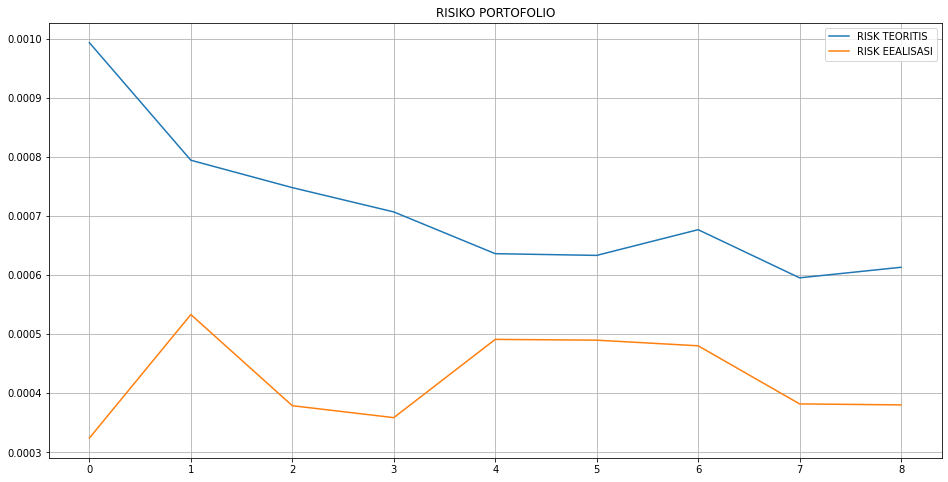

In [ ]:
Risk_P_Teoritis = risk_ER_PORTOFOLIO['Risk Portofolio teoritis']
Risk_P_Realisasi = risk_ER_PORTOFOLIO['Risk Portofolio Realisasi 2019']
plt.figure(figsize=(16,8))
plt.title('RISIKO PORTOFOLIO')
plt.plot(Risk_P_Teoritis,label='RISK TEORITIS')
plt.plot(Risk_P_Realisasi,label='RISK EEALISASI')
plt.grid()
plt.legend(loc='best')
plt.show()

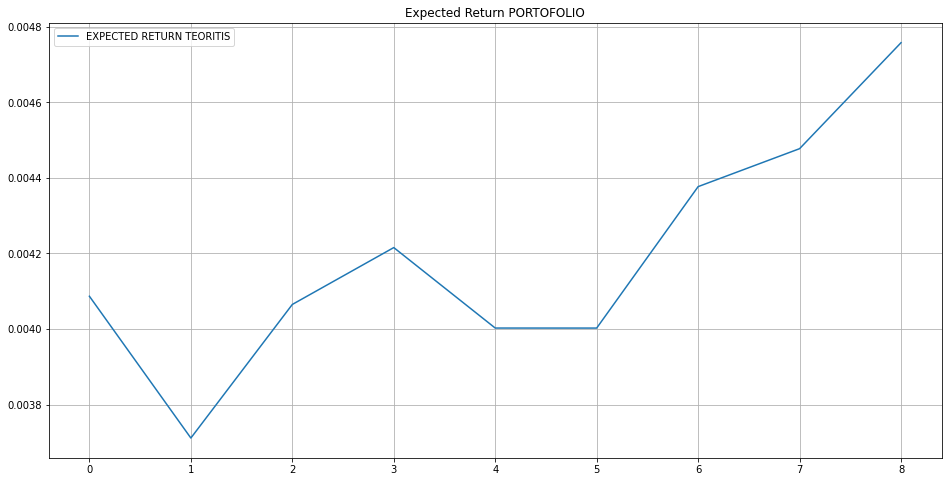

In [ ]:
Ekpected_P_Teoritis = risk_ER_PORTOFOLIO['Expected Return Portofolio teoritis']
plt.figure(figsize=(16,8))
plt.title('Expected Return PORTOFOLIO')
plt.plot(Ekpected_P_Teoritis,label='EXPECTED RETURN TEORITIS')
plt.grid()
plt.legend(loc='best')
plt.show()

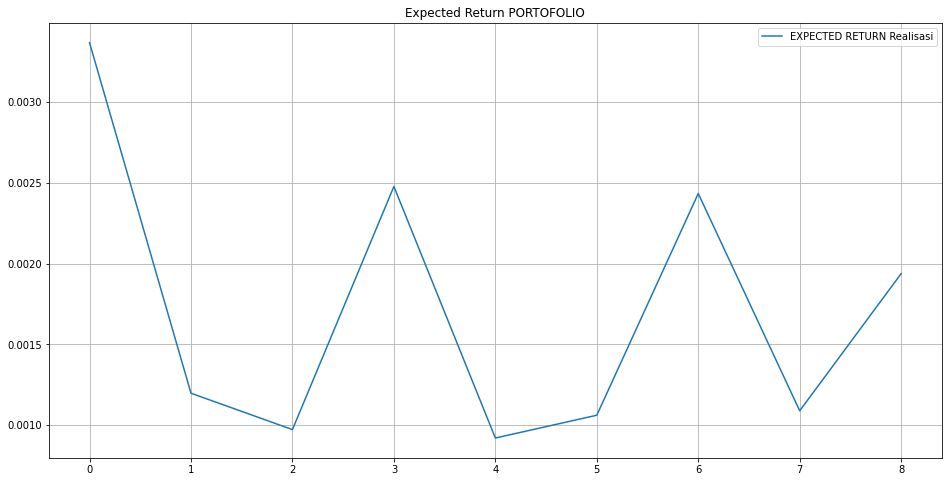

In [ ]:
Ekpected_P_Realisasi = risk_ER_PORTOFOLIO['Expected Return Portofolio Realisasi 2019']
Ekpected_P_Teoritis = risk_ER_PORTOFOLIO['Expected Return Portofolio teoritis']
plt.figure(figsize=(16,8))
plt.title('Expected Return PORTOFOLIO')
plt.plot(Ekpected_P_Realisasi,label='EXPECTED RETURN Realisasi')
plt.grid()
plt.legend(loc='best')
plt.show()

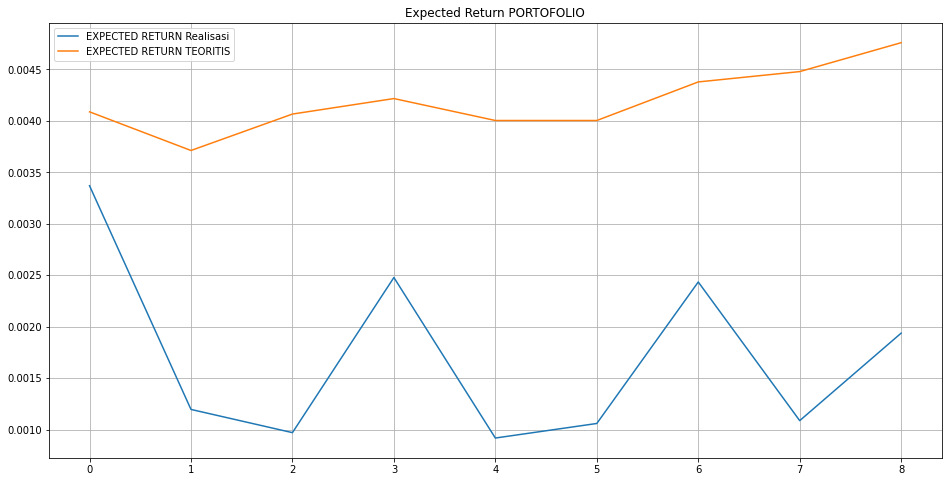

In [ ]:
Ekpected_P_Realisasi = risk_ER_PORTOFOLIO['Expected Return Portofolio Realisasi 2019']
plt.figure(figsize=(16,8))
plt.title('Expected Return PORTOFOLIO')
plt.plot(Ekpected_P_Realisasi,label='EXPECTED RETURN Realisasi')
plt.plot(Ekpected_P_Teoritis,label='EXPECTED RETURN TEORITIS')
plt.grid()
plt.legend(loc='best')
plt.show()

##**SHARPE RATIO**

**TEORITIS**

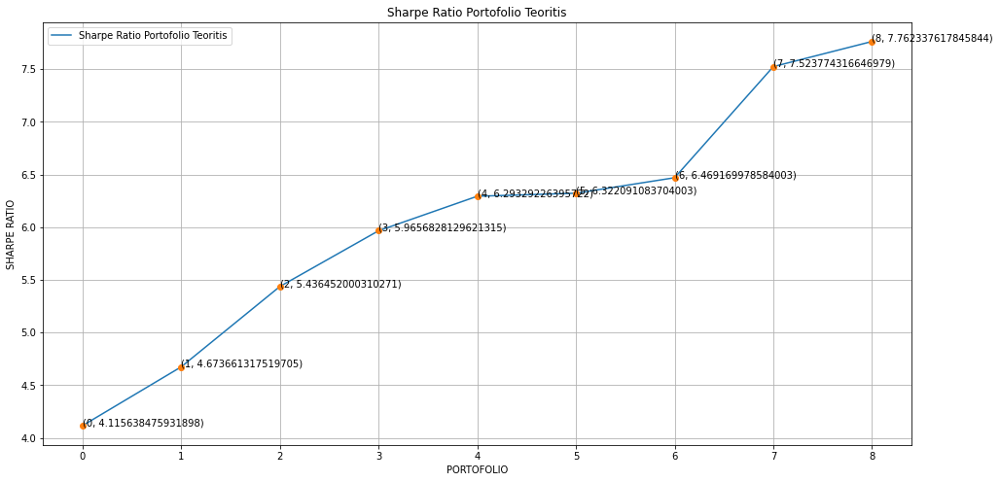

In [ ]:
Risk_P_Teoritis = risk_ER_PORTOFOLIO['Risk Portofolio teoritis']
Expected_P_Teoritis = risk_ER_PORTOFOLIO['Expected Return Portofolio teoritis'] 

sharpe_ratio_P1 = Expected_P_Teoritis[0]/Risk_P_Teoritis[0]
sharpe_ratio_P2 = Expected_P_Teoritis[1]/Risk_P_Teoritis[1]
sharpe_ratio_P3 = Expected_P_Teoritis[2]/Risk_P_Teoritis[2]
sharpe_ratio_P4 = Expected_P_Teoritis[3]/Risk_P_Teoritis[3]
sharpe_ratio_P5 = Expected_P_Teoritis[4]/Risk_P_Teoritis[4]
sharpe_ratio_P6 = Expected_P_Teoritis[5]/Risk_P_Teoritis[5]
sharpe_ratio_P7 = Expected_P_Teoritis[6]/Risk_P_Teoritis[6]
sharpe_ratio_P8 = Expected_P_Teoritis[7]/Risk_P_Teoritis[7]
sharpe_ratio_P9 = Expected_P_Teoritis[8]/Risk_P_Teoritis[8]
sharpe_ratio = np.array([sharpe_ratio_P1, sharpe_ratio_P2, sharpe_ratio_P3, sharpe_ratio_P4, sharpe_ratio_P5, sharpe_ratio_P6, sharpe_ratio_P7, sharpe_ratio_P8, sharpe_ratio_P9])


Periode = np.array([0, 1, 2,3,4,5,6,7,8,9])
fig = plt.figure(figsize=(16,8))
ax = fig.add_subplot(111)
plt.title('Sharpe Ratio Portofolio Teoritis')
plt.plot(sharpe_ratio,'-', label='Sharpe Ratio Portofolio Teoritis')
plt.plot(sharpe_ratio,'o')
plt.xlabel('PORTOFOLIO')
plt.ylabel('SHARPE RATIO')
for xy in zip(Periode, sharpe_ratio):                                      
    ax.annotate('(%s, %s)' % xy, xy=xy, textcoords='data')
plt.grid()
plt.legend(loc='best')
plt.show()

**REALISASI 2019**

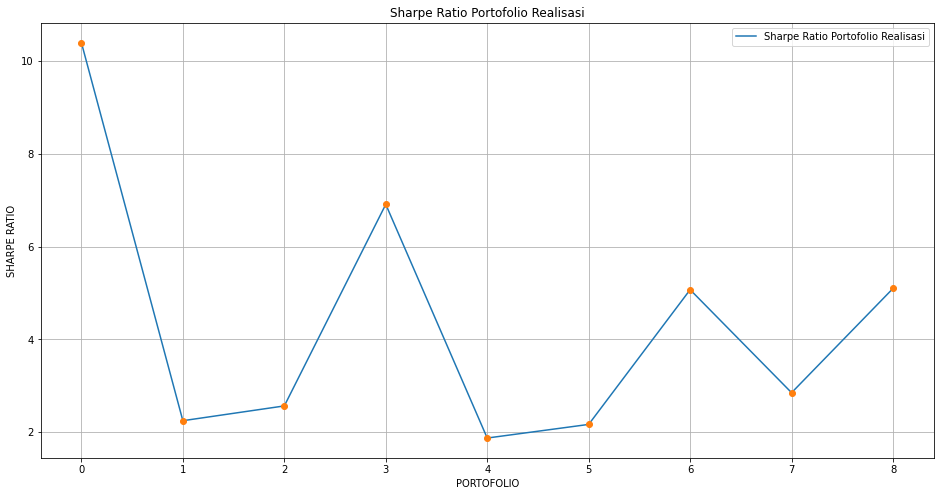

In [ ]:
Risk_P_Realisasi = risk_ER_PORTOFOLIO['Risk Portofolio Realisasi 2019']
Expected_P_Realisasi = risk_ER_PORTOFOLIO['Expected Return Portofolio Realisasi 2019'] 

sharpe_ratio_P1_Realisasi = Expected_P_Realisasi[0]/Risk_P_Realisasi[0]
sharpe_ratio_P2_Realisasi = Expected_P_Realisasi[1]/Risk_P_Realisasi[1]
sharpe_ratio_P3_Realisasi = Expected_P_Realisasi[2]/Risk_P_Realisasi[2]
sharpe_ratio_P4_Realisasi = Expected_P_Realisasi[3]/Risk_P_Realisasi[3]
sharpe_ratio_P5_Realisasi = Expected_P_Realisasi[4]/Risk_P_Realisasi[4]
sharpe_ratio_P6_Realisasi = Expected_P_Realisasi[5]/Risk_P_Realisasi[5]
sharpe_ratio_P7_Realisasi = Expected_P_Realisasi[6]/Risk_P_Realisasi[6]
sharpe_ratio_P8_Realisasi = Expected_P_Realisasi[7]/Risk_P_Realisasi[7]
sharpe_ratio_P9_Realisasi = Expected_P_Realisasi[8]/Risk_P_Realisasi[8]
sharpe_ratio_Realisasi = np.array([sharpe_ratio_P1_Realisasi, sharpe_ratio_P2_Realisasi, sharpe_ratio_P3_Realisasi, sharpe_ratio_P4_Realisasi, sharpe_ratio_P5_Realisasi, sharpe_ratio_P6_Realisasi, sharpe_ratio_P7_Realisasi, sharpe_ratio_P8_Realisasi, sharpe_ratio_P9_Realisasi])

sharpe_ratio_Realisasi

# Periode = np.array([0, 1, 2,3,4,5,6,7,8,9])
plt.figure(figsize=(16,8))
# ax = fig.add_subplot(111)
plt.title('Sharpe Ratio Portofolio Realisasi')
plt.plot(sharpe_ratio_Realisasi,'-', label='Sharpe Ratio Portofolio Realisasi')
plt.plot(sharpe_ratio_Realisasi,'o')
plt.xlabel('PORTOFOLIO')
plt.ylabel('SHARPE RATIO')
# for xy in zip(Periode, sharpe_ratio):                                      
#     ax.annotate('(%s, %s)' % xy, xy=xy, textcoords='data')
plt.grid()
plt.legend(loc='best')
plt.show()

##**PERUBAHAN KEKAYAAN**

In [ ]:
Return_teoritis = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Return Portofolio Teoritis.csv')
Return_realisasi = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Return Portofolio Realisasi.csv')
# RETURN TEORITIS
R_P1 = Return_teoritis['Portofolio 1']
R_P2 = Return_teoritis['Portofolio 2']
R_P3 = Return_teoritis['Portofolio 3']
R_P4 = Return_teoritis['Portofolio 4']
R_P5 = Return_teoritis['Portofolio 5']
R_P6 = Return_teoritis['Portofolio 6']
R_P7 = Return_teoritis['Portofolio 7']
R_P8 = Return_teoritis['Portofolio 8']
R_P9 = Return_teoritis['Portofolio 9']
# RETURN REALISASI
R_P1_Uji = Return_realisasi['Portofolio 1']
R_P2_Uji = Return_realisasi['Portofolio 2']
R_P3_Uji = Return_realisasi['Portofolio 3']
R_P4_Uji = Return_realisasi['Portofolio 4']
R_P5_Uji = Return_realisasi['Portofolio 5']
R_P6_Uji = Return_realisasi['Portofolio 6']
R_P7_Uji = Return_realisasi['Portofolio 7']
R_P8_Uji = Return_realisasi['Portofolio 8']
R_P9_Uji = Return_realisasi['Portofolio 9']

**PORTOFOLIO 1**

No handles with labels found to put in legend.


[1, 0.877051333, 0.8189168343777854, 0.8274212586785432, 0.8453003965027027, 0.7860318920869904, 0.7819288700649115, 0.723785600277466, 0.7805700439333305, 0.8326078636884489, 0.8304460015334211, 0.9301582541804441, 0.9559924639511022, 0.9551282199959014, 1.0501932368154439, 1.0883989611645577, 1.0837716231855758, 1.1093929825113478, 1.0675008690465928, 1.129955803745812, 1.1075548355906848, 1.1266313379278021, 1.2249836534637712, 1.1368344042778518, 1.134896504057937, 1.1263808331074614, 1.1300943000810009, 1.1611837853155482, 1.1378477639168243, 1.1575303944923325, 1.2552901078068874, 1.33319815187283, 1.294757772254665, 1.335349666203279, 1.313088656831403, 1.3737923528232105, 1.3454508379914618, 1.4023732746294957, 1.4065946018970295, 1.4872298528372747, 1.4530325981689136, 1.4512871631028197, 1.3923999586709828, 1.3923999586709828, 1.412129682669768, 1.431213707331664, 1.4464464711910079, 1.4892922927648182, 1.435384994721327, 1.461490598554238, 1.437491769809895, 1.46762216942683

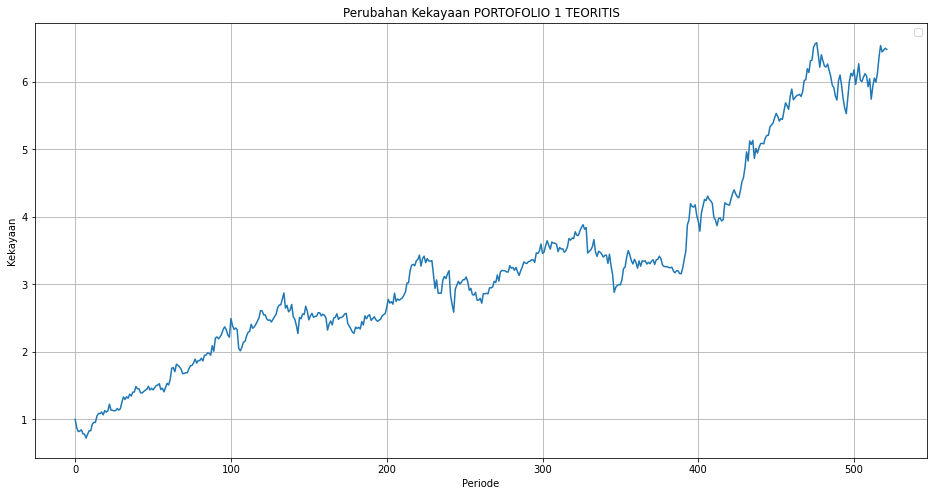

In [ ]:
#TEORITIS
v0 = 1
Vp_1 = [v0]
x1 = 1
for i in range(521):
    x1 = x1 + (x1 * R_P1[i])
    Vp_1.append(x1)
print (Vp_1)

plt.figure(figsize=(16,8))
# plt.plot(Vp_1,'o')
plt.plot(Vp_1,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 1 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 0.990408227, 1.049950457378801, 1.040536386338099, 1.0460678736057267, 1.061303622049862, 1.0643412141695503, 1.0606581486738962, 1.0631049268635064, 1.0485443823875817, 1.0478257404756803, 1.030700495703642, 1.0316251639165508, 1.032639278274935, 1.029516377798051, 1.0493143040997992, 1.0551270793229046, 1.0414143766323647, 1.043080961432019, 0.9978504925839622, 1.0395463749097784, 1.0535970853850558, 1.065640045650851, 1.073970673920046, 1.0993957257039777, 1.116446156167701, 1.0888656065321651, 1.12716150099229, 1.1638446045874347, 1.135401869506075, 1.100111642406237, 1.1136120155618623, 1.111035821160646, 1.1073771468704894, 1.097128981541011, 1.095530281394366, 1.0969325338618239, 1.096476698062715, 1.1029652272112747, 1.0938475166300627, 1.1135857205119255, 1.1223928806658818, 1.1225912153446456, 1.1291451217651145, 1.1248898514295682, 1.1191155679690998, 1.1147201397363846, 1.1408114086345906, 1.1340968744637854, 1.1354436814139268, 1.1766564674167082, 1.1814288283765837, 1

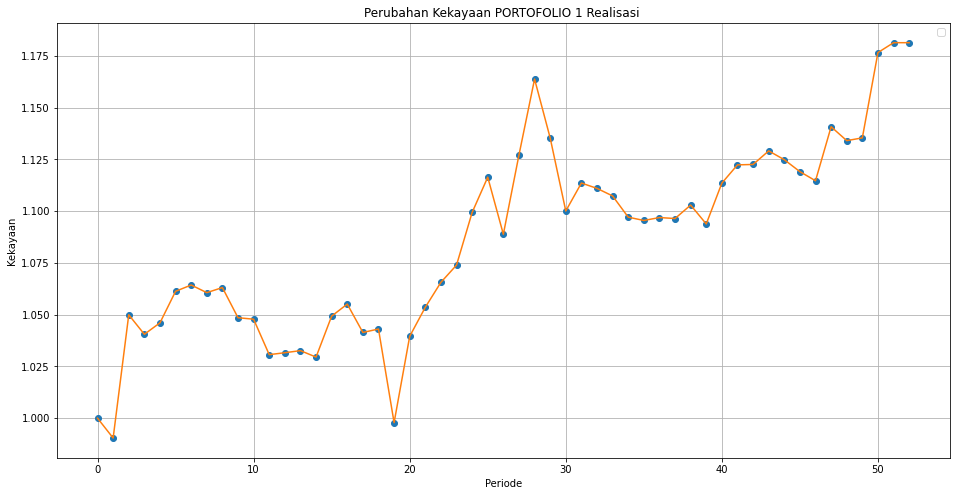

In [ ]:
#REALISASI
v0 = 1
Vp_1_Uji = [v0]
x1_Uji = 1
for i in range(52):
    x1_Uji = x1_Uji + (x1_Uji * R_P1_Uji[i])
    Vp_1_Uji.append(x1_Uji)
print (Vp_1_Uji)
 
plt.figure(figsize=(16,8))
plt.plot(Vp_1_Uji,'o')
plt.plot(Vp_1_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 1 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 2**

No handles with labels found to put in legend.


[1, 0.927335737, 0.8648386915101534, 0.8719064784765224, 0.8929657638214181, 0.842176899222161, 0.840188623993033, 0.7932753730762423, 0.8427703827088227, 0.8873724376607752, 0.8903018040434354, 1.001334572930939, 1.0334410252249764, 1.049945763569219, 1.1446370667562633, 1.1665880510768925, 1.1619303934533296, 1.198430806575324, 1.230572219863597, 1.2738769669040397, 1.2676621848737308, 1.2788903416831525, 1.4000770376877436, 1.320122408472859, 1.294173912116126, 1.28900846025061, 1.2841230034645073, 1.3429551515172768, 1.3689148882262925, 1.4285955760147406, 1.5167957882848502, 1.592694787339484, 1.5241661094041714, 1.5600200716969856, 1.54128629922252, 1.6209138827305802, 1.587902130150601, 1.6573929464219512, 1.6662070400084916, 1.7371938898058208, 1.7047858342279678, 1.695216163854325, 1.6236081106824811, 1.6179531047398794, 1.623215760939402, 1.6422674897755891, 1.6406688146340622, 1.6815224032996747, 1.6285633966579653, 1.654564935620949, 1.6271068596894167, 1.6523520767144555, 

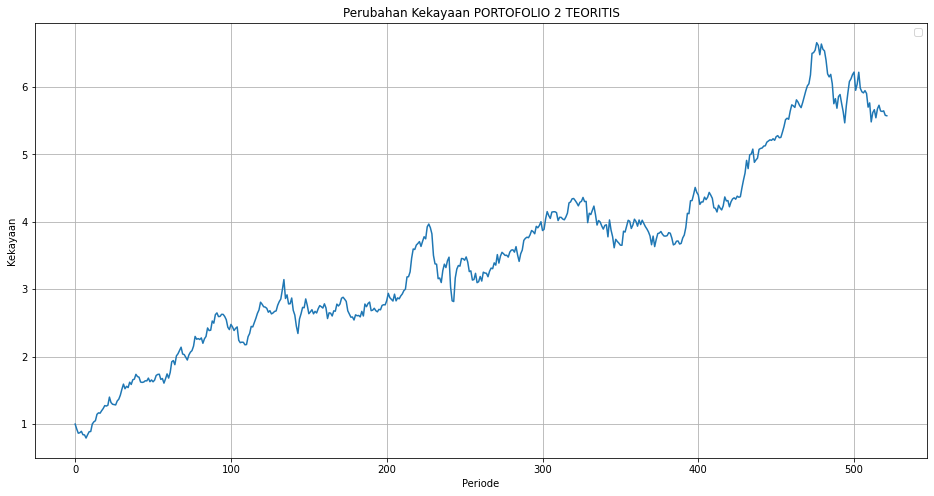

In [ ]:
#TEORITIS
v0 = 1
Vp_2 = [v0]
x2 = 1
for i in range(521):
    x2 = x2 + (x2 * R_P2[i])
    Vp_2.append(x2)
print (Vp_2)

plt.figure(figsize=(16,8))
# plt.plot(Vp_2,'o')
plt.plot(Vp_2,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 2 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.02651607, 1.0853371745966423, 1.1088078720996228, 1.102080885537465, 1.1249858899451577, 1.1119900518195254, 1.149127053477306, 1.133232418854645, 1.0995387457468202, 1.1090909424198683, 1.0709009441085957, 1.0301586140710692, 1.0270630925119644, 1.0214151503457332, 1.0419080445825102, 1.0422019407941858, 1.0090924170178486, 0.9854119897676078, 0.950435904706355, 1.0021493836513016, 1.0260041176576515, 1.0376411353624417, 1.0333641134958254, 1.0869847252923681, 1.0933630690495446, 1.0843055094350653, 1.1035186613972863, 1.112520630326896, 1.0802622624851361, 1.041567665779431, 1.050175035149959, 1.0664259298749108, 1.0445351819293491, 1.0350154073582558, 1.0499058645543122, 1.034251228462193, 1.037857129856458, 1.0318899692504913, 1.0052395523607627, 1.038975477183352, 1.0593917858356072, 1.0570008953649606, 1.0637932106005992, 1.0509508542897903, 1.0487857116135537, 1.0324985100021942, 1.0172372032157742, 1.0358033273577738, 1.0222080793007449, 1.0422489235780312, 1.049894851258

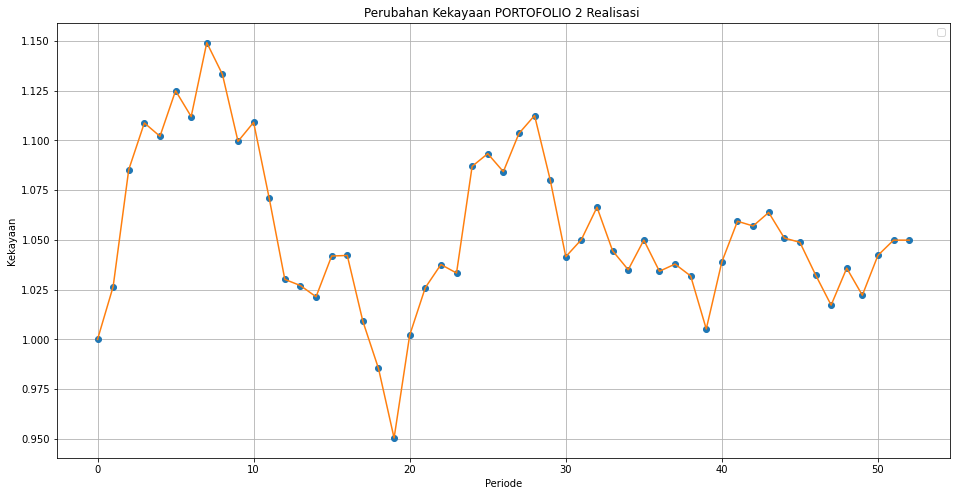

In [ ]:
#REALISASI
v0 = 1
Vp_2_Uji = [v0]
x2_Uji = 1
for i in range(52):
    x2_Uji = x2_Uji + (x2_Uji * R_P2_Uji[i])
    Vp_2_Uji.append(x2_Uji)
print (Vp_2_Uji)

plt.figure(figsize=(16,8))
plt.plot(Vp_2_Uji,'o')
plt.plot(Vp_2_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 2 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 3**

No handles with labels found to put in legend.


[1, 0.936206951, 0.8793885605058794, 0.8802168970428937, 0.8905377517575033, 0.8518429967964257, 0.8514364743185936, 0.8079944527256337, 0.8536449248889696, 0.8936503566211322, 0.895306322903364, 1.023262028003199, 1.052626550792732, 1.0785897436146439, 1.185567759309806, 1.1882157924775867, 1.2086304685973546, 1.2514216447849245, 1.2305692259406196, 1.2703355085595351, 1.2578123619988486, 1.2962025537087356, 1.3744962573603905, 1.3110411476854051, 1.2940662916560164, 1.2848012648707512, 1.2948631358693372, 1.3371963333302672, 1.3556206844064302, 1.4721881523454103, 1.566140045328884, 1.664939481092942, 1.6064965107022402, 1.6487158462591762, 1.6786733775519074, 1.7430319908496887, 1.72529306538418, 1.789679241060098, 1.8401651152855376, 1.9437029200591407, 1.9044199240569037, 1.8920849847822676, 1.7966318932406014, 1.7998745173636383, 1.7909381043874375, 1.8286433135177425, 1.820676699088727, 1.8635530199635424, 1.8348427084292136, 1.8732804136536452, 1.8498101470425128, 1.88684567694

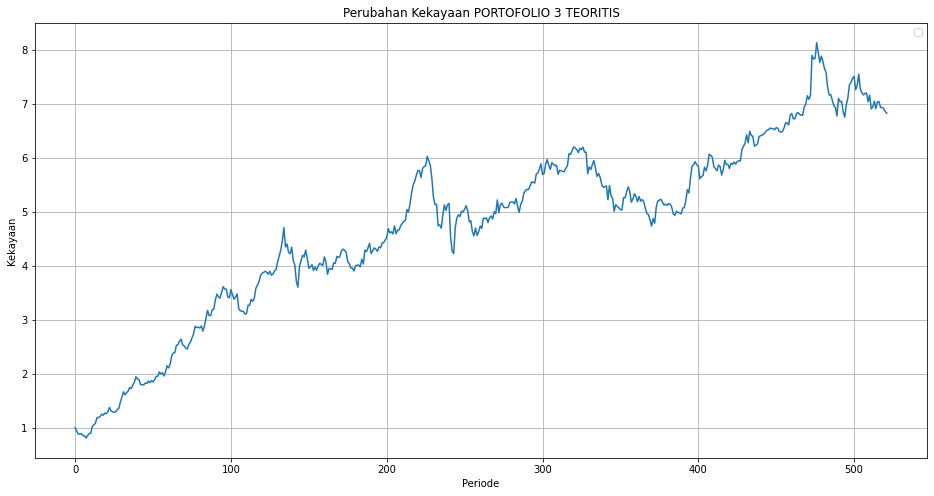

In [ ]:
#TEORITIS
v0 = 1
Vp_3 = [v0]
x3 = 1
for i in range(521):
    x3 = x3 + (x3 * R_P3[i])
    Vp_3.append(x3)
print (Vp_3)

plt.figure(figsize=(16,8))
# plt.plot(Vp_3,'o')
plt.plot(Vp_3,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 3 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.022054085, 1.0787883849344604, 1.0958358024600507, 1.093958312458875, 1.1160230096620123, 1.0991512528076943, 1.127923133916706, 1.1146484418768627, 1.0932988847289675, 1.1007552017089002, 1.0769284560509111, 1.044718455319686, 1.0420885395844977, 1.0421222331206215, 1.0645715468967272, 1.0694999276445083, 1.041090698394494, 1.0273076746933634, 0.9913704438460855, 1.033541568965574, 1.049233076121833, 1.0573108802512874, 1.0547948662747606, 1.083010387399586, 1.0899242152456854, 1.0879473695599804, 1.1032620793850128, 1.0979597477716465, 1.0769672723373744, 1.0399036439757963, 1.044583897749996, 1.066808719636996, 1.052422130896389, 1.0388965721624939, 1.0479703997523149, 1.038955544587684, 1.0415331423849843, 1.0369410467154712, 1.009291168209019, 1.0404579805727792, 1.0471977104938424, 1.0537807429716466, 1.0474286949134137, 1.0376542013599235, 1.0347708830448008, 1.0224227623866469, 1.0124720553450195, 1.0279362102903327, 1.0115796348315738, 1.0380230184065413, 1.0421238207248

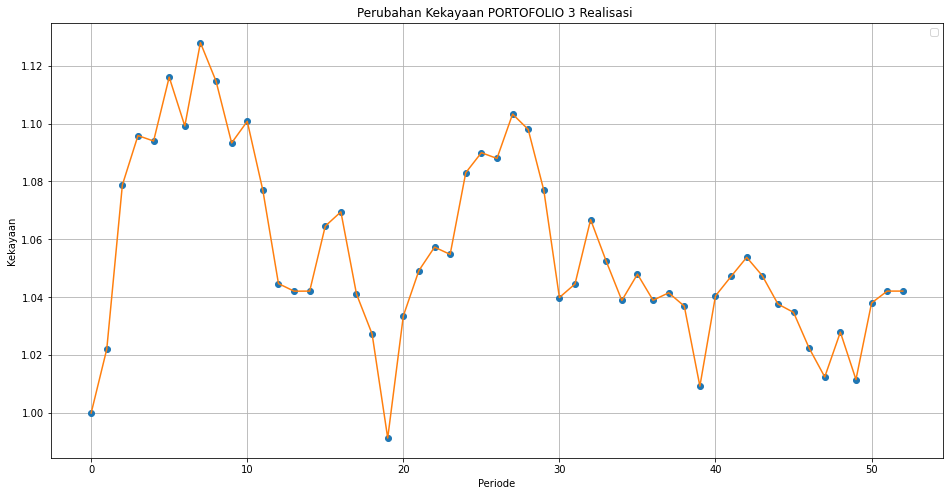

In [ ]:
#REALISASI
v0 = 1
Vp_3_Uji = [v0]
x3_Uji = 1
for i in range(52):
    x3_Uji = x3_Uji + (x3_Uji * R_P3_Uji[i])
    Vp_3_Uji.append(x3_Uji)
print (Vp_3_Uji)

plt.figure(figsize=(16,8))
plt.plot(Vp_3_Uji,'o')
plt.plot(Vp_3_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 3 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 4**

No handles with labels found to put in legend.


[1, 0.915234433, 0.8771580721690659, 0.876890400366079, 0.8785095898899302, 0.8685786038578909, 0.8675431721728105, 0.834759637894792, 0.8711830666259787, 0.9035558800373903, 0.901869200529898, 1.0124879528909856, 1.0395732317537305, 1.0454444793942212, 1.1482445823108844, 1.1528951244375283, 1.1837194334525545, 1.2509764220754218, 1.265725282723544, 1.3072474904897848, 1.2656897005928673, 1.3191593264920194, 1.3930752467738194, 1.3144451358218543, 1.3124190974095233, 1.3061363752633222, 1.3090052332802238, 1.3145015512129876, 1.3163601946248298, 1.4020130829105928, 1.4915428553892938, 1.6193602415299941, 1.5679211857285023, 1.632756746240863, 1.6233538144322341, 1.6770419545671564, 1.6642289180033552, 1.709554691853852, 1.7568719722762023, 1.852953952919185, 1.844756855222261, 1.8406371903321002, 1.7620911457242732, 1.7576730228769581, 1.766174031301852, 1.804046865808413, 1.822476131822735, 1.8642257649659475, 1.8466532336162893, 1.8836917754280127, 1.8431422602649403, 1.883210860685

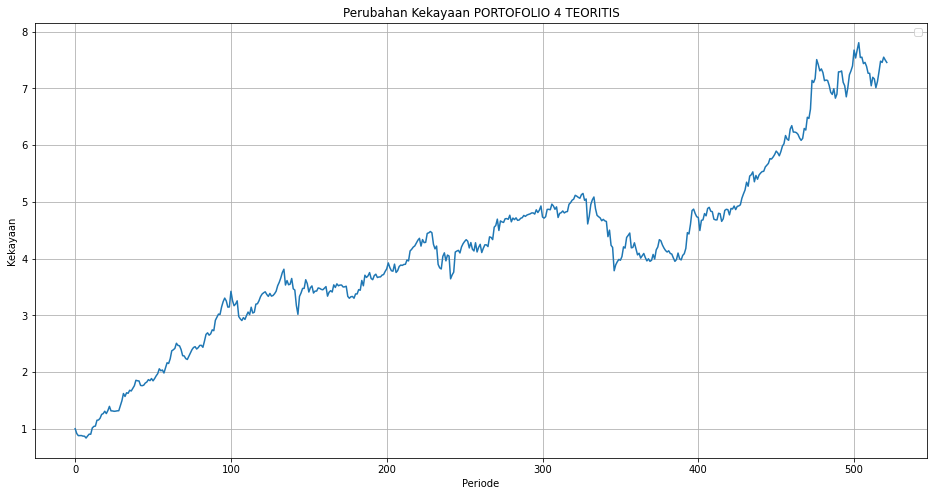

In [ ]:
#TEORITIS
v0 = 1
Vp_4 = [v0]
x4 = 1
for i in range(521):
    x4 = x4 + (x4 * R_P4[i])
    Vp_4.append(x4)
print (Vp_4)

plt.figure(figsize=(16,8))
# plt.plot(Vp_4,'o')
plt.plot(Vp_4,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 4 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.010803081, 1.049258872958801, 1.0777047122501109, 1.0692732118390829, 1.0772137277369693, 1.0693520883774428, 1.0627978487072745, 1.0488919189505608, 1.0327678111442227, 1.0313076447676501, 1.0056451432726878, 0.9939150056788185, 1.0097671220881959, 1.011019852306831, 1.0091915786009913, 1.001647988617172, 0.9903236329127112, 0.9739335500038939, 0.94064187553991, 0.980311849430901, 1.001284808770952, 1.0042829368494435, 0.9960825860468348, 1.024703206286584, 1.0455726202214817, 1.0186182745850463, 1.0295979242965405, 1.033532977550543, 1.0161999732235798, 0.9825101820796909, 1.0055640485845747, 1.0209716488621483, 1.014028343305278, 1.0011196205310338, 1.001270557333982, 1.0064165423062248, 1.0072393109771407, 1.0054930662271355, 0.9903735222923967, 1.005770145384167, 1.0066131306257506, 1.025826006155248, 1.046484182591543, 1.065571224220056, 1.0555220542989634, 1.0596882948442663, 1.068662053231496, 1.0878860770496726, 1.079298512143683, 1.1144965207501156, 1.1286866404042135, 

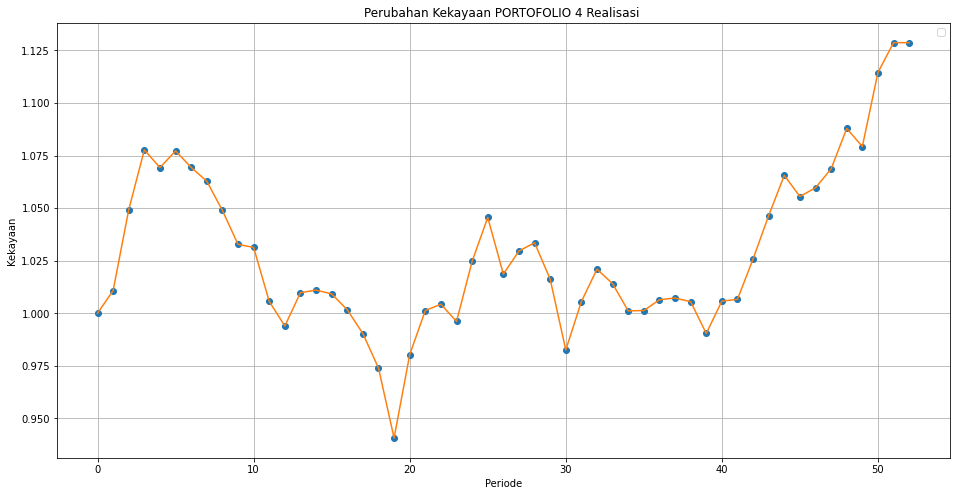

In [ ]:
#REALISASI
v0 = 1
Vp_4_Uji = [v0]
x4_Uji = 1
for i in range(52):
    x4_Uji = x4_Uji + (x4_Uji * R_P4_Uji[i])
    Vp_4_Uji.append(x4_Uji)
print (Vp_4_Uji)

plt.figure(figsize=(16,8))
plt.plot(Vp_4_Uji,'o')
plt.plot(Vp_4_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 4 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 5**

No handles with labels found to put in legend.


[1, 0.967669759, 0.9107537403770231, 0.9122918786712574, 0.9243007944998876, 0.8913489803722446, 0.8935643141702904, 0.8546215875568254, 0.8839159926889756, 0.9011773737885836, 0.8998406664018168, 1.0086087125875525, 1.026773949154127, 1.06627479417369, 1.1799042314631496, 1.2073328810793789, 1.2237765472584246, 1.2717712693854817, 1.3214538088810688, 1.3547911257796987, 1.3446677918544647, 1.432888467238877, 1.5022231689622707, 1.4339894705996221, 1.4040600066856546, 1.3966932997754968, 1.423152668274274, 1.4532530388604716, 1.4665880306149337, 1.5629605791431567, 1.653073283896294, 1.7317818010862063, 1.6684595735943581, 1.7439699361370111, 1.737166317022905, 1.7907339719113773, 1.7893676383093409, 1.8358043535257937, 1.884143373237961, 1.945705700473948, 1.9204854787500503, 1.9203990569035065, 1.837614888040317, 1.836547064729796, 1.8388773803287077, 1.8811793366887095, 1.8838537021244577, 1.9072465854564935, 1.902213825178394, 1.917443550162341, 1.8898824217387673, 1.90880313646424

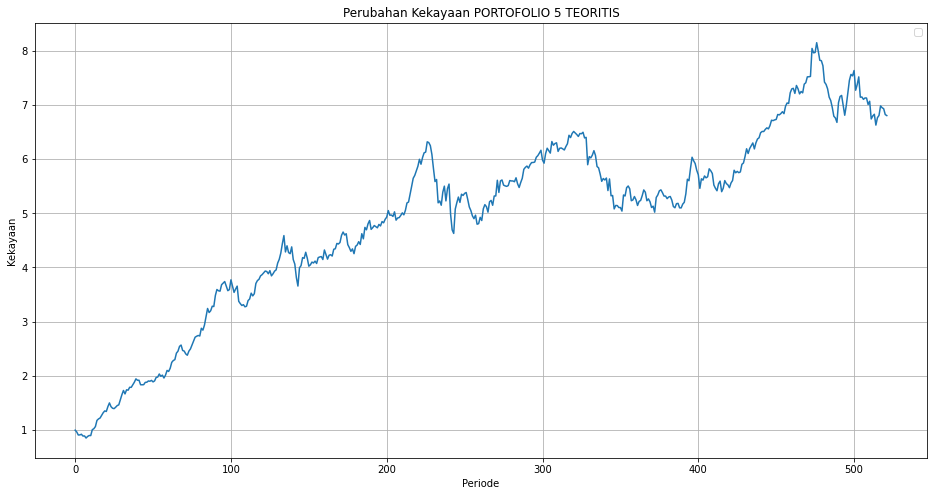

In [ ]:
#TEORITIS
v0 = 1
Vp_5 = [v0]
x5 = 1
for i in range(521):
    x5 = x5 + (x5 * R_P5[i])
    Vp_5.append(x5)
print (Vp_5)

plt.figure(figsize=(16,8))
# plt.plot(Vp_5,'o')
plt.plot(Vp_5,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 5 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.018776816, 1.0568075579173544, 1.073841058489382, 1.0696087115441009, 1.0970938540414235, 1.092080926133123, 1.1015759210897804, 1.1145125533130786, 1.0780713307848382, 1.0926487439580208, 1.064456895230691, 1.0815575016982615, 1.085604419480241, 1.087376576418667, 1.0942013541416038, 1.1054108069069923, 1.0584762302541226, 1.0326122397261441, 1.0011245334492782, 1.0537478806920204, 1.067506286367231, 1.0736179327927018, 1.073719339764117, 1.114174835044412, 1.120795963844392, 1.0962441896518405, 1.121123435092326, 1.1312793570749202, 1.0913121081115398, 1.0586043067056723, 1.0762558094346435, 1.0916298503034418, 1.075972701607226, 1.0498147475499886, 1.0562076689920414, 1.0580137566446184, 1.0579305595212618, 1.0601563279882025, 1.0326310959266471, 1.056874295950924, 1.0640568918749045, 1.0791527021138112, 1.054370103837077, 1.0353798565493086, 1.0338493777175748, 1.0178984340943786, 1.021160313038098, 1.0271478947028794, 1.0334041775477183, 1.0525604042211747, 1.045508604225749

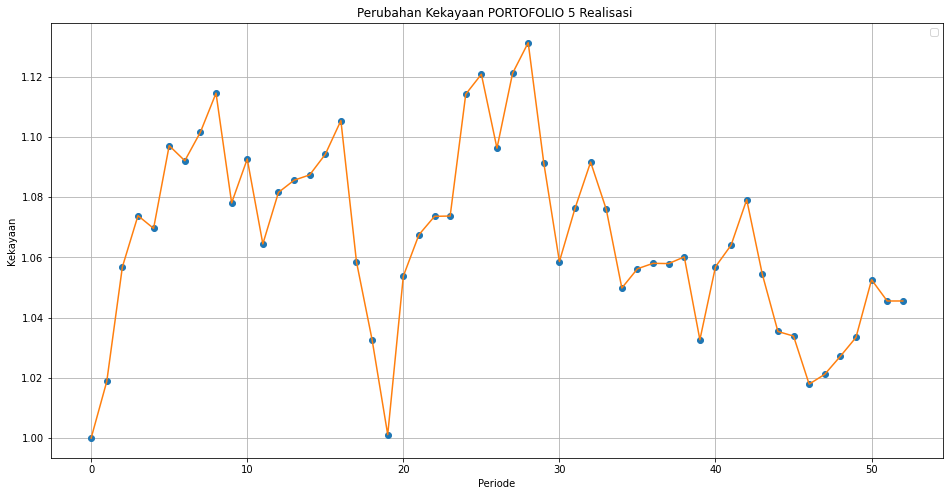

In [ ]:
#REALISASI
v0 = 1
Vp_5_Uji = [v0]
x5_Uji = 1
for i in range(52):
    x5_Uji = x5_Uji + (x5_Uji * R_P5_Uji[i])
    Vp_5_Uji.append(x5_Uji)
print (Vp_5_Uji)

plt.figure(figsize=(16,8))
plt.plot(Vp_5_Uji,'o')
plt.plot(Vp_5_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 5 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 6**

No handles with labels found to put in legend.


[1, 0.963887904, 0.9067857233129776, 0.909504384793614, 0.921001382427562, 0.8884637012773441, 0.8909057930222066, 0.8510464076979015, 0.8802456754806841, 0.8972813816452309, 0.8955145215473174, 1.0031451536941867, 1.022781305778802, 1.0637492835067353, 1.176754552631512, 1.2074538524900544, 1.2263584080669883, 1.2736167204266025, 1.320410769146667, 1.3525311858293796, 1.3411274665619584, 1.4274244109212453, 1.4955286038548408, 1.4270641912188282, 1.3962209672301642, 1.3896756732218407, 1.416024841172071, 1.44385741548394, 1.45531126491578, 1.5483845791844173, 1.6376750621319422, 1.7153012334669104, 1.6537706714771059, 1.7282486123805612, 1.7208441696991252, 1.7738671110785593, 1.7721001514060113, 1.8162551313977573, 1.863805192024167, 1.9258245492192239, 1.900548065420055, 1.9015813781988393, 1.8193817960266931, 1.8183424323299315, 1.8205310856536328, 1.8634106678330087, 1.8701236438955011, 1.8914884544276127, 1.8864979739873124, 1.900963795144681, 1.8744817118378863, 1.89321594938148

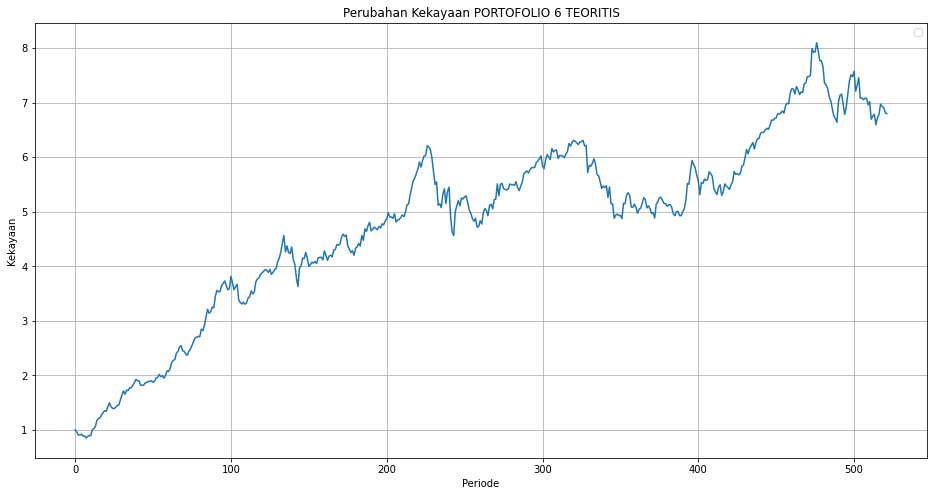

In [ ]:
#TEORITIS
v0 = 1
Vp_6 = [v0]
x6 = 1
for i in range(521):
    x6 = x6 + (x6 * R_P6[i])
    Vp_6.append(x6)
print (Vp_6)

plt.figure(figsize=(16,8))
# plt.plot(Vp_6,'o')
plt.plot(Vp_6,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 6 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.016810115, 1.0545392752764626, 1.0698860665490852, 1.0666280430799135, 1.0948313748778826, 1.0910237090117754, 1.097900527459763, 1.110382439983196, 1.0745144633380332, 1.0872565522699777, 1.0603271895389452, 1.0776723641911055, 1.0822088195421338, 1.083186793254804, 1.089719654199756, 1.1006007719282558, 1.0553941312138786, 1.0315518553752865, 0.9991918436361, 1.0498219674851812, 1.0625923976805527, 1.0688969698318787, 1.0715645101786881, 1.111944576725379, 1.118722688416172, 1.0924554175464123, 1.1179065535132433, 1.129852753355154, 1.0895047477684427, 1.0569135478822658, 1.0751384229052976, 1.0897065635876022, 1.0749763505024768, 1.0483453368102194, 1.053253469524644, 1.0562331151639015, 1.055597703277782, 1.0581303165106355, 1.0310112851189817, 1.0541341742117125, 1.061497045263977, 1.0766451420329077, 1.052580081789283, 1.0338559041797266, 1.031831384803332, 1.0162675322032404, 1.021705475092504, 1.0264170269792632, 1.0337126298482224, 1.0530782063906496, 1.0461453913351833,

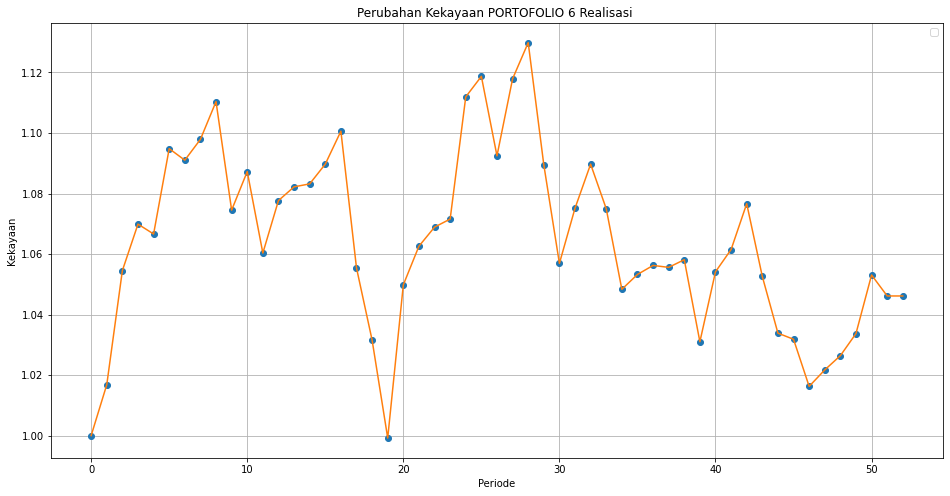

In [ ]:
#REALISASI
v0 = 1
Vp_6_Uji = [v0]
x6_Uji = 1
for i in range(52):
    x6_Uji = x6_Uji + (x6_Uji * R_P6_Uji[i])
    Vp_6_Uji.append(x6_Uji)
print (Vp_6_Uji)

plt.figure(figsize=(16,8))
plt.plot(Vp_6_Uji,'o')
plt.plot(Vp_6_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 6 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 7**

No handles with labels found to put in legend.


[1, 0.968130677, 0.9310125487800813, 0.9363624084998979, 0.9772679817962716, 0.9846772611587578, 0.9821052920300292, 0.9538601844470421, 0.979625686916073, 0.9900708380439901, 0.9960574488867779, 1.0536725971221108, 1.0639431738246796, 1.0845154577442317, 1.2038993932659718, 1.2494764900867987, 1.2811631439047164, 1.3241009551353713, 1.3698661384812185, 1.4174382305588997, 1.4125815499719157, 1.4803022562543666, 1.5883423651178705, 1.547771645812426, 1.508725516764361, 1.501913452078912, 1.5080272881644627, 1.5471966215562176, 1.5474314782673868, 1.6179322738203346, 1.7313571990735843, 1.7900659825176195, 1.7244532888586048, 1.7989311934203065, 1.7158897807651616, 1.7685758281579305, 1.767456089743849, 1.8075951518685947, 1.8532002840767627, 1.8856886845141043, 1.8746198239342144, 1.869230501897824, 1.764766983276412, 1.7765958175279755, 1.797424085030949, 1.8202283548954332, 1.8174942499510804, 1.8438626346438072, 1.829409666735025, 1.8421680758565957, 1.8220749112630736, 1.8594297026

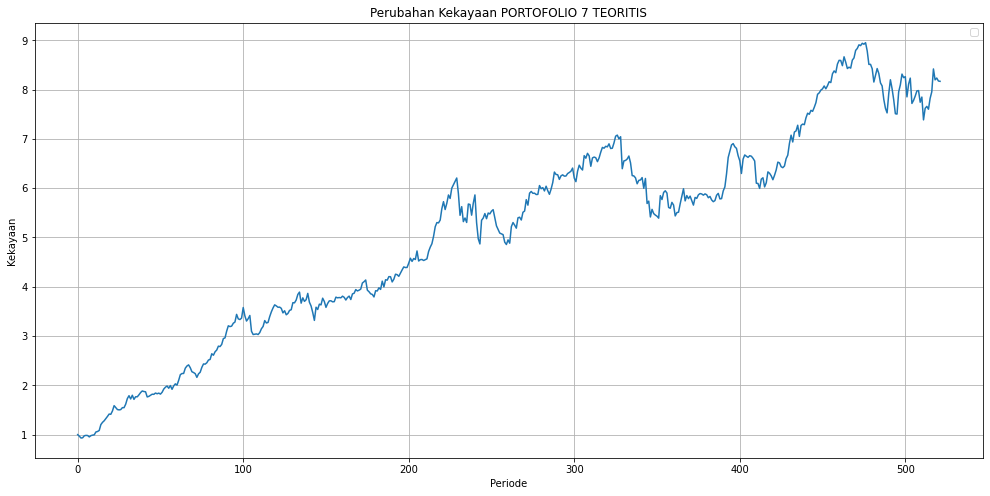

In [ ]:
#TEORITIS
v0 = 1
Vp_7 = [v0]
x7 = 1
for i in range(521):
    x7 = x7 + (x7 * R_P7[i])
    Vp_7.append(x7)
print (Vp_7)

plt.figure(figsize=(17,8))
# plt.plot(Vp_7,'o')
plt.plot(Vp_7,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 7 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.003647934, 1.0320852092518815, 1.0422103253523805, 1.0382090464582399, 1.0526157750555984, 1.050324554718961, 1.0344604064302054, 1.0588807135939449, 1.0205336196246029, 1.0424536102138386, 1.0170427307801113, 1.0529778812459103, 1.059958164282743, 1.0600852002687322, 1.0595963684807583, 1.0777815735396123, 1.0385864536566787, 1.0151962539182098, 0.973470866588402, 1.0227372468612783, 1.0429974671741509, 1.056171500387192, 1.0426980599713906, 1.0911246135758603, 1.0977869560900024, 1.0593677927128902, 1.0994717760419206, 1.1315776184938307, 1.0941851950900456, 1.059680625185701, 1.0902961007948042, 1.1030578116789405, 1.0983660876439014, 1.0919404274563331, 1.0959513670571552, 1.101499092604323, 1.09561683961252, 1.103165259458407, 1.0867167830295756, 1.1064721172307772, 1.107889076488824, 1.1123036366684569, 1.085392210994951, 1.0788936671740819, 1.0719789049572421, 1.0624785262153835, 1.089659989787527, 1.081205577265843, 1.1013910009902659, 1.127934303835931, 1.121126377745356

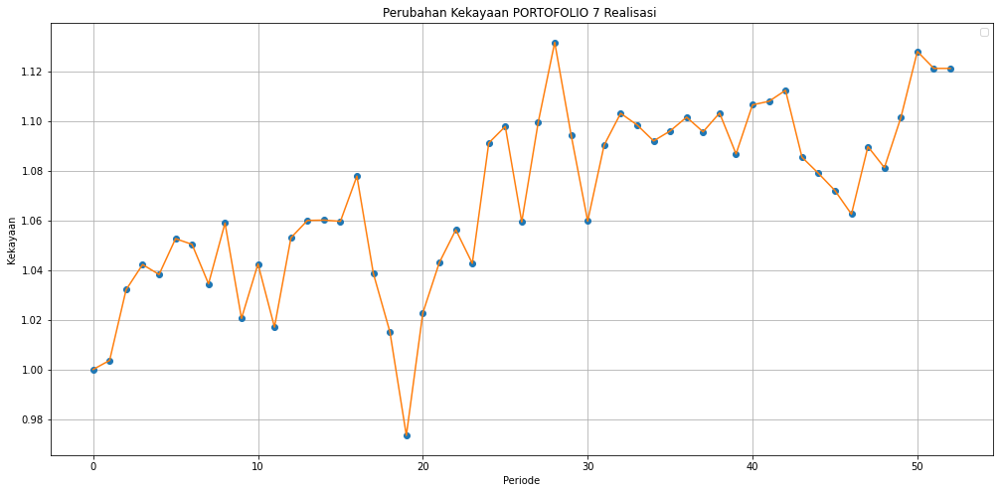

In [ ]:
#REALISASI
v0 = 1
Vp_7_Uji = [v0]
x7_Uji = 1
for i in range(52):
    x7_Uji = x7_Uji + (x7_Uji * R_P7_Uji[i])
    Vp_7_Uji.append(x7_Uji)
print (Vp_7_Uji)

plt.figure(figsize=(17,8))
plt.plot(Vp_7_Uji,'o')
plt.plot(Vp_7_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 7 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 8**

No handles with labels found to put in legend.


[1, 0.984233507, 0.9379714436462551, 0.9421587948571817, 0.9725087586800569, 0.973634950080345, 0.9728200760452247, 0.9438547250341468, 0.967579121390323, 0.9778894558299296, 0.9842209497508978, 1.0738950349955965, 1.0942486266580949, 1.135354390367862, 1.2578145834590482, 1.2878146700343611, 1.3331729502166605, 1.3785617711927542, 1.413104834633298, 1.4479871791002132, 1.4454842275580744, 1.5227448261373735, 1.6090064292889816, 1.5795338305279851, 1.5358331444571878, 1.5286006020849763, 1.543358606528857, 1.5881143084237266, 1.6124582363256643, 1.7422362505691267, 1.8453486249283824, 1.9169721761693514, 1.8484414617871887, 1.920809140957783, 1.890416437229642, 1.9386639971580741, 1.9391316785220845, 1.98271996129656, 2.06339771684938, 2.1179093830921936, 2.094477164071525, 2.0920576952638132, 1.976960220646332, 1.988411648060733, 1.9931356727091394, 2.0353823259130577, 2.031879025853696, 2.0555255828794374, 2.0588531869134865, 2.083029511346641, 2.0642336090884608, 2.0993968192090477,

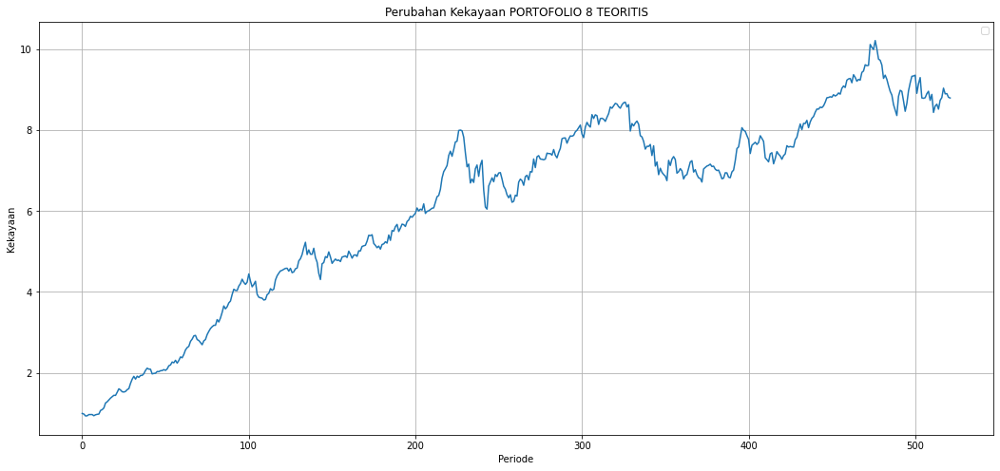

In [ ]:
#TEORITIS
v0 = 1
Vp_8 = [v0]
x8 = 1
for i in range(521):
    x8 = x8 + (x8 * R_P8[i])
    Vp_8.append(x8)
print (Vp_8)

plt.figure(figsize=(18,8))
# plt.plot(Vp_8,'o')
plt.plot(Vp_8,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 8 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.017846462, 1.0491279536021894, 1.065069830543238, 1.0601020487641715, 1.0825079554073582, 1.0745701811247415, 1.073975318414734, 1.0845784769740334, 1.0523532459126514, 1.0687154120278, 1.0419764751709188, 1.0551093872415724, 1.0610467684226779, 1.0599493882297641, 1.0647690014169313, 1.077999698580103, 1.0368052487904984, 1.012360554684885, 0.9751501623087303, 1.0191282859019628, 1.0379359345894854, 1.0478872668008665, 1.0405477103447651, 1.0799698592769784, 1.0820373416959097, 1.0603527388064953, 1.0838482288375209, 1.094671308558716, 1.0624639648506218, 1.0289672639443255, 1.0491822766102636, 1.0725385261558789, 1.0649114515772922, 1.049262757766399, 1.053907540758094, 1.0557946096356607, 1.0553130522120544, 1.0597162752164346, 1.0338861996718463, 1.0592237676641172, 1.061252323115179, 1.0702969107753197, 1.043987242437372, 1.0293314676514806, 1.0235328307322813, 1.011398009727029, 1.0210849351058762, 1.0255298515905185, 1.0312546391917463, 1.0547231567669835, 1.04842584250803

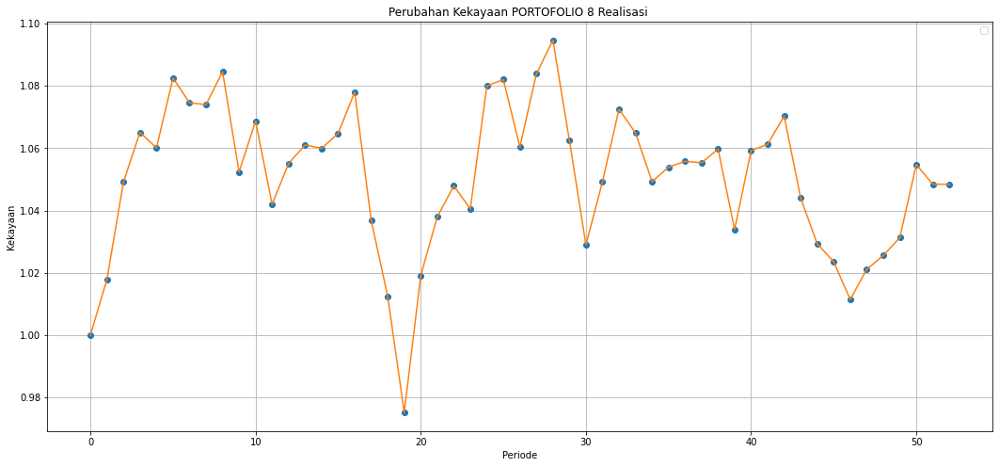

In [ ]:
#REALISASI
v0 = 1
Vp_8_Uji = [v0]
x8_Uji = 1
for i in range(52):
    x8_Uji = x8_Uji + (x8_Uji * R_P8_Uji[i])
    Vp_8_Uji.append(x8_Uji)
print (Vp_8_Uji)

plt.figure(figsize=(18,8))
plt.plot(Vp_8_Uji,'o')
plt.plot(Vp_8_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 8 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 9**

No handles with labels found to put in legend.


[1, 0.968485774, 0.9276340852517637, 0.9334006668846861, 0.9638441895494017, 0.9697566941421336, 0.9730694838640194, 0.9380097397607856, 0.963330263990739, 0.9770164897173081, 0.9818867918604383, 1.0701362071151201, 1.0832043551911892, 1.110380973246199, 1.2477249152224674, 1.2802975339988234, 1.3331575713363757, 1.3806304365671396, 1.4207999702406693, 1.4685966374379453, 1.4536887749232288, 1.5501332580802607, 1.6411791506917957, 1.6000848863775272, 1.5678784065860483, 1.5603037257360155, 1.57905358354744, 1.6112115529708164, 1.609780347583755, 1.737640398617556, 1.8637758420009534, 1.9489110014866486, 1.8814132597907127, 1.9816548886600713, 1.9379959737693968, 1.9822214973198682, 1.9918680595076568, 2.035416270892673, 2.1332898057346914, 2.198443241145417, 2.1752868692063028, 2.179186005660749, 2.1713140034805263, 2.193107862113411, 2.2124688814930913, 2.236356538524269, 2.2356379904593715, 2.26736454174679, 2.245769341065229, 2.2597793283106062, 2.1939794444326677, 2.150155604561697

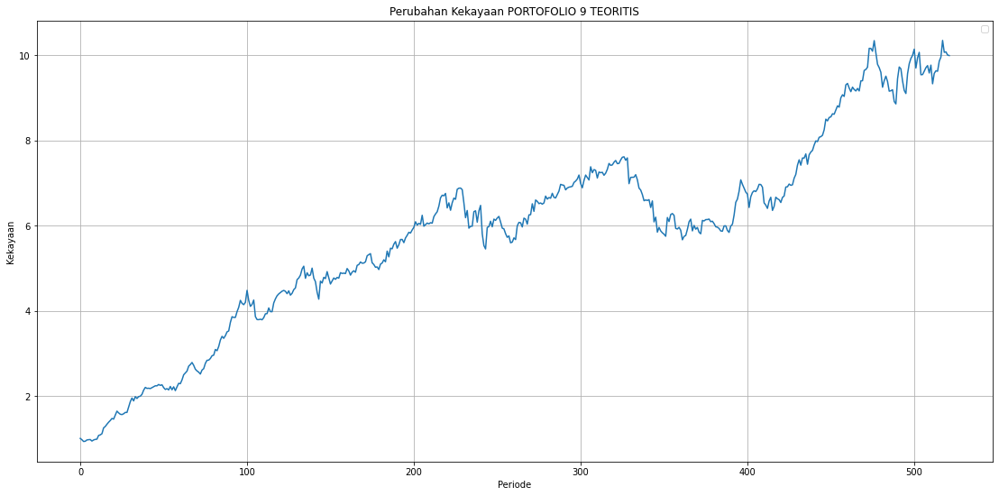

In [ ]:
#TEORITIS
v0 = 1
Vp_9 = [v0]
x9 = 1
for i in range(521):
    x9 = x9 + (x9 * R_P9[i])
    Vp_9.append(x9)
print (Vp_9)

plt.figure(figsize=(19,9))
# plt.plot(Vp_9,'o')
plt.plot(Vp_9,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 9 TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

No handles with labels found to put in legend.


[1, 1.004218992, 1.0293266007653579, 1.0287272084458332, 1.0290080674333744, 1.039145659402195, 1.0429026416939178, 1.0269697435160579, 1.049081725857958, 1.042229812222266, 1.04827605000488, 1.0294511506299344, 1.0611775781324941, 1.0692289542038993, 1.072105690112919, 1.0685761305625714, 1.0808113165717514, 1.0485204021508183, 1.0295364831149825, 0.9870618096299681, 1.0347112778199503, 1.0572352650711092, 1.0684204864326294, 1.0633911437978802, 1.0999220228684772, 1.1090513701586755, 1.075457919130367, 1.1066754727497063, 1.1239208165617236, 1.0799455320463784, 1.051348270893096, 1.0722993258117546, 1.0923194051427023, 1.0920648958136234, 1.07985212003902, 1.0856119810569205, 1.0934542379130232, 1.0868511608160023, 1.0871050351181037, 1.0622450476003007, 1.077825213473689, 1.075549373679362, 1.0922566844605563, 1.072279198291591, 1.0650019621288245, 1.056231853086029, 1.0467861385085135, 1.0737525385855462, 1.0687337870076212, 1.0805196517564855, 1.1059295797729731, 1.095955351299423

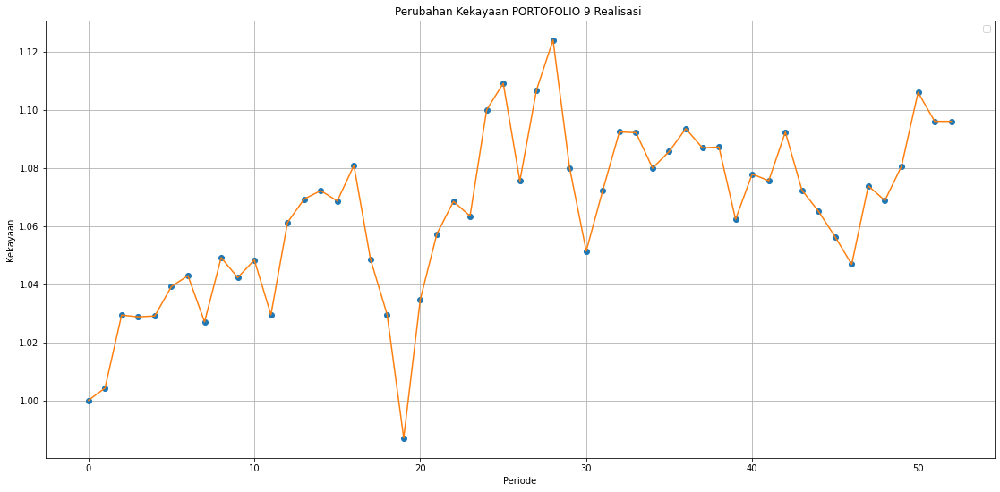

In [ ]:
#REALISASI
v0 = 1
Vp_9_Uji = [v0]
x9_Uji = 1
for i in range(52):
    x9_Uji = x9_Uji + (x9_Uji * R_P9_Uji[i])
    Vp_9_Uji.append(x9_Uji)
print (Vp_9_Uji)

plt.figure(figsize=(19,9))
plt.plot(Vp_9_Uji,'o')
plt.plot(Vp_9_Uji,'-')
plt.title('Perubahan Kekayaan PORTOFOLIO 9 Realisasi ')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PERUBAHAN KEKAYAAN TEORITIS**

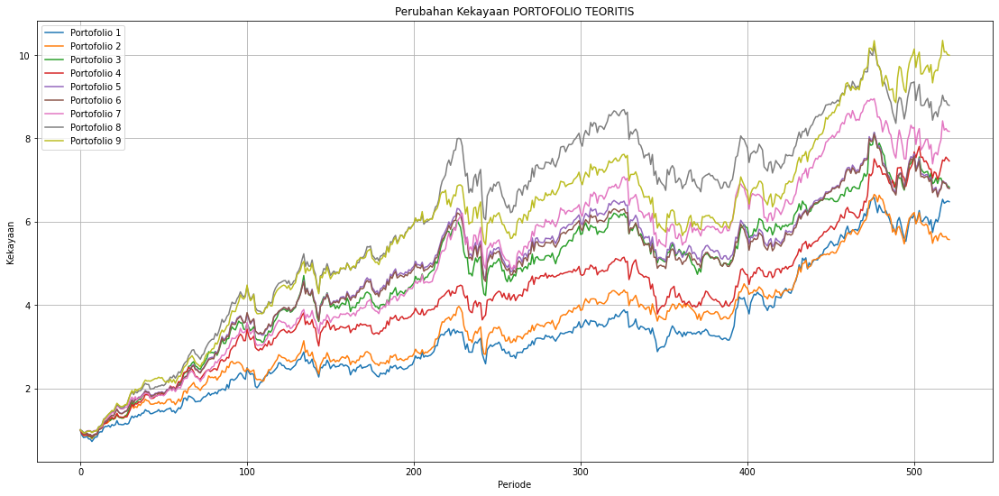

In [ ]:
#TEORITIS
plt.figure(figsize=(19,9))
plt.plot(Vp_1,'-',label='Portofolio 1')
plt.plot(Vp_2,'-',label='Portofolio 2')
plt.plot(Vp_3,'-',label='Portofolio 3')
plt.plot(Vp_4,'-',label='Portofolio 4')
plt.plot(Vp_5,'-',label='Portofolio 5')
plt.plot(Vp_6,'-',label='Portofolio 6')
plt.plot(Vp_7,'-',label='Portofolio 7')
plt.plot(Vp_8,'-',label='Portofolio 8')
plt.plot(Vp_9,'-',label='Portofolio 9')
plt.title('Perubahan Kekayaan PORTOFOLIO TEORITIS')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PERUBAHAN KEKAYAAN REALISASI**

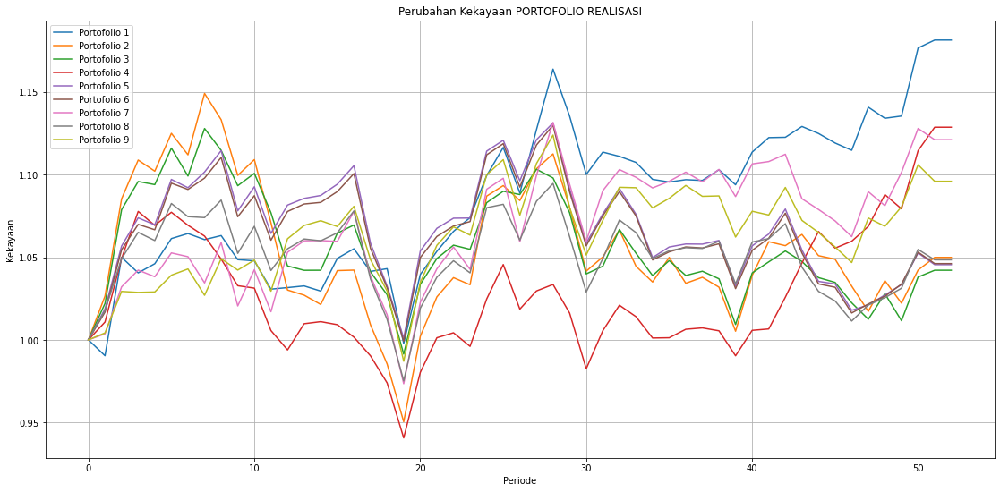

In [ ]:
plt.figure(figsize=(19,9))
plt.plot(Vp_1_Uji ,'-',label='Portofolio 1')
plt.plot(Vp_2_Uji ,'-',label='Portofolio 2')
plt.plot(Vp_3_Uji ,'-',label='Portofolio 3')
plt.plot(Vp_4_Uji ,'-',label='Portofolio 4')
plt.plot(Vp_5_Uji ,'-',label='Portofolio 5')
plt.plot(Vp_6_Uji ,'-',label='Portofolio 6')
plt.plot(Vp_7_Uji ,'-',label='Portofolio 7')
plt.plot(Vp_8_Uji ,'-',label='Portofolio 8')
plt.plot(Vp_9_Uji ,'-',label='Portofolio 9')
plt.title('Perubahan Kekayaan PORTOFOLIO REALISASI')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

In [ ]:
Vp_Uji_Portofolio = np.transpose(pd.DataFrame(np.array([Vp_1_Uji, Vp_2_Uji, Vp_3_Uji, Vp_4_Uji, Vp_5_Uji, Vp_6_Uji, Vp_7_Uji, Vp_8_Uji, Vp_9_Uji])))
Vp_Portofolio = np.transpose(pd.DataFrame(np.array([Vp_1, Vp_2, Vp_3, Vp_4, Vp_5, Vp_6, Vp_7, Vp_8, Vp_9])))
Vp_Portofolio

,0,1,2,3,4,5,6,7,8
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.877051,0.927336,0.936207,0.915234,0.967670,0.963888,0.968131,0.984234,0.968486
2,0.818917,0.864839,0.879389,0.877158,0.910754,0.906786,0.931013,0.937971,0.927634
3,0.827421,0.871906,0.880217,0.876890,0.912292,0.909504,0.936362,0.942159,0.933401
4,0.845300,0.892966,0.890538,0.878510,0.924301,0.921001,0.977268,0.972509,0.963844
...,...,...,...,...,...,...,...,...,...
517,6.536402,5.642599,6.936174,7.480338,6.980059,6.971678,8.419521,9.035377,10.350671
518,6.442999,5.635344,6.934531,7.456793,6.946321,6.931578,8.198138,8.894711,10.070478
519,6.470679,5.643850,6.921313,7.549904,6.927723,6.911225,8.235017,8.901180,10.081388
520,6.495979,5.577706,6.857173,7.499938,6.819900,6.814768,8.174912,8.809624,10.007206


In [ ]:
np.savetxt("Perubahan Kekayaan Portofolio Teoritis.csv", Vp_Portofolio, delimiter=",")
files.download("Perubahan Kekayaan Portofolio Teoritis.csv")

In [ ]:
np.savetxt("Perubahan Kekayaan Portofolio Realisasi.csv", Vp_Uji_Portofolio, delimiter=",")
files.download("Perubahan Kekayaan Portofolio Realisasi.csv")

#**PORTOFOLIO EQUAL WEIGHT 2019**

## **PORTOFOLIO 1 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P1Teoritis_EW = np.array([1/2 for i in range(2)])
W_P1Teoritis_EW

array([0.5, 0.5])

In [ ]:
import math
BNGA = portofolio['BNGA'].values
BBCA = portofolio['BBCA'].values

Risk_BNGA = BNGA[1]
Risk_BBCA = BBCA[1]
KorelasiBNGA_BBCA = korelasi_Saham['BNGA'][9]
c11_P1Teoritis_EW = Risk_BNGA
c12_P1Teoritis_EW = KorelasiBNGA_BBCA*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBCA)
c21_P1Teoritis_EW = c12_P1Teoritis_EW
c22_P1Teoritis_EW = Risk_BBCA

C_P1Teoritis_EW = np.array([[c11_P1Teoritis_EW,c12_P1Teoritis_EW],[c21_P1Teoritis_EW,c22_P1Teoritis_EW]])
print("Covariance = \n", C_P1Teoritis_EW)

Covariance = 
 [[0.00278468 0.00052329]
 [0.00052329 0.0011161 ]]


In [ ]:
#Risk Minimum Portofolio
W_P1Teoritis_EW_T = np.transpose(W_P1Teoritis_EW)
Risk_P1Teoritis_EW = W_P1Teoritis_EW.dot(C_P1Teoritis_EW).dot(W_P1Teoritis_EW_T)
print("Risk Portofolio = ", Risk_P1Teoritis_EW)

#Ekspected Return Portofolio
ER_BNGA = BNGA[0]
ER_BBCA = BBCA[0]
M1 = np.array([ER_BNGA, ER_BBCA])
ER_P1Teoritis_EW = np.dot(M1,W_P1Teoritis_EW_T)
print("Expected Return Portofolio = ", ER_P1Teoritis_EW)

Risk Portofolio =  0.0012368404441043892
Expected Return Portofolio =  0.0035308845000000004


In [ ]:
# RETURN PORTOFOLIO
R_BNGA = Return_Saham['BNGA'].values
R_BBCA = Return_Saham['BBCA'].values

Return_Portofolio_BNGA = R_BNGA * W_P1Teoritis_EW[0]
Return_Portofolio_BBCA = R_BBCA * W_P1Teoritis_EW[1]
KvP1Teoritis_EW = Return_Portofolio_BNGA + Return_Portofolio_BBCA
print("Return Portofolio 1 = \n", KvP1Teoritis_EW)
print("Rata-Rata Return Portofolio", KvP1Teoritis_EW.mean())

Return Portofolio 1 = 
 [-1.08333767e-01 -7.53684630e-02  2.50002900e-02  1.36363635e-02
 -4.42477875e-02  1.09743950e-03 -6.86271785e-02  5.41217820e-02
  3.75170255e-02 -6.25068350e-03  1.13133488e-01  5.56923565e-02
  5.32313190e-02  8.96427795e-02  6.67291465e-02  3.08557360e-02
  2.51672390e-02 -2.88156535e-02  2.17602450e-02 -1.77812260e-02
  1.08695650e-02  6.04379395e-02 -5.59525670e-02 -3.36285920e-02
  1.21529250e-03  7.93659650e-03  1.73611110e-02 -1.15335200e-03
  2.20961210e-02  5.87229255e-02  4.45135305e-02 -2.87367675e-02
  2.52102055e-02 -1.58671845e-02  4.54501335e-02 -1.82147740e-02
  2.14285005e-02  7.24645000e-03  4.67175345e-02 -1.96348770e-02
  4.43816650e-03 -4.61020045e-02  0.00000000e+00  3.51654800e-03
  2.50479150e-02  3.30683840e-02  3.93595650e-03 -2.28426395e-02
  6.35335100e-03 -1.03626945e-02  1.32275130e-02  2.43939445e-02
 -1.79888500e-03  1.88890435e-02 -4.56918780e-02  1.91800490e-02
 -2.35602095e-02  3.42293575e-02  2.60416665e-02  2.43892755e-02
 

## **PORTOFOLIO 2 TEORITIS EW**

In [ ]:
W_P2Teoritis_EW = np.array([1/3 for i in range(3)])
W_P2Teoritis_EW

array([0.33333333, 0.33333333, 0.33333333])

In [ ]:
import math
INKP = portofolio['INKP'].values
BBKP = portofolio['BBKP'].values
BBCA = portofolio['BBCA'].values

Korelasi12 = korelasi_Saham['INKP'][10]
Korelasi13 = korelasi_Saham['INKP'][9]
Korelasi23 = korelasi_Saham['BBKP'][9]

Risk_BBCA = BBCA[1]
Risk_INKP = INKP[1]
Risk_BBKP = BBKP[1]

cov_BBCA_INKP = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BBKP = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_INKP_BBKP = Korelasi23*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)

c11_P2Teoritis_EW = Risk_BBCA
c12_P2Teoritis_EW = cov_BBCA_INKP
c13_P2Teoritis_EW = cov_BBCA_BBKP

c21_P2Teoritis_EW = cov_BBCA_INKP
c22_P2Teoritis_EW = Risk_INKP
c23_P2Teoritis_EW = cov_INKP_BBKP

c31_P2Teoritis_EW = cov_BBCA_BBKP
c32_P2Teoritis_EW = cov_INKP_BBKP
c33_P2Teoritis_EW = Risk_BBKP


C_P2Teoritis_EW = np.array([[c11_P2Teoritis_EW,c12_P2Teoritis_EW,c13_P2Teoritis_EW],
                 [c21_P2Teoritis_EW,c22_P2Teoritis_EW,c23_P2Teoritis_EW],
                 [c31_P2Teoritis_EW,c32_P2Teoritis_EW,c33_P2Teoritis_EW]
                 ])
print("Covariance = \n", C_P2Teoritis_EW)

Covariance = 
 [[0.0011161  0.00038914 0.00026048]
 [0.00038914 0.00499416 0.00073031]
 [0.00026048 0.00073031 0.0018246 ]]


In [ ]:
#Risk Minimum Portofolio
W_P2Teoritis_EW_T = np.transpose(W_P2Teoritis_EW)
Risk_P2Teoritis_EW = W_P2Teoritis_EW.dot(C_P2Teoritis_EW).dot(W_P2Teoritis_EW_T)
print("Risk Portofolio = ", Risk_P2Teoritis_EW)

#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_INKP = INKP[0]
ER_BBKP = BBKP[0]

M2 = np.array([ER_BBCA, ER_INKP, ER_BBKP])
ER_P2Teoritis_EW = np.dot(M2,W_P2Teoritis_EW_T)
print("Expected Return Portofolio = ", ER_P2Teoritis_EW)

Risk Portofolio =  0.001188300071606228
Expected Return Portofolio =  0.004388165666666666


In [ ]:
R_BBCA = Return_Saham['BBCA'].values
R_INKP = Return_Saham['INKP'].values
R_BBKP = Return_Saham['BBKP'].values

Return_Portofolio_BBCA = R_BBCA * W_P2Teoritis_EW[0]
Return_Portofolio_INKP = R_INKP * W_P2Teoritis_EW[1]
Return_Portofolio_BBKP = R_BBKP * W_P2Teoritis_EW[2]


KvP2Teoritis_EW = Return_Portofolio_BBCA + Return_Portofolio_INKP + Return_Portofolio_BBKP
print("Return Portofolio 2 = \n", KvP2Teoritis_EW)

print("Rata-Rata Return Portofolio", KvP2Teoritis_EW.mean())

Return Portofolio 2 = 
 [-6.36203367e-02 -5.16902310e-02  2.13286327e-02  1.98299810e-02
 -2.90943400e-02  1.54903457e-02 -4.54558063e-02  2.97152143e-02
  2.53383350e-02  3.41839400e-03  1.00538014e-01  2.48689217e-02
  3.14802280e-02  9.11545437e-02  3.42537450e-02  1.72901847e-02
  3.29216450e-02  2.23780805e-01 -1.83540693e-02 -6.42227567e-03
  4.20448833e-03  1.26693174e-01 -5.86720867e-02 -4.39237800e-02
  1.84222957e-02 -1.97132617e-02  3.08369480e-02  3.64120147e-02
  4.39951840e-02  4.34128410e-02  3.07217080e-02 -6.03449813e-02
  3.73927670e-02 -3.05616140e-02  4.89382450e-02 -9.70044533e-03
  3.10658180e-02  1.15062313e-02  2.00957407e-02 -8.65777267e-03
  1.66257633e-03 -3.40986460e-02 -1.81159420e-02 -1.08790723e-02
  1.05448707e-02  1.00706513e-02  9.77878500e-03 -1.57255127e-02
  6.97130900e-03 -9.39007033e-03  5.03046333e-03  4.88657927e-02
  5.09974627e-02 -8.86434667e-04 -2.96476137e-02  1.14638450e-02
 -4.37445657e-02  3.09903310e-02  2.65032087e-02 -2.32910483e-02
 

## **PORTOFOLIO 3 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
#BOBOT EQUAL WEIGHT
W_P3Teoritis_EW = np.array([1/4 for i in range(4)])
W_P3Teoritis_EW

array([0.25, 0.25, 0.25, 0.25])

In [ ]:
import math
BTPN = portofolio['BTPN'].values
BBCA = portofolio['BBCA'].values
BUMI = portofolio['BUMI'].values
BBKP = portofolio['BBKP'].values


Korelasi12 = korelasi_Saham['BTPN'][9]
Korelasi13 = korelasi_Saham['BTPN'][20]
Korelasi14 = korelasi_Saham['BTPN'][10]
Korelasi23 = korelasi_Saham['BBCA'][20]
Korelasi24 = korelasi_Saham['BBCA'][10]
Korelasi34 = korelasi_Saham['BUMI'][10]

Risk_BTPN = BTPN[1]
Risk_BBCA = BBCA[1]
Risk_BUMI = BUMI[1]
Risk_BBKP = BBKP[1]

cov_BTPN_BBCA = Korelasi12*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBCA)
cov_BTPN_BUMI = Korelasi13*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BUMI)
cov_BTPN_BBKP = Korelasi14*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBKP)
cov_BBCA_BUMI = Korelasi23*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BUMI)
cov_BBCA_BBKP = Korelasi24*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_BUMI_BBKP = Korelasi34*math.sqrt(Risk_BUMI)*math.sqrt(Risk_BBKP)

c11_P3Teoritis_EW = Risk_BTPN
c12_P3Teoritis_EW = cov_BTPN_BBCA
c13_P3Teoritis_EW = cov_BTPN_BUMI
c14_P3Teoritis_EW = cov_BTPN_BBKP

c21_P3Teoritis_EW = cov_BTPN_BBCA
c22_P3Teoritis_EW = Risk_BBCA
c23_P3Teoritis_EW = cov_BBCA_BUMI
c24_P3Teoritis_EW = cov_BBCA_BBKP

c31_P3Teoritis_EW = cov_BTPN_BUMI
c32_P3Teoritis_EW = cov_BBCA_BUMI
c33_P3Teoritis_EW = Risk_BUMI
c34_P3Teoritis_EW = cov_BUMI_BBKP

c41_P3Teoritis_EW = cov_BTPN_BBKP
c42_P3Teoritis_EW = cov_BBCA_BBKP
c43_P3Teoritis_EW = cov_BUMI_BBKP
c44_P3Teoritis_EW = Risk_BBKP


C_P3Teoritis_EW = np.array([[c11_P3Teoritis_EW, c12_P3Teoritis_EW, c13_P3Teoritis_EW, c14_P3Teoritis_EW],
                 [c21_P3Teoritis_EW, c22_P3Teoritis_EW, c23_P3Teoritis_EW, c24_P3Teoritis_EW],
                 [c31_P3Teoritis_EW, c32_P3Teoritis_EW, c33_P3Teoritis_EW, c34_P3Teoritis_EW],
                 [c41_P3Teoritis_EW, c42_P3Teoritis_EW, c43_P3Teoritis_EW, c44_P3Teoritis_EW],
                 ])
print("Covariance = \n", C_P3Teoritis_EW)

Covariance = 
 [[0.00265251 0.00026815 0.00049638 0.00038723]
 [0.00026815 0.0011161  0.00049777 0.00034524]
 [0.00049638 0.00049777 0.01150861 0.00090054]
 [0.00038723 0.00034524 0.00090054 0.0018246 ]]


In [ ]:
#Risk Minimum Portofolio
W_P3Teoritis_EW_T = np.transpose(W_P3Teoritis_EW)
Risk_P3Teoritis_EW = W_P3Teoritis_EW.dot(C_P3Teoritis_EW).dot(W_P3Teoritis_EW_T)
print("Risk Portofolio = ", Risk_P3Teoritis_EW)

#Ekspected Return Portofolio
ER_BTPN = BTPN[0]
ER_BBCA = BBCA[0]
ER_BUMI = BUMI[0]
ER_BBKP = BBKP[0]

M3 = np.array([ER_BTPN, ER_BBCA, ER_BUMI, ER_BBKP])
ER_P3Teoritis_EW = np.dot(M3,W_P3Teoritis_EW_T)
print("Ekspected Return Portofolio = ", ER_P3Teoritis_EW)

Risk Portofolio =  0.0014307788657379262
Ekspected Return Portofolio =  0.0034949055


In [ ]:
R_BTPN = Return_Saham['BTPN'].values
R_BBCA = Return_Saham['BBCA'].values
R_BUMI = Return_Saham['BUMI'].values
R_BBKP = Return_Saham['BBKP'].values

Return_Portofolio_BTPN = R_BTPN * W_P3Teoritis_EW[0]
Return_Portofolio_BBCA = R_BBCA * W_P3Teoritis_EW[1]
Return_Portofolio_BUMI = R_BUMI * W_P3Teoritis_EW[2]
Return_Portofolio_BBKP = R_BBKP * W_P3Teoritis_EW[3]


KvP3Teoritis_EW = Return_Portofolio_BTPN + Return_Portofolio_BBCA + Return_Portofolio_BUMI + Return_Portofolio_BBKP
print("Return Portofolio 3 = \n", KvP3Teoritis_EW)
print("Rata-Rata Return Portofolio", KvP3Teoritis_EW.mean())

Return Portofolio 3 = 
 [-1.18236130e-01 -2.37416568e-02 -3.25232750e-04 -3.77202525e-03
  1.05338336e-01 -2.18858200e-03 -2.67117478e-02  4.45086330e-02
  1.87196602e-02 -1.32589893e-02  1.37053091e-01  4.60822467e-02
  5.79291325e-02  1.19177289e-01  1.94155680e-02  6.16629907e-02
  9.75152225e-02  5.17703088e-02 -9.34960950e-03 -2.33299743e-02
  6.57819100e-02  3.41848678e-02 -4.58333332e-02 -3.84187410e-02
  6.29396500e-04  1.29532962e-02  2.42185142e-02  3.24146660e-02
  1.17920258e-01  9.11187282e-02  6.75157798e-02 -2.73359875e-02
  3.35668780e-02  3.00827475e-03  4.41917822e-02  2.66507495e-02
  2.23381537e-02  2.78714507e-02  1.83769473e-02 -7.86702475e-03
 -1.48711500e-02 -7.91942025e-02  9.67807275e-03 -1.89889798e-02
  4.21992135e-02 -5.55545800e-03  5.82054075e-03  4.44986925e-03
 -4.77925200e-03 -1.31163050e-02  2.96762298e-02  5.70577668e-02
  5.73637900e-03  4.93182472e-02 -1.88346640e-02  2.23473790e-02
 -4.73392043e-02  4.32692275e-02  3.15490815e-02  6.77350650e-03
 

## **PORTOFOLIO 4 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P4Teoritis_EW = np.array([1/5 for i in range(5)])
W_P4Teoritis_EW

array([0.2, 0.2, 0.2, 0.2, 0.2])

In [ ]:
import math
AALI = portofolio['AALI'].values
BBCA = portofolio['BBCA'].values
BTPN = portofolio['BTPN'].values
INKP = portofolio['INKP'].values
BNGA = portofolio['BNGA'].values


Korelasi12 = korelasi_Saham['AALI'][9]
Korelasi13 = korelasi_Saham['AALI'][19]
Korelasi14 = korelasi_Saham['AALI'][33]
Korelasi15 = korelasi_Saham['AALI'][16]
Korelasi23 = korelasi_Saham['BBCA'][19]
Korelasi24 = korelasi_Saham['BBCA'][33]
Korelasi25 = korelasi_Saham['BBCA'][16]
Korelasi34 = korelasi_Saham['BTPN'][33]
Korelasi35 = korelasi_Saham['BTPN'][16]
Korelasi45 = korelasi_Saham['INKP'][16]

Risk_AALI = AALI[1]
Risk_BBCA = BBCA[1]
Risk_BTPN = BTPN[1]
Risk_INKP = INKP[1]
Risk_BNGA = BNGA[1]

cov_AALI_BBCA = Korelasi12*math.sqrt(Risk_AALI)*math.sqrt(Risk_BBCA)
cov_AALI_BTPN = Korelasi13*math.sqrt(Risk_AALI)*math.sqrt(Risk_BTPN)
cov_AALI_INKP = Korelasi14*math.sqrt(Risk_AALI)*math.sqrt(Risk_INKP)
cov_AALI_BNGA = Korelasi15*math.sqrt(Risk_AALI)*math.sqrt(Risk_BNGA)
cov_BBCA_BTPN = Korelasi23*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_INKP = Korelasi24*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BNGA = Korelasi25*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BTPN_INKP = Korelasi34*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INKP)
cov_BTPN_BNGA = Korelasi35*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BNGA)
cov_INKP_BNGA = Korelasi45*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)

c11_P4Teoritis_EW = Risk_AALI
c12_P4Teoritis_EW = cov_AALI_BBCA
c13_P4Teoritis_EW = cov_AALI_BTPN
c14_P4Teoritis_EW = cov_AALI_INKP
c15_P4Teoritis_EW = cov_AALI_BNGA

c21_P4Teoritis_EW = cov_AALI_BBCA
c22_P4Teoritis_EW = Risk_BBCA
c23_P4Teoritis_EW = cov_BBCA_BTPN
c24_P4Teoritis_EW = cov_BBCA_INKP
c25_P4Teoritis_EW = cov_BBCA_BNGA

c31_P4Teoritis_EW = cov_AALI_BTPN
c32_P4Teoritis_EW = cov_BBCA_BTPN
c33_P4Teoritis_EW = Risk_BTPN
c34_P4Teoritis_EW = cov_BTPN_INKP
c35_P4Teoritis_EW = cov_BTPN_BNGA

c41_P4Teoritis_EW = cov_AALI_INKP 
c42_P4Teoritis_EW = cov_BBCA_INKP 
c43_P4Teoritis_EW = cov_BTPN_INKP 
c44_P4Teoritis_EW = Risk_INKP
c45_P4Teoritis_EW = cov_INKP_BNGA 

c51_P4Teoritis_EW = cov_AALI_BNGA
c52_P4Teoritis_EW = cov_BBCA_BNGA
c53_P4Teoritis_EW = cov_BTPN_BNGA
c54_P4Teoritis_EW = cov_INKP_BNGA
c55_P4Teoritis_EW = Risk_BNGA


C_P4Teoritis_EW = np.array([[c11_P4Teoritis_EW, c12_P4Teoritis_EW, c13_P4Teoritis_EW, c14_P4Teoritis_EW, c15_P4Teoritis_EW],
                 [c21_P4Teoritis_EW, c22_P4Teoritis_EW, c23_P4Teoritis_EW, c24_P4Teoritis_EW, c25_P4Teoritis_EW],
                 [c31_P4Teoritis_EW, c32_P4Teoritis_EW, c33_P4Teoritis_EW, c34_P4Teoritis_EW, c35_P4Teoritis_EW],
                 [c41_P4Teoritis_EW, c42_P4Teoritis_EW, c43_P4Teoritis_EW, c44_P4Teoritis_EW, c45_P4Teoritis_EW],
                 [c51_P4Teoritis_EW, c52_P4Teoritis_EW, c53_P4Teoritis_EW, c54_P4Teoritis_EW, c55_P4Teoritis_EW],
                 ])
print("Covariance = \n", C_P4Teoritis_EW)

Covariance = 
 [[0.00245073 0.00023525 0.00023719 0.00046857 0.00059022]
 [0.00023525 0.0011161  0.00026815 0.00043094 0.00052329]
 [0.00023719 0.00026815 0.00265251 0.00050612 0.00036424]
 [0.00046857 0.00043094 0.00050612 0.00499416 0.0005262 ]
 [0.00059022 0.00052329 0.00036424 0.0005262  0.00278468]]


In [ ]:
#Risk Minimum Portofolio
W_P4Teoritis_EW_T = np.transpose(W_P4Teoritis_EW)
Risk_P4Teoritis_EW = W_P4Teoritis_EW.dot(C_P4Teoritis_EW).dot(W_P4Teoritis_EW_T)
print("Risk Portofolio = ", Risk_P4Teoritis_EW)

#Ekspected Return Portofolio
ER_AALI = AALI[0]
ER_BBCA = BBCA[0]
ER_BTPN = BTPN[0]
ER_INKP = INKP[0]
ER_BNGA = BNGA[0]

M4 = np.array([ER_AALI,ER_BBCA, ER_BTPN,  ER_INKP, ER_BNGA])
ER_P4Teoritis_EW = np.dot(M4,W_P4Teoritis_EW_T)
print("Ekspected Return Portofolio 4 = ", ER_P4Teoritis_EW)

Risk Portofolio =  0.0008919402711653325
Ekspected Return Portofolio 4 =  0.0044113806000000005


In [ ]:
R_AALI = Return_Saham['AALI'].values
R_BBCA = Return_Saham['BBCA'].values
R_BTPN = Return_Saham['BTPN'].values
R_INKP = Return_Saham['INKP'].values
R_BNGA = Return_Saham['BNGA'].values


Return_Portofolio_AALI = R_AALI * W_P4Teoritis_EW[0]
Return_Portofolio_BBCA = R_BBCA * W_P4Teoritis_EW[1]
Return_Portofolio_BTPN = R_BTPN * W_P4Teoritis_EW[2]
Return_Portofolio_INKP = R_INKP * W_P4Teoritis_EW[3]
Return_Portofolio_BNGA = R_BNGA * W_P4Teoritis_EW[4]


KvP4Teoritis_EW = Return_Portofolio_AALI + Return_Portofolio_BBCA + Return_Portofolio_BTPN + Return_Portofolio_INKP + Return_Portofolio_BNGA
print("Return Portofolio 4 = \n", KvP4Teoritis_EW)
print("Rata-Rata Return Portofolio", KvP4Teoritis_EW.mean())

Return Portofolio 4 = 
 [-7.16775358e-02 -3.51478486e-02  1.17953064e-02 -5.46644340e-03
  1.69812002e-02  1.15512546e-02 -2.81557038e-02  1.41268796e-02
  8.82804120e-03 -3.29804900e-03  1.08150827e-01  3.33881402e-02
  3.65130814e-02  9.56255782e-02  2.17760514e-02  5.52663938e-02
  5.95094858e-02  1.22357172e-01 -1.24570154e-02 -3.27051228e-02
  3.98110384e-02  5.90942780e-02 -4.94968900e-02 -2.69155756e-02
  1.09090902e-02 -3.84745160e-03 -1.01869722e-02  1.85024728e-02
  7.23990750e-02  4.28336542e-02  7.00267566e-02 -4.07622218e-02
  4.72337570e-02 -1.26717074e-02  2.95526644e-02  4.37988800e-04
  1.08441274e-02  3.56982648e-02  3.92939550e-02  2.94483380e-03
  3.99263620e-03 -4.09828128e-02 -1.03031656e-02 -8.19930140e-03
  2.63620646e-02  2.49869332e-02  4.05152220e-03  6.91663500e-03
  1.09984156e-02 -1.49492470e-02  1.32366948e-02  2.95386446e-02
  4.08168358e-02  4.85146638e-02 -6.80896400e-04  1.02594310e-02
 -2.03857598e-02  3.62344452e-02  2.85376624e-02  1.88829614e-02
 

## **PORTOFOLIO 5 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P5Teoritis_EW = np.array([1/6 for i in range(6)])
W_P5Teoritis_EW

array([0.16666667, 0.16666667, 0.16666667, 0.16666667, 0.16666667,
       0.16666667])

In [ ]:
import math
BNGA = portofolio['BNGA'].values
JSMR = portofolio['JSMR'].values
INKP = portofolio['INKP'].values
BBKP = portofolio['BBKP'].values
BTPN = portofolio['BTPN'].values
BBCA = portofolio['BBCA'].values

Korelasi12 = korelasi_Saham['BNGA'][37]
Korelasi13 = korelasi_Saham['BNGA'][33]
Korelasi14 = korelasi_Saham['BNGA'][10]
Korelasi15 = korelasi_Saham['BNGA'][19]
Korelasi16 = korelasi_Saham['BNGA'][9]
Korelasi23 = korelasi_Saham['JSMR'][33]
Korelasi24 = korelasi_Saham['JSMR'][10]
Korelasi25 = korelasi_Saham['JSMR'][19]
Korelasi26 = korelasi_Saham['JSMR'][9]
Korelasi34 = korelasi_Saham['INKP'][10]
Korelasi35 = korelasi_Saham['INKP'][19]
Korelasi36 = korelasi_Saham['INKP'][9]
Korelasi45 = korelasi_Saham['BBKP'][19]
Korelasi46 = korelasi_Saham['BBKP'][9]
Korelasi56 = korelasi_Saham['BTPN'][9]


Risk_BNGA = BNGA[1]
Risk_JSMR = JSMR[1]
Risk_INKP = INKP[1]
Risk_BBKP = BBKP[1]
Risk_BTPN = BTPN[1]
Risk_BBCA = BBCA[1]

cov_BNGA_JSMR = Korelasi12*math.sqrt(Risk_BNGA)*math.sqrt(Risk_JSMR)
cov_BNGA_INKP = Korelasi13*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INKP)
cov_BNGA_BBKP = Korelasi14*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBKP)
cov_BNGA_BTPN = Korelasi15*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BTPN)
cov_BNGA_BBCA = Korelasi16*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBCA)
cov_JSMR_INKP = Korelasi23*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INKP)
cov_JSMR_BBKP = Korelasi24*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BBKP)
cov_JSMR_BTPN = Korelasi25*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BTPN)
cov_JSMR_BBCA = Korelasi26*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BBCA)
cov_INKP_BBKP = Korelasi34*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)
cov_INKP_BTPN = Korelasi35*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_BBCA = Korelasi36*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBCA)
cov_BBKP_BTPN = Korelasi45*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BTPN)
cov_BBKP_BBCA = Korelasi46*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BBCA)
cov_BTPN_BBCA = Korelasi56*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBCA)


c11_P5Teoritis_EW = Risk_BNGA
c12_P5Teoritis_EW = cov_BNGA_JSMR
c13_P5Teoritis_EW = cov_BNGA_INKP
c14_P5Teoritis_EW = cov_BNGA_BBKP
c15_P5Teoritis_EW = cov_BNGA_BTPN
c16_P5Teoritis_EW = cov_BNGA_BBCA

c21_P5Teoritis_EW = cov_BNGA_JSMR
c22_P5Teoritis_EW = Risk_JSMR
c23_P5Teoritis_EW = cov_JSMR_INKP
c24_P5Teoritis_EW = cov_JSMR_BBKP
c25_P5Teoritis_EW = cov_JSMR_BTPN
c26_P5Teoritis_EW = cov_JSMR_BBCA

c31_P5Teoritis_EW = cov_BNGA_INKP
c32_P5Teoritis_EW = cov_JSMR_INKP
c33_P5Teoritis_EW = Risk_INKP
c34_P5Teoritis_EW = cov_INKP_BBKP
c35_P5Teoritis_EW = cov_INKP_BTPN
c36_P5Teoritis_EW = cov_INKP_BBCA

c41_P5Teoritis_EW = cov_BNGA_BBKP
c42_P5Teoritis_EW = cov_JSMR_BBKP
c43_P5Teoritis_EW = cov_INKP_BBKP
c44_P5Teoritis_EW = Risk_BBKP
c45_P5Teoritis_EW = cov_BBKP_BTPN
c46_P5Teoritis_EW = cov_BBKP_BBCA

c51_P5Teoritis_EW = cov_BNGA_BTPN
c52_P5Teoritis_EW = cov_JSMR_BTPN
c53_P5Teoritis_EW = cov_INKP_BTPN
c54_P5Teoritis_EW = cov_BBKP_BTPN
c55_P5Teoritis_EW = Risk_BTPN
c56_P5Teoritis_EW = cov_BTPN_BBCA

c61_P5Teoritis_EW = cov_BNGA_BBCA
c62_P5Teoritis_EW = cov_JSMR_BBCA
c63_P5Teoritis_EW = cov_INKP_BBCA
c64_P5Teoritis_EW = cov_BBKP_BBCA
c65_P5Teoritis_EW = cov_BTPN_BBCA
c66_P5Teoritis_EW = Risk_BBCA


C_P5Teoritis_EW = np.array([[c11_P5Teoritis_EW, c12_P5Teoritis_EW, c13_P5Teoritis_EW, c14_P5Teoritis_EW, c15_P5Teoritis_EW, c16_P5Teoritis_EW],
                 [c21_P5Teoritis_EW, c22_P5Teoritis_EW, c23_P5Teoritis_EW, c24_P5Teoritis_EW, c25_P5Teoritis_EW, c26_P5Teoritis_EW],
                 [c31_P5Teoritis_EW, c32_P5Teoritis_EW, c33_P5Teoritis_EW, c34_P5Teoritis_EW, c35_P5Teoritis_EW, c36_P5Teoritis_EW],
                 [c41_P5Teoritis_EW, c42_P5Teoritis_EW, c43_P5Teoritis_EW, c44_P5Teoritis_EW, c45_P5Teoritis_EW, c46_P5Teoritis_EW],
                 [c51_P5Teoritis_EW, c52_P5Teoritis_EW, c53_P5Teoritis_EW, c54_P5Teoritis_EW, c55_P5Teoritis_EW, c56_P5Teoritis_EW],
				 [c61_P5Teoritis_EW, c62_P5Teoritis_EW, c63_P5Teoritis_EW, c64_P5Teoritis_EW, c65_P5Teoritis_EW, c66_P5Teoritis_EW],
                 ])
print("Covariance = \n", C_P5Teoritis_EW)


Covariance = 
 [[0.00278468 0.00048638 0.0005262  0.00073929 0.00036424 0.00052329]
 [0.00048638 0.00143214 0.00060675 0.00030299 0.00029787 0.00040954]
 [0.0005262  0.00060675 0.00499416 0.00049755 0.00050612 0.00043094]
 [0.00073929 0.00030299 0.00049755 0.0018246  0.00038723 0.00034524]
 [0.00036424 0.00029787 0.00050612 0.00038723 0.00265251 0.00026815]
 [0.00052329 0.00040954 0.00043094 0.00034524 0.00026815 0.0011161 ]]


In [ ]:
#Risk Minimum Portofolio
W_P5Teoritis_EW_T = np.transpose(W_P5Teoritis_EW)
Risk_P5Teoritis_EW = W_P5Teoritis_EW.dot(C_P5Teoritis_EW).dot(W_P5Teoritis_EW_T)
print("Risk Portofolio = ", Risk_P5Teoritis_EW)

#Ekspected Return Portofolio
ER_BNGA = BNGA[0]
ER_JSMR = JSMR[0]
ER_INKP = INKP[0]
ER_BBKP = BBKP[0]
ER_BTPN = BTPN[0]
ER_BBCA = BBCA[0]

M5 = np.array([ER_BNGA,ER_JSMR, ER_INKP,  ER_BBKP, ER_BTPN,ER_BBCA])
ER_P5Teoritis_EW = np.dot(M5,W_P5Teoritis_EW_T)
print("Ekspected Return Portofolio 4 = ", ER_P5Teoritis_EW)

Risk Portofolio =  0.0007829926627539444
Ekspected Return Portofolio 4 =  0.004317886666666666


In [ ]:
R_BNGA = Return_Saham['BNGA'].values
R_JSMR = Return_Saham['JSMR'].values
R_INKP = Return_Saham['INKP'].values
R_BBKP = Return_Saham['BBKP'].values
R_BTPN = Return_Saham['BTPN'].values
R_BBCA = Return_Saham['BBCA'].values

Return_Portofolio_BNGA = R_BNGA * W_P5Teoritis_EW[0]
Return_Portofolio_JSMR = R_JSMR * W_P5Teoritis_EW[1]
Return_Portofolio_INKP = R_INKP * W_P5Teoritis_EW[2]
Return_Portofolio_BBKP = R_BBKP * W_P5Teoritis_EW[3]
Return_Portofolio_BTPN = R_BTPN * W_P5Teoritis_EW[4]
Return_Portofolio_BBCA = R_BBCA * W_P5Teoritis_EW[5]

KvP5Teoritis_EW = Return_Portofolio_BNGA + Return_Portofolio_JSMR + Return_Portofolio_INKP + Return_Portofolio_BBKP + Return_Portofolio_BTPN + Return_Portofolio_BBCA
print("Return Portofolio 4 = \n", KvP5Teoritis_EW)
print("Rata-Rata Return Portofolio", KvP5Teoritis_EW.mean())

Return Portofolio 4 = 
 [-3.69273007e-02 -5.34967867e-02  1.43944595e-02  6.21504983e-03
 -1.62833428e-02  1.42741422e-02 -4.04648393e-02  1.51485650e-02
  3.36545250e-03 -2.26837083e-03  1.11974471e-01  2.60916468e-02
  6.05663260e-02  1.02726502e-01  3.71880732e-02  4.09234158e-02
  3.72758377e-02  1.27845857e-01 -1.38654187e-02 -1.06124645e-02
  5.12519852e-02  5.83748315e-02 -4.19872638e-02 -4.08090690e-02
  9.77655883e-03  9.32882683e-03  8.82738033e-03  2.13811858e-02
  7.32238560e-02  4.20713330e-02  3.73164845e-02 -4.39510220e-02
  4.63083295e-02 -5.45895467e-03  2.94050878e-02  3.38365317e-03
  1.40629873e-02  3.36780805e-02  2.70059902e-02 -9.12403300e-03
  5.00992717e-03 -4.24111217e-02 -7.81425583e-03 -1.18774025e-02
  2.63785845e-02  1.57054517e-02 -1.41487717e-03  7.68063767e-03
  3.79761250e-03 -6.90589900e-03  5.08000800e-03  3.45054655e-02
  2.46675810e-02  3.72047763e-02 -7.34466483e-03  1.60206170e-02
 -2.25591315e-02  2.22506917e-02  3.22075402e-02  1.36356737e-02
 

## **PORTOFOLIO 6 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P6Teoritis_EW = np.array([1/7 for i in range(7)])
W_P6Teoritis_EW

array([0.14285714, 0.14285714, 0.14285714, 0.14285714, 0.14285714,
       0.14285714, 0.14285714])

In [ ]:
import math
BBCA = portofolio['BBCA'].values
BNGA = portofolio['BNGA'].values
INKP = portofolio['INKP'].values
BBKP = portofolio['BBKP'].values
BTPN = portofolio['BTPN'].values
INDY = portofolio['INDY'].values
JSMR = portofolio['JSMR'].values

Korelasi12 = korelasi_Saham['BBCA'][16]
Korelasi13 = korelasi_Saham['BBCA'][33]
Korelasi14 = korelasi_Saham['BBCA'][10]
Korelasi15 = korelasi_Saham['BBCA'][19]
Korelasi16 = korelasi_Saham['BBCA'][32]
Korelasi17 = korelasi_Saham['BBCA'][37]

Korelasi23 = korelasi_Saham['BNGA'][33]
Korelasi24 = korelasi_Saham['BNGA'][10]
Korelasi25 = korelasi_Saham['BNGA'][19]
Korelasi26 = korelasi_Saham['BNGA'][32]
Korelasi27 = korelasi_Saham['BNGA'][37]

Korelasi34 = korelasi_Saham['INKP'][10]
Korelasi35 = korelasi_Saham['INKP'][19]
Korelasi36 = korelasi_Saham['INKP'][32]
Korelasi37 = korelasi_Saham['INKP'][37]

Korelasi45 = korelasi_Saham['BBKP'][19]
Korelasi46 = korelasi_Saham['BBKP'][32]
Korelasi47 = korelasi_Saham['BBKP'][37]

Korelasi56 = korelasi_Saham['BTPN'][32]
Korelasi57 = korelasi_Saham['BTPN'][37]

Korelasi67 = korelasi_Saham['INDY'][37]

Risk_BBCA = BBCA[1]
Risk_BNGA = BNGA[1]
Risk_INKP = INKP[1]
Risk_BBKP = BBKP[1]
Risk_BTPN = BTPN[1]
Risk_INDY = INDY[1]
Risk_JSMR = JSMR[1]

cov_BBCA_BNGA = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBCA)
cov_BBCA_INKP = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BBKP = Korelasi14*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_BBCA_BTPN = Korelasi15*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_INDY = Korelasi16*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INDY)
cov_BBCA_JSMR = Korelasi17*math.sqrt(Risk_BBCA)*math.sqrt(Risk_JSMR)
cov_BNGA_INKP = Korelasi23*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INKP)
cov_BNGA_BBKP = Korelasi24*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BBKP)
cov_BNGA_BTPN = Korelasi25*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BTPN)
cov_BNGA_INDY = Korelasi26*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INDY)
cov_BNGA_JSMR = Korelasi27*math.sqrt(Risk_BNGA)*math.sqrt(Risk_JSMR)
cov_INKP_BBKP = Korelasi34*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)
cov_INKP_BTPN = Korelasi35*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_INDY = Korelasi36*math.sqrt(Risk_INKP)*math.sqrt(Risk_INDY)
cov_INKP_JSMR = Korelasi37*math.sqrt(Risk_INKP)*math.sqrt(Risk_JSMR)
cov_BBKP_BTPN = Korelasi45*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BTPN)
cov_BBKP_INDY = Korelasi46*math.sqrt(Risk_BBKP)*math.sqrt(Risk_INDY)
cov_BBKP_JSMR = Korelasi47*math.sqrt(Risk_BBKP)*math.sqrt(Risk_JSMR)
cov_BTPN_INDY = Korelasi56*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INDY)
cov_BTPN_JSMR = Korelasi57*math.sqrt(Risk_BTPN)*math.sqrt(Risk_JSMR)
cov_INDY_JSMR = Korelasi67*math.sqrt(Risk_INDY)*math.sqrt(Risk_JSMR)

c11_P6Teoritis_EW =  Risk_BBCA
c12_P6Teoritis_EW = cov_BBCA_BNGA 
c13_P6Teoritis_EW = cov_BBCA_INKP 
c14_P6Teoritis_EW = cov_BBCA_INKP 
c15_P6Teoritis_EW = cov_BBCA_BTPN 
c16_P6Teoritis_EW = cov_BBCA_INDY 
c17_P6Teoritis_EW = cov_BBCA_JSMR 

c21_P6Teoritis_EW = cov_BBCA_INKP 
c22_P6Teoritis_EW =  Risk_BNGA 
c23_P6Teoritis_EW = cov_BNGA_INKP 
c24_P6Teoritis_EW = cov_BNGA_INKP 
c25_P6Teoritis_EW = cov_BNGA_BTPN 
c26_P6Teoritis_EW = cov_BNGA_INDY 
c27_P6Teoritis_EW = cov_BNGA_JSMR 

c31_P6Teoritis_EW = cov_BBCA_INKP 
c32_P6Teoritis_EW = cov_BNGA_INKP 
c33_P6Teoritis_EW =  Risk_INKP
c34_P6Teoritis_EW = cov_INKP_BBKP 
c35_P6Teoritis_EW = cov_INKP_BTPN 
c36_P6Teoritis_EW = cov_INKP_INDY 
c37_P6Teoritis_EW = cov_INKP_JSMR 

c41_P6Teoritis_EW = cov_BBCA_BBKP 
c42_P6Teoritis_EW = cov_BNGA_BBKP 
c43_P6Teoritis_EW = cov_INKP_BBKP 
c44_P6Teoritis_EW =  Risk_BBKP 
c45_P6Teoritis_EW = cov_BBKP_BTPN 
c46_P6Teoritis_EW = cov_BBKP_INDY 
c47_P6Teoritis_EW = cov_BBKP_JSMR 

c51_P6Teoritis_EW = cov_BBCA_BTPN 
c52_P6Teoritis_EW = cov_BNGA_BTPN 
c53_P6Teoritis_EW = cov_INKP_BTPN 
c54_P6Teoritis_EW = cov_BBKP_BTPN 
c55_P6Teoritis_EW =  Risk_BTPN 
c56_P6Teoritis_EW = cov_BTPN_INDY 
c57_P6Teoritis_EW = cov_BTPN_JSMR 

c61_P6Teoritis_EW = cov_BBCA_INDY 
c62_P6Teoritis_EW = cov_BNGA_INDY 
c63_P6Teoritis_EW = cov_INKP_INDY 
c64_P6Teoritis_EW = cov_INKP_INDY 
c65_P6Teoritis_EW = cov_BTPN_INDY 
c66_P6Teoritis_EW =  Risk_INDY 
c67_P6Teoritis_EW = cov_INDY_JSMR 

c71_P6Teoritis_EW = cov_BBCA_JSMR 
c72_P6Teoritis_EW = cov_BNGA_JSMR 
c73_P6Teoritis_EW = cov_INKP_JSMR 
c74_P6Teoritis_EW = cov_BBKP_JSMR 
c75_P6Teoritis_EW = cov_BBKP_JSMR 
c76_P6Teoritis_EW = cov_INDY_JSMR 
c77_P6Teoritis_EW =  Risk_JSMR  

C_P6Teoritis_EW = np.array([
[c11_P6Teoritis_EW, c12_P6Teoritis_EW,c13_P6Teoritis_EW,c14_P6Teoritis_EW,c15_P6Teoritis_EW,c16_P6Teoritis_EW,c17_P6Teoritis_EW],
[c21_P6Teoritis_EW,c22_P6Teoritis_EW, c23_P6Teoritis_EW,c24_P6Teoritis_EW,c25_P6Teoritis_EW,c26_P6Teoritis_EW,c27_P6Teoritis_EW],
[c31_P6Teoritis_EW,c32_P6Teoritis_EW,c33_P6Teoritis_EW,c34_P6Teoritis_EW,c35_P6Teoritis_EW,c36_P6Teoritis_EW,c37_P6Teoritis_EW],
[c41_P6Teoritis_EW,c42_P6Teoritis_EW,c43_P6Teoritis_EW,c44_P6Teoritis_EW, c45_P6Teoritis_EW,c46_P6Teoritis_EW,c47_P6Teoritis_EW],
[c51_P6Teoritis_EW,c52_P6Teoritis_EW,c53_P6Teoritis_EW,c54_P6Teoritis_EW,c55_P6Teoritis_EW, c56_P6Teoritis_EW,c57_P6Teoritis_EW],
[c61_P6Teoritis_EW,c62_P6Teoritis_EW,c63_P6Teoritis_EW,c64_P6Teoritis_EW,c65_P6Teoritis_EW,c66_P6Teoritis_EW, c67_P6Teoritis_EW],
[c71_P6Teoritis_EW,c72_P6Teoritis_EW,c73_P6Teoritis_EW,c74_P6Teoritis_EW,c75_P6Teoritis_EW,c76_P6Teoritis_EW,c77_P6Teoritis_EW ] ])

print("Covariance P6Teoritis_EW = \n", C_P6Teoritis_EW)

Covariance P6Teoritis_EW = 
 [[0.0011161  0.00033129 0.00043094 0.00043094 0.00026815 0.00035115
  0.00040954]
 [0.00043094 0.00278468 0.0005262  0.0005262  0.00036424 0.00086498
  0.00048638]
 [0.00043094 0.0005262  0.00499416 0.00049755 0.00050612 0.00151429
  0.00060675]
 [0.00034524 0.00073929 0.00049755 0.0018246  0.00038723 0.00087039
  0.00030299]
 [0.00026815 0.00036424 0.00050612 0.00038723 0.00265251 0.0005941
  0.00029787]
 [0.00035115 0.00086498 0.00151429 0.00151429 0.0005941  0.00690856
  0.00073969]
 [0.00040954 0.00048638 0.00060675 0.00030299 0.00030299 0.00073969
  0.00143214]]


In [ ]:
#Risk Minimum Portofolio
W_P6Teoritis_EW_T = np.transpose(W_P6Teoritis_EW)
Risk_P6Teoritis_EW = W_P6Teoritis_EW.dot(C_P6Teoritis_EW).dot(W_P6Teoritis_EW_T)
print("Risk Portofolio = ", Risk_P6Teoritis_EW)

#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_BNGA = BNGA[0]
ER_INKP = INKP[0]
ER_BBKP = BBKP[0]
ER_BTPN = BTPN[0]
ER_INDY = INDY[0]
ER_JSMR = JSMR[0]

M6 = np.array([ER_BBCA, ER_BNGA, ER_INKP,  ER_BBKP, ER_BTPN, ER_INDY, ER_JSMR])
ER_P6Teoritis_EW = np.dot(M6,W_P6Teoritis_EW_T)
print("Ekspected Return Portofolio 4 = ", ER_P6Teoritis_EW)

Risk Portofolio =  0.0009225055666270119
Ekspected Return Portofolio 4 =  0.004246836857142857


In [ ]:
R_BBCA = Return_Saham['BBCA'].values
R_BNGA = Return_Saham['BNGA'].values
R_INKP = Return_Saham['INKP'].values
R_BBKP = Return_Saham['BBKP'].values
R_BTPN = Return_Saham['BTPN'].values
R_INDY = Return_Saham['INDY'].values
R_JSMR = Return_Saham['JSMR'].values

Return_Portofolio_BBCA = R_BBCA * W_P6Teoritis_EW[0]
Return_Portofolio_BNGA = R_BNGA * W_P6Teoritis_EW[1]
Return_Portofolio_INKP = R_INKP * W_P6Teoritis_EW[2]
Return_Portofolio_BBKP = R_BBKP * W_P6Teoritis_EW[3]
Return_Portofolio_BTPN = R_BTPN * W_P6Teoritis_EW[4]
Return_Portofolio_INDY = R_INDY * W_P6Teoritis_EW[5]
Return_Portofolio_JSMR = R_JSMR * W_P6Teoritis_EW[6]

KvP6Teoritis_EW = Return_Portofolio_BBCA + Return_Portofolio_BNGA + Return_Portofolio_INKP + Return_Portofolio_BBKP + Return_Portofolio_BTPN + Return_Portofolio_JSMR +  Return_Portofolio_INDY  
print("Return Portofolio 4 = \n", KvP6Teoritis_EW)
print("Rata-Rata Return Portofolio 4 = ", KvP6Teoritis_EW.mean())

Return Portofolio 4 = 
 [ 8.97712371e-03 -5.60584701e-02  7.94250371e-03  7.59475929e-03
  3.89999186e-03  2.31476774e-02 -4.29790789e-02  2.08122730e-02
  6.59524871e-03 -7.36927271e-03  9.40984191e-02  3.09356973e-02
  5.73048293e-02  1.22683322e-01  4.75549339e-02  3.35073549e-02
  4.30618291e-02  1.27255212e-01 -1.84377246e-02 -4.97551900e-03
  5.19409539e-02  5.25640149e-02 -4.46847354e-02 -5.21749691e-02
  8.37990757e-03  1.40111749e-02 -3.97768557e-03  1.36171546e-02
  7.08801883e-02  3.91333391e-02  4.10081146e-02 -4.75732947e-02
  4.88113949e-02 -1.61076754e-02  2.98627461e-02  1.19228306e-02
  1.34684163e-02  2.32646853e-02  2.75211694e-02 -1.20638811e-02
 -7.89545714e-05 -5.13899840e-02 -3.33658900e-03 -1.01806307e-02
  2.58942876e-02  1.34618157e-02 -4.42302471e-03  3.29933143e-03
  1.57442414e-03 -5.91934200e-03  1.28576940e-02  4.08120683e-02
  2.70960219e-02  3.33183797e-02 -7.70985414e-03  1.37319574e-02
 -3.64792556e-02  3.20590344e-02  2.01659869e-02  8.54800286e-03
 

## **PORTOFOLIO 7 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P7Teoritis_EW = np.array([1/8 for i in range(8)])
W_P7Teoritis_EW

array([0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125])

In [ ]:
BBCA = portofolio['BBCA'].values
ANTM = portofolio['ANTM'].values
INKP = portofolio['INKP'].values
LPKR = portofolio['LPKR'].values
KLBF = portofolio['KLBF'].values
JSMR = portofolio['JSMR'].values
BNGA = portofolio['BNGA'].values
LPPF = portofolio['LPPF'].values

Risk_BBCA = BBCA[1]
Risk_ANTM = ANTM[1]
Risk_INKP = INKP[1]
Risk_LPKR = LPKR[1]
Risk_KLBF = KLBF[1]
Risk_JSMR = JSMR[1]
Risk_BNGA = BNGA[1]
Risk_LPPF = LPPF[1]

Korelasi12 = korelasi_Saham['BBCA'][6]
Korelasi13 = korelasi_Saham['BBCA'][33]
Korelasi14 = korelasi_Saham['BBCA'][39]
Korelasi15 = korelasi_Saham['BBCA'][38]
Korelasi16 = korelasi_Saham['BBCA'][37]
Korelasi17 = korelasi_Saham['BBCA'][16]
Korelasi18 = korelasi_Saham['BBCA'][40]

Korelasi23 = korelasi_Saham['ANTM'][33]
Korelasi24 = korelasi_Saham['ANTM'][39]
Korelasi25 = korelasi_Saham['ANTM'][38]
Korelasi26 = korelasi_Saham['ANTM'][37]
Korelasi27 = korelasi_Saham['ANTM'][16]
Korelasi28 = korelasi_Saham['ANTM'][40]

Korelasi34 = korelasi_Saham['INKP'][39]
Korelasi35 = korelasi_Saham['INKP'][38]
Korelasi36 = korelasi_Saham['INKP'][37]
Korelasi37 = korelasi_Saham['INKP'][16]
Korelasi38 = korelasi_Saham['INKP'][40]

Korelasi45 = korelasi_Saham['LPKR'][38]
Korelasi46 = korelasi_Saham['LPKR'][37]
Korelasi47 = korelasi_Saham['LPKR'][16]
Korelasi48 = korelasi_Saham['LPKR'][40]

Korelasi56 = korelasi_Saham['KLBF'][37]
Korelasi57 = korelasi_Saham['KLBF'][16]
Korelasi58 = korelasi_Saham['KLBF'][40]

Korelasi67 = korelasi_Saham['JSMR'][16]
Korelasi68 = korelasi_Saham['JSMR'][40]

Korelasi78 = korelasi_Saham['BNGA'][40]

cov_BBCA_ANTM = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_ANTM)
cov_BBCA_INKP = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_LPKR = Korelasi14*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPKR)
cov_BBCA_KLBF = Korelasi15*math.sqrt(Risk_BBCA)*math.sqrt(Risk_KLBF)
cov_BBCA_JSMR = Korelasi16*math.sqrt(Risk_BBCA)*math.sqrt(Risk_JSMR)
cov_BBCA_BNGA = Korelasi17*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BBCA_LPPF = Korelasi18*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPPF)

cov_ANTM_INKP = Korelasi23*math.sqrt(Risk_ANTM)*math.sqrt(Risk_INKP)
cov_ANTM_LPKR = Korelasi24*math.sqrt(Risk_ANTM)*math.sqrt(Risk_LPKR)
cov_ANTM_KLBF = Korelasi25*math.sqrt(Risk_ANTM)*math.sqrt(Risk_KLBF)
cov_ANTM_JSMR = Korelasi26*math.sqrt(Risk_ANTM)*math.sqrt(Risk_JSMR)
cov_ANTM_BNGA = Korelasi27*math.sqrt(Risk_ANTM)*math.sqrt(Risk_BNGA)
cov_ANTM_LPPF = Korelasi28*math.sqrt(Risk_ANTM)*math.sqrt(Risk_LPPF)

cov_INKP_LPKR = Korelasi34*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPKR)
cov_INKP_KLBF = Korelasi35*math.sqrt(Risk_INKP)*math.sqrt(Risk_KLBF)
cov_INKP_JSMR = Korelasi36*math.sqrt(Risk_INKP)*math.sqrt(Risk_JSMR)
cov_INKP_BNGA = Korelasi37*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)
cov_INKP_LPPF = Korelasi38*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPPF)

cov_LPKR_KLBF = Korelasi45*math.sqrt(Risk_LPKR)*math.sqrt(Risk_KLBF)
cov_LPKR_JSMR = Korelasi46*math.sqrt(Risk_LPKR)*math.sqrt(Risk_JSMR)
cov_LPKR_BNGA = Korelasi47*math.sqrt(Risk_LPKR)*math.sqrt(Risk_BNGA)
cov_LPKR_LPPF = Korelasi48*math.sqrt(Risk_LPKR)*math.sqrt(Risk_LPPF)

cov_KLBF_JSMR = Korelasi56*math.sqrt(Risk_KLBF)*math.sqrt(Risk_JSMR)
cov_KLBF_BNGA = Korelasi57*math.sqrt(Risk_KLBF)*math.sqrt(Risk_BNGA)
cov_KLBF_LPPF = Korelasi58*math.sqrt(Risk_KLBF)*math.sqrt(Risk_LPPF)

cov_JSMR_BNGA = Korelasi67*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BNGA)
cov_JSMR_LPPF = Korelasi68*math.sqrt(Risk_JSMR)*math.sqrt(Risk_LPPF)

cov_BNGA_LPPF = Korelasi78*math.sqrt(Risk_BNGA)*math.sqrt(Risk_LPPF)

c11_P7Teoritis_EW = Risk_BBCA
c12_P7Teoritis_EW = cov_BBCA_ANTM
c13_P7Teoritis_EW = cov_BBCA_INKP
c14_P7Teoritis_EW = cov_BBCA_LPKR
c15_P7Teoritis_EW = cov_BBCA_KLBF
c16_P7Teoritis_EW = cov_BBCA_JSMR
c17_P7Teoritis_EW = cov_BBCA_BNGA
c18_P7Teoritis_EW = cov_BBCA_LPPF

c21_P7Teoritis_EW = cov_BBCA_ANTM
c22_P7Teoritis_EW = Risk_ANTM
c23_P7Teoritis_EW = cov_ANTM_INKP
c24_P7Teoritis_EW = cov_ANTM_LPKR
c25_P7Teoritis_EW = cov_ANTM_KLBF
c26_P7Teoritis_EW = cov_ANTM_JSMR
c27_P7Teoritis_EW = cov_ANTM_BNGA
c28_P7Teoritis_EW = cov_ANTM_LPPF

c31_P7Teoritis_EW = cov_BBCA_INKP
c32_P7Teoritis_EW = cov_ANTM_INKP
c33_P7Teoritis_EW = Risk_INKP
c34_P7Teoritis_EW = cov_INKP_LPKR
c35_P7Teoritis_EW = cov_INKP_KLBF
c36_P7Teoritis_EW = cov_INKP_JSMR
c37_P7Teoritis_EW = cov_INKP_BNGA
c38_P7Teoritis_EW = cov_INKP_LPPF
 
c41_P7Teoritis_EW = cov_BBCA_LPKR
c42_P7Teoritis_EW = cov_ANTM_LPKR
c43_P7Teoritis_EW = cov_INKP_LPKR
c44_P7Teoritis_EW = Risk_LPKR
c45_P7Teoritis_EW = cov_LPKR_KLBF
c46_P7Teoritis_EW = cov_LPKR_JSMR
c47_P7Teoritis_EW = cov_LPKR_BNGA
c48_P7Teoritis_EW = cov_LPKR_LPPF

c51_P7Teoritis_EW = cov_BBCA_KLBF
c52_P7Teoritis_EW = cov_ANTM_KLBF
c53_P7Teoritis_EW = cov_INKP_KLBF
c54_P7Teoritis_EW = cov_LPKR_KLBF
c55_P7Teoritis_EW = Risk_KLBF
c56_P7Teoritis_EW = cov_KLBF_JSMR
c57_P7Teoritis_EW = cov_KLBF_BNGA
c58_P7Teoritis_EW = cov_KLBF_LPPF

c61_P7Teoritis_EW = cov_BBCA_JSMR
c62_P7Teoritis_EW = cov_ANTM_JSMR
c63_P7Teoritis_EW = cov_INKP_JSMR
c64_P7Teoritis_EW = cov_LPKR_JSMR
c65_P7Teoritis_EW = cov_KLBF_JSMR
c66_P7Teoritis_EW = Risk_JSMR
c67_P7Teoritis_EW = cov_JSMR_BNGA
c68_P7Teoritis_EW = cov_JSMR_LPPF

c71_P7Teoritis_EW = cov_BBCA_BNGA
c72_P7Teoritis_EW = cov_ANTM_BNGA
c73_P7Teoritis_EW = cov_INKP_BNGA
c74_P7Teoritis_EW = cov_LPKR_BNGA
c75_P7Teoritis_EW = cov_KLBF_BNGA
c76_P7Teoritis_EW = cov_JSMR_LPPF
c77_P7Teoritis_EW = Risk_BNGA
c78_P7Teoritis_EW = cov_BNGA_LPPF

c81_P7Teoritis_EW = cov_BBCA_LPPF
c82_P7Teoritis_EW = cov_ANTM_LPPF
c83_P7Teoritis_EW = cov_INKP_LPPF
c84_P7Teoritis_EW = cov_LPKR_LPPF
c85_P7Teoritis_EW = cov_KLBF_LPPF
c86_P7Teoritis_EW = cov_JSMR_LPPF
c87_P7Teoritis_EW = cov_BNGA_LPPF
c88_P7Teoritis_EW = Risk_LPPF

C_P7Teoritis_EW = np.array([
[c11_P7Teoritis_EW, c12_P7Teoritis_EW, c13_P7Teoritis_EW, c14_P7Teoritis_EW, c15_P7Teoritis_EW, c16_P7Teoritis_EW, c17_P7Teoritis_EW, c18_P7Teoritis_EW],
[c21_P7Teoritis_EW, c22_P7Teoritis_EW, c23_P7Teoritis_EW, c24_P7Teoritis_EW, c25_P7Teoritis_EW, c26_P7Teoritis_EW, c27_P7Teoritis_EW, c28_P7Teoritis_EW],
[c31_P7Teoritis_EW, c32_P7Teoritis_EW, c33_P7Teoritis_EW, c34_P7Teoritis_EW, c35_P7Teoritis_EW, c36_P7Teoritis_EW, c37_P7Teoritis_EW, c38_P7Teoritis_EW],
[c41_P7Teoritis_EW, c42_P7Teoritis_EW, c43_P7Teoritis_EW, c44_P7Teoritis_EW, c45_P7Teoritis_EW, c46_P7Teoritis_EW, c47_P7Teoritis_EW, c48_P7Teoritis_EW],
[c51_P7Teoritis_EW, c52_P7Teoritis_EW, c53_P7Teoritis_EW, c54_P7Teoritis_EW, c55_P7Teoritis_EW, c56_P7Teoritis_EW, c57_P7Teoritis_EW, c58_P7Teoritis_EW],
[c61_P7Teoritis_EW, c62_P7Teoritis_EW, c63_P7Teoritis_EW, c64_P7Teoritis_EW, c65_P7Teoritis_EW, c66_P7Teoritis_EW, c67_P7Teoritis_EW, c68_P7Teoritis_EW],
[c71_P7Teoritis_EW, c72_P7Teoritis_EW, c73_P7Teoritis_EW, c74_P7Teoritis_EW, c75_P7Teoritis_EW, c76_P7Teoritis_EW, c77_P7Teoritis_EW, c78_P7Teoritis_EW],
[c81_P7Teoritis_EW, c82_P7Teoritis_EW, c83_P7Teoritis_EW, c84_P7Teoritis_EW, c85_P7Teoritis_EW, c86_P7Teoritis_EW, c87_P7Teoritis_EW, c88_P7Teoritis_EW],
])
print("Covariance P7Teoritis_EW = \n", C_P7Teoritis_EW)

#Risk Minimum Portofolio
W_P7Teoritis_EW_T = np.transpose(W_P7Teoritis_EW)
Risk_P7Teoritis_EW = W_P7Teoritis_EW.dot(C_P7Teoritis_EW).dot(W_P7Teoritis_EW_T)
print("Risk Portofolio = ",Risk_P7Teoritis_EW )

#Ekspected Return Portofolio
ER_BBCA = BBCA[0]
ER_ANTM = ANTM[0]
ER_INKP = INKP[0]
ER_LPKR = LPKR[0]
ER_KLBF = KLBF[0]
ER_JSMR = JSMR[0]
ER_BNGA = BNGA[0]
ER_LPPF = LPPF[0]

M7 = np.array([ER_BBCA, ER_ANTM, ER_INKP, ER_LPKR, ER_KLBF, ER_JSMR, ER_BNGA, ER_LPPF])
ER_P7Teoritis_EW = np.dot(M7,W_P7Teoritis_EW_T)
print("Ekspected Return Portofolio 7 = ", ER_P7Teoritis_EW)

Covariance P7Teoritis_EW = 
 [[0.0011161  0.00050557 0.00043094 0.00057049 0.00031998 0.00040954
  0.00052329 0.00038146]
 [0.00050557 0.00326876 0.00121082 0.00077727 0.00046137 0.00079286
  0.00067024 0.00074715]
 [0.00043094 0.00121082 0.00499416 0.00072208 0.0004491  0.00060675
  0.0005262  0.00047721]
 [0.00057049 0.00077727 0.00072208 0.00271659 0.00053279 0.00052787
  0.00062442 0.00101332]
 [0.00031998 0.00046137 0.0004491  0.00053279 0.00183625 0.00041471
  0.00049998 0.00050622]
 [0.00040954 0.00079286 0.00060675 0.00052787 0.00041471 0.00143214
  0.00048638 0.00050368]
 [0.00052329 0.00067024 0.0005262  0.00062442 0.00049998 0.00050368
  0.00278468 0.00042869]
 [0.00038146 0.00074715 0.00047721 0.00101332 0.00050622 0.00050368
  0.00042869 0.01228682]]
Risk Portofolio =  0.0009795861746240272
Ekspected Return Portofolio 7 =  0.004081243375


In [ ]:
R_BBCA =  Return_Saham['BBCA'].values
R_ANTM =  Return_Saham['ANTM'].values
R_INKP =  Return_Saham['INKP'].values
R_LPKR =  Return_Saham['LPKR'].values
R_KLBF =  Return_Saham['KLBF'].values
R_JSMR =  Return_Saham['JSMR'].values
R_BNGA =  Return_Saham['BNGA'].values
R_LPPF =  Return_Saham['LPPF'].values

Return_Portofolio_BBCA =  R_BBCA * W_P7Teoritis_EW[0]
Return_Portofolio_ANTM =  R_ANTM * W_P7Teoritis_EW[1]
Return_Portofolio_INKP =  R_INKP * W_P7Teoritis_EW[2]
Return_Portofolio_LPKR =  R_LPKR * W_P7Teoritis_EW[3]
Return_Portofolio_KLBF =  R_KLBF * W_P7Teoritis_EW[4]
Return_Portofolio_JSMR =  R_JSMR * W_P7Teoritis_EW[5]
Return_Portofolio_BNGA =  R_BNGA * W_P7Teoritis_EW[6]
Return_Portofolio_LPPF =  R_LPPF * W_P7Teoritis_EW[7]

KvP7Teoritis_EW = Return_Portofolio_BBCA + Return_Portofolio_ANTM + Return_Portofolio_INKP + Return_Portofolio_LPKR + Return_Portofolio_KLBF + Return_Portofolio_JSMR + Return_Portofolio_BNGA + Return_Portofolio_LPPF
print("Return Portofolio 7 = \n", KvP7Teoritis_EW)
print("Rata-Rata Return Portofolio 4 = ", KvP7Teoritis_EW.mean())

Return Portofolio 7 = 
 [-3.54768856e-02 -2.71971595e-02  1.04713018e-02  2.32835972e-02
  2.09273406e-02  5.20729187e-03 -7.79184000e-03  1.45423012e-03
 -1.30335689e-02  1.99610500e-03  4.00302899e-02  7.48634537e-03
  3.71947456e-02  9.32976660e-02  2.82671925e-02  3.43180019e-02
  4.92426110e-02  1.14823297e-01 -9.10848263e-03 -1.50759337e-03
  3.07537359e-02  6.85755656e-02 -3.20211170e-02 -4.05603941e-02
  7.33241912e-03 -6.14960487e-03  6.75439375e-03  1.27370321e-02
  3.85717970e-02  4.86127984e-02  3.01892801e-02 -4.70695890e-02
  3.61223814e-02 -4.83016432e-02  4.08061858e-02  6.36549250e-03
  8.04454575e-03  8.25424975e-03  1.32474056e-02  5.73356600e-03
 -6.77023525e-03 -1.65812515e-01 -9.34196425e-03 -7.61306538e-03
  3.44980691e-02  1.87026250e-05  3.64048888e-03  2.02217055e-02
  1.30982757e-02  3.31725773e-02  1.00223078e-01  7.82903380e-02
  1.04382931e-01  1.68331278e-02  4.03402186e-02  1.25048359e-02
 -1.55787765e-02  2.14036996e-02 -4.98762500e-04  6.10650237e-03
 

## **PORTOFOLIO 8 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P8Teoritis_EW = np.array([1/9 for i in range(9)])
W_P8Teoritis_EW

array([0.11111111, 0.11111111, 0.11111111, 0.11111111, 0.11111111,
       0.11111111, 0.11111111, 0.11111111, 0.11111111])

In [ ]:
BBCA = portofolio['BBCA'].values
INKP = portofolio['INKP'].values
BTPN = portofolio['BTPN'].values
BBKP = portofolio['BBKP'].values
BNGA = portofolio['BNGA'].values
JSMR = portofolio['JSMR'].values
INDY = portofolio['INDY'].values
LPPF = portofolio['LPPF'].values
KLBF = portofolio['KLBF'].values

Risk_BBCA = BBCA[1]
Risk_INKP = INKP[1]
Risk_BTPN = BTPN[1]
Risk_BBKP = BBKP[1]
Risk_BNGA = BNGA[1]
Risk_JSMR = JSMR[1]
Risk_INDY = INDY[1]
Risk_LPPF = LPPF[1]
Risk_KLBF = KLBF[1]

Korelasi12 = korelasi_Saham['BBCA'][33]
Korelasi13 = korelasi_Saham['BBCA'][19]
Korelasi14 = korelasi_Saham['BBCA'][10]
Korelasi15 = korelasi_Saham['BBCA'][16]
Korelasi16 = korelasi_Saham['BBCA'][37]
Korelasi17 = korelasi_Saham['BBCA'][32]
Korelasi18 = korelasi_Saham['BBCA'][40]
Korelasi19 = korelasi_Saham['BBCA'][38]

Korelasi23 = korelasi_Saham['INKP'][19]
Korelasi24 = korelasi_Saham['INKP'][10]
Korelasi25 = korelasi_Saham['INKP'][16]
Korelasi26 = korelasi_Saham['INKP'][37]
Korelasi27 = korelasi_Saham['INKP'][32]
Korelasi28 = korelasi_Saham['INKP'][40]
Korelasi29 = korelasi_Saham['INKP'][38]

Korelasi34 = korelasi_Saham['BTPN'][10]
Korelasi35 = korelasi_Saham['BTPN'][16]
Korelasi36 = korelasi_Saham['BTPN'][37]
Korelasi37 = korelasi_Saham['BTPN'][32]
Korelasi38 = korelasi_Saham['BTPN'][40]
Korelasi39 = korelasi_Saham['BTPN'][38]

Korelasi45 = korelasi_Saham['BBKP'][16]
Korelasi46 = korelasi_Saham['BBKP'][37]
Korelasi47 = korelasi_Saham['BBKP'][32]
Korelasi48 = korelasi_Saham['BBKP'][40]
Korelasi49 = korelasi_Saham['BBKP'][38]

Korelasi56 = korelasi_Saham['BNGA'][37]
Korelasi57 = korelasi_Saham['BNGA'][32]
Korelasi58 = korelasi_Saham['BNGA'][40]
Korelasi59 = korelasi_Saham['BNGA'][38]

Korelasi67 = korelasi_Saham['JSMR'][32]
Korelasi68 = korelasi_Saham['JSMR'][40]
Korelasi69 = korelasi_Saham['JSMR'][38]

Korelasi78 = korelasi_Saham['INDY'][40]
Korelasi79 = korelasi_Saham['INDY'][38]

Korelasi89 = korelasi_Saham['LPPF'][38]

cov_BBCA_INKP = Korelasi12*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BTPN = Korelasi13*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_BBKP = Korelasi14*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BBKP)
cov_BBCA_BNGA = Korelasi15*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BBCA_JSMR = Korelasi16*math.sqrt(Risk_BBCA)*math.sqrt(Risk_JSMR)
cov_BBCA_INDY = Korelasi17*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INDY)
cov_BBCA_LPPF = Korelasi18*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPPF)
cov_BBCA_KLBF = Korelasi19*math.sqrt(Risk_BBCA)*math.sqrt(Risk_KLBF)

cov_INKP_BTPN = Korelasi23*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_BBKP = Korelasi24*math.sqrt(Risk_INKP)*math.sqrt(Risk_BBKP)
cov_INKP_BNGA = Korelasi25*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)
cov_INKP_JSMR = Korelasi26*math.sqrt(Risk_INKP)*math.sqrt(Risk_JSMR)
cov_INKP_INDY = Korelasi27*math.sqrt(Risk_INKP)*math.sqrt(Risk_INDY)
cov_INKP_LPPF = Korelasi28*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPPF)
cov_INKP_KLBF = Korelasi29*math.sqrt(Risk_INKP)*math.sqrt(Risk_KLBF)

cov_BTPN_BBKP = Korelasi34*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BBKP)
cov_BTPN_BNGA = Korelasi35*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BNGA)
cov_BTPN_JSMR = Korelasi36*math.sqrt(Risk_BTPN)*math.sqrt(Risk_JSMR)
cov_BTPN_INDY = Korelasi37*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INDY)
cov_BTPN_LPPF = Korelasi38*math.sqrt(Risk_BTPN)*math.sqrt(Risk_LPPF)
cov_BTPN_KLBF = Korelasi39*math.sqrt(Risk_BTPN)*math.sqrt(Risk_KLBF)

cov_BBKP_BNGA = Korelasi45*math.sqrt(Risk_BBKP)*math.sqrt(Risk_BNGA)
cov_BBKP_JSMR = Korelasi46*math.sqrt(Risk_BBKP)*math.sqrt(Risk_JSMR)
cov_BBKP_INDY = Korelasi47*math.sqrt(Risk_BBKP)*math.sqrt(Risk_INDY)
cov_BBKP_LPPF = Korelasi48*math.sqrt(Risk_BBKP)*math.sqrt(Risk_LPPF)
cov_BBKP_KLBF = Korelasi49*math.sqrt(Risk_BBKP)*math.sqrt(Risk_KLBF)

cov_BNGA_JSMR = Korelasi56*math.sqrt(Risk_BNGA)*math.sqrt(Risk_JSMR)
cov_BNGA_INDY = Korelasi57*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INDY)
cov_BNGA_LPPF = Korelasi58*math.sqrt(Risk_BNGA)*math.sqrt(Risk_LPPF)
cov_BNGA_KLBF = Korelasi59*math.sqrt(Risk_BNGA)*math.sqrt(Risk_KLBF)

cov_JSMR_INDY = Korelasi67*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INDY)
cov_JSMR_LPPF = Korelasi68*math.sqrt(Risk_JSMR)*math.sqrt(Risk_LPPF)
cov_JSMR_KLBF = Korelasi69*math.sqrt(Risk_JSMR)*math.sqrt(Risk_KLBF)

cov_INDY_LPPF = Korelasi78*math.sqrt(Risk_INDY)*math.sqrt(Risk_LPPF)
cov_INDY_KLBF = Korelasi79*math.sqrt(Risk_INDY)*math.sqrt(Risk_KLBF)

cov_LPPF_KLBF = Korelasi89*math.sqrt(Risk_LPPF)*math.sqrt(Risk_KLBF)

c11_P8Teoritis_EW =  Risk_BBCA
c12_P8Teoritis_EW = cov_BBCA_INKP
c13_P8Teoritis_EW = cov_BBCA_BTPN 
c14_P8Teoritis_EW = cov_BBCA_BBKP 
c15_P8Teoritis_EW = cov_BBCA_BNGA 
c16_P8Teoritis_EW = cov_BBCA_JSMR 
c17_P8Teoritis_EW = cov_BBCA_INDY 
c18_P8Teoritis_EW = cov_BBCA_LPPF
c19_P8Teoritis_EW = cov_BBCA_KLBF

c21_P8Teoritis_EW = cov_BBCA_INKP
c22_P8Teoritis_EW = Risk_INKP
c23_P8Teoritis_EW = cov_INKP_BTPN 
c24_P8Teoritis_EW = cov_INKP_BBKP 
c25_P8Teoritis_EW = cov_INKP_BNGA 
c26_P8Teoritis_EW = cov_INKP_JSMR 
c27_P8Teoritis_EW = cov_INKP_INDY 
c28_P8Teoritis_EW = cov_INKP_LPPF
c29_P8Teoritis_EW = cov_INKP_KLBF

c31_P8Teoritis_EW = cov_BBCA_BTPN
c32_P8Teoritis_EW = cov_INKP_BTPN
c33_P8Teoritis_EW = Risk_BTPN
c34_P8Teoritis_EW = cov_BTPN_BBKP 
c35_P8Teoritis_EW = cov_BTPN_BNGA 
c36_P8Teoritis_EW = cov_BTPN_JSMR 
c37_P8Teoritis_EW = cov_BTPN_INDY 
c38_P8Teoritis_EW = cov_BTPN_LPPF
c39_P8Teoritis_EW = cov_BTPN_KLBF

c41_P8Teoritis_EW = cov_BBCA_BBKP 
c42_P8Teoritis_EW = cov_INKP_BBKP
c43_P8Teoritis_EW = cov_BTPN_BBKP
c44_P8Teoritis_EW = Risk_BBKP
c45_P8Teoritis_EW = cov_BBKP_BNGA 
c46_P8Teoritis_EW = cov_BBKP_JSMR 
c47_P8Teoritis_EW = cov_BBKP_INDY 
c48_P8Teoritis_EW = cov_BBKP_LPPF
c49_P8Teoritis_EW = cov_BBKP_KLBF

c51_P8Teoritis_EW = cov_BBCA_BNGA
c52_P8Teoritis_EW = cov_INKP_BNGA
c53_P8Teoritis_EW = cov_BTPN_BNGA
c54_P8Teoritis_EW = cov_BBKP_BNGA
c55_P8Teoritis_EW = Risk_BNGA 
c56_P8Teoritis_EW = cov_BNGA_JSMR 
c57_P8Teoritis_EW = cov_BNGA_INDY 
c58_P8Teoritis_EW = cov_BNGA_LPPF
c59_P8Teoritis_EW = cov_BNGA_KLBF

c61_P8Teoritis_EW = cov_BBCA_JSMR
c62_P8Teoritis_EW = cov_INKP_JSMR
c63_P8Teoritis_EW = cov_BTPN_JSMR
c64_P8Teoritis_EW = cov_BBKP_JSMR
c65_P8Teoritis_EW = cov_BNGA_JSMR
c66_P8Teoritis_EW = Risk_JSMR 
c67_P8Teoritis_EW = cov_JSMR_INDY 
c68_P8Teoritis_EW = cov_JSMR_LPPF
c69_P8Teoritis_EW = cov_JSMR_KLBF

c71_P8Teoritis_EW = cov_BBCA_INDY 
c72_P8Teoritis_EW = cov_INKP_INDY
c73_P8Teoritis_EW = cov_BTPN_INDY
c74_P8Teoritis_EW = cov_BBKP_INDY
c75_P8Teoritis_EW = cov_BNGA_INDY
c76_P8Teoritis_EW = cov_JSMR_INDY
c77_P8Teoritis_EW = Risk_INDY 
c78_P8Teoritis_EW = cov_INDY_LPPF
c79_P8Teoritis_EW = cov_INDY_KLBF

c81_P8Teoritis_EW = cov_BBCA_LPPF
c82_P8Teoritis_EW = cov_INKP_LPPF
c83_P8Teoritis_EW = cov_BTPN_LPPF
c84_P8Teoritis_EW = cov_BBKP_LPPF
c85_P8Teoritis_EW = cov_BNGA_LPPF
c86_P8Teoritis_EW = cov_JSMR_LPPF
c87_P8Teoritis_EW = cov_INDY_LPPF
c88_P8Teoritis_EW = Risk_LPPF
c89_P8Teoritis_EW = cov_LPPF_KLBF

c91_P9 = cov_BBCA_KLBF
c92_P9 = cov_INKP_KLBF
c93_P9 = cov_BTPN_KLBF
c94_P9 = cov_BBKP_KLBF
c95_P9 = cov_BNGA_KLBF
c96_P9 = cov_JSMR_KLBF
c97_P9 = cov_INDY_KLBF
c98_P9 = cov_LPPF_KLBF
c99_P9 = Risk_KLBF

C_P8Teoritis_EW = np.array([
[c11_P8Teoritis_EW, c12_P8Teoritis_EW, c13_P8Teoritis_EW, c14_P8Teoritis_EW, c15_P8Teoritis_EW, c16_P8Teoritis_EW, c17_P8Teoritis_EW, c18_P8Teoritis_EW, c19_P8Teoritis_EW],
[c21_P8Teoritis_EW, c22_P8Teoritis_EW, c23_P8Teoritis_EW, c24_P8Teoritis_EW, c25_P8Teoritis_EW, c26_P8Teoritis_EW, c27_P8Teoritis_EW, c28_P8Teoritis_EW, c29_P8Teoritis_EW],
[c31_P8Teoritis_EW, c32_P8Teoritis_EW, c33_P8Teoritis_EW, c34_P8Teoritis_EW, c35_P8Teoritis_EW, c36_P8Teoritis_EW, c37_P8Teoritis_EW, c38_P8Teoritis_EW, c39_P8Teoritis_EW],
[c41_P8Teoritis_EW, c42_P8Teoritis_EW, c43_P8Teoritis_EW, c44_P8Teoritis_EW, c45_P8Teoritis_EW, c46_P8Teoritis_EW, c47_P8Teoritis_EW, c48_P8Teoritis_EW, c49_P8Teoritis_EW],
[c51_P8Teoritis_EW, c52_P8Teoritis_EW, c53_P8Teoritis_EW, c54_P8Teoritis_EW, c55_P8Teoritis_EW, c56_P8Teoritis_EW, c57_P8Teoritis_EW, c58_P8Teoritis_EW, c59_P8Teoritis_EW],
[c61_P8Teoritis_EW, c62_P8Teoritis_EW, c63_P8Teoritis_EW, c64_P8Teoritis_EW, c65_P8Teoritis_EW, c66_P8Teoritis_EW, c67_P8Teoritis_EW, c68_P8Teoritis_EW, c69_P8Teoritis_EW],
[c71_P8Teoritis_EW, c72_P8Teoritis_EW, c73_P8Teoritis_EW, c74_P8Teoritis_EW, c75_P8Teoritis_EW, c76_P8Teoritis_EW, c77_P8Teoritis_EW, c78_P8Teoritis_EW, c79_P8Teoritis_EW],
[c81_P8Teoritis_EW, c82_P8Teoritis_EW, c83_P8Teoritis_EW, c84_P8Teoritis_EW, c85_P8Teoritis_EW, c86_P8Teoritis_EW, c87_P8Teoritis_EW, c88_P8Teoritis_EW, c89_P8Teoritis_EW],
[c91_P9, c92_P9, c93_P9, c94_P9, c95_P9, c96_P9, c97_P9, c98_P9, c99_P9],
])
print("Covariance P8Teoritis_EW = \n", C_P8Teoritis_EW)

#Risk Minimum 
W_P8Teoritis_EW_T = np.transpose(W_P8Teoritis_EW)
Risk_P8Teoritis_EW = W_P8Teoritis_EW.dot(C_P8Teoritis_EW).dot(W_P8Teoritis_EW_T)
print("Risk P8Teoritis_EW = ", Risk_P8Teoritis_EW)

#Ekspected Return Portofolio
ER_BBCA = BBCA[0]R_BBCA =  Return_Saham['BBCA'].values
R_INKP =  Return_Saham['INKP'].values
R_BTPN =  Return_Saham['BTPN'].values
R_BBKP =  Return_Saham['BBKP'].values
R_BNGA =  Return_Saham['BNGA'].values
R_JSMR =  Return_Saham['JSMR'].values
R_INDY =  Return_Saham['INDY'].values
R_LPPF =  Return_Saham['LPPF'].values
R_KLBF =  Return_Saham['KLBF'].values

Return_BBCA =  R_BBCA * W_P8Teoritis_EW[0]
Return_INKP =  R_INKP * W_P8Teoritis_EW[1]
Return_BTPN =  R_BTPN * W_P8Teoritis_EW[2]
Return_BBKP =  R_BBKP * W_P8Teoritis_EW[3]
Return_BNGA =  R_BNGA * W_P8Teoritis_EW[4]
Return_JSMR =  R_JSMR * W_P8Teoritis_EW[5]
Return_INDY =  R_INDY * W_P8Teoritis_EW[6]
Return_LPPF =  R_LPPF * W_P8Teoritis_EW[7]
Return_KLBF =  R_KLBF * W_P8Teoritis_EW[8]

KvP8Teoritis_EW = Return_BBCA + Return_INKP + Return_BTPN + Return_BBKP + Return_BNGA + Return_JSMR + Return_INDY + Return_LPPF + Return_KLBF
print("Return Portofolio 8 = \n", KvP8Teoritis_EW)
print("Rata-Rata Return PORTOFOLIO 8 = ", KvP8Teoritis_EW.mean())
ER_INKP = INKP[0]
ER_BTPN = BTPN[0]
ER_BBKP = BBKP[0]
ER_BNGA = BNGA[0]
ER_JSMR = JSMR[0]
ER_INDY = INDY[0]
ER_LPPF = LPPF[0]
ER_KLBF = KLBF[0]

M8 = np.array([ER_BBCA,ER_INKP,ER_BTPN,ER_BBKP,ER_BNGA,ER_JSMR,ER_INDY,ER_LPPF,ER_KLBF])
ER_P8Teoritis_EW = np.dot(M8,W_P8Teoritis_EW_T)
print("Ekspected Return Portofolio 8 = ", ER_P8Teoritis_EW)


Covariance P8Teoritis_EW = 
 [[0.0011161  0.00043094 0.00026815 0.00034524 0.00052329 0.00040954
  0.00035115 0.00038146 0.00031998]
 [0.00043094 0.00499416 0.00050612 0.00049755 0.0005262  0.00060675
  0.00151429 0.00047721 0.0004491 ]
 [0.00026815 0.00050612 0.00265251 0.00038723 0.00036424 0.00029787
  0.0005941  0.00074385 0.0002819 ]
 [0.00034524 0.00049755 0.00038723 0.0018246  0.00073929 0.00030299
  0.00087039 0.00030886 0.00047408]
 [0.00052329 0.0005262  0.00036424 0.00073929 0.00278468 0.00048638
  0.00086498 0.00042869 0.00049998]
 [0.00040954 0.00060675 0.00029787 0.00030299 0.00048638 0.00143214
  0.00073969 0.00050368 0.00041471]
 [0.00035115 0.00151429 0.0005941  0.00087039 0.00086498 0.00073969
  0.00690856 0.00045574 0.00070064]
 [0.00038146 0.00047721 0.00074385 0.00030886 0.00042869 0.00050368
  0.00045574 0.01228682 0.00050622]
 [0.00031998 0.0004491  0.0002819  0.00047408 0.00049998 0.00041471
  0.00070064 0.00050622 0.00183625]]
Risk P8Teoritis_EW =  0.0009009972

In [ ]:
R_BBCA =  Return_Saham['BBCA'].values
R_INKP =  Return_Saham['INKP'].values
R_BTPN =  Return_Saham['BTPN'].values
R_BBKP =  Return_Saham['BBKP'].values
R_BNGA =  Return_Saham['BNGA'].values
R_JSMR =  Return_Saham['JSMR'].values
R_INDY =  Return_Saham['INDY'].values
R_LPPF =  Return_Saham['LPPF'].values
R_KLBF =  Return_Saham['KLBF'].values

Return_BBCA =  R_BBCA * W_P8Teoritis_EW[0]
Return_INKP =  R_INKP * W_P8Teoritis_EW[1]
Return_BTPN =  R_BTPN * W_P8Teoritis_EW[2]
Return_BBKP =  R_BBKP * W_P8Teoritis_EW[3]
Return_BNGA =  R_BNGA * W_P8Teoritis_EW[4]
Return_JSMR =  R_JSMR * W_P8Teoritis_EW[5]
Return_INDY =  R_INDY * W_P8Teoritis_EW[6]
Return_LPPF =  R_LPPF * W_P8Teoritis_EW[7]
Return_KLBF =  R_KLBF * W_P8Teoritis_EW[8]

KvP8Teoritis_EW = Return_BBCA + Return_INKP + Return_BTPN + Return_BBKP + Return_BNGA + Return_JSMR + Return_INDY + Return_LPPF + Return_KLBF
print("Return Portofolio 8 = \n", KvP8Teoritis_EW)
print("Rata-Rata Return PORTOFOLIO 8 = ", KvP8Teoritis_EW.mean())

Return Portofolio 8 = 
 [ 1.79561442e-02 -4.23525929e-02  8.64663867e-03  2.16075181e-02
  2.73719513e-02  1.62676380e-02 -2.81371671e-02  1.28203201e-02
 -7.86954444e-05 -2.67175667e-04  6.45071038e-02  2.78275762e-02
  5.00349037e-02  1.09309251e-01  4.16168004e-02  4.38390538e-02
  3.47696730e-02  9.51883972e-02 -1.30332629e-02  6.12088889e-06
  3.91500802e-02  5.22467590e-02 -1.98636143e-02 -4.96714407e-02
  6.51770589e-03  6.49714044e-03  4.92457211e-03  1.70013767e-02
  7.33108536e-02  3.73814860e-02  3.02612133e-02 -4.11473884e-02
  3.88257447e-02 -2.27846022e-02  2.32265803e-02  1.02149322e-02
  1.04754349e-02  3.11666507e-02  1.97345102e-02 -9.38301867e-03
 -9.09585556e-04 -1.56652894e-01 -7.27596722e-03 -7.17718667e-03
  4.13040226e-02  8.76089944e-03 -3.44013033e-03  3.12119800e-02
  2.07249828e-02  3.66934848e-02  9.33337620e-02  8.36352717e-02
  8.69183051e-02  4.47783086e-02  4.81039759e-02  2.37976953e-02
 -2.00911808e-02  1.69718416e-02  1.56846564e-02  5.94521178e-03
 

## **PORTOFOLIO 9 TEORITIS EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P9Teoritis_EW = np.array([1/10 for i in range(10)])
W_P9Teoritis_EW

array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1])

In [ ]:
UNTR = portofolio['UNTR'].values
JSMR = portofolio['JSMR'].values
BBCA = portofolio['BBCA'].values
INKP = portofolio['INKP'].values
BNGA = portofolio['BNGA'].values
BTPN = portofolio['BTPN'].values
LPPF = portofolio['LPPF'].values
BKSL = portofolio['BKSL'].values
INDY = portofolio['INDY'].values
KLBF = portofolio['KLBF'].values

Risk_UNTR = UNTR[1]
Risk_JSMR = JSMR[1]
Risk_BBCA = BBCA[1]
Risk_INKP = INKP[1]
Risk_BNGA = BNGA[1]
Risk_BTPN = BTPN[1]
Risk_LPPF = LPPF[1]
Risk_BKSL = BKSL[1]
Risk_INDY = INDY[1]
Risk_KLBF = KLBF[1]

Korelasi12 = korelasi_Saham['UNTR'][37]
Korelasi13 = korelasi_Saham['UNTR'][9]
Korelasi14 = korelasi_Saham['UNTR'][33]
Korelasi15 = korelasi_Saham['UNTR'][16]
Korelasi16 = korelasi_Saham['UNTR'][19]
Korelasi17 = korelasi_Saham['UNTR'][39]
Korelasi18 = korelasi_Saham['UNTR'][14]
Korelasi19 = korelasi_Saham['UNTR'][32]
Korelasi110 = korelasi_Saham['UNTR'][38]

Korelasi23 = korelasi_Saham['JSMR'][9]
Korelasi24 = korelasi_Saham['JSMR'][33]
Korelasi25 = korelasi_Saham['JSMR'][16]
Korelasi26 = korelasi_Saham['JSMR'][19]
Korelasi27 = korelasi_Saham['JSMR'][39]
Korelasi28 = korelasi_Saham['JSMR'][14]
Korelasi29 = korelasi_Saham['JSMR'][32]
Korelasi210 = korelasi_Saham['JSMR'][38]

Korelasi34 = korelasi_Saham['BBCA'][33]
Korelasi35 = korelasi_Saham['BBCA'][16]
Korelasi36 = korelasi_Saham['BBCA'][19]
Korelasi37 = korelasi_Saham['BBCA'][39]
Korelasi38 = korelasi_Saham['BBCA'][14]
Korelasi39 = korelasi_Saham['BBCA'][32]
Korelasi310 = korelasi_Saham['BBCA'][38]

Korelasi45 = korelasi_Saham['INKP'][16]
Korelasi46 = korelasi_Saham['INKP'][19]
Korelasi47 = korelasi_Saham['INKP'][39]
Korelasi48 = korelasi_Saham['INKP'][14]
Korelasi49 = korelasi_Saham['INKP'][32]
Korelasi410 = korelasi_Saham['INKP'][38]

Korelasi56 = korelasi_Saham['BNGA'][19]
Korelasi57 = korelasi_Saham['BNGA'][39]
Korelasi58 = korelasi_Saham['BNGA'][14]
Korelasi59 = korelasi_Saham['BNGA'][32]
Korelasi510 = korelasi_Saham['BNGA'][38]

Korelasi67 = korelasi_Saham['BTPN'][39]
Korelasi68 = korelasi_Saham['BTPN'][14]
Korelasi69 = korelasi_Saham['BTPN'][32]
Korelasi610 = korelasi_Saham['BTPN'][38]

Korelasi78 = korelasi_Saham['LPPF'][14]
Korelasi79 = korelasi_Saham['LPPF'][32]
Korelasi710 = korelasi_Saham['LPPF'][38]
Korelasi89 = korelasi_Saham['BKSL'][32]
Korelasi810 = korelasi_Saham['BKSL'][38]
Korelasi910 = korelasi_Saham['INDY'][38]

cov_UNTR_JSMR = Korelasi12*math.sqrt(Risk_UNTR)*math.sqrt(Risk_JSMR)
cov_UNTR_BBCA = Korelasi13*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BBCA)
cov_UNTR_INKP = Korelasi14*math.sqrt(Risk_UNTR)*math.sqrt(Risk_INKP)
cov_UNTR_BNGA = Korelasi15*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BNGA)
cov_UNTR_BTPN = Korelasi16*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BTPN)
cov_UNTR_LPPF = Korelasi17*math.sqrt(Risk_UNTR)*math.sqrt(Risk_LPPF)
cov_UNTR_BKSL = Korelasi18*math.sqrt(Risk_UNTR)*math.sqrt(Risk_BKSL)
cov_UNTR_INDY = Korelasi19*math.sqrt(Risk_UNTR)*math.sqrt(Risk_INDY)
cov_UNTR_KLBF = Korelasi110*math.sqrt(Risk_UNTR)*math.sqrt(Risk_KLBF)

cov_JSMR_BBCA = Korelasi23*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BBCA)
cov_JSMR_INKP = Korelasi24*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INKP)
cov_JSMR_BNGA = Korelasi25*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BNGA)
cov_JSMR_BTPN = Korelasi26*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BTPN)
cov_JSMR_LPPF = Korelasi27*math.sqrt(Risk_JSMR)*math.sqrt(Risk_LPPF)
cov_JSMR_BKSL = Korelasi28*math.sqrt(Risk_JSMR)*math.sqrt(Risk_BKSL)
cov_JSMR_INDY = Korelasi29*math.sqrt(Risk_JSMR)*math.sqrt(Risk_INDY)
cov_JSMR_KLBF = Korelasi210*math.sqrt(Risk_JSMR)*math.sqrt(Risk_KLBF)

cov_BBCA_INKP = Korelasi34*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INKP)
cov_BBCA_BNGA = Korelasi35*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BNGA)
cov_BBCA_BTPN = Korelasi36*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BTPN)
cov_BBCA_LPPF = Korelasi37*math.sqrt(Risk_BBCA)*math.sqrt(Risk_LPPF)
cov_BBCA_BKSL = Korelasi38*math.sqrt(Risk_BBCA)*math.sqrt(Risk_BKSL)
cov_BBCA_INDY = Korelasi39*math.sqrt(Risk_BBCA)*math.sqrt(Risk_INDY)
cov_BBCA_KLBF = Korelasi310*math.sqrt(Risk_BBCA)*math.sqrt(Risk_KLBF)

cov_INKP_BNGA = Korelasi45*math.sqrt(Risk_INKP)*math.sqrt(Risk_BNGA)
cov_INKP_BTPN = Korelasi46*math.sqrt(Risk_INKP)*math.sqrt(Risk_BTPN)
cov_INKP_LPPF = Korelasi47*math.sqrt(Risk_INKP)*math.sqrt(Risk_LPPF)
cov_INKP_BKSL = Korelasi48*math.sqrt(Risk_INKP)*math.sqrt(Risk_BKSL)
cov_INKP_INDY = Korelasi49*math.sqrt(Risk_INKP)*math.sqrt(Risk_INDY)
cov_INKP_KLBF = Korelasi410*math.sqrt(Risk_INKP)*math.sqrt(Risk_KLBF)

cov_BNGA_BTPN = Korelasi56*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BTPN)
cov_BNGA_LPPF = Korelasi57*math.sqrt(Risk_BNGA)*math.sqrt(Risk_LPPF)
cov_BNGA_BKSL = Korelasi58*math.sqrt(Risk_BNGA)*math.sqrt(Risk_BKSL)
cov_BNGA_INDY = Korelasi59*math.sqrt(Risk_BNGA)*math.sqrt(Risk_INDY)
cov_BNGA_KLBF = Korelasi510*math.sqrt(Risk_BNGA)*math.sqrt(Risk_KLBF)

cov_BTPN_LPPF = Korelasi67*math.sqrt(Risk_BTPN)*math.sqrt(Risk_LPPF)
cov_BTPN_BKSL = Korelasi68*math.sqrt(Risk_BTPN)*math.sqrt(Risk_BKSL)
cov_BTPN_INDY = Korelasi69*math.sqrt(Risk_BTPN)*math.sqrt(Risk_INDY)
cov_BTPN_KLBF = Korelasi610*math.sqrt(Risk_BTPN)*math.sqrt(Risk_KLBF)

cov_LPPF_BKSL = Korelasi78*math.sqrt(Risk_LPPF)*math.sqrt(Risk_BKSL)
cov_LPPF_INDY = Korelasi79*math.sqrt(Risk_LPPF)*math.sqrt(Risk_INDY)
cov_LPPF_KLBF = Korelasi710*math.sqrt(Risk_LPPF)*math.sqrt(Risk_KLBF)

cov_BKSL_INDY = Korelasi89*math.sqrt(Risk_BKSL)*math.sqrt(Risk_INDY)
cov_BKSL_KLBF = Korelasi810*math.sqrt(Risk_BKSL)*math.sqrt(Risk_KLBF)

cov_INDY_KLBF = Korelasi910*math.sqrt(Risk_INDY)*math.sqrt(Risk_KLBF)


c11_P9Teoritis_EW =  Risk_UNTR
c12_P9Teoritis_EW = cov_UNTR_JSMR
c13_P9Teoritis_EW = cov_UNTR_BBCA
c14_P9Teoritis_EW = cov_UNTR_INKP 
c15_P9Teoritis_EW = cov_UNTR_BNGA 
c16_P9Teoritis_EW = cov_UNTR_BTPN 
c17_P9Teoritis_EW = cov_UNTR_LPPF 
c18_P9Teoritis_EW = cov_UNTR_BKSL
c19_P9Teoritis_EW = cov_UNTR_INDY
c110_P9Teoritis_EW = cov_UNTR_KLBF

c21_P9Teoritis_EW = cov_UNTR_JSMR
c22_P9Teoritis_EW = Risk_JSMR
c23_P9Teoritis_EW = cov_JSMR_BBCA
c24_P9Teoritis_EW = cov_JSMR_INKP 
c25_P9Teoritis_EW = cov_JSMR_BNGA 
c26_P9Teoritis_EW = cov_JSMR_BTPN 
c27_P9Teoritis_EW = cov_JSMR_LPPF 
c28_P9Teoritis_EW = cov_JSMR_BKSL
c29_P9Teoritis_EW = cov_JSMR_INDY
c210_P9Teoritis_EW = cov_JSMR_KLBF

c31_P9Teoritis_EW =  cov_UNTR_BBCA
c32_P9Teoritis_EW = cov_JSMR_BBCA
c33_P9Teoritis_EW = Risk_BBCA
c34_P9Teoritis_EW = cov_BBCA_INKP 
c35_P9Teoritis_EW = cov_BBCA_BNGA 
c36_P9Teoritis_EW = cov_BBCA_BTPN 
c37_P9Teoritis_EW = cov_BBCA_LPPF 
c38_P9Teoritis_EW = cov_BBCA_BKSL
c39_P9Teoritis_EW = cov_BBCA_INDY
c310_P9Teoritis_EW = cov_BBCA_KLBF

c41_P9Teoritis_EW =  cov_UNTR_INKP
c42_P9Teoritis_EW = cov_JSMR_INKP
c43_P9Teoritis_EW = cov_BBCA_INKP
c44_P9Teoritis_EW = Risk_INKP 
c45_P9Teoritis_EW = cov_INKP_BNGA 
c46_P9Teoritis_EW = cov_INKP_BTPN 
c47_P9Teoritis_EW = cov_INKP_LPPF 
c48_P9Teoritis_EW = cov_INKP_BKSL
c49_P9Teoritis_EW = cov_INKP_INDY
c410_P9Teoritis_EW = cov_INKP_KLBF

c51_P9Teoritis_EW =  cov_UNTR_BNGA
c52_P9Teoritis_EW = cov_JSMR_BNGA
c53_P9Teoritis_EW = cov_BBCA_BNGA
c54_P9Teoritis_EW =  cov_INKP_BNGA
c55_P9Teoritis_EW = Risk_BNGA 
c56_P9Teoritis_EW = cov_BNGA_BTPN 
c57_P9Teoritis_EW = cov_BNGA_LPPF 
c58_P9Teoritis_EW = cov_BNGA_BKSL
c59_P9Teoritis_EW = cov_BNGA_INDY
c510_P9Teoritis_EW = cov_BNGA_KLBF

c61_P9Teoritis_EW = cov_UNTR_BTPN
c62_P9Teoritis_EW = cov_JSMR_BTPN
c63_P9Teoritis_EW = cov_BBCA_BTPN
c64_P9Teoritis_EW = cov_INKP_BTPN
c65_P9Teoritis_EW = cov_BNGA_BTPN 
c66_P9Teoritis_EW = Risk_BTPN 
c67_P9Teoritis_EW = cov_BTPN_LPPF 
c68_P9Teoritis_EW = cov_BTPN_BKSL
c69_P9Teoritis_EW = cov_BTPN_INDY
c610_P9Teoritis_EW = cov_BTPN_KLBF

c71_P9Teoritis_EW =  cov_UNTR_LPPF
c72_P9Teoritis_EW = cov_JSMR_LPPF
c73_P9Teoritis_EW = cov_BBCA_LPPF
c74_P9Teoritis_EW =  cov_INKP_LPPF
c75_P9Teoritis_EW =  cov_BNGA_LPPF
c76_P9Teoritis_EW =  cov_BTPN_LPPF
c77_P9Teoritis_EW = Risk_LPPF 
c78_P9Teoritis_EW = cov_LPPF_BKSL
c79_P9Teoritis_EW = cov_LPPF_INDY
c710_P9Teoritis_EW = cov_LPPF_KLBF

c81_P9Teoritis_EW =  cov_UNTR_BKSL
c82_P9Teoritis_EW = cov_JSMR_BKSL
c83_P9Teoritis_EW = cov_BBCA_BKSL
c84_P9Teoritis_EW =  cov_INKP_BKSL
c85_P9Teoritis_EW =  cov_BNGA_BKSL
c86_P9Teoritis_EW =  cov_BTPN_BKSL
c87_P9Teoritis_EW =  cov_LPPF_BKSL
c88_P9Teoritis_EW = Risk_BKSL
c89_P9Teoritis_EW = cov_BKSL_INDY
c810_P9Teoritis_EW = cov_BKSL_KLBF

c91_P9Teoritis_EW =  cov_UNTR_INDY
c92_P9Teoritis_EW = cov_JSMR_INDY
c93_P9Teoritis_EW = cov_BBCA_INDY
c94_P9Teoritis_EW =  cov_INKP_INDY
c95_P9Teoritis_EW =  cov_BNGA_INDY
c96_P9Teoritis_EW =  cov_BTPN_INDY
c97_P9Teoritis_EW =  cov_LPPF_INDY
c98_P9Teoritis_EW = cov_BKSL_INDY
c99_P9Teoritis_EW = Risk_INDY
c910_P9Teoritis_EW = cov_INDY_KLBF

c101_P9Teoritis_EW =  cov_UNTR_KLBF
c102_P9Teoritis_EW = cov_JSMR_KLBF
c103_P9Teoritis_EW = cov_BBCA_KLBF
c104_P9Teoritis_EW = cov_INKP_KLBF 
c105_P9Teoritis_EW =  cov_BNGA_KLBF
c106_P9Teoritis_EW =  cov_BTPN_KLBF
c107_P9Teoritis_EW =  cov_LPPF_KLBF
c108_P9Teoritis_EW = cov_BKSL_KLBF
c109_P9Teoritis_EW = cov_INDY_KLBF
c1010_P9Teoritis_EW = Risk_KLBF

C_P9Teoritis_EW = np.array([
[c11_P9Teoritis_EW, c12_P9Teoritis_EW, c13_P9Teoritis_EW, c14_P9Teoritis_EW, c15_P9Teoritis_EW, c16_P9Teoritis_EW, c17_P9Teoritis_EW, c18_P9Teoritis_EW, c19_P9Teoritis_EW, c110_P9Teoritis_EW],
[c21_P9Teoritis_EW, c22_P9Teoritis_EW, c23_P9Teoritis_EW, c24_P9Teoritis_EW, c25_P9Teoritis_EW, c26_P9Teoritis_EW, c27_P9Teoritis_EW, c28_P9Teoritis_EW, c29_P9Teoritis_EW, c210_P9Teoritis_EW],
[c31_P9Teoritis_EW, c32_P9Teoritis_EW, c33_P9Teoritis_EW, c34_P9Teoritis_EW, c35_P9Teoritis_EW, c36_P9Teoritis_EW, c37_P9Teoritis_EW, c38_P9Teoritis_EW, c39_P9Teoritis_EW, c310_P9Teoritis_EW],
[c41_P9Teoritis_EW, c42_P9Teoritis_EW, c43_P9Teoritis_EW, c44_P9Teoritis_EW, c45_P9Teoritis_EW, c46_P9Teoritis_EW, c47_P9Teoritis_EW, c48_P9Teoritis_EW, c49_P9Teoritis_EW, c410_P9Teoritis_EW],
[c51_P9Teoritis_EW, c52_P9Teoritis_EW, c53_P9Teoritis_EW, c54_P9Teoritis_EW, c55_P9Teoritis_EW, c56_P9Teoritis_EW, c57_P9Teoritis_EW, c58_P9Teoritis_EW, c59_P9Teoritis_EW, c510_P9Teoritis_EW],
[c61_P9Teoritis_EW, c62_P9Teoritis_EW, c63_P9Teoritis_EW, c64_P9Teoritis_EW, c65_P9Teoritis_EW, c66_P9Teoritis_EW, c67_P9Teoritis_EW, c68_P9Teoritis_EW, c69_P9Teoritis_EW, c610_P9Teoritis_EW],
[c71_P9Teoritis_EW, c72_P9Teoritis_EW, c73_P9Teoritis_EW, c74_P9Teoritis_EW, c75_P9Teoritis_EW, c76_P9Teoritis_EW, c77_P9Teoritis_EW, c78_P9Teoritis_EW, c79_P9Teoritis_EW, c710_P9Teoritis_EW],
[c81_P9Teoritis_EW, c82_P9Teoritis_EW, c83_P9Teoritis_EW, c84_P9Teoritis_EW, c85_P9Teoritis_EW, c86_P9Teoritis_EW, c87_P9Teoritis_EW, c88_P9Teoritis_EW, c89_P9Teoritis_EW, c810_P9Teoritis_EW],
[c91_P9Teoritis_EW, c92_P9Teoritis_EW, c93_P9Teoritis_EW, c94_P9Teoritis_EW, c95_P9Teoritis_EW, c96_P9Teoritis_EW, c97_P9Teoritis_EW, c98_P9Teoritis_EW, c99_P9Teoritis_EW, c910_P9Teoritis_EW],
[c101_P9Teoritis_EW, c102_P9Teoritis_EW, c103_P9Teoritis_EW, c104_P9Teoritis_EW, c105_P9Teoritis_EW, c106_P9Teoritis_EW, c107_P9Teoritis_EW, c108_P9Teoritis_EW, c109_P9Teoritis_EW, c1010_P9Teoritis_EW],
])
print("Covariance P9Teoritis_EW = \n", C_P9Teoritis_EW)

#Risk Minimum 
W_P9Teoritis_EW_T = np.transpose(W_P9Teoritis_EW)
Risk_P9Teoritis_EW = W_P9Teoritis_EW.dot(C_P9Teoritis_EW).dot(W_P9Teoritis_EW_T)
print("Risk P9Teoritis_EW = ", Risk_P9Teoritis_EW)

#Ekspected Return Portofolio
ER_UNTR = UNTR[0]
ER_JSMR = JSMR[0]
ER_BBCA = BBCA[0]
ER_INKP = INKP[0]
ER_BNGA = BNGA[0]
ER_BTPN = BTPN[0]
ER_LPPF = LPPF[0]
ER_BKSL = BKSL[0]
ER_INDY = INDY[0]
ER_KLBF = KLBF[0]

M9 = np.array([ER_UNTR, ER_JSMR, ER_BBCA, ER_INKP, ER_BNGA, ER_BTPN, ER_LPPF, ER_BKSL, ER_INDY, ER_KLBF])
ER_P9Teoritis_EW = np.dot(M9,W_P9Teoritis_EW_T)
print("Ekspected Return Portofolio 9 = ", ER_P9Teoritis_EW)

Covariance P9Teoritis_EW = 
 [[0.00245804 0.00064579 0.00061698 0.00071053 0.00074505 0.00046282
  0.0013288  0.00092768 0.00098382 0.00045815]
 [0.00064579 0.00143214 0.00040954 0.00060675 0.00048638 0.00029787
  0.00112262 0.00069321 0.00073969 0.00041471]
 [0.00061698 0.00040954 0.0011161  0.00043094 0.00052329 0.00026815
  0.00121327 0.00071036 0.00035115 0.00031998]
 [0.00071053 0.00060675 0.00043094 0.00499416 0.0005262  0.00050612
  0.00153564 0.00096085 0.00151429 0.0004491 ]
 [0.00074505 0.00048638 0.00052329 0.0005262  0.00278468 0.00036424
  0.00132796 0.00094722 0.00086498 0.00049998]
 [0.00046282 0.00029787 0.00026815 0.00050612 0.00036424 0.00265251
  0.00103711 0.00016195 0.0005941  0.0002819 ]
 [0.0013288  0.00112262 0.00121327 0.00153564 0.00132796 0.00103711
  0.01228682 0.00105561 0.00045574 0.00050622]
 [0.00092768 0.00069321 0.00071036 0.00096085 0.00094722 0.00016195
  0.00105561 0.007005   0.00145987 0.00065953]
 [0.00098382 0.00073969 0.00035115 0.00151429 0.000

In [ ]:
R_UNTR =  Return_Saham['UNTR'].values
R_JSMR =  Return_Saham['JSMR'].values
R_BBCA =  Return_Saham['BBCA'].values
R_INKP =  Return_Saham['INKP'].values
R_BNGA =  Return_Saham['BNGA'].values
R_BTPN =  Return_Saham['BTPN'].values
R_LPPF =  Return_Saham['LPPF'].values
R_BKSL =  Return_Saham['BKSL'].values
R_INDY =  Return_Saham['INDY'].values
R_KLBF =  Return_Saham['KLBF'].values

Return_BBCA_UNTR = R_UNTR * W_P9Teoritis_EW[0]
Return_BBCA_JSMR = R_JSMR * W_P9Teoritis_EW[1]
Return_BBCA_BBCA = R_BBCA * W_P9Teoritis_EW[2]
Return_BBCA_INKP = R_INKP * W_P9Teoritis_EW[3]
Return_BBCA_BNGA = R_BNGA * W_P9Teoritis_EW[4]
Return_BBCA_BTPN = R_BTPN * W_P9Teoritis_EW[5]
Return_BBCA_LPPF = R_LPPF * W_P9Teoritis_EW[6]
Return_BBCA_BKSL = R_BKSL * W_P9Teoritis_EW[7]
Return_BBCA_INDY = R_INDY * W_P9Teoritis_EW[8]
Return_BBCA_KLBF = R_KLBF * W_P9Teoritis_EW[9]

KvP9Teoritis_EW = Return_BBCA_UNTR + Return_BBCA_JSMR + Return_BBCA_BBCA + Return_BBCA_INKP + Return_BBCA_BNGA + Return_BBCA_BTPN + Return_BBCA_LPPF + Return_BBCA_BKSL + Return_BBCA_INDY + Return_BBCA_KLBF
print("Return Portofolio 9 = \n", KvP9Teoritis_EW)
print("Rata-Rata Return PORTOFOLIO 9 = ", KvP9Teoritis_EW.mean())

Return Portofolio 9 = 
 [-1.70962195e-02 -5.12598738e-02  1.25856824e-02  1.43743450e-02
  3.28663725e-02  2.42563941e-02 -2.90483547e-02  9.05007390e-03
  4.60193680e-03 -2.15881430e-03  6.00595887e-02  2.71322759e-02
  3.42080765e-02  1.24438853e-01  9.06654320e-02  2.30653320e-02
  4.32625577e-02  8.64242782e-02 -2.40351620e-03  5.18047508e-02
  5.16760171e-02  9.08354780e-02 -3.59849785e-02 -5.13056784e-02
  5.03008000e-03  1.25908260e-02 -1.13896000e-03  6.61694320e-03
  6.82532263e-02  3.80269850e-02  2.80448160e-02 -4.79232875e-02
  5.02632513e-02 -5.03196593e-02  4.28960103e-02  6.54136360e-03
  8.80618610e-03  3.17173588e-02  1.49311276e-02 -6.05047360e-03
  1.00280000e-05 -1.59671774e-01 -1.43115328e-02  1.55423944e-02
  3.22940200e-02  5.65550600e-03 -8.44223310e-03  3.28778611e-02
  1.92217372e-02  2.72635535e-02  9.22327440e-02  6.87582063e-02
  9.12873156e-02  3.86311534e-02  3.47327249e-02  2.42302633e-02
 -2.48835406e-02  2.39054379e-02  9.72675840e-03  7.56093500e-03
 

## **SHARPE RATIO TEORITIS**

In [ ]:
SHARPE_INDEX_Teoritis_EW = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Result_Portofolio_Teoritis_EW.csv')
SHARPE_INDEX_Teoritis_EW

,Unnamed: 0,RISK,ER
0,PORTOFOLIO 1,0.001240,0.00353
1,PORTOFOLIO 2,0.001190,0.00439
2,PORTOFOLIO 3,0.001430,0.00349
3,PORTOFOLIO 4,0.000892,0.00441
4,PORTOFOLIO 5,0.000783,0.00432
5,PORTOFOLIO 6,0.000923,0.00425
6,PORTOFOLIO 7,0.000980,0.00408
7,PORTOFOLIO 8,0.000901,0.00494
8,PORTOFOLIO 9,0.001070,0.00513


In [ ]:
Risk_P_Teoritis_EW = SHARPE_INDEX_Teoritis_EW['RISK']
Expected_P_Teoritis_EW = SHARPE_INDEX_Teoritis_EW['ER'] 

sharpe_ratio_P1_Teoritis_EW = Expected_P_Teoritis_EW[0]/Risk_P_Teoritis_EW[0]
sharpe_ratio_P2_Teoritis_EW = Expected_P_Teoritis_EW[1]/Risk_P_Teoritis_EW[1]
sharpe_ratio_P3_Teoritis_EW = Expected_P_Teoritis_EW[2]/Risk_P_Teoritis_EW[2]
sharpe_ratio_P4_Teoritis_EW = Expected_P_Teoritis_EW[3]/Risk_P_Teoritis_EW[3]
sharpe_ratio_P5_Teoritis_EW = Expected_P_Teoritis_EW[4]/Risk_P_Teoritis_EW[4]
sharpe_ratio_P6_Teoritis_EW = Expected_P_Teoritis_EW[5]/Risk_P_Teoritis_EW[5]
sharpe_ratio_P7_Teoritis_EW = Expected_P_Teoritis_EW[6]/Risk_P_Teoritis_EW[6]
sharpe_ratio_P8_Teoritis_EW = Expected_P_Teoritis_EW[7]/Risk_P_Teoritis_EW[7]
sharpe_ratio_P9_Teoritis_EW = Expected_P_Teoritis_EW[8]/Risk_P_Teoritis_EW[8]
sharpe_ratio_Teoritis_EW = np.array([sharpe_ratio_P1_Teoritis_EW, sharpe_ratio_P2_Teoritis_EW, sharpe_ratio_P3_Teoritis_EW, sharpe_ratio_P4_Teoritis_EW, sharpe_ratio_P5_Teoritis_EW, sharpe_ratio_P6_Teoritis_EW, sharpe_ratio_P7_Teoritis_EW, sharpe_ratio_P8_Teoritis_EW, sharpe_ratio_P9_Teoritis_EW])

sharpe_ratio_Teoritis_EW

array([2.84677419, 3.68907563, 2.44055944, 4.94394619, 5.51724138,
       4.60455038, 4.16326531, 5.48279689, 4.79439252])

No handles with labels found to put in legend.


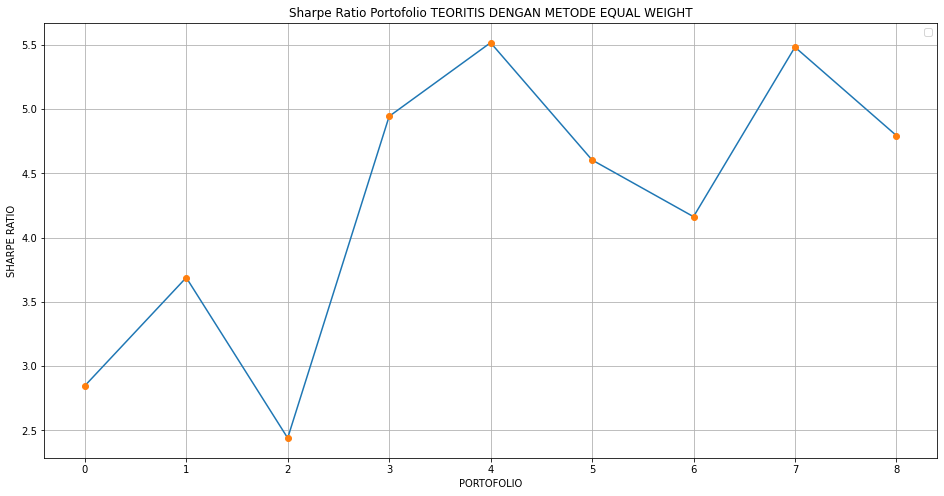

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Sharpe Ratio Portofolio TEORITIS DENGAN METODE EQUAL WEIGHT')
plt.plot(sharpe_ratio_Teoritis_EW,'-')
plt.plot(sharpe_ratio_Teoritis_EW,'o')
plt.xlabel('PORTOFOLIO')
plt.ylabel('SHARPE RATIO')
plt.grid()
plt.legend(loc='best')
plt.show()

##**PORTOFOLIO 1 EW**

In [ ]:
#Covariance
import math
BNGA_2019 = Data_Saham_2019['BNGA'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values

Risk_BNGA2019 = BNGA_2019[1]
Risk_BBCA2019 = BBCA_2019[1]

Korelasi = korelasi_Saham2019['BNGA'][4]
c11_EW = Risk_BNGA2019
c12_EW = Korelasi*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BBCA2019)
c21_EW = c12_EW
c22_EW = Risk_BBCA2019

C_P1_EW = np.array([[c11_EW,c12_EW],[c21_EW,c22_EW]])
print("Covariance P 2019 = \n", C_P1_EW)

Covariance P 2019 = 
 [[0.00100223 0.00015855]
 [0.00015855 0.00036425]]


In [ ]:
#BOBOT EQUAL WEIGHT
W_P1_EW = np.array([1/2 for i in range(2)])
W_P1_EW

array([0.5, 0.5])

In [ ]:
W_P1_EW_T = np.transpose(W_P1_EW)
Risk_P1_EW = W_P1_EW.dot(C_P1_EW).dot(W_P1_EW_T)
print("Risk Portofolio 1 EW 2019 = ", Risk_P1_EW)

Risk Portofolio 1 EW 2019 =  0.00042089527116731594


In [ ]:
#Ekspected Return Portofolio
ER_BNGA_2019 = BNGA_2019[0]
ER_BBCA_2019 = BBCA_2019[0]
M1_EW = np.array([ER_BNGA_2019, ER_BBCA_2019])
ER_P1_EW = np.dot(M1_EW,W_P1_EW_T)
print("Expected Return Portofolio 1 = ", ER_P1_EW)

Expected Return Portofolio 1 =  0.0012818734999999997


In [ ]:
Return_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values
Return_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values

Return_Portofolio_BNGA = Return_BNGA_2019 * W_P1_EW[0]
Return_Portofolio_BBCA = Return_BBCA_2019 * W_P1_EW[1]
KvP1_EW = Return_Portofolio_BNGA + Return_Portofolio_BBCA
print("Return Portofolio 1 uji = \n", KvP1_EW)
print("Rata-Rata Return Portofolio 1 uji = ", KvP1_EW.mean())

Return Portofolio 1 uji = 
 [-0.01101626  0.05135489 -0.00889453  0.01151691  0.03634199  0.0107319
 -0.01089861 -0.00598228 -0.02534377 -0.01315419 -0.01525499 -0.00945
  0.00748414 -0.01370071  0.01561616 -0.00167601 -0.01519547  0.0063567
 -0.04668958  0.02080804 -0.00088175  0.01300804  0.03916386  0.03756288
  0.00978723 -0.03362641  0.0308149   0.03569946 -0.0364579  -0.0316264
  0.02016026  0.00025604 -0.00207814 -0.02462824 -0.01171748  0.01007731
 -0.00568766  0.00373444 -0.0199005   0.01329908  0.0144995   0.00381934
 -0.00182207 -0.01355789 -0.00900392 -0.0083346   0.02270488 -0.00759779
  0.01056136  0.02099423  0.00448104  0.        ]
Rata-Rata Return Portofolio 1 uji =  0.0012818733269230763


##**PORTOFOLIO 2 EW**

In [ ]:
import math
BBCA_2019 = Data_Saham_2019['BBCA'].values
INKP_2019 = Data_Saham_2019['INKP'].values
BBKP_2019 = Data_Saham_2019['BBKP'].values


Korelasi12 = korelasi_Saham2019['BBCA'][15]
Korelasi13 = korelasi_Saham2019['BBCA'][5]
Korelasi23 = korelasi_Saham2019['INKP'][5]

Risk_BBCA_2019 = BBCA_2019[1]
Risk_INKP_2019 = INKP_2019[1]
Risk_BBKP_2019 = BBKP_2019[1]

cov_BBCA_2019_INKP_2019 = Korelasi12*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_INKP_2019)
cov_BBCA_2019_BBKP_2019 = Korelasi13*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BBKP_2019)
cov_INKP_2019_BBKP_2019 = Korelasi23*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BBKP_2019)

c11_P2_EW = Risk_BBCA_2019
c12_P2_EW = cov_BBCA_2019_INKP_2019
c13_P2_EW = cov_BBCA_2019_BBKP_2019

c21_P2_EW = cov_BBCA_2019_INKP_2019
c22_P2_EW = Risk_INKP_2019
c23_P2_EW = cov_INKP_2019_BBKP_2019

c31_P2_EW = cov_BBCA_2019_BBKP_2019
c32_P2_EW = cov_INKP_2019_BBKP_2019
c33_P2_EW = Risk_BBKP_2019


C_P2_EW = np.array([[c11_P2_EW,c12_P2_EW,c13_P2_EW],
                 [c21_P2_EW,c22_P2_EW,c23_P2_EW],
                 [c31_P2_EW,c32_P2_EW,c33_P2_EW]
                 ])
print("Covariance = \n", C_P2_EW)

Covariance = 
 [[0.00036425 0.00040227 0.0001226 ]
 [0.00040227 0.00667219 0.00195027]
 [0.0001226  0.00195027 0.0020039 ]]


In [ ]:
#BOBOT EQUAL WEIGHT
W_P2_EW = np.array([1/3 for i in range(3)])
W_P2_EW

array([0.33333333, 0.33333333, 0.33333333])

In [ ]:
W_P2_EW_T = np.transpose(W_P2_EW)
Risk_P2_EW = W_P2_EW.dot(C_P2_EW).dot(W_P2_EW_T)
print("Risk Portofolio 1 EW 2019 = ", Risk_P2_EW)

Risk Portofolio 1 EW 2019 =  0.0015545134536338783


In [ ]:
#Ekspected Return Portofolio
ER_BBCA_2019 = BBCA_2019[0]
ER_INKP_2019 = INKP_2019[0]
ER_BBKP_2019 = BBKP_2019[0]

M2_EW = np.array([ER_BBCA_2019, ER_INKP_2019, ER_BBKP_2019 ])
ER_P2_EW = np.dot(M2_EW,W_P2_EW_T )
print("Expected Return Portofolio 2 = ", ER_P2_EW)

Expected Return Portofolio 2 UJI =  -0.0012942196666666668


In [ ]:
Return_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
Return_INKP_2019 = Data_Return_Saham_2019['INKP'].values
Return_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values

Return_Portofolio_BBCA = Return_BBCA_2019 * W_P2_EW[0]
Return_Portofolio_INKP = Return_INKP_2019 * W_P2_EW[1]
Return_Portofolio_BBKP = Return_BBKP_2019 * W_P2_EW[2]


KvP2_EW = Return_Portofolio_BBCA + Return_Portofolio_INKP + Return_Portofolio_BBKP
print("Return Portofolio 2 = \n", KvP2_EW)
print(" Expected Return Portofolio 2 = \n", KvP2_EW.mean())


Return Portofolio 2 = 
 [ 6.47709750e-02  2.54957490e-02  6.03071883e-02 -2.67900563e-02
  2.17964173e-02 -2.44850477e-02  4.07753570e-02 -3.70856330e-02
 -5.10996140e-02  5.91760000e-05 -5.16774073e-02 -6.99554437e-02
 -5.22818567e-03 -1.60276070e-02 -1.02410820e-02  4.48148167e-03
 -4.65751167e-02 -5.26759377e-02 -3.84041767e-02  8.14076243e-02
  5.58860470e-02  1.03488683e-02 -1.78648200e-02  1.29372181e-01
  1.55396000e-04 -3.40995080e-02 -4.19806000e-04 -1.54034233e-03
 -5.24079290e-02 -4.34032677e-02  1.43355347e-02  3.52633350e-02
 -4.92681440e-02 -4.96170100e-03  2.87797340e-02 -2.50216407e-02
 -1.25231133e-03 -2.19036603e-02 -4.42670817e-02  3.82022957e-02
  5.23449373e-02  5.01939267e-03  3.09550770e-02 -1.09543017e-02
 -3.89987133e-03 -3.59257733e-02 -2.43464043e-02  3.58017570e-02
 -6.76874033e-03  2.65430333e-03  3.03835300e-03  0.00000000e+00]
 Expected Return Portofolio 2 = 
 -0.0012942198141025637


##**PORTOFOLIO 3 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P3_EW = np.array([1/4 for i in range(4)])
W_P3_EW

array([0.25, 0.25, 0.25, 0.25])

In [ ]:
import math
BTPN_2019 = Data_Saham_2019['BTPN'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values
BUMI_2019 = Data_Saham_2019['BUMI'].values
BBKP_2019 = Data_Saham_2019['BBKP'].values

Korelasi12 = korelasi_Saham2019['BTPN'][4]
Korelasi13 = korelasi_Saham2019['BTPN'][9]
Korelasi14 = korelasi_Saham2019['BTPN'][5]
Korelasi23 = korelasi_Saham2019['BBCA'][9]
Korelasi24 = korelasi_Saham2019['BBCA'][5]
Korelasi34 = korelasi_Saham2019['BUMI'][9]

Risk_BTPN_2019 = BTPN_2019[1]
Risk_BBCA_2019 = BBCA_2019[1]
Risk_BUMI_2019 = BUMI_2019[1]
Risk_BBKP_2019 = BBKP_2019[1]

cov_BTPN_2019_BBCA_2019 = Korelasi12*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BBCA_2019)
cov_BTPN_2019_BUMI_2019 = Korelasi13*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BUMI_2019)
cov_BTPN_2019_BBKP_2019 = Korelasi14*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BBKP_2019)
cov_BBCA_2019_BUMI_2019 = Korelasi23*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BUMI_2019)
cov_BBCA_2019_BBKP_2019 = Korelasi24*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BBKP_2019)
cov_BUMI_2019_BBKP_2019 = Korelasi34*math.sqrt(Risk_BUMI_2019)*math.sqrt(Risk_BBKP_2019)

c11_P3_EW = Risk_BTPN_2019
c12_P3_EW = cov_BTPN_2019_BBCA_2019
c13_P3_EW = cov_BTPN_2019_BUMI_2019
c14_P3_EW = cov_BTPN_2019_BBKP_2019

c21_P3_EW = cov_BTPN_2019_BBCA_2019
c22_P3_EW = Risk_BBCA_2019
c23_P3_EW = cov_BBCA_2019_BUMI_2019
c24_P3_EW = cov_BBCA_2019_BBKP_2019

c31_P3_EW = cov_BTPN_2019_BUMI_2019
c32_P3_EW = cov_BBCA_2019_BUMI_2019
c33_P3_EW = Risk_BUMI_2019
c34_P3_EW = cov_BUMI_2019_BBKP_2019

c41_P3_EW = cov_BTPN_2019_BBKP_2019
c42_P3_EW = cov_BBCA_2019_BBKP_2019
c43_P3_EW = cov_BUMI_2019_BBKP_2019
c44_P3_EW = Risk_BBKP_2019


C_P3_EW = np.array([[c11_P3_EW, c12_P3_EW, c13_P3_EW, c14_P3_EW],
                 [c21_P3_EW, c22_P3_EW, c23_P3_EW, c24_P3_EW],
                 [c31_P3_EW, c32_P3_EW, c33_P3_EW, c34_P3_EW],
                 [c41_P3_EW, c42_P3_EW, c43_P3_EW, c44_P3_EW],
                 ])
print("Covariance = \n", C_P3_EW)

Covariance = 
 [[5.79172000e-04 6.07934113e-05 2.60578174e-04 4.15622900e-04]
 [6.07934113e-05 3.64251000e-04 3.96801838e-04 1.22598741e-04]
 [2.60578174e-04 3.96801838e-04 4.44965700e-03 2.98607600e-03]
 [4.15622900e-04 1.22598741e-04 2.98607600e-03 2.00389600e-03]]


In [ ]:
#Risk Minimum Portofolio
W_P3_EW_T = np.transpose(W_P3_EW)
Risk_P3_EW = W_P3_EW.dot(C_P3_EW).dot(W_P3_EW_T)
print("Risk Portofolio = ", Risk_P3_EW)

Risk Portofolio =  0.0009926198828033566


In [ ]:
#Ekspected Return Portofolio
ER_BTPN_2019 = BTPN_2019[0]
ER_BBCA_2019 = BBCA_2019[0]
ER_BUMI_2019 = BUMI_2019[0]
ER_BBKP_2019 = BBKP_2019[0]

M3_EW = np.array([ER_BTPN_2019, ER_BBCA_2019, ER_BUMI_2019, ER_BBKP_2019])
ER_P3_EW = np.dot(M3_EW,W_P3_EW_T)
print("Ekspected Return Portofolio = ", ER_P3_EW)

Ekspected Return Portofolio =  -0.0032427295000000004


In [ ]:
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
R_BUMI_2019 = Data_Return_Saham_2019['BUMI'].values
R_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values

Return_Portofolio_BTPN_2019 = R_BTPN_2019 * W_P3_EW[0]
Return_Portofolio_BBCA_2019 = R_BBCA_2019 * W_P3_EW[1]
Return_Portofolio_BUMI_2019 = R_BUMI_2019 * W_P3_EW[2]
Return_Portofolio_BBKP_2019 = R_BBKP_2019 * W_P3_EW[3]


KvP3_EW = Return_Portofolio_BTPN_2019 + Return_Portofolio_BBCA_2019 + Return_Portofolio_BUMI_2019 + Return_Portofolio_BBKP_2019
print("Return Portofolio 3 = \n", KvP3_EW)

Return Portofolio 3 = 
 [ 0.04828823  0.07407343  0.01687986 -0.01568103  0.00067905 -0.00901578
  0.02916769 -0.01970916 -0.0453523  -0.00154854 -0.0185915  -0.0451722
 -0.02070837 -0.00018352  0.01674079  0.03659632 -0.04355308  0.00172002
 -0.04581962  0.02935259  0.01521324  0.01189853 -0.00683453  0.02371107
  0.00711545 -0.00467082  0.00013636 -0.01947193 -0.02817161 -0.03389182
 -0.00440679  0.00584063 -0.02503976 -0.00661529  0.01432508  0.00103352
 -0.0108418  -0.01471126 -0.0573466   0.03445685  0.00977758  0.05178639
 -0.05104916 -0.01509206 -0.00840821 -0.02730585 -0.01839719 -0.00215802
 -0.00472447  0.00536167  0.00169601  0.        ]


##**PORTOFOLIO 4 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P4_EW = np.array([1/5 for i in range(5)])
W_P4_EW

array([0.2, 0.2, 0.2, 0.2, 0.2])

In [ ]:
import math
AALI_2019 = Data_Saham_2019['AALI'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values
BTPN_2019 = Data_Saham_2019['BTPN'].values
INKP_2019 = Data_Saham_2019['INKP'].values
BNGA_2019 = Data_Saham_2019['BNGA'].values


Korelasi12 = korelasi_Saham['AALI'][4]
Korelasi13 = korelasi_Saham['AALI'][8]
Korelasi14 = korelasi_Saham['AALI'][15]
Korelasi15 = korelasi_Saham['AALI'][7]
Korelasi23 = korelasi_Saham['BBCA'][8]
Korelasi24 = korelasi_Saham['BBCA'][15]
Korelasi25 = korelasi_Saham['BBCA'][7]
Korelasi34 = korelasi_Saham['BTPN'][15]
Korelasi35 = korelasi_Saham['BTPN'][7]
Korelasi45 = korelasi_Saham['INKP'][7]

Risk_AALI_2019 = AALI_2019[1]
Risk_BBCA_2019 = BBCA_2019[1]
Risk_BTPN_2019 = BTPN_2019[1]
Risk_INKP_2019 = INKP_2019[1]
Risk_BNGA_2019 = BNGA_2019[1]

cov_AALI_2019_BBCA_2019 = Korelasi12*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_BBCA_2019)
cov_AALI_2019_BTPN_2019 = Korelasi13*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_BTPN_2019)
cov_AALI_2019_INKP_2019 = Korelasi14*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_INKP_2019)
cov_AALI_2019_BNGA_2019 = Korelasi15*math.sqrt(Risk_AALI_2019)*math.sqrt(Risk_BNGA_2019)
cov_BBCA_2019_BTPN_2019 = Korelasi23*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BTPN_2019)
cov_BBCA_2019_INKP_2019 = Korelasi24*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_INKP_2019)
cov_BBCA_2019_BNGA_2019 = Korelasi25*math.sqrt(Risk_BBCA_2019)*math.sqrt(Risk_BNGA_2019)
cov_BTPN_2019_INKP_2019 = Korelasi34*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_INKP_2019)
cov_BTPN_2019_BNGA_2019 = Korelasi35*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BNGA_2019)
cov_INKP_2019_BNGA_2019 = Korelasi45*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BNGA_2019)

c11_P4_EW = Risk_AALI_2019
c12_P4_EW = cov_AALI_2019_BBCA_2019
c13_P4_EW = cov_AALI_2019_BTPN_2019
c14_P4_EW = cov_AALI_2019_INKP_2019
c15_P4_EW = cov_AALI_2019_BNGA_2019

c21_P4_EW = cov_AALI_2019_BBCA_2019
c22_P4_EW = Risk_BBCA_2019
c23_P4_EW = cov_BBCA_2019_BTPN_2019
c24_P4_EW = cov_BBCA_2019_INKP_2019
c25_P4_EW = cov_BBCA_2019_BNGA_2019

c31_P4_EW = cov_AALI_2019_BTPN_2019
c32_P4_EW = cov_BBCA_2019_BTPN_2019
c33_P4_EW = Risk_BTPN_2019
c34_P4_EW = cov_BTPN_2019_INKP_2019
c35_P4_EW = cov_BTPN_2019_BNGA_2019

c41_P4_EW = cov_AALI_2019_INKP_2019 
c42_P4_EW = cov_BBCA_2019_INKP_2019 
c43_P4_EW = cov_BTPN_2019_INKP_2019 
c44_P4_EW = Risk_INKP_2019
c45_P4_EW = cov_INKP_2019_BNGA_2019 

c51_P4_EW = cov_AALI_2019_BNGA_2019
c52_P4_EW = cov_BBCA_2019_BNGA_2019
c53_P4_EW = cov_BTPN_2019_BNGA_2019
c54_P4_EW = cov_INKP_2019_BNGA_2019
c55_P4_EW = Risk_BNGA_2019


C_P4_EW = np.array([[c11_P4_EW, c12_P4_EW, c13_P4_EW, c14_P4_EW, c15_P4_EW],
                 [c21_P4_EW, c22_P4_EW, c23_P4_EW, c24_P4_EW, c25_P4_EW],
                 [c31_P4_EW, c32_P4_EW, c33_P4_EW, c34_P4_EW, c35_P4_EW],
                 [c41_P4_EW, c42_P4_EW, c43_P4_EW, c44_P4_EW, c45_P4_EW],
                 [c51_P4_EW, c52_P4_EW, c53_P4_EW, c54_P4_EW, c55_P4_EW],
                 ])
print("Covariance = \n", C_P4_EW)

Covariance = 
 [[1.78893000e-03 8.04763461e-07 1.52462824e-04 7.98981469e-04
  3.80048976e-04]
 [8.04763461e-07 3.64251000e-04 1.53366658e-04 9.41574360e-04
  2.91961808e-04]
 [1.52462824e-04 1.53366658e-04 5.79172000e-04 4.67628538e-04
  1.44083866e-04]
 [7.98981469e-04 9.41574360e-04 4.67628538e-04 6.67219400e-03
  5.34826987e-04]
 [3.80048976e-04 2.91961808e-04 1.44083866e-04 5.34826987e-04
  1.00223300e-03]]


In [ ]:
#Risk Minimum Data_Saham_2019
W_P4_EW_T = np.transpose(W_P4_EW)
Risk_P4_EW = W_P4_EW.dot(C_P4_EW).dot(W_P4_EW_T)
print("Risk PORTOFOLIO 4 UJI = ", Risk_P4_EW)

#Ekspected Return Data_Saham_2019
ER_AALI_2019 = AALI_2019[0]
ER_BBCA_2019 = BBCA_2019[0]
ER_BTPN_2019 = BTPN_2019[0]
ER_INKP_2019 = INKP_2019[0]
ER_BNGA_2019 = BNGA_2019[0]

M4_EW = np.array([ER_AALI_2019,ER_BBCA_2019, ER_BTPN_2019,  ER_INKP_2019, ER_BNGA_2019])
ER_P4_EW = np.dot(M4_EW,W_P4_EW_T)
print("Ekspected Return Data_Saham_2019 4 = ", ER_P4_EW)

Risk PORTOFOLIO 4 UJI =  0.0007255304199209676
Ekspected Return Data_Saham_2019 4 =  0.00024080839999999977


In [ ]:
R_AALI_2019 = Data_Return_Saham_2019['AALI'].values
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_INKP_2019 = Data_Return_Saham_2019['INKP'].values
R_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values


Return_Data_Saham_2019_AALI_2019 = R_AALI_2019 * W_P4_EW_T[0]
Return_Data_Saham_2019_BBCA_2019 = R_BBCA_2019 * W_P4_EW_T[1]
Return_Data_Saham_2019_BTPN_2019 = R_BTPN_2019 * W_P4_EW_T[2]
Return_Data_Saham_2019_INKP_2019 = R_INKP_2019 * W_P4_EW_T[3]
Return_Data_Saham_2019_BNGA_2019 = R_BNGA_2019 * W_P4_EW_T[4]


KvP4_EW = Return_Data_Saham_2019_AALI_2019 + Return_Data_Saham_2019_BBCA_2019 + Return_Data_Saham_2019_BTPN_2019 + Return_Data_Saham_2019_INKP_2019 + Return_Data_Saham_2019_BNGA_2019
print("Return Data_Saham_2019 4 = \n", KvP4_EW)
print("Rata-Rata Return Data_Saham_2019", KvP4_EW.mean())

Return Data_Saham_2019 4 = 
 [ 0.03162065  0.01582873  0.0493628  -0.01688838  0.01637705 -0.01203356
 -0.00585227 -0.02959571 -0.03082941 -0.01133959 -0.03319323 -0.03305335
  0.01798948 -0.00819818 -0.02072511 -0.00823887 -0.01974514 -0.03067062
 -0.03671253  0.04786882  0.03303153  0.00241797 -0.00375511  0.07524141
  0.01517759 -0.0431975  -0.00212452 -0.00235192 -0.03335244 -0.03752576
  0.03011329  0.02851359 -0.02170079 -0.01700095  0.00356957  0.00370922
 -0.00390005 -0.01165721 -0.03001569  0.01584622  0.02016647  0.02581049
  0.03040362  0.01609165 -0.01219437 -0.00842173  0.0029393   0.02769077
 -0.00122232  0.01771188  0.01053625  0.        ]
Rata-Rata Return Data_Saham_2019 0.0002408082615384616


##**PORTOFOLIO 5 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P5_EW = np.array([1/6 for i in range(6)])
W_P5_EW

array([0.16666667, 0.16666667, 0.16666667, 0.16666667, 0.16666667,
       0.16666667])

In [ ]:
import math
BNGA_2019 = Data_Saham_2019['BNGA'].values
JSMR_2019 = Data_Saham_2019['JSMR'].values
INKP_2019 = Data_Saham_2019['INKP'].values
BBKP_2019 = Data_Saham_2019['BBKP'].values
BTPN_2019 = Data_Saham_2019['BTPN'].values
BBCA_2019 = Data_Saham_2019['BBCA'].values

Korelasi12 = korelasi_Saham['BNGA'][16]
Korelasi13 = korelasi_Saham['BNGA'][15]
Korelasi14 = korelasi_Saham['BNGA'][5]
Korelasi15 = korelasi_Saham['BNGA'][8]
Korelasi16 = korelasi_Saham['BNGA'][4]
Korelasi23 = korelasi_Saham['JSMR'][15]
Korelasi24 = korelasi_Saham['JSMR'][5]
Korelasi25 = korelasi_Saham['JSMR'][8]
Korelasi26 = korelasi_Saham['JSMR'][4]
Korelasi34 = korelasi_Saham['INKP'][5]
Korelasi35 = korelasi_Saham['INKP'][8]
Korelasi36 = korelasi_Saham['INKP'][4]
Korelasi45 = korelasi_Saham['BBKP'][8]
Korelasi46 = korelasi_Saham['BBKP'][4]
Korelasi56 = korelasi_Saham['BTPN'][4]

Risk_BNGA_2019 = BNGA_2019[1]
Risk_JSMR_2019 = JSMR_2019[1]
Risk_INKP_2019 = INKP_2019[1]
Risk_BBKP_2019 = BBKP_2019[1]
Risk_BTPN_2019 = BTPN_2019[1]
Risk_BBCA_2019 = BBCA_2019[1]

cov_BNGA_2019_JSMR_2019 = Korelasi12*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_JSMR_2019)
cov_BNGA_2019_INKP_2019 = Korelasi13*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_INKP_2019)
cov_BNGA_2019_BBKP_2019 = Korelasi14*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_BBKP_2019)
cov_BNGA_2019_BTPN_2019 = Korelasi15*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_BTPN_2019)
cov_BNGA_2019_BBCA_2019 = Korelasi16*math.sqrt(Risk_BNGA_2019)*math.sqrt(Risk_BBCA_2019)
cov_JSMR_2019_INKP_2019 = Korelasi23*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_INKP_2019)
cov_JSMR_2019_BBKP_2019 = Korelasi24*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_BBKP_2019)
cov_JSMR_2019_BTPN_2019 = Korelasi25*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_BTPN_2019)
cov_JSMR_2019_BBCA_2019 = Korelasi26*math.sqrt(Risk_JSMR_2019)*math.sqrt(Risk_BBCA_2019)
cov_INKP_2019_BBKP_2019 = Korelasi34*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BBKP_2019)
cov_INKP_2019_BTPN_2019 = Korelasi35*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BTPN_2019)
cov_INKP_2019_BBCA_2019 = Korelasi36*math.sqrt(Risk_INKP_2019)*math.sqrt(Risk_BBCA_2019)
cov_BBKP_2019_BTPN_2019 = Korelasi45*math.sqrt(Risk_BBKP_2019)*math.sqrt(Risk_BTPN_2019)
cov_BBKP_2019_BBCA_2019 = Korelasi46*math.sqrt(Risk_BBKP_2019)*math.sqrt(Risk_BBCA_2019)
cov_BTPN_2019_BBCA_2019 = Korelasi56*math.sqrt(Risk_BTPN_2019)*math.sqrt(Risk_BBCA_2019)

c11_P5_EW = Risk_BNGA_2019
c12_P5_EW = cov_BNGA_2019_JSMR_2019
c13_P5_EW = cov_BNGA_2019_INKP_2019
c14_P5_EW = cov_BNGA_2019_BBKP_2019
c15_P5_EW = cov_BNGA_2019_BTPN_2019
c16_P5_EW = cov_BNGA_2019_BBCA_2019

c21_P5_EW = cov_BNGA_2019_JSMR_2019
c22_P5_EW = Risk_JSMR_2019
c23_P5_EW = cov_JSMR_2019_INKP_2019
c24_P5_EW = cov_JSMR_2019_BBKP_2019
c25_P5_EW = cov_JSMR_2019_BTPN_2019
c26_P5_EW = cov_JSMR_2019_BBCA_2019

c31_P5_EW = cov_BNGA_2019_INKP_2019
c32_P5_EW = cov_JSMR_2019_INKP_2019
c33_P5_EW = Risk_INKP_2019
c34_P5_EW = cov_INKP_2019_BBKP_2019
c35_P5_EW = cov_INKP_2019_BTPN_2019
c36_P5_EW = cov_INKP_2019_BBCA_2019

c41_P5_EW = cov_BNGA_2019_BBKP_2019
c42_P5_EW = cov_JSMR_2019_BBKP_2019
c43_P5_EW = cov_INKP_2019_BBKP_2019
c44_P5_EW = Risk_BBKP_2019
c45_P5_EW = cov_BBKP_2019_BTPN_2019
c46_P5_EW = cov_BBKP_2019_BBCA_2019

c51_P5_EW = cov_BNGA_2019_BTPN_2019
c52_P5_EW = cov_JSMR_2019_BTPN_2019
c53_P5_EW = cov_INKP_2019_BTPN_2019
c54_P5_EW = cov_BBKP_2019_BTPN_2019
c55_P5_EW = Risk_BTPN_2019
c56_P5_EW = cov_BTPN_2019_BBCA_2019

c61_P5_EW = cov_BNGA_2019_BBCA_2019
c62_P5_EW = cov_JSMR_2019_BBCA_2019
c63_P5_EW = cov_INKP_2019_BBCA_2019
c64_P5_EW = cov_BBKP_2019_BBCA_2019
c65_P5_EW = cov_BTPN_2019_BBCA_2019
c66_P5_EW = Risk_BBCA_2019


C_P5_EW = np.array([[c11_P5_EW, c12_P5_EW, c13_P5_EW, c14_P5_EW, c15_P5_EW, c16_P5_EW],
                 [c21_P5_EW, c22_P5_EW, c23_P5_EW, c24_P5_EW, c25_P5_EW, c26_P5_EW],
                 [c31_P5_EW, c32_P5_EW, c33_P5_EW, c34_P5_EW, c35_P5_EW, c36_P5_EW],
                 [c41_P5_EW, c42_P5_EW, c43_P5_EW, c44_P5_EW, c45_P5_EW, c46_P5_EW],
                 [c51_P5_EW, c52_P5_EW, c53_P5_EW, c54_P5_EW, c55_P5_EW, c56_P5_EW],
				 [c61_P5_EW, c62_P5_EW, c63_P5_EW, c64_P5_EW, c65_P5_EW, c66_P5_EW],
                 ])
print("Covariance = \n", C_P5_EW)

Covariance = 
 [[1.00223300e-03 1.46424859e-03 9.11809007e-04 3.40925453e-04
  1.99212935e-04 9.08855821e-05]
 [1.46424859e-03 2.13924700e-03 1.57296372e-03 6.81052348e-04
  4.28858851e-04 5.99605830e-05]
 [9.11809007e-04 1.57296372e-03 6.67219400e-03 6.15468811e-04
  6.13632812e-04 1.53892330e-04]
 [3.40925453e-04 6.81052348e-04 6.15468811e-04 2.00389600e-03
  3.01973556e-04 1.74567406e-04]
 [1.99212935e-04 4.28858851e-04 6.13632812e-04 3.01973556e-04
  5.79172000e-04 3.41925906e-05]
 [9.08855821e-05 5.99605830e-05 1.53892330e-04 1.74567406e-04
  3.41925906e-05 3.64251000e-04]]


In [ ]:
#Risk Minimum Portofolio
W_P5_EW_T = np.transpose(W_P5_EW)
Risk_P5_EW = W_P5_EW.dot(C_P5_EW).dot(W_P5_EW_T )
print("Risk Portofolio = ", Risk_P5_EW)

#Ekspected Return Portofolio
ER_BNGA_2019 = BNGA_2019[0]
ER_JSMR_2019 = JSMR_2019[0]
ER_INKP_2019 = INKP_2019[0]
ER_BBKP_2019 = BBKP_2019[0]
ER_BTPN_2019 = BTPN_2019[0]
ER_BBCA_2019 = BBCA_2019[0]

M5_EW = np.array([ER_BNGA_2019,ER_JSMR_2019, ER_INKP_2019,  ER_BBKP_2019, ER_BNGA_2019,ER_BBCA_2019])
ER_P5_EW = np.dot(M5_EW,W_P5_EW_T )
print("Ekspected Return Portofolio 4 = ", ER_P5_EW)

Risk Portofolio =  0.0007791189484705924
Ekspected Return Portofolio 4 =  -0.0010037123333333333


In [ ]:
R_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values
R_JSMR_2019 = Data_Return_Saham_2019['JSMR'].values
R_INKP_2019 = Data_Return_Saham_2019['INKP'].values
R_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values

Return_Portofolio_BNGA_2019 = R_BNGA_2019 * W_P5_EW[0]
Return_Portofolio_JSMR_2019 = R_JSMR_2019 * W_P5_EW[1]
Return_Portofolio_INKP_2019 = R_INKP_2019 * W_P5_EW[2]
Return_Portofolio_BBKP_2019 = R_BBKP_2019 * W_P5_EW[3]
Return_Portofolio_BTPN_2019 = R_BTPN_2019 * W_P5_EW[4]
Return_Portofolio_BBCA_2019 = R_BBCA_2019 * W_P5_EW[5]


KvP5_EW = Return_Portofolio_BNGA_2019 + Return_Portofolio_JSMR_2019 + Return_Portofolio_INKP_2019 + Return_Portofolio_BBKP_2019 + Return_Portofolio_BTPN_2019 + Return_Portofolio_BBCA_2019
print("Return Portofolio 4 = \n", KvP5_EW)

Return Portofolio 4 = 
 [ 0.03615556  0.02086991  0.0343622  -0.01107945  0.03196245 -0.01123792
  0.01024152 -0.01017297 -0.0416387   0.00037903 -0.03087158 -0.01520136
  0.0037613  -0.00827277 -0.00808398  0.00867071 -0.04352606 -0.03252356
 -0.03571829  0.05537524  0.02552787  0.0059757   0.0044231   0.07958275
  0.00196645 -0.03579112  0.00995617  0.00264809 -0.04681386 -0.03537293
  0.01969475  0.02761237 -0.02754962 -0.0241783   0.00900523 -0.00190572
 -0.00432957 -0.00847367 -0.03835768  0.02444807  0.02585172  0.01730097
 -0.00568597 -0.01658844 -0.00477069 -0.02582469 -0.0010013   0.01553498
  0.00771246  0.00862638 -0.00633957  0.        ]


##**PORTOFOLIO 6 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P6_EW = np.array([1/7 for i in range(7)])
W_P6_EW

array([0.14285714, 0.14285714, 0.14285714, 0.14285714, 0.14285714,
       0.14285714, 0.14285714])

In [ ]:
import math
BBCA2019 = Data_Saham_2019['BBCA'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
INKP2019 = Data_Saham_2019['INKP'].values
BBKP2019 = Data_Saham_2019['BBKP'].values
BTPN2019 = Data_Saham_2019['BTPN'].values
INDY2019 = Data_Saham_2019['INDY'].values
JSMR2019 = Data_Saham_2019['JSMR'].values

Korelasi12 = korelasi_Saham2019['BBCA'][7]
Korelasi13 = korelasi_Saham2019['BBCA'][15]
Korelasi14 = korelasi_Saham2019['BBCA'][5]
Korelasi15 = korelasi_Saham2019['BBCA'][8]
Korelasi16 = korelasi_Saham2019['BBCA'][14]
Korelasi17 = korelasi_Saham2019['BBCA'][17]

Korelasi23 = korelasi_Saham2019['BNGA'][15]
Korelasi24 = korelasi_Saham2019['BNGA'][5]
Korelasi25 = korelasi_Saham2019['BNGA'][8]
Korelasi26 = korelasi_Saham2019['BNGA'][14]
Korelasi27 = korelasi_Saham2019['BNGA'][17]

Korelasi34 = korelasi_Saham2019['INKP'][5]
Korelasi35 = korelasi_Saham2019['INKP'][8]
Korelasi36 = korelasi_Saham2019['INKP'][14]
Korelasi37 = korelasi_Saham2019['INKP'][17]

Korelasi45 = korelasi_Saham2019['BBKP'][8]
Korelasi46 = korelasi_Saham2019['BBKP'][14]
Korelasi47 = korelasi_Saham2019['BBKP'][17]

Korelasi56 = korelasi_Saham2019['BTPN'][14]
Korelasi57 = korelasi_Saham2019['BTPN'][17]

Korelasi67 = korelasi_Saham2019['INDY'][17]

Risk_BBCA2019 = BBCA2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_BBKP2019 = BBKP2019[1]
Risk_BTPN2019 = BTPN2019[1]
Risk_INDY2019 = INDY2019[1]
Risk_JSMR2019 = JSMR2019[1]

cov_BBCA2019_BNGA2019 = Korelasi12*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BBCA2019)
cov_BBCA2019_INKP2019 = Korelasi13*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_BBKP2019 = Korelasi14*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BBKP2019)
cov_BBCA2019_BTPN2019 = Korelasi15*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BTPN2019)
cov_BBCA2019_INDY2019 = Korelasi16*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INDY2019)
cov_BBCA2019_JSMR2019 = Korelasi17*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_JSMR2019)
cov_BNGA2019_INKP2019 = Korelasi23*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INKP2019)
cov_BNGA2019_BBKP2019 = Korelasi24*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BBKP2019)
cov_BNGA2019_BTPN2019 = Korelasi25*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BTPN2019)
cov_BNGA2019_INDY2019 = Korelasi26*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INDY2019)
cov_BNGA2019_JSMR2019 = Korelasi27*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_JSMR2019)
cov_INKP2019_BBKP2019 = Korelasi34*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BBKP2019)
cov_INKP2019_BTPN2019 = Korelasi35*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BTPN2019)
cov_INKP2019_INDY2019 = Korelasi36*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_INDY2019)
cov_INKP2019_JSMR2019 = Korelasi37*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_JSMR2019)
cov_BBKP2019_BTPN2019 = Korelasi45*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_BTPN2019)
cov_BBKP2019_INDY2019 = Korelasi46*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_INDY2019)
cov_BBKP2019_JSMR2019 = Korelasi47*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_JSMR2019)
cov_BTPN2019_INDY2019 = Korelasi56*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_INDY2019)
cov_BTPN2019_JSMR2019 = Korelasi57*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_JSMR2019)
cov_INDY2019_JSMR2019 = Korelasi67*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_JSMR2019)

c11_P6_EW =  Risk_BBCA2019
c12_P6_EW = cov_BBCA2019_BNGA2019 
c13_P6_EW = cov_BBCA2019_INKP2019 
c14_P6_EW = cov_BBCA2019_INKP2019 
c15_P6_EW = cov_BBCA2019_BTPN2019 
c16_P6_EW = cov_BBCA2019_INDY2019 
c17_P6_EW = cov_BBCA2019_JSMR2019 

c21_P6_EW = cov_BBCA2019_INKP2019 
c22_P6_EW =  Risk_BNGA2019 
c23_P6_EW = cov_BNGA2019_INKP2019 
c24_P6_EW = cov_BNGA2019_INKP2019 
c25_P6_EW = cov_BNGA2019_BTPN2019 
c26_P6_EW = cov_BNGA2019_INDY2019 
c27_P6_EW = cov_BNGA2019_JSMR2019 

c31_P6_EW = cov_BBCA2019_INKP2019 
c32_P6_EW = cov_BNGA2019_INKP2019 
c33_P6_EW =  Risk_INKP2019
c34_P6_EW = cov_INKP2019_BBKP2019 
c35_P6_EW = cov_INKP2019_BTPN2019 
c36_P6_EW = cov_INKP2019_INDY2019 
c37_P6_EW = cov_INKP2019_JSMR2019 

c41_P6_EW = cov_BBCA2019_BBKP2019 
c42_P6_EW = cov_BNGA2019_BBKP2019 
c43_P6_EW = cov_INKP2019_BBKP2019 
c44_P6_EW =  Risk_BBKP2019 
c45_P6_EW = cov_BBKP2019_BTPN2019 
c46_P6_EW = cov_BBKP2019_INDY2019 
c47_P6_EW = cov_BBKP2019_JSMR2019 

c51_P6_EW = cov_BBCA2019_BTPN2019 
c52_P6_EW = cov_BNGA2019_BTPN2019 
c53_P6_EW = cov_INKP2019_BTPN2019 
c54_P6_EW = cov_BBKP2019_BTPN2019 
c55_P6_EW =  Risk_BTPN2019 
c56_P6_EW = cov_BTPN2019_INDY2019 
c57_P6_EW = cov_BTPN2019_JSMR2019 

c61_P6_EW = cov_BBCA2019_INDY2019 
c62_P6_EW = cov_BNGA2019_INDY2019 
c63_P6_EW = cov_INKP2019_INDY2019 
c64_P6_EW = cov_INKP2019_INDY2019 
c65_P6_EW = cov_BTPN2019_INDY2019 
c66_P6_EW =  Risk_INDY2019 
c67_P6_EW = cov_INDY2019_JSMR2019 

c71_P6_EW = cov_BBCA2019_JSMR2019 
c72_P6_EW = cov_BNGA2019_JSMR2019 
c73_P6_EW = cov_INKP2019_JSMR2019 
c74_P6_EW = cov_BBKP2019_JSMR2019 
c75_P6_EW = cov_BBKP2019_JSMR2019 
c76_P6_EW = cov_INDY2019_JSMR2019 
c77_P6_EW =  Risk_JSMR2019  

C_P6_EW = np.array([
[c11_P6_EW, c12_P6_EW,c13_P6_EW,c14_P6_EW,c15_P6_EW,c16_P6_EW,c17_P6_EW],
[c21_P6_EW,c22_P6_EW, c23_P6_EW,c24_P6_EW,c25_P6_EW,c26_P6_EW,c27_P6_EW],
[c31_P6_EW,c32_P6_EW,c33_P6_EW,c34_P6_EW,c35_P6_EW,c36_P6_EW,c37_P6_EW],
[c41_P6_EW,c42_P6_EW,c43_P6_EW,c44_P6_EW, c45_P6_EW,c46_P6_EW,c47_P6_EW],
[c51_P6_EW,c52_P6_EW,c53_P6_EW,c54_P6_EW,c55_P6_EW, c56_P6_EW,c57_P6_EW],
[c61_P6_EW,c62_P6_EW,c63_P6_EW,c64_P6_EW,c65_P6_EW,c66_P6_EW, c67_P6_EW],
[c71_P6_EW,c72_P6_EW,c73_P6_EW,c74_P6_EW,c75_P6_EW,c76_P6_EW,c77_P6_EW ] ])

print("Covariance P6_EW = \n", C_P6_EW)

Covariance P6_EW = 
 [[ 3.64251000e-04  9.55824769e-05  4.02272764e-04  4.02272764e-04
   6.07934113e-05  5.86814530e-04  3.80445149e-04]
 [ 4.02272764e-04  1.00223300e-03  4.96947585e-04  4.96947585e-04
   1.42210158e-05 -9.71876093e-05  3.09939413e-04]
 [ 4.02272764e-04  4.96947585e-04  6.67219400e-03  1.95026854e-03
   5.73994265e-04  2.17617900e-03  1.38715024e-03]
 [ 1.22598741e-04  4.54776721e-04  1.95026854e-03  2.00389600e-03
   4.15622900e-04  1.12770076e-03  2.06206200e-04]
 [ 6.07934113e-05  1.42210158e-05  5.73994265e-04  4.15622900e-04
   5.79172000e-04  3.80906765e-04  3.76307820e-04]
 [ 5.86814530e-04 -9.71876093e-05  2.17617900e-03  2.17617900e-03
   3.80906765e-04  7.08381000e-03  2.67774794e-04]
 [ 3.80445149e-04  3.09939413e-04  1.38715024e-03  2.06206200e-04
   2.06206200e-04  2.67774794e-04  2.13924700e-03]]


In [ ]:
#Risk Minimum Portofolio
W_P6_EW_T = np.transpose(W_P6_EW)
Risk_P6_EW = W_P6_EW.dot(C_P6_EW).dot(W_P6_EW_T)
print("Risk Portofolio = ", Risk_P6_EW)

#Ekspected Return Portofolio
ER_BBCA2019 = BBCA2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_INKP2019 = INKP2019[0]
ER_BBKP2019 = BBKP2019[0]
ER_BTPN2019 = BTPN2019[0]
ER_INDY2019 = INDY2019[0]
ER_JSMR2019 = JSMR2019[0]

M6_EW = np.array([ER_BBCA2019, ER_BNGA2019, ER_INKP2019,  ER_BBKP2019, ER_BTPN2019, ER_INDY2019, ER_JSMR2019])
ER_P6_EW = np.dot(M6_EW,W_P6_EW_T)
print("Ekspected Return Portofolio 4 = ", ER_P6_EW)

Risk Portofolio =  0.0009128641985333751
Ekspected Return Portofolio 4 =  -0.0015962547142857142


In [ ]:
R_BBCA_2019 = Data_Return_Saham_2019['BBCA'].values
R_BNGA_2019 = Data_Return_Saham_2019['BNGA'].values
R_INKP_2019 = Data_Return_Saham_2019['INKP'].values
R_BBKP_2019 = Data_Return_Saham_2019['BBKP'].values
R_BTPN_2019 = Data_Return_Saham_2019['BTPN'].values
R_INDY_2019 = Data_Return_Saham_2019['INDY'].values
R_JSMR_2019 = Data_Return_Saham_2019['JSMR'].values

Return_Portofolio_BBCA_2019 = R_BBCA_2019 * W_P6_EW[0]
Return_Portofolio_BNGA_2019 = R_BNGA_2019 * W_P6_EW[1]
Return_Portofolio_INKP_2019 = R_INKP_2019 * W_P6_EW[2]
Return_Portofolio_BBKP_2019 = R_BBKP_2019 * W_P6_EW[3]
Return_Portofolio_BTPN_2019 = R_BTPN_2019 * W_P6_EW[4]
Return_Portofolio_INDY_2019 = R_INDY_2019 * W_P6_EW[5]
Return_Portofolio_JSMR_2019 = R_JSMR_2019 * W_P6_EW[6]

KvP6_EW = Return_Portofolio_BBCA_2019 + Return_Portofolio_BNGA_2019 + Return_Portofolio_INKP_2019 + Return_Portofolio_BBKP_2019 + Return_Portofolio_BTPN_2019 + Return_Portofolio_JSMR_2019 +  Return_Portofolio_INDY_2019  
print("Return Portofolio 4 = \n", KvP6_EW)
print("Rata-Rata Return Portofolio", KvP6_EW.mean())

Return Portofolio 4 = 
 [ 0.02915898  0.03310185  0.03481884 -0.01337515  0.01443957 -0.02205487
  0.03238789 -0.00528562 -0.03770239 -0.00171594 -0.03681332 -0.02233034
 -0.0015512  -0.00873771 -0.01317652  0.01309405 -0.03940273 -0.04573448
 -0.0544252   0.07836828  0.01421085  0.00410886 -0.0002904   0.06558774
  0.04930458 -0.03348709 -0.00251812  0.00182614 -0.04813685 -0.03833474
  0.01038771  0.02576089 -0.02928699 -0.0201872   0.02644536 -0.00399866
 -0.01381207 -0.01399192 -0.03559393  0.02040178  0.03272004  0.01431181
 -0.0152633  -0.00693575 -0.0088866  -0.02599646 -0.01899884  0.0172118
  0.02114924  0.00739404 -0.01117115  0.        ]
Rata-Rata Return Portofolio -0.0015962548901098904


##**PORTOFOLIO 7 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P7_EW = np.array([1/8 for i in range(8)])
W_P7_EW

array([0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125])

In [ ]:
BBCA2019 = Data_Saham_2019['BBCA'].values
ANTM2019 = Data_Saham_2019['ANTM'].values
INKP2019 = Data_Saham_2019['INKP'].values
LPKR2019 = Data_Saham_2019['LPKR'].values
KLBF2019 = Data_Saham_2019['KLBF'].values
JSMR2019 = Data_Saham_2019['JSMR'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
LPPF2019 = Data_Saham_2019['LPPF'].values

Risk_BBCA2019 = BBCA2019[1]
Risk_ANTM2019 = ANTM2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_LPKR2019 = LPKR2019[1]
Risk_KLBF2019 = KLBF2019[1]
Risk_JSMR2019 = JSMR2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_LPPF2019 = LPPF2019[1]

Korelasi12 = korelasi_Saham2019['BBCA'][2]
Korelasi13 = korelasi_Saham2019['BBCA'][15]
Korelasi14 = korelasi_Saham2019['BBCA'][18]
Korelasi15 = korelasi_Saham2019['BBCA'][17]
Korelasi16 = korelasi_Saham2019['BBCA'][16]
Korelasi17 = korelasi_Saham2019['BBCA'][7]
Korelasi18 = korelasi_Saham2019['BBCA'][19]

Korelasi23 = korelasi_Saham2019['ANTM'][15]
Korelasi24 = korelasi_Saham2019['ANTM'][18]
Korelasi25 = korelasi_Saham2019['ANTM'][17]
Korelasi26 = korelasi_Saham2019['ANTM'][16]
Korelasi27 = korelasi_Saham2019['ANTM'][7]
Korelasi28 = korelasi_Saham2019['ANTM'][19]

Korelasi34 = korelasi_Saham2019['INKP'][18]
Korelasi35 = korelasi_Saham2019['INKP'][17]
Korelasi36 = korelasi_Saham2019['INKP'][16]
Korelasi37 = korelasi_Saham2019['INKP'][7]
Korelasi38 = korelasi_Saham2019['INKP'][19]

Korelasi45 = korelasi_Saham2019['LPKR'][17]
Korelasi46 = korelasi_Saham2019['LPKR'][16]
Korelasi47 = korelasi_Saham2019['LPKR'][7]
Korelasi48 = korelasi_Saham2019['LPKR'][19]

Korelasi56 = korelasi_Saham2019['KLBF'][16]
Korelasi57 = korelasi_Saham2019['KLBF'][7]
Korelasi58 = korelasi_Saham2019['KLBF'][19]

Korelasi67 = korelasi_Saham2019['JSMR'][7]
Korelasi68 = korelasi_Saham2019['JSMR'][19]

Korelasi78 = korelasi_Saham2019['BNGA'][19]

cov_BBCA2019_ANTM2019 = Korelasi12*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_ANTM2019)
cov_BBCA2019_INKP2019 = Korelasi13*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_LPKR2019 = Korelasi14*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPKR2019)
cov_BBCA2019_KLBF2019 = Korelasi15*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_KLBF2019)
cov_BBCA2019_JSMR2019 = Korelasi16*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_JSMR2019)
cov_BBCA2019_BNGA2019 = Korelasi17*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BNGA2019)
cov_BBCA2019_LPPF2019 = Korelasi18*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPPF2019)

cov_ANTM2019_INKP2019 = Korelasi23*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_INKP2019)
cov_ANTM2019_LPKR2019 = Korelasi24*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_LPKR2019)
cov_ANTM2019_KLBF2019 = Korelasi25*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_KLBF2019)
cov_ANTM2019_JSMR2019 = Korelasi26*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_JSMR2019)
cov_ANTM2019_BNGA2019 = Korelasi27*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_BNGA2019)
cov_ANTM2019_LPPF2019 = Korelasi28*math.sqrt(Risk_ANTM2019)*math.sqrt(Risk_LPPF2019)

cov_INKP2019_LPKR2019 = Korelasi34*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPKR2019)
cov_INKP2019_KLBF2019 = Korelasi35*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_KLBF2019)
cov_INKP2019_JSMR2019 = Korelasi36*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_JSMR2019)
cov_INKP2019_BNGA2019 = Korelasi37*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BNGA2019)
cov_INKP2019_LPPF2019 = Korelasi38*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPPF2019)

cov_LPKR2019_KLBF2019 = Korelasi45*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_KLBF2019)
cov_LPKR2019_JSMR2019 = Korelasi46*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_JSMR2019)
cov_LPKR2019_BNGA2019 = Korelasi47*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_BNGA2019)
cov_LPKR2019_LPPF2019 = Korelasi48*math.sqrt(Risk_LPKR2019)*math.sqrt(Risk_LPPF2019)

cov_KLBF2019_JSMR2019 = Korelasi56*math.sqrt(Risk_KLBF2019)*math.sqrt(Risk_JSMR2019)
cov_KLBF2019_BNGA2019 = Korelasi57*math.sqrt(Risk_KLBF2019)*math.sqrt(Risk_BNGA2019)
cov_KLBF2019_LPPF2019 = Korelasi58*math.sqrt(Risk_KLBF2019)*math.sqrt(Risk_LPPF2019)

cov_JSMR2019_BNGA2019 = Korelasi67*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BNGA2019)
cov_JSMR2019_LPPF2019 = Korelasi68*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_LPPF2019)

cov_BNGA2019_LPPF2019 = Korelasi78*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_LPPF2019)

c11_P7_EW = Risk_BBCA2019
c12_P7_EW = cov_BBCA2019_ANTM2019
c13_P7_EW = cov_BBCA2019_INKP2019
c14_P7_EW = cov_BBCA2019_LPKR2019
c15_P7_EW = cov_BBCA2019_KLBF2019
c16_P7_EW = cov_BBCA2019_JSMR2019
c17_P7_EW = cov_BBCA2019_BNGA2019
c18_P7_EW = cov_BBCA2019_LPPF2019

c21_P7_EW = cov_BBCA2019_ANTM2019
c22_P7_EW = Risk_ANTM2019
c23_P7_EW = cov_ANTM2019_INKP2019
c24_P7_EW = cov_ANTM2019_LPKR2019
c25_P7_EW = cov_ANTM2019_KLBF2019
c26_P7_EW = cov_ANTM2019_JSMR2019
c27_P7_EW = cov_ANTM2019_BNGA2019
c28_P7_EW = cov_ANTM2019_LPPF2019

c31_P7_EW = cov_BBCA2019_INKP2019
c32_P7_EW = cov_ANTM2019_INKP2019
c33_P7_EW = Risk_INKP2019
c34_P7_EW = cov_INKP2019_LPKR2019
c35_P7_EW = cov_INKP2019_KLBF2019
c36_P7_EW = cov_INKP2019_JSMR2019
c37_P7_EW = cov_INKP2019_BNGA2019
c38_P7_EW = cov_INKP2019_LPPF2019
 
c41_P7_EW = cov_BBCA2019_LPKR2019
c42_P7_EW = cov_ANTM2019_LPKR2019
c43_P7_EW = cov_INKP2019_LPKR2019
c44_P7_EW = Risk_LPKR2019
c45_P7_EW = cov_LPKR2019_KLBF2019
c46_P7_EW = cov_LPKR2019_JSMR2019
c47_P7_EW = cov_LPKR2019_BNGA2019
c48_P7_EW = cov_LPKR2019_LPPF2019

c51_P7_EW = cov_BBCA2019_KLBF2019
c52_P7_EW = cov_ANTM2019_KLBF2019
c53_P7_EW = cov_INKP2019_KLBF2019
c54_P7_EW = cov_LPKR2019_KLBF2019
c55_P7_EW = Risk_KLBF2019
c56_P7_EW = cov_KLBF2019_JSMR2019
c57_P7_EW = cov_KLBF2019_BNGA2019
c58_P7_EW = cov_KLBF2019_LPPF2019

c61_P7_EW = cov_BBCA2019_JSMR2019
c62_P7_EW = cov_ANTM2019_JSMR2019
c63_P7_EW = cov_INKP2019_JSMR2019
c64_P7_EW = cov_LPKR2019_JSMR2019
c65_P7_EW = cov_KLBF2019_JSMR2019
c66_P7_EW = Risk_JSMR2019
c67_P7_EW = cov_JSMR2019_BNGA2019
c68_P7_EW = cov_JSMR2019_LPPF2019

c71_P7_EW = cov_BBCA2019_BNGA2019
c72_P7_EW = cov_ANTM2019_BNGA2019
c73_P7_EW = cov_INKP2019_BNGA2019
c74_P7_EW = cov_LPKR2019_BNGA2019
c75_P7_EW = cov_KLBF2019_BNGA2019
c76_P7_EW = cov_JSMR2019_LPPF2019
c77_P7_EW = Risk_BNGA2019
c78_P7_EW = cov_BNGA2019_LPPF2019

c81_P7_EW = cov_BBCA2019_LPPF2019
c82_P7_EW = cov_ANTM2019_LPPF2019
c83_P7_EW = cov_INKP2019_LPPF2019
c84_P7_EW = cov_LPKR2019_LPPF2019
c85_P7_EW = cov_KLBF2019_LPPF2019
c86_P7_EW = cov_JSMR2019_LPPF2019
c87_P7_EW = cov_BNGA2019_LPPF2019
c88_P7_EW = Risk_LPPF2019

C_P7_EW = np.array([
[c11_P7_EW, c12_P7_EW, c13_P7_EW, c14_P7_EW, c15_P7_EW, c16_P7_EW, c17_P7_EW, c18_P7_EW],
[c21_P7_EW, c22_P7_EW, c23_P7_EW, c24_P7_EW, c25_P7_EW, c26_P7_EW, c27_P7_EW, c28_P7_EW],
[c31_P7_EW, c32_P7_EW, c33_P7_EW, c34_P7_EW, c35_P7_EW, c36_P7_EW, c37_P7_EW, c38_P7_EW],
[c41_P7_EW, c42_P7_EW, c43_P7_EW, c44_P7_EW, c45_P7_EW, c46_P7_EW, c47_P7_EW, c48_P7_EW],
[c51_P7_EW, c52_P7_EW, c53_P7_EW, c54_P7_EW, c55_P7_EW, c56_P7_EW, c57_P7_EW, c58_P7_EW],
[c61_P7_EW, c62_P7_EW, c63_P7_EW, c64_P7_EW, c65_P7_EW, c66_P7_EW, c67_P7_EW, c68_P7_EW],
[c71_P7_EW, c72_P7_EW, c73_P7_EW, c74_P7_EW, c75_P7_EW, c76_P7_EW, c77_P7_EW, c78_P7_EW],
[c81_P7_EW, c82_P7_EW, c83_P7_EW, c84_P7_EW, c85_P7_EW, c86_P7_EW, c87_P7_EW, c88_P7_EW],
])
print("Covariance P7 = \n", C_P7_EW)

Covariance P7 = 
 [[ 3.64251000e-04  4.32977226e-04  4.02272764e-04  2.22628241e-04
   2.15668738e-04  3.09032804e-04  1.58548542e-04  4.05627146e-04]
 [ 4.32977226e-04  4.07022100e-03  1.41653487e-03  2.62821756e-04
   5.76747404e-04  8.41310293e-04  4.60161551e-04  6.29620548e-04]
 [ 4.02272764e-04  1.41653487e-03  6.67219400e-03  1.90721091e-03
   7.86354989e-04  4.22165530e-04  4.96947585e-04  1.63792149e-03]
 [ 2.22628241e-04  2.62821756e-04  1.90721091e-03  2.90228000e-03
   2.75264107e-04  8.43062985e-04  3.48632003e-04  1.80054399e-03]
 [ 2.15668738e-04  5.76747404e-04  7.86354989e-04  2.75264107e-04
   6.87466000e-04  3.15728215e-04  1.75700077e-04  4.14255232e-04]
 [ 3.09032804e-04  8.41310293e-04  4.22165530e-04  8.43062985e-04
   3.15728215e-04  2.13924700e-03  4.40555736e-04  6.97341169e-04]
 [ 1.58548542e-04  4.60161551e-04  4.96947585e-04  3.48632003e-04
   1.75700077e-04  6.97341169e-04  1.00223300e-03 -7.80188541e-05]
 [ 4.05627146e-04  6.29620548e-04  1.63792149e-03  

In [ ]:
#Risk Minimum Data_Saham_2019
W_P7_EW_T = np.transpose(W_P7_EW)
Risk_P7_EW = W_P7_EW.dot(C_P7_EW).dot(W_P7_EW_T)
print("Risk Data_Saham_2019 P7 = ", Risk_P7_EW )

#Ekspected Return Data_Saham_2019
ER_BBCA2019 = BBCA2019[0]
ER_ANTM2019 = ANTM2019[0]
ER_INKP2019 = INKP2019[0]
ER_LPKR2019 = LPKR2019[0]
ER_KLBF2019 = KLBF2019[0]
ER_JSMR2019 = JSMR2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_LPPF2019 = LPPF2019[0]

M7_EW = np.array([ER_BBCA2019, ER_ANTM2019, ER_INKP2019, ER_LPKR2019, ER_KLBF2019, ER_JSMR2019, ER_BNGA2019, ER_LPPF2019])
ER_P7_EW = np.dot(M7_EW,W_P7_EW_T)
print("Ekspected Return Data_Saham_2019 7 = ", ER_P7_EW)

Risk Data_Saham_2019 P7 =  0.0009164669769451269
Ekspected Return Data_Saham_2019 7 =  0.000825571


In [ ]:
R_BBCA2019 =  Data_Return_Saham_2019['BBCA'].values
R_ANTM2019 =  Data_Return_Saham_2019['ANTM'].values
R_INKP2019 =  Data_Return_Saham_2019['INKP'].values
R_LPKR2019 =  Data_Return_Saham_2019['LPKR'].values
R_KLBF2019 =  Data_Return_Saham_2019['KLBF'].values
R_JSMR2019 =  Data_Return_Saham_2019['JSMR'].values
R_BNGA2019 =  Data_Return_Saham_2019['BNGA'].values
R_LPPF2019 =  Data_Return_Saham_2019['LPPF'].values

Return_Data_Saham_2019_BBCA2019 =  R_BBCA2019 * W_P7_EW[0]
Return_Data_Saham_2019_ANTM2019 =  R_ANTM2019 * W_P7_EW[1]
Return_Data_Saham_2019_INKP2019 =  R_INKP2019 * W_P7_EW[2]
Return_Data_Saham_2019_LPKR2019 =  R_LPKR2019 * W_P7_EW[3]
Return_Data_Saham_2019_KLBF2019 =  R_KLBF2019 * W_P7_EW[4]
Return_Data_Saham_2019_JSMR2019 =  R_JSMR2019 * W_P7_EW[5]
Return_Data_Saham_2019_BNGA2019 =  R_BNGA2019 * W_P7_EW[6]
Return_Data_Saham_2019_LPPF2019 =  R_LPPF2019 * W_P7_EW[7]

KvP7_EW = Return_Data_Saham_2019_BBCA2019 + Return_Data_Saham_2019_ANTM2019 + Return_Data_Saham_2019_INKP2019 + Return_Data_Saham_2019_LPKR2019 + Return_Data_Saham_2019_KLBF2019 + Return_Data_Saham_2019_JSMR2019 + Return_Data_Saham_2019_BNGA2019 + Return_Data_Saham_2019_LPPF2019
print("Return Data_Saham_2019 7 = \n", KvP7_EW)
print("Rata-Rata Return Data_Saham_2019 4 = ", KvP7_EW.mean())

Return Data_Saham_2019 7 = 
 [ 0.01997063  0.02388339  0.05201873 -0.00940886  0.02439776 -0.0264906
  0.00348141 -0.00336497 -0.09067192  0.03075701 -0.02932914  0.00830761
 -0.00514719 -0.00723389 -0.00761075  0.02983835 -0.05101079 -0.03609531
 -0.04099534  0.05257535  0.01819208  0.01599211 -0.02248256  0.08537474
  0.00496816 -0.04666565  0.03390967  0.02447336 -0.02424625 -0.0489129
  0.04462603  0.02015108 -0.02997197  0.00871078  0.00551705 -0.00688451
 -0.00743254 -0.00250468 -0.01463337  0.02863775  0.01231986 -0.0049843
 -0.02521325  0.00399297 -0.00767374 -0.01570853  0.00977     0.00557173
  0.02656437  0.01374899 -0.00014832  0.        ]
Rata-Rata Return Data_Saham_2019 4 =  0.0008255708269230778


##**PORTOFOLIO 8 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P8_EW = np.array([1/9 for i in range(9)])
W_P8_EW

array([0.11111111, 0.11111111, 0.11111111, 0.11111111, 0.11111111,
       0.11111111, 0.11111111, 0.11111111, 0.11111111])

In [ ]:
BBCA2019 = Data_Saham_2019['BBCA'].values
INKP2019 = Data_Saham_2019['INKP'].values
BTPN2019 = Data_Saham_2019['BTPN'].values
BBKP2019 = Data_Saham_2019['BBKP'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
JSMR2019 = Data_Saham_2019['JSMR'].values
INDY2019 = Data_Saham_2019['INDY'].values
LPPF2019 = Data_Saham_2019['LPPF'].values
KLBF2019 = Data_Saham_2019['KLBF'].values

Risk_BBCA2019 = BBCA2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_BTPN2019 = BTPN2019[1]
Risk_BBKP2019 = BBKP2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_JSMR2019 = JSMR2019[1]
Risk_INDY2019 = INDY2019[1]
Risk_LPPF2019 = LPPF2019[1]
Risk_KLBF2019 = KLBF2019[1]

Korelasi12 = korelasi_Saham['BBCA'][33]
Korelasi13 = korelasi_Saham['BBCA'][19]
Korelasi14 = korelasi_Saham['BBCA'][10]
Korelasi15 = korelasi_Saham['BBCA'][16]
Korelasi16 = korelasi_Saham['BBCA'][37]
Korelasi17 = korelasi_Saham['BBCA'][32]
Korelasi18 = korelasi_Saham['BBCA'][40]
Korelasi19 = korelasi_Saham['BBCA'][38]

Korelasi23 = korelasi_Saham['INKP'][19]
Korelasi24 = korelasi_Saham['INKP'][10]
Korelasi25 = korelasi_Saham['INKP'][16]
Korelasi26 = korelasi_Saham['INKP'][37]
Korelasi27 = korelasi_Saham['INKP'][32]
Korelasi28 = korelasi_Saham['INKP'][40]
Korelasi29 = korelasi_Saham['INKP'][38]

Korelasi34 = korelasi_Saham['BTPN'][10]
Korelasi35 = korelasi_Saham['BTPN'][16]
Korelasi36 = korelasi_Saham['BTPN'][37]
Korelasi37 = korelasi_Saham['BTPN'][32]
Korelasi38 = korelasi_Saham['BTPN'][40]
Korelasi39 = korelasi_Saham['BTPN'][38]

Korelasi45 = korelasi_Saham['BBKP'][16]
Korelasi46 = korelasi_Saham['BBKP'][37]
Korelasi47 = korelasi_Saham['BBKP'][32]
Korelasi48 = korelasi_Saham['BBKP'][40]
Korelasi49 = korelasi_Saham['BBKP'][38]

Korelasi56 = korelasi_Saham['BNGA'][37]
Korelasi57 = korelasi_Saham['BNGA'][32]
Korelasi58 = korelasi_Saham['BNGA'][40]
Korelasi59 = korelasi_Saham['BNGA'][38]

Korelasi67 = korelasi_Saham['JSMR'][32]
Korelasi68 = korelasi_Saham['JSMR'][40]
Korelasi69 = korelasi_Saham['JSMR'][38]

Korelasi78 = korelasi_Saham['INDY'][40]
Korelasi79 = korelasi_Saham['INDY'][38]

Korelasi89 = korelasi_Saham['LPPF'][38]

cov_BBCA2019_INKP2019 = Korelasi12*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_BTPN2019 = Korelasi13*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BTPN2019)
cov_BBCA2019_BBKP2019 = Korelasi14*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BBKP2019)
cov_BBCA2019_BNGA2019 = Korelasi15*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BNGA2019)
cov_BBCA2019_JSMR2019 = Korelasi16*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_JSMR2019)
cov_BBCA2019_INDY2019 = Korelasi17*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INDY2019)
cov_BBCA2019_LPPF2019 = Korelasi18*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPPF2019)
cov_BBCA2019_KLBF2019 = Korelasi19*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_KLBF2019)

cov_INKP2019_BTPN2019 = Korelasi23*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BTPN2019)
cov_INKP2019_BBKP2019 = Korelasi24*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BBKP2019)
cov_INKP2019_BNGA2019 = Korelasi25*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BNGA2019)
cov_INKP2019_JSMR2019 = Korelasi26*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_JSMR2019)
cov_INKP2019_INDY2019 = Korelasi27*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_INDY2019)
cov_INKP2019_LPPF2019 = Korelasi28*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPPF2019)
cov_INKP2019_KLBF2019 = Korelasi29*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_KLBF2019)

cov_BTPN2019_BBKP2019 = Korelasi34*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_BBKP2019)
cov_BTPN2019_BNGA2019 = Korelasi35*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_BNGA2019)
cov_BTPN2019_JSMR2019 = Korelasi36*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_JSMR2019)
cov_BTPN2019_INDY2019 = Korelasi37*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_INDY2019)
cov_BTPN2019_LPPF2019 = Korelasi38*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_LPPF2019)
cov_BTPN2019_KLBF2019 = Korelasi39*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_KLBF2019)

cov_BBKP2019_BNGA2019 = Korelasi45*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_BNGA2019)
cov_BBKP2019_JSMR2019 = Korelasi46*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_JSMR2019)
cov_BBKP2019_INDY2019 = Korelasi47*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_INDY2019)
cov_BBKP2019_LPPF2019 = Korelasi48*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_LPPF2019)
cov_BBKP2019_KLBF2019 = Korelasi49*math.sqrt(Risk_BBKP2019)*math.sqrt(Risk_KLBF2019)

cov_BNGA2019_JSMR2019 = Korelasi56*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_JSMR2019)
cov_BNGA2019_INDY2019 = Korelasi57*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INDY2019)
cov_BNGA2019_LPPF2019 = Korelasi58*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_LPPF2019)
cov_BNGA2019_KLBF2019 = Korelasi59*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_KLBF2019)

cov_JSMR2019_INDY2019 = Korelasi67*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_INDY2019)
cov_JSMR2019_LPPF2019 = Korelasi68*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_LPPF2019)
cov_JSMR2019_KLBF2019 = Korelasi69*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_KLBF2019)

cov_INDY2019_LPPF2019 = Korelasi78*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_LPPF2019)
cov_INDY2019_KLBF2019 = Korelasi79*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_KLBF2019)

cov_LPPF2019_KLBF2019 = Korelasi89*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_KLBF2019)

c11_P8_EW =  Risk_BBCA2019
c12_P8_EW = cov_BBCA2019_INKP2019
c13_P8_EW = cov_BBCA2019_BTPN2019 
c14_P8_EW = cov_BBCA2019_BBKP2019 
c15_P8_EW = cov_BBCA2019_BNGA2019 
c16_P8_EW = cov_BBCA2019_JSMR2019 
c17_P8_EW = cov_BBCA2019_INDY2019 
c18_P8_EW = cov_BBCA2019_LPPF2019
c19_P8_EW = cov_BBCA2019_KLBF2019

c21_P8_EW = cov_BBCA2019_INKP2019
c22_P8_EW = Risk_INKP2019
c23_P8_EW = cov_INKP2019_BTPN2019 
c24_P8_EW = cov_INKP2019_BBKP2019 
c25_P8_EW = cov_INKP2019_BNGA2019 
c26_P8_EW = cov_INKP2019_JSMR2019 
c27_P8_EW = cov_INKP2019_INDY2019 
c28_P8_EW = cov_INKP2019_LPPF2019
c29_P8_EW = cov_INKP2019_KLBF2019

c31_P8_EW = cov_BBCA2019_BTPN2019
c32_P8_EW = cov_INKP2019_BTPN2019
c33_P8_EW = Risk_BTPN2019
c34_P8_EW = cov_BTPN2019_BBKP2019 
c35_P8_EW = cov_BTPN2019_BNGA2019 
c36_P8_EW = cov_BTPN2019_JSMR2019 
c37_P8_EW = cov_BTPN2019_INDY2019 
c38_P8_EW = cov_BTPN2019_LPPF2019
c39_P8_EW = cov_BTPN2019_KLBF2019

c41_P8_EW = cov_BBCA2019_BBKP2019 
c42_P8_EW = cov_INKP2019_BBKP2019
c43_P8_EW = cov_BTPN2019_BBKP2019
c44_P8_EW = Risk_BBKP2019
c45_P8_EW = cov_BBKP2019_BNGA2019 
c46_P8_EW = cov_BBKP2019_JSMR2019 
c47_P8_EW = cov_BBKP2019_INDY2019 
c48_P8_EW = cov_BBKP2019_LPPF2019
c49_P8_EW = cov_BBKP2019_KLBF2019

c51_P8_EW = cov_BBCA2019_BNGA2019
c52_P8_EW = cov_INKP2019_BNGA2019
c53_P8_EW = cov_BTPN2019_BNGA2019
c54_P8_EW = cov_BBKP2019_BNGA2019
c55_P8_EW = Risk_BNGA2019 
c56_P8_EW = cov_BNGA2019_JSMR2019 
c57_P8_EW = cov_BNGA2019_INDY2019 
c58_P8_EW = cov_BNGA2019_LPPF2019
c59_P8_EW = cov_BNGA2019_KLBF2019

c61_P8_EW = cov_BBCA2019_JSMR2019
c62_P8_EW = cov_INKP2019_JSMR2019
c63_P8_EW = cov_BTPN2019_JSMR2019
c64_P8_EW = cov_BBKP2019_JSMR2019
c65_P8_EW = cov_BNGA2019_JSMR2019
c66_P8_EW = Risk_JSMR2019 
c67_P8_EW = cov_JSMR2019_INDY2019 
c68_P8_EW = cov_JSMR2019_LPPF2019
c69_P8_EW = cov_JSMR2019_KLBF2019

c71_P8_EW = cov_BBCA2019_INDY2019 
c72_P8_EW = cov_INKP2019_INDY2019
c73_P8_EW = cov_BTPN2019_INDY2019
c74_P8_EW = cov_BBKP2019_INDY2019
c75_P8_EW = cov_BNGA2019_INDY2019
c76_P8_EW = cov_JSMR2019_INDY2019
c77_P8_EW = Risk_INDY2019 
c78_P8_EW = cov_INDY2019_LPPF2019
c79_P8_EW = cov_INDY2019_KLBF2019

c81_P8_EW = cov_BBCA2019_LPPF2019
c82_P8_EW = cov_INKP2019_LPPF2019
c83_P8_EW = cov_BTPN2019_LPPF2019
c84_P8_EW = cov_BBKP2019_LPPF2019
c85_P8_EW = cov_BNGA2019_LPPF2019
c86_P8_EW = cov_JSMR2019_LPPF2019
c87_P8_EW = cov_INDY2019_LPPF2019
c88_P8_EW = Risk_LPPF2019
c89_P8_EW = cov_LPPF2019_KLBF2019

c91_P9 = cov_BBCA2019_KLBF2019
c92_P9 = cov_INKP2019_KLBF2019
c93_P9 = cov_BTPN2019_KLBF2019
c94_P9 = cov_BBKP2019_KLBF2019
c95_P9 = cov_BNGA2019_KLBF2019
c96_P9 = cov_JSMR2019_KLBF2019
c97_P9 = cov_INDY2019_KLBF2019
c98_P9 = cov_LPPF2019_KLBF2019
c99_P9 = Risk_KLBF2019

C_P8_EW = np.array([
[c11_P8_EW, c12_P8_EW, c13_P8_EW, c14_P8_EW, c15_P8_EW, c16_P8_EW, c17_P8_EW, c18_P8_EW, c19_P8_EW],
[c21_P8_EW, c22_P8_EW, c23_P8_EW, c24_P8_EW, c25_P8_EW, c26_P8_EW, c27_P8_EW, c28_P8_EW, c29_P8_EW],
[c31_P8_EW, c32_P8_EW, c33_P8_EW, c34_P8_EW, c35_P8_EW, c36_P8_EW, c37_P8_EW, c38_P8_EW, c39_P8_EW],
[c41_P8_EW, c42_P8_EW, c43_P8_EW, c44_P8_EW, c45_P8_EW, c46_P8_EW, c47_P8_EW, c48_P8_EW, c49_P8_EW],
[c51_P8_EW, c52_P8_EW, c53_P8_EW, c54_P8_EW, c55_P8_EW, c56_P8_EW, c57_P8_EW, c58_P8_EW, c59_P8_EW],
[c61_P8_EW, c62_P8_EW, c63_P8_EW, c64_P8_EW, c65_P8_EW, c66_P8_EW, c67_P8_EW, c68_P8_EW, c69_P8_EW],
[c71_P8_EW, c72_P8_EW, c73_P8_EW, c74_P8_EW, c75_P8_EW, c76_P8_EW, c77_P8_EW, c78_P8_EW, c79_P8_EW],
[c81_P8_EW, c82_P8_EW, c83_P8_EW, c84_P8_EW, c85_P8_EW, c86_P8_EW, c87_P8_EW, c88_P8_EW, c89_P8_EW],
[c91_P9, c92_P9, c93_P9, c94_P9, c95_P9, c96_P9, c97_P9, c98_P9, c99_P9],
])
print("Covariance P8 = \n", C_P8_EW)

Covariance P8 = 
 [[3.64251000e-04 2.84554416e-04 7.15813996e-05 2.06694384e-04
  1.79344606e-04 2.85942839e-04 2.03131385e-04 1.63587889e-04
  1.11848774e-04]
 [2.84554416e-04 6.67219400e-03 2.73360868e-04 6.02688052e-04
  3.64880355e-04 8.57132723e-04 1.77236352e-03 4.14063247e-04
  3.17615540e-04]
 [7.15813996e-05 2.73360868e-04 5.79172000e-04 1.89626519e-04
  1.02108848e-04 1.70113559e-04 2.81108437e-04 2.60928342e-04
  8.05997194e-05]
 [2.06694384e-04 6.02688052e-04 1.89626519e-04 2.00389600e-03
  4.64798194e-04 3.88073304e-04 9.23652488e-04 2.42982873e-04
  3.03995761e-04]
 [1.79344606e-04 3.64880355e-04 1.02108848e-04 4.64798194e-04
  1.00223300e-03 3.56624867e-04 5.25465813e-04 1.93061958e-04
  1.83530485e-04]
 [2.85942839e-04 8.57132723e-04 1.70113559e-04 3.88073304e-04
  3.56624867e-04 2.13924700e-03 9.15440439e-04 4.62116704e-04
  3.10128902e-04]
 [2.03131385e-04 1.77236352e-03 2.81108437e-04 9.23652488e-04
  5.25465813e-04 9.15440439e-04 7.08381000e-03 3.46427531e-04
  4.34

In [ ]:
#Risk Minimum 
W_P8_EW_T = np.transpose(W_P8_EW)
Risk_P8_EW = W_P8_EW.dot(C_P8_EW).dot(W_P8_EW_T)
print("Risk P8 = ",Risk_P8_EW)

#Ekspected Return Data_Saham_2019
ER_BBCA2019 = BBCA2019[0]
ER_INKP2019 = INKP2019[0]
ER_BTPN2019 = BTPN2019[0]
ER_BBKP2019 = BBKP2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_JSMR2019 = JSMR2019[0]
ER_INDY2019 = INDY2019[0]
ER_LPPF2019 = LPPF2019[0]
ER_KLBF2019 = KLBF2019[0]

M8_EW = np.array([ER_BBCA2019,ER_INKP2019,ER_BTPN2019,ER_BBKP2019,ER_BNGA2019,ER_JSMR2019,ER_INDY2019,ER_LPPF2019,ER_KLBF2019])
ER_P8_EW = np.dot(M8_EW,W_P8_EW_T)
print("Ekspected Return Data_Saham_2019 8 = ", ER_P8_EW)

Risk P8 =  0.0006717115207743247
Ekspected Return Data_Saham_2019 8 =  -0.0014358956666666665


In [ ]:
R_BBCA2019 =  Data_Return_Saham_2019['BBCA'].values
R_INKP2019 =  Data_Return_Saham_2019['INKP'].values
R_BTPN2019 =  Data_Return_Saham_2019['BTPN'].values
R_BBKP2019 =  Data_Return_Saham_2019['BBKP'].values
R_BNGA2019 =  Data_Return_Saham_2019['BNGA'].values
R_JSMR2019 =  Data_Return_Saham_2019['JSMR'].values
R_INDY2019 =  Data_Return_Saham_2019['INDY'].values
R_LPPF2019 =  Data_Return_Saham_2019['LPPF'].values
R_KLBF2019 =  Data_Return_Saham_2019['KLBF'].values

Return_BBCA2019 =  R_BBCA2019 * W_P8_EW[0]
Return_INKP2019 =  R_INKP2019 * W_P8_EW[1]
Return_BTPN2019 =  R_BTPN2019 * W_P8_EW[2]
Return_BBKP2019 =  R_BBKP2019 * W_P8_EW[3]
Return_BNGA2019 =  R_BNGA2019 * W_P8_EW[4]
Return_JSMR2019 =  R_JSMR2019 * W_P8_EW[5]
Return_INDY2019 =  R_INDY2019 * W_P8_EW[6]
Return_LPPF2019 =  R_LPPF2019 * W_P8_EW[7]
Return_KLBF2019 =  R_KLBF2019 * W_P8_EW[8]

KvP8_EW = Return_BBCA2019 + Return_INKP2019 + Return_BTPN2019 + Return_BBKP2019 + Return_BNGA2019 + Return_JSMR2019 + Return_INDY2019 + Return_LPPF2019 + Return_KLBF2019
print("Return Data_Saham_2019 8 = \n", KvP8_EW)
print("Rata-Rata Return Data_Saham_2019 8 = ", KvP8_EW.mean())

Return Data_Saham_2019 8 = 
 [ 0.02840145  0.03015048  0.04469173 -0.02109279  0.01772058 -0.03561052
  0.02118996 -0.01220586 -0.06633111  0.01601798 -0.03471438 -0.01875049
 -0.00448355 -0.01268499 -0.00805098  0.02835243 -0.03961767 -0.0444561
 -0.0548483   0.06340098  0.015714    0.0067545  -0.01531654  0.05683083
  0.03884916 -0.03107091 -0.00203084  0.00332292 -0.02192791 -0.04747313
  0.01072995  0.02693686 -0.02678584 -0.01118813  0.02093653 -0.0035118
 -0.00767425  0.00082461 -0.02192289  0.02850461  0.02587735  0.00263585
 -0.02624741 -0.0025108  -0.01259637 -0.01858892 -0.01043103  0.01458928
  0.02299118  0.02210998 -0.01007631  0.        ]
Rata-Rata Return Data_Saham_2019 8 =  -0.0014358959059829052


##**PORTOFOLIO 9 EW**

In [ ]:
#BOBOT EQUAL WEIGHT
W_P9_EW = np.array([1/10 for i in range(10)])
W_P9_EW

array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1])

In [ ]:
UNTR2019 = Data_Saham_2019['UNTR'].values
JSMR2019 = Data_Saham_2019['JSMR'].values
BBCA2019 = Data_Saham_2019['BBCA'].values
INKP2019 = Data_Saham_2019['INKP'].values
BNGA2019 = Data_Saham_2019['BNGA'].values
BTPN2019 = Data_Saham_2019['BTPN'].values
LPPF2019 = Data_Saham_2019['LPPF'].values
BKSL2019 = Data_Saham_2019['BKSL'].values
INDY2019 = Data_Saham_2019['INDY'].values
KLBF2019 = Data_Saham_2019['KLBF'].values

Risk_UNTR2019 = UNTR2019[1]
Risk_JSMR2019 = JSMR2019[1]
Risk_BBCA2019 = BBCA2019[1]
Risk_INKP2019 = INKP2019[1]
Risk_BNGA2019 = BNGA2019[1]
Risk_BTPN2019 = BTPN2019[1]
Risk_LPPF2019 = LPPF2019[1]
Risk_BKSL2019 = BKSL2019[1]
Risk_INDY2019 = INDY2019[1]
Risk_KLBF2019 = KLBF2019[1]

Korelasi12 = korelasi_Saham['UNTR'][7]
Korelasi13 = korelasi_Saham['UNTR'][4]
Korelasi14 = korelasi_Saham['UNTR'][15]
Korelasi15 = korelasi_Saham['UNTR'][7]
Korelasi16 = korelasi_Saham['UNTR'][8]
Korelasi17 = korelasi_Saham['UNTR'][19]
Korelasi18 = korelasi_Saham['UNTR'][6]
Korelasi19 = korelasi_Saham['UNTR'][14]
Korelasi110 = korelasi_Saham['UNTR'][17]

Korelasi23 = korelasi_Saham['JSMR'][4]
Korelasi24 = korelasi_Saham['JSMR'][15]
Korelasi25 = korelasi_Saham['JSMR'][7]
Korelasi26 = korelasi_Saham['JSMR'][8]
Korelasi27 = korelasi_Saham['JSMR'][19]
Korelasi28 = korelasi_Saham['JSMR'][6]
Korelasi29 = korelasi_Saham['JSMR'][14]
Korelasi210 = korelasi_Saham['JSMR'][17]

Korelasi34 = korelasi_Saham['BBCA'][15]
Korelasi35 = korelasi_Saham['BBCA'][7]
Korelasi36 = korelasi_Saham['BBCA'][8]
Korelasi37 = korelasi_Saham['BBCA'][19]
Korelasi38 = korelasi_Saham['BBCA'][6]
Korelasi39 = korelasi_Saham['BBCA'][14]
Korelasi310 = korelasi_Saham['BBCA'][17]

Korelasi45 = korelasi_Saham['INKP'][7]
Korelasi46 = korelasi_Saham['INKP'][8]
Korelasi47 = korelasi_Saham['INKP'][19]
Korelasi48 = korelasi_Saham['INKP'][6]
Korelasi49 = korelasi_Saham['INKP'][14]
Korelasi410 = korelasi_Saham['INKP'][17]

Korelasi56 = korelasi_Saham['BNGA'][8]
Korelasi57 = korelasi_Saham['BNGA'][19]
Korelasi58 = korelasi_Saham['BNGA'][6]
Korelasi59 = korelasi_Saham['BNGA'][14]
Korelasi510 = korelasi_Saham['BNGA'][17]

Korelasi67 = korelasi_Saham['BTPN'][19]
Korelasi68 = korelasi_Saham['BTPN'][6]
Korelasi69 = korelasi_Saham['BTPN'][14]
Korelasi610 = korelasi_Saham['BTPN'][17]

Korelasi78 = korelasi_Saham['LPPF'][6]
Korelasi79 = korelasi_Saham['LPPF'][14]
Korelasi710 = korelasi_Saham['LPPF'][17]

Korelasi89 = korelasi_Saham['BKSL'][14]
Korelasi810 = korelasi_Saham['BKSL'][17]

Korelasi910 = korelasi_Saham['INDY'][17]

cov_UNTR2019_JSMR2019 = Korelasi12*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_JSMR2019)
cov_UNTR2019_BBCA2019 = Korelasi13*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BBCA2019)
cov_UNTR2019_INKP2019 = Korelasi14*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_INKP2019)
cov_UNTR2019_BNGA2019 = Korelasi15*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BNGA2019)
cov_UNTR2019_BTPN2019 = Korelasi16*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BTPN2019)
cov_UNTR2019_LPPF2019 = Korelasi17*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_LPPF2019)
cov_UNTR2019_BKSL2019 = Korelasi18*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_BKSL2019)
cov_UNTR2019_INDY2019 = Korelasi19*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_INDY2019)
cov_UNTR2019_KLBF2019 = Korelasi110*math.sqrt(Risk_UNTR2019)*math.sqrt(Risk_KLBF2019)

cov_JSMR2019_BBCA2019 = Korelasi23*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BBCA2019)
cov_JSMR2019_INKP2019 = Korelasi24*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_INKP2019)
cov_JSMR2019_BNGA2019 = Korelasi25*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BNGA2019)
cov_JSMR2019_BTPN2019 = Korelasi26*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BTPN2019)
cov_JSMR2019_LPPF2019 = Korelasi27*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_LPPF2019)
cov_JSMR2019_BKSL2019 = Korelasi28*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_BKSL2019)
cov_JSMR2019_INDY2019 = Korelasi29*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_INDY2019)
cov_JSMR2019_KLBF2019 = Korelasi210*math.sqrt(Risk_JSMR2019)*math.sqrt(Risk_KLBF2019)

cov_BBCA2019_INKP2019 = Korelasi34*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INKP2019)
cov_BBCA2019_BNGA2019 = Korelasi35*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BNGA2019)
cov_BBCA2019_BTPN2019 = Korelasi36*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BTPN2019)
cov_BBCA2019_LPPF2019 = Korelasi37*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_LPPF2019)
cov_BBCA2019_BKSL2019 = Korelasi38*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_BKSL2019)
cov_BBCA2019_INDY2019 = Korelasi39*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_INDY2019)
cov_BBCA2019_KLBF2019 = Korelasi310*math.sqrt(Risk_BBCA2019)*math.sqrt(Risk_KLBF2019)

cov_INKP2019_BNGA2019 = Korelasi45*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BNGA2019)
cov_INKP2019_BTPN2019 = Korelasi46*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BTPN2019)
cov_INKP2019_LPPF2019 = Korelasi47*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_LPPF2019)
cov_INKP2019_BKSL2019 = Korelasi48*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_BKSL2019)
cov_INKP2019_INDY2019 = Korelasi49*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_INDY2019)
cov_INKP2019_KLBF2019 = Korelasi410*math.sqrt(Risk_INKP2019)*math.sqrt(Risk_KLBF2019)

cov_BNGA2019_BTPN2019 = Korelasi56*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BTPN2019)
cov_BNGA2019_LPPF2019 = Korelasi57*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_LPPF2019)
cov_BNGA2019_BKSL2019 = Korelasi58*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_BKSL2019)
cov_BNGA2019_INDY2019 = Korelasi59*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_INDY2019)
cov_BNGA2019_KLBF2019 = Korelasi510*math.sqrt(Risk_BNGA2019)*math.sqrt(Risk_KLBF2019)

cov_BTPN2019_LPPF2019 = Korelasi67*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_LPPF2019)
cov_BTPN2019_BKSL2019 = Korelasi68*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_BKSL2019)
cov_BTPN2019_INDY2019 = Korelasi69*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_INDY2019)
cov_BTPN2019_KLBF2019 = Korelasi610*math.sqrt(Risk_BTPN2019)*math.sqrt(Risk_KLBF2019)

cov_LPPF2019_BKSL2019 = Korelasi78*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_BKSL2019)
cov_LPPF2019_INDY2019 = Korelasi79*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_INDY2019)
cov_LPPF2019_KLBF2019 = Korelasi710*math.sqrt(Risk_LPPF2019)*math.sqrt(Risk_KLBF2019)

cov_BKSL2019_INDY2019 = Korelasi89*math.sqrt(Risk_BKSL2019)*math.sqrt(Risk_INDY2019)
cov_BKSL2019_KLBF2019 = Korelasi810*math.sqrt(Risk_BKSL2019)*math.sqrt(Risk_KLBF2019)

cov_INDY2019_KLBF2019 = Korelasi910*math.sqrt(Risk_INDY2019)*math.sqrt(Risk_KLBF2019)

c11_P9_EW =  Risk_UNTR2019
c12_P9_EW = cov_UNTR2019_JSMR2019
c13_P9_EW = cov_UNTR2019_BBCA2019
c14_P9_EW = cov_UNTR2019_INKP2019 
c15_P9_EW = cov_UNTR2019_BNGA2019 
c16_P9_EW = cov_UNTR2019_BTPN2019 
c17_P9_EW = cov_UNTR2019_LPPF2019 
c18_P9_EW = cov_UNTR2019_BKSL2019
c19_P9_EW = cov_UNTR2019_INDY2019
c110_P9_EW = cov_UNTR2019_KLBF2019

c21_P9_EW = cov_UNTR2019_JSMR2019
c22_P9_EW = Risk_JSMR2019
c23_P9_EW = cov_JSMR2019_BBCA2019
c24_P9_EW = cov_JSMR2019_INKP2019 
c25_P9_EW = cov_JSMR2019_BNGA2019 
c26_P9_EW = cov_JSMR2019_BTPN2019 
c27_P9_EW = cov_JSMR2019_LPPF2019 
c28_P9_EW = cov_JSMR2019_BKSL2019
c29_P9_EW = cov_JSMR2019_INDY2019
c210_P9_EW = cov_JSMR2019_KLBF2019

c31_P9_EW =  cov_UNTR2019_BBCA2019
c32_P9_EW = cov_JSMR2019_BBCA2019
c33_P9_EW = Risk_BBCA2019
c34_P9_EW = cov_BBCA2019_INKP2019 
c35_P9_EW = cov_BBCA2019_BNGA2019 
c36_P9_EW = cov_BBCA2019_BTPN2019 
c37_P9_EW = cov_BBCA2019_LPPF2019 
c38_P9_EW = cov_BBCA2019_BKSL2019
c39_P9_EW = cov_BBCA2019_INDY2019
c310_P9_EW = cov_BBCA2019_KLBF2019

c41_P9_EW =  cov_UNTR2019_INKP2019
c42_P9_EW = cov_JSMR2019_INKP2019
c43_P9_EW = cov_BBCA2019_INKP2019
c44_P9_EW = Risk_INKP2019 
c45_P9_EW = cov_INKP2019_BNGA2019 
c46_P9_EW = cov_INKP2019_BTPN2019 
c47_P9_EW = cov_INKP2019_LPPF2019 
c48_P9_EW = cov_INKP2019_BKSL2019
c49_P9_EW = cov_INKP2019_INDY2019
c410_P9_EW = cov_INKP2019_KLBF2019

c51_P9_EW =  cov_UNTR2019_BNGA2019
c52_P9_EW = cov_JSMR2019_BNGA2019
c53_P9_EW = cov_BBCA2019_BNGA2019
c54_P9_EW =  cov_INKP2019_BNGA2019
c55_P9_EW = Risk_BNGA2019 
c56_P9_EW = cov_BNGA2019_BTPN2019 
c57_P9_EW = cov_BNGA2019_LPPF2019 
c58_P9_EW = cov_BNGA2019_BKSL2019
c59_P9_EW = cov_BNGA2019_INDY2019
c510_P9_EW = cov_BNGA2019_KLBF2019

c61_P9_EW = cov_UNTR2019_BTPN2019
c62_P9_EW = cov_JSMR2019_BTPN2019
c63_P9_EW = cov_BBCA2019_BTPN2019
c64_P9_EW = cov_INKP2019_BTPN2019
c65_P9_EW = cov_BNGA2019_BTPN2019 
c66_P9_EW = Risk_BTPN2019 
c67_P9_EW = cov_BTPN2019_LPPF2019 
c68_P9_EW = cov_BTPN2019_BKSL2019
c69_P9_EW = cov_BTPN2019_INDY2019
c610_P9_EW = cov_BTPN2019_KLBF2019

c71_P9_EW =  cov_UNTR2019_LPPF2019
c72_P9_EW = cov_JSMR2019_LPPF2019
c73_P9_EW = cov_BBCA2019_LPPF2019
c74_P9_EW =  cov_INKP2019_LPPF2019
c75_P9_EW =  cov_BNGA2019_LPPF2019
c76_P9_EW =  cov_BTPN2019_LPPF2019
c77_P9_EW = Risk_LPPF2019 
c78_P9_EW = cov_LPPF2019_BKSL2019
c79_P9_EW = cov_LPPF2019_INDY2019
c710_P9_EW = cov_LPPF2019_KLBF2019

c81_P9_EW =  cov_UNTR2019_BKSL2019
c82_P9_EW = cov_JSMR2019_BKSL2019
c83_P9_EW = cov_BBCA2019_BKSL2019
c84_P9_EW =  cov_INKP2019_BKSL2019
c85_P9_EW =  cov_BNGA2019_BKSL2019
c86_P9_EW =  cov_BTPN2019_BKSL2019
c87_P9_EW =  cov_LPPF2019_BKSL2019
c88_P9_EW = Risk_BKSL2019
c89_P9_EW = cov_BKSL2019_INDY2019
c810_P9_EW = cov_BKSL2019_KLBF2019

c91_P9_EW =  cov_UNTR2019_INDY2019
c92_P9_EW = cov_JSMR2019_INDY2019
c93_P9_EW = cov_BBCA2019_INDY2019
c94_P9_EW =  cov_INKP2019_INDY2019
c95_P9_EW =  cov_BNGA2019_INDY2019
c96_P9_EW =  cov_BTPN2019_INDY2019
c97_P9_EW =  cov_LPPF2019_INDY2019
c98_P9_EW = cov_BKSL2019_INDY2019
c99_P9_EW = Risk_INDY2019
c910_P9_EW = cov_INDY2019_KLBF2019

c101_P9_EW =  cov_UNTR2019_KLBF2019
c102_P9_EW = cov_JSMR2019_KLBF2019
c103_P9_EW = cov_BBCA2019_KLBF2019
c104_P9_EW = cov_INKP2019_KLBF2019 
c105_P9_EW =  cov_BNGA2019_KLBF2019
c106_P9_EW =  cov_BTPN2019_KLBF2019
c107_P9_EW =  cov_LPPF2019_KLBF2019
c108_P9_EW = cov_BKSL2019_KLBF2019
c109_P9_EW = cov_INDY2019_KLBF2019
c1010_P9_EW = Risk_KLBF2019

C_P9_EW = np.array([
[c11_P9_EW, c12_P9_EW, c13_P9_EW, c14_P9_EW, c15_P9_EW, c16_P9_EW, c17_P9_EW, c18_P9_EW, c19_P9_EW, c110_P9_EW],
[c21_P9_EW, c22_P9_EW, c23_P9_EW, c24_P9_EW, c25_P9_EW, c26_P9_EW, c27_P9_EW, c28_P9_EW, c29_P9_EW, c210_P9_EW],
[c31_P9_EW, c32_P9_EW, c33_P9_EW, c34_P9_EW, c35_P9_EW, c36_P9_EW, c37_P9_EW, c38_P9_EW, c39_P9_EW, c310_P9_EW],
[c41_P9_EW, c42_P9_EW, c43_P9_EW, c44_P9_EW, c45_P9_EW, c46_P9_EW, c47_P9_EW, c48_P9_EW, c49_P9_EW, c410_P9_EW],
[c51_P9_EW, c52_P9_EW, c53_P9_EW, c54_P9_EW, c55_P9_EW, c56_P9_EW, c57_P9_EW, c58_P9_EW, c59_P9_EW, c510_P9_EW],
[c61_P9_EW, c62_P9_EW, c63_P9_EW, c64_P9_EW, c65_P9_EW, c66_P9_EW, c67_P9_EW, c68_P9_EW, c69_P9_EW, c610_P9_EW],
[c71_P9_EW, c72_P9_EW, c73_P9_EW, c74_P9_EW, c75_P9_EW, c76_P9_EW, c77_P9_EW, c78_P9_EW, c79_P9_EW, c710_P9_EW],
[c81_P9_EW, c82_P9_EW, c83_P9_EW, c84_P9_EW, c85_P9_EW, c86_P9_EW, c87_P9_EW, c88_P9_EW, c89_P9_EW, c810_P9_EW],
[c91_P9_EW, c92_P9_EW, c93_P9_EW, c94_P9_EW, c95_P9_EW, c96_P9_EW, c97_P9_EW, c98_P9_EW, c99_P9_EW, c910_P9_EW],
[c101_P9_EW, c102_P9_EW, c103_P9_EW, c104_P9_EW, c105_P9_EW, c106_P9_EW, c107_P9_EW, c108_P9_EW, c109_P9_EW, c1010_P9_EW],
])
print("Covariance P9 = \n", C_P9_EW)

Covariance P9 = 
 [[1.71435900e-03 9.05410228e-04 6.03480311e-05 1.57734311e-03
  6.19725376e-04 3.06226647e-04 6.24481674e-04 7.85790254e-04
  7.79084611e-04 2.63288184e-04]
 [9.05410228e-04 2.13924700e-03 5.99605830e-05 1.57296372e-03
  4.66925205e-04 4.28858851e-04 5.88183581e-04 9.70550743e-04
  8.51983395e-04 2.50441366e-04]
 [6.03480311e-05 5.99605830e-05 3.64251000e-04 9.41574360e-04
  2.91961808e-04 1.53366658e-04 2.47499401e-04 2.89277031e-04
  4.08089728e-04 8.29331791e-05]
 [1.57734311e-03 1.57296372e-03 9.41574360e-04 6.67219400e-03
  5.34826987e-04 6.13632812e-04 9.45170834e-04 1.40173493e-03
  1.11682744e-03 7.81737643e-04]
 [6.19725376e-04 4.66925205e-04 2.91961808e-04 5.34826987e-04
  1.00223300e-03 1.99212935e-04 3.53050917e-04 4.02727159e-04
  5.71449572e-04 1.22431877e-04]
 [3.06226647e-04 4.28858851e-04 1.53366658e-04 6.13632812e-04
  1.99212935e-04 5.79172000e-04 2.00254150e-03 3.03265051e-04
  7.61025643e-05 9.07431865e-05]
 [6.24481674e-04 5.88183581e-04 2.474994

In [ ]:
#Risk Minimum 
W_P9_EW_T = np.transpose(W_P9_EW)
Risk_P9_EW = W_P9_EW.dot(C_P9_EW).dot(W_P9_EW_T)
print("Risk P9 UJI = ", Risk_P9_EW)

#Ekspected Return Data_Saham_2019
ER_UNTR2019 = UNTR2019[0]
ER_JSMR2019 = JSMR2019[0]
ER_BBCA2019 = BBCA2019[0]
ER_INKP2019 = INKP2019[0]
ER_BNGA2019 = BNGA2019[0]
ER_BTPN2019 = BTPN2019[0]
ER_LPPF2019 = LPPF2019[0]
ER_BKSL2019 = BKSL2019[0]
ER_INDY2019 = INDY2019[0]
ER_KLBF2019 = KLBF2019[0]

M9_EW = np.array([ER_UNTR2019, ER_JSMR2019, ER_BBCA2019, ER_INKP2019, ER_BNGA2019, ER_BTPN2019, ER_LPPF2019, ER_BKSL2019, ER_INDY2019, ER_KLBF2019])
ER_P9_EW = np.dot(M9_EW,W_P9_EW_T)
print("Ekspected Return PORTOFOLIO 9 = ", ER_P9_EW)

Risk P9 UJI =  0.000904960499582048
Ekspected Return PORTOFOLIO 9 =  -0.001672394


In [ ]:
R_UNTR2019 =  Data_Return_Saham_2019['UNTR'].values
R_JSMR2019 =  Data_Return_Saham_2019['JSMR'].values
R_BBCA2019 =  Data_Return_Saham_2019['BBCA'].values
R_INKP2019 =  Data_Return_Saham_2019['INKP'].values
R_BNGA2019 =  Data_Return_Saham_2019['BNGA'].values
R_BTPN2019 =  Data_Return_Saham_2019['BTPN'].values
R_LPPF2019 =  Data_Return_Saham_2019['LPPF'].values
R_BKSL2019 =  Data_Return_Saham_2019['BKSL'].values
R_INDY2019 =  Data_Return_Saham_2019['INDY'].values
R_KLBF2019 =  Data_Return_Saham_2019['KLBF'].values

Return_UNTR2019 = R_UNTR2019 * W_P9_EW[0]
Return_JSMR2019 = R_JSMR2019 * W_P9_EW[1]
Return_BBCA2019 = R_BBCA2019 * W_P9_EW[2]
Return_INKP2019 = R_INKP2019 * W_P9_EW[3]
Return_BNGA2019 = R_BNGA2019 * W_P9_EW[4]
Return_BTPN2019 = R_BTPN2019 * W_P9_EW[5]
Return_LPPF2019 = R_LPPF2019 * W_P9_EW[6]
Return_BKSL2019 = R_BKSL2019 * W_P9_EW[7]
Return_INDY2019 = R_INDY2019 * W_P9_EW[8]
Return_KLBF2019 = R_KLBF2019 * W_P9_EW[9]

KvP9_EW = Return_UNTR2019 + Return_JSMR2019 + Return_BBCA2019 + Return_INKP2019 + Return_BNGA2019 + Return_BTPN2019 + Return_LPPF2019 + Return_BKSL2019 + Return_INDY2019 + Return_KLBF2019
print("Return PORTOFOLIO 9 = \n", KvP9_EW)
print("Rata-Rata Return PORTOFOLIO 9 = ", KvP9_EW.mean())

Return PORTOFOLIO 9 = 
 [ 0.01466494  0.02256516  0.03490256 -0.01035971  0.00903879 -0.02470052
  0.00868119 -0.01030017 -0.06491416  0.01074584 -0.02526761 -0.0092912
 -0.00734544 -0.00744345 -0.01066029  0.03137289 -0.03300813 -0.04327274
 -0.05024048  0.0584609   0.03219241  0.01019721 -0.01884497  0.05695082
  0.03812478 -0.04196987  0.00621802  0.0106144  -0.01674259 -0.05019292
  0.00057346  0.01243838 -0.02802913 -0.01212445  0.03838058 -0.0052374
 -0.01186747 -0.0089272  -0.01647342  0.02383566  0.02446484  0.00635666
 -0.02585972  0.00154742 -0.01356256 -0.02084643 -0.01863187 -0.00131825
  0.03241852  0.02141749 -0.0056953   0.        ]
Rata-Rata Return PORTOFOLIO 9 =  -0.0016723941923076917


## SHARPE RATIO 2019

In [ ]:
SHARPE_INDEX_EW = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Result Portofolio_EW.csv')
SHARPE_INDEX_EW

,Unnamed: 0,RISK,ER
0,PORTOFOLIO 1,0.000421,0.001282
1,PORTOFOLIO 2,0.001555,-0.001294
2,PORTOFOLIO 3,0.000993,-0.003243
3,PORTOFOLIO 4,0.000726,0.000241
4,PORTOFOLIO 5,0.000779,-0.001004
5,PORTOFOLIO 6,0.000913,-0.001596
6,PORTOFOLIO 7,0.000916,0.000826
7,PORTOFOLIO 8,0.000672,-0.001436
8,PORTOFOLIO 9,0.000905,-0.001672


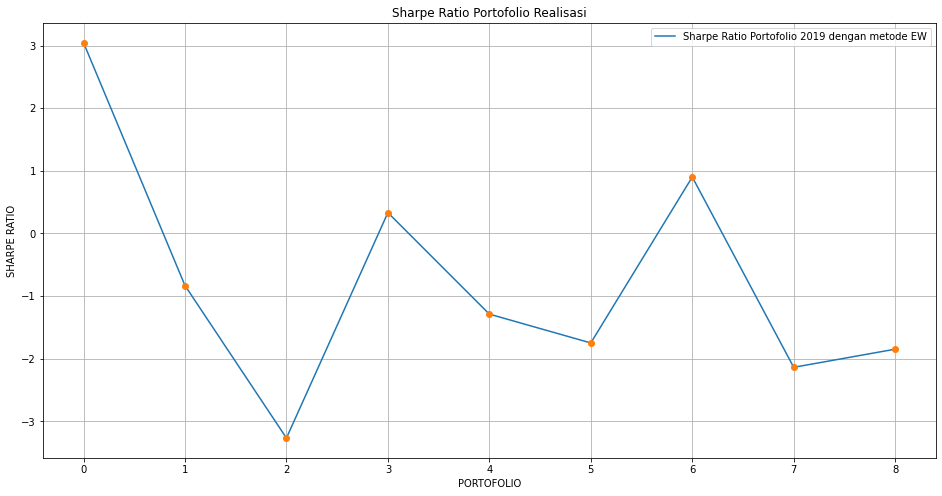

In [ ]:
Risk_P_EW = SHARPE_INDEX_EW['RISK']
Expected_P_EW = SHARPE_INDEX_EW['ER'] 

sharpe_ratio_P1_EW = Expected_P_EW[0]/Risk_P_EW[0]
sharpe_ratio_P2_EW = Expected_P_EW[1]/Risk_P_EW[1]
sharpe_ratio_P3_EW = Expected_P_EW[2]/Risk_P_EW[2]
sharpe_ratio_P4_EW = Expected_P_EW[3]/Risk_P_EW[3]
sharpe_ratio_P5_EW = Expected_P_EW[4]/Risk_P_EW[4]
sharpe_ratio_P6_EW = Expected_P_EW[5]/Risk_P_EW[5]
sharpe_ratio_P7_EW = Expected_P_EW[6]/Risk_P_EW[6]
sharpe_ratio_P8_EW = Expected_P_EW[7]/Risk_P_EW[7]
sharpe_ratio_P9_EW = Expected_P_EW[8]/Risk_P_EW[8]
sharpe_ratio_EW = np.array([sharpe_ratio_P1_EW, sharpe_ratio_P2_EW, sharpe_ratio_P3_EW, sharpe_ratio_P4_EW, sharpe_ratio_P5_EW, sharpe_ratio_P6_EW, sharpe_ratio_P7_EW, sharpe_ratio_P8_EW, sharpe_ratio_P9_EW])

sharpe_ratio_EW

# Periode = np.array([0, 1, 2,3,4,5,6,7,8,9])
plt.figure(figsize=(16,8))
# ax = fig.add_subplot(111)
plt.title('Sharpe Ratio Portofolio Realisasi')
plt.plot(sharpe_ratio_EW,'-', label='Sharpe Ratio Portofolio 2019 dengan metode EW')
plt.plot(sharpe_ratio_EW,'o')
plt.xlabel('PORTOFOLIO')
plt.ylabel('SHARPE RATIO')
# for xy in zip(Periode, sharpe_ratio):                                      
#     ax.annotate('(%s, %s)' % xy, xy=xy, textcoords='data')
plt.grid()
plt.legend(loc='best')
plt.show()

## PERUBAHAN KEKAYAAN PORTOFOLIO EW

In [ ]:
RETURN_PORTOFOLIO_EW_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Return_Portofolio_EW_2019.csv')
# RETURN_PORTOFOLIO_EW_2019
R_P1_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 1']
R_P2_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 2']
R_P3_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 3']
R_P4_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 4']
R_P5_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 5']
R_P6_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 6']
R_P7_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 7']
R_P8_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 8']
R_P9_EW = RETURN_PORTOFOLIO_EW_2019['PORTOFOLIO 9']

**PORTOFOLIO 1 EW**

[1, 0.988983742, 1.039772898227117, 1.0305246049111032, 1.0423930599165516, 1.0802757001608945, 1.091869107706624, 1.079969246671336, 1.073508563926482, 1.0463018076422819, 1.032538559052419, 1.0167871967570756, 1.0071785536805724, 1.0147164230100296, 1.0008140845219826, 1.0164429603985736, 1.0147393897996302, 0.9993199458146328, 1.0056723199162327, 0.9587178966533566, 0.9786669331607639, 0.9778039926137825, 0.9905233080174702, 1.02931602616045, 1.0679801005331917, 1.0784326716844537, 1.0421688471168336, 1.0742831717551786, 1.1126345008739258, 1.0720701857297832, 1.038164460919538, 1.0590941232599422, 1.0593652990147324, 1.0571637917309686, 1.031127710263236, 1.0190454919407808, 1.029314732324307, 1.0234603380352258, 1.027282389259998, 1.0068389591543767, 1.0202289859850926, 1.0350217971876123, 1.0389748942334174, 1.037081805091982, 1.0230211640575433, 1.01380996129202, 1.0053602638300654, 1.028186846971735, 1.0203749002558684, 1.0311514469124348, 1.0527996796160501, 1.0575173213035955

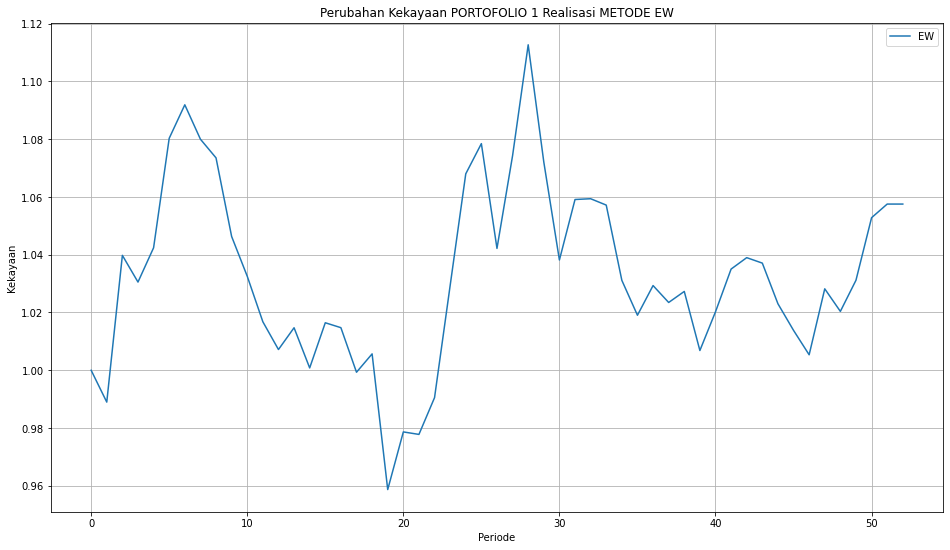

In [ ]:
v0 = 1
VP1_EW = [v0]
x1_EW = 1
for i in range(52):
    x1_EW = x1_EW + (x1_EW * R_P1_EW[i])
    VP1_EW.append(x1_EW)
print (VP1_EW)

plt.figure(figsize=(16,9))
plt.plot(VP1_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 1 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 2 EW**

[1, 1.064770975, 1.0919181085210854, 1.157768619172271, 1.1267519330296032, 1.1513110880174724, 1.1231211807644323, 1.1689168478643637, 1.125566826636949, 1.068050796264596, 1.068114024871735, 1.0129166616860301, 0.942057626882786, 0.9371323743867243, 0.922112384983077, 0.9126689564352497, 0.9167590659354731, 0.8740609051787177, 0.8280189271292997, 0.796219541692476, 0.8610378827640294, 0.9091578863489604, 0.9185666413059448, 0.9021566136010095, 1.0188705823061464, 1.0190289107191544, 0.9842805262258553, 0.9838673193552625, 0.9823518272008321, 0.9308688023878706, 0.8904660542849908, 0.9032313615725052, 0.9350823116581426, 0.8890125416755164, 0.8846015272584724, 0.910060123908965, 0.8872889262000994, 0.8861777645176407, 0.8667672280640862, 0.8283979721044606, 0.860044676640595, 0.9050636610565324, 0.9096065312613939, 0.9377634714762932, 0.9274909272051736, 0.923873832235403, 0.8906829506578738, 0.8689980237052451, 0.9001096797834206, 0.8940170713894834, 0.8963900635841237, 0.89911361302

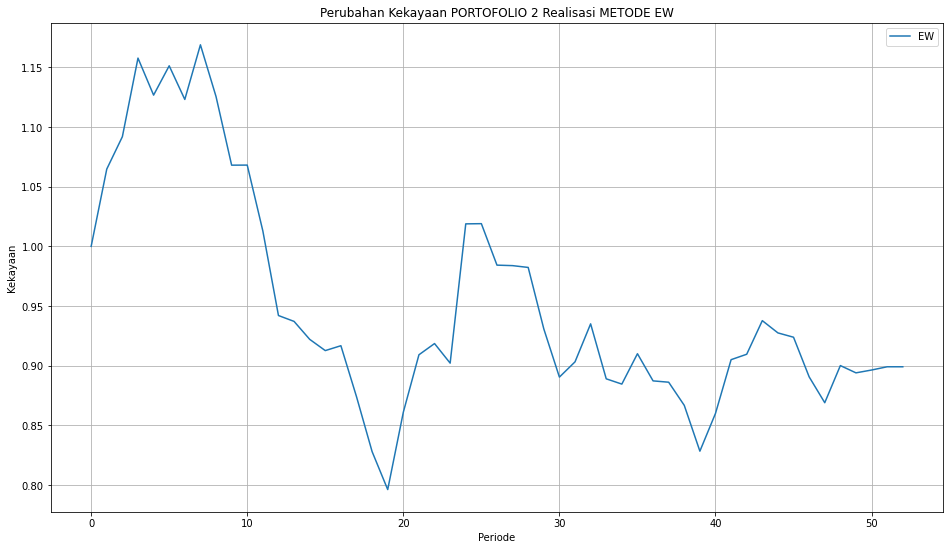

In [ ]:
v0 = 1
VP2_EW = [v0]
x2_EW = 1
for i in range(52):
    x2_EW = x2_EW + (x2_EW * R_P2_EW[i])
    VP2_EW.append(x2_EW)
print (VP2_EW)

plt.figure(figsize=(16,9))
plt.plot(VP2_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 2 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 3 EW**

[1, 1.048288232, 1.1259385390694523, 1.1449442273553647, 1.1269903225778783, 1.1277556053564248, 1.1175880111802756, 1.1501854707205104, 1.1275162835487755, 1.0763808234198375, 1.0747140003540157, 1.05473345394172, 1.0070888181399065, 0.9862336472497362, 0.9860526536507929, 1.0025599589847667, 1.0392499620578401, 0.9939874294773379, 0.9956971077357875, 0.9500746396457491, 0.9779617900625939, 0.9928397535737986, 1.0046530851812097, 0.9977867545355992, 1.0214453431241053, 1.0287133833265016, 1.0239084451952525, 1.0240480673986563, 1.0041078740895863, 0.9758205336422661, 0.9427482017153995, 0.9385937083675622, 0.944075686938465, 0.9204362620919935, 0.9143473065304302, 0.9274454057586105, 0.9284039382069247, 0.918338365604461, 0.904828449303402, 0.8529396141525796, 0.8823292230847344, 0.8909562641204664, 0.9370956744690644, 0.8892577293219766, 0.8758370009833587, 0.8684727786774834, 0.8447583929907784, 0.8292172131755907, 0.8274277450159964, 0.8235185891123561, 0.8279340232025235, 0.829338

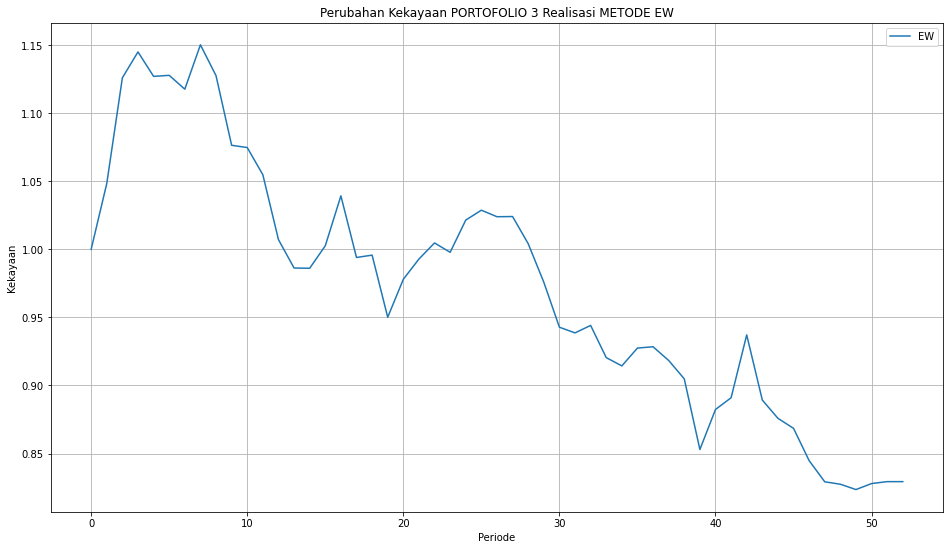

In [ ]:
v0 = 1
VP3_EW = [v0]
x3_EW = 1
for i in range(52):
    x3_EW = x3_EW + (x3_EW * R_P3_EW[i])
    VP3_EW.append(x3_EW)
print (VP3_EW)

plt.figure(figsize=(16,9))
plt.plot(VP3_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 3 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 4 EW**

[1, 1.031620648, 1.0479498916679966, 1.099679637820175, 1.0811078280190463, 1.0988131806494743, 1.0855905441137117, 1.079237376225702, 1.0472965819762399, 1.0150090420697095, 1.0034992526413191, 0.9701898691365692, 0.9381218467361137, 0.9549981681211704, 0.9471689241042374, 0.92753874869944, 0.9198968821666363, 0.9017333894426927, 0.8740766646085837, 0.8419870962146111, 0.8822920274915923, 0.9114354795372736, 0.9136393013608594, 0.9102084889384834, 0.9786938553993503, 0.9935480724082024, 0.950629277563253, 0.9486096466504843, 0.9463785879072859, 0.9148145490513091, 0.8804854378391015, 0.9069997546914691, 0.9328615756408417, 0.9126177378244829, 0.8971023674693802, 0.9003046407556373, 0.9036440723364395, 0.9001198125611916, 0.8896269286812447, 0.8629241661328041, 0.8765982566272819, 0.8942761490716082, 0.9173578555687356, 0.9452488579655359, 0.9604594736413148, 0.94874727064743, 0.9407571725520641, 0.9435223391685893, 0.9696492001958911, 0.9684639766462092, 0.9856172953533536, 0.99600200

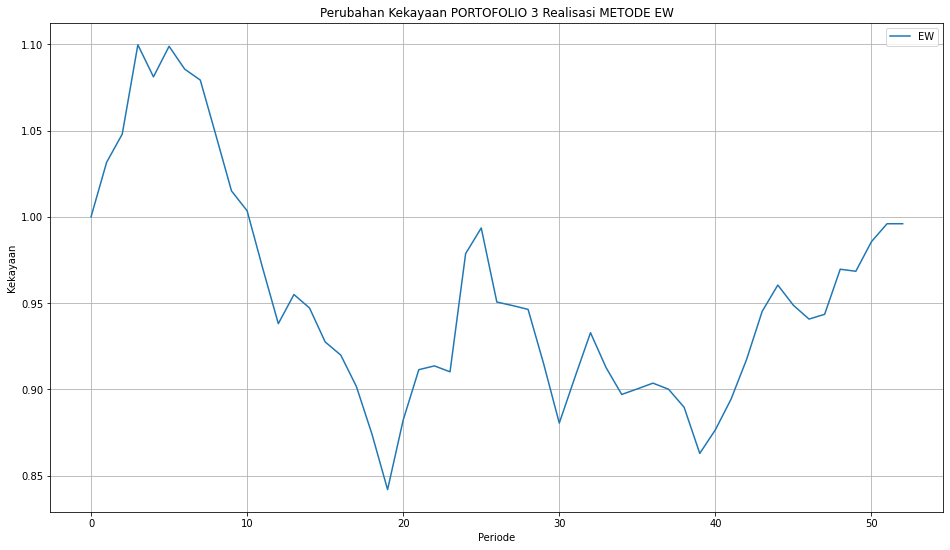

In [ ]:
v0 = 1
VP4_EW = [v0]
x4_EW = 1
for i in range(52):
    x4_EW = x4_EW + (x4_EW * R_P4_EW[i])
    VP4_EW.append(x4_EW)
print (VP4_EW)

plt.figure(figsize=(16,9))
plt.plot(VP4_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 3 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 5 EW**

[1, 1.036155558, 1.057780028132993, 1.0941276717268045, 1.0820053334236526, 1.1165888693829127, 1.1040407285295415, 1.1153477837315913, 1.1040013819574277, 1.0580322007185183, 1.0584332245474923, 1.0257577175227832, 1.0101648010829103, 1.0139643359695532, 1.00557604121591, 0.9974469856158175, 1.0060955551786785, 0.9623041816904292, 0.9310066267858822, 0.8977526648914421, 0.9474659323749399, 0.9716527195260362, 0.9774590295403714, 0.9817824315063085, 1.0599153812343969, 1.061999653955656, 1.0239894937149716, 1.0341845112885697, 1.0369231270194368, 0.9883807529203866, 0.9534188297339865, 0.9721961771377275, 0.9990408138046553, 0.9715176160227238, 0.9480279677611712, 0.956565180501377, 0.9547422341490267, 0.9506086098595798, 0.9425534681016883, 0.9063993009616931, 0.9285590136131563, 0.9525638649507958, 0.9690441457065213, 0.9635341858891818, 0.9475506549315419, 0.9430301873402185, 0.9186767213193947, 0.9177568530743677, 0.9320141911027684, 0.9392023169991376, 0.9473042293256433, 0.941298

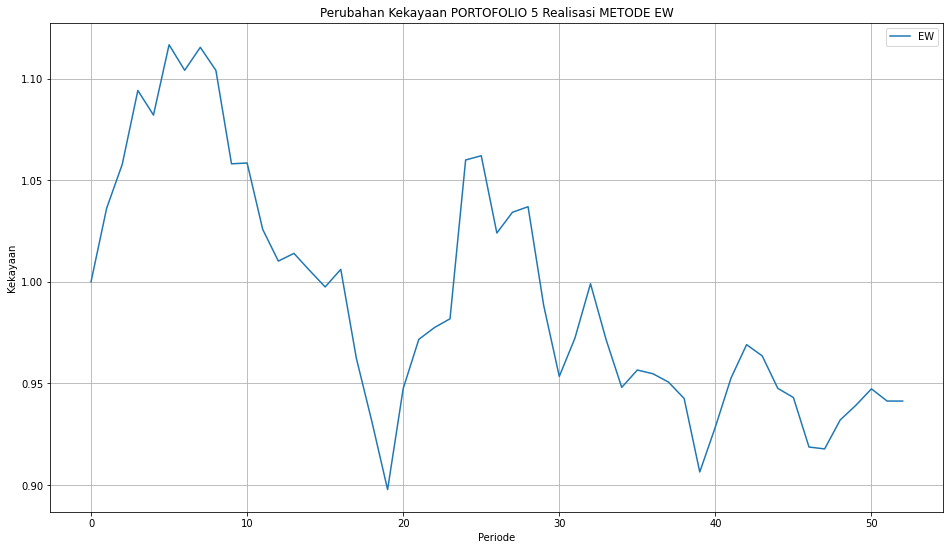

In [ ]:
v0 = 1
VP5_EW = [v0]
x5_EW = 1
for i in range(52):
    x5_EW = x5_EW + (x5_EW * R_P5_EW[i])
    VP5_EW.append(x5_EW)
print (VP5_EW)

plt.figure(figsize=(16,9))
plt.plot(VP5_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 5 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 6 EW**

[1, 1.029158976, 1.0632260410205465, 1.1002463341737703, 1.085530374417246, 1.1012049673313005, 1.0769180393382742, 1.1117971423353779, 1.1059206006767186, 1.064224755304653, 1.0623986147991593, 1.023288192500204, 1.0004378233368418, 0.998885948187033, 0.99015796745427, 0.9771111292126335, 0.9899054760796558, 0.9509004988700732, 0.9074115618752113, 0.8580255079526637, 0.9252674912070403, 0.9384163278091924, 0.9422721500602907, 0.941998512343369, 1.003782064909334, 1.0532731160236575, 1.0180020601797004, 1.0154386067959167, 1.0172929378224538, 0.9683236643376067, 0.9312032274610537, 0.9408762956077799, 0.9651141035399105, 0.9368488164406781, 0.9179364582660315, 0.9422116201978746, 0.9384440362806542, 0.9254821806220193, 0.9125329052128839, 0.8800522728620399, 0.8980069039613666, 0.9273897284732794, 0.9406623503535816, 0.9263047358794427, 0.9198801159549574, 0.911705508396632, 0.8880043962626414, 0.8711333392667333, 0.8861271155600579, 0.9048680323697995, 0.911558660081259, 0.90137549882

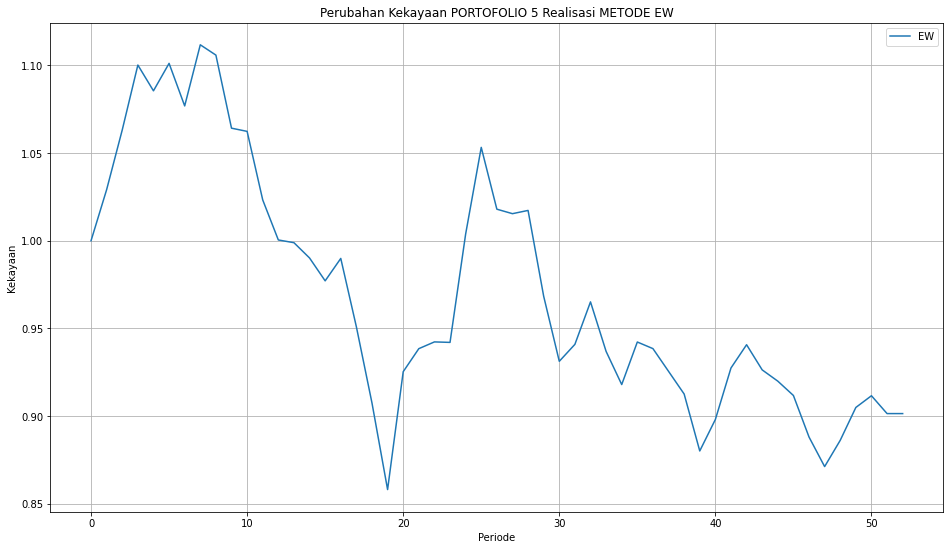

In [ ]:
v0 = 1
VP6_EW = [v0]
x6_EW = 1
for i in range(52):
    x6_EW = x6_EW + (x6_EW * R_P6_EW[i])
    VP6_EW.append(x6_EW)
print (VP6_EW)

plt.figure(figsize=(16,9))
plt.plot(VP6_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 5 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 7 EW**

[1, 1.019970628, 1.044330981237157, 1.0986557567580917, 1.0883186607518722, 1.1148711938871432, 1.0853375914978411, 1.0891161009836081, 1.0854512623337458, 0.9870313112260701, 1.0173894411617008, 0.987550284824737, 0.9957544723842012, 0.9906291379087534, 0.9834630337130684, 0.9759781375119215, 1.0050997167233067, 0.953828788154674, 0.9194000385439915, 0.8817089250454677, 0.9280650847864016, 0.9449485162698473, 0.960060239721217, 0.9384756229777692, 1.0185977352858342, 1.0236582887545786, 0.9758886134265917, 1.0089806762164222, 1.0336738255564715, 1.0086111136309206, 0.9592770160651694, 1.0020857447995122, 1.0222788598202555, 0.9916391515689251, 1.0002771000743504, 1.0057956798495928, 0.99887127446269, 0.9914471217626525, 0.9889638649771632, 0.97449199280225, 1.0023992518436147, 1.014748667283235, 1.0096908514419005, 0.9842332676205464, 0.9881632825153905, 0.9805803773723107, 0.9651769020775268, 0.9746066784804704, 0.9800369227745538, 1.0060709891449093, 1.0199034531382367, 1.0197521800

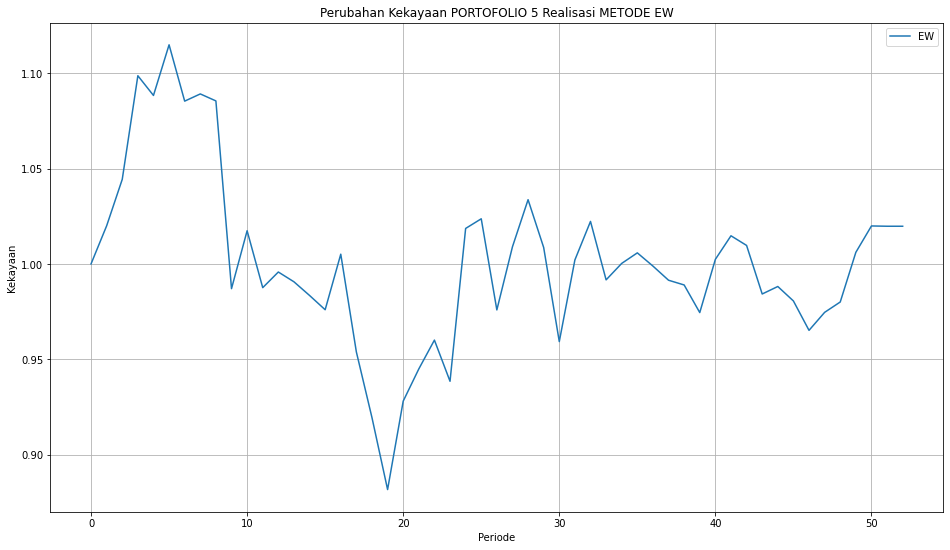

In [ ]:
v0 = 1
VP7_EW = [v0]
x7_EW = 1
for i in range(52):
    x7_EW = x7_EW + (x7_EW * R_P7_EW[i])
    VP7_EW.append(x7_EW)
print (VP7_EW)

plt.figure(figsize=(16,9))
plt.plot(VP7_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 5 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 8 EW**

[1, 1.028401451, 1.0594082494087478, 1.1067550410887292, 1.0834104927458683, 1.1026091583056423, 1.063344672821616, 1.0858768996515404, 1.072622836065406, 1.0014745705925938, 1.0175161732392783, 0.9821937352328851, 0.9637771253511132, 0.9594559843482994, 0.9472852957408571, 0.939658722665124, 0.9663003336423525, 0.9280177688021208, 0.8867617208545302, 0.838124347073823, 0.8912622537164122, 0.9052675523363609, 0.9113821820186169, 0.8974229558155306, 0.9484242463581576, 0.985269727859108, 0.9546564988485338, 0.9527177461537252, 0.9558835481486211, 0.9349230159108033, 0.8905392912317086, 0.900094732409121, 0.9243404591028577, 0.8995812206867806, 0.8895165917429219, 0.9081399852199951, 0.9049507792198995, 0.8980059643222743, 0.8987464726125379, 0.8790433561505512, 0.9041001468278438, 0.9274958591459587, 0.9299405981787927, 0.9055320641628675, 0.9032584560672314, 0.8918806774457214, 0.8753015770993757, 0.8661712783390016, 0.8788080936466472, 0.8990129322283665, 0.9188900937757288, 0.9096310

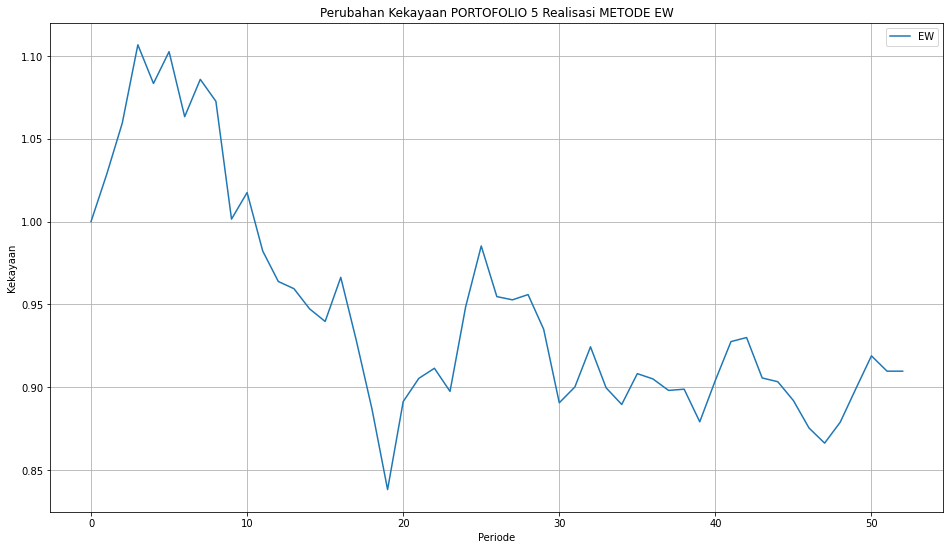

In [ ]:
v0 = 1
VP8_EW = [v0]
x8_EW = 1
for i in range(52):
    x8_EW = x8_EW + (x8_EW * R_P8_EW[i])
    VP8_EW.append(x8_EW)
print (VP8_EW)

plt.figure(figsize=(16,9))
plt.plot(VP8_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 5 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

**PORTOFOLIO 9 EW**

[1, 1.014664939, 1.0375610126509305, 1.0737745512613235, 1.0626505593786506, 1.0722556378162085, 1.0457703659892164, 1.0548488951411976, 1.0439837711420823, 0.9762144394967942, 0.9867046846455308, 0.9617730135153252, 0.9528369890539246, 0.9458379859323962, 0.9387976853384937, 0.928789831639052, 0.9579286575041317, 0.9263092209727238, 0.886225284746587, 0.841700904597683, 0.8909074970112777, 0.9195879582089536, 0.9289651934106333, 0.9114588694228701, 0.9633672021671521, 1.0000953619188886, 0.9581214895915499, 0.9640791053018954, 0.9743122284853701, 0.9579997212347899, 0.9099149130768313, 0.9104367147027141, 0.9217610761678849, 0.8959249142132744, 0.8850623200749159, 0.9190315287957861, 0.9142181958239656, 0.9033687406400069, 0.8953041899286717, 0.8805554661896086, 0.9015440904150674, 0.9236002241431058, 0.9294712330495064, 0.9054353718621476, 0.9068364597598392, 0.8945374322368129, 0.8758895238514582, 0.8595700606051379, 0.8584369332323152, 0.8862661915547934, 0.90524778796349, 0.900092

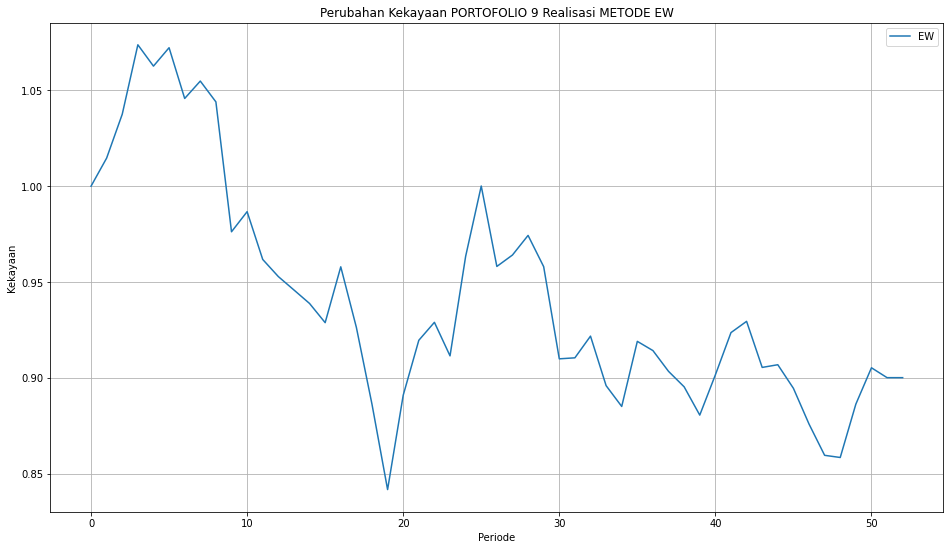

In [ ]:
#REALISASI
v0 = 1
VP9_EW = [v0]
x9_EW = 1
for i in range(52):
    x9_EW = x9_EW + (x9_EW * R_P9_EW[i])
    VP9_EW.append(x9_EW)
print (VP9_EW)

plt.figure(figsize=(16,9))
plt.plot(VP9_EW,'-',label='EW')
plt.title('Perubahan Kekayaan PORTOFOLIO 9 Realisasi METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

PLOT KESELURUHAN

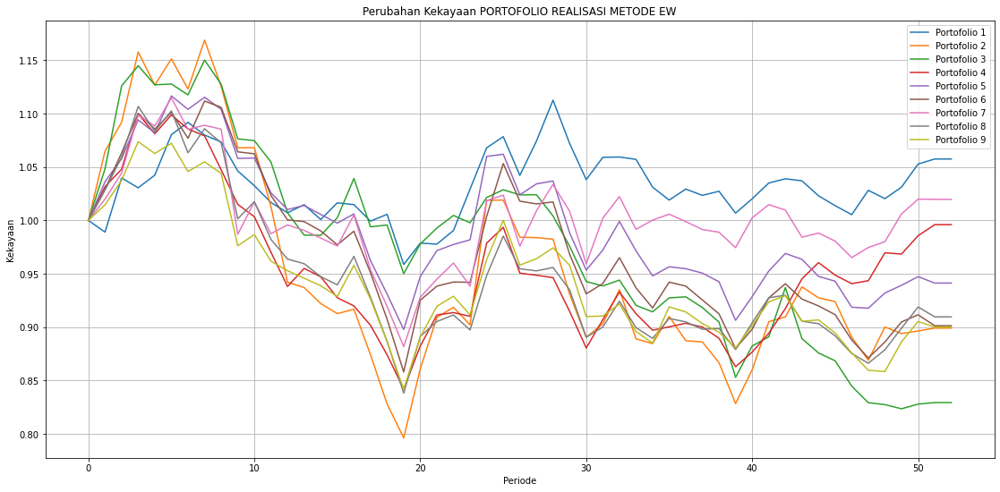

In [ ]:
PERUBAHAN_KEKAYAAN = np.array([VP1_EW,VP2_EW,VP3_EW,VP4_EW,VP5_EW,VP6_EW,VP7_EW,VP8_EW,VP9_EW])

plt.figure(figsize=(19,9))
plt.plot(VP1_EW ,'-',label='Portofolio 1')
plt.plot(VP2_EW ,'-',label='Portofolio 2')
plt.plot(VP3_EW ,'-',label='Portofolio 3')
plt.plot(VP4_EW ,'-',label='Portofolio 4')
plt.plot(VP5_EW ,'-',label='Portofolio 5')
plt.plot(VP6_EW ,'-',label='Portofolio 6')
plt.plot(VP7_EW ,'-',label='Portofolio 7')
plt.plot(VP8_EW ,'-',label='Portofolio 8')
plt.plot(VP9_EW ,'-',label='Portofolio 9')
plt.title('Perubahan Kekayaan PORTOFOLIO REALISASI METODE EW')
plt.xlabel('Periode')
plt.ylabel('Kekayaan')
plt.legend(loc='best')
plt.grid()
plt.show()

## EXPORT DATA PORTOFOLIO EW

In [ ]:
PERUBAHAN_KEKAYAAN_EW = np.transpose(pd.DataFrame(PERUBAHAN_KEKAYAAN))
np.savetxt(" PERUBAHAN_KEKAYAAN_EW.csv", PERUBAHAN_KEKAYAAN_EW, delimiter=",")
files.download(" PERUBAHAN_KEKAYAAN_EW.csv")
PERUBAHAN_KEKAYAAN_EW

,0,1,2,3,4,5,6,7,8
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.988984,1.064771,1.048288,1.031621,1.036156,1.029159,1.019971,1.028401,1.014665
2,1.039773,1.091918,1.125939,1.047950,1.057780,1.063226,1.044331,1.059408,1.037561
3,1.030525,1.157769,1.144944,1.099680,1.094128,1.100246,1.098656,1.106755,1.073775
4,1.042393,1.126752,1.126990,1.081108,1.082005,1.085530,1.088319,1.083410,1.062651
5,1.080276,1.151311,1.127756,1.098813,1.116589,1.101205,1.114871,1.102609,1.072256
6,1.091869,1.123121,1.117588,1.085591,1.104041,1.076918,1.085338,1.063345,1.045770
7,1.079969,1.168917,1.150185,1.079237,1.115348,1.111797,1.089116,1.085877,1.054849
8,1.073509,1.125567,1.127516,1.047297,1.104001,1.105921,1.085451,1.072623,1.043984
9,1.046302,1.068051,1.076381,1.015009,1.058032,1.064225,0.987031,1.001475,0.976214


In [ ]:
#EXPORT DATA
Risk_Portofolio_EW =  np.array([Risk_P1_EW, Risk_P2_EW, Risk_P3_EW, Risk_P4_EW, Risk_P5_EW, Risk_P6_EW, Risk_P7_EW, Risk_P8_EW, Risk_P9_EW])
ER_Portofolio_EW = np.array([ER_P1_EW, ER_P2_EW, ER_P3_EW, ER_P4_EW, ER_P5_EW, ER_P6_EW, ER_P7_EW, ER_P8_EW, ER_P9_EW])
Result_Portofolio = np.array([Risk_Portofolio_EW,ER_Portofolio_EW])
Result_Portofolio_EW = np.transpose(pd.DataFrame(Result_Portofolio, columns = ['Portofolio 1', 'Portofolio 2', 'Portofolio 3', 'Portofolio 4', 'Portofolio 5', 'Portofolio 6', 'Portofolio 7', 'Portofolio 8', 'Portofolio 9'], index =['Risk Portofolio', 'Expected Return Portofolio']))
Result_Portofolio_EW

,Risk Portofolio,Expected Return Portofolio
Portofolio 1,0.000421,0.001282
Portofolio 2,0.001555,-0.001294
Portofolio 3,0.000993,-0.003243
Portofolio 4,0.000726,0.000241
Portofolio 5,0.000779,-0.001004
Portofolio 6,0.000913,-0.001596
Portofolio 7,0.000916,0.000826
Portofolio 8,0.000672,-0.001436
Portofolio 9,0.000905,-0.001672


In [ ]:
np.savetxt("Result Portofolio_EW.csv", Result_Portofolio_EW, delimiter=",")
files.download("Result Portofolio_EW.csv")

In [ ]:
Return_Portofolio_EW_2019 = np.array([KvP1_EW, KvP2_EW, KvP3_EW, KvP4_EW, KvP5_EW, KvP6_EW, KvP7_EW, KvP8_EW, KvP9_EW])
np.savetxt("Return_Portofolio_EW_2019.csv", Return_Portofolio_EW_2019,delimiter=",")
files.download("Return_Portofolio_EW_2019.csv")

In [ ]:
np.savetxt("sharpe_ratio_EW.csv", sharpe_ratio_EW,delimiter=",")
files.download("sharpe_ratio_EW.csv")

TEORITIS

In [ ]:
#EXPORT DATA
Risk_Portofolio_Teoritis_EW =  np.array([Risk_P1Teoritis_EW, Risk_P2Teoritis_EW, Risk_P3Teoritis_EW, Risk_P4Teoritis_EW, Risk_P5Teoritis_EW, Risk_P6Teoritis_EW, Risk_P7Teoritis_EW, Risk_P8Teoritis_EW, Risk_P9Teoritis_EW])
ER_Portofolio_Teoritis_EW = np.array([ER_P1Teoritis_EW, ER_P2Teoritis_EW, ER_P3Teoritis_EW, ER_P4Teoritis_EW, ER_P5Teoritis_EW, ER_P6Teoritis_EW, ER_P7Teoritis_EW, ER_P8Teoritis_EW, ER_P9Teoritis_EW])
Result_Portofolio_Teoritis = np.array([Risk_Portofolio_Teoritis_EW,ER_Portofolio_Teoritis_EW])
Result_Portofolio_Teoritis_EW = np.transpose(pd.DataFrame(Result_Portofolio_Teoritis, columns = ['Portofolio 1', 'Portofolio 2', 'Portofolio 3', 'Portofolio 4', 'Portofolio 5', 'Portofolio 6', 'Portofolio 7', 'Portofolio 8', 'Portofolio 9'], index =['Risk Portofolio', 'Expected Return Portofolio']))
Result_Portofolio_Teoritis_EW

,Risk Portofolio,Expected Return Portofolio
Portofolio 1,0.001237,0.003531
Portofolio 2,0.001188,0.004388
Portofolio 3,0.001431,0.003495
Portofolio 4,0.000892,0.004411
Portofolio 5,0.000783,0.004318
Portofolio 6,0.000923,0.004247
Portofolio 7,0.000980,0.004081
Portofolio 8,0.000901,0.004944
Portofolio 9,0.001072,0.005128


In [ ]:
np.savetxt("Result_Portofolio_Teoritis_EW.csv", Result_Portofolio_Teoritis_EW, delimiter=",")
files.download("Result_Portofolio_Teoritis_EW.csv")

In [ ]:
Return_Portofolio_Teoritis_EW = np.array([KvP1Teoritis_EW, KvP2Teoritis_EW, KvP3Teoritis_EW, KvP4Teoritis_EW, KvP5Teoritis_EW, KvP6Teoritis_EW, KvP7Teoritis_EW, KvP8Teoritis_EW, KvP9Teoritis_EW])
np.savetxt("Return_Portofolio_Teoritis_EW.csv", Return_Portofolio_Teoritis_EW,delimiter=",")
files.download("Return_Portofolio_Teoritis_EW.csv")

In [ ]:

np.savetxt("sharpe_ratio_EW_TEORITIS.csv", sharpe_ratio_Teoritis_EW,delimiter=",")
files.download("sharpe_ratio_EW_TEORITIS.csv")

# **PLOT DATA**

## PLOT RISK & EXPECTED RETURN TEORITIS

In [ ]:
risk_ER_PORTOFOLIO_MV = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA LENGKAP PORTOFOLIO MV.csv')
risk_ER_PORTOFOLIO_EW = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Result_Portofolio_Teoritis_EW.csv')
ER_MV_EW = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Expected Return EW & MV Pengujian.csv')

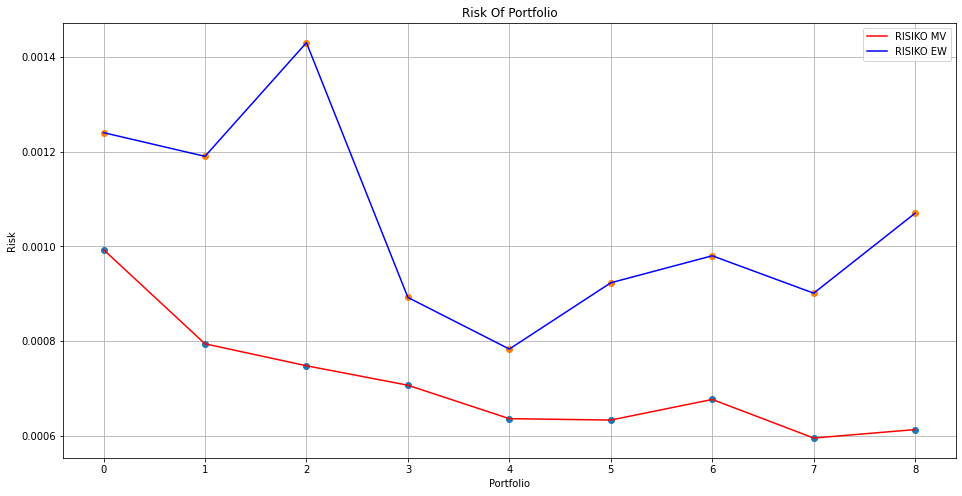

In [ ]:
Risk_MV = risk_ER_PORTOFOLIO_MV['Risk Portofolio teoritis']
Risk_EW = risk_ER_PORTOFOLIO_EW['RISK']

plt.figure(figsize=(16,8))
plt.title('Risk Of Portfolio')
plt.plot(Risk_MV,'o')
plt.plot(Risk_EW,'o')
plt.plot(Risk_MV,'red',label='RISIKO MV')
plt.plot(Risk_EW,'b',label='RISIKO EW')
plt.xlabel('Portfolio')
plt.ylabel('Risk')
plt.grid()
plt.legend(loc='best')
plt.show()

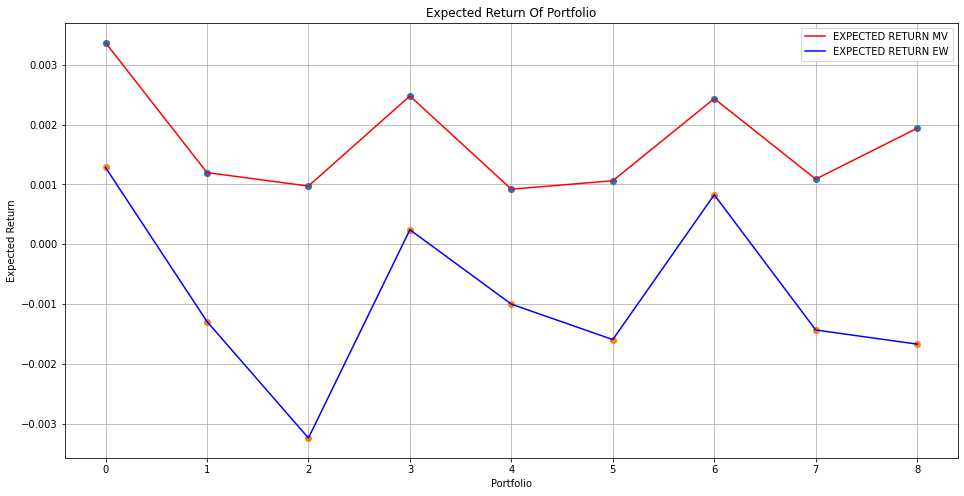

In [ ]:
ER_MV = ER_MV_EW['Expected Return Portofolio Realisasi 2019']
ER_EW = ER_MV_EW['ER']

plt.figure(figsize=(16,8))
plt.title('Expected Return Of Portfolio')
plt.plot(ER_MV,'o')
plt.plot(ER_EW,'o')
plt.plot(ER_MV,'red',label='EXPECTED RETURN MV')
plt.plot(ER_EW,'b',label='EXPECTED RETURN EW')
plt.xlabel('Portfolio')
plt.ylabel('Expected Return')
plt.grid()
plt.legend(loc='best')
plt.show()

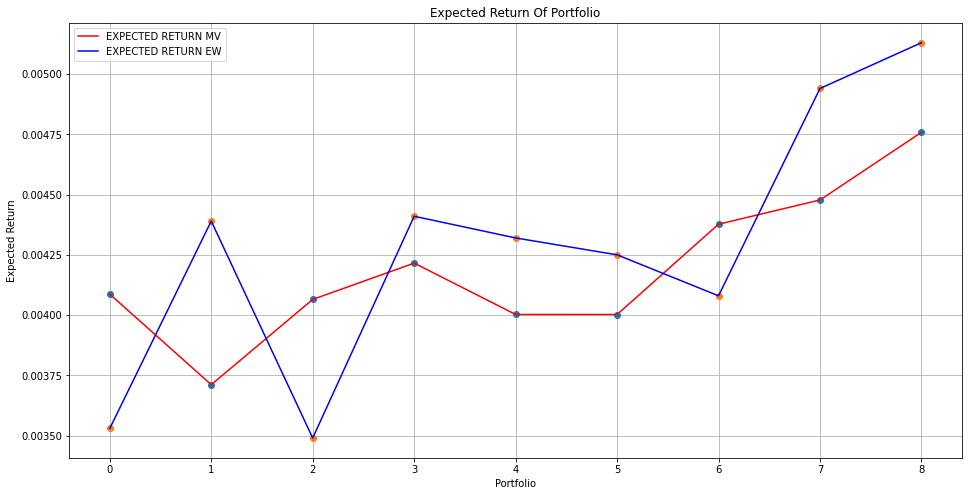

In [ ]:
ER_MV = risk_ER_PORTOFOLIO_MV['Expected Return Portofolio teoritis']
ER_EW = risk_ER_PORTOFOLIO_EW['ER']

plt.figure(figsize=(16,8))
plt.title('Expected Return Of Portfolio')
plt.plot(ER_MV,'o')
plt.plot(ER_EW,'o')
plt.plot(ER_MV,'red',label='EXPECTED RETURN MV')
plt.plot(ER_EW,'b',label='EXPECTED RETURN EW')
plt.xlabel('Portfolio')
plt.ylabel('Expected Return')
plt.grid()
plt.legend(loc='best')
plt.show()

## PLOT SHARPE INDEX & RISIKO

In [ ]:
sharpe_PORTOFOLIO_MV_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA LENGKAP PORTOFOLIO MV.csv')
sharpe_PORTOFOLIO_EW_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/sharpe_ratio_EW_2019.csv')

In [ ]:
Shrape_2019_MV = sharpe_PORTOFOLIO_MV_2019['sharpe ratio Realisasi']
Shrape_2019_EW = sharpe_PORTOFOLIO_EW_2019['Sharpe Index']

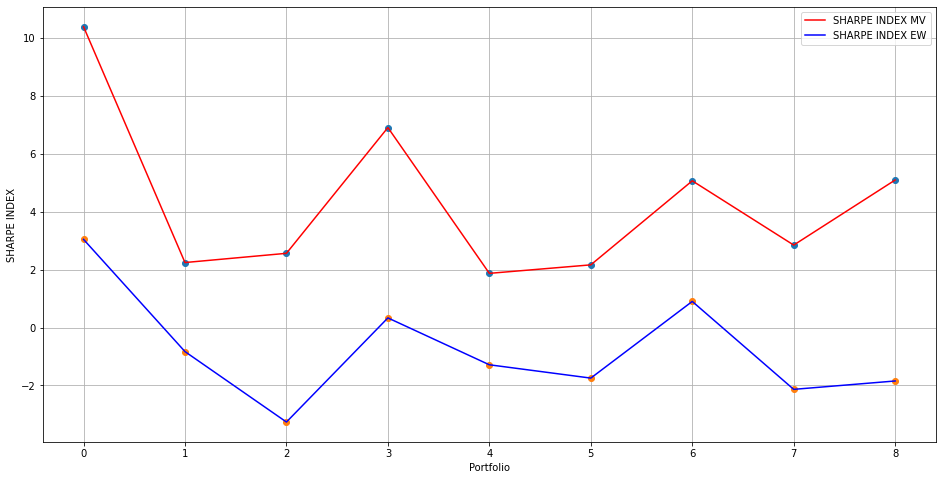

In [ ]:
plt.figure(figsize=(16,8))
# plt.title('Expected Return Of Portfolio')
plt.plot(Shrape_2019_MV,'o')
plt.plot(Shrape_2019_EW,'o')
plt.plot(Shrape_2019_MV,'red',label='SHARPE INDEX MV')
plt.plot(Shrape_2019_EW,'b',label='SHARPE INDEX EW')
plt.xlabel('Portfolio')
plt.ylabel('SHARPE INDEX')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:
RISK_PORTOFOLIO_EW_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Result Portofolio_EW_2019.csv')
RISK_PORTOFOLIO_MV_2019 = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/DATA LENGKAP PORTOFOLIO MV.csv')
RISK_EW_2019 = RISK_PORTOFOLIO_EW_2019['RISK']
RISK_MV_2019 = RISK_PORTOFOLIO_MV_2019['Risk Portofolio Realisasi 2019']

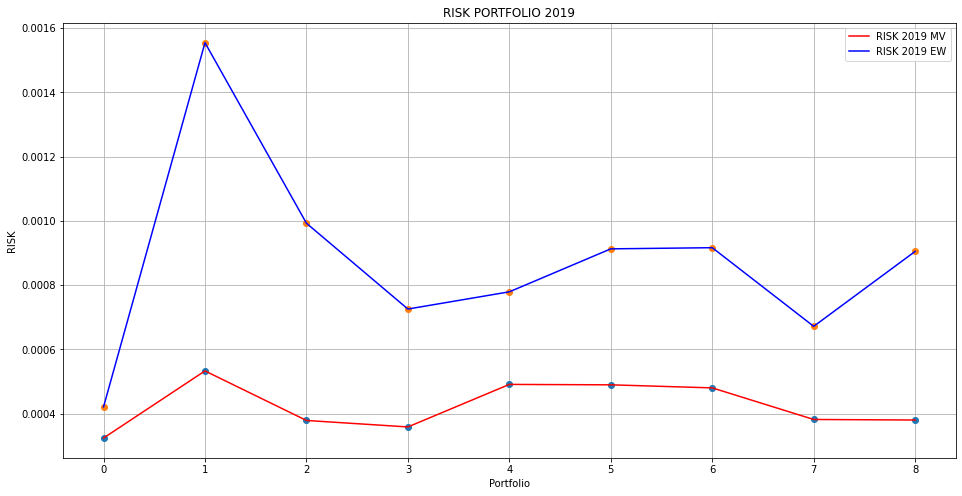

In [ ]:
plt.figure(figsize=(16,8))
plt.title('RISK PORTFOLIO 2019')
plt.plot(RISK_MV_2019,'o')
plt.plot(RISK_EW_2019,'o')
plt.plot(RISK_MV_2019,'red',label='RISK 2019 MV')
plt.plot(RISK_EW_2019,'b',label='RISK 2019 EW')
plt.xlabel('Portfolio')
plt.ylabel('RISK')
plt.grid()
plt.legend(loc='best')
plt.show()

PERUBAHAN KEKAYAAN

In [ ]:
PERUBAHAN_2019_MV = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/Perubahan Kekayaan Portofolio Realisasi MV.csv')
PERUBAHAN_2019_EW = pd.read_csv('/content/gdrive/My Drive/SEMESTER 7/TA/DATA KOMPAS FIX/PORTOFOLIO SAHAM/_PERUBAHAN_KEKAYAAN_EW.csv')

In [ ]:
# K3_MV = PERUBAHAN_2019_MV['3']
# K3_EW = PERUBAHAN_2019_EW['3']
K3_MV = PERUBAHAN_2019_MV['AVG']
K3_EW = PERUBAHAN_2019_EW['AVG'][0:52]

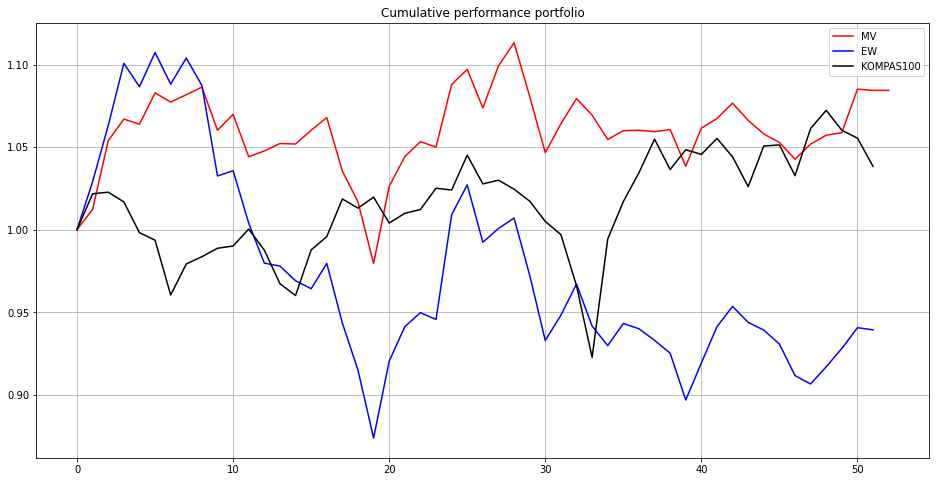

In [ ]:
plt.figure(figsize=(16,8))
plt.title('Cumulative performance portfolio')
plt.plot(K3_MV,'red',label='MV')
plt.plot(K3_EW,'b',label='EW')
plt.plot(Vp_KOMPAS100,'black',label='KOMPAS100')

# plt.xlabel('Time')
# plt.ylabel('Cumulative')
plt.grid()
plt.legend(loc='best')
plt.show()